# LAB 1

In [1]:
# Import PyDrive and associated libraries.
# This only needs to be done once per notebook.
from pydrive.auth import GoogleAuth
from pydrive.drive import GoogleDrive
from google.colab import auth
from oauth2client.client import GoogleCredentials

# Authenticate and create the PyDrive client.
# This only needs to be done once per notebook.
auth.authenticate_user()
gauth = GoogleAuth()
gauth.credentials = GoogleCredentials.get_application_default()
drive = GoogleDrive(gauth)

# List .txt files in the root.
#
# Search query reference:
# https://developers.google.com/drive/v2/web/search-parameters
listed = drive.ListFile({'q': "title contains '.csv' and 'root' in parents"}).GetList()
for file in listed:
  print('title {}, id {}'.format(file['title'], file['id']))

title train.csv, id 1Jwzj9lneJfyHnmDgw75FpN8WFVwlgrQG
title test.csv, id 1GblmLmA4sm5bi1X3NmaPqNpDgnT3M3bZ
title cyberlab.csv, id 1TSw0JJGfrlzrgvlgFK21QBjAzcL_bzRD
title dataset_lab_1.csv, id 14rHwK3VAyCyVaSaz3ng2f8uitgFWr__9


In [6]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
# Download a file based on its file ID.
#
# siome hd
file_id = '14rHwK3VAyCyVaSaz3ng2f8uitgFWr__9'
# ale hd
#file_id = '1KLGXUxWYPTLA5HDtaEpKhVIXOkiSNV4I'
downloaded = drive.CreateFile({'id': file_id})
print('Downloaded content "{}"'.format(downloaded.GetContentString()))

In [3]:
from torch.nn.utils.rnn import pad_sequence, pack_padded_sequence, pad_packed_sequence
from torch.utils.data import DataLoader, Dataset, TensorDataset, random_split
import torch.optim as optim
import torch.nn as nn
import torch

from sklearn.metrics import accuracy_score, confusion_matrix, ConfusionMatrixDisplay
from sklearn.preprocessing import StandardScaler, MinMaxScaler
from scipy.io.arff import loadarff
from tqdm import tqdm
import pandas as pd
import numpy as np
import time
from sklearn.model_selection import train_test_split


import matplotlib.pyplot as plt
import seaborn as sns

In [4]:
from pydrive.drive import GoogleDrive
from pydrive.auth import GoogleAuth
from google.colab import auth
from oauth2client.client import GoogleCredentials
# Authenticate and create the PyDrive client.
auth.authenticate_user()
gauth = GoogleAuth()
gauth.credentials = GoogleCredentials.get_application_default()
drive_pydrive = GoogleDrive(gauth) # use a different variable name here

downloaded = drive_pydrive.CreateFile({'id': file_id}) #call CreateFile on the pydrive object
downloaded.GetContentFile('data_set_lab_1.csv')  # Download to a local file
df = pd.read_csv('data_set_lab_1.csv')


The CICIDS2017 dataset, developed by the Canadian Institute for Cybersecurity (CIC)
 at the University of New Brunswick, serves as a comprehensive benchmark for the evaluation
 of intrusion detection systems (IDS) and intrusion prevention systems (IPS). This dataset
 addresses the limitations of previous datasets by providing a realistic representation of modern
 network traffic that includes both benign activity and a variety of common cyberattacks.

*Key Features*

 • Flow Duration: Total duration of the network flow.

 • Flow IAT Mean: Mean inter-arrival time between packets in the flow.

 • Fwd PSH Flags: Count of PUSH (PSH) flags in forward direction.

 • Bwd Packet Length Mean: Average packet length in the backward direction.

 • Bwd Packet Length Max: Maximum packet length in the backward direction.

 • Flow Bytes/s: Number of bytes per second in the flow.

 • Down/Up Ratio: Ratio between the number of packets in the backward direction and the number of packets in the forward direction.

 • SYN Flag Count: Count of packets for which the SYN flag is set.

 • Fwd Packet Length Mean: Average length of the packets in the forward direction.

 • Fwd IAT Std: Standard deviation of inter-arrival times between the forward packets.

 • Packet Length Mean: Mean packet length over the entire flow.

 • Fwd Packet Length Max: Maximum length of the packets in the forward direction.

 • Subflow Fwd Packets: Number of packets in forward direction within a detected subflow.

 • Flow Packets/s: Number of packets per second in the flow.

 • Label: Classification label indicating the type of traffic (e.g., Benign, PortScan, etc.).

 • Total Fwd Packets: Total number of packets sent in the forward direction.

 • Destination Port: Port number of the destination host.




**DATA PROCESSING**

 The first task in developing a Machine Learning pipelines starts with a good preprocessing
 step. Start by preprocessing the dataset. Report the most important steps and interme
diate results:
 - Remove missing values (NaN) and duplicate entries.
 - Ensure data consistency and correct formatting.
 - Split the dataset to extract a training, validation and test sets (60%, 20%, 20%).
 - Focus on the training and validation partitions. Check for the presence of outliers
 and decide on the correct normalization. -> (after the split see how each dataset behaves and take decision on it)
 - Now, focus on the test partition. How do you preprocess the data? Is the preprocess
ing the same as for the training partition?

## Data-preprocessing

In [5]:
df.head()

,Flow Duration,Flow IAT Mean,Fwd PSH Flags,Bwd Packet Length Mean,Bwd Packet Length Max,Flow Bytes/s,Down/Up Ratio,SYN Flag Count,Fwd Packet Length Mean,Fwd IAT Std,Packet Length Mean,Fwd Packet Length Max,Subflow Fwd Packets,Flow Packets/s,Total Fwd Packets,Destination Port,Label
0,303376,30337.600000,0,749.4,1448,12743.263,0,0,19.833334,98776.15,322.16666,119,6,36.258636,6,443,Benign
1,117,117.000000,0,0.0,0,0.000,1,0,0.000000,0.00,0.00000,0,1,17094.018000,1,52631,Benign
2,142,142.000000,0,0.0,0,84507.040,0,0,6.000000,0.00,6.00000,6,2,14084.507000,2,80,Benign
3,191,63.666668,0,52.0,52,921465.940,1,0,36.000000,0.00,42.40000,36,2,20942.408000,2,53,Benign
4,4,4.000000,0,0.0,0,3000000.000,0,0,6.000000,0.00,6.00000,6,2,500000.000000,2,49467,Benign


In [6]:
df.describe()

,Flow Duration,Flow IAT Mean,Fwd PSH Flags,Bwd Packet Length Mean,Bwd Packet Length Max,Flow Bytes/s,Down/Up Ratio,SYN Flag Count,Fwd Packet Length Mean,Fwd IAT Std,Packet Length Mean,Fwd Packet Length Max,Subflow Fwd Packets,Flow Packets/s,Total Fwd Packets,Destination Port
count,3.150700e+04,3.150700e+04,31507.000000,31507.000000,31507.000000,3.148700e+04,31507.000000,31507.000000,31507.000000,3.150700e+04,31507.000000,31507.000000,31507.000000,3.150700e+04,31507.000000,31507.000000
mean,1.647581e+07,1.438258e+06,0.038277,310.232250,896.532040,inf,0.639382,0.038277,44.150959,4.653801e+06,163.155706,170.496652,6.181293,inf,6.181293,7367.544292
std,3.526316e+07,4.122202e+06,0.191868,605.892466,1945.454241,NaN,0.531334,0.191868,115.215481,1.185644e+07,290.189858,501.331438,109.450416,NaN,109.450416,17104.518207
min,-1.000000e+00,-1.000000e+00,0.000000,0.000000,0.000000,-1.200000e+07,0.000000,0.000000,0.000000,0.000000e+00,0.000000,0.000000,1.000000,-2.000000e+06,1.000000,0.000000
25%,6.500000e+01,5.500000e+01,0.000000,5.500000,6.000000,1.199456e+02,0.000000,0.000000,2.000000,0.000000e+00,3.333333,2.000000,1.000000,2.032897e+00,1.000000,53.000000
50%,2.427100e+04,8.096333e+03,0.000000,51.000000,56.000000,4.830598e+03,1.000000,0.000000,32.000000,0.000000e+00,47.800000,35.000000,2.000000,1.581044e+02,2.000000,80.000000
75%,5.216842e+06,5.558727e+05,0.000000,176.000000,271.000000,1.538462e+05,1.000000,0.000000,50.000000,7.627202e+05,112.000000,198.000000,5.000000,3.174603e+04,5.000000,1066.000000
max,1.199985e+08,1.140000e+08,1.000000,3865.000000,11595.000000,inf,10.000000,1.000000,3431.806400,8.280000e+07,1903.272700,23360.000000,18605.000000,inf,18605.000000,65533.000000


In [7]:
grouped_df = df.groupby('Label')
grouped_df.mean()

,Flow Duration,Flow IAT Mean,Fwd PSH Flags,Bwd Packet Length Mean,Bwd Packet Length Max,Flow Bytes/s,Down/Up Ratio,SYN Flag Count,Fwd Packet Length Mean,Fwd IAT Std,Packet Length Mean,Fwd Packet Length Max,Subflow Fwd Packets,Flow Packets/s,Total Fwd Packets,Destination Port
Label,,,,,,,,,,,,,,,,
Benign,1.131130e+07,9.482337e+05,0.0603,165.798787,411.053000,inf,0.650750,0.0603,57.110944,1.220772e+06,107.074714,206.50040,7.244800,inf,7.244800,9408.6374
Brute Force,6.506182e+06,1.546228e+06,0.0000,41.622306,91.857332,1.792807e+02,0.142668,0.0000,16.869312,3.264638e+06,24.509333,54.50564,12.371599,3684.902275,12.371599,80.0000
DoS Hulk,5.653013e+07,4.776383e+06,0.0000,1272.397426,3969.474000,3.213723e+04,0.388800,0.0000,43.682147,2.345695e+07,589.297444,230.89800,5.229000,inf,5.229000,80.0000
PortScan,8.436853e+04,2.768802e+04,0.0000,6.759967,8.035200,inf,0.994200,0.0000,1.002520,1.465057e+03,3.125954,1.04000,1.013800,inf,1.013800,8687.1820


In [8]:
grouped_df.describe()

Flow Duration                                               \
                    count          mean           std   min        25%   
Label                                                                    
Benign            20000.0  1.131130e+07  3.030644e+07  -1.0      182.0   
Brute Force        1507.0  6.506182e+06  6.415511e+06  20.0  5180548.0   
DoS Hulk           5000.0  5.653013e+07  4.621738e+07   0.0      986.0   
PortScan           5000.0  8.436853e+04  2.014134e+06   0.0       42.0   

                                                  Flow IAT Mean                \
                    50%          75%          max         count          mean   
Label                                                                           
Benign          31112.5    429108.00  119998546.0       20000.0  9.482337e+05   
Brute Force   5552319.0   5838340.00   35451960.0        1507.0  1.546228e+06   
DoS Hulk     84904369.0  98619498.25  119165532.0        5000.0  4.776383e+06   
PortScan           47.0        61.00   77038552.0        5000.0  2.768802e+04   

             ... Total Fwd Packets          Destination Port             \
             ...               75%      max            count       mean   
Label        ...                                                          
Benign       ...               4.0  18605.0          20000.0  9408.6374   
Brute Force  ...               3.0    204.0           1507.0    80.0000   
DoS Hulk     ...               7.0     13.0           5000.0    80.0000   
PortScan     ...               1.0      6.0           5000.0  8687.1820   

                                                                   
                      std   min      25%     50%     75%      max  
Label                                                              
Benign       19840.517250   0.0    53.00    80.0   443.0  65533.0  
Brute Force      0.000000  80.0    80.00    80.0    80.0     80.0  
DoS Hulk         0.000000  80.0    80.00    80.0    80.0     80.0  
PortScan     13472.839374   1.0  1123.75  3690.0  8291.0  65389.0  

[4 rows x 128 columns]

In [9]:
cat_cols = df.select_dtypes(include=['object', 'category']).columns.tolist()
print("Categoriche (object/category):", cat_cols)

Categoriche (object/category): ['Label']


In [10]:
from pandas.api.types import is_categorical_dtype

explicit_cats = [col for col in df.columns if is_categorical_dtype(df[col])]
print(explicit_cats)

categorical_features = list(set(explicit_cats))
print(categorical_features)

[]
[]


/tmp/ipython-input-10-3843240968.py:3: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  explicit_cats = [col for col in df.columns if is_categorical_dtype(df[col])]


### infinite values analysis

In [11]:
#Now let's search for the rows whose features contain infinite values.
row_with_inf = df[df.isin([np.inf, -np.inf]).any(axis=1)]
print(row_with_inf.index)
print(row_with_inf)

Index([ 2130,  6683,  9265, 10138, 11793, 14833, 15627, 16361, 20043, 20524,
       20650, 20779, 20839, 21003, 21449, 21700, 22152, 22955, 23687, 24006,
       24045, 24404, 24452, 24454, 24598, 24608, 29324],
      dtype='int64')
       Flow Duration  Flow IAT Mean  Fwd PSH Flags  Bwd Packet Length Mean  \
2130               0            0.0              0                     0.0   
6683               0            0.0              0                     2.0   
9265               0            0.0              1                     0.0   
10138              0            0.0              0                     0.0   
11793              0            0.0              0                     0.0   
14833              0            0.0              0                     2.0   
15627              0            0.0              0                     6.0   
16361              0            0.0              0                     0.0   
20043              0            0.0              0                

### null values

In [12]:
# Checking null values
print(df.isnull().sum() , "\n---------------- \n"  )

Flow Duration              0
Flow IAT Mean              0
Fwd PSH Flags              0
Bwd Packet Length Mean     0
Bwd Packet Length Max      0
Flow Bytes/s              20
Down/Up Ratio              0
SYN Flag Count             0
Fwd Packet Length Mean     0
Fwd IAT Std                0
Packet Length Mean         0
Fwd Packet Length Max      0
Subflow Fwd Packets        0
Flow Packets/s             0
Total Fwd Packets          0
Destination Port           0
Label                      0
dtype: int64 
---------------- 



### label counts

In [13]:


label_counts = df['Label'].value_counts()
print(label_counts)


# The dataset exhibits class imbalance, which may bias the model toward the majority class.
# We can handle it with resampling (e.g., SMOTE, ADASYN, undersampling) or algorithm-level techniques
# (e.g., class weight adjustments, focal loss). Also, we can use appropriate metrics to evaluate performance correctly.


Label
Benign         20000
DoS Hulk        5000
PortScan        5000
Brute Force     1507
Name: count, dtype: int64


### Label Encoder

In [14]:
from sklearn.preprocessing import LabelEncoder
label_encoder = LabelEncoder()
df['Label'] = label_encoder.fit_transform(df['Label'])
# we can also encode the port (we don't do that )
#df['Destination Port'] = label_encoder.fit_transform(df['Destination Port'])
df

,Flow Duration,Flow IAT Mean,Fwd PSH Flags,Bwd Packet Length Mean,Bwd Packet Length Max,Flow Bytes/s,Down/Up Ratio,SYN Flag Count,Fwd Packet Length Mean,Fwd IAT Std,Packet Length Mean,Fwd Packet Length Max,Subflow Fwd Packets,Flow Packets/s,Total Fwd Packets,Destination Port,Label
0,303376,3.033760e+04,0,749.4,1448,12743.263,0,0,19.833334,98776.15,322.16666,119,6,36.258636,6,443,0
1,117,1.170000e+02,0,0.0,0,0.000,1,0,0.000000,0.00,0.00000,0,1,17094.018000,1,52631,0
2,142,1.420000e+02,0,0.0,0,84507.040,0,0,6.000000,0.00,6.00000,6,2,14084.507000,2,80,0
3,191,6.366667e+01,0,52.0,52,921465.940,1,0,36.000000,0.00,42.40000,36,2,20942.408000,2,53,0
4,4,4.000000e+00,0,0.0,0,3000000.000,0,0,6.000000,0.00,6.00000,6,2,500000.000000,2,49467,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
31502,5710955,1.903652e+06,0,0.0,0,0.000,0,0,0.000000,4037277.80,0.00000,0,3,0.700408,3,80,1
31503,5862561,1.954187e+06,0,0.0,0,0.000,0,0,0.000000,4144374.80,0.00000,0,3,0.682296,3,80,1
31504,5854872,1.951624e+06,0,0.0,0,0.000,0,0,0.000000,4139029.80,0.00000,0,3,0.683192,3,80,1
31505,5555547,1.851849e+06,0,0.0,0,0.000,0,0,0.000000,3927356.50,0.00000,0,3,0.720001,3,80,1


In [15]:
# Regarding the features that should be " cleaned", from drescribe we see that we shoould look at "Flow bytes/s", "Flow Packets/s" and maybe "Fwd PSH Flags" and the ohters printed in the skewness anlysis

df.describe()

,Flow Duration,Flow IAT Mean,Fwd PSH Flags,Bwd Packet Length Mean,Bwd Packet Length Max,Flow Bytes/s,Down/Up Ratio,SYN Flag Count,Fwd Packet Length Mean,Fwd IAT Std,Packet Length Mean,Fwd Packet Length Max,Subflow Fwd Packets,Flow Packets/s,Total Fwd Packets,Destination Port,Label
count,3.150700e+04,3.150700e+04,31507.000000,31507.000000,31507.000000,3.148700e+04,31507.000000,31507.000000,31507.000000,3.150700e+04,31507.000000,31507.000000,31507.000000,3.150700e+04,31507.000000,31507.000000,31507.000000
mean,1.647581e+07,1.438258e+06,0.038277,310.232250,896.532040,inf,0.639382,0.038277,44.150959,4.653801e+06,163.155706,170.496652,6.181293,inf,6.181293,7367.544292,0.841305
std,3.526316e+07,4.122202e+06,0.191868,605.892466,1945.454241,NaN,0.531334,0.191868,115.215481,1.185644e+07,290.189858,501.331438,109.450416,NaN,109.450416,17104.518207,1.184531
min,-1.000000e+00,-1.000000e+00,0.000000,0.000000,0.000000,-1.200000e+07,0.000000,0.000000,0.000000,0.000000e+00,0.000000,0.000000,1.000000,-2.000000e+06,1.000000,0.000000,0.000000
25%,6.500000e+01,5.500000e+01,0.000000,5.500000,6.000000,1.199456e+02,0.000000,0.000000,2.000000,0.000000e+00,3.333333,2.000000,1.000000,2.032897e+00,1.000000,53.000000,0.000000
50%,2.427100e+04,8.096333e+03,0.000000,51.000000,56.000000,4.830598e+03,1.000000,0.000000,32.000000,0.000000e+00,47.800000,35.000000,2.000000,1.581044e+02,2.000000,80.000000,0.000000
75%,5.216842e+06,5.558727e+05,0.000000,176.000000,271.000000,1.538462e+05,1.000000,0.000000,50.000000,7.627202e+05,112.000000,198.000000,5.000000,3.174603e+04,5.000000,1066.000000,2.000000
max,1.199985e+08,1.140000e+08,1.000000,3865.000000,11595.000000,inf,10.000000,1.000000,3431.806400,8.280000e+07,1903.272700,23360.000000,18605.000000,inf,18605.000000,65533.000000,3.000000


In [16]:
# Checking null values and then removing it
print(df.isnull().sum() , "\n---------------- \n"  )


Flow Duration              0
Flow IAT Mean              0
Fwd PSH Flags              0
Bwd Packet Length Mean     0
Bwd Packet Length Max      0
Flow Bytes/s              20
Down/Up Ratio              0
SYN Flag Count             0
Fwd Packet Length Mean     0
Fwd IAT Std                0
Packet Length Mean         0
Fwd Packet Length Max      0
Subflow Fwd Packets        0
Flow Packets/s             0
Total Fwd Packets          0
Destination Port           0
Label                      0
dtype: int64 
---------------- 



### drop phase

In [17]:
#Now let's search for the rows whose features contain NaN values.
rows_with_null = df[df.isnull().any(axis=1)]
rows_with_null


,Flow Duration,Flow IAT Mean,Fwd PSH Flags,Bwd Packet Length Mean,Bwd Packet Length Max,Flow Bytes/s,Down/Up Ratio,SYN Flag Count,Fwd Packet Length Mean,Fwd IAT Std,Packet Length Mean,Fwd Packet Length Max,Subflow Fwd Packets,Flow Packets/s,Total Fwd Packets,Destination Port,Label
2130,0,0.0,0,0.0,0,NaN,0,0,0.0,0.0,0.0,0,2,inf,2,52606,0
16361,0,0.0,0,0.0,0,NaN,0,0,0.0,0.0,0.0,0,2,inf,2,19152,0
20043,0,0.0,0,0.0,0,NaN,0,0,0.0,0.0,0.0,0,2,inf,2,80,2
20524,0,0.0,0,0.0,0,NaN,0,0,0.0,0.0,0.0,0,2,inf,2,80,2
20650,0,0.0,0,0.0,0,NaN,0,0,0.0,0.0,0.0,0,2,inf,2,80,2
20779,0,0.0,0,0.0,0,NaN,0,0,0.0,0.0,0.0,0,2,inf,2,80,2
20839,0,0.0,0,0.0,0,NaN,0,0,0.0,0.0,0.0,0,2,inf,2,80,2
21003,0,0.0,0,0.0,0,NaN,0,0,0.0,0.0,0.0,0,2,inf,2,80,2
21449,0,0.0,0,0.0,0,NaN,0,0,0.0,0.0,0.0,0,2,inf,2,80,2
21700,0,0.0,0,0.0,0,NaN,0,0,0.0,0.0,0.0,0,2,inf,2,80,2


In [18]:
# Checking for all the rows with inf as fall
inf_val = df[df.isin([np.inf, -np.inf]).any(axis=1)]
inf_val

,Flow Duration,Flow IAT Mean,Fwd PSH Flags,Bwd Packet Length Mean,Bwd Packet Length Max,Flow Bytes/s,Down/Up Ratio,SYN Flag Count,Fwd Packet Length Mean,Fwd IAT Std,Packet Length Mean,Fwd Packet Length Max,Subflow Fwd Packets,Flow Packets/s,Total Fwd Packets,Destination Port,Label
2130,0,0.0,0,0.0,0,NaN,0,0,0.0,0.0,0.000000,0,2,inf,2,52606,0
6683,0,0.0,0,2.0,2,inf,1,0,6.0,0.0,4.666666,6,1,inf,1,64231,0
9265,0,0.0,1,0.0,0,inf,0,1,7.0,0.0,9.333333,14,2,inf,2,47542,0
10138,0,0.0,0,0.0,0,inf,0,0,6.0,0.0,6.000000,6,2,inf,2,17774,0
11793,0,0.0,0,0.0,0,inf,0,0,6.0,0.0,6.000000,6,2,inf,2,21,0
14833,0,0.0,0,2.0,2,inf,1,0,6.0,0.0,4.666666,6,1,inf,1,64299,0
15627,0,0.0,0,6.0,6,inf,1,0,6.0,0.0,6.000000,6,1,inf,1,443,0
16361,0,0.0,0,0.0,0,NaN,0,0,0.0,0.0,0.000000,0,2,inf,2,19152,0
20043,0,0.0,0,0.0,0,NaN,0,0,0.0,0.0,0.000000,0,2,inf,2,80,2
20524,0,0.0,0,0.0,0,NaN,0,0,0.0,0.0,0.000000,0,2,inf,2,80,2


In [19]:
# 1. How many rows contain 'inf' values?
rows_with_inf = df[df.isin([np.inf, -np.inf]).any(axis=1)]
num_rows_with_inf = len(rows_with_inf)
print(f"Number of rows with infinite values: {num_rows_with_inf}")

# 2.  rows with 'inf' values
print("\nRows with infinite values:")
print(rows_with_inf)

# 3. Which features contain 'inf' values?
columns_with_inf = df.columns[df.isin([np.inf, -np.inf]).any()]
print("\nFeatures with infinite values:")
print(columns_with_inf.tolist())



Number of rows with infinite values: 27

Rows with infinite values:
       Flow Duration  Flow IAT Mean  Fwd PSH Flags  Bwd Packet Length Mean  \
2130               0            0.0              0                     0.0   
6683               0            0.0              0                     2.0   
9265               0            0.0              1                     0.0   
10138              0            0.0              0                     0.0   
11793              0            0.0              0                     0.0   
14833              0            0.0              0                     2.0   
15627              0            0.0              0                     6.0   
16361              0            0.0              0                     0.0   
20043              0            0.0              0                     0.0   
20524              0            0.0              0                     0.0   
20650              0            0.0              0                     0.0

In [20]:
# Since there are not many rows that have inf as value we can simply decide to drop them (even if they are form a class that is not really present in the dataset)
df.replace([np.inf, -np.inf], np.nan, inplace=True)
df.dropna(inplace=True)

In [21]:
import sklearn
from sklearn.preprocessing import LabelEncoder


label_mapping = dict(zip(label_encoder.classes_, label_encoder.transform(label_encoder.classes_)))


print(label_mapping)

df.head()

{'Benign': np.int64(0), 'Brute Force': np.int64(1), 'DoS Hulk': np.int64(2), 'PortScan': np.int64(3)}


,Flow Duration,Flow IAT Mean,Fwd PSH Flags,Bwd Packet Length Mean,Bwd Packet Length Max,Flow Bytes/s,Down/Up Ratio,SYN Flag Count,Fwd Packet Length Mean,Fwd IAT Std,Packet Length Mean,Fwd Packet Length Max,Subflow Fwd Packets,Flow Packets/s,Total Fwd Packets,Destination Port,Label
0,303376,30337.600000,0,749.4,1448,12743.263,0,0,19.833334,98776.15,322.16666,119,6,36.258636,6,443,0
1,117,117.000000,0,0.0,0,0.000,1,0,0.000000,0.00,0.00000,0,1,17094.018000,1,52631,0
2,142,142.000000,0,0.0,0,84507.040,0,0,6.000000,0.00,6.00000,6,2,14084.507000,2,80,0
3,191,63.666668,0,52.0,52,921465.940,1,0,36.000000,0.00,42.40000,36,2,20942.408000,2,53,0
4,4,4.000000,0,0.0,0,3000000.000,0,0,6.000000,0.00,6.00000,6,2,500000.000000,2,49467,0


### check for negative values

In [22]:
df[df['Flow Packets/s'] <0]

,Flow Duration,Flow IAT Mean,Fwd PSH Flags,Bwd Packet Length Mean,Bwd Packet Length Max,Flow Bytes/s,Down/Up Ratio,SYN Flag Count,Fwd Packet Length Mean,Fwd IAT Std,Packet Length Mean,Fwd Packet Length Max,Subflow Fwd Packets,Flow Packets/s,Total Fwd Packets,Destination Port,Label
12379,-1,-1.0,0,6.0,6,-12000000.0,1,0,6.0,0.0,6.0,6,1,-2000000.0,1,443,0
15783,-1,-1.0,0,6.0,6,-12000000.0,1,0,6.0,0.0,6.0,6,1,-2000000.0,1,80,0


In [23]:
import pandas as pd



rows_with_negative_values = df[(df < 0).any(axis=1)]


num_rows_with_negative_values = len(rows_with_negative_values)


print(f"Number of rows with negative values: {num_rows_with_negative_values}")

print("\nRows with negative values:")
print(rows_with_negative_values)

Number of rows with negative values: 2

Rows with negative values:
       Flow Duration  Flow IAT Mean  Fwd PSH Flags  Bwd Packet Length Mean  \
12379             -1           -1.0              0                     6.0   
15783             -1           -1.0              0                     6.0   

       Bwd Packet Length Max  Flow Bytes/s  Down/Up Ratio  SYN Flag Count  \
12379                      6   -12000000.0              1               0   
15783                      6   -12000000.0              1               0   

       Fwd Packet Length Mean  Fwd IAT Std  Packet Length Mean  \
12379                     6.0          0.0                 6.0   
15783                     6.0          0.0                 6.0   

       Fwd Packet Length Max  Subflow Fwd Packets  Flow Packets/s  \
12379                      6                    1      -2000000.0   
15783                      6                    1      -2000000.0   

       Total Fwd Packets  Destination Port  Label  
12379  

In [24]:
# Drop rows with at least one negative value in any column
df = df[(df >= 0).all(axis=1)]


df = df.reset_index(drop=True)

In [25]:


duplicate_rows = df[df.duplicated()]

print("Duplicate Rows:")
duplicate_rows.groupby('Label').count()
#2094 rows (majority DoS Hulk )



Duplicate Rows:


,Flow Duration,Flow IAT Mean,Fwd PSH Flags,Bwd Packet Length Mean,Bwd Packet Length Max,Flow Bytes/s,Down/Up Ratio,SYN Flag Count,Fwd Packet Length Mean,Fwd IAT Std,Packet Length Mean,Fwd Packet Length Max,Subflow Fwd Packets,Flow Packets/s,Total Fwd Packets,Destination Port
Label,,,,,,,,,,,,,,,,
0,750,750,750,750,750,750,750,750,750,750,750,750,750,750,750,750
1,80,80,80,80,80,80,80,80,80,80,80,80,80,80,80,80
2,1114,1114,1114,1114,1114,1114,1114,1114,1114,1114,1114,1114,1114,1114,1114,1114
3,150,150,150,150,150,150,150,150,150,150,150,150,150,150,150,150


### drop duplicates

In [26]:

df.drop_duplicates(inplace=True)


In [27]:
# From here all the columns have decents stats, the only thing that could be done is to look for outliers in certain colums

df.describe()

# other thing to take into consideration is that we did not change the port into a numerical feature
#but like we said it does not matter the port is a bias for certain classes

,Flow Duration,Flow IAT Mean,Fwd PSH Flags,Bwd Packet Length Mean,Bwd Packet Length Max,Flow Bytes/s,Down/Up Ratio,SYN Flag Count,Fwd Packet Length Mean,Fwd IAT Std,Packet Length Mean,Fwd Packet Length Max,Subflow Fwd Packets,Flow Packets/s,Total Fwd Packets,Destination Port,Label
count,2.938400e+04,2.938400e+04,29384.000000,29384.000000,29384.000000,2.938400e+04,29384.000000,29384.000000,29384.000000,2.938400e+04,29384.000000,29384.000000,29384.000000,2.938400e+04,29384.000000,29384.000000,29384.000000
mean,1.766618e+07,1.542164e+06,0.039375,331.783641,960.443711,1.441052e+06,0.665498,0.039375,46.791664,4.990040e+06,174.207776,182.240199,6.487748,4.897875e+04,6.487748,7834.983903,0.806902
std,3.622577e+07,4.249715e+06,0.194489,621.821967,1999.389155,2.553726e+07,0.527022,0.194489,118.808422,1.220878e+07,297.407429,517.136534,113.329113,1.942472e+05,113.329113,17570.738668,1.187124
min,1.000000e+00,5.000000e-01,0.000000,0.000000,0.000000,0.000000e+00,0.000000,0.000000,0.000000,0.000000e+00,0.000000,0.000000,1.000000,1.748631e-02,1.000000,0.000000,0.000000
25%,8.400000e+01,6.133333e+01,0.000000,6.000000,6.000000,1.212895e+02,0.000000,0.000000,2.000000,0.000000e+00,3.333333,2.000000,1.000000,1.279737e+00,1.000000,53.000000,0.000000
50%,3.111750e+04,1.113595e+04,0.000000,63.000000,69.000000,5.130109e+03,1.000000,0.000000,34.000000,0.000000e+00,52.333332,37.000000,2.000000,1.146816e+02,2.000000,80.000000,0.000000
75%,5.490093e+06,9.073129e+05,0.000000,202.593750,429.000000,1.481481e+05,1.000000,0.000000,51.000000,1.959710e+06,128.333330,265.250000,5.000000,2.666667e+04,5.000000,1216.250000,2.000000
max,1.199985e+08,1.140000e+08,1.000000,3865.000000,11595.000000,2.070000e+09,10.000000,1.000000,3431.806400,8.280000e+07,1903.272700,23360.000000,18605.000000,3.000000e+06,18605.000000,65533.000000,3.000000


In [51]:
#{'Benign': np.int64(0), 'Brute Force': np.int64(1), 'DoS Hulk': np.int64(2), 'PortScan': np.int64(3)}

In [28]:
filtered_df = df[df['Label'] == 3]
filtered_df


,Flow Duration,Flow IAT Mean,Fwd PSH Flags,Bwd Packet Length Mean,Bwd Packet Length Max,Flow Bytes/s,Down/Up Ratio,SYN Flag Count,Fwd Packet Length Mean,Fwd IAT Std,Packet Length Mean,Fwd Packet Length Max,Subflow Fwd Packets,Flow Packets/s,Total Fwd Packets,Destination Port,Label
24972,44,44.0,0,6.0,6,136363.640,1,0,0.0,0.0,2.000000,0,1,45454.547,1,84,3
24973,54,54.0,0,6.0,6,111111.110,1,0,0.0,0.0,2.000000,0,1,37037.035,1,4449,3
24974,27,27.0,0,6.0,6,222222.220,1,0,0.0,0.0,2.000000,0,1,74074.070,1,12345,3
24975,52,52.0,0,6.0,6,153846.160,1,0,2.0,0.0,3.333333,2,1,38461.540,1,4125,3
24976,32,32.0,0,6.0,6,187500.000,1,0,0.0,0.0,2.000000,0,1,62500.000,1,1984,3
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
29966,44,44.0,0,6.0,6,136363.640,1,0,0.0,0.0,2.000000,0,1,45454.547,1,32,3
29967,61,61.0,0,6.0,6,131147.550,1,0,2.0,0.0,3.333333,2,1,32786.887,1,1028,3
29968,42,42.0,0,6.0,6,190476.190,1,0,2.0,0.0,3.333333,2,1,47619.047,1,28201,3
29969,91,91.0,0,6.0,6,87912.086,1,0,2.0,0.0,3.333333,2,1,21978.021,1,7937,3


Now that we have cleaned the dataset we can decide :
- Which normalization to use
- Which split to use in the training validation and test

In [29]:
# unbalanced dataset
label_counts = df['Label'].value_counts()
print(label_counts)

Label
0    19240
3     4849
2     3868
1     1427
Name: count, dtype: int64


### Plots analysis

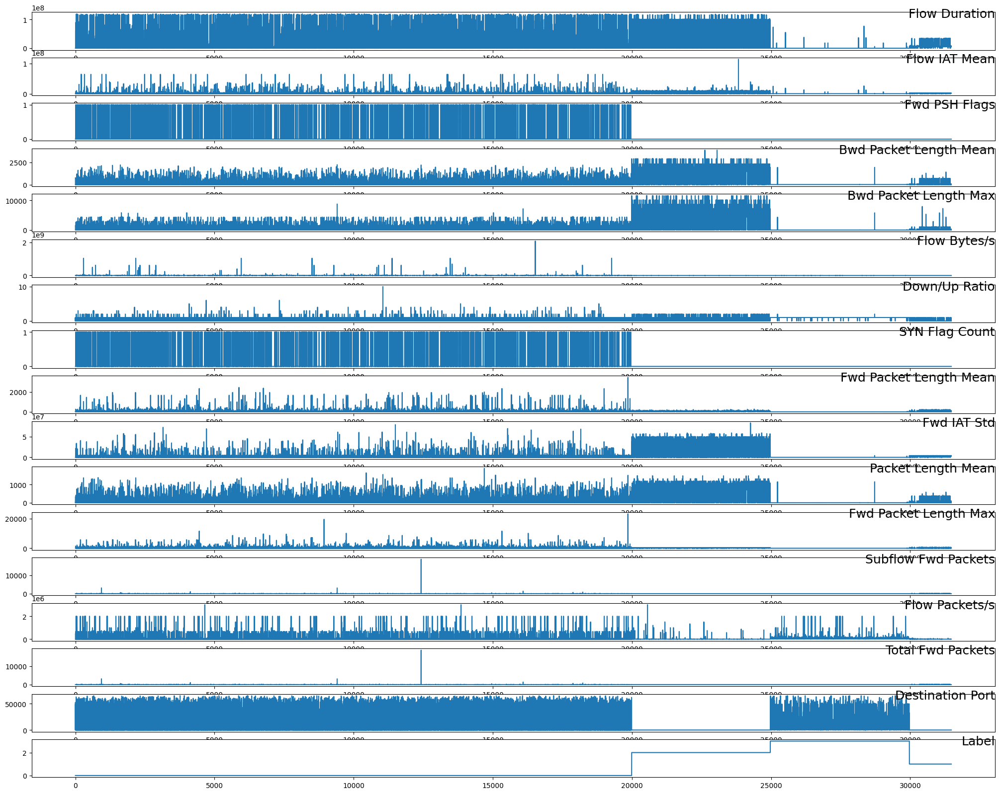

In [54]:
i = 1
# plot each column
plt.figure(figsize=(25,20))
for c in df.columns:
    plt.subplot(len(df.columns), 1, i)
    plt.plot(df[c])
    plt.title(c, y=0.75, loc='right', fontsize = 18)
    i += 1
plt.show()
plt.close()

<Figure size 1200x800 with 0 Axes>

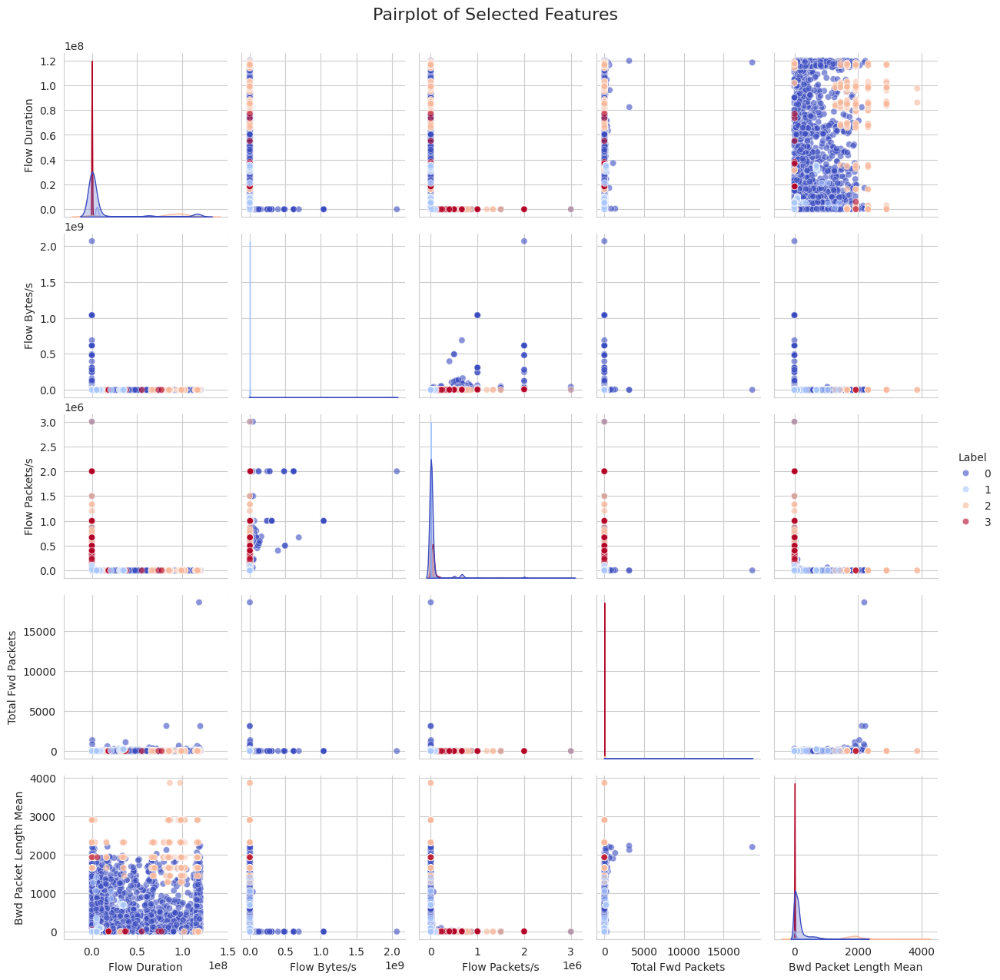

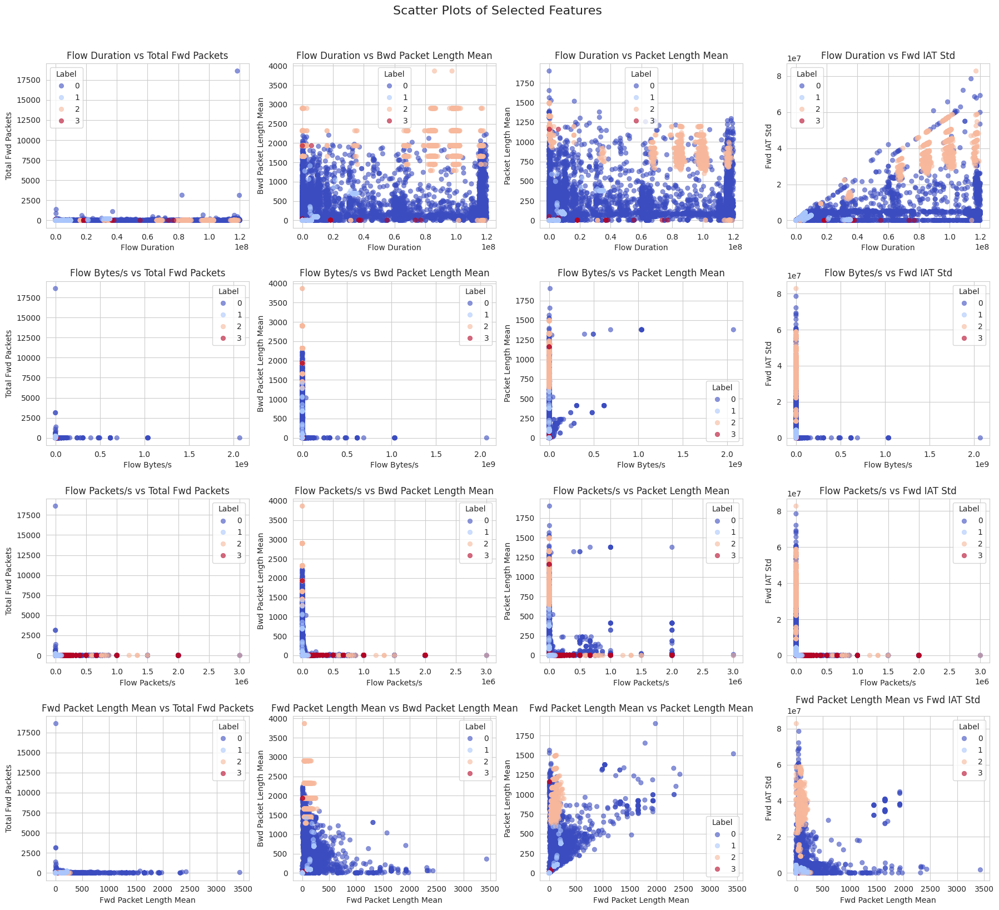

In [55]:
import matplotlib.pyplot as plt
import seaborn as sns



sns.set_style("whitegrid")

# 1. Scatter Plot Matrix (Pairplot)
features_to_plot = ['Flow Duration', 'Flow Bytes/s', 'Flow Packets/s', 'Total Fwd Packets', 'Bwd Packet Length Mean']
plt.figure(figsize=(12, 8))
sns.pairplot(df[features_to_plot + ['Label']], hue='Label', diag_kind='kde', palette='coolwarm', plot_kws={'alpha': 0.6})
plt.suptitle("Pairplot of Selected Features", fontsize=16, y=1.02)
plt.show()


features_x = ['Flow Duration', 'Flow Bytes/s', 'Flow Packets/s', 'Fwd Packet Length Mean']
features_y = ['Total Fwd Packets', 'Bwd Packet Length Mean', 'Packet Length Mean', 'Fwd IAT Std']

plt.figure(figsize=(18, 16))
plot_index = 1
for feature1 in features_x:
    for feature2 in features_y:
        plt.subplot(len(features_x), len(features_y), plot_index)
        sns.scatterplot(x=df[feature1], y=df[feature2], hue=df['Label'], alpha=0.6, palette='coolwarm', edgecolor=None)
        plt.xlabel(feature1, fontsize=10)
        plt.ylabel(feature2, fontsize=10)
        plt.title(f'{feature1} vs {feature2}', fontsize=12)
        plot_index += 1

plt.suptitle("Scatter Plots of Selected Features", fontsize=16, y=1.02)
plt.tight_layout()
plt.show()



### Correlation Matrix

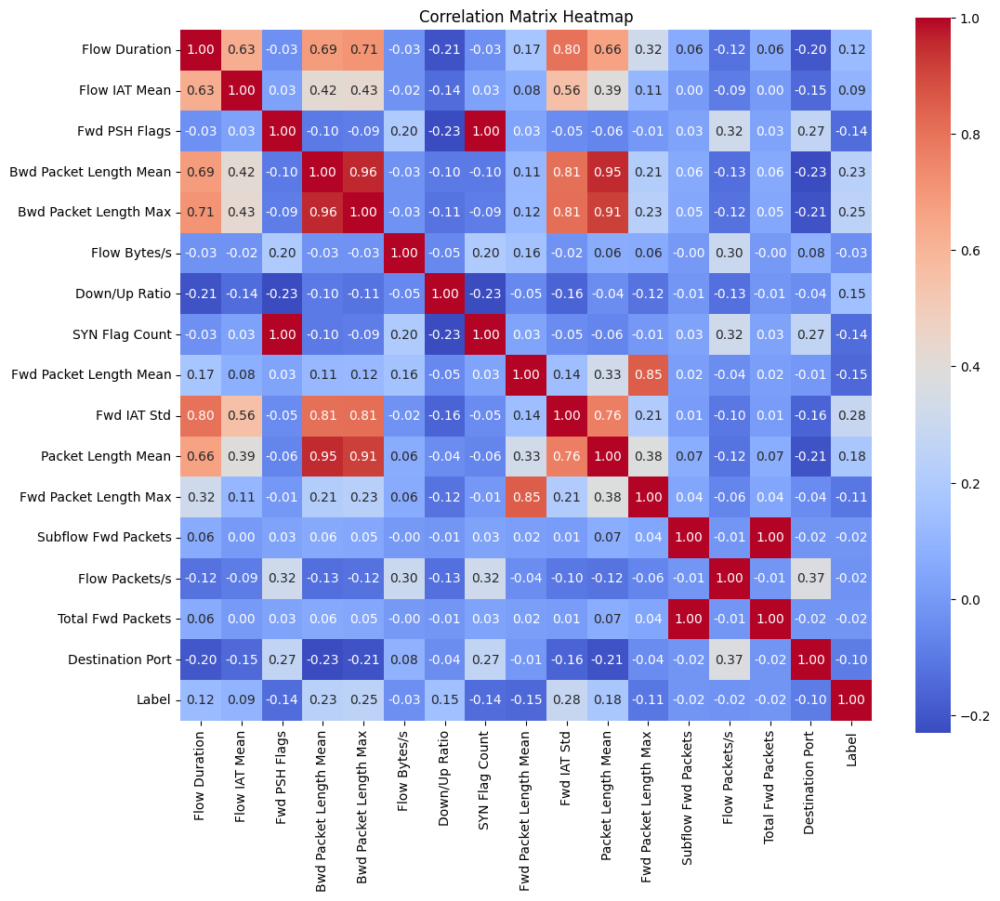

In [30]:
import matplotlib.pyplot as plt
import seaborn as sns

# Correlation Matrix
corr_matrix = df.corr()


plt.figure(figsize=(12, 10))
sns.heatmap(corr_matrix, annot=True, cmap='coolwarm', fmt=".2f", square=True)
plt.title("Correlation Matrix Heatmap")
plt.show()


In [31]:
import numpy as np


THRESHOLD = 0.99

corr = df.corr().abs()
upper = corr.where(np.triu(np.ones(corr.shape), k=1).astype(bool))

to_drop = [col for col in upper.columns if any(upper[col] > THRESHOLD)]
print(to_drop)


['SYN Flag Count', 'Total Fwd Packets']


In [32]:
(df['Fwd PSH Flags'] == df['SYN Flag Count']).all()

np.True_

In [33]:
df[['Fwd PSH Flags', 'SYN Flag Count']].drop_duplicates()



,Fwd PSH Flags,SYN Flag Count
0,0,0
13,1,1


In [34]:
cols_to_drop = [
    'Fwd PSH Flags',
    'Subflow Fwd Packets'
]

df = df.drop(columns=cols_to_drop)



Class counts:
Label
0    19240
1     1427
2     3868
3     4849
Name: count, dtype: int64


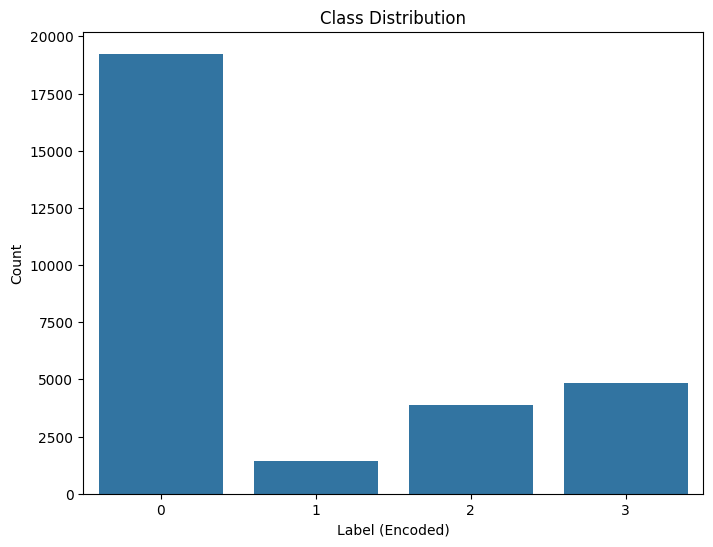

In [35]:
import matplotlib.pyplot as plt
import seaborn as sns

# Number of occurrences for each class
class_counts = df['Label'].value_counts().sort_index()
print("Class counts:")
print(class_counts)


plt.figure(figsize=(8, 6))
sns.countplot(x='Label', data=df, legend=False)
plt.title("Class Distribution")
plt.xlabel("Label (Encoded)")
plt.ylabel("Count")
plt.show()
#{'Benign': np.int64(0), 'Brute Force': np.int64(1), 'DoS Hulk': np.int64(2), 'PortScan': np.int64(3)}

/tmp/ipython-input-62-4198350486.py:11: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x='Label', y=feature, data=df, palette='Set2')
/tmp/ipython-input-62-4198350486.py:11: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x='Label', y=feature, data=df, palette='Set2')
/tmp/ipython-input-62-4198350486.py:11: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x='Label', y=feature, data=df, palette='Set2')
/tmp/ipython-input-62-4198350486.py:11: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Ass

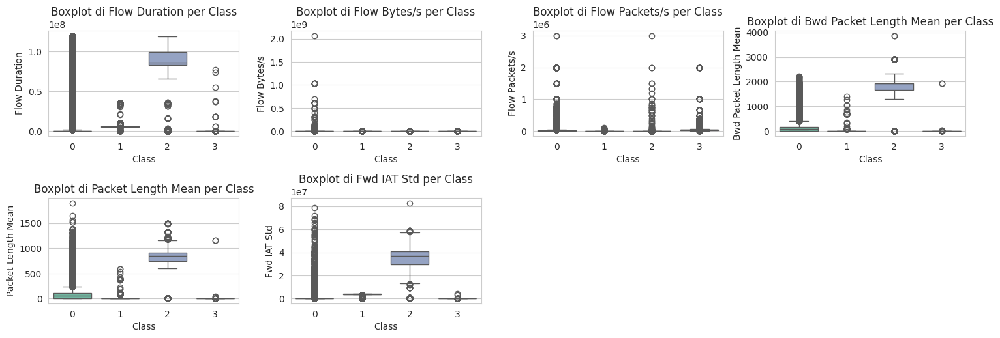

In [62]:
import matplotlib.pyplot as plt
import seaborn as sns


features = ['Flow Duration', 'Flow Bytes/s', 'Flow Packets/s', 'Bwd Packet Length Mean', 'Packet Length Mean', 'Fwd IAT Std']


plt.figure(figsize=(15, 10))
for i, feature in enumerate(features, 1):
    plt.subplot(4, 4, i)
    sns.boxplot(x='Label', y=feature, data=df, palette='Set2')
    plt.title(f'Boxplot di {feature} per Class')
    plt.xlabel('Class')
    plt.ylabel(feature)

plt.tight_layout()
plt.show()


/tmp/ipython-input-63-3136383551.py:4: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.violinplot(x='Label', y=feature, data=df, palette='Set2', inner='quartile')
/tmp/ipython-input-63-3136383551.py:4: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.violinplot(x='Label', y=feature, data=df, palette='Set2', inner='quartile')
/tmp/ipython-input-63-3136383551.py:4: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.violinplot(x='Label', y=feature, data=df, palette='Set2', inner='quartile')
/tmp/ipython-input-63-3136383551.py:4: FutureWarning: 

Passing `palette` without assign

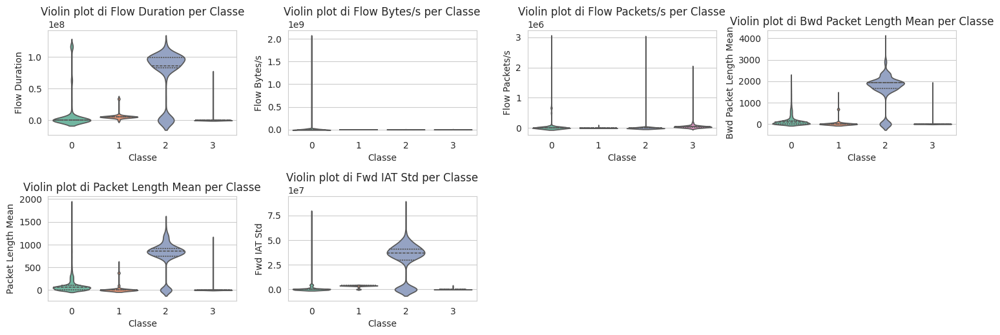

In [63]:
plt.figure(figsize=(15, 10))
for i, feature in enumerate(features, 1):
    plt.subplot(4, 4, i)
    sns.violinplot(x='Label', y=feature, data=df, palette='Set2', inner='quartile')
    plt.title(f'Violin plot di {feature} per Classe')
    plt.xlabel('Classe')
    plt.ylabel(feature)

plt.tight_layout()
plt.show()


### skewness analysis

In [64]:
numeric_feats = df.select_dtypes(include=['int64','float64']).columns
skewness = df[numeric_feats].skew().sort_values(ascending=False)
print(skewness)


Total Fwd Packets         152.007747
Flow Bytes/s               41.798570
Fwd Packet Length Max      12.173963
Fwd Packet Length Mean     11.139485
Flow Packets/s              7.280535
Flow IAT Mean               7.197015
SYN Flag Count              4.737087
Fwd IAT Std                 2.526223
Bwd Packet Length Max       2.465285
Destination Port            2.154604
Bwd Packet Length Mean      2.105616
Packet Length Mean          1.980722
Flow Duration               1.810170
Label                       0.968786
Down/Up Ratio               0.347508
dtype: float64


### Dataset split

In [36]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import FunctionTransformer, RobustScaler
import matplotlib.pyplot as plt
import seaborn as sns


X = df.drop(columns=['Label'])
y = df['Label']

# 1.  training (60%), validation (20%), and test (20%) sets
X_train, X_temp, y_train, y_temp = train_test_split(
    X, y, test_size=0.4, random_state=42, stratify=y
)
X_val, X_test, y_val, y_test = train_test_split(
    X_temp, y_temp, test_size=0.5, random_state=42, stratify=y_temp
)


print("Class distribution - Train:\n", y_train.value_counts())
print("Class distribution - Val:\n", y_val.value_counts())
print("Class distribution - Test:\n", y_test.value_counts())

Class distribution - Train:
 Label
0    11544
3     2909
2     2321
1      856
Name: count, dtype: int64
Class distribution - Val:
 Label
0    3848
3     970
2     774
1     285
Name: count, dtype: int64
Class distribution - Test:
 Label
0    3848
3     970
2     773
1     286
Name: count, dtype: int64


### Analysis for features (raw data - not scaled)

Train Set Class Distribution:
Class 0: 65.48%
Class 1: 4.86%
Class 2: 13.17%
Class 3: 16.50%

Test Set Class Distribution:
Class 0: 65.48%
Class 1: 4.87%
Class 2: 13.15%
Class 3: 16.51%

Validation Set Class Distribution:
Class 0: 65.48%
Class 1: 4.85%
Class 2: 13.17%
Class 3: 16.51%
({np.int64(0): np.float64(65.47929665343165), np.int64(1): np.float64(4.855360181508791), np.int64(2): np.float64(13.16505955757232), np.int64(3): np.float64(16.500283607487237)}, {np.int64(0): np.float64(65.4755827803301), np.int64(1): np.float64(4.8664284498893995), np.int64(2): np.float64(13.152969201973796), np.int64(3): np.float64(16.505019567806702)}, {np.int64(0): np.float64(65.4755827803301), np.int64(1): np.float64(4.849412965798877), np.int64(2): np.float64(13.169984686064318), np.int64(3): np.float64(16.505019567806702)})

--- Analysis for Feature: Flow Duration ---


/tmp/ipython-input-66-3966410394.py:86: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  plt.boxplot(box_data, labels=['Train', 'Test', 'Validation'])


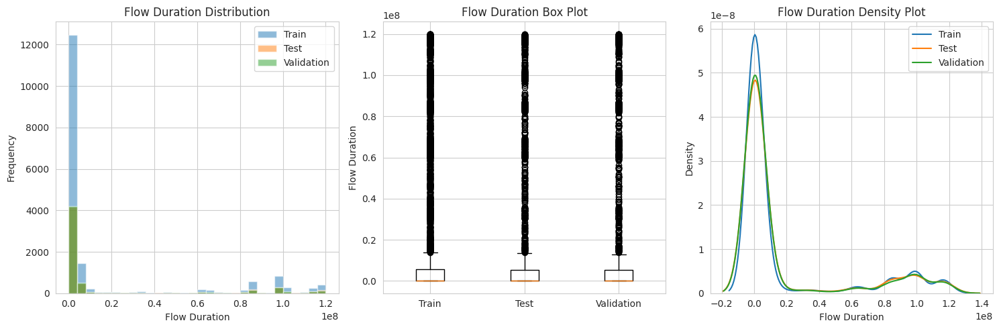

Kolmogorov-Smirnov Test Results:
Train vs Test:
  Statistic: 0.0075
  P-value: 0.9632
  Significant Difference: False
Train vs Validation:
  Statistic: 0.0136
  P-value: 0.3831
  Significant Difference: False
Test vs Validation:
  Statistic: 0.0133
  P-value: 0.6787
  Significant Difference: False

Jensen-Shannon Divergence:
train_vs_test_js_div: 0.0010
train_vs_val_js_div: 0.0008
test_vs_val_js_div: 0.0008

--- Analysis for Feature: Flow IAT Mean ---


/tmp/ipython-input-66-3966410394.py:86: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  plt.boxplot(box_data, labels=['Train', 'Test', 'Validation'])


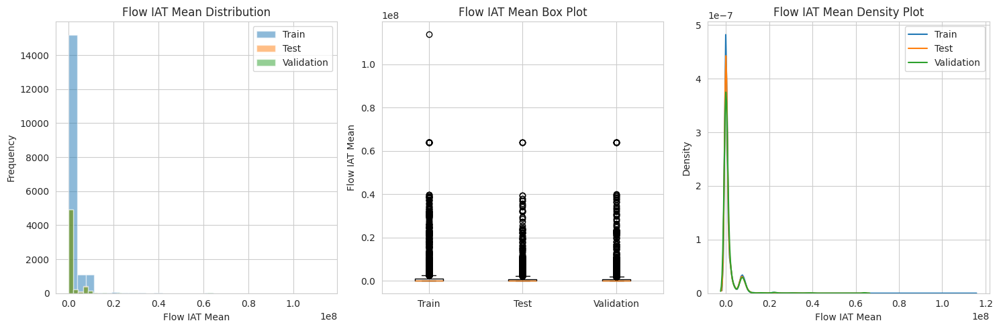

Kolmogorov-Smirnov Test Results:
Train vs Test:
  Statistic: 0.0108
  P-value: 0.6738
  Significant Difference: False
Train vs Validation:
  Statistic: 0.0121
  P-value: 0.5356
  Significant Difference: False
Test vs Validation:
  Statistic: 0.0131
  P-value: 0.6942
  Significant Difference: False

Jensen-Shannon Divergence:
train_vs_test_js_div: 0.0370
train_vs_val_js_div: 0.0391
test_vs_val_js_div: 0.0008

--- Analysis for Feature: Bwd Packet Length Mean ---


/tmp/ipython-input-66-3966410394.py:86: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  plt.boxplot(box_data, labels=['Train', 'Test', 'Validation'])


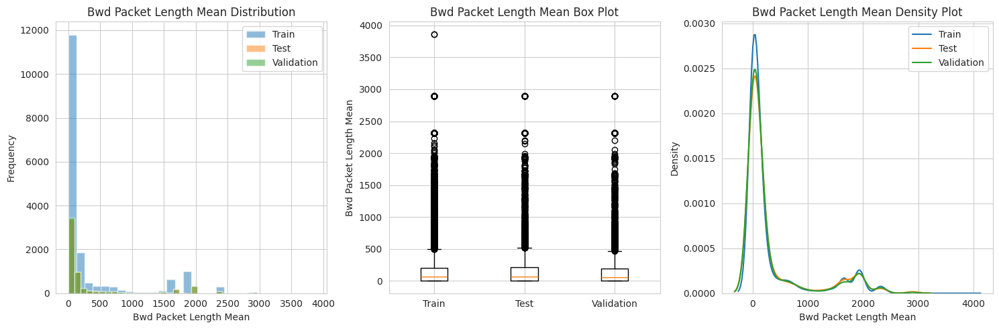

Kolmogorov-Smirnov Test Results:
Train vs Test:
  Statistic: 0.0085
  P-value: 0.9050
  Significant Difference: False
Train vs Validation:
  Statistic: 0.0142
  P-value: 0.3313
  Significant Difference: False
Test vs Validation:
  Statistic: 0.0143
  P-value: 0.5857
  Significant Difference: False

Jensen-Shannon Divergence:
train_vs_test_js_div: 0.0774
train_vs_val_js_div: 0.0780
test_vs_val_js_div: 0.0010

--- Analysis for Feature: Bwd Packet Length Max ---


/tmp/ipython-input-66-3966410394.py:86: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  plt.boxplot(box_data, labels=['Train', 'Test', 'Validation'])


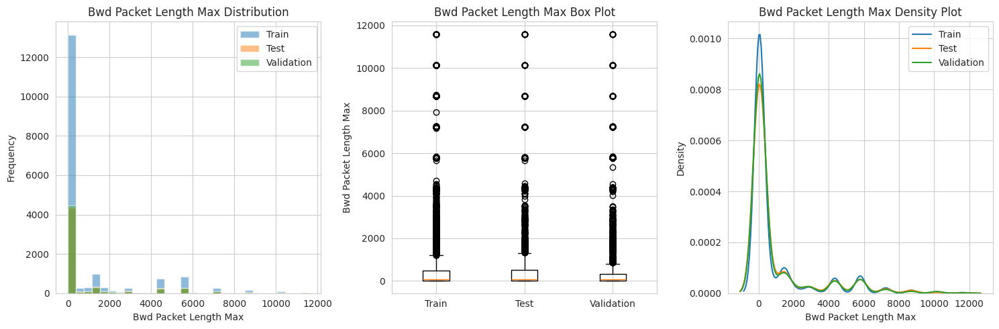

Kolmogorov-Smirnov Test Results:
Train vs Test:
  Statistic: 0.0090
  P-value: 0.8634
  Significant Difference: False
Train vs Validation:
  Statistic: 0.0149
  P-value: 0.2757
  Significant Difference: False
Test vs Validation:
  Statistic: 0.0160
  P-value: 0.4399
  Significant Difference: False

Jensen-Shannon Divergence:
train_vs_test_js_div: 0.0005
train_vs_val_js_div: 0.0013
test_vs_val_js_div: 0.0015

--- Analysis for Feature: Flow Bytes/s ---


/tmp/ipython-input-66-3966410394.py:86: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  plt.boxplot(box_data, labels=['Train', 'Test', 'Validation'])


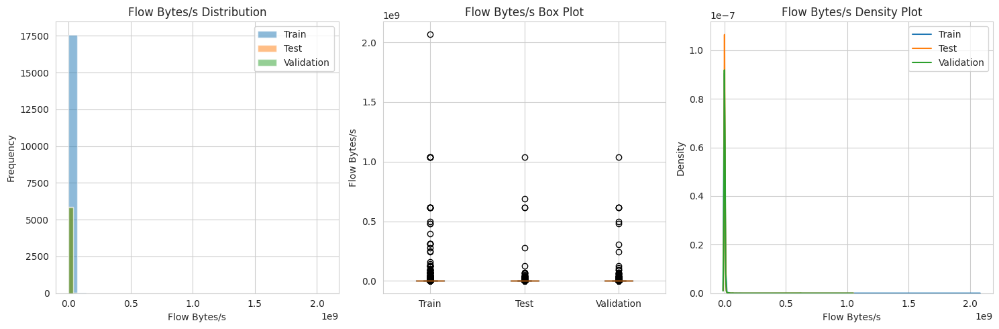

Kolmogorov-Smirnov Test Results:
Train vs Test:
  Statistic: 0.0091
  P-value: 0.8564
  Significant Difference: False
Train vs Validation:
  Statistic: 0.0160
  P-value: 0.2044
  Significant Difference: False
Test vs Validation:
  Statistic: 0.0153
  P-value: 0.4960
  Significant Difference: False

Jensen-Shannon Divergence:
train_vs_test_js_div: 0.0007
train_vs_val_js_div: 0.0008
test_vs_val_js_div: 0.0003

--- Analysis for Feature: Down/Up Ratio ---


/tmp/ipython-input-66-3966410394.py:86: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  plt.boxplot(box_data, labels=['Train', 'Test', 'Validation'])


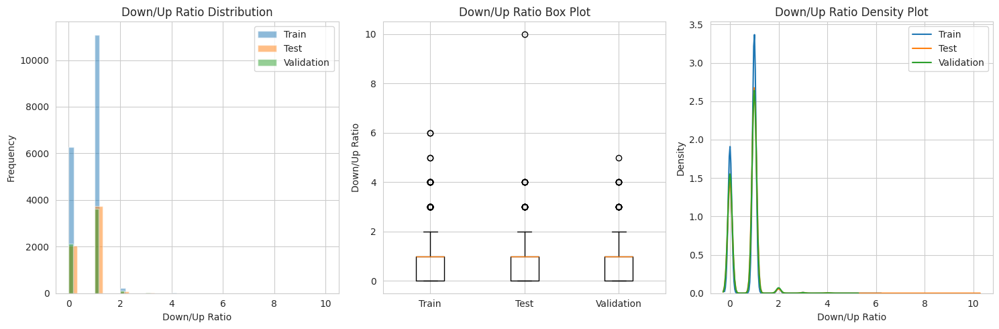

Kolmogorov-Smirnov Test Results:
Train vs Test:
  Statistic: 0.0072
  P-value: 0.9743
  Significant Difference: False
Train vs Validation:
  Statistic: 0.0078
  P-value: 0.9520
  Significant Difference: False
Test vs Validation:
  Statistic: 0.0150
  P-value: 0.5253
  Significant Difference: False

Jensen-Shannon Divergence:
train_vs_test_js_div: 0.4703
train_vs_val_js_div: 0.4468
test_vs_val_js_div: 0.4489

--- Analysis for Feature: SYN Flag Count ---


/tmp/ipython-input-66-3966410394.py:86: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  plt.boxplot(box_data, labels=['Train', 'Test', 'Validation'])


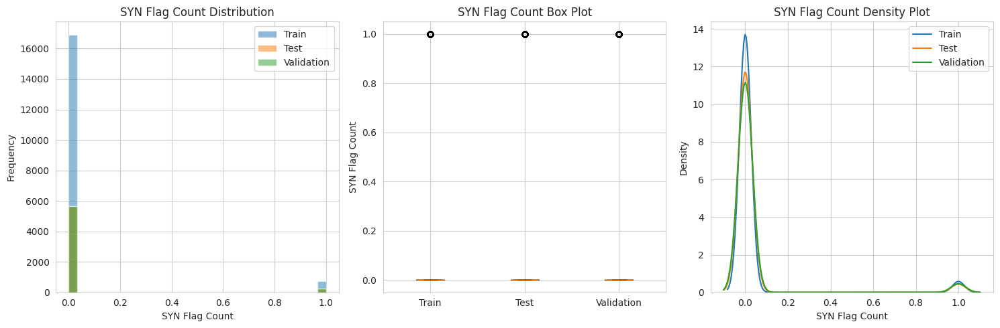

Kolmogorov-Smirnov Test Results:
Train vs Test:
  Statistic: 0.0046
  P-value: 1.0000
  Significant Difference: False
Train vs Validation:
  Statistic: 0.0010
  P-value: 1.0000
  Significant Difference: False
Test vs Validation:
  Statistic: 0.0036
  P-value: 1.0000
  Significant Difference: False

Jensen-Shannon Divergence:
train_vs_test_js_div: 0.0001
train_vs_val_js_div: 0.0000
test_vs_val_js_div: 0.0000

--- Analysis for Feature: Fwd Packet Length Mean ---


/tmp/ipython-input-66-3966410394.py:86: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  plt.boxplot(box_data, labels=['Train', 'Test', 'Validation'])


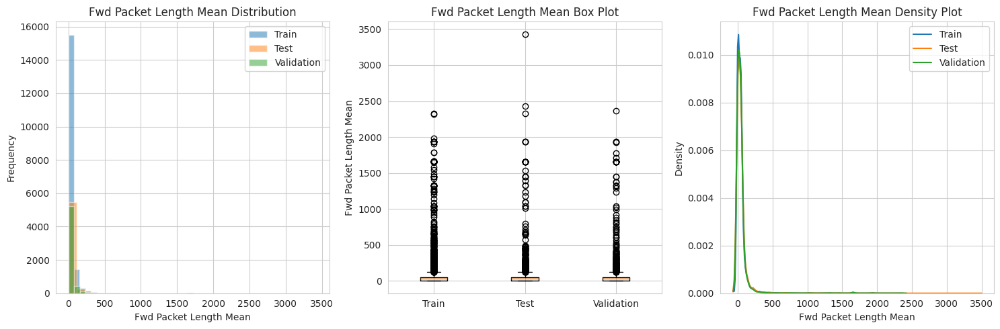

Kolmogorov-Smirnov Test Results:
Train vs Test:
  Statistic: 0.0076
  P-value: 0.9574
  Significant Difference: False
Train vs Validation:
  Statistic: 0.0130
  P-value: 0.4420
  Significant Difference: False
Test vs Validation:
  Statistic: 0.0160
  P-value: 0.4399
  Significant Difference: False

Jensen-Shannon Divergence:
train_vs_test_js_div: 0.0055
train_vs_val_js_div: 0.0006
test_vs_val_js_div: 0.0039

--- Analysis for Feature: Fwd IAT Std ---


/tmp/ipython-input-66-3966410394.py:86: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  plt.boxplot(box_data, labels=['Train', 'Test', 'Validation'])


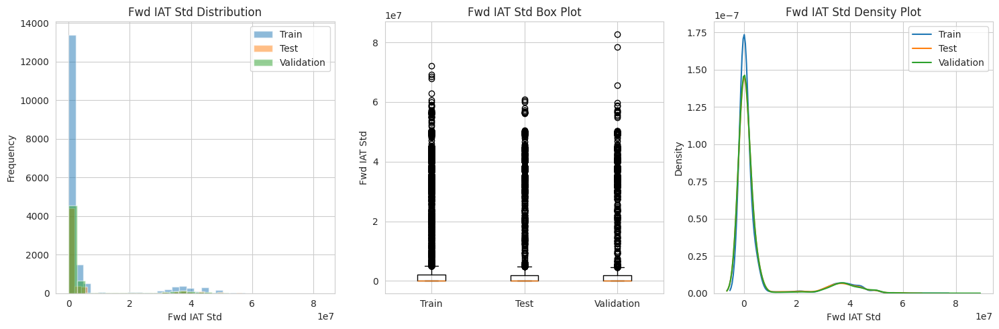

Kolmogorov-Smirnov Test Results:
Train vs Test:
  Statistic: 0.0058
  P-value: 0.9983
  Significant Difference: False
Train vs Validation:
  Statistic: 0.0153
  P-value: 0.2524
  Significant Difference: False
Test vs Validation:
  Statistic: 0.0180
  P-value: 0.2947
  Significant Difference: False

Jensen-Shannon Divergence:
train_vs_test_js_div: 0.0237
train_vs_val_js_div: 0.0195
test_vs_val_js_div: 0.0501

--- Analysis for Feature: Packet Length Mean ---


/tmp/ipython-input-66-3966410394.py:86: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  plt.boxplot(box_data, labels=['Train', 'Test', 'Validation'])


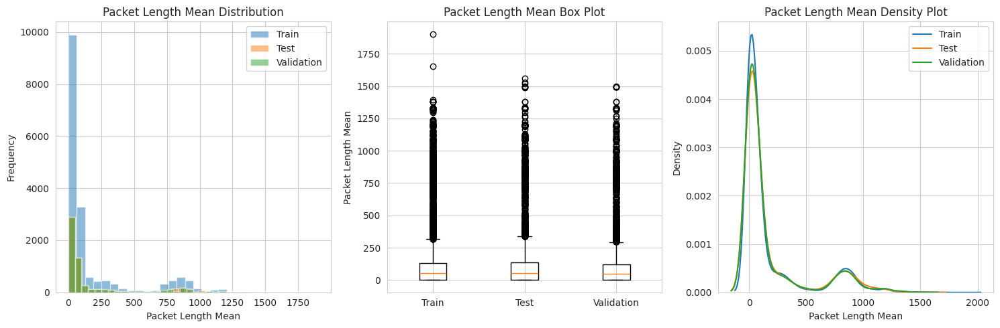

Kolmogorov-Smirnov Test Results:
Train vs Test:
  Statistic: 0.0094
  P-value: 0.8320
  Significant Difference: False
Train vs Validation:
  Statistic: 0.0142
  P-value: 0.3360
  Significant Difference: False
Test vs Validation:
  Statistic: 0.0157
  P-value: 0.4675
  Significant Difference: False

Jensen-Shannon Divergence:
train_vs_test_js_div: 0.0375
train_vs_val_js_div: 0.0393
test_vs_val_js_div: 0.0149

--- Analysis for Feature: Fwd Packet Length Max ---


/tmp/ipython-input-66-3966410394.py:86: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  plt.boxplot(box_data, labels=['Train', 'Test', 'Validation'])


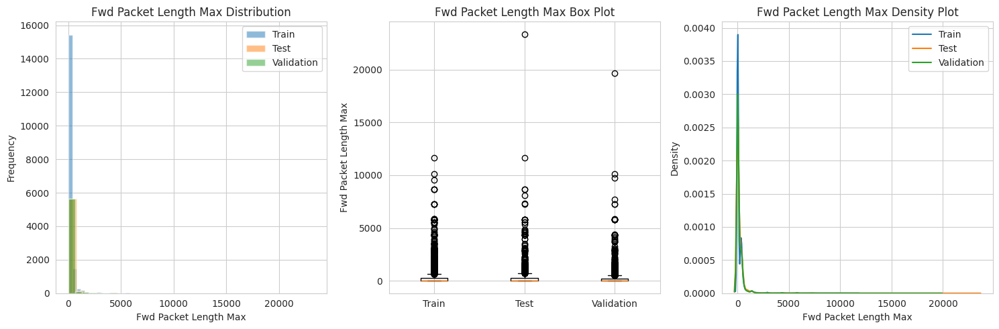

Kolmogorov-Smirnov Test Results:
Train vs Test:
  Statistic: 0.0087
  P-value: 0.8876
  Significant Difference: False
Train vs Validation:
  Statistic: 0.0157
  P-value: 0.2269
  Significant Difference: False
Test vs Validation:
  Statistic: 0.0208
  P-value: 0.1588
  Significant Difference: False

Jensen-Shannon Divergence:
train_vs_test_js_div: 0.0139
train_vs_val_js_div: 0.0161
test_vs_val_js_div: 0.0027

--- Analysis for Feature: Flow Packets/s ---


/tmp/ipython-input-66-3966410394.py:86: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  plt.boxplot(box_data, labels=['Train', 'Test', 'Validation'])


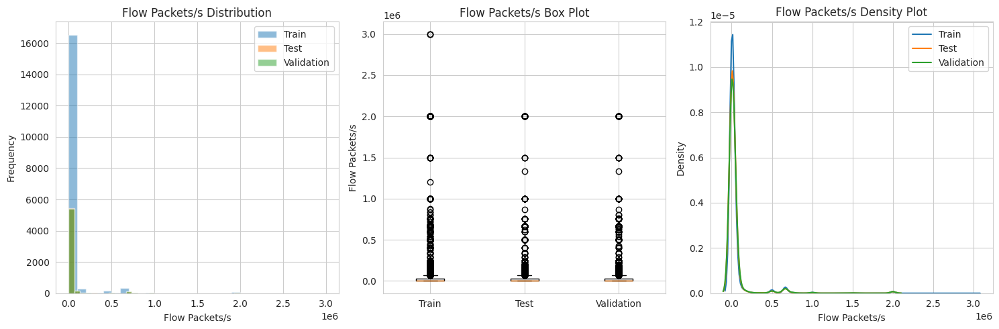

Kolmogorov-Smirnov Test Results:
Train vs Test:
  Statistic: 0.0102
  P-value: 0.7488
  Significant Difference: False
Train vs Validation:
  Statistic: 0.0121
  P-value: 0.5351
  Significant Difference: False
Test vs Validation:
  Statistic: 0.0126
  P-value: 0.7401
  Significant Difference: False

Jensen-Shannon Divergence:
train_vs_test_js_div: 0.0218
train_vs_val_js_div: 0.0225
test_vs_val_js_div: 0.0006

--- Analysis for Feature: Total Fwd Packets ---


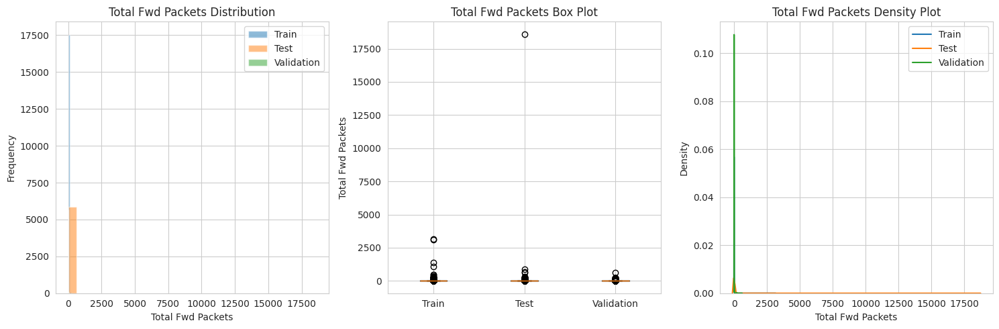

Kolmogorov-Smirnov Test Results:
Train vs Test:
  Statistic: 0.0137
  P-value: 0.3756
  Significant Difference: False
Train vs Validation:
  Statistic: 0.0160
  P-value: 0.2097
  Significant Difference: False
Test vs Validation:
  Statistic: 0.0140
  P-value: 0.6165
  Significant Difference: False

Jensen-Shannon Divergence:
train_vs_test_js_div: 0.0014
train_vs_val_js_div: 0.0075
test_vs_val_js_div: 0.0140

--- Analysis for Feature: Destination Port ---


/tmp/ipython-input-66-3966410394.py:86: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  plt.boxplot(box_data, labels=['Train', 'Test', 'Validation'])


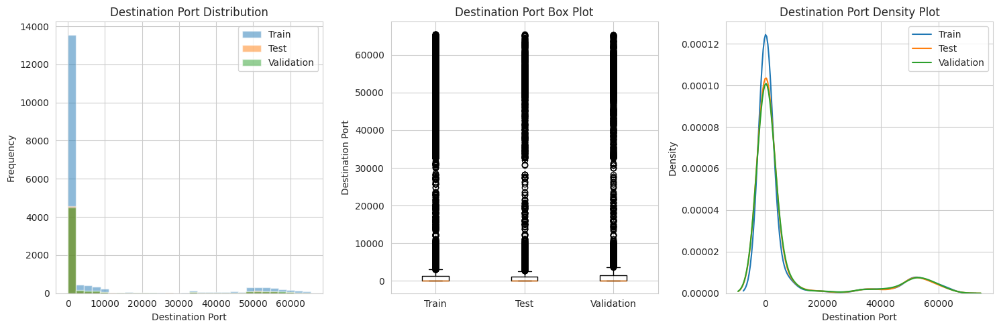

Kolmogorov-Smirnov Test Results:
Train vs Test:
  Statistic: 0.0098
  P-value: 0.7846
  Significant Difference: False
Train vs Validation:
  Statistic: 0.0071
  P-value: 0.9790
  Significant Difference: False
Test vs Validation:
  Statistic: 0.0148
  P-value: 0.5402
  Significant Difference: False

Jensen-Shannon Divergence:
train_vs_test_js_div: 0.0007
train_vs_val_js_div: 0.0006
test_vs_val_js_div: 0.0014


{'Flow Duration': {'ks_tests': {'train_vs_test': {'statistic': np.float64(0.007511202182074184),
    'p_value': np.float64(0.9631919797937922),
    'sets_compared': 'Train vs Test',
    'significant_difference': np.False_},
   'train_vs_val': {'statistic': np.float64(0.013623959345829384),
    'p_value': np.float64(0.3830925418010922),
    'sets_compared': 'Train vs Validation',
    'significant_difference': np.False_},
   'test_vs_val': {'statistic': np.float64(0.013272077590607452),
    'p_value': np.float64(0.6787021676381784),
    'sets_compared': 'Test vs Validation',
    'significant_difference': np.False_}},
  'distribution_metrics': {'train_vs_test_js_div': np.float64(0.0010247426752211387),
   'train_vs_val_js_div': np.float64(0.0007967441166627167),
   'test_vs_val_js_div': np.float64(0.00079702588512927)}},
 'Flow IAT Mean': {'ks_tests': {'train_vs_test': {'statistic': np.float64(0.010842473003240705),
    'p_value': np.float64(0.673771808992577),
    'sets_compared': 'Train

In [66]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from scipy import stats
import scipy.stats as stats_scipy

def analyze_class_distribution(y_train, y_test, y_val):
    """
    Analyze class distribution across train, test, and validation sets.

    Args:
        y_train (np.ndarray): Training labels.
        y_test (np.ndarray): Test labels.
        y_val (np.ndarray): Validation labels.
    """
    def get_class_distribution(labels):
        unique, counts = np.unique(labels, return_counts=True)
        total = len(labels)
        percentages = (counts / total) * 100
        return dict(zip(unique, percentages))

    print("Train Set Class Distribution:")
    train_dist = get_class_distribution(y_train)
    for cls, percentage in train_dist.items():
        print(f"Class {cls}: {percentage:.2f}%")

    print("\nTest Set Class Distribution:")
    test_dist = get_class_distribution(y_test)
    for cls, percentage in test_dist.items():
        print(f"Class {cls}: {percentage:.2f}%")

    print("\nValidation Set Class Distribution:")
    val_dist = get_class_distribution(y_val)
    for cls, percentage in val_dist.items():
        print(f"Class {cls}: {percentage:.2f}%")

    return train_dist, test_dist, val_dist

distributions = analyze_class_distribution(y_train, y_test, y_val)
print(distributions)

def compare_distributions(train_data, test_data, val_data, feature_name):
    """
    Compare distributions of a specific feature across train, test, and validation sets.

    Parameters:
        train_data: Training dataset feature column.
        test_data: Test dataset feature column.
        val_data: Validation dataset feature column.
        feature_name: Name of the feature being analyzed.

    Returns:
        Dictionary of statistical test results and visualization.
    """
    results = {}

    # 1. Statistical Tests (Kolmogorov-Smirnov Test)
    def ks_test_between_sets(set1, set2, set_names):
        statistic, p_value = stats.ks_2samp(set1, set2)
        return {
            'statistic': statistic,
            'p_value': p_value,
            'sets_compared': set_names,
            'significant_difference': p_value < 0.05
        }

    results['ks_tests'] = {
        'train_vs_test': ks_test_between_sets(train_data, test_data, 'Train vs Test'),
        'train_vs_val': ks_test_between_sets(train_data, val_data, 'Train vs Validation'),
        'test_vs_val': ks_test_between_sets(test_data, val_data, 'Test vs Validation')
    }

    # 2. Distribution Visualization
    plt.figure(figsize=(15, 5))
    plt.subplot(131)
    plt.hist(train_data, bins=30, alpha=0.5, label='Train')
    plt.hist(test_data, bins=30, alpha=0.5, label='Test')
    plt.hist(val_data, bins=30, alpha=0.5, label='Validation')
    plt.title(f'{feature_name} Distribution')
    plt.xlabel(feature_name)
    plt.ylabel('Frequency')
    plt.legend()

    plt.subplot(132)
    box_data = [train_data, test_data, val_data]
    plt.boxplot(box_data, labels=['Train', 'Test', 'Validation'])
    plt.title(f'{feature_name} Box Plot')
    plt.ylabel(feature_name)

    plt.subplot(133)
    sns.kdeplot(train_data, label='Train')
    sns.kdeplot(test_data, label='Test')
    sns.kdeplot(val_data, label='Validation')
    plt.title(f'{feature_name} Density Plot')
    plt.xlabel(feature_name)
    plt.ylabel('Density')
    plt.legend()
    plt.tight_layout()
    plt.show()

    # 3. Distribution Metrics (Jensen-Shannon Divergence)
    def jensen_shannon_divergence(p, q):
        p = np.asarray(p)
        q = np.asarray(q)
        m = 0.5 * (p + q)
        return 0.5 * (stats_scipy.entropy(p, m) + stats_scipy.entropy(q, m))

    def get_distribution_histogram(data, bins=30):
        hist, _ = np.histogram(data, bins=bins, density=True)
        return hist

    results['distribution_metrics'] = {
        'train_vs_test_js_div': jensen_shannon_divergence(
            get_distribution_histogram(train_data),
            get_distribution_histogram(test_data)
        ),
        'train_vs_val_js_div': jensen_shannon_divergence(
            get_distribution_histogram(train_data),
            get_distribution_histogram(val_data)
        ),
        'test_vs_val_js_div': jensen_shannon_divergence(
            get_distribution_histogram(test_data),
            get_distribution_histogram(val_data)
        )
    }
    return results

def analyze_feature_distributions(X_train, X_test, X_val, feature_names=None):
    """
    Analyze distributions for multiple features.

    Parameters:
        X_train: Training dataset (2D NumPy array).
        X_test: Test dataset (2D NumPy array).
        X_val: Validation dataset (2D NumPy array).
        feature_names: Optional list of feature names (default is column indices).
    """
    if feature_names is None:
        feature_names = [f'Feature_{i}' for i in range(X_train.shape[1])]

    assert X_train.shape[1] == len(feature_names), "Number of feature names must match number of columns"
    comprehensive_results = {}
    for idx, feature in enumerate(feature_names):
        print(f"\n--- Analysis for Feature: {feature} ---")
        train_feature = X_train[:, idx]
        test_feature = X_test[:, idx]
        val_feature = X_val[:, idx]
        results = compare_distributions(train_feature, test_feature, val_feature, feature)
        comprehensive_results[feature] = results
        print("Kolmogorov-Smirnov Test Results:")
        for key, test_result in results['ks_tests'].items():
            print(f"{test_result['sets_compared']}:")
            print(f"  Statistic: {test_result['statistic']:.4f}")
            print(f"  P-value: {test_result['p_value']:.4f}")
            print(f"  Significant Difference: {test_result['significant_difference']}")
        print("\nJensen-Shannon Divergence:")
        for key, div_value in results['distribution_metrics'].items():
            print(f"{key}: {div_value:.4f}")
    return comprehensive_results

# Example usage (using the scaled data from Case 1)
# Make sure to define a list of feature names, e.g.:
features = X_train.columns.tolist()
analyze_feature_distributions(X_train.to_numpy(), X_test.to_numpy(), X_val.to_numpy(), features)


### Outliers analysis (raw data)

In [67]:
import numpy as np

def detect_outliers_iqr(data, multiplier=1.5):
    """
    Detect outliers using Interquartile Range method

    Parameters:
    - data: NumPy array
    - multiplier: IQR multiplier (default 1.5)

    Returns:
    - Boolean array indicating outliers
    """
    Q1 = np.percentile(data, 25)
    Q3 = np.percentile(data, 75)
    IQR = Q3 - Q1
    lower_bound = Q1 - (multiplier * IQR)
    upper_bound = Q3 + (multiplier * IQR)
    return (data < lower_bound) | (data > upper_bound)

def analyze_outliers_by_class(X, y, method='iqr', multiplier=1.5):
    """
    Analyze outliers across different classes

    Parameters:
    - X: Feature matrix (2D NumPy array)
    - y: Class labels (1D NumPy array)
    - method: Outlier detection method ('iqr')
    - multiplier: Multiplier for IQR method

    Returns:
    - Comprehensive outlier analysis by class
    """
    # Unique classes
    unique_classes = np.unique(y)

    # Outlier analysis results
    outlier_analysis = {
        'overall_results': {},
        'class_results': {}
    }

    # Total outliers tracking
    total_outliers = 0
    total_samples = len(y)

    # Analyze each feature
    for feature_idx in range(X.shape[1]):
        feature_outliers = {
            'overall_outliers': [],
            'class_outliers': {}
        }

        # Current feature column
        feature_data = X[:, feature_idx]

        # Detect overall outliers
        overall_outlier_mask = detect_outliers_iqr(feature_data, multiplier)
        feature_outliers['overall_outliers'] = overall_outlier_mask

        # Per-class analysis
        for cls in unique_classes:
            # Mask for current class
            class_mask = (y == cls)

            # Feature data for current class
            class_feature_data = feature_data[class_mask]

            # Detect outliers for this class
            class_outlier_mask = detect_outliers_iqr(class_feature_data, multiplier)

            # Store class-specific results
            feature_outliers['class_outliers'][cls] = {
                'total_samples': len(class_feature_data),
                'outlier_samples': np.sum(class_outlier_mask),
                'outlier_percentage': (np.sum(class_outlier_mask) / len(class_feature_data)) * 100
            }

        # Store results for this feature
        outlier_analysis['overall_results'][f'Feature_{feature_idx}'] = feature_outliers

    # Summarize overall results
    print("\nOutlier Analysis Summary:")
    for feature, results in outlier_analysis['overall_results'].items():
        print(f"\n{feature}:")

        # Overall outliers
        overall_outliers = np.sum(results['overall_outliers'])
        overall_outlier_percentage = (overall_outliers / total_samples) * 100
        print(f"  Total Outliers: {overall_outliers} ({overall_outlier_percentage:.2f}%)")

        # Class-specific results
        print("  Class-wise Outlier Breakdown:")
        for cls, class_results in results['class_outliers'].items():
            print(f"    Class {cls}:")
            print(f"      Total Samples: {class_results['total_samples']}")
            print(f"      Outlier Samples: {class_results['outlier_samples']}")
            print(f"      Outlier Percentage: {class_results['outlier_percentage']:.2f}%")

    return outlier_analysis





outlier_analysis = analyze_outliers_by_class(X_train.to_numpy(), y_train)




Outlier Analysis Summary:

Feature_0:
  Total Outliers: 3483 (19.76%)
  Class-wise Outlier Breakdown:
    Class 0:
      Total Samples: 11544
      Outlier Samples: 2669
      Outlier Percentage: 23.12%
    Class 1:
      Total Samples: 856
      Outlier Samples: 128
      Outlier Percentage: 14.95%
    Class 2:
      Total Samples: 2321
      Outlier Samples: 485
      Outlier Percentage: 20.90%
    Class 3:
      Total Samples: 2909
      Outlier Samples: 348
      Outlier Percentage: 11.96%

Feature_1:
  Total Outliers: 2898 (16.44%)
  Class-wise Outlier Breakdown:
    Class 0:
      Total Samples: 11544
      Outlier Samples: 2512
      Outlier Percentage: 21.76%
    Class 1:
      Total Samples: 856
      Outlier Samples: 115
      Outlier Percentage: 13.43%
    Class 2:
      Total Samples: 2321
      Outlier Samples: 499
      Outlier Percentage: 21.50%
    Class 3:
      Total Samples: 2909
      Outlier Samples: 348
      Outlier Percentage: 11.96%

Feature_2:
  Total Outlier

### Log transform + Robust Scaler ( our choice )

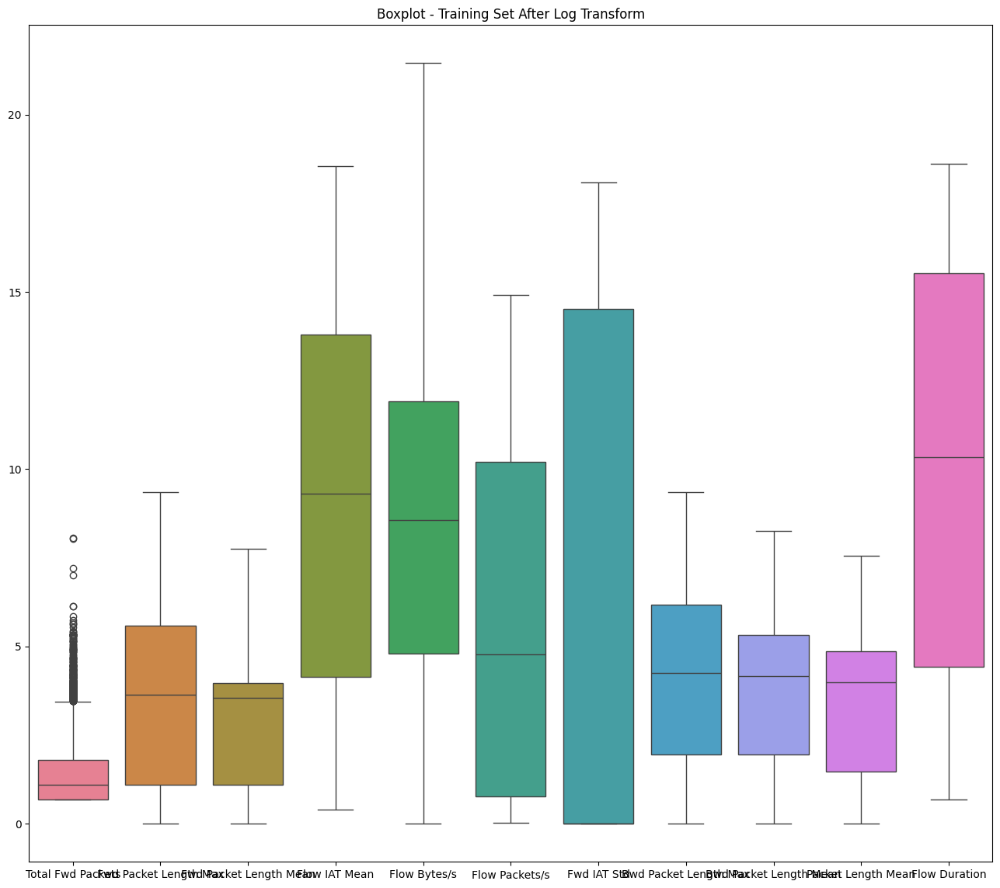

In [37]:
# Preprocessing on training and validation: log transform and scaling
# log transformer using np.log1p (log(x+1))
log_transformer = FunctionTransformer(np.log1p, validate=False)

columns_to_log = [
'Total Fwd Packets',
'Fwd Packet Length Max',
'Fwd Packet Length Mean',
'Flow IAT Mean',
'Flow Bytes/s',
'Flow Packets/s',
'Fwd IAT Std',
'Bwd Packet Length Max',
'Bwd Packet Length Mean',
'Packet Length Mean',
'Flow Duration' ]


X_train_log = X_train.copy()
X_val_log = X_val.copy()

for col in columns_to_log:
    X_train_log[col] = log_transformer.transform(X_train_log[[col]])
    X_val_log[col] = log_transformer.transform(X_val_log[[col]])


plt.figure(figsize=(16, 14))
sns.boxplot(data=X_train_log[columns_to_log])
plt.title("Boxplot - Training Set After Log Transform")
plt.show()


scaler = RobustScaler()
X_train_scaled = scaler.fit_transform(X_train_log)
X_val_scaled = scaler.transform(X_val_log)


X_train_scaled = pd.DataFrame(X_train_scaled, columns=X_train_log.columns, index=X_train_log.index)
X_val_scaled = pd.DataFrame(X_val_scaled, columns=X_val_log.columns, index=X_val_log.index)

# Preprocessing test set

X_test_log = X_test.copy()
for col in columns_to_log:
    X_test_log[col] = log_transformer.transform(X_test_log[[col]])

X_test_scaled = scaler.transform(X_test_log)
X_test_scaled = pd.DataFrame(X_test_scaled, columns=X_test_log.columns, index=X_test_log.index)




#### Analysis for feature


--- Analysis for Feature: Flow Duration ---


/tmp/ipython-input-47-163638618.py:55: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  plt.boxplot(box_data, labels=['Train', 'Test', 'Validation'])


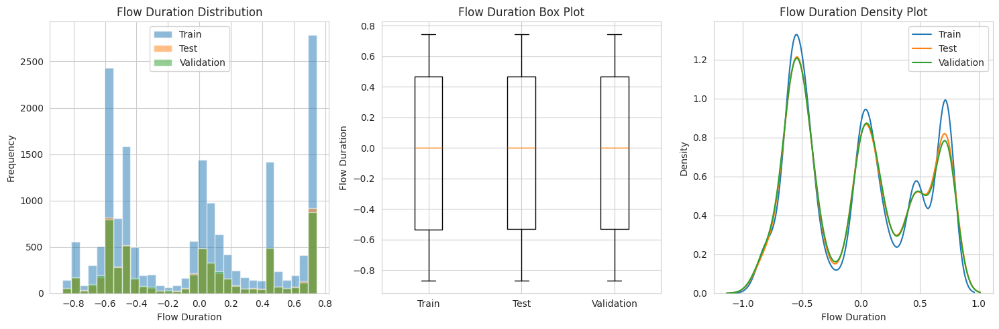

Kolmogorov-Smirnov Test Results:
Train vs Test:
  Statistic: 0.0075
  P-value: 0.9632
  Significant Difference: False
Train vs Validation:
  Statistic: 0.0136
  P-value: 0.3831
  Significant Difference: False
Test vs Validation:
  Statistic: 0.0133
  P-value: 0.6787
  Significant Difference: False

Jensen-Shannon Divergence:
train_vs_test_js_div: 0.0004
train_vs_val_js_div: 0.0008
test_vs_val_js_div: 0.0007

--- Analysis for Feature: Flow IAT Mean ---


/tmp/ipython-input-47-163638618.py:55: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  plt.boxplot(box_data, labels=['Train', 'Test', 'Validation'])


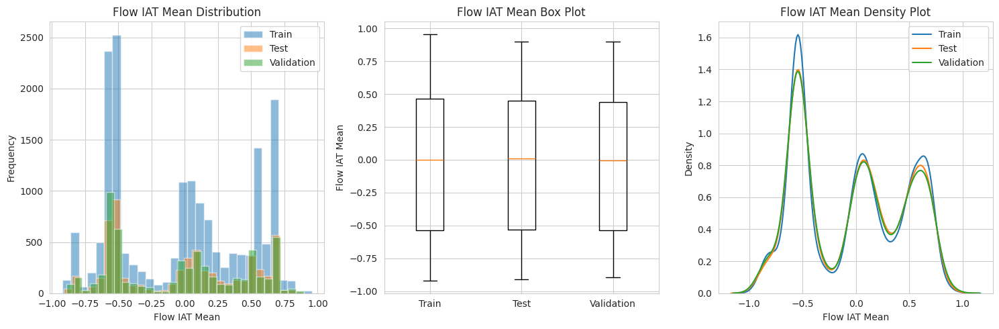

Kolmogorov-Smirnov Test Results:
Train vs Test:
  Statistic: 0.0108
  P-value: 0.6738
  Significant Difference: False
Train vs Validation:
  Statistic: 0.0121
  P-value: 0.5356
  Significant Difference: False
Test vs Validation:
  Statistic: 0.0131
  P-value: 0.6942
  Significant Difference: False

Jensen-Shannon Divergence:
train_vs_test_js_div: 0.0409
train_vs_val_js_div: 0.0444
test_vs_val_js_div: 0.0094

--- Analysis for Feature: Bwd Packet Length Mean ---


/tmp/ipython-input-47-163638618.py:55: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  plt.boxplot(box_data, labels=['Train', 'Test', 'Validation'])


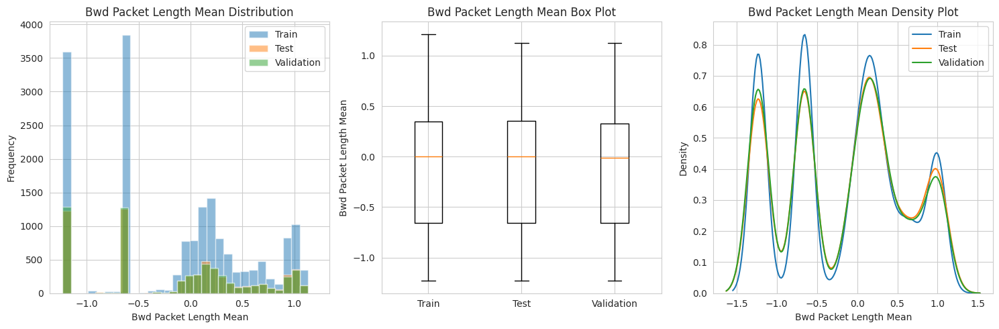

Kolmogorov-Smirnov Test Results:
Train vs Test:
  Statistic: 0.0085
  P-value: 0.9050
  Significant Difference: False
Train vs Validation:
  Statistic: 0.0142
  P-value: 0.3313
  Significant Difference: False
Test vs Validation:
  Statistic: 0.0143
  P-value: 0.5857
  Significant Difference: False

Jensen-Shannon Divergence:
train_vs_test_js_div: 0.0267
train_vs_val_js_div: 0.0287
test_vs_val_js_div: 0.0009

--- Analysis for Feature: Bwd Packet Length Max ---


/tmp/ipython-input-47-163638618.py:55: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  plt.boxplot(box_data, labels=['Train', 'Test', 'Validation'])


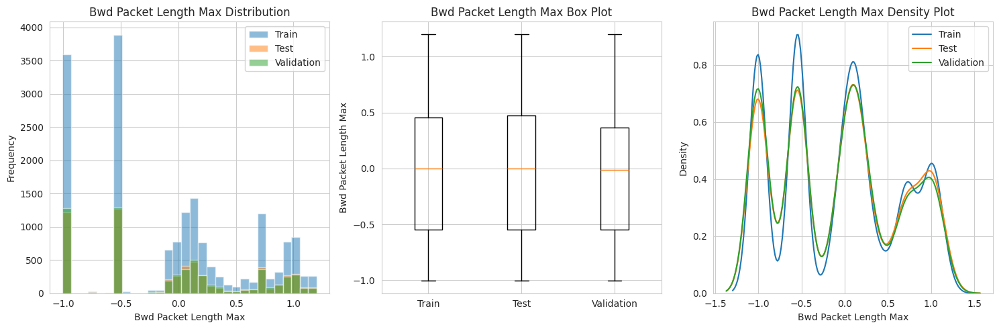

Kolmogorov-Smirnov Test Results:
Train vs Test:
  Statistic: 0.0090
  P-value: 0.8634
  Significant Difference: False
Train vs Validation:
  Statistic: 0.0149
  P-value: 0.2757
  Significant Difference: False
Test vs Validation:
  Statistic: 0.0160
  P-value: 0.4399
  Significant Difference: False

Jensen-Shannon Divergence:
train_vs_test_js_div: 0.0007
train_vs_val_js_div: 0.0012
test_vs_val_js_div: 0.0011

--- Analysis for Feature: Flow Bytes/s ---


/tmp/ipython-input-47-163638618.py:55: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  plt.boxplot(box_data, labels=['Train', 'Test', 'Validation'])


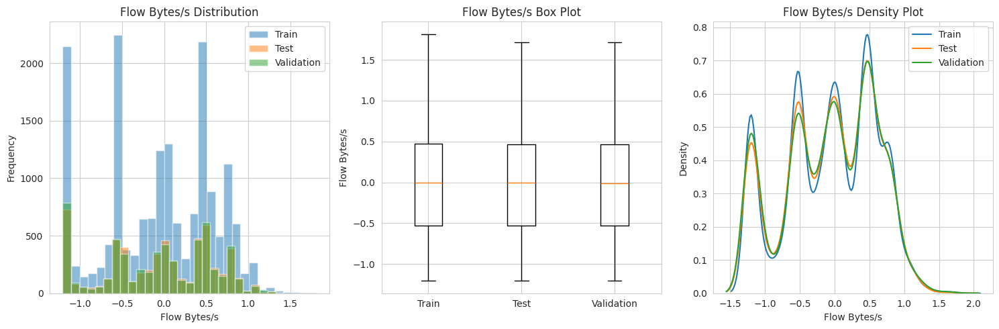

Kolmogorov-Smirnov Test Results:
Train vs Test:
  Statistic: 0.0091
  P-value: 0.8564
  Significant Difference: False
Train vs Validation:
  Statistic: 0.0160
  P-value: 0.2044
  Significant Difference: False
Test vs Validation:
  Statistic: 0.0153
  P-value: 0.4960
  Significant Difference: False

Jensen-Shannon Divergence:
train_vs_test_js_div: 0.0316
train_vs_val_js_div: 0.0311
test_vs_val_js_div: 0.0010

--- Analysis for Feature: Down/Up Ratio ---


/tmp/ipython-input-47-163638618.py:55: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  plt.boxplot(box_data, labels=['Train', 'Test', 'Validation'])


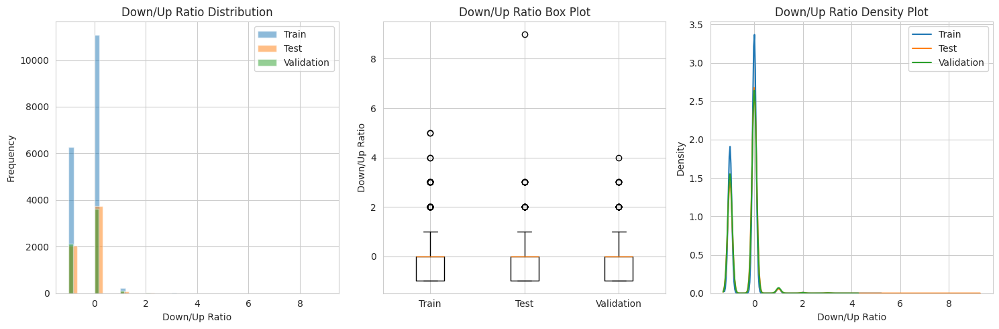

Kolmogorov-Smirnov Test Results:
Train vs Test:
  Statistic: 0.0072
  P-value: 0.9743
  Significant Difference: False
Train vs Validation:
  Statistic: 0.0078
  P-value: 0.9520
  Significant Difference: False
Test vs Validation:
  Statistic: 0.0150
  P-value: 0.5253
  Significant Difference: False

Jensen-Shannon Divergence:
train_vs_test_js_div: 0.4703
train_vs_val_js_div: 0.4468
test_vs_val_js_div: 0.4489

--- Analysis for Feature: SYN Flag Count ---


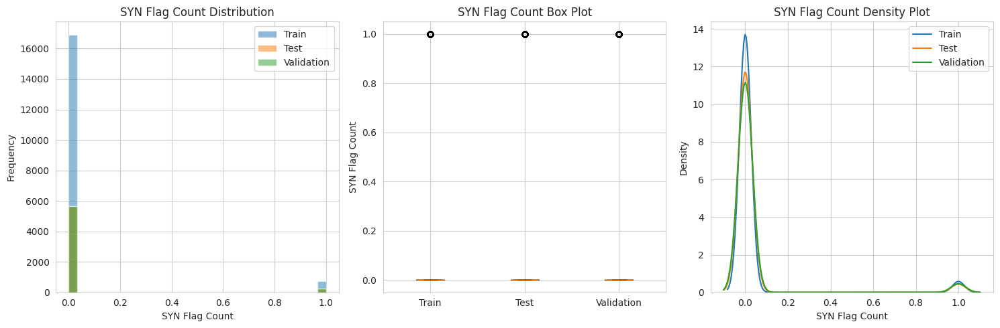

Kolmogorov-Smirnov Test Results:
Train vs Test:
  Statistic: 0.0046
  P-value: 1.0000
  Significant Difference: False
Train vs Validation:
  Statistic: 0.0010
  P-value: 1.0000
  Significant Difference: False
Test vs Validation:
  Statistic: 0.0036
  P-value: 1.0000
  Significant Difference: False

Jensen-Shannon Divergence:
train_vs_test_js_div: 0.0001
train_vs_val_js_div: 0.0000
test_vs_val_js_div: 0.0000

--- Analysis for Feature: Fwd Packet Length Mean ---


/tmp/ipython-input-47-163638618.py:55: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  plt.boxplot(box_data, labels=['Train', 'Test', 'Validation'])


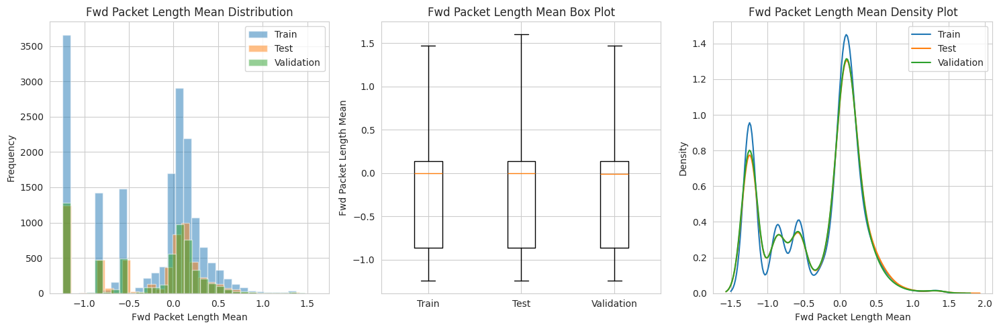

Kolmogorov-Smirnov Test Results:
Train vs Test:
  Statistic: 0.0076
  P-value: 0.9574
  Significant Difference: False
Train vs Validation:
  Statistic: 0.0130
  P-value: 0.4420
  Significant Difference: False
Test vs Validation:
  Statistic: 0.0160
  P-value: 0.4399
  Significant Difference: False

Jensen-Shannon Divergence:
train_vs_test_js_div: 0.0197
train_vs_val_js_div: 0.0008
test_vs_val_js_div: 0.0180

--- Analysis for Feature: Fwd IAT Std ---


/tmp/ipython-input-47-163638618.py:55: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  plt.boxplot(box_data, labels=['Train', 'Test', 'Validation'])


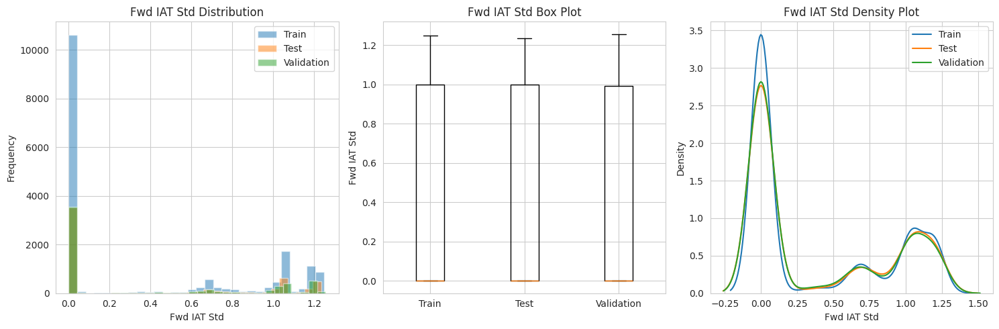

Kolmogorov-Smirnov Test Results:
Train vs Test:
  Statistic: 0.0058
  P-value: 0.9983
  Significant Difference: False
Train vs Validation:
  Statistic: 0.0153
  P-value: 0.2524
  Significant Difference: False
Test vs Validation:
  Statistic: 0.0180
  P-value: 0.2947
  Significant Difference: False

Jensen-Shannon Divergence:
train_vs_test_js_div: 0.0073
train_vs_val_js_div: 0.0113
test_vs_val_js_div: 0.0293

--- Analysis for Feature: Packet Length Mean ---


/tmp/ipython-input-47-163638618.py:55: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  plt.boxplot(box_data, labels=['Train', 'Test', 'Validation'])


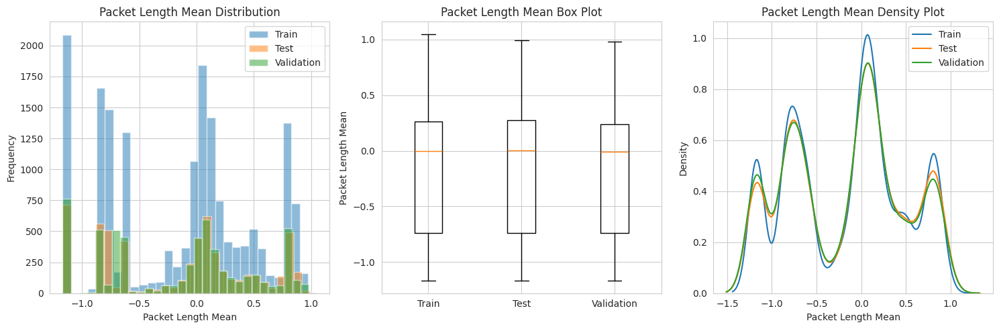

Kolmogorov-Smirnov Test Results:
Train vs Test:
  Statistic: 0.0094
  P-value: 0.8320
  Significant Difference: False
Train vs Validation:
  Statistic: 0.0142
  P-value: 0.3360
  Significant Difference: False
Test vs Validation:
  Statistic: 0.0157
  P-value: 0.4675
  Significant Difference: False

Jensen-Shannon Divergence:
train_vs_test_js_div: 0.0206
train_vs_val_js_div: 0.0631
test_vs_val_js_div: 0.0394

--- Analysis for Feature: Fwd Packet Length Max ---


/tmp/ipython-input-47-163638618.py:55: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  plt.boxplot(box_data, labels=['Train', 'Test', 'Validation'])


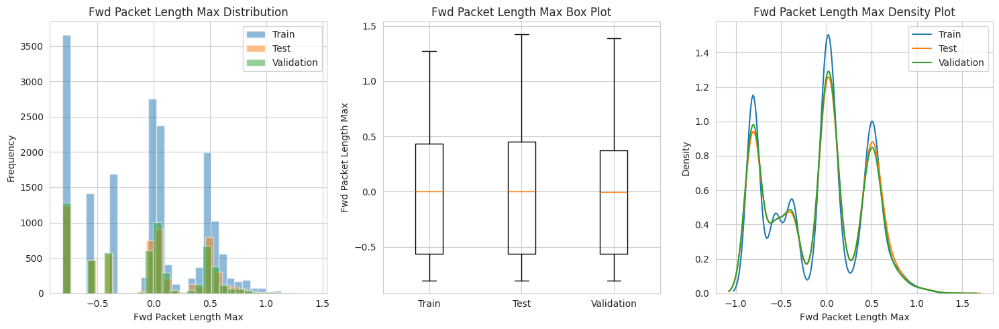

Kolmogorov-Smirnov Test Results:
Train vs Test:
  Statistic: 0.0087
  P-value: 0.8876
  Significant Difference: False
Train vs Validation:
  Statistic: 0.0157
  P-value: 0.2269
  Significant Difference: False
Test vs Validation:
  Statistic: 0.0208
  P-value: 0.1588
  Significant Difference: False

Jensen-Shannon Divergence:
train_vs_test_js_div: 0.1598
train_vs_val_js_div: 0.1341
test_vs_val_js_div: 0.0055

--- Analysis for Feature: Flow Packets/s ---


/tmp/ipython-input-47-163638618.py:55: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  plt.boxplot(box_data, labels=['Train', 'Test', 'Validation'])


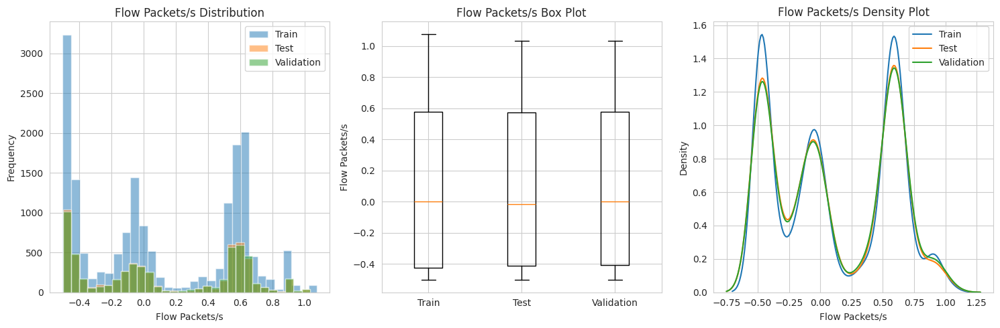

Kolmogorov-Smirnov Test Results:
Train vs Test:
  Statistic: 0.0102
  P-value: 0.7488
  Significant Difference: False
Train vs Validation:
  Statistic: 0.0121
  P-value: 0.5351
  Significant Difference: False
Test vs Validation:
  Statistic: 0.0126
  P-value: 0.7401
  Significant Difference: False

Jensen-Shannon Divergence:
train_vs_test_js_div: 0.0256
train_vs_val_js_div: 0.0274
test_vs_val_js_div: 0.0010

--- Analysis for Feature: Total Fwd Packets ---


/tmp/ipython-input-47-163638618.py:55: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  plt.boxplot(box_data, labels=['Train', 'Test', 'Validation'])


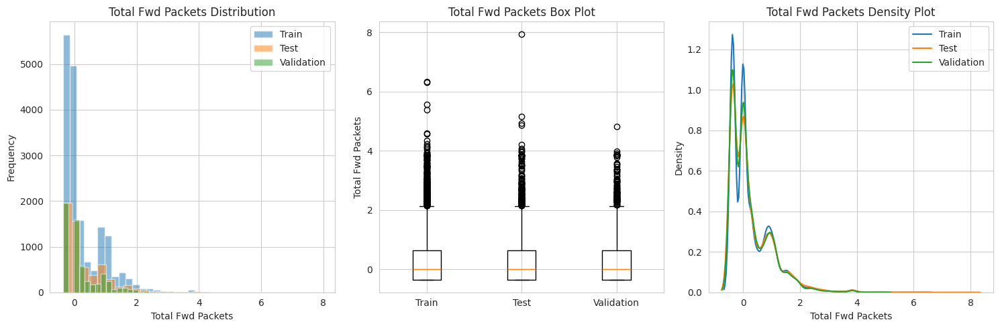

Kolmogorov-Smirnov Test Results:
Train vs Test:
  Statistic: 0.0137
  P-value: 0.3756
  Significant Difference: False
Train vs Validation:
  Statistic: 0.0160
  P-value: 0.2097
  Significant Difference: False
Test vs Validation:
  Statistic: 0.0140
  P-value: 0.6165
  Significant Difference: False

Jensen-Shannon Divergence:
train_vs_test_js_div: 0.0272
train_vs_val_js_div: 0.1569
test_vs_val_js_div: 0.1521

--- Analysis for Feature: Destination Port ---


/tmp/ipython-input-47-163638618.py:55: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  plt.boxplot(box_data, labels=['Train', 'Test', 'Validation'])


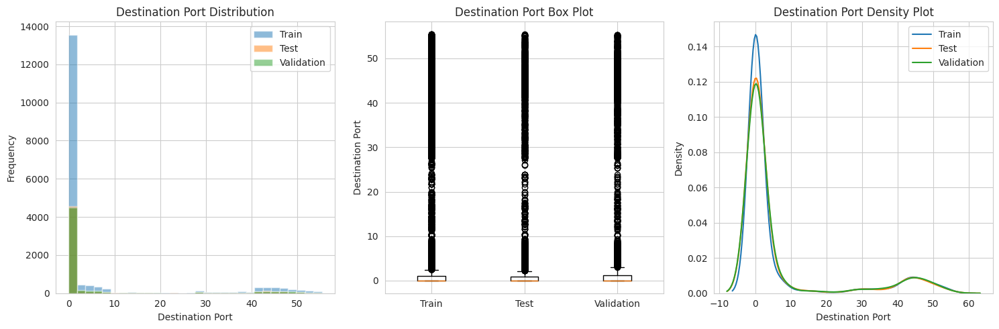

Kolmogorov-Smirnov Test Results:
Train vs Test:
  Statistic: 0.0098
  P-value: 0.7846
  Significant Difference: False
Train vs Validation:
  Statistic: 0.0071
  P-value: 0.9790
  Significant Difference: False
Test vs Validation:
  Statistic: 0.0148
  P-value: 0.5402
  Significant Difference: False

Jensen-Shannon Divergence:
train_vs_test_js_div: 0.0007
train_vs_val_js_div: 0.0006
test_vs_val_js_div: 0.0014


{'Flow Duration': {'ks_tests': {'train_vs_test': {'statistic': np.float64(0.007511202182074184),
    'p_value': np.float64(0.9631919797937922),
    'sets_compared': 'Train vs Test',
    'significant_difference': np.False_},
   'train_vs_val': {'statistic': np.float64(0.013623959345829384),
    'p_value': np.float64(0.3830925418010922),
    'sets_compared': 'Train vs Validation',
    'significant_difference': np.False_},
   'test_vs_val': {'statistic': np.float64(0.013272077590607452),
    'p_value': np.float64(0.6787021676381784),
    'sets_compared': 'Test vs Validation',
    'significant_difference': np.False_}},
  'distribution_metrics': {'train_vs_test_js_div': np.float64(0.00043519607102656635),
   'train_vs_val_js_div': np.float64(0.0007775159165217963),
   'test_vs_val_js_div': np.float64(0.0007189375571298011)}},
 'Flow IAT Mean': {'ks_tests': {'train_vs_test': {'statistic': np.float64(0.010842473003240705),
    'p_value': np.float64(0.673771808992577),
    'sets_compared': 'Tr

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from scipy import stats
import scipy.stats as stats_scipy

def compare_distributions(train_data, test_data, val_data, feature_name):
    """
    Compare distributions of a specific feature across train, test, and validation sets

    Parameters:
    - train_data: Training dataset feature column
    - test_data: Test dataset feature column
    - val_data: Validation dataset feature column
    - feature_name: Name of the feature being analyzed

    Returns:
    - Dictionary of statistical test results and visualization
    """
    results = {}

    # 1. Statistical Tests
    # Kolmogorov-Smirnov Test
    def ks_test_between_sets(set1, set2, set_names):
        statistic, p_value = stats.ks_2samp(set1, set2)
        return {
            'statistic': statistic,
            'p_value': p_value,
            'sets_compared': set_names,
            'significant_difference': p_value < 0.05
        }

    results['ks_tests'] = {
        'train_vs_test': ks_test_between_sets(train_data, test_data, 'Train vs Test'),
        'train_vs_val': ks_test_between_sets(train_data, val_data, 'Train vs Validation'),
        'test_vs_val': ks_test_between_sets(test_data, val_data, 'Test vs Validation')
    }

    # 2. Distribution Visualization
    plt.figure(figsize=(15, 5))

    # Histogram
    plt.subplot(131)
    plt.hist(train_data, bins=30, alpha=0.5, label='Train')
    plt.hist(test_data, bins=30, alpha=0.5, label='Test')
    plt.hist(val_data, bins=30, alpha=0.5, label='Validation')
    plt.title(f'{feature_name} Distribution')
    plt.xlabel(feature_name)
    plt.ylabel('Frequency')
    plt.legend()

    # Box Plot
    plt.subplot(132)
    box_data = [train_data, test_data, val_data]
    plt.boxplot(box_data, labels=['Train', 'Test', 'Validation'])
    plt.title(f'{feature_name} Box Plot')
    plt.ylabel(feature_name)

    # Kernel Density Estimation
    plt.subplot(133)
    sns.kdeplot(train_data, label='Train')
    sns.kdeplot(test_data, label='Test')
    sns.kdeplot(val_data, label='Validation')
    plt.title(f'{feature_name} Density Plot')
    plt.xlabel(feature_name)
    plt.ylabel('Density')
    plt.legend()

    plt.tight_layout()
    plt.show()

    # 3. Distribution Metrics
    def jensen_shannon_divergence(p, q):
        """Calculate Jensen-Shannon Divergence between two distributions"""
        p = np.asarray(p)
        q = np.asarray(q)
        m = 0.5 * (p + q)
        return 0.5 * (stats_scipy.entropy(p, m) + stats_scipy.entropy(q, m))

    # Prepare histograms for JS Divergence
    def get_distribution_histogram(data, bins=30):
        hist, _ = np.histogram(data, bins=bins, density=True)
        return hist

    results['distribution_metrics'] = {
        'train_vs_test_js_div': jensen_shannon_divergence(
            get_distribution_histogram(train_data),
            get_distribution_histogram(test_data)
        ),
        'train_vs_val_js_div': jensen_shannon_divergence(
            get_distribution_histogram(train_data),
            get_distribution_histogram(val_data)
        ),
        'test_vs_val_js_div': jensen_shannon_divergence(
            get_distribution_histogram(test_data),
            get_distribution_histogram(val_data)
        )
    }

    return results

def analyze_feature_distributions(X_train, X_test, X_val, feature_names=None):
    """
    Analyze distributions for multiple features

    Parameters:
    - X_train: Training dataset (2D NumPy array)
    - X_test: Test dataset (2D NumPy array)
    - X_val: Validation dataset (2D NumPy array)
    - feature_names: Optional list of feature names (default is column indices)
    """
    # If feature names not provided, use column indices
    if feature_names is None:
        feature_names = [f'Feature_{i}' for i in range(X_train.shape[1])]

    # Ensure feature names match number of columns
    assert X_train.shape[1] == len(feature_names), "Number of feature names must match number of columns"

    # Comprehensive results dictionary
    comprehensive_results = {}

    # Loop through features
    for idx, feature in enumerate(feature_names):
        print(f"\n--- Analysis for Feature: {feature} ---")

        # Extract feature column from datasets
        train_feature = X_train[:, idx]
        test_feature = X_test[:, idx]
        val_feature = X_val[:, idx]

        # Compare distributions
        results = compare_distributions(train_feature, test_feature, val_feature, feature)

        # Store results
        comprehensive_results[feature] = results

        # Print statistical test results
        print("Kolmogorov-Smirnov Test Results:")
        for key, test_result in results['ks_tests'].items():
            print(f"{test_result['sets_compared']}:")
            print(f"  Statistic: {test_result['statistic']:.4f}")
            print(f"  P-value: {test_result['p_value']:.4f}")
            print(f"  Significant Difference: {test_result['significant_difference']}")

        print("\nJensen-Shannon Divergence:")
        for key, div_value in results['distribution_metrics'].items():
            print(f"{key}: {div_value:.4f}")

    return comprehensive_results


analyze_feature_distributions(X_train_scaled.to_numpy(), X_test_scaled.to_numpy(), X_val_scaled.to_numpy(), X_train_scaled.columns)

In [ ]:
import numpy as np

def analyze_class_distribution(y_train, y_test, y_val):
    """
    Analyze class distribution across train, test, and validation sets

    Args:
        y_train (np.ndarray): Training labels
        y_test (np.ndarray): Test labels
        y_val (np.ndarray): Validation labels
    """
    # Function to calculate class distribution
    def get_class_distribution(labels):
        unique, counts = np.unique(labels, return_counts=True)
        total = len(labels)
        percentages = (counts / total) * 100
        return dict(zip(unique, percentages))

    # Print distributions
    print("Train Set Class Distribution:")
    train_dist = get_class_distribution(y_train)
    for cls, percentage in train_dist.items():
        print(f"Class {cls}: {percentage:.2f}%")

    print("\nTest Set Class Distribution:")
    test_dist = get_class_distribution(y_test)
    for cls, percentage in test_dist.items():
        print(f"Class {cls}: {percentage:.2f}%")

    print("\nValidation Set Class Distribution:")
    val_dist = get_class_distribution(y_val)
    for cls, percentage in val_dist.items():
        print(f"Class {cls}: {percentage:.2f}%")

    return train_dist, test_dist, val_dist



distributions = analyze_class_distribution(y_train, y_test, y_val)
print(distributions)


Train Set Class Distribution:
Class 0: 65.48%
Class 1: 4.86%
Class 2: 13.17%
Class 3: 16.50%

Test Set Class Distribution:
Class 0: 65.48%
Class 1: 4.87%
Class 2: 13.15%
Class 3: 16.51%

Validation Set Class Distribution:
Class 0: 65.48%
Class 1: 4.85%
Class 2: 13.17%
Class 3: 16.51%
({np.int64(0): np.float64(65.47929665343165), np.int64(1): np.float64(4.855360181508791), np.int64(2): np.float64(13.16505955757232), np.int64(3): np.float64(16.500283607487237)}, {np.int64(0): np.float64(65.4755827803301), np.int64(1): np.float64(4.8664284498893995), np.int64(2): np.float64(13.152969201973796), np.int64(3): np.float64(16.505019567806702)}, {np.int64(0): np.float64(65.4755827803301), np.int64(1): np.float64(4.849412965798877), np.int64(2): np.float64(13.169984686064318), np.int64(3): np.float64(16.505019567806702)})


#### Outliers analysis

- train

In [ ]:
import numpy as np

def detect_outliers_iqr(data, multiplier=1.5):
    """
    Detect outliers using Interquartile Range method

    Parameters:
    - data: NumPy array
    - multiplier: IQR multiplier (default 1.5)

    Returns:
    - Boolean array indicating outliers
    """
    Q1 = np.percentile(data, 25)
    Q3 = np.percentile(data, 75)
    IQR = Q3 - Q1
    lower_bound = Q1 - (multiplier * IQR)
    upper_bound = Q3 + (multiplier * IQR)
    return (data < lower_bound) | (data > upper_bound)

def analyze_outliers_by_class(X, y, method='iqr', multiplier=1.5):
    """
    Analyze outliers across different classes

    Parameters:
    - X: Feature matrix (2D NumPy array)
    - y: Class labels (1D NumPy array)
    - method: Outlier detection method ('iqr')
    - multiplier: Multiplier for IQR method

    Returns:
    - Comprehensive outlier analysis by class
    """
    # Unique classes
    unique_classes = np.unique(y)

    # Outlier analysis results
    outlier_analysis = {
        'overall_results': {},
        'class_results': {}
    }

    # Total outliers tracking
    total_outliers = 0
    total_samples = len(y)

    # Analyze each feature
    for feature_idx in range(X.shape[1]):
        feature_outliers = {
            'overall_outliers': [],
            'class_outliers': {}
        }

        # Current feature column
        feature_data = X[:, feature_idx]

        # Detect overall outliers
        overall_outlier_mask = detect_outliers_iqr(feature_data, multiplier)
        feature_outliers['overall_outliers'] = overall_outlier_mask

        # Per-class analysis
        for cls in unique_classes:
            # Mask for current class
            class_mask = (y == cls)

            # Feature data for current class
            class_feature_data = feature_data[class_mask]

            # Detect outliers for this class
            class_outlier_mask = detect_outliers_iqr(class_feature_data, multiplier)

            # Store class-specific results
            feature_outliers['class_outliers'][cls] = {
                'total_samples': len(class_feature_data),
                'outlier_samples': np.sum(class_outlier_mask),
                'outlier_percentage': (np.sum(class_outlier_mask) / len(class_feature_data)) * 100
            }

        # Store results for this feature
        outlier_analysis['overall_results'][f'Feature_{feature_idx}'] = feature_outliers

    # Summarize overall results
    print("\nOutlier Analysis Summary:")
    for feature, results in outlier_analysis['overall_results'].items():
        print(f"\n{feature}:")

        # Overall outliers
        overall_outliers = np.sum(results['overall_outliers'])
        overall_outlier_percentage = (overall_outliers / total_samples) * 100
        print(f"  Total Outliers: {overall_outliers} ({overall_outlier_percentage:.2f}%)")

        # Class-specific results
        print("  Class-wise Outlier Breakdown:")
        for cls, class_results in results['class_outliers'].items():
            print(f"    Class {cls}:")
            print(f"      Total Samples: {class_results['total_samples']}")
            print(f"      Outlier Samples: {class_results['outlier_samples']}")
            print(f"      Outlier Percentage: {class_results['outlier_percentage']:.2f}%")

    return outlier_analysis





outlier_analysis = analyze_outliers_by_class(X_train_scaled.to_numpy(), y_train)




Outlier Analysis Summary:

Feature_0:
  Total Outliers: 0 (0.00%)
  Class-wise Outlier Breakdown:
    Class 0:
      Total Samples: 11544
      Outlier Samples: 0
      Outlier Percentage: 0.00%
    Class 1:
      Total Samples: 856
      Outlier Samples: 128
      Outlier Percentage: 14.95%
    Class 2:
      Total Samples: 2321
      Outlier Samples: 485
      Outlier Percentage: 20.90%
    Class 3:
      Total Samples: 2909
      Outlier Samples: 402
      Outlier Percentage: 13.82%

Feature_1:
  Total Outliers: 0 (0.00%)
  Class-wise Outlier Breakdown:
    Class 0:
      Total Samples: 11544
      Outlier Samples: 0
      Outlier Percentage: 0.00%
    Class 1:
      Total Samples: 856
      Outlier Samples: 133
      Outlier Percentage: 15.54%
    Class 2:
      Total Samples: 2321
      Outlier Samples: 496
      Outlier Percentage: 21.37%
    Class 3:
      Total Samples: 2909
      Outlier Samples: 402
      Outlier Percentage: 13.82%

Feature_2:
  Total Outliers: 0 (0.00%)
  C

- val

In [ ]:
import numpy as np

def detect_outliers_iqr(data, multiplier=1.5):
    """
    Detect outliers using Interquartile Range method

    Parameters:
    - data: NumPy array
    - multiplier: IQR multiplier (default 1.5)

    Returns:
    - Boolean array indicating outliers
    """
    Q1 = np.percentile(data, 25)
    Q3 = np.percentile(data, 75)
    IQR = Q3 - Q1
    lower_bound = Q1 - (multiplier * IQR)
    upper_bound = Q3 + (multiplier * IQR)
    return (data < lower_bound) | (data > upper_bound)

def analyze_outliers_by_class(X, y, method='iqr', multiplier=1.5):
    """
    Analyze outliers across different classes

    Parameters:
    - X: Feature matrix (2D NumPy array)
    - y: Class labels (1D NumPy array)
    - method: Outlier detection method ('iqr')
    - multiplier: Multiplier for IQR method

    Returns:
    - Comprehensive outlier analysis by class
    """
    # Unique classes
    unique_classes = np.unique(y)

    # Outlier analysis results
    outlier_analysis = {
        'overall_results': {},
        'class_results': {}
    }

    # Total outliers tracking
    total_outliers = 0
    total_samples = len(y)

    # Analyze each feature
    for feature_idx in range(X.shape[1]):
        feature_outliers = {
            'overall_outliers': [],
            'class_outliers': {}
        }

        # Current feature column
        feature_data = X[:, feature_idx]

        # Detect overall outliers
        overall_outlier_mask = detect_outliers_iqr(feature_data, multiplier)
        feature_outliers['overall_outliers'] = overall_outlier_mask

        # Per-class analysis
        for cls in unique_classes:
            # Mask for current class
            class_mask = (y == cls)

            # Feature data for current class
            class_feature_data = feature_data[class_mask]

            # Detect outliers for this class
            class_outlier_mask = detect_outliers_iqr(class_feature_data, multiplier)

            # Store class-specific results
            feature_outliers['class_outliers'][cls] = {
                'total_samples': len(class_feature_data),
                'outlier_samples': np.sum(class_outlier_mask),
                'outlier_percentage': (np.sum(class_outlier_mask) / len(class_feature_data)) * 100
            }

        # Store results for this feature
        outlier_analysis['overall_results'][f'Feature_{feature_idx}'] = feature_outliers

    # Summarize overall results
    print("\nOutlier Analysis Summary:")
    for feature, results in outlier_analysis['overall_results'].items():
        print(f"\n{feature}:")

        # Overall outliers
        overall_outliers = np.sum(results['overall_outliers'])
        overall_outlier_percentage = (overall_outliers / total_samples) * 100
        print(f"  Total Outliers: {overall_outliers} ({overall_outlier_percentage:.2f}%)")

        # Class-specific results
        print("  Class-wise Outlier Breakdown:")
        for cls, class_results in results['class_outliers'].items():
            print(f"    Class {cls}:")
            print(f"      Total Samples: {class_results['total_samples']}")
            print(f"      Outlier Samples: {class_results['outlier_samples']}")
            print(f"      Outlier Percentage: {class_results['outlier_percentage']:.2f}%")

    return outlier_analysis





outlier_analysis = analyze_outliers_by_class(X_val_scaled.to_numpy(), y_val)




Outlier Analysis Summary:

Feature_0:
  Total Outliers: 0 (0.00%)
  Class-wise Outlier Breakdown:
    Class 0:
      Total Samples: 3848
      Outlier Samples: 0
      Outlier Percentage: 0.00%
    Class 1:
      Total Samples: 285
      Outlier Samples: 39
      Outlier Percentage: 13.68%
    Class 2:
      Total Samples: 774
      Outlier Samples: 189
      Outlier Percentage: 24.42%
    Class 3:
      Total Samples: 970
      Outlier Samples: 122
      Outlier Percentage: 12.58%

Feature_1:
  Total Outliers: 0 (0.00%)
  Class-wise Outlier Breakdown:
    Class 0:
      Total Samples: 3848
      Outlier Samples: 0
      Outlier Percentage: 0.00%
    Class 1:
      Total Samples: 285
      Outlier Samples: 39
      Outlier Percentage: 13.68%
    Class 2:
      Total Samples: 774
      Outlier Samples: 192
      Outlier Percentage: 24.81%
    Class 3:
      Total Samples: 970
      Outlier Samples: 122
      Outlier Percentage: 12.58%

Feature_2:
  Total Outliers: 0 (0.00%)
  Class-wis

#### PCA + T-SNE

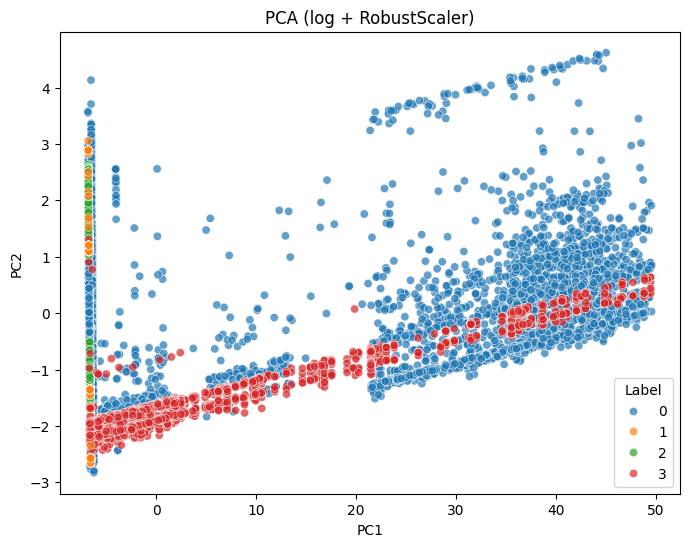

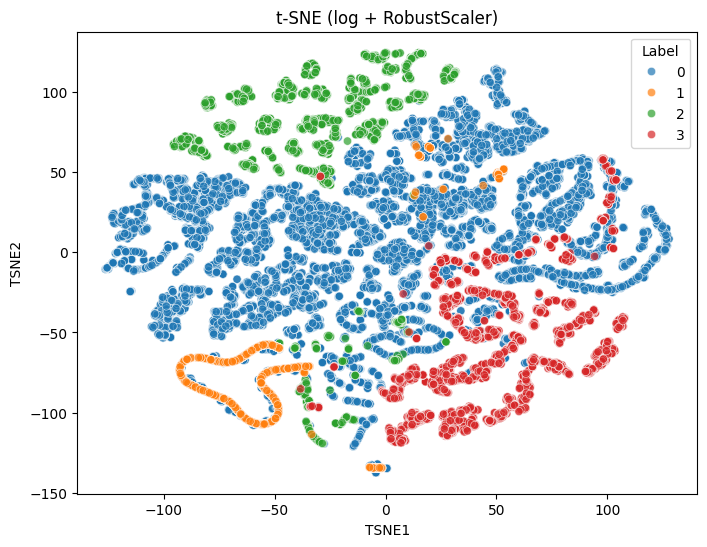

In [38]:
import pandas as pd
import numpy as np
from sklearn.preprocessing import FunctionTransformer, RobustScaler
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE
import matplotlib.pyplot as plt
import seaborn as sns


X = df.drop(columns=['Label'], errors='ignore')
y = df['Label']


columns_to_log = [
'Total Fwd Packets',
'Fwd Packet Length Max',
'Fwd Packet Length Mean',
'Flow IAT Mean',
'Flow Bytes/s',
'Flow Packets/s',
'Fwd IAT Std',
'Bwd Packet Length Max',
'Bwd Packet Length Mean',
'Packet Length Mean',
'Flow Duration' ]
log_transformer = FunctionTransformer(np.log1p, validate=False)

X_log = X.copy()
for col in columns_to_log:
    if col in X_log:
        X_log[col] = log_transformer.transform(X_log[[col]])

# Robust scaling
scaler = RobustScaler()
X_scaled = scaler.fit_transform(X_log)
X_scaled = pd.DataFrame(X_scaled, columns=X_log.columns, index=X_log.index)

# 4. PCA  2 components
pca = PCA(n_components=2, random_state=42)
pca_proj = pca.fit_transform(X_scaled)
pca_df = pd.DataFrame(pca_proj, columns=['PC1', 'PC2'], index=X_scaled.index)
pca_df['Label'] = y.values

plt.figure(figsize=(8,6))
sns.scatterplot(data=pca_df, x='PC1', y='PC2', hue='Label', alpha=0.7, palette='tab10')
plt.title("PCA (log + RobustScaler)")
plt.show()

# 5. t-SNE  2 components
tsne = TSNE(n_components=2, random_state=42, perplexity=30, max_iter=1000)
tsne_proj = tsne.fit_transform(X_scaled)
tsne_df = pd.DataFrame(tsne_proj, columns=['TSNE1', 'TSNE2'], index=X_scaled.index)
tsne_df['Label'] = y.values

plt.figure(figsize=(8,6))
sns.scatterplot(data=tsne_df, x='TSNE1', y='TSNE2', hue='Label', alpha=0.7, palette='tab10')
plt.title("t-SNE (log + RobustScaler)")
plt.show()


### Standard Scaler

In [ ]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
import matplotlib.pyplot as plt
import seaborn as sns



print("Class distribution - Train:\n", y_train.value_counts())
print("Class distribution - Validation:\n", y_val.value_counts())
print("Class distribution - Test:\n", y_test.value_counts())


scaler = StandardScaler()
X_train_SS = scaler.fit_transform(X_train)
X_val_SS = scaler.transform(X_val)


X_train_SS = pd.DataFrame(X_train_SS, columns=X_train.columns, index=X_train.index)
X_val_SS = pd.DataFrame(X_val_SS, columns=X_val.columns, index=X_val.index)


X_test_SS = scaler.transform(X_test)
X_test_SS = pd.DataFrame(X_test_SS, columns=X_test.columns, index=X_test.index)






Class distribution - Train:
 Label
0    11544
3     2909
2     2321
1      856
Name: count, dtype: int64
Class distribution - Validation:
 Label
0    3848
3     970
2     774
1     285
Name: count, dtype: int64
Class distribution - Test:
 Label
0    3848
3     970
2     773
1     286
Name: count, dtype: int64


#### Outliers analysis

- train

In [ ]:
import numpy as np

def detect_outliers_iqr(data, multiplier=1.5):
    """
    Detect outliers using Interquartile Range method

    Parameters:
    - data: NumPy array
    - multiplier: IQR multiplier (default 1.5)

    Returns:
    - Boolean array indicating outliers
    """
    Q1 = np.percentile(data, 25)
    Q3 = np.percentile(data, 75)
    IQR = Q3 - Q1
    lower_bound = Q1 - (multiplier * IQR)
    upper_bound = Q3 + (multiplier * IQR)
    return (data < lower_bound) | (data > upper_bound)

def analyze_outliers_by_class(X, y, method='iqr', multiplier=1.5):
    """
    Analyze outliers across different classes

    Parameters:
    - X: Feature matrix (2D NumPy array)
    - y: Class labels (1D NumPy array)
    - method: Outlier detection method ('iqr')
    - multiplier: Multiplier for IQR method

    Returns:
    - Comprehensive outlier analysis by class
    """
    # Unique classes
    unique_classes = np.unique(y)

    # Outlier analysis results
    outlier_analysis = {
        'overall_results': {},
        'class_results': {}
    }

    # Total outliers tracking
    total_outliers = 0
    total_samples = len(y)

    # Analyze each feature
    for feature_idx in range(X.shape[1]):
        feature_outliers = {
            'overall_outliers': [],
            'class_outliers': {}
        }

        # Current feature column
        feature_data = X[:, feature_idx]

        # Detect overall outliers
        overall_outlier_mask = detect_outliers_iqr(feature_data, multiplier)
        feature_outliers['overall_outliers'] = overall_outlier_mask

        # Per-class analysis
        for cls in unique_classes:
            # Mask for current class
            class_mask = (y == cls)

            # Feature data for current class
            class_feature_data = feature_data[class_mask]

            # Detect outliers for this class
            class_outlier_mask = detect_outliers_iqr(class_feature_data, multiplier)

            # Store class-specific results
            feature_outliers['class_outliers'][cls] = {
                'total_samples': len(class_feature_data),
                'outlier_samples': np.sum(class_outlier_mask),
                'outlier_percentage': (np.sum(class_outlier_mask) / len(class_feature_data)) * 100
            }

        # Store results for this feature
        outlier_analysis['overall_results'][f'Feature_{feature_idx}'] = feature_outliers

    # Summarize overall results
    print("\nOutlier Analysis Summary:")
    for feature, results in outlier_analysis['overall_results'].items():
        print(f"\n{feature}:")

        # Overall outliers
        overall_outliers = np.sum(results['overall_outliers'])
        overall_outlier_percentage = (overall_outliers / total_samples) * 100
        print(f"  Total Outliers: {overall_outliers} ({overall_outlier_percentage:.2f}%)")

        # Class-specific results
        print("  Class-wise Outlier Breakdown:")
        for cls, class_results in results['class_outliers'].items():
            print(f"    Class {cls}:")
            print(f"      Total Samples: {class_results['total_samples']}")
            print(f"      Outlier Samples: {class_results['outlier_samples']}")
            print(f"      Outlier Percentage: {class_results['outlier_percentage']:.2f}%")

    return outlier_analysis




outlier_analysis = analyze_outliers_by_class(X_train_SS.to_numpy(), y_train)




Outlier Analysis Summary:

Feature_0:
  Total Outliers: 3483 (19.76%)
  Class-wise Outlier Breakdown:
    Class 0:
      Total Samples: 11544
      Outlier Samples: 2669
      Outlier Percentage: 23.12%
    Class 1:
      Total Samples: 856
      Outlier Samples: 128
      Outlier Percentage: 14.95%
    Class 2:
      Total Samples: 2321
      Outlier Samples: 485
      Outlier Percentage: 20.90%
    Class 3:
      Total Samples: 2909
      Outlier Samples: 348
      Outlier Percentage: 11.96%

Feature_1:
  Total Outliers: 2898 (16.44%)
  Class-wise Outlier Breakdown:
    Class 0:
      Total Samples: 11544
      Outlier Samples: 2512
      Outlier Percentage: 21.76%
    Class 1:
      Total Samples: 856
      Outlier Samples: 115
      Outlier Percentage: 13.43%
    Class 2:
      Total Samples: 2321
      Outlier Samples: 499
      Outlier Percentage: 21.50%
    Class 3:
      Total Samples: 2909
      Outlier Samples: 348
      Outlier Percentage: 11.96%

Feature_2:
  Total Outlier

- val

In [ ]:
import numpy as np

def detect_outliers_iqr(data, multiplier=1.5):
    """
    Detect outliers using Interquartile Range method

    Parameters:
    - data: NumPy array
    - multiplier: IQR multiplier (default 1.5)

    Returns:
    - Boolean array indicating outliers
    """
    Q1 = np.percentile(data, 25)
    Q3 = np.percentile(data, 75)
    IQR = Q3 - Q1
    lower_bound = Q1 - (multiplier * IQR)
    upper_bound = Q3 + (multiplier * IQR)
    return (data < lower_bound) | (data > upper_bound)

def analyze_outliers_by_class(X, y, method='iqr', multiplier=1.5):
    """
    Analyze outliers across different classes

    Parameters:
    - X: Feature matrix (2D NumPy array)
    - y: Class labels (1D NumPy array)
    - method: Outlier detection method ('iqr')
    - multiplier: Multiplier for IQR method

    Returns:
    - Comprehensive outlier analysis by class
    """
    # Unique classes
    unique_classes = np.unique(y)

    # Outlier analysis results
    outlier_analysis = {
        'overall_results': {},
        'class_results': {}
    }

    # Total outliers tracking
    total_outliers = 0
    total_samples = len(y)

    # Analyze each feature
    for feature_idx in range(X.shape[1]):
        feature_outliers = {
            'overall_outliers': [],
            'class_outliers': {}
        }

        # Current feature column
        feature_data = X[:, feature_idx]

        # Detect overall outliers
        overall_outlier_mask = detect_outliers_iqr(feature_data, multiplier)
        feature_outliers['overall_outliers'] = overall_outlier_mask

        # Per-class analysis
        for cls in unique_classes:
            # Mask for current class
            class_mask = (y == cls)

            # Feature data for current class
            class_feature_data = feature_data[class_mask]

            # Detect outliers for this class
            class_outlier_mask = detect_outliers_iqr(class_feature_data, multiplier)

            # Store class-specific results
            feature_outliers['class_outliers'][cls] = {
                'total_samples': len(class_feature_data),
                'outlier_samples': np.sum(class_outlier_mask),
                'outlier_percentage': (np.sum(class_outlier_mask) / len(class_feature_data)) * 100
            }

        # Store results for this feature
        outlier_analysis['overall_results'][f'Feature_{feature_idx}'] = feature_outliers

    # Summarize overall results
    print("\nOutlier Analysis Summary:")
    for feature, results in outlier_analysis['overall_results'].items():
        print(f"\n{feature}:")

        # Overall outliers
        overall_outliers = np.sum(results['overall_outliers'])
        overall_outlier_percentage = (overall_outliers / total_samples) * 100
        print(f"  Total Outliers: {overall_outliers} ({overall_outlier_percentage:.2f}%)")

        # Class-specific results
        print("  Class-wise Outlier Breakdown:")
        for cls, class_results in results['class_outliers'].items():
            print(f"    Class {cls}:")
            print(f"      Total Samples: {class_results['total_samples']}")
            print(f"      Outlier Samples: {class_results['outlier_samples']}")
            print(f"      Outlier Percentage: {class_results['outlier_percentage']:.2f}%")

    return outlier_analysis





outlier_analysis = analyze_outliers_by_class(X_val_SS.to_numpy(), y_val)




Outlier Analysis Summary:

Feature_0:
  Total Outliers: 1098 (18.68%)
  Class-wise Outlier Breakdown:
    Class 0:
      Total Samples: 3848
      Outlier Samples: 889
      Outlier Percentage: 23.10%
    Class 1:
      Total Samples: 285
      Outlier Samples: 39
      Outlier Percentage: 13.68%
    Class 2:
      Total Samples: 774
      Outlier Samples: 0
      Outlier Percentage: 0.00%
    Class 3:
      Total Samples: 970
      Outlier Samples: 107
      Outlier Percentage: 11.03%

Feature_1:
  Total Outliers: 1070 (18.21%)
  Class-wise Outlier Breakdown:
    Class 0:
      Total Samples: 3848
      Outlier Samples: 841
      Outlier Percentage: 21.86%
    Class 1:
      Total Samples: 285
      Outlier Samples: 34
      Outlier Percentage: 11.93%
    Class 2:
      Total Samples: 774
      Outlier Samples: 5
      Outlier Percentage: 0.65%
    Class 3:
      Total Samples: 970
      Outlier Samples: 107
      Outlier Percentage: 11.03%

Feature_2:
  Total Outliers: 1067 (18.16%)

#### Analysis for feature

Train Set Class Distribution:
Class 0: 65.48%
Class 1: 4.86%
Class 2: 13.17%
Class 3: 16.50%

Test Set Class Distribution:
Class 0: 65.48%
Class 1: 4.87%
Class 2: 13.15%
Class 3: 16.51%

Validation Set Class Distribution:
Class 0: 65.48%
Class 1: 4.85%
Class 2: 13.17%
Class 3: 16.51%
({np.int64(0): np.float64(65.47929665343165), np.int64(1): np.float64(4.855360181508791), np.int64(2): np.float64(13.16505955757232), np.int64(3): np.float64(16.500283607487237)}, {np.int64(0): np.float64(65.4755827803301), np.int64(1): np.float64(4.8664284498893995), np.int64(2): np.float64(13.152969201973796), np.int64(3): np.float64(16.505019567806702)}, {np.int64(0): np.float64(65.4755827803301), np.int64(1): np.float64(4.849412965798877), np.int64(2): np.float64(13.169984686064318), np.int64(3): np.float64(16.505019567806702)})

--- Analysis for Feature: Flow Duration ---


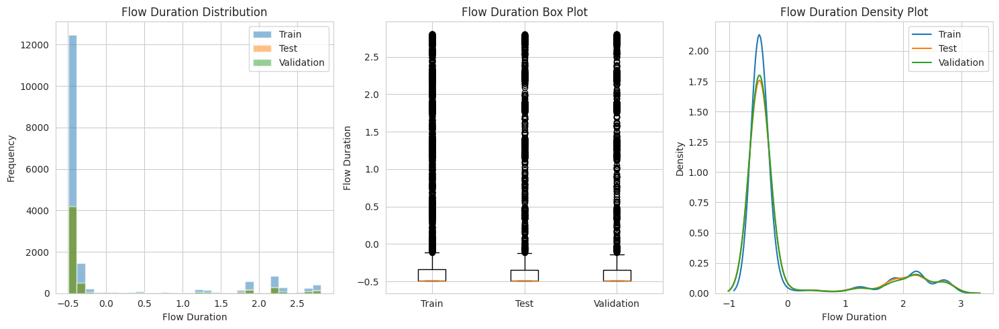

Kolmogorov-Smirnov Test Results:
Train vs Test:
  Statistic: 0.0075
  P-value: 0.9632
  Significant Difference: False
Train vs Validation:
  Statistic: 0.0136
  P-value: 0.3831
  Significant Difference: False
Test vs Validation:
  Statistic: 0.0133
  P-value: 0.6787
  Significant Difference: False

Jensen-Shannon Divergence:
train_vs_test_js_div: 0.0010
train_vs_val_js_div: 0.0008
test_vs_val_js_div: 0.0008

--- Analysis for Feature: Flow IAT Mean ---


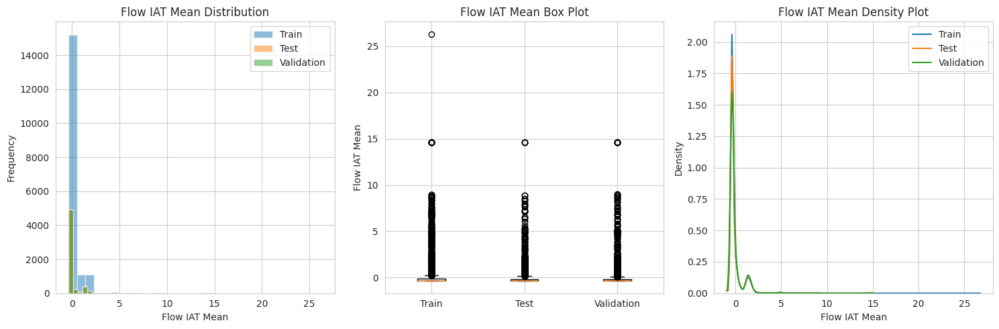

Kolmogorov-Smirnov Test Results:
Train vs Test:
  Statistic: 0.0108
  P-value: 0.6738
  Significant Difference: False
Train vs Validation:
  Statistic: 0.0121
  P-value: 0.5356
  Significant Difference: False
Test vs Validation:
  Statistic: 0.0131
  P-value: 0.6942
  Significant Difference: False

Jensen-Shannon Divergence:
train_vs_test_js_div: 0.0370
train_vs_val_js_div: 0.0391
test_vs_val_js_div: 0.0008

--- Analysis for Feature: Bwd Packet Length Mean ---


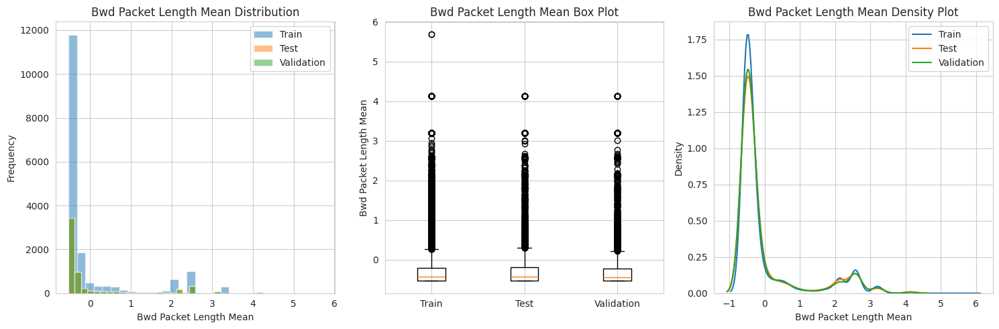

Kolmogorov-Smirnov Test Results:
Train vs Test:
  Statistic: 0.0085
  P-value: 0.9050
  Significant Difference: False
Train vs Validation:
  Statistic: 0.0142
  P-value: 0.3313
  Significant Difference: False
Test vs Validation:
  Statistic: 0.0143
  P-value: 0.5857
  Significant Difference: False

Jensen-Shannon Divergence:
train_vs_test_js_div: 0.0713
train_vs_val_js_div: 0.0704
test_vs_val_js_div: 0.0013

--- Analysis for Feature: Bwd Packet Length Max ---


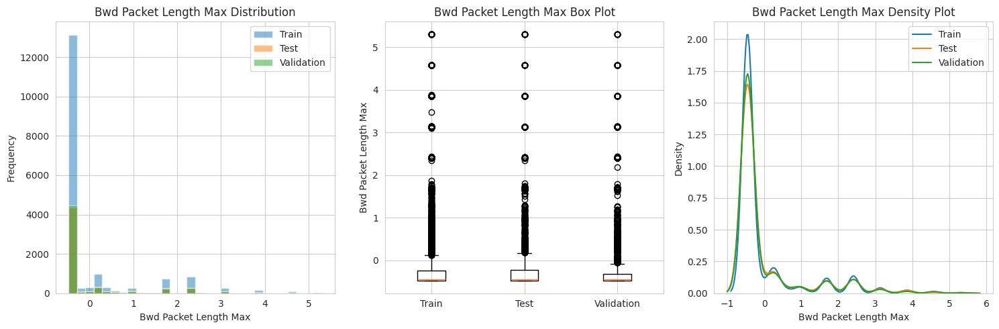

Kolmogorov-Smirnov Test Results:
Train vs Test:
  Statistic: 0.0090
  P-value: 0.8634
  Significant Difference: False
Train vs Validation:
  Statistic: 0.0149
  P-value: 0.2757
  Significant Difference: False
Test vs Validation:
  Statistic: 0.0160
  P-value: 0.4399
  Significant Difference: False

Jensen-Shannon Divergence:
train_vs_test_js_div: 0.0005
train_vs_val_js_div: 0.0013
test_vs_val_js_div: 0.0015

--- Analysis for Feature: Flow Bytes/s ---


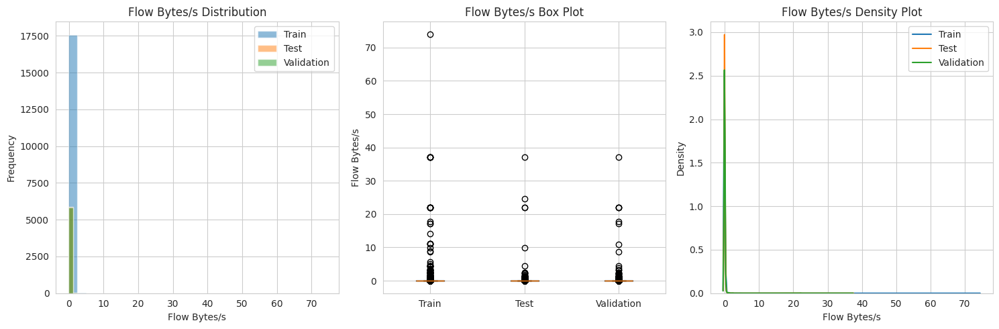

Kolmogorov-Smirnov Test Results:
Train vs Test:
  Statistic: 0.0091
  P-value: 0.8564
  Significant Difference: False
Train vs Validation:
  Statistic: 0.0160
  P-value: 0.2044
  Significant Difference: False
Test vs Validation:
  Statistic: 0.0153
  P-value: 0.4960
  Significant Difference: False

Jensen-Shannon Divergence:
train_vs_test_js_div: 0.0007
train_vs_val_js_div: 0.0009
test_vs_val_js_div: 0.0003

--- Analysis for Feature: Down/Up Ratio ---


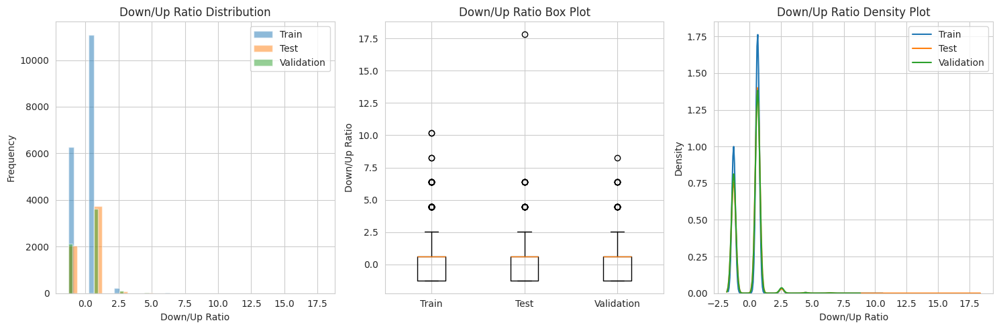

Kolmogorov-Smirnov Test Results:
Train vs Test:
  Statistic: 0.0072
  P-value: 0.9743
  Significant Difference: False
Train vs Validation:
  Statistic: 0.0078
  P-value: 0.9520
  Significant Difference: False
Test vs Validation:
  Statistic: 0.0150
  P-value: 0.5253
  Significant Difference: False

Jensen-Shannon Divergence:
train_vs_test_js_div: 0.4672
train_vs_val_js_div: 0.4467
test_vs_val_js_div: 0.4489

--- Analysis for Feature: SYN Flag Count ---


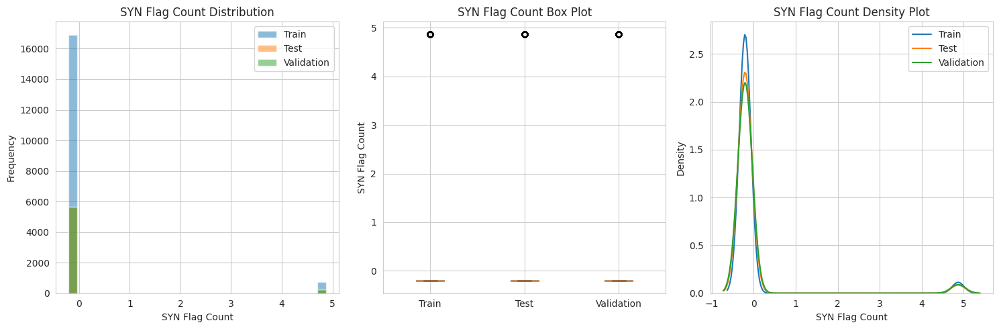

Kolmogorov-Smirnov Test Results:
Train vs Test:
  Statistic: 0.0046
  P-value: 1.0000
  Significant Difference: False
Train vs Validation:
  Statistic: 0.0010
  P-value: 1.0000
  Significant Difference: False
Test vs Validation:
  Statistic: 0.0036
  P-value: 1.0000
  Significant Difference: False

Jensen-Shannon Divergence:
train_vs_test_js_div: 0.0001
train_vs_val_js_div: 0.0000
test_vs_val_js_div: 0.0000

--- Analysis for Feature: Fwd Packet Length Mean ---


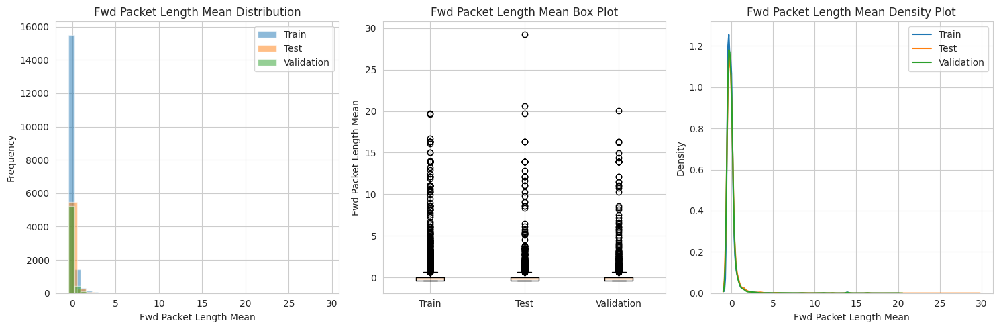

Kolmogorov-Smirnov Test Results:
Train vs Test:
  Statistic: 0.0076
  P-value: 0.9574
  Significant Difference: False
Train vs Validation:
  Statistic: 0.0130
  P-value: 0.4420
  Significant Difference: False
Test vs Validation:
  Statistic: 0.0160
  P-value: 0.4399
  Significant Difference: False

Jensen-Shannon Divergence:
train_vs_test_js_div: 0.0055
train_vs_val_js_div: 0.0006
test_vs_val_js_div: 0.0039

--- Analysis for Feature: Fwd IAT Std ---


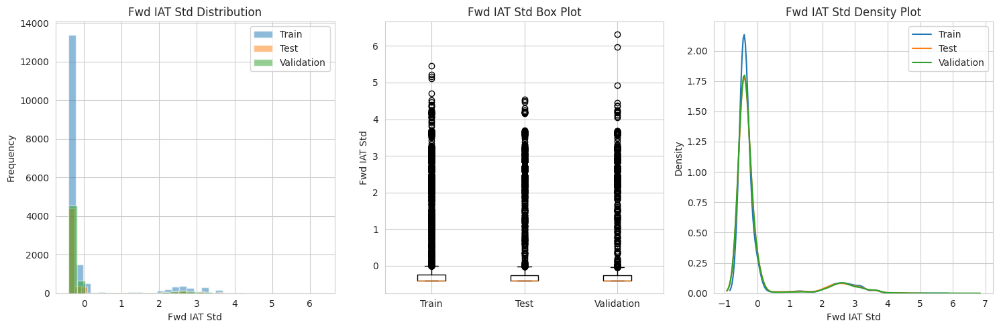

Kolmogorov-Smirnov Test Results:
Train vs Test:
  Statistic: 0.0058
  P-value: 0.9983
  Significant Difference: False
Train vs Validation:
  Statistic: 0.0153
  P-value: 0.2524
  Significant Difference: False
Test vs Validation:
  Statistic: 0.0180
  P-value: 0.2947
  Significant Difference: False

Jensen-Shannon Divergence:
train_vs_test_js_div: 0.0237
train_vs_val_js_div: 0.0195
test_vs_val_js_div: 0.0501

--- Analysis for Feature: Packet Length Mean ---


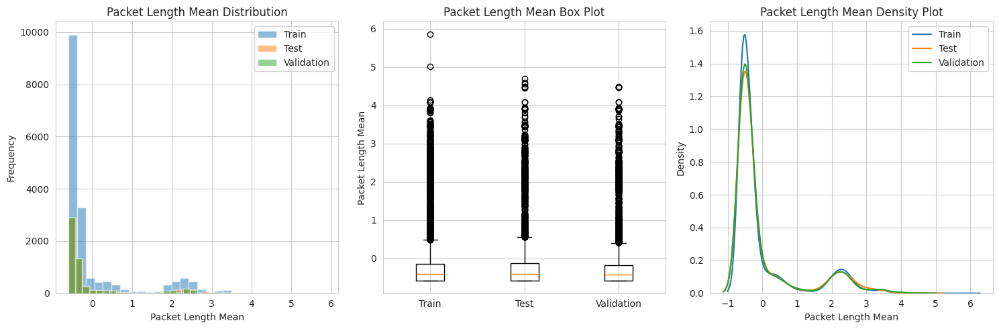

Kolmogorov-Smirnov Test Results:
Train vs Test:
  Statistic: 0.0094
  P-value: 0.8320
  Significant Difference: False
Train vs Validation:
  Statistic: 0.0142
  P-value: 0.3360
  Significant Difference: False
Test vs Validation:
  Statistic: 0.0157
  P-value: 0.4675
  Significant Difference: False

Jensen-Shannon Divergence:
train_vs_test_js_div: 0.0375
train_vs_val_js_div: 0.0393
test_vs_val_js_div: 0.0149

--- Analysis for Feature: Fwd Packet Length Max ---


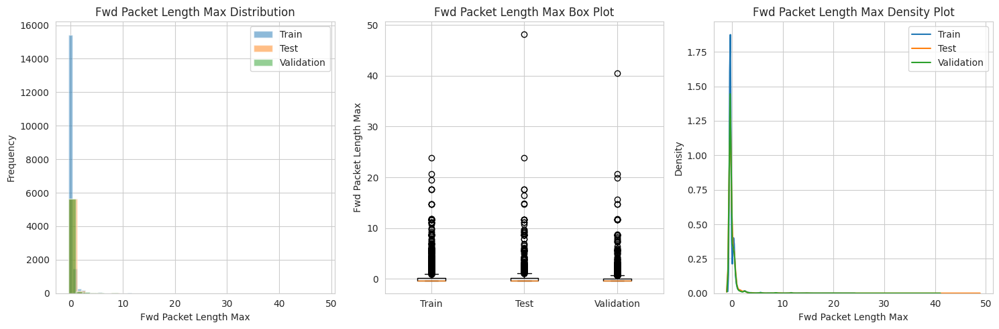

Kolmogorov-Smirnov Test Results:
Train vs Test:
  Statistic: 0.0087
  P-value: 0.8876
  Significant Difference: False
Train vs Validation:
  Statistic: 0.0157
  P-value: 0.2269
  Significant Difference: False
Test vs Validation:
  Statistic: 0.0208
  P-value: 0.1588
  Significant Difference: False

Jensen-Shannon Divergence:
train_vs_test_js_div: 0.0139
train_vs_val_js_div: 0.0161
test_vs_val_js_div: 0.0027

--- Analysis for Feature: Flow Packets/s ---


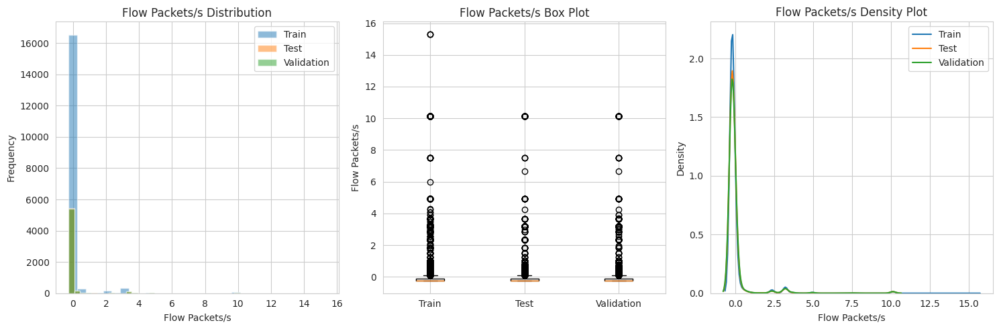

Kolmogorov-Smirnov Test Results:
Train vs Test:
  Statistic: 0.0102
  P-value: 0.7488
  Significant Difference: False
Train vs Validation:
  Statistic: 0.0121
  P-value: 0.5351
  Significant Difference: False
Test vs Validation:
  Statistic: 0.0126
  P-value: 0.7401
  Significant Difference: False

Jensen-Shannon Divergence:
train_vs_test_js_div: 0.0218
train_vs_val_js_div: 0.0225
test_vs_val_js_div: 0.0006

--- Analysis for Feature: Total Fwd Packets ---


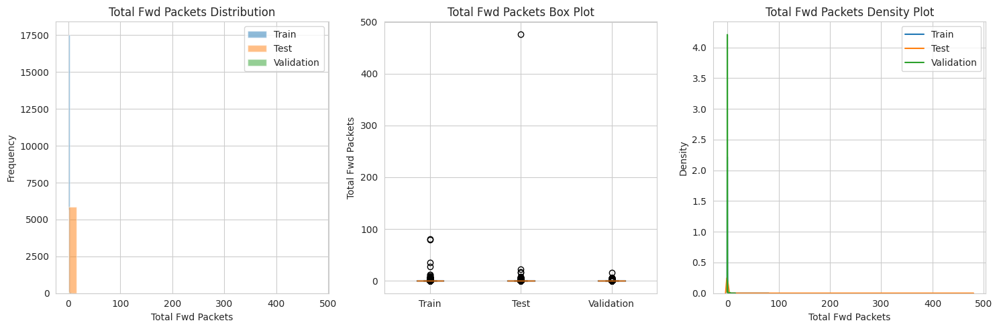

Kolmogorov-Smirnov Test Results:
Train vs Test:
  Statistic: 0.0137
  P-value: 0.3756
  Significant Difference: False
Train vs Validation:
  Statistic: 0.0160
  P-value: 0.2097
  Significant Difference: False
Test vs Validation:
  Statistic: 0.0140
  P-value: 0.6165
  Significant Difference: False

Jensen-Shannon Divergence:
train_vs_test_js_div: 0.0014
train_vs_val_js_div: 0.0075
test_vs_val_js_div: 0.0140

--- Analysis for Feature: Destination Port ---


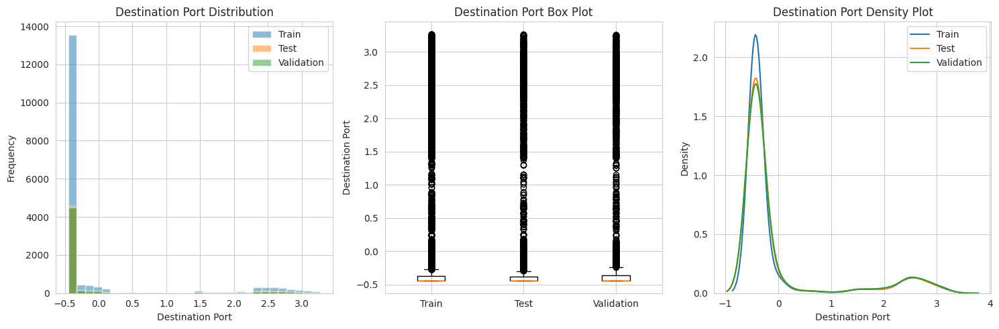

Kolmogorov-Smirnov Test Results:
Train vs Test:
  Statistic: 0.0098
  P-value: 0.7846
  Significant Difference: False
Train vs Validation:
  Statistic: 0.0071
  P-value: 0.9790
  Significant Difference: False
Test vs Validation:
  Statistic: 0.0148
  P-value: 0.5402
  Significant Difference: False

Jensen-Shannon Divergence:
train_vs_test_js_div: 0.0007
train_vs_val_js_div: 0.0006
test_vs_val_js_div: 0.0014


{'Flow Duration': {'ks_tests': {'train_vs_test': {'statistic': np.float64(0.007511202182074184),
    'p_value': np.float64(0.9631919797937922),
    'sets_compared': 'Train vs Test',
    'significant_difference': np.False_},
   'train_vs_val': {'statistic': np.float64(0.013623959345829384),
    'p_value': np.float64(0.3830925418010922),
    'sets_compared': 'Train vs Validation',
    'significant_difference': np.False_},
   'test_vs_val': {'statistic': np.float64(0.013272077590607452),
    'p_value': np.float64(0.6787021676381784),
    'sets_compared': 'Test vs Validation',
    'significant_difference': np.False_}},
  'distribution_metrics': {'train_vs_test_js_div': np.float64(0.0010247426752213228),
   'train_vs_val_js_div': np.float64(0.000796744116662299),
   'test_vs_val_js_div': np.float64(0.000797025885128762)}},
 'Flow IAT Mean': {'ks_tests': {'train_vs_test': {'statistic': np.float64(0.010842473003240705),
    'p_value': np.float64(0.673771808992577),
    'sets_compared': 'Train

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from scipy import stats
import scipy.stats as stats_scipy

def analyze_class_distribution(y_train, y_test, y_val):
    """
    Analyze class distribution across train, test, and validation sets.

    Args:
        y_train (np.ndarray): Training labels.
        y_test (np.ndarray): Test labels.
        y_val (np.ndarray): Validation labels.
    """
    def get_class_distribution(labels):
        unique, counts = np.unique(labels, return_counts=True)
        total = len(labels)
        percentages = (counts / total) * 100
        return dict(zip(unique, percentages))

    print("Train Set Class Distribution:")
    train_dist = get_class_distribution(y_train)
    for cls, percentage in train_dist.items():
        print(f"Class {cls}: {percentage:.2f}%")

    print("\nTest Set Class Distribution:")
    test_dist = get_class_distribution(y_test)
    for cls, percentage in test_dist.items():
        print(f"Class {cls}: {percentage:.2f}%")

    print("\nValidation Set Class Distribution:")
    val_dist = get_class_distribution(y_val)
    for cls, percentage in val_dist.items():
        print(f"Class {cls}: {percentage:.2f}%")

    return train_dist, test_dist, val_dist

distributions = analyze_class_distribution(y_train, y_test, y_val)
print(distributions)

def compare_distributions(train_data, test_data, val_data, feature_name):
    """
    Compare distributions of a specific feature across train, test, and validation sets.

    Parameters:
        train_data: Training dataset feature column.
        test_data: Test dataset feature column.
        val_data: Validation dataset feature column.
        feature_name: Name of the feature being analyzed.

    Returns:
        Dictionary of statistical test results and visualization.
    """
    results = {}

    # 1. Statistical Tests (Kolmogorov-Smirnov Test)
    def ks_test_between_sets(set1, set2, set_names):
        statistic, p_value = stats.ks_2samp(set1, set2)
        return {
            'statistic': statistic,
            'p_value': p_value,
            'sets_compared': set_names,
            'significant_difference': p_value < 0.05
        }

    results['ks_tests'] = {
        'train_vs_test': ks_test_between_sets(train_data, test_data, 'Train vs Test'),
        'train_vs_val': ks_test_between_sets(train_data, val_data, 'Train vs Validation'),
        'test_vs_val': ks_test_between_sets(test_data, val_data, 'Test vs Validation')
    }

    # 2. Distribution Visualization
    plt.figure(figsize=(15, 5))
    plt.subplot(131)
    plt.hist(train_data, bins=30, alpha=0.5, label='Train')
    plt.hist(test_data, bins=30, alpha=0.5, label='Test')
    plt.hist(val_data, bins=30, alpha=0.5, label='Validation')
    plt.title(f'{feature_name} Distribution')
    plt.xlabel(feature_name)
    plt.ylabel('Frequency')
    plt.legend()

    plt.subplot(132)
    box_data = [train_data, test_data, val_data]
    plt.boxplot(box_data, labels=['Train', 'Test', 'Validation'])
    plt.title(f'{feature_name} Box Plot')
    plt.ylabel(feature_name)

    plt.subplot(133)
    sns.kdeplot(train_data, label='Train')
    sns.kdeplot(test_data, label='Test')
    sns.kdeplot(val_data, label='Validation')
    plt.title(f'{feature_name} Density Plot')
    plt.xlabel(feature_name)
    plt.ylabel('Density')
    plt.legend()
    plt.tight_layout()
    plt.show()

    # 3. Distribution Metrics (Jensen-Shannon Divergence)
    def jensen_shannon_divergence(p, q):
        p = np.asarray(p)
        q = np.asarray(q)
        m = 0.5 * (p + q)
        return 0.5 * (stats_scipy.entropy(p, m) + stats_scipy.entropy(q, m))

    def get_distribution_histogram(data, bins=30):
        hist, _ = np.histogram(data, bins=bins, density=True)
        return hist

    results['distribution_metrics'] = {
        'train_vs_test_js_div': jensen_shannon_divergence(
            get_distribution_histogram(train_data),
            get_distribution_histogram(test_data)
        ),
        'train_vs_val_js_div': jensen_shannon_divergence(
            get_distribution_histogram(train_data),
            get_distribution_histogram(val_data)
        ),
        'test_vs_val_js_div': jensen_shannon_divergence(
            get_distribution_histogram(test_data),
            get_distribution_histogram(val_data)
        )
    }
    return results

def analyze_feature_distributions(X_train, X_test, X_val, feature_names=None):
    """
    Analyze distributions for multiple features.

    Parameters:
        X_train: Training dataset (2D NumPy array).
        X_test: Test dataset (2D NumPy array).
        X_val: Validation dataset (2D NumPy array).
        feature_names: Optional list of feature names (default is column indices).
    """
    if feature_names is None:
        feature_names = [f'Feature_{i}' for i in range(X_train.shape[1])]

    assert X_train.shape[1] == len(feature_names), "Number of feature names must match number of columns"
    comprehensive_results = {}
    for idx, feature in enumerate(feature_names):
        print(f"\n--- Analysis for Feature: {feature} ---")
        train_feature = X_train[:, idx]
        test_feature = X_test[:, idx]
        val_feature = X_val[:, idx]
        results = compare_distributions(train_feature, test_feature, val_feature, feature)
        comprehensive_results[feature] = results
        print("Kolmogorov-Smirnov Test Results:")
        for key, test_result in results['ks_tests'].items():
            print(f"{test_result['sets_compared']}:")
            print(f"  Statistic: {test_result['statistic']:.4f}")
            print(f"  P-value: {test_result['p_value']:.4f}")
            print(f"  Significant Difference: {test_result['significant_difference']}")
        print("\nJensen-Shannon Divergence:")
        for key, div_value in results['distribution_metrics'].items():
            print(f"{key}: {div_value:.4f}")
    return comprehensive_results


features = X_train_scaled.columns.tolist()
analyze_feature_distributions(X_train_SS.to_numpy(), X_test_SS.to_numpy(), X_val_SS.to_numpy(), features)


#### PCA + T-SNE

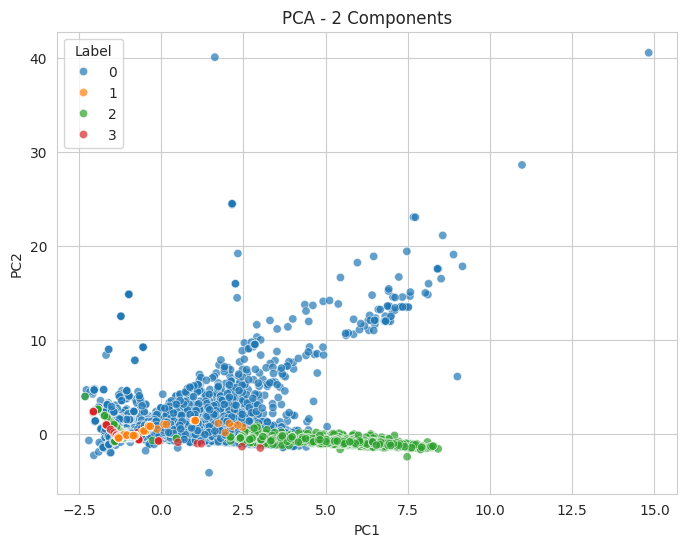

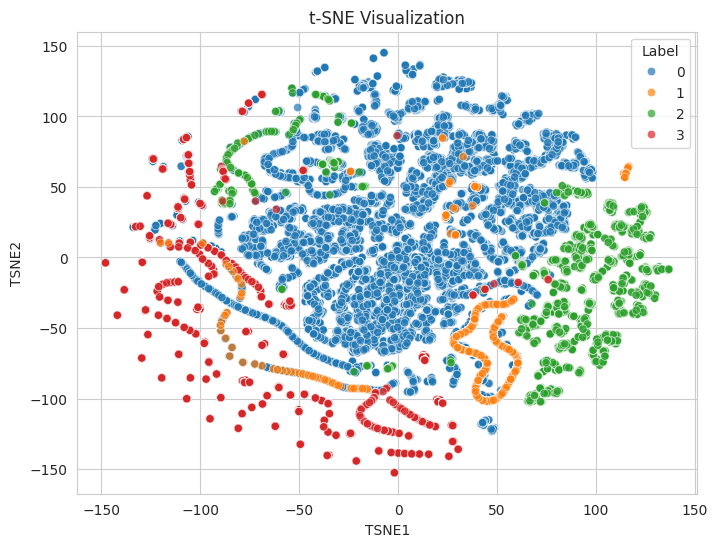

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE
from sklearn.preprocessing import StandardScaler


features = df.drop(columns=['Label', 'Destination Port'], errors='ignore')
labels = df['Label']


scaler = StandardScaler()
features_scaled = scaler.fit_transform(features)

#  PCA visualization (2 components)
pca = PCA(n_components=2)
pca_result = pca.fit_transform(features_scaled)
pca_df = pd.DataFrame(data=pca_result, columns=['PC1', 'PC2'])
pca_df['Label'] = labels.values

plt.figure(figsize=(8, 6))
sns.scatterplot(x='PC1', y='PC2', hue='Label', data=pca_df, palette='tab10', alpha=0.7)
plt.title("PCA - 2 Components")
plt.show()

# t-SNE (2 components)
tsne = TSNE(n_components=2, random_state=42, perplexity=30, max_iter=1000)
tsne_result = tsne.fit_transform(features_scaled)
tsne_df = pd.DataFrame(data=tsne_result, columns=['TSNE1', 'TSNE2'])
tsne_df['Label'] = labels.values

plt.figure(figsize=(8, 6))
sns.scatterplot(x='TSNE1', y='TSNE2', hue='Label', data=tsne_df, palette='tab10', alpha=0.7)
plt.title("t-SNE Visualization")
plt.show()


# DataLoader ( Log + Robust )

In [69]:
X_train_tensor = torch.tensor(X_train_scaled.values, dtype=torch.float32)
y_train_tensor = torch.tensor(y_train, dtype=torch.long)
X_val_tensor = torch.tensor(X_val_scaled.values, dtype=torch.float32)
y_val_tensor = torch.tensor(y_val.values, dtype=torch.long)
X_test_tensor = torch.tensor(X_test_scaled.values, dtype=torch.float32)
y_test_tensor = torch.tensor(y_test.values, dtype=torch.long)

train_dataset = TensorDataset(X_train_tensor, y_train_tensor)
val_dataset = TensorDataset(X_val_tensor, y_val_tensor)
test_dataset = TensorDataset(X_test_tensor, y_test_tensor)

train_loader = DataLoader(train_dataset, batch_size=64, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=64, shuffle=False)
test_loader = DataLoader(test_dataset, batch_size=64, shuffle=False)

# DataLoader ( SS )



In [ ]:
#X_train_tensor_SS = torch.tensor(X_train_SS, dtype=torch.float32)
#y_train_tensor_SS = torch.tensor(y_train, dtype=torch.long)
#X_val_tensor_SS = torch.tensor(X_val_SS, dtype=torch.float32)
#y_val_tensor_SS = torch.tensor(y_val.values, dtype=torch.long)
#X_test_tensor_SS = torch.tensor(X_test_SS, dtype=torch.float32)
#y_test_tensor_SS = torch.tensor(y_test.values, dtype=torch.long)

#train_dataset_SS = TensorDataset(X_train_tensor_SS, y_train_tensor_SS)
#val_dataset_SS = TensorDataset(X_val_tensor_SS, y_val_tensor_SS)
#test_dataset_SS = TensorDataset(X_test_tensor_SS, y_test_tensor_SS)

#train_loader_SS = DataLoader(train_dataset_SS, batch_size=64, shuffle=True)
#val_loader_SS = DataLoader(val_dataset_SS, batch_size=64, shuffle=False)
#test_loader_SS = DataLoader(test_dataset_SS, batch_size=64, shuffle=False)

# Task 2: Shallow Neural Network  ( Log + Robust)

### Hyperparameter


 Layers 1

 Neurons per Layer   {32, 64, 128}

 Activation Linear

 Weight Initialization Default

 Batch Size 64

 Loss Function  Cross-Entropy

 Optimizer  AdamW

 Learning Rate  0.0005

 Epochs & Early Stopping 100 or shorter based on the designed criteria

 Regularization None

In [50]:
# Shallow NN

class SimpleNN(nn.Module):
    def __init__(self, input_size=14, hidden_size=32, output_size=4):
        super(SimpleNN, self).__init__()
        self.fc1 = nn.Linear(input_size, hidden_size)  # Hidden layer
        self.fc2 = nn.Linear(hidden_size, output_size)  # Output layer

    def forward(self, x):
        x = self.fc1(x)  # Linear activation
        x = self.fc2(x)  # Linear output
        return x

In [7]:
# setting the device to cuda for the GPU
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
#device = "cpu"
print(f"The device is set to: {device}")

The device is set to: cuda


In [8]:
def training_loop(model, train_loader, val_loader, train_dataset, val_dataset, device, optimizer, criterion):
    """
    Train the model for a specified number of epochs and track the training and validation losses.

    Args:
        model: The neural network model to be trained.
        train_loader: DataLoader for the training dataset.
        val_loader: DataLoader for the validation dataset.
        train_dataset: The entire training dataset.
        val_dataset: The entire validation dataset.
        device: Device to run the model on (CPU or GPU).
        optimizer: The optimization algorithm to use for updating model parameters.
        criterion: The loss function to use for computing the loss.

    Returns:
        None: The function plots the training and validation loss over the epochs.
    """
    # Move the model to the correct device before training
    model.to(device)  # Add this line to move the model to the device

    # Record the start time
    start_time = time.time()

    # Define training parameters
    # patience = 30
    num_epochs = 100
    patience = 30
    patience_counter = 0
    best_loss = -1

    train_losses = []
    val_losses = []

    # Training loop
    for epoch in range(num_epochs):  # Train for epochs
        train_loss = 0
        val_loss = 0
        model.train()  # Set model to training mode
        for batch_X, batch_y in train_loader:
            batch_X, batch_y = batch_X.to(device), batch_y.to(device)  # Move batch to GPU
            optimizer.zero_grad()  # Clear previous gradients
            outputs = model(batch_X)  # Forward pass
            loss = criterion(outputs, batch_y)  # Compute loss
            loss.backward()  # Backpropagation
            optimizer.step()  # Update model parameters
            train_loss += loss.item() * batch_X.size(0)
        train_loss /= len(train_dataset)
        train_losses.append(train_loss)  # Store training loss

        # Compute Validation loss during training
        model.eval()  # Set model to evaluation mode
        with torch.no_grad():  # Disable gradient computation for validation
            for batch_X, batch_y in val_loader:
                batch_X, batch_y = batch_X.to(device), batch_y.to(device)  # Move batch to GPU
                val_outputs = model(batch_X)  # Forward pass
                loss = criterion(val_outputs, batch_y)  # Compute validation loss
                val_loss += loss.item() * batch_X.size(0)
            val_loss /= len(val_dataset)
            val_losses.append(val_loss)  # Store validation loss
            # Early stopping condition
        if val_loss <= best_loss:
            best_loss = val_loss
            patience_counter = 0
        else:
            patience_counter += 1
        if patience_counter >= patience:
            print(f"Early stopping triggered at epoch number {epoch} ")
            break

        if (epoch + 1) % 20 == 0:
            print(f'Epoch {epoch+1}/{num_epochs}, Train Loss: {train_losses[-1]:.4f}, Val Loss: {val_losses[-1]:.4f}')


    # Record the end time
    end_time = time.time()
    # Calculate the elapsed time
    elapsed_time = end_time - start_time
    print(f'The function took {elapsed_time:.4f} seconds to execute.')

    # Plot the training and validation loss
    plt.figure(figsize=(10, 5))
    plt.plot(train_losses, label='Train Loss')
    plt.plot(val_losses, label='Validation Loss')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.title('Training and Validation Loss')
    plt.legend()
    plt.show()



In [9]:
def plot_confusion_matrix(y_true, y_pred, class_names):
    """
    Creates and displays a confusion matrix to evaluate classification performance.

    Args:
        y_true: Ground truth labels
        y_pred: Predicted labels
        class_names: List of class names for axis labels
    """
    cm = confusion_matrix(y_true, y_pred)  # Compute confusion matrix

    plt.figure(figsize=(8, 6))
    sns.heatmap(cm, annot=True, fmt="d", cmap="Blues", xticklabels=class_names, yticklabels=class_names)

    plt.xlabel("Predicted Label")
    plt.ylabel("True Label")
    plt.title("Confusion Matrix")
    plt.show()
import torch
import time
import numpy as np
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, classification_report

def testing_model(model, dataloader, device):
    """
    Evaluate the model on a given dataloader and compute accuracy, precision, recall, and F1-score.

    Args:
        model: The trained model.
        dataloader: DataLoader for the dataset.
        device: Device to run the model on (CPU or GPU).

    Returns:
        dict: Dictionary containing accuracy, precision, recall, and F1-score.
    """
    # Record the start time
    start_time = time.time()

    model.eval()  # Set the model to evaluation mode
    all_labels = []
    all_predictions = []

    with torch.no_grad():  # Disable gradient computation for efficiency
        for inputs, labels in dataloader:
            inputs, labels = inputs.to(device), labels.to(device)  # Move batch to GPU
            outputs = model(inputs)
            _, predicted = torch.max(outputs, 1)  # Get the class with highest score
            all_labels.extend(labels.cpu().numpy())
            all_predictions.extend(predicted.cpu().numpy())

    # Compute metrics
    accuracy = accuracy_score(all_labels, all_predictions) * 100
    precision = precision_score(all_labels, all_predictions, average=None, zero_division=0)
    recall = recall_score(all_labels, all_predictions, average=None, zero_division=0)
    f1 = f1_score(all_labels, all_predictions, average=None, zero_division=0)

    # Generate classification report
    class_names = [f"Class {cls}" for cls in np.unique(all_labels)]
    print("\nClassification Report:")
    print(classification_report(all_labels, all_predictions, target_names=class_names, zero_division=0))

    # Generation of confusion matrix
    plot_confusion_matrix(all_labels, all_predictions, class_names)

    # Record the end time
    end_time = time.time()
    elapsed_time = end_time - start_time
    print(f'The function took {elapsed_time:.4f} seconds to execute.')

    # Return results as a dictionary
    return {
        "accuracy": accuracy,
        "precision": precision.tolist(),
        "recall": recall.tolist(),
        "f1_score": f1.tolist()
    }


### h:32

In [54]:
# model with a hidden size of 32
n_input_nodes = 14
criterion = nn.CrossEntropyLoss()
model32 = SimpleNN(n_input_nodes,32)
optimizer = optim.AdamW(model32.parameters(), lr=0.0005)
print(model32)
print(criterion)
print(optimizer)

SimpleNN(
  (fc1): Linear(in_features=14, out_features=32, bias=True)
  (fc2): Linear(in_features=32, out_features=4, bias=True)
)
CrossEntropyLoss()
AdamW (
Parameter Group 0
    amsgrad: False
    betas: (0.9, 0.999)
    capturable: False
    differentiable: False
    eps: 1e-08
    foreach: None
    fused: None
    lr: 0.0005
    maximize: False
    weight_decay: 0.01
)


Epoch 20/100, Train Loss: 0.1872, Val Loss: 0.1866
Early stopping triggered at epoch number 29 
The function took 18.5145 seconds to execute.


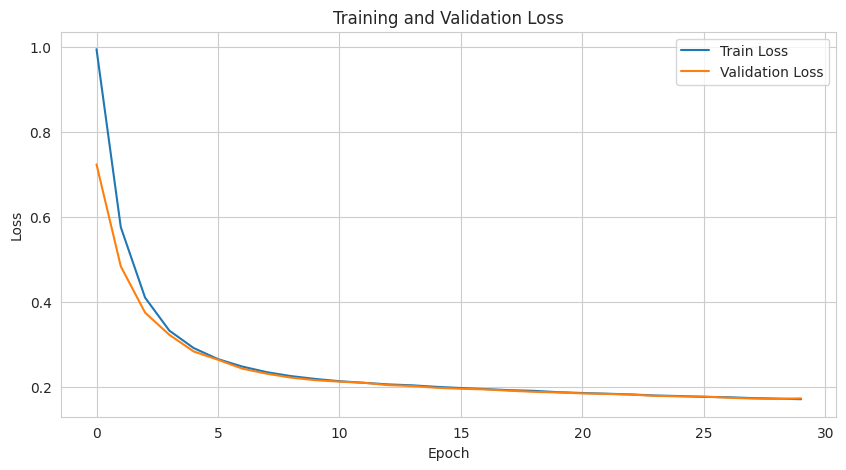

In [55]:
training_loop(model32, train_loader, val_loader, train_dataset, val_dataset, device, optimizer, criterion)


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.96      0.98      0.97     11544
     Class 1       0.85      0.85      0.85       856
     Class 2       0.95      0.89      0.91      2321
     Class 3       0.99      0.97      0.98      2909

    accuracy                           0.96     17630
   macro avg       0.94      0.92      0.93     17630
weighted avg       0.96      0.96      0.96     17630



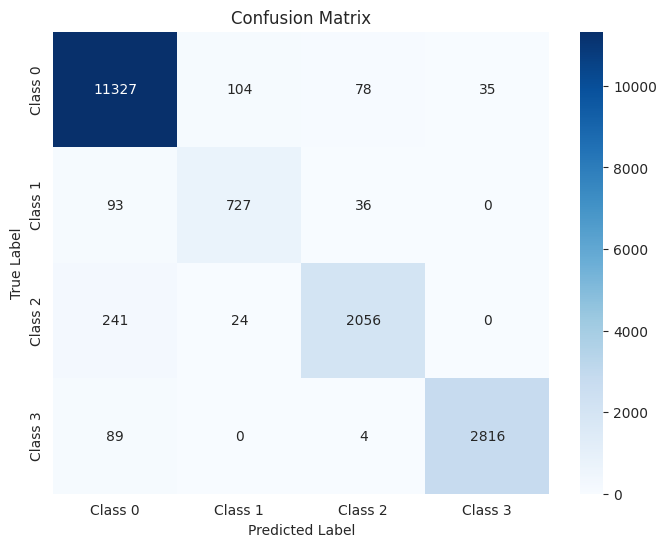

The function took 0.5142 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.97      0.98      0.97      3848
     Class 1       0.82      0.87      0.84       285
     Class 2       0.94      0.88      0.91       774
     Class 3       0.98      0.96      0.97       970

    accuracy                           0.96      5877
   macro avg       0.93      0.92      0.92      5877
weighted avg       0.96      0.96      0.96      5877



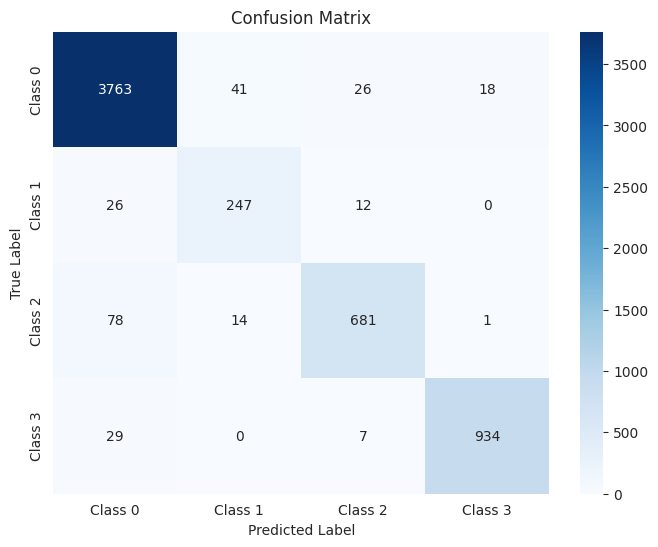

The function took 0.2616 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.96      0.98      0.97      3848
     Class 1       0.86      0.84      0.85       286
     Class 2       0.93      0.89      0.91       773
     Class 3       0.99      0.96      0.98       970

    accuracy                           0.96      5877
   macro avg       0.94      0.92      0.93      5877
weighted avg       0.96      0.96      0.96      5877



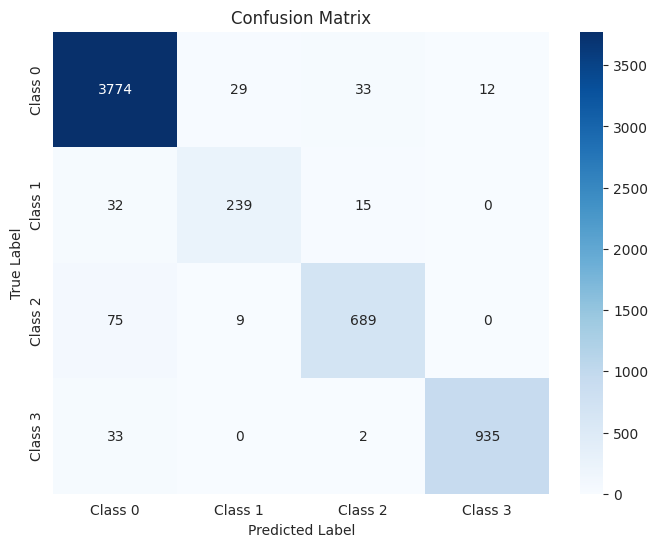

The function took 0.2618 seconds to execute.


In [56]:
train_accuracy = testing_model(model32,train_loader,device)
val_accuracy = testing_model(model32,val_loader,device)
test_accuracy = testing_model(model32,test_loader,device)

### h: 64

SimpleNN(
  (fc1): Linear(in_features=14, out_features=64, bias=True)
  (fc2): Linear(in_features=64, out_features=4, bias=True)
)
CrossEntropyLoss()
AdamW (
Parameter Group 0
    amsgrad: False
    betas: (0.9, 0.999)
    capturable: False
    differentiable: False
    eps: 1e-08
    foreach: None
    fused: None
    lr: 0.0005
    maximize: False
    weight_decay: 0.01
)
Epoch 20/100, Train Loss: 0.1744, Val Loss: 0.1748
Early stopping triggered at epoch number 29 
The function took 16.5159 seconds to execute.


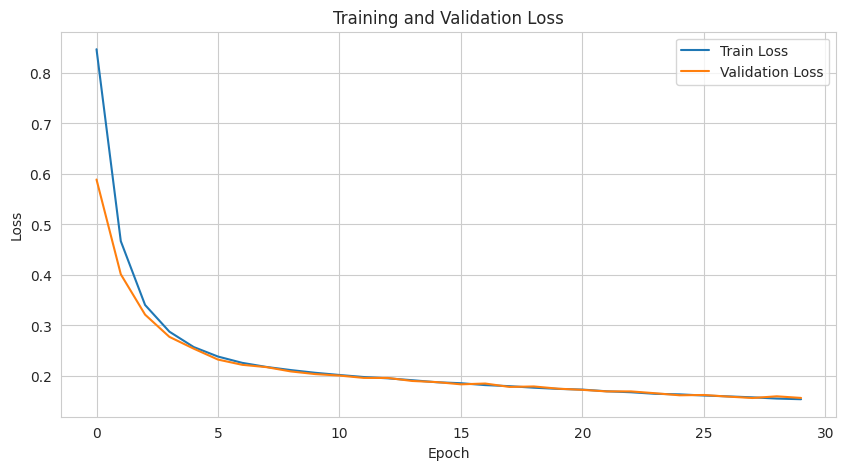

In [57]:
n_input_nodes = 14
criterion = nn.CrossEntropyLoss()
model64 = SimpleNN(input_size=n_input_nodes,hidden_size=64)
optimizer = optim.AdamW(model64.parameters(), lr=0.0005)
print(model64)
print(criterion)
print(optimizer)

training_loop(model64, train_loader, val_loader, train_dataset, val_dataset, device, optimizer, criterion)


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.96      0.98      0.97     11544
     Class 1       0.84      0.85      0.85       856
     Class 2       0.94      0.88      0.91      2321
     Class 3       0.99      0.97      0.98      2909

    accuracy                           0.96     17630
   macro avg       0.93      0.92      0.93     17630
weighted avg       0.96      0.96      0.96     17630



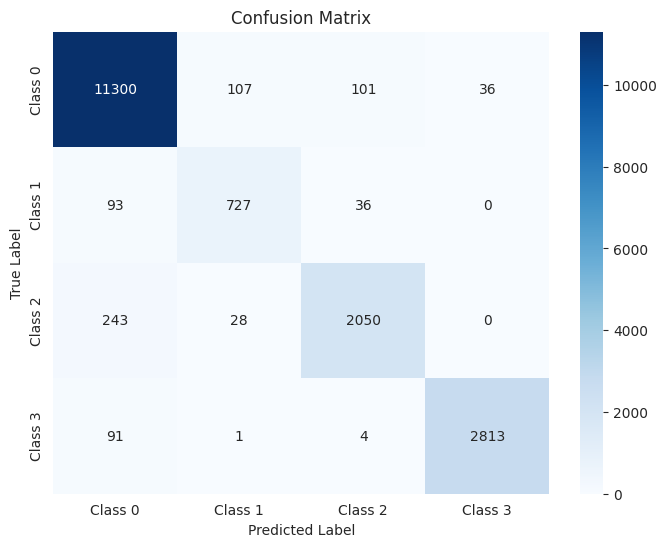

The function took 0.7391 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.97      0.98      0.97      3848
     Class 1       0.81      0.87      0.84       285
     Class 2       0.94      0.89      0.91       774
     Class 3       0.98      0.96      0.97       970

    accuracy                           0.96      5877
   macro avg       0.92      0.92      0.92      5877
weighted avg       0.96      0.96      0.96      5877



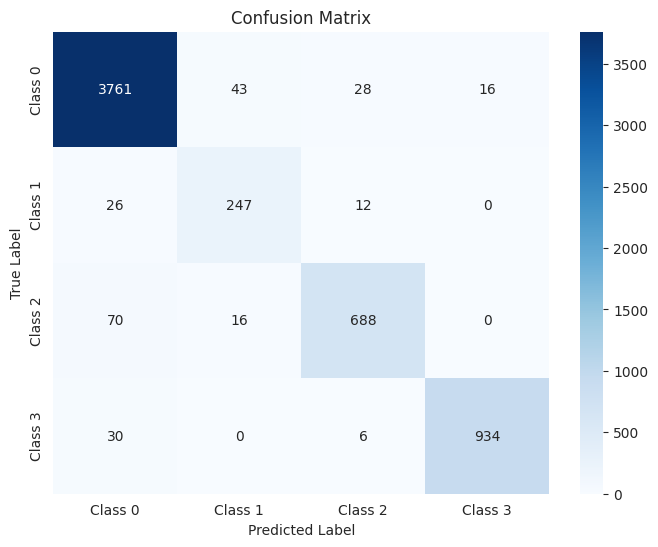

The function took 0.3547 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.96      0.98      0.97      3848
     Class 1       0.85      0.84      0.84       286
     Class 2       0.92      0.89      0.90       773
     Class 3       0.99      0.96      0.98       970

    accuracy                           0.96      5877
   macro avg       0.93      0.92      0.92      5877
weighted avg       0.96      0.96      0.96      5877



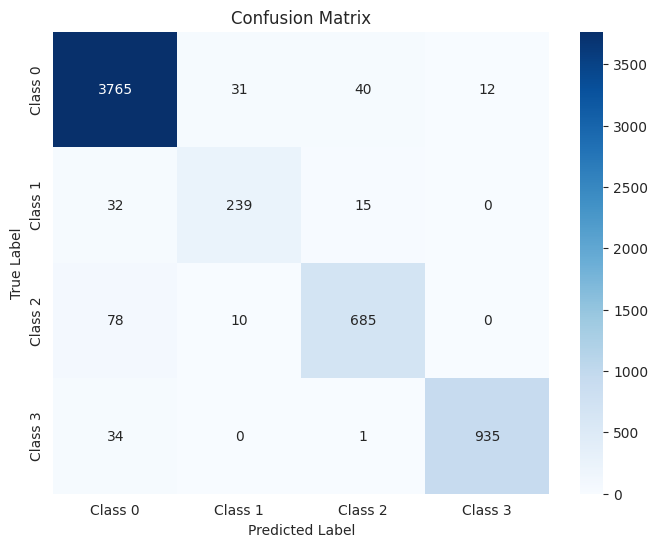

The function took 0.2576 seconds to execute.


In [58]:
train_accuracy = testing_model(model64,train_loader,device)
val_accuracy = testing_model(model64,val_loader,device)
test_accuracy = testing_model(model64,test_loader,device)

### h: 128

SimpleNN(
  (fc1): Linear(in_features=14, out_features=128, bias=True)
  (fc2): Linear(in_features=128, out_features=4, bias=True)
)
CrossEntropyLoss()
AdamW (
Parameter Group 0
    amsgrad: False
    betas: (0.9, 0.999)
    capturable: False
    differentiable: False
    eps: 1e-08
    foreach: None
    fused: None
    lr: 0.0005
    maximize: False
    weight_decay: 0.01
)
Epoch 20/100, Train Loss: 0.1617, Val Loss: 0.1596
Early stopping triggered at epoch number 29 
The function took 15.9215 seconds to execute.


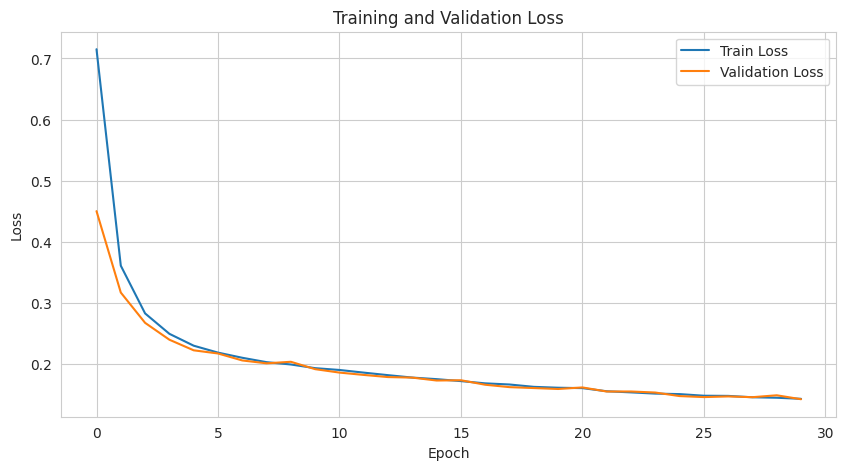

In [59]:
n_input_nodes = 14
criterion = nn.CrossEntropyLoss()
model_128 = SimpleNN(input_size=n_input_nodes,hidden_size=128)
optimizer = optim.AdamW(model_128.parameters(), lr=0.0005)
print(model_128)
print(criterion)
print(optimizer)

training_loop(model_128, train_loader, val_loader, train_dataset, val_dataset, device, optimizer, criterion)


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.97      0.98      0.98     11544
     Class 1       0.83      0.85      0.84       856
     Class 2       0.93      0.90      0.92      2321
     Class 3       0.98      0.99      0.99      2909

    accuracy                           0.96     17630
   macro avg       0.93      0.93      0.93     17630
weighted avg       0.96      0.96      0.96     17630



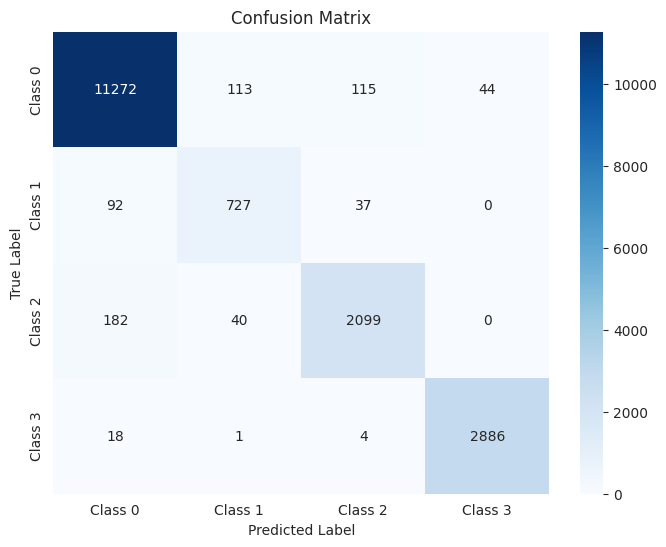

The function took 0.4487 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.98      0.98      3848
     Class 1       0.79      0.87      0.83       285
     Class 2       0.94      0.91      0.92       774
     Class 3       0.98      0.99      0.99       970

    accuracy                           0.96      5877
   macro avg       0.92      0.93      0.93      5877
weighted avg       0.96      0.96      0.96      5877



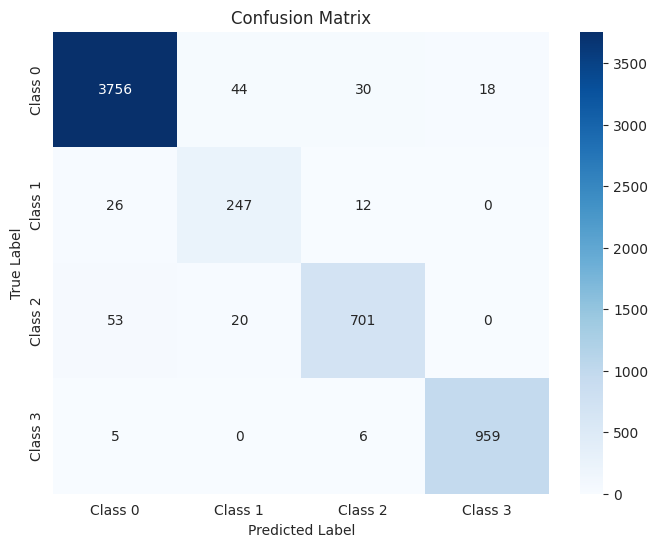

The function took 0.2959 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.97      0.97      0.97      3848
     Class 1       0.83      0.84      0.83       286
     Class 2       0.91      0.91      0.91       773
     Class 3       0.99      0.99      0.99       970

    accuracy                           0.96      5877
   macro avg       0.93      0.93      0.93      5877
weighted avg       0.96      0.96      0.96      5877



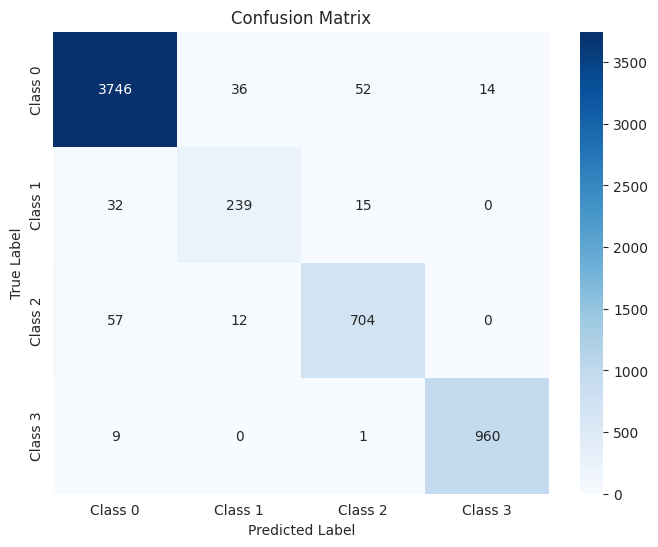

The function took 0.2849 seconds to execute.


In [60]:
train_accuracy = testing_model(model_128,train_loader,device)
val_accuracy = testing_model(model_128,val_loader,device)
test_accuracy = testing_model(model_128,test_loader,device)

### ReLu activation

In [76]:
class SimpleNN_ReLU(nn.Module):
    def __init__(self, input_size=14, hidden_size=32, output_size=4):
        super(SimpleNN_ReLU, self).__init__()
        self.fc1 = nn.Linear(input_size, hidden_size)  # Hidden layer
        self.fc2 = nn.Linear(hidden_size, output_size)  # Output layer
        self.relu = nn.ReLU()

    def forward(self, x):
        x = self.relu(self.fc1(x))
        x = self.fc2(x)
        return x

In [77]:
relu_nn = SimpleNN_ReLU(input_size=14,hidden_size=64)
optimizer = optim.AdamW(relu_nn.parameters(), lr=0.0005)
criterion = nn.CrossEntropyLoss()
print(relu_nn)
print(criterion)
print(optimizer)

SimpleNN_ReLU(
  (fc1): Linear(in_features=14, out_features=64, bias=True)
  (fc2): Linear(in_features=64, out_features=4, bias=True)
  (relu): ReLU()
)
CrossEntropyLoss()
AdamW (
Parameter Group 0
    amsgrad: False
    betas: (0.9, 0.999)
    capturable: False
    differentiable: False
    eps: 1e-08
    foreach: None
    fused: None
    lr: 0.0005
    maximize: False
    weight_decay: 0.01
)


Epoch 20/100, Train Loss: 0.0780, Val Loss: 0.0801
Early stopping triggered at epoch number 29 
The function took 22.3923 seconds to execute.


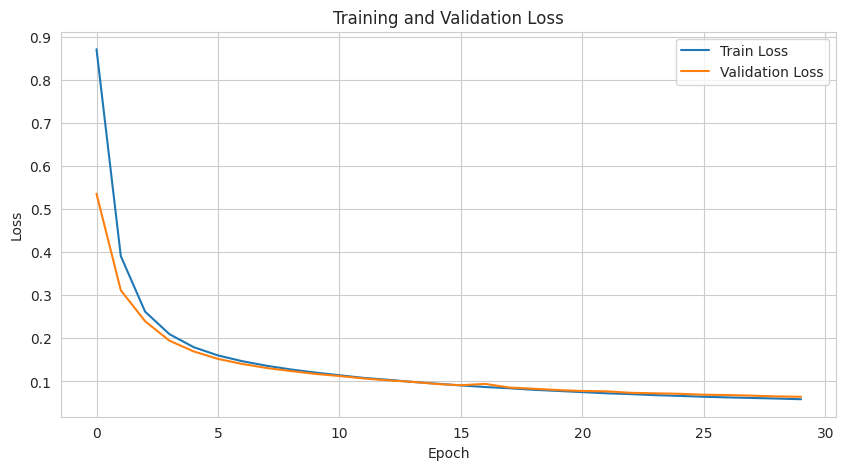

In [78]:
training_loop(relu_nn, train_loader, val_loader, train_dataset, val_dataset, device, optimizer, criterion)


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.99      0.99     11544
     Class 1       0.88      0.94      0.91       856
     Class 2       0.97      0.98      0.98      2321
     Class 3       1.00      0.99      0.99      2909

    accuracy                           0.98     17630
   macro avg       0.96      0.97      0.97     17630
weighted avg       0.98      0.98      0.98     17630



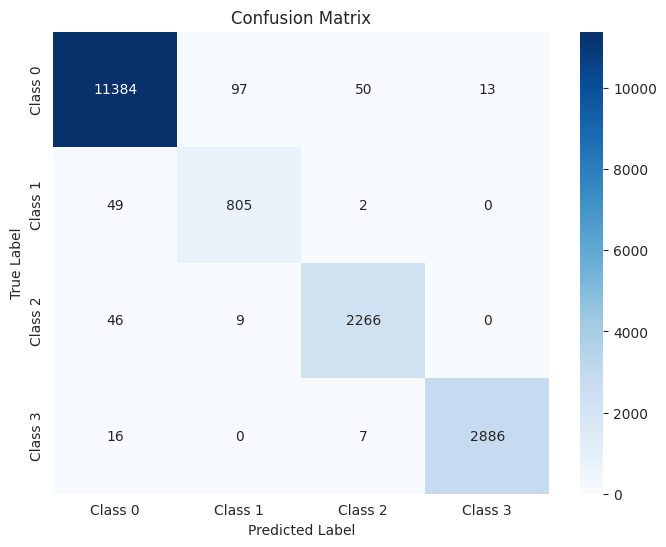

The function took 0.9224 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.98      0.99      3848
     Class 1       0.86      0.95      0.90       285
     Class 2       0.97      0.98      0.97       774
     Class 3       1.00      0.99      0.99       970

    accuracy                           0.98      5877
   macro avg       0.95      0.97      0.96      5877
weighted avg       0.98      0.98      0.98      5877



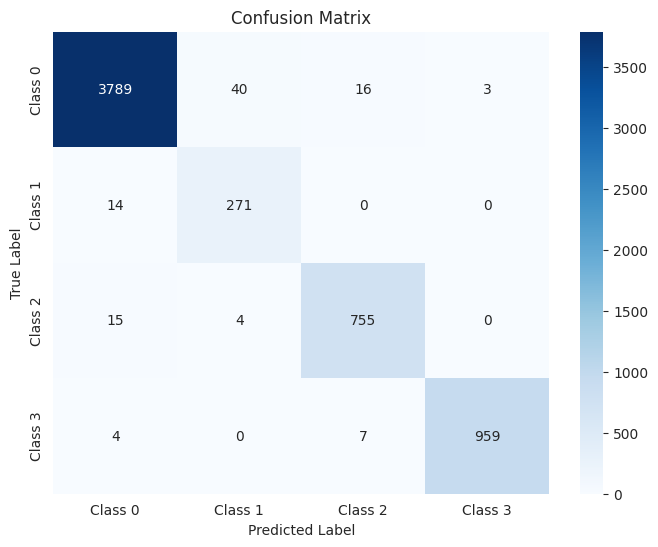

The function took 0.9508 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.99      0.99      3848
     Class 1       0.91      0.95      0.93       286
     Class 2       0.97      0.98      0.97       773
     Class 3       0.99      0.99      0.99       970

    accuracy                           0.98      5877
   macro avg       0.97      0.98      0.97      5877
weighted avg       0.98      0.98      0.98      5877



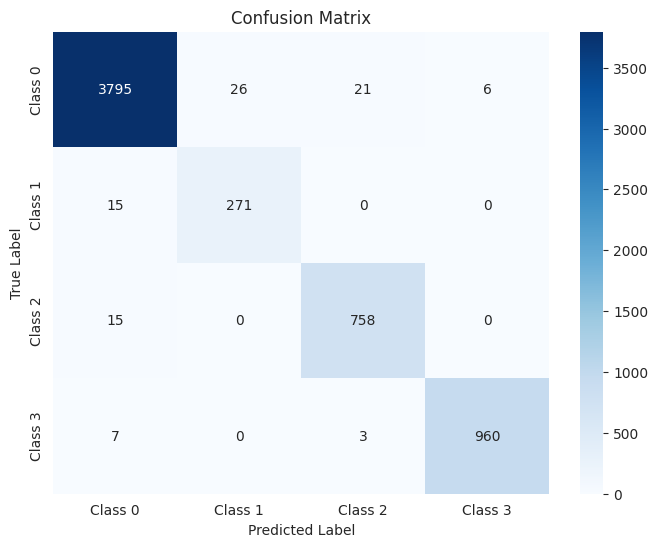

The function took 0.2850 seconds to execute.


In [79]:
train_accuracy = testing_model(relu_nn,train_loader,device)
val_accuracy = testing_model(relu_nn,val_loader,device)
test_accuracy = testing_model(relu_nn,test_loader,device)

# Task 3 : Impact of specific features

In [80]:
# here we take the test test, we replace port 80 with port 8080 (so we don't have to encode the port)

X_test_8080 = X_test.copy()
X_test_8080 = X_test_8080.assign(Label=y_test.values)


X_test_8080.loc[(X_test_8080['Label'] == 1) & (X_test_8080['Destination Port'] == 80), 'Destination Port'] = 8080

X_test_8080 = X_test_8080.drop(columns=['Label'])

#  Preprocessing the test set
X_test_8080.drop_duplicates(inplace=True)
# For the test set, we apply the same log transform and the same scaler fitted on the training set
X_test_log = X_test_8080.copy()
for col in columns_to_log:
    X_test_log[col] = log_transformer.transform(X_test_log[[col]])



X_test_scaled = scaler.transform(X_test_log)
X_test_scaled = pd.DataFrame(X_test_scaled, columns=X_test_log.columns, index=X_test_log.index)


X_test_tensor = torch.tensor(X_test_scaled.values, dtype=torch.float32)
y_test_tensor = torch.tensor(y_test.values, dtype=torch.long)

test_dataset = TensorDataset(X_test_tensor, y_test_tensor)

test_loader = DataLoader(test_dataset, batch_size=64, shuffle=False)


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.92      0.99      0.95      3848
     Class 1       0.00      0.00      0.00       286
     Class 2       0.97      0.98      0.97       773
     Class 3       0.99      0.99      0.99       970

    accuracy                           0.94      5877
   macro avg       0.72      0.74      0.73      5877
weighted avg       0.90      0.94      0.92      5877



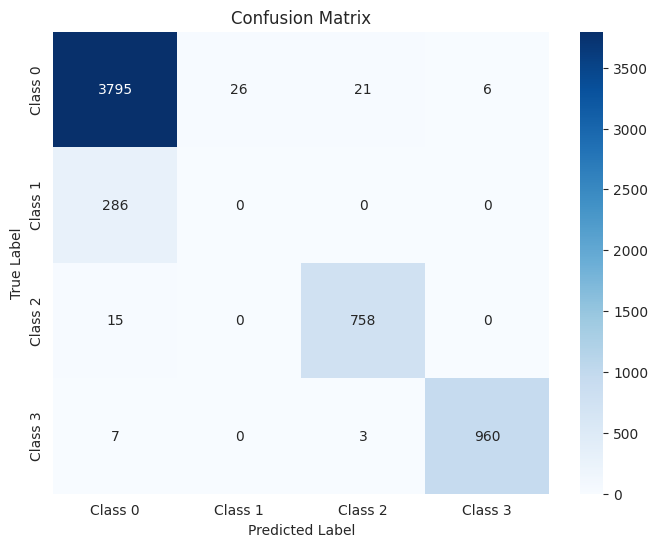

The function took 0.3211 seconds to execute.


In [81]:

test_accuracy = testing_model(relu_nn,test_loader,device)

### Dest-port dropping

{'Benign': np.int64(0), 'Brute Force': np.int64(1), 'DoS Hulk': np.int64(2), 'PortScan': np.int64(3)}
Class distribution - Train:
 Label
0    10808
2     2475
1      914
3      182
Name: count, dtype: int64
Class distribution - Val:
 Label
0    2702
2     619
1     228
3      46
Name: count, dtype: int64
Class distribution - Test:
 Label
0    3378
2     774
1     285
3      57
Name: count, dtype: int64


/tmp/ipython-input-10-4168791344.py:102: FutureWarning: Downcasting behavior in Series and DataFrame methods 'where', 'mask', and 'clip' is deprecated. In a future version this will not infer object dtypes or cast all-round floats to integers. Instead call result.infer_objects(copy=False) for object inference, or cast round floats explicitly. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  X_train_log[col] = X_train_log[col].clip(lower=1e-8)  # Clip values to a small positive number
/tmp/ipython-input-10-4168791344.py:103: FutureWarning: Downcasting behavior in Series and DataFrame methods 'where', 'mask', and 'clip' is deprecated. In a future version this will not infer object dtypes or cast all-round floats to integers. Instead call result.infer_objects(copy=False) for object inference, or cast round floats explicitly. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  X_val_log[col] = X_val_log[

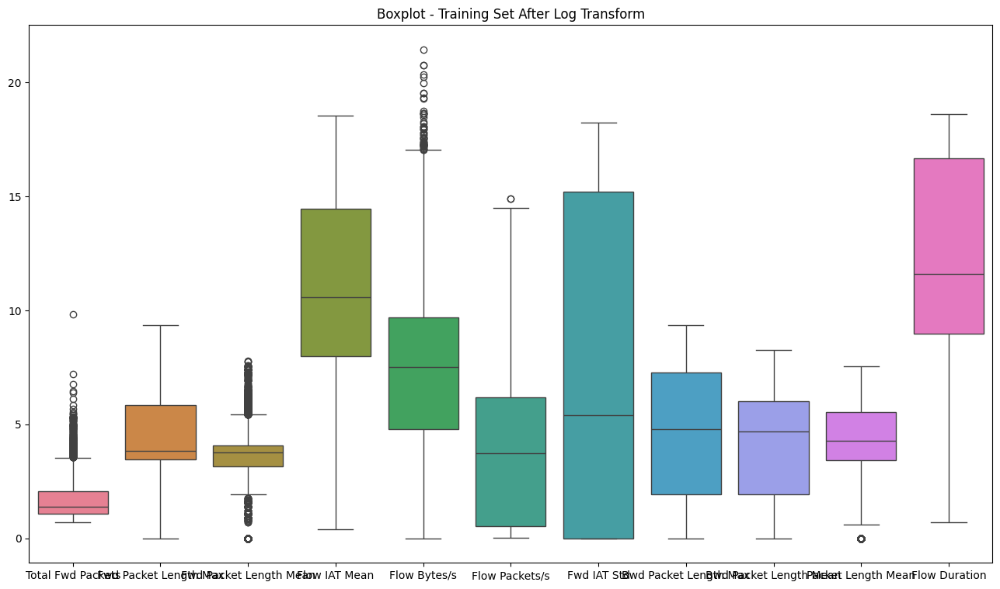

/tmp/ipython-input-10-4168791344.py:128: FutureWarning: Downcasting behavior in Series and DataFrame methods 'where', 'mask', and 'clip' is deprecated. In a future version this will not infer object dtypes or cast all-round floats to integers. Instead call result.infer_objects(copy=False) for object inference, or cast round floats explicitly. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  X_test_log[col] = X_test_log[col].clip(lower=1e-8)
/tmp/ipython-input-10-4168791344.py:128: FutureWarning: Downcasting behavior in Series and DataFrame methods 'where', 'mask', and 'clip' is deprecated. In a future version this will not infer object dtypes or cast all-round floats to integers. Instead call result.infer_objects(copy=False) for object inference, or cast round floats explicitly. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  X_test_log[col] = X_test_log[col].clip(lower=1e-8)


In [10]:
from sklearn.preprocessing import LabelEncoder
downloaded.GetContentFile('data_set_lab_1.csv')
df = pd.read_csv('data_set_lab_1.csv')



label_encoder = LabelEncoder()
df['Label'] = label_encoder.fit_transform(df['Label'])

label_mapping = dict(zip(label_encoder.classes_, label_encoder.transform(label_encoder.classes_)))


print(label_mapping)


# {'Benign': np.int64(0), 'Brute Force': np.int64(1), 'DoS Hulk': np.int64(2), 'PortScan': np.int64(3)}


df.replace([np.inf, -np.inf], np.nan, inplace=True)
df.dropna(inplace=True)

# Convert relevant columns to numeric before comparison
for column in df.select_dtypes(include=['object']).columns:
    if column not in ['Label']:
        try:
            df[column] = pd.to_numeric(df[column])
        except ValueError:
            print(f"Could not convert column '{column}' to numeric.")

#remove of negative numbers
df = df[(df >= 0).all(axis=1)]

# Reset the index if needed
df = df.reset_index(drop=True)


# remove the biased feature
df = df.drop(columns=['Destination Port'])



cols_to_drop = [
    'Fwd PSH Flags',
    'Subflow Fwd Packets'
]

df = df.drop(columns=cols_to_drop)

df.drop_duplicates(inplace=True)



import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import FunctionTransformer, RobustScaler
import matplotlib.pyplot as plt
import seaborn as sns


X = df.drop(columns=['Label'])
y = df['Label']

# 1. Split the dataset into training (60%), validation (20%), and test (20%) sets

X_temp, X_test, y_temp, y_test = train_test_split(
    X, y, test_size=0.2, random_state=42, stratify=y
)
X_train, X_val, y_train, y_val = train_test_split(
    X_temp, y_temp, test_size=0.2, random_state=42, stratify=y_temp
)


#  Display the class distribution in each set
print("Class distribution - Train:\n", y_train.value_counts())
print("Class distribution - Val:\n", y_val.value_counts())
print("Class distribution - Test:\n", y_test.value_counts())

# Preprocessing on training and validation: log transform and scaling
# Define a log transformer using np.log1p (log(x+1))
log_transformer = FunctionTransformer(np.log1p, validate=False)
# Select the columns to apply the log transform (e.g., 'Flow Bytes/s' and 'Flow Packets/s')
columns_to_log = [
'Total Fwd Packets',
'Fwd Packet Length Max',
'Fwd Packet Length Mean',
'Flow IAT Mean',
'Flow Bytes/s',
'Flow Packets/s',
'Fwd IAT Std',
'Bwd Packet Length Max',
'Bwd Packet Length Mean',
'Packet Length Mean',
'Flow Duration']


X_train_log = X_train.copy()
X_val_log = X_val.copy()

for col in columns_to_log:
    # Ensure values are positive before applying log transform
    X_train_log[col] = X_train_log[col].clip(lower=1e-8)  # Clip values to a small positive number
    X_val_log[col] = X_val_log[col].clip(lower=1e-8)  # Clip values to a small positive number

    X_train_log[col] = log_transformer.transform(X_train_log[[col]])
    X_val_log[col] = log_transformer.transform(X_val_log[[col]])

# Display a boxplot to check for outliers after the log transform
plt.figure(figsize=(16, 9))
sns.boxplot(data=X_train_log[columns_to_log])
plt.title("Boxplot - Training Set After Log Transform")
plt.show()

# Apply RobustScaler, which will be fitted only on the training set
scaler = RobustScaler()
X_train_scaled = scaler.fit_transform(X_train_log)
X_val_scaled = scaler.transform(X_val_log)


X_train_scaled = pd.DataFrame(X_train_scaled, columns=X_train_log.columns, index=X_train_log.index)
X_val_scaled = pd.DataFrame(X_val_scaled, columns=X_val_log.columns, index=X_val_log.index)

#  Preprocessing the test set
# For the test set, apply the same log transform and the same scaler fitted on the training set
X_test_log = X_test.copy()
for col in columns_to_log:
    # Ensure values are positive before applying log transform on the test set as well
    X_test_log[col] = X_test_log[col].clip(lower=1e-8)

    X_test_log[col] = log_transformer.transform(X_test_log[[col]])

X_test_scaled = scaler.transform(X_test_log)
X_test_scaled = pd.DataFrame(X_test_scaled, columns=X_test_log.columns, index=X_test_log.index)

# This methodology ensures that the FFNN model is trained and validated on pre-processed data in a consistent manner
# and without information leakage from the test or validation sets.





X_train_tensor = torch.tensor(X_train_scaled.values, dtype=torch.float32)
y_train_tensor = torch.tensor(y_train, dtype=torch.long)
X_val_tensor = torch.tensor(X_val_scaled.values, dtype=torch.float32)
y_val_tensor = torch.tensor(y_val.values, dtype=torch.long)
X_test_tensor = torch.tensor(X_test_scaled.values, dtype=torch.float32)
y_test_tensor = torch.tensor(y_test.values, dtype=torch.long)

train_dataset = TensorDataset(X_train_tensor, y_train_tensor)
val_dataset = TensorDataset(X_val_tensor, y_val_tensor)
test_dataset = TensorDataset(X_test_tensor, y_test_tensor)

train_loader = DataLoader(train_dataset, batch_size=64, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=64, shuffle=False)
test_loader = DataLoader(test_dataset, batch_size=64, shuffle=False)



In [70]:
relu13f_nn = SimpleNN_ReLU(input_size=13,hidden_size=64)
optimizer = optim.AdamW(relu13f_nn.parameters(), lr=0.0005)
criterion = nn.CrossEntropyLoss()
print(relu13f_nn)
print(criterion)
print(optimizer)

SimpleNN_ReLU(
  (fc1): Linear(in_features=13, out_features=64, bias=True)
  (fc2): Linear(in_features=64, out_features=4, bias=True)
  (relu): ReLU()
)
CrossEntropyLoss()
AdamW (
Parameter Group 0
    amsgrad: False
    betas: (0.9, 0.999)
    capturable: False
    differentiable: False
    eps: 1e-08
    foreach: None
    fused: None
    lr: 0.0005
    maximize: False
    weight_decay: 0.01
)


Epoch 20/100, Train Loss: 0.1058, Val Loss: 0.1090
Early stopping triggered at epoch number 29 
The function took 20.4848 seconds to execute.


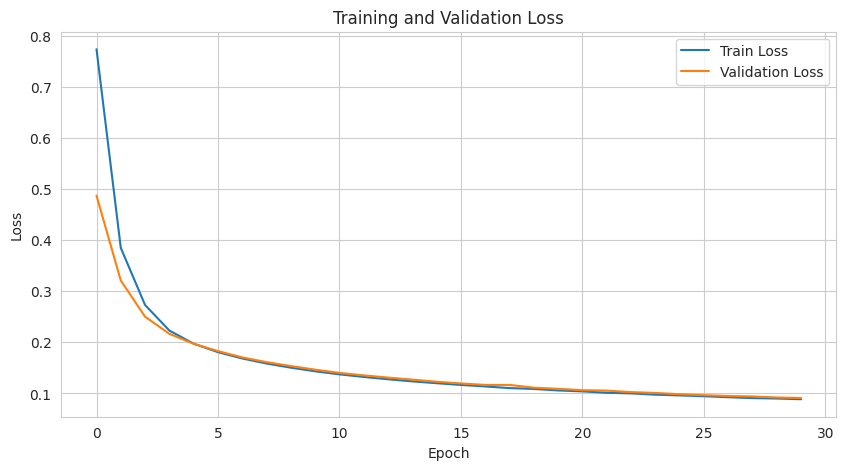

In [71]:
training_loop(relu13f_nn, train_loader, val_loader, train_dataset, val_dataset, device, optimizer, criterion)


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.97      0.99      0.98      3378
     Class 1       0.88      0.89      0.88       285
     Class 2       0.98      0.92      0.95       774
     Class 3       0.92      0.84      0.88        57

    accuracy                           0.97      4494
   macro avg       0.94      0.91      0.92      4494
weighted avg       0.97      0.97      0.97      4494



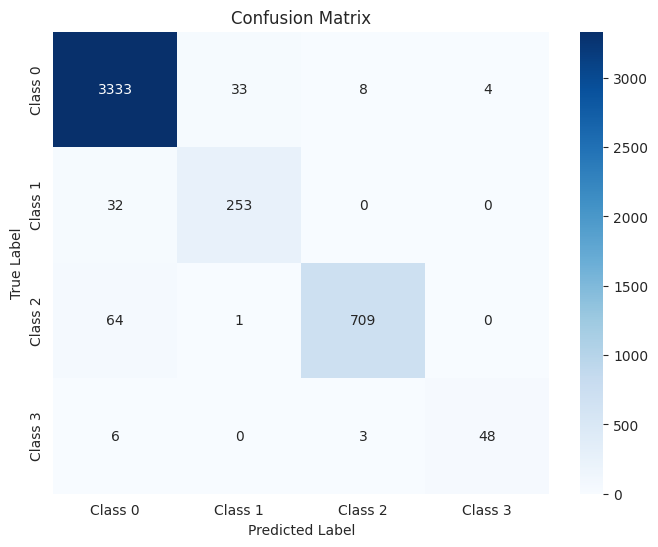

The function took 0.3944 seconds to execute.


In [72]:
test_accuracy = testing_model(relu13f_nn,test_loader,device)

In [73]:
import numpy as np

def analyze_class_distribution(y_train, y_test, y_val):
    """
    Analyze class distribution across train, test, and validation sets

    Args:
        y_train (np.ndarray): Training labels
        y_test (np.ndarray): Test labels
        y_val (np.ndarray): Validation labels
    """
    # Function to calculate class distribution
    def get_class_distribution(labels):
        unique, counts = np.unique(labels, return_counts=True)
        total = len(labels)
        percentages = (counts / total) * 100
        return dict(zip(unique, percentages))

    # Print distributions
    print("Train Set Class Distribution:")
    train_dist = get_class_distribution(y_train)
    for cls, percentage in train_dist.items():
        print(f"Class {cls}: {percentage:.2f}%")

    print("\nTest Set Class Distribution:")
    test_dist = get_class_distribution(y_test)
    for cls, percentage in test_dist.items():
        print(f"Class {cls}: {percentage:.2f}%")

    print("\nValidation Set Class Distribution:")
    val_dist = get_class_distribution(y_val)
    for cls, percentage in val_dist.items():
        print(f"Class {cls}: {percentage:.2f}%")

    return train_dist, test_dist, val_dist





distributions = analyze_class_distribution(y_train, y_test, y_val)
print(distributions)

Train Set Class Distribution:
Class 0: 75.17%
Class 1: 6.36%
Class 2: 17.21%
Class 3: 1.27%

Test Set Class Distribution:
Class 0: 75.17%
Class 1: 6.34%
Class 2: 17.22%
Class 3: 1.27%

Validation Set Class Distribution:
Class 0: 75.16%
Class 1: 6.34%
Class 2: 17.22%
Class 3: 1.28%
({np.int64(0): np.float64(75.16517143055846), np.int64(1): np.float64(6.356492106544266), np.int64(2): np.float64(17.21260171082829), np.int64(3): np.float64(1.2657347520689894)}, {np.int64(0): np.float64(75.16688918558077), np.int64(1): np.float64(6.341789052069426), np.int64(2): np.float64(17.222963951935917), np.int64(3): np.float64(1.268357810413885)}, {np.int64(0): np.float64(75.15994436717664), np.int64(1): np.float64(6.342141863699583), np.int64(2): np.float64(17.21835883171071), np.int64(3): np.float64(1.2795549374130737)})


### class-weight

In [11]:
from sklearn.utils.class_weight import compute_class_weight

# Calculate class weights
class_weights = compute_class_weight(class_weight='balanced', classes=np.unique(y_train), y=y_train)

class_weights = torch.tensor(class_weights, dtype=torch.float).to(device)


In [74]:



relu13f_nn_cw = SimpleNN_ReLU(input_size=13,hidden_size=64)
optimizer = optim.AdamW(relu13f_nn_cw.parameters(), lr=0.0005)
# Update criterion with weights
criterion = nn.CrossEntropyLoss(weight = class_weights)
print(relu13f_nn_cw)
print(criterion)
print(optimizer)
print(class_weights)

SimpleNN_ReLU(
  (fc1): Linear(in_features=13, out_features=64, bias=True)
  (fc2): Linear(in_features=64, out_features=4, bias=True)
  (relu): ReLU()
)
CrossEntropyLoss()
AdamW (
Parameter Group 0
    amsgrad: False
    betas: (0.9, 0.999)
    capturable: False
    differentiable: False
    eps: 1e-08
    foreach: None
    fused: None
    lr: 0.0005
    maximize: False
    weight_decay: 0.01
)
tensor([ 0.3326,  3.9330,  1.4524, 19.7514], device='cuda:0')


Epoch 20/100, Train Loss: 0.1740, Val Loss: 0.1634
Early stopping triggered at epoch number 29 
The function took 17.6911 seconds to execute.


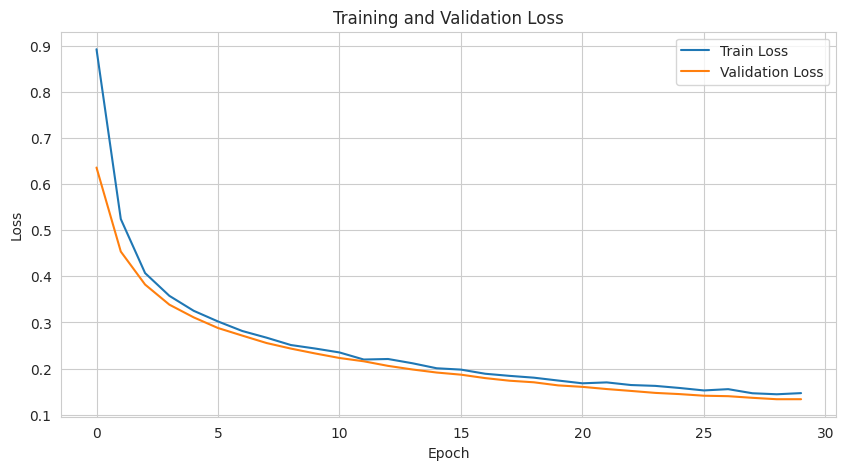

In [75]:
training_loop(relu13f_nn_cw, train_loader, val_loader, train_dataset, val_dataset, device, optimizer, criterion)


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.92      0.95      3378
     Class 1       0.73      0.99      0.84       285
     Class 2       0.90      0.95      0.93       774
     Class 3       0.35      0.96      0.51        57

    accuracy                           0.93      4494
   macro avg       0.74      0.96      0.81      4494
weighted avg       0.95      0.93      0.94      4494



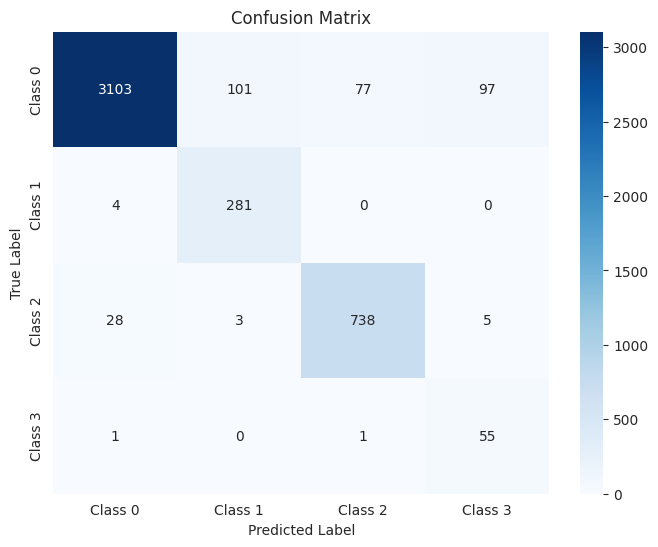

The function took 0.2575 seconds to execute.


In [76]:
test =testing_model(relu13f_nn_cw,test_loader,device)

# Task 4: Deep NN

In [12]:
# ----------------  reproducibility & helpers ----------------
import time, copy, itertools, torch, numpy as np
import torch.nn as nn, torch.optim as optim
from sklearn.metrics import accuracy_score, f1_score

DEVICE = torch.device("cuda" if torch.cuda.is_available() else "cpu")
torch.manual_seed(42);  np.random.seed(42)


In [13]:
# ---------------- cell A : training_loop + live-plot --------------------------
import time, copy, matplotlib.pyplot as plt

def training_loop(model, train_loader, val_loader,
                  train_ds,   val_ds, device,
                  optimizer, criterion,
                  max_epochs=100, patience=15,
                  verbose_every=20, cfg_name="run"):
    """
      Train a PyTorch model with early-stopping and live loss plotting.

      Args:
          model (torch.nn.Module): Network to train.
          train_loader (DataLoader): Mini-batches for training.
          val_loader (DataLoader): Mini-batches for validation.
          train_ds (Dataset): Full training set (for loss normalisation).
          val_ds (Dataset): Full validation set.
          device (torch.device): CPU or GPU on which to run.
          optimizer (torch.optim.Optimizer): Parameter update rule.
          criterion (Callable): Loss function.
          max_epochs (int, optional):  Default = 100.
          patience (int, optional): Default = 30.
          verbose_every (int, optional): Print progress every N epochs; Default = 20.
          cfg_name (str, optional): Label shown in logs and plot title. Default = "run".

      Returns:
          Tuple[Dict[str, List[float]], torch.nn.Module]:
              • History of training and validation losses.
              • Model restored to the weights that achieved the best validation loss.

    """
    model = model.to(device)
    best_w      = copy.deepcopy(model.state_dict())
    best_loss   = float('inf')
    wait        = 0
    hist_tr, hist_val = [], []
    t0 = time.time()

    for epoch in range(max_epochs):
        # ---------- TRAIN ----------
        model.train()
        running = 0.0
        for xb, yb in train_loader:
            xb, yb = xb.to(device), yb.to(device)
            optimizer.zero_grad()
            loss = criterion(model(xb), yb)
            loss.backward(); optimizer.step()
            running += loss.item() * xb.size(0)
        tr_loss = running / len(train_ds)
        hist_tr.append(tr_loss)

        # ---------- VALID ----------
        model.eval(); running = 0.0
        with torch.no_grad():
            for xb, yb in val_loader:
                xb, yb = xb.to(device), yb.to(device)
                running += criterion(model(xb), yb).item() * xb.size(0)
        val_loss = running / len(val_ds)
        hist_val.append(val_loss)

        # ---------- EARLY-STOP ----------
        if val_loss < best_loss:
            best_loss = val_loss
            best_w    = copy.deepcopy(model.state_dict())
            wait      = 0
        else:
            wait += 1
            if wait >= patience:
                print(f"[{cfg_name}] early-stop @ epoch {epoch:03d}")
                break

        if verbose_every and (epoch+1) % verbose_every == 0:
            print(f"[{cfg_name}] ep {epoch+1:03d}  tr={tr_loss:.4f}  val={val_loss:.4f}")

    # restore best weights
    model.load_state_dict(best_w)
    print(f"[{cfg_name}] done in {time.time()-t0:.1f}s  best-val={best_loss:.4f}")

    # ---------- PLOT ----------
    plt.figure(figsize=(6,3))
    plt.plot(hist_tr, label='train')
    plt.plot(hist_val,label='val')
    plt.xlabel('epoch'); plt.ylabel('loss'); plt.title(cfg_name); plt.legend()
    plt.tight_layout(); plt.show()

    return {'train': hist_tr, 'val': hist_val}, model


### Builder

In [14]:
# ---------------- PlainFFNN builder ------------------------
class PlainFFNN(nn.Module):

    """
    Simple feed-forward neural network.

    Args:
        layer_sizes (List[int]): Number of units in each layer, e.g. [13, 32, 8, 4].

    Architecture:
        • Fully connected layers defined by `layer_sizes`
        • ReLU applied to every hidden layer
        • Last layer left linear, returning raw logits

    """
    def __init__(self, layer_sizes):
        super().__init__()
        self.fcs = nn.ModuleList(
            [nn.Linear(i, o) for i, o in zip(layer_sizes[:-1], layer_sizes[1:])]
        )
        self.act = nn.ReLU()

    def forward(self, x):
        for lyr in self.fcs[:-1]:
            x = self.act(lyr(x))
        return self.fcs[-1](x)                # logits


[ARCH#001-[32, 32]] done in 27.4s  best-val=0.0781


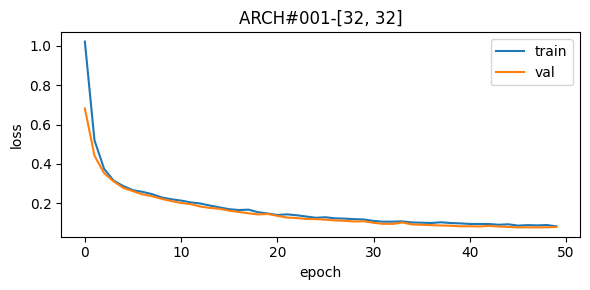


Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.94      0.97     10808
     Class 1       0.79      1.00      0.88       914
     Class 2       0.88      0.99      0.93      2475
     Class 3       0.60      0.99      0.75       182

    accuracy                           0.95     14379
   macro avg       0.82      0.98      0.88     14379
weighted avg       0.96      0.95      0.95     14379



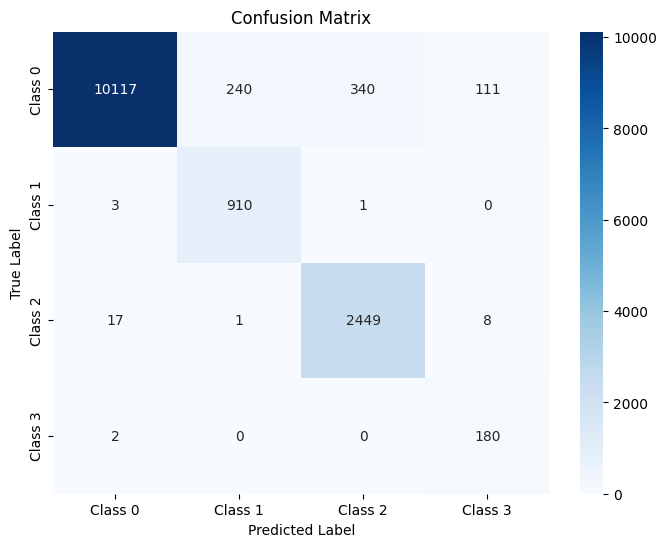

The function took 0.4439 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.94      0.97      2702
     Class 1       0.78      0.99      0.87       228
     Class 2       0.88      0.99      0.93       619
     Class 3       0.64      1.00      0.78        46

    accuracy                           0.95      3595
   macro avg       0.83      0.98      0.89      3595
weighted avg       0.96      0.95      0.95      3595



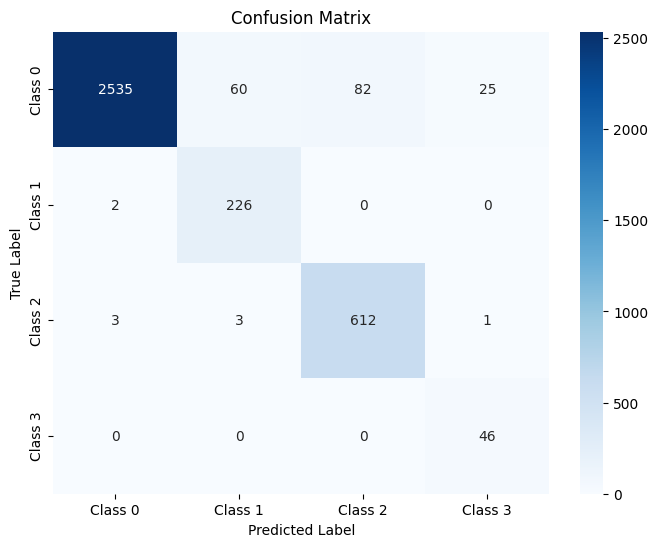

The function took 0.3304 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.94      0.97      3378
     Class 1       0.80      0.99      0.88       285
     Class 2       0.89      0.99      0.93       774
     Class 3       0.59      0.96      0.73        57

    accuracy                           0.95      4494
   macro avg       0.82      0.97      0.88      4494
weighted avg       0.96      0.95      0.95      4494



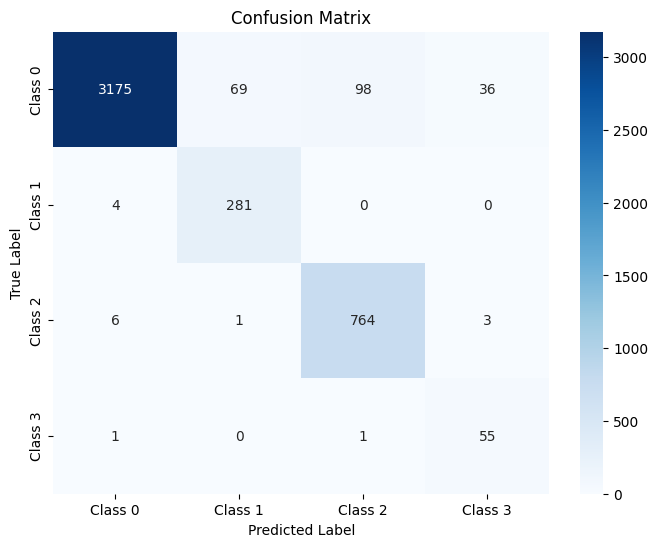

The function took 0.2372 seconds to execute.
[ARCH#002-[32, 16]] done in 27.0s  best-val=0.0740


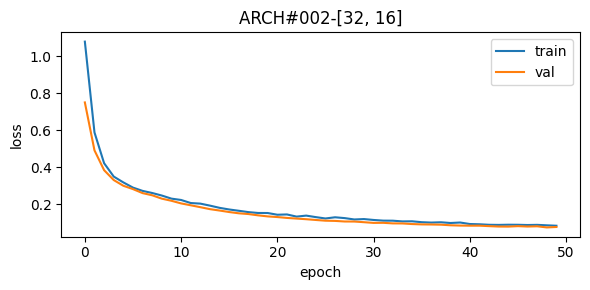


Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.94      0.97     10808
     Class 1       0.77      1.00      0.87       914
     Class 2       0.90      0.98      0.94      2475
     Class 3       0.63      0.99      0.77       182

    accuracy                           0.95     14379
   macro avg       0.82      0.98      0.89     14379
weighted avg       0.96      0.95      0.95     14379



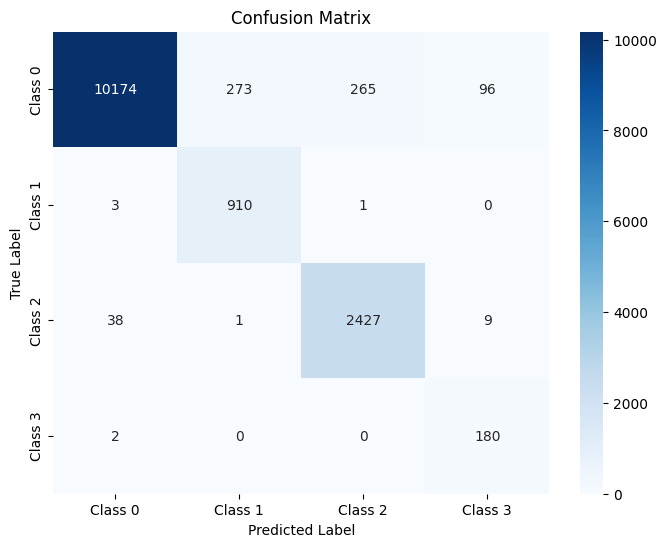

The function took 0.4320 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.94      0.97      2702
     Class 1       0.77      1.00      0.87       228
     Class 2       0.90      0.98      0.94       619
     Class 3       0.66      1.00      0.79        46

    accuracy                           0.95      3595
   macro avg       0.83      0.98      0.89      3595
weighted avg       0.96      0.95      0.96      3595



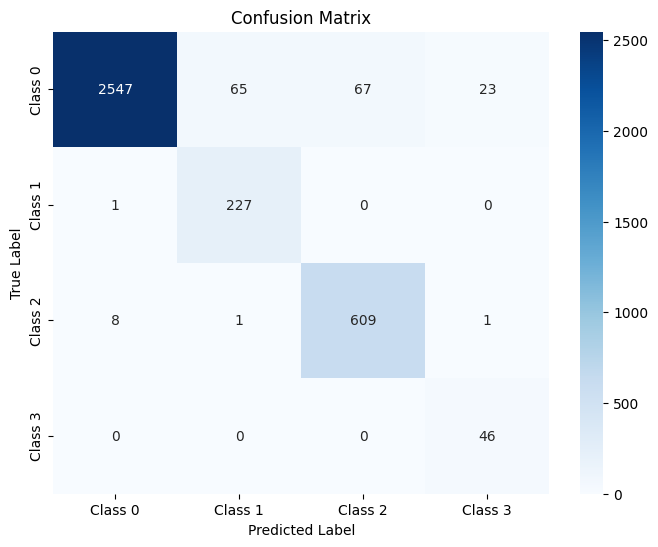

The function took 0.3154 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.94      0.97      3378
     Class 1       0.77      0.99      0.86       285
     Class 2       0.91      0.98      0.94       774
     Class 3       0.62      0.96      0.75        57

    accuracy                           0.95      4494
   macro avg       0.82      0.97      0.88      4494
weighted avg       0.96      0.95      0.95      4494



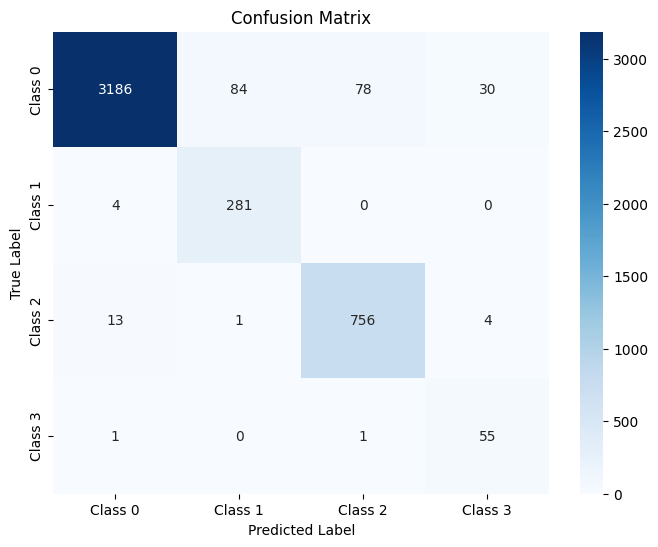

The function took 0.2858 seconds to execute.
[ARCH#003-[32, 8]] done in 27.4s  best-val=0.0907


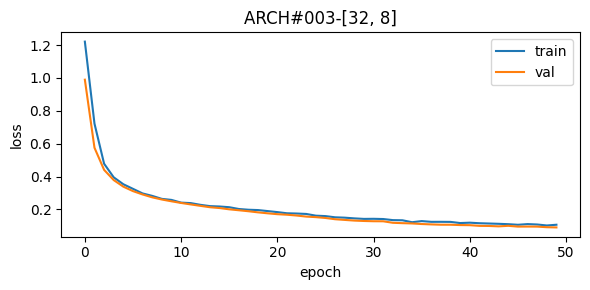


Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.94      0.97     10808
     Class 1       0.79      1.00      0.88       914
     Class 2       0.91      0.99      0.95      2475
     Class 3       0.53      0.99      0.69       182

    accuracy                           0.95     14379
   macro avg       0.81      0.98      0.87     14379
weighted avg       0.96      0.95      0.96     14379



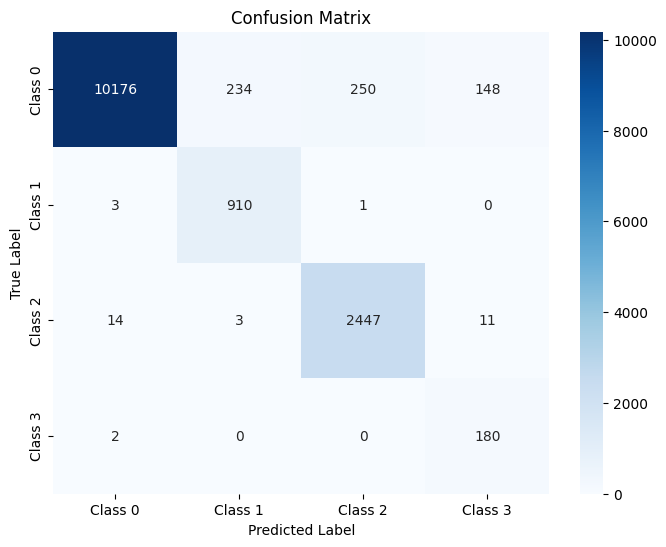

The function took 0.4265 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.94      0.97      2702
     Class 1       0.78      0.99      0.88       228
     Class 2       0.91      0.99      0.94       619
     Class 3       0.59      1.00      0.74        46

    accuracy                           0.95      3595
   macro avg       0.82      0.98      0.88      3595
weighted avg       0.96      0.95      0.96      3595



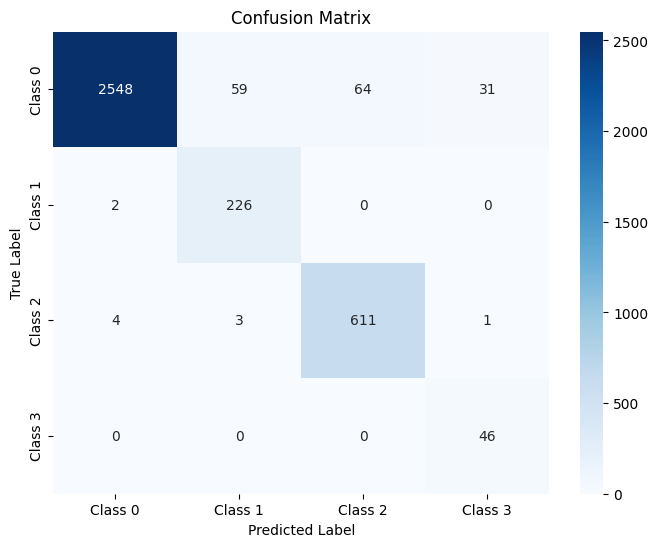

The function took 0.3257 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.95      0.97      3378
     Class 1       0.80      0.99      0.89       285
     Class 2       0.92      0.98      0.95       774
     Class 3       0.50      0.96      0.65        57

    accuracy                           0.95      4494
   macro avg       0.80      0.97      0.86      4494
weighted avg       0.96      0.95      0.96      4494



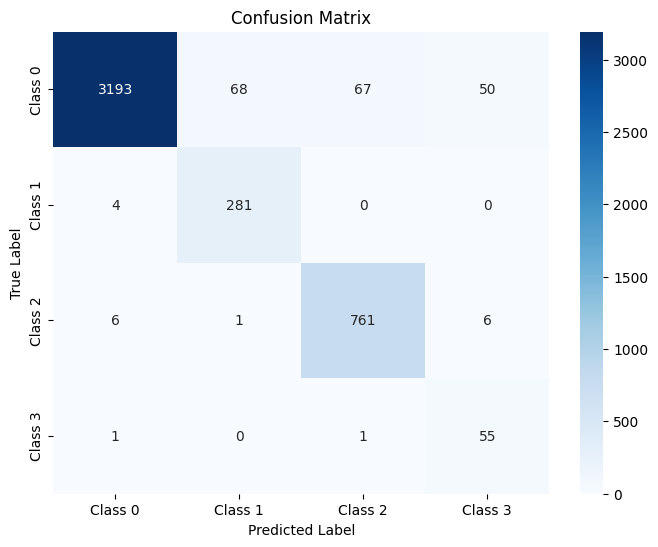

The function took 0.2507 seconds to execute.
[ARCH#004-[32, 4]] done in 26.8s  best-val=0.1605


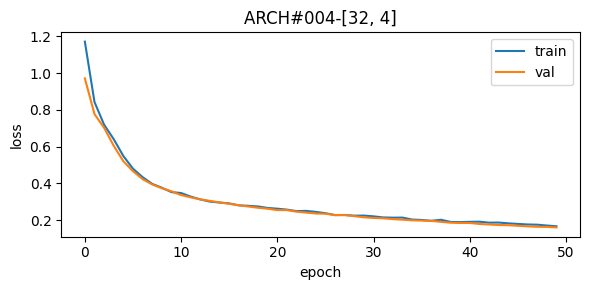


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.94      0.96     10808
     Class 1       0.80      0.89      0.84       914
     Class 2       0.87      0.96      0.91      2475
     Class 3       0.63      0.98      0.77       182

    accuracy                           0.94     14379
   macro avg       0.82      0.94      0.87     14379
weighted avg       0.95      0.94      0.94     14379



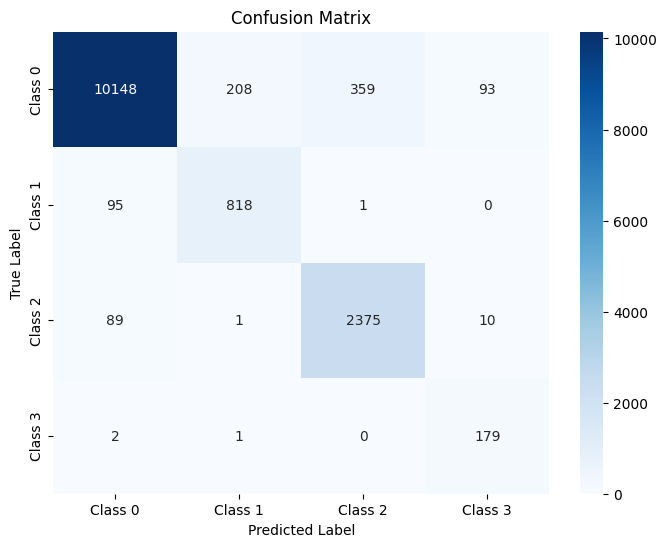

The function took 0.4241 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.94      0.96      2702
     Class 1       0.78      0.87      0.82       228
     Class 2       0.86      0.96      0.91       619
     Class 3       0.64      1.00      0.78        46

    accuracy                           0.94      3595
   macro avg       0.82      0.94      0.87      3595
weighted avg       0.94      0.94      0.94      3595



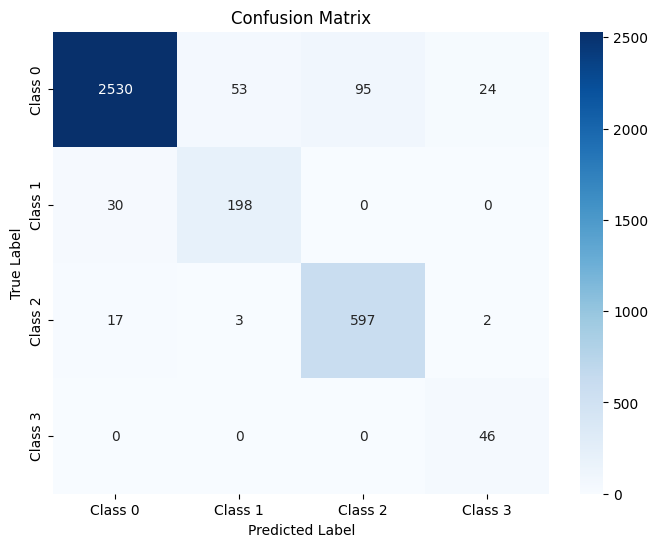

The function took 0.2472 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.95      0.96      3378
     Class 1       0.81      0.89      0.85       285
     Class 2       0.88      0.95      0.91       774
     Class 3       0.64      0.95      0.76        57

    accuracy                           0.94      4494
   macro avg       0.83      0.93      0.87      4494
weighted avg       0.95      0.94      0.94      4494



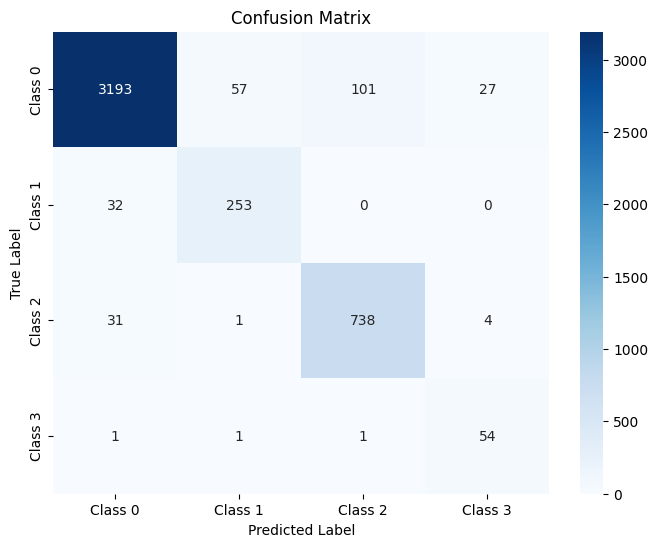

The function took 0.2477 seconds to execute.
[ARCH#005-[32, 2]] done in 27.0s  best-val=0.1399


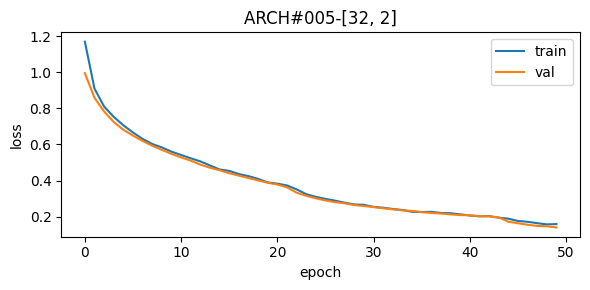


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.93      0.96     10808
     Class 1       0.78      1.00      0.88       914
     Class 2       0.89      0.95      0.92      2475
     Class 3       0.38      0.98      0.55       182

    accuracy                           0.94     14379
   macro avg       0.76      0.96      0.83     14379
weighted avg       0.95      0.94      0.94     14379



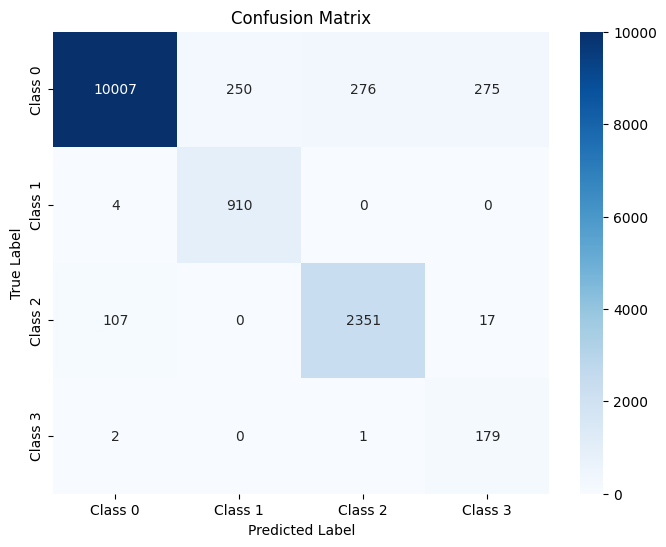

The function took 0.4365 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.93      0.96      2702
     Class 1       0.79      1.00      0.88       228
     Class 2       0.91      0.95      0.93       619
     Class 3       0.39      1.00      0.56        46

    accuracy                           0.94      3595
   macro avg       0.77      0.97      0.83      3595
weighted avg       0.96      0.94      0.95      3595



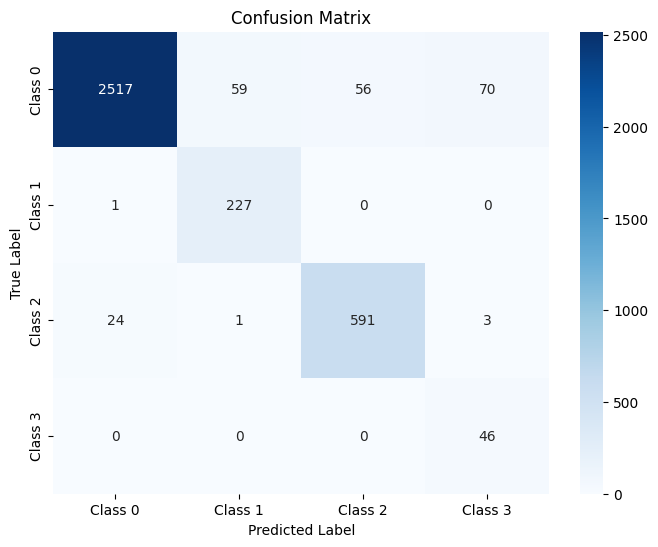

The function took 0.4085 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.93      0.96      3378
     Class 1       0.81      0.99      0.89       285
     Class 2       0.90      0.95      0.92       774
     Class 3       0.36      0.95      0.52        57

    accuracy                           0.94      4494
   macro avg       0.76      0.95      0.82      4494
weighted avg       0.95      0.94      0.94      4494



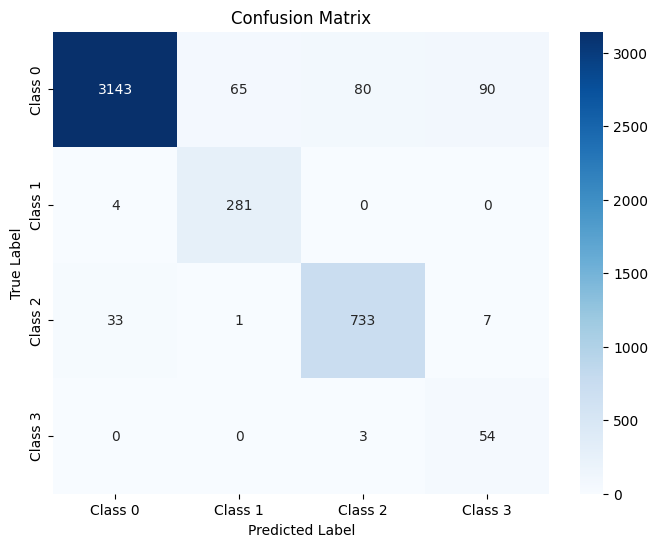

The function took 0.4333 seconds to execute.
[ARCH#006-[16, 16]] done in 27.3s  best-val=0.0999


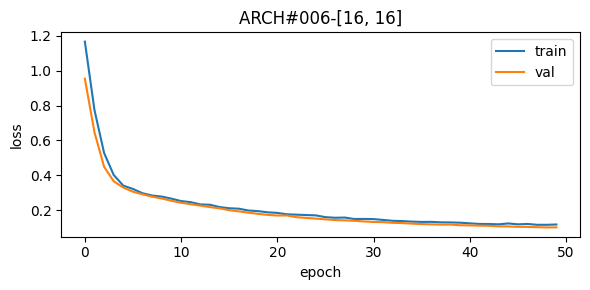


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.93      0.96     10808
     Class 1       0.75      1.00      0.86       914
     Class 2       0.87      0.97      0.92      2475
     Class 3       0.58      0.99      0.73       182

    accuracy                           0.94     14379
   macro avg       0.80      0.97      0.87     14379
weighted avg       0.95      0.94      0.94     14379



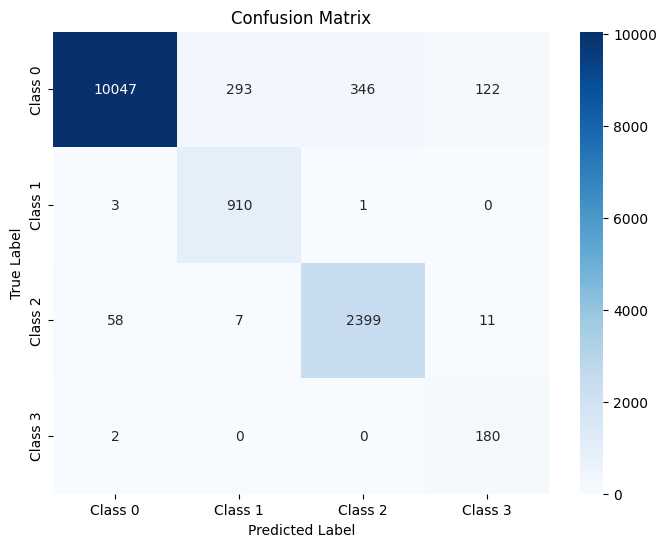

The function took 0.5165 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.93      0.96      2702
     Class 1       0.74      1.00      0.85       228
     Class 2       0.87      0.97      0.92       619
     Class 3       0.61      1.00      0.75        46

    accuracy                           0.94      3595
   macro avg       0.80      0.97      0.87      3595
weighted avg       0.95      0.94      0.94      3595



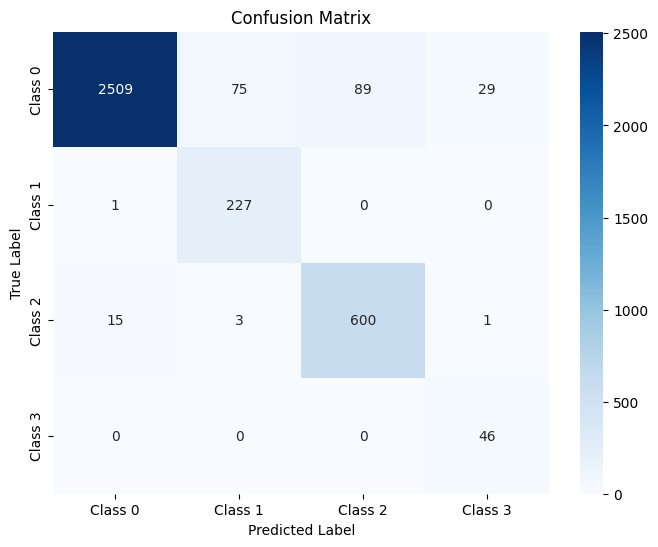

The function took 0.2466 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.93      0.96      3378
     Class 1       0.75      0.99      0.85       285
     Class 2       0.88      0.96      0.92       774
     Class 3       0.57      0.95      0.71        57

    accuracy                           0.94      4494
   macro avg       0.80      0.96      0.86      4494
weighted avg       0.95      0.94      0.94      4494



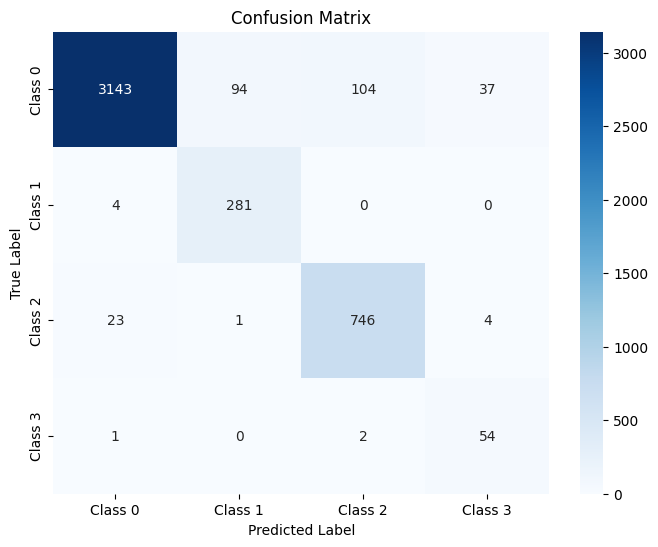

The function took 0.2638 seconds to execute.
[ARCH#007-[16, 8]] done in 26.9s  best-val=0.1584


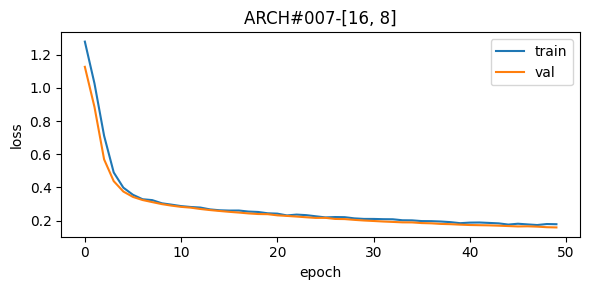


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.92      0.95     10808
     Class 1       0.71      1.00      0.83       914
     Class 2       0.88      0.94      0.91      2475
     Class 3       0.39      0.90      0.54       182

    accuracy                           0.93     14379
   macro avg       0.74      0.94      0.81     14379
weighted avg       0.95      0.93      0.93     14379



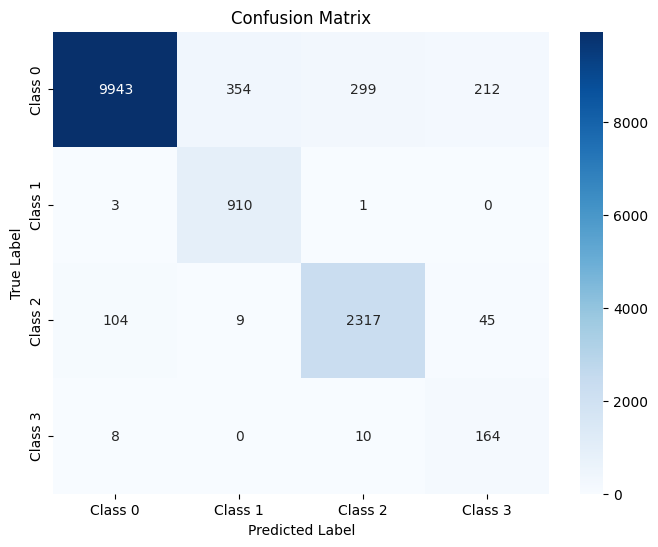

The function took 0.8114 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.92      0.95      2702
     Class 1       0.72      0.99      0.83       228
     Class 2       0.88      0.95      0.92       619
     Class 3       0.39      0.89      0.55        46

    accuracy                           0.93      3595
   macro avg       0.75      0.94      0.81      3595
weighted avg       0.95      0.93      0.93      3595



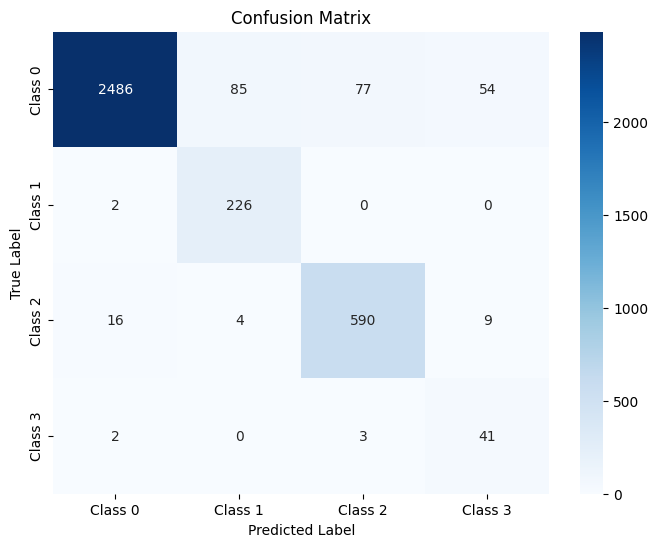

The function took 0.2427 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.92      0.95      3378
     Class 1       0.70      0.99      0.82       285
     Class 2       0.90      0.92      0.91       774
     Class 3       0.37      0.91      0.52        57

    accuracy                           0.93      4494
   macro avg       0.74      0.94      0.80      4494
weighted avg       0.94      0.93      0.93      4494



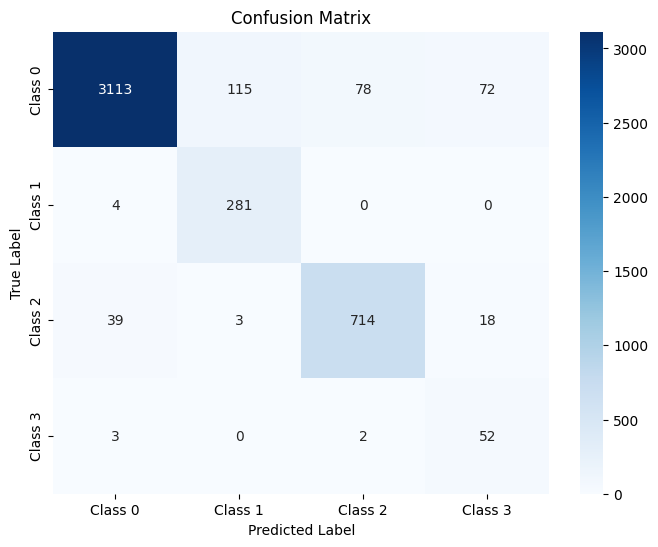

The function took 0.3478 seconds to execute.
[ARCH#008-[16, 4]] done in 27.3s  best-val=0.1910


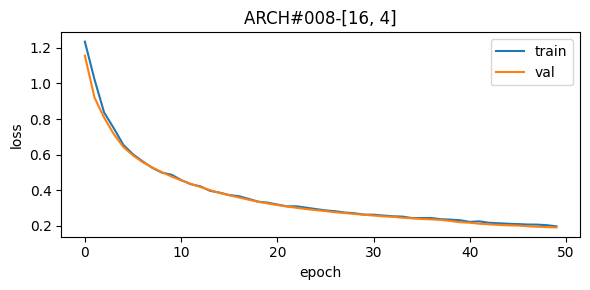


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.92      0.96     10808
     Class 1       0.86      0.96      0.90       914
     Class 2       0.88      0.97      0.92      2475
     Class 3       0.27      0.93      0.42       182

    accuracy                           0.93     14379
   macro avg       0.75      0.95      0.80     14379
weighted avg       0.96      0.93      0.94     14379



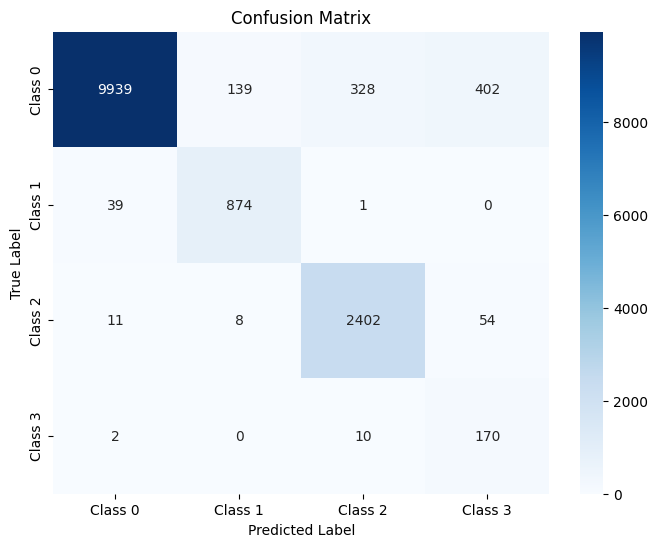

The function took 0.6144 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.92      0.95      2702
     Class 1       0.84      0.93      0.88       228
     Class 2       0.88      0.98      0.92       619
     Class 3       0.29      0.93      0.44        46

    accuracy                           0.93      3595
   macro avg       0.75      0.94      0.80      3595
weighted avg       0.95      0.93      0.94      3595



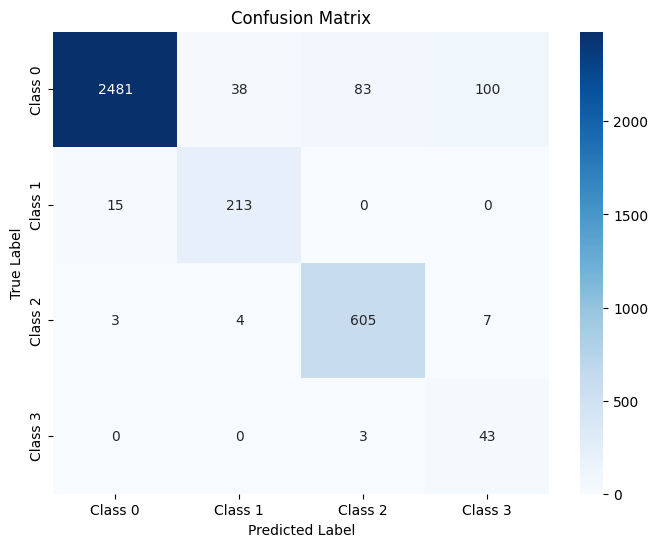

The function took 0.5115 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.92      0.96      3378
     Class 1       0.84      0.94      0.89       285
     Class 2       0.88      0.97      0.92       774
     Class 3       0.28      0.95      0.44        57

    accuracy                           0.93      4494
   macro avg       0.75      0.94      0.80      4494
weighted avg       0.96      0.93      0.94      4494



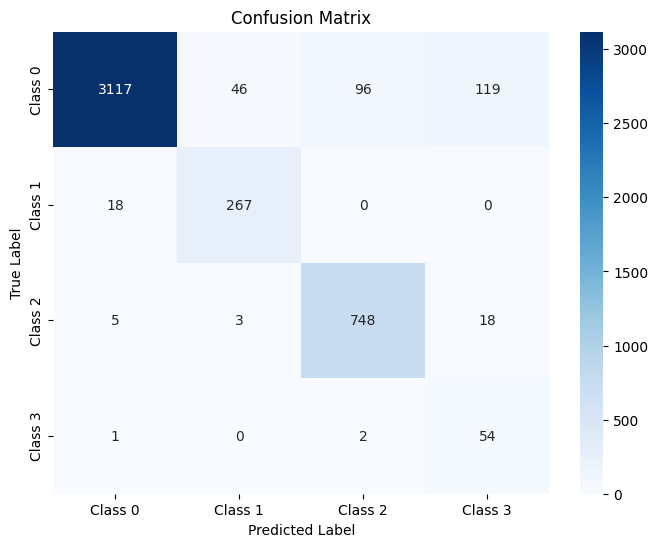

The function took 0.2992 seconds to execute.
[ARCH#009-[16, 2]] done in 26.9s  best-val=0.6955


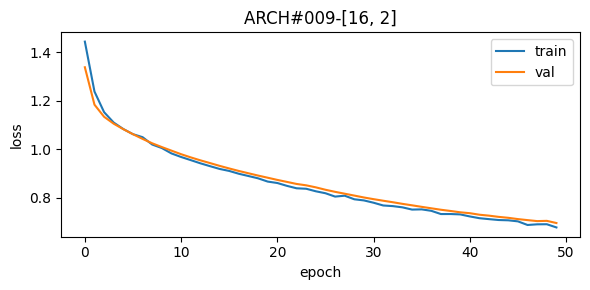


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.96      0.71      0.82     10808
     Class 1       0.72      0.91      0.80       914
     Class 2       0.56      0.89      0.69      2475
     Class 3       0.13      0.93      0.23       182

    accuracy                           0.76     14379
   macro avg       0.59      0.86      0.63     14379
weighted avg       0.87      0.76      0.79     14379



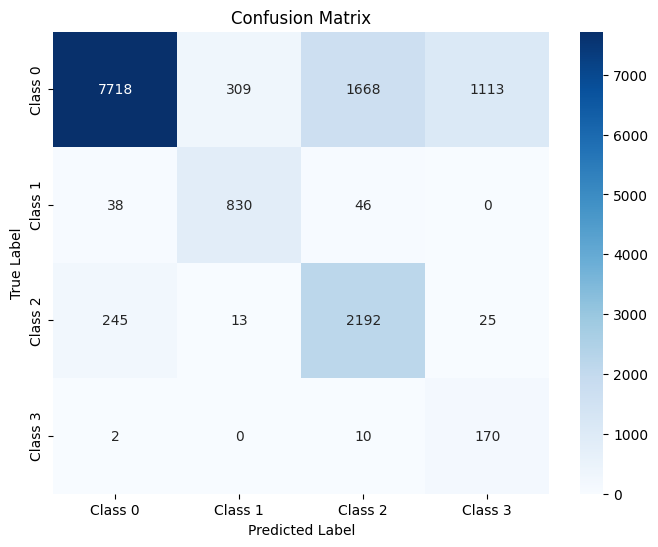

The function took 0.5443 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.97      0.72      0.83      2702
     Class 1       0.72      0.88      0.79       228
     Class 2       0.57      0.90      0.70       619
     Class 3       0.13      0.93      0.23        46

    accuracy                           0.76      3595
   macro avg       0.60      0.86      0.64      3595
weighted avg       0.87      0.76      0.79      3595



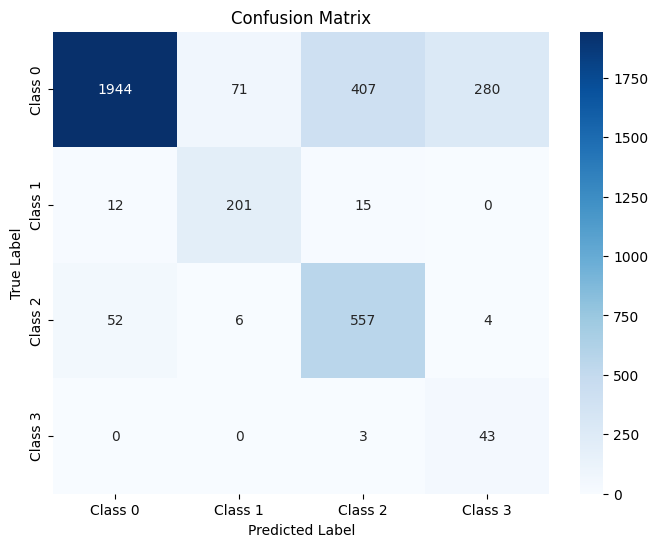

The function took 0.2410 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.96      0.71      0.82      3378
     Class 1       0.71      0.88      0.79       285
     Class 2       0.56      0.86      0.68       774
     Class 3       0.13      0.95      0.22        57

    accuracy                           0.75      4494
   macro avg       0.59      0.85      0.63      4494
weighted avg       0.86      0.75      0.79      4494



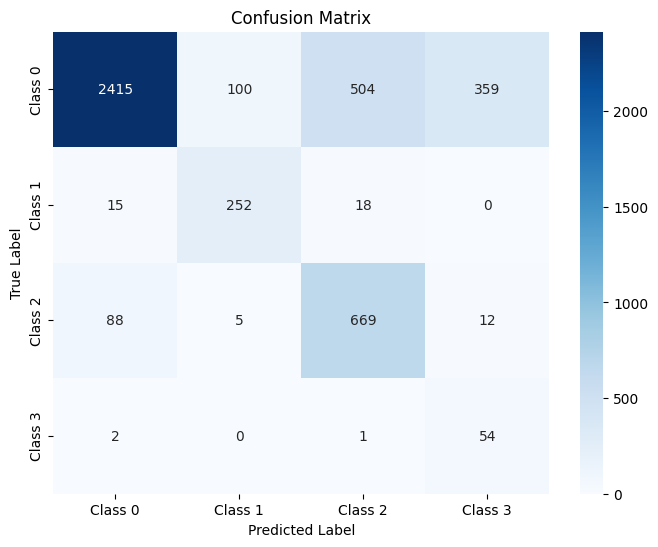

The function took 0.2476 seconds to execute.
[ARCH#010-[8, 8]] done in 27.3s  best-val=0.1643


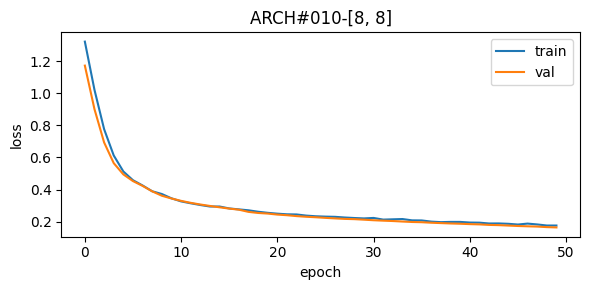


Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.89      0.94     10808
     Class 1       0.63      0.99      0.77       914
     Class 2       0.86      0.97      0.91      2475
     Class 3       0.36      0.93      0.52       182

    accuracy                           0.91     14379
   macro avg       0.71      0.95      0.78     14379
weighted avg       0.94      0.91      0.92     14379



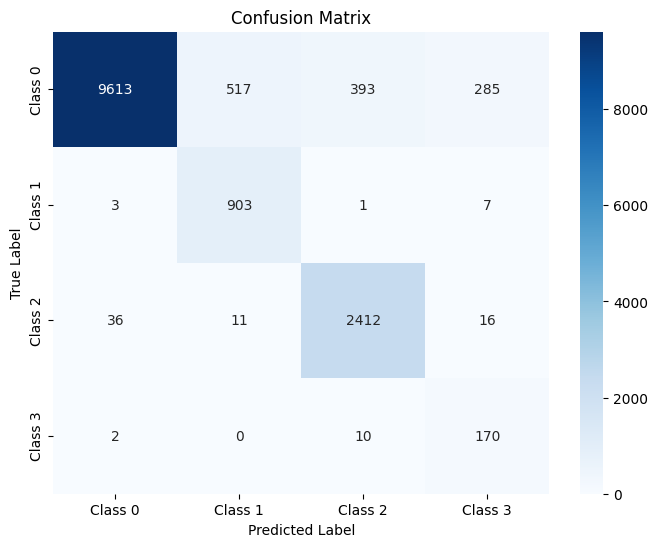

The function took 0.4326 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.88      0.94      2702
     Class 1       0.62      0.98      0.76       228
     Class 2       0.84      0.98      0.91       619
     Class 3       0.36      0.93      0.51        46

    accuracy                           0.91      3595
   macro avg       0.70      0.94      0.78      3595
weighted avg       0.94      0.91      0.91      3595



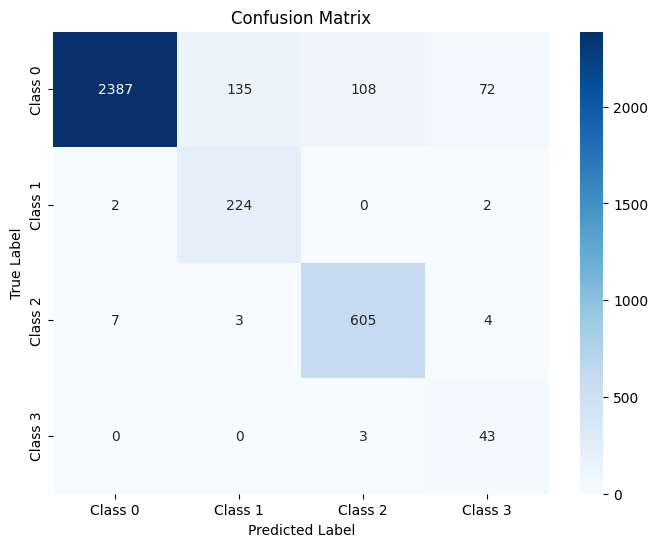

The function took 0.2499 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.89      0.94      3378
     Class 1       0.62      0.99      0.76       285
     Class 2       0.86      0.98      0.91       774
     Class 3       0.36      0.95      0.52        57

    accuracy                           0.91      4494
   macro avg       0.71      0.95      0.78      4494
weighted avg       0.94      0.91      0.92      4494



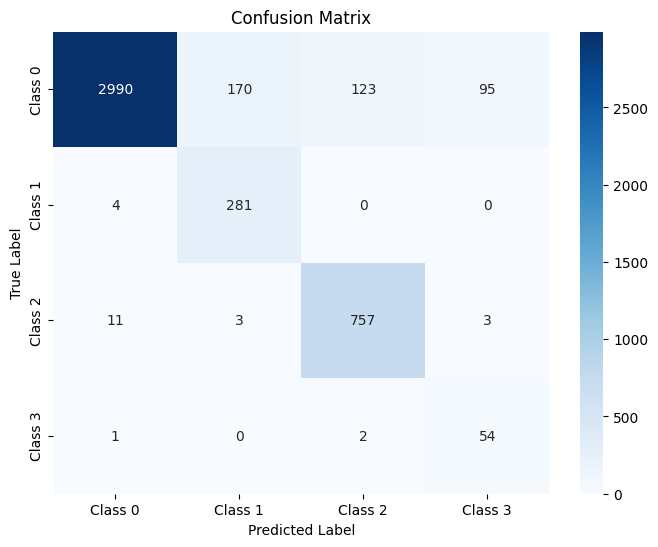

The function took 0.3058 seconds to execute.
[ARCH#011-[8, 4]] done in 27.7s  best-val=0.2084


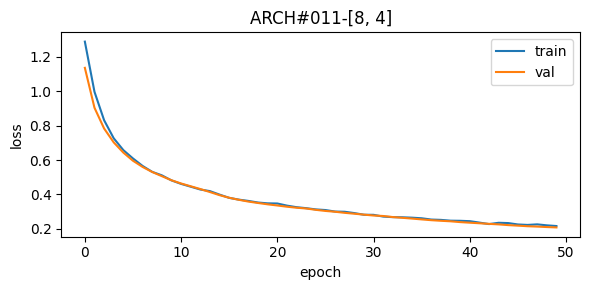


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.90      0.94     10808
     Class 1       0.69      0.94      0.80       914
     Class 2       0.89      0.93      0.91      2475
     Class 3       0.28      0.93      0.43       182

    accuracy                           0.91     14379
   macro avg       0.71      0.93      0.77     14379
weighted avg       0.94      0.91      0.92     14379



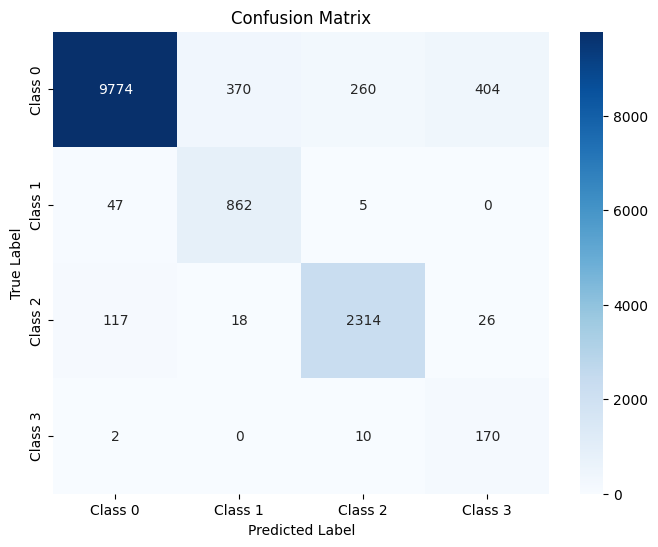

The function took 0.5367 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.90      0.94      2702
     Class 1       0.68      0.93      0.79       228
     Class 2       0.90      0.95      0.92       619
     Class 3       0.27      0.91      0.42        46

    accuracy                           0.91      3595
   macro avg       0.71      0.92      0.77      3595
weighted avg       0.94      0.91      0.92      3595



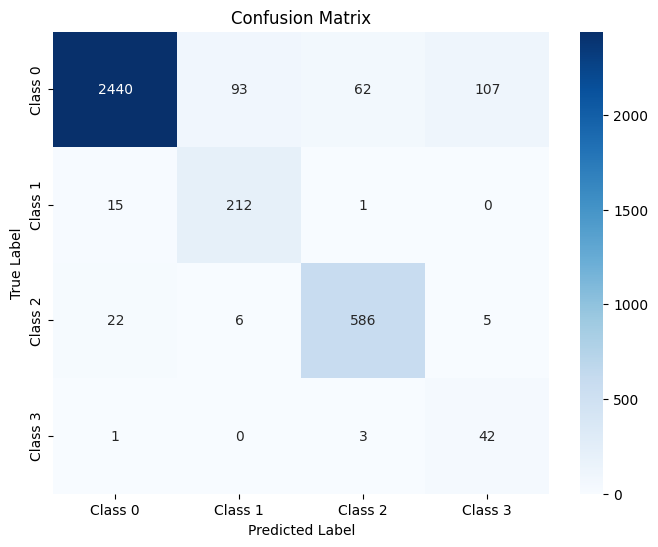

The function took 0.2705 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.91      0.94      3378
     Class 1       0.68      0.94      0.79       285
     Class 2       0.91      0.92      0.91       774
     Class 3       0.29      0.95      0.44        57

    accuracy                           0.91      4494
   macro avg       0.72      0.93      0.77      4494
weighted avg       0.94      0.91      0.92      4494



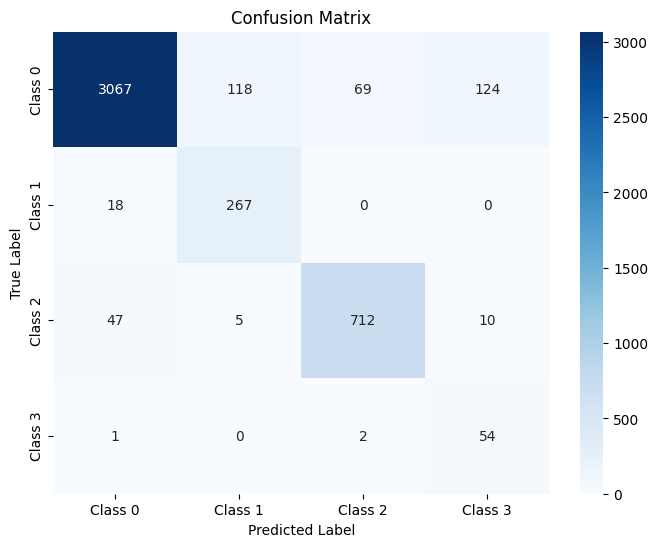

The function took 0.2638 seconds to execute.
[ARCH#012-[8, 2]] done in 27.3s  best-val=0.2285


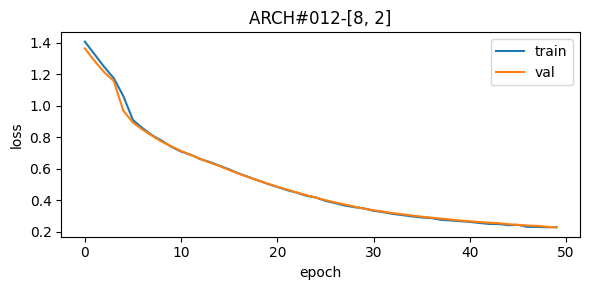


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.89      0.93     10808
     Class 1       0.63      0.96      0.76       914
     Class 2       0.86      0.95      0.91      2475
     Class 3       0.34      0.93      0.50       182

    accuracy                           0.90     14379
   macro avg       0.70      0.93      0.77     14379
weighted avg       0.93      0.90      0.91     14379



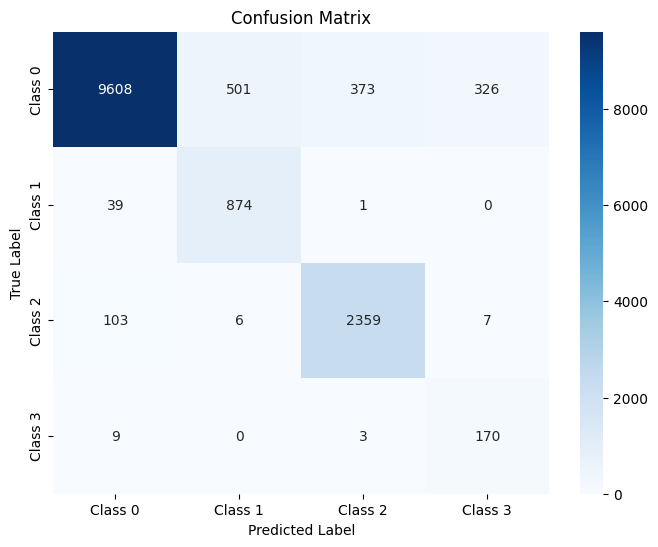

The function took 0.4567 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.89      0.94      2702
     Class 1       0.65      0.94      0.77       228
     Class 2       0.86      0.95      0.91       619
     Class 3       0.32      0.93      0.48        46

    accuracy                           0.91      3595
   macro avg       0.70      0.93      0.77      3595
weighted avg       0.93      0.91      0.91      3595



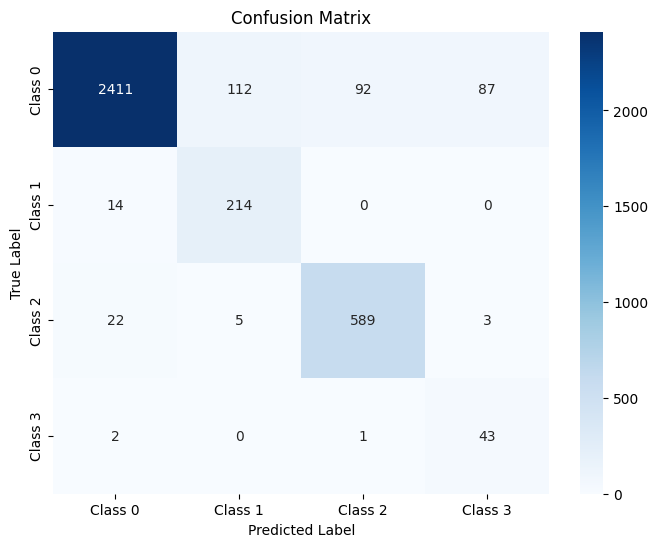

The function took 0.3160 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.89      0.93      3378
     Class 1       0.63      0.94      0.75       285
     Class 2       0.86      0.94      0.90       774
     Class 3       0.34      0.93      0.50        57

    accuracy                           0.90      4494
   macro avg       0.70      0.92      0.77      4494
weighted avg       0.93      0.90      0.91      4494



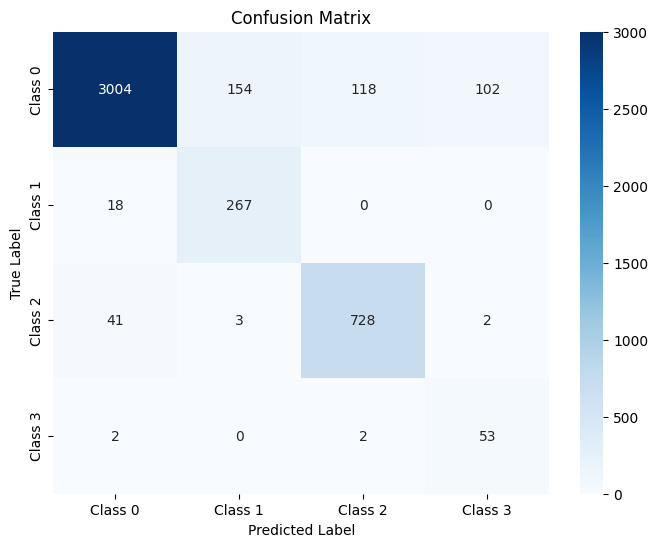

The function took 0.3388 seconds to execute.
[ARCH#013-[4, 4]] done in 27.2s  best-val=1.3794


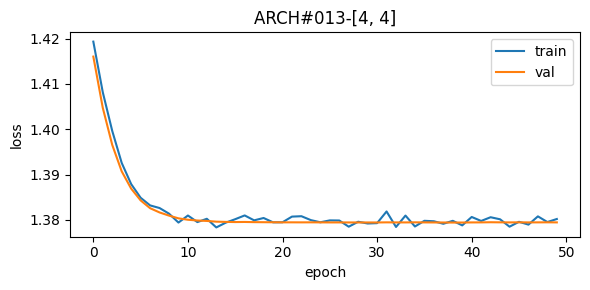


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86     10808
     Class 1       0.00      0.00      0.00       914
     Class 2       0.00      0.00      0.00      2475
     Class 3       0.00      0.00      0.00       182

    accuracy                           0.75     14379
   macro avg       0.19      0.25      0.21     14379
weighted avg       0.56      0.75      0.65     14379



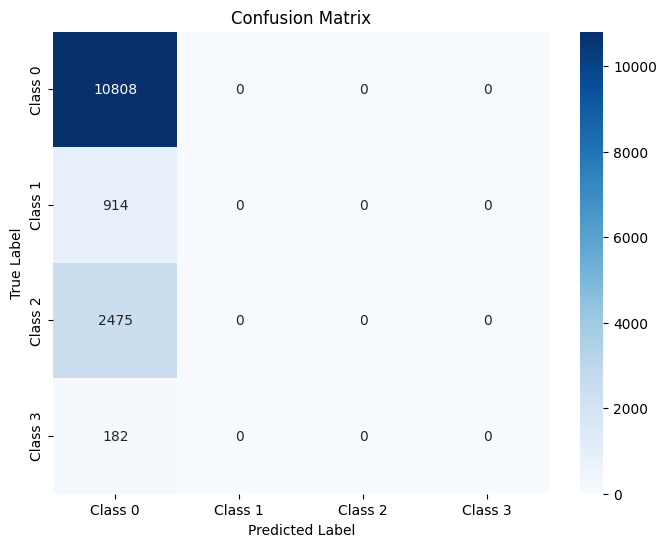

The function took 0.5560 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86      2702
     Class 1       0.00      0.00      0.00       228
     Class 2       0.00      0.00      0.00       619
     Class 3       0.00      0.00      0.00        46

    accuracy                           0.75      3595
   macro avg       0.19      0.25      0.21      3595
weighted avg       0.56      0.75      0.65      3595



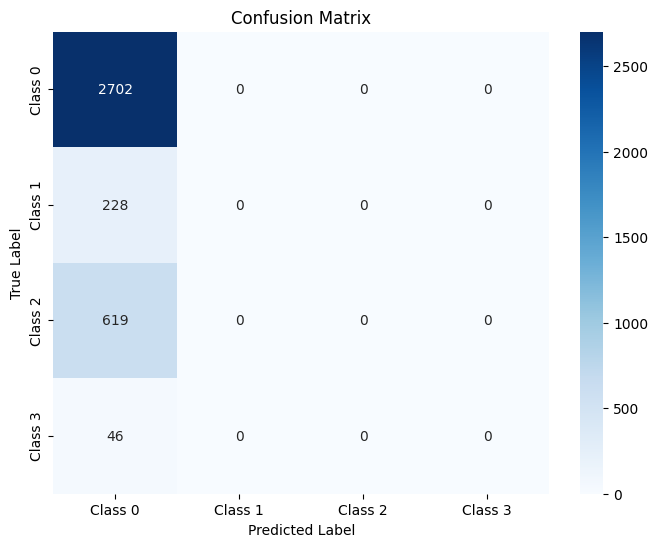

The function took 0.2420 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86      3378
     Class 1       0.00      0.00      0.00       285
     Class 2       0.00      0.00      0.00       774
     Class 3       0.00      0.00      0.00        57

    accuracy                           0.75      4494
   macro avg       0.19      0.25      0.21      4494
weighted avg       0.56      0.75      0.64      4494



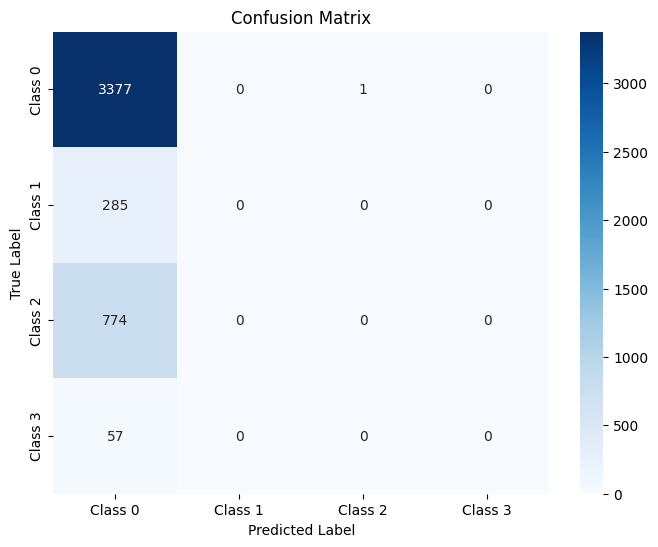

The function took 0.3739 seconds to execute.
[ARCH#014-[4, 2]] done in 27.7s  best-val=0.3931


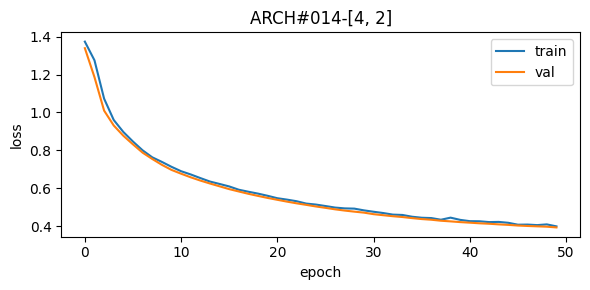


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.96      0.83      0.89     10808
     Class 1       0.49      0.96      0.65       914
     Class 2       0.85      0.86      0.86      2475
     Class 3       0.22      0.90      0.35       182

    accuracy                           0.85     14379
   macro avg       0.63      0.89      0.69     14379
weighted avg       0.90      0.85      0.86     14379



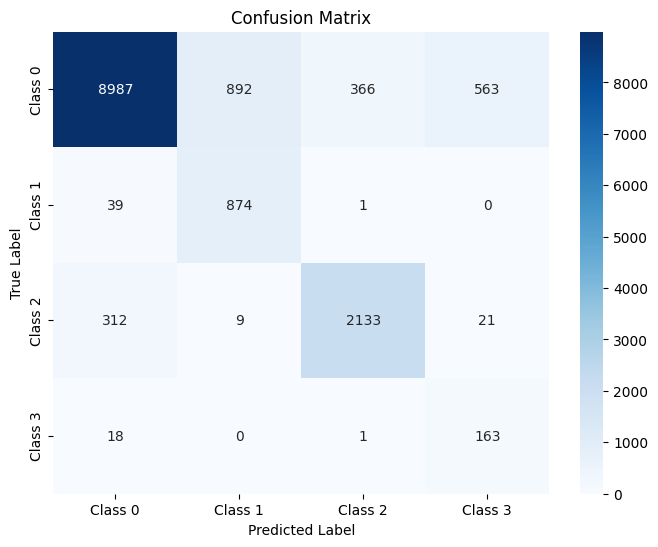

The function took 0.4584 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.96      0.83      0.89      2702
     Class 1       0.50      0.94      0.65       228
     Class 2       0.86      0.88      0.87       619
     Class 3       0.21      0.89      0.34        46

    accuracy                           0.85      3595
   macro avg       0.63      0.89      0.69      3595
weighted avg       0.91      0.85      0.87      3595



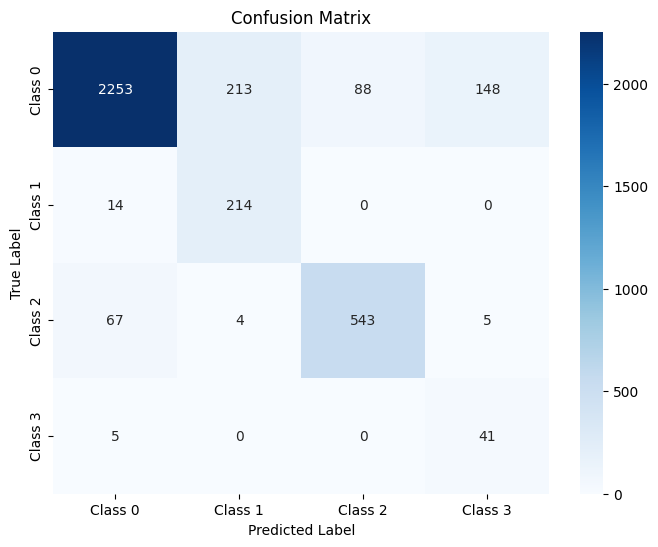

The function took 0.2591 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.95      0.83      0.89      3378
     Class 1       0.48      0.94      0.64       285
     Class 2       0.85      0.84      0.84       774
     Class 3       0.22      0.89      0.36        57

    accuracy                           0.84      4494
   macro avg       0.63      0.88      0.68      4494
weighted avg       0.90      0.84      0.86      4494



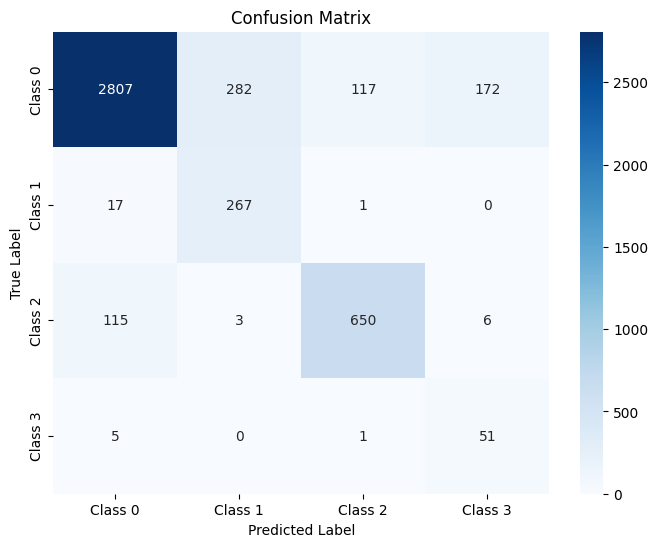

The function took 0.3921 seconds to execute.
[ARCH#015-[2, 2]] early-stop @ epoch 039
[ARCH#015-[2, 2]] done in 22.2s  best-val=1.3794


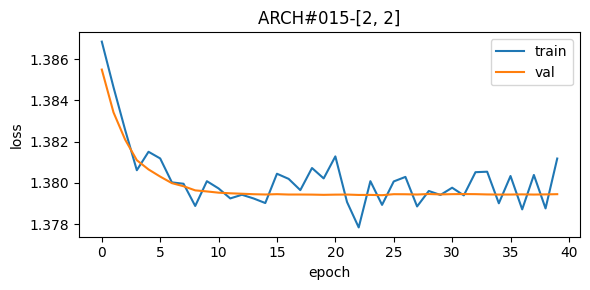


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86     10808
     Class 1       0.00      0.00      0.00       914
     Class 2       0.00      0.00      0.00      2475
     Class 3       0.00      0.00      0.00       182

    accuracy                           0.75     14379
   macro avg       0.19      0.25      0.21     14379
weighted avg       0.56      0.75      0.65     14379



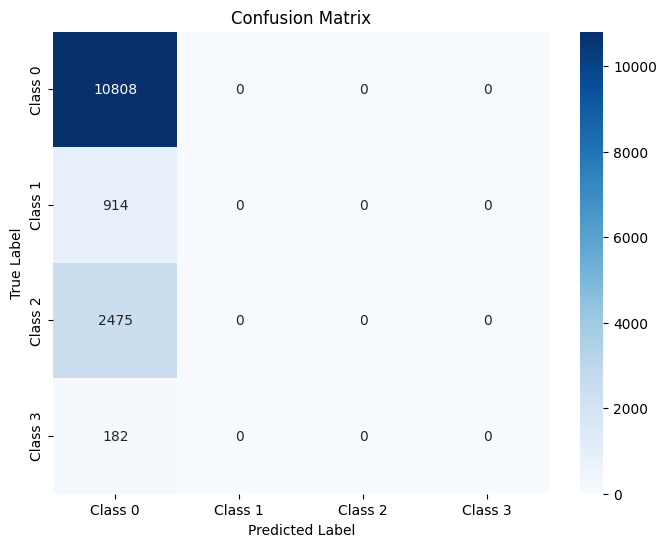

The function took 0.4285 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86      2702
     Class 1       0.00      0.00      0.00       228
     Class 2       0.00      0.00      0.00       619
     Class 3       0.00      0.00      0.00        46

    accuracy                           0.75      3595
   macro avg       0.19      0.25      0.21      3595
weighted avg       0.56      0.75      0.65      3595



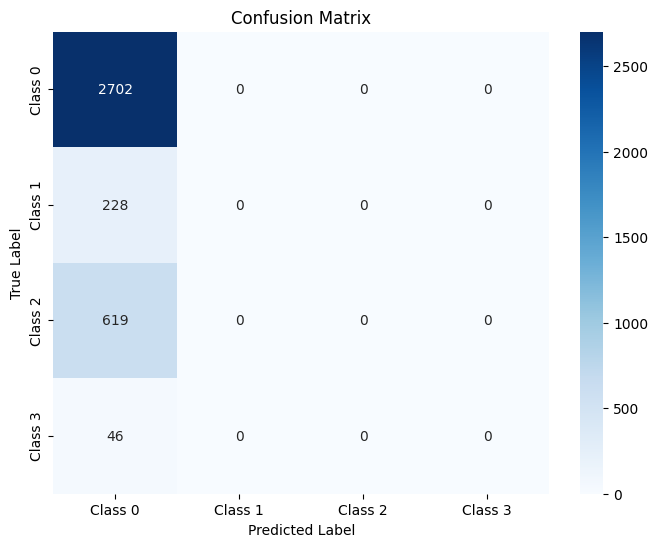

The function took 0.2496 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86      3378
     Class 1       0.00      0.00      0.00       285
     Class 2       0.00      0.00      0.00       774
     Class 3       0.00      0.00      0.00        57

    accuracy                           0.75      4494
   macro avg       0.19      0.25      0.21      4494
weighted avg       0.56      0.75      0.64      4494



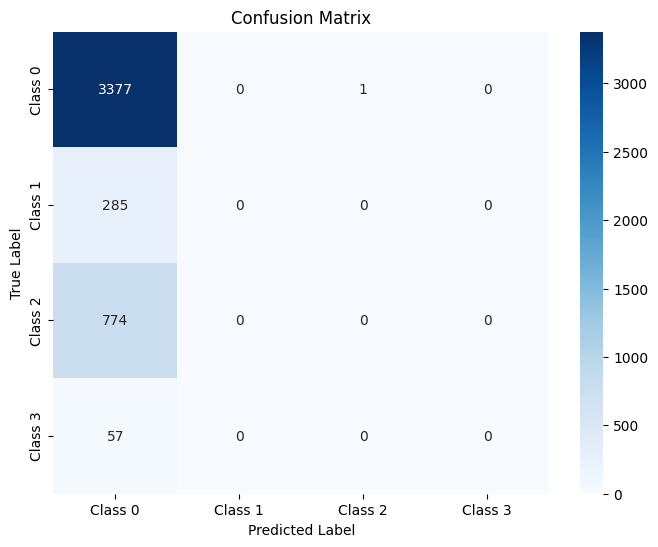

The function took 0.2698 seconds to execute.
[ARCH#016-[32, 32, 32]] done in 29.8s  best-val=0.0539


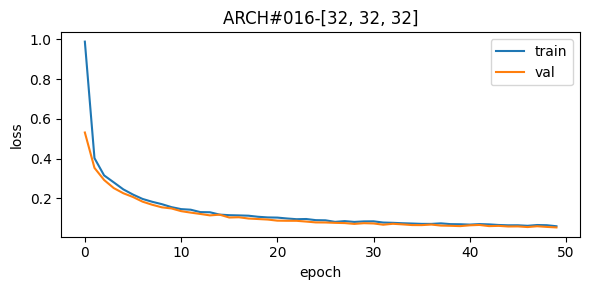


Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.96      0.98     10808
     Class 1       0.82      1.00      0.90       914
     Class 2       0.92      0.99      0.95      2475
     Class 3       0.78      0.99      0.87       182

    accuracy                           0.97     14379
   macro avg       0.88      0.98      0.93     14379
weighted avg       0.97      0.97      0.97     14379



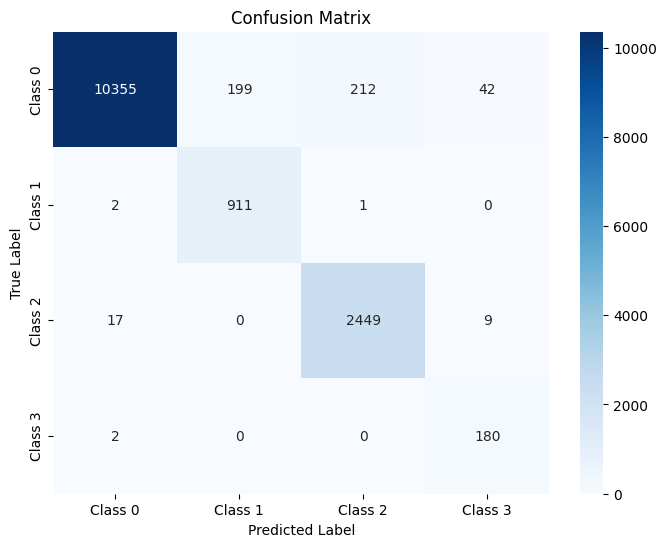

The function took 0.4418 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.96      0.98      2702
     Class 1       0.81      1.00      0.89       228
     Class 2       0.92      0.99      0.95       619
     Class 3       0.78      1.00      0.88        46

    accuracy                           0.96      3595
   macro avg       0.88      0.98      0.92      3595
weighted avg       0.97      0.96      0.97      3595



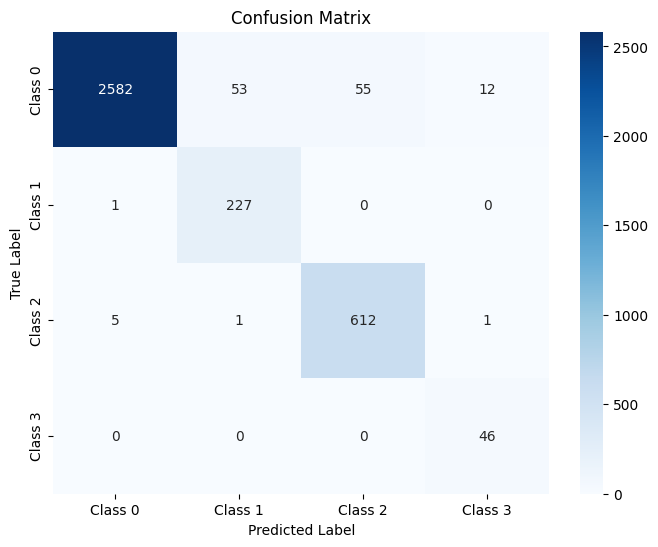

The function took 0.2878 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.96      0.98      3378
     Class 1       0.83      0.99      0.91       285
     Class 2       0.93      0.98      0.95       774
     Class 3       0.80      0.96      0.87        57

    accuracy                           0.97      4494
   macro avg       0.89      0.98      0.93      4494
weighted avg       0.97      0.97      0.97      4494



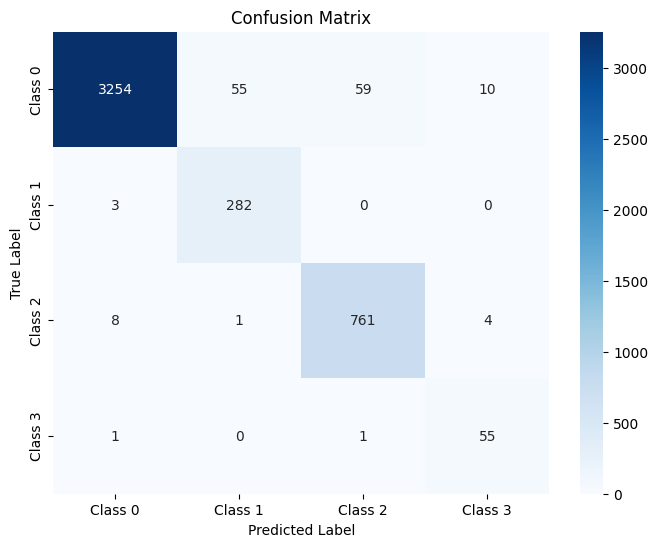

The function took 0.2802 seconds to execute.
[ARCH#017-[32, 32, 16]] done in 30.5s  best-val=0.0655


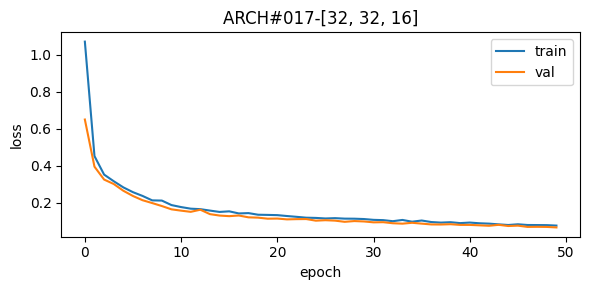


Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.96      0.98     10808
     Class 1       0.82      1.00      0.90       914
     Class 2       0.92      0.98      0.95      2475
     Class 3       0.71      0.99      0.82       182

    accuracy                           0.96     14379
   macro avg       0.86      0.98      0.91     14379
weighted avg       0.97      0.96      0.96     14379



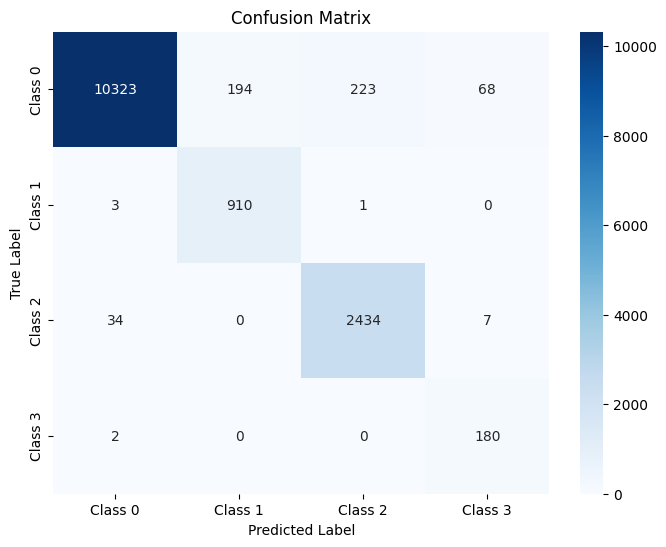

The function took 0.4608 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.96      0.98      2702
     Class 1       0.83      1.00      0.91       228
     Class 2       0.91      0.98      0.95       619
     Class 3       0.73      1.00      0.84        46

    accuracy                           0.96      3595
   macro avg       0.87      0.98      0.92      3595
weighted avg       0.97      0.96      0.96      3595



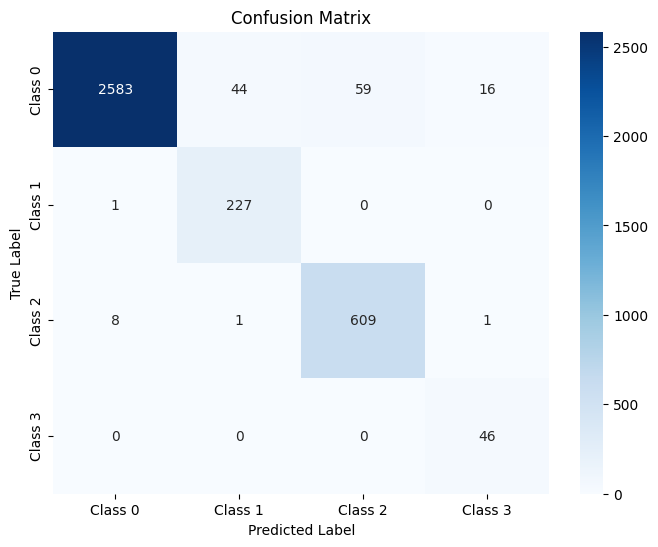

The function took 0.2682 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.96      0.98      3378
     Class 1       0.83      0.99      0.90       285
     Class 2       0.93      0.98      0.95       774
     Class 3       0.65      0.96      0.78        57

    accuracy                           0.96      4494
   macro avg       0.85      0.97      0.90      4494
weighted avg       0.97      0.96      0.97      4494



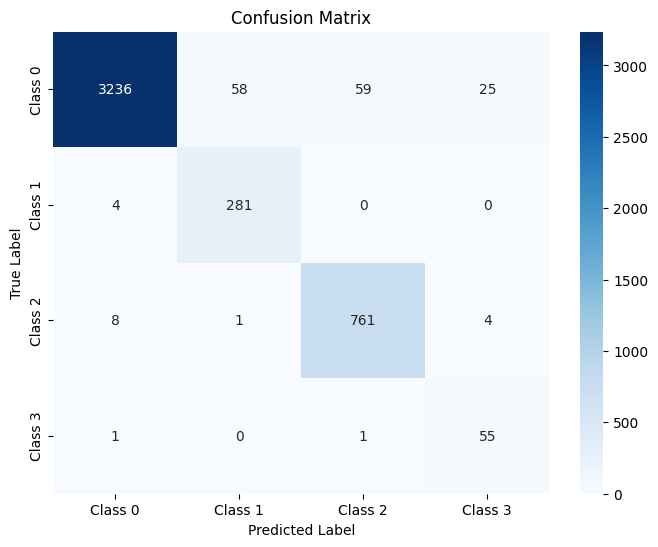

The function took 0.3993 seconds to execute.
[ARCH#018-[32, 32, 8]] done in 29.9s  best-val=0.0648


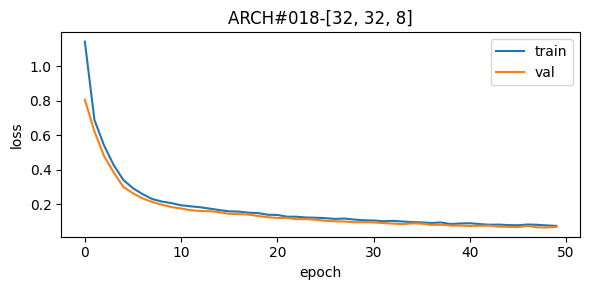


Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.95      0.97     10808
     Class 1       0.79      1.00      0.88       914
     Class 2       0.91      0.99      0.95      2475
     Class 3       0.64      0.99      0.78       182

    accuracy                           0.96     14379
   macro avg       0.83      0.98      0.89     14379
weighted avg       0.97      0.96      0.96     14379



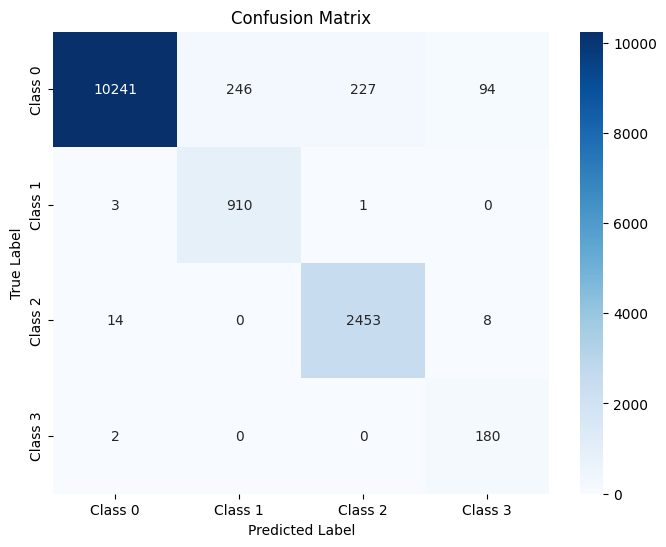

The function took 0.7068 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.95      0.97      2702
     Class 1       0.78      1.00      0.88       228
     Class 2       0.91      0.99      0.95       619
     Class 3       0.63      1.00      0.77        46

    accuracy                           0.96      3595
   macro avg       0.83      0.98      0.89      3595
weighted avg       0.97      0.96      0.96      3595



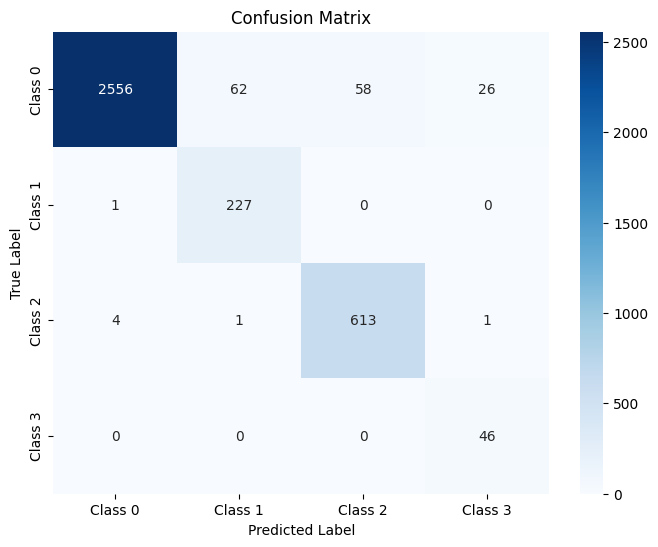

The function took 0.5102 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.95      0.97      3378
     Class 1       0.79      0.99      0.88       285
     Class 2       0.92      0.99      0.95       774
     Class 3       0.60      0.96      0.74        57

    accuracy                           0.96      4494
   macro avg       0.83      0.97      0.89      4494
weighted avg       0.97      0.96      0.96      4494



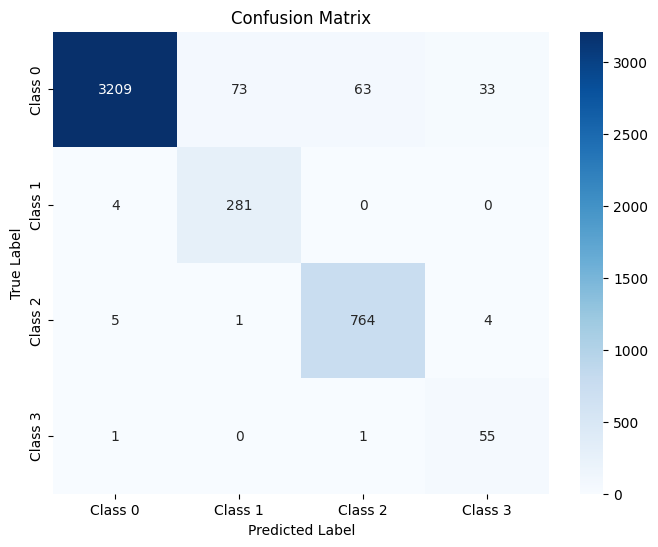

The function took 0.3335 seconds to execute.
[ARCH#019-[32, 32, 4]] done in 29.7s  best-val=0.1577


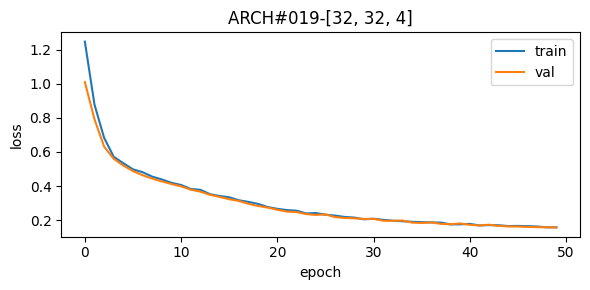


Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.92      0.96     10808
     Class 1       0.88      0.96      0.92       914
     Class 2       0.84      0.99      0.91      2475
     Class 3       0.36      0.99      0.53       182

    accuracy                           0.94     14379
   macro avg       0.77      0.96      0.83     14379
weighted avg       0.96      0.94      0.94     14379



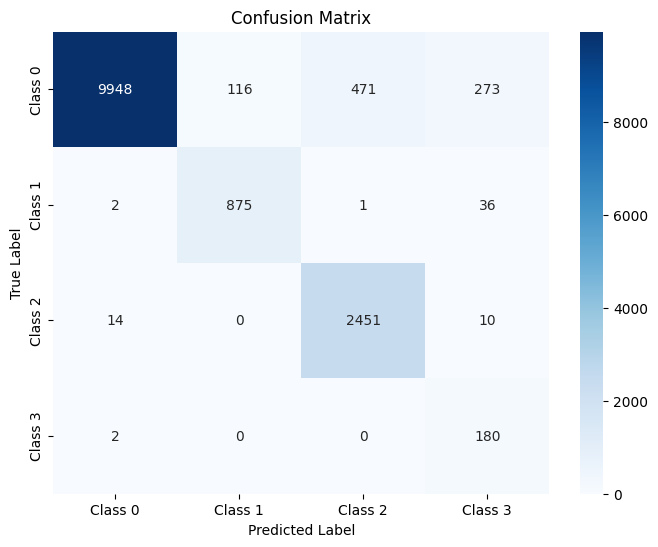

The function took 0.4583 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.92      0.96      2702
     Class 1       0.88      0.94      0.91       228
     Class 2       0.83      0.99      0.90       619
     Class 3       0.39      1.00      0.56        46

    accuracy                           0.93      3595
   macro avg       0.77      0.96      0.83      3595
weighted avg       0.95      0.93      0.94      3595



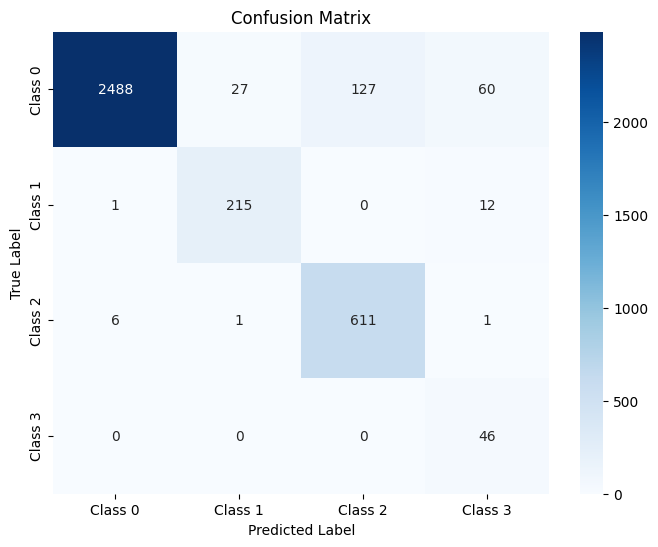

The function took 0.2742 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.92      0.96      3378
     Class 1       0.88      0.94      0.91       285
     Class 2       0.84      0.99      0.91       774
     Class 3       0.35      0.96      0.52        57

    accuracy                           0.93      4494
   macro avg       0.77      0.95      0.82      4494
weighted avg       0.95      0.93      0.94      4494



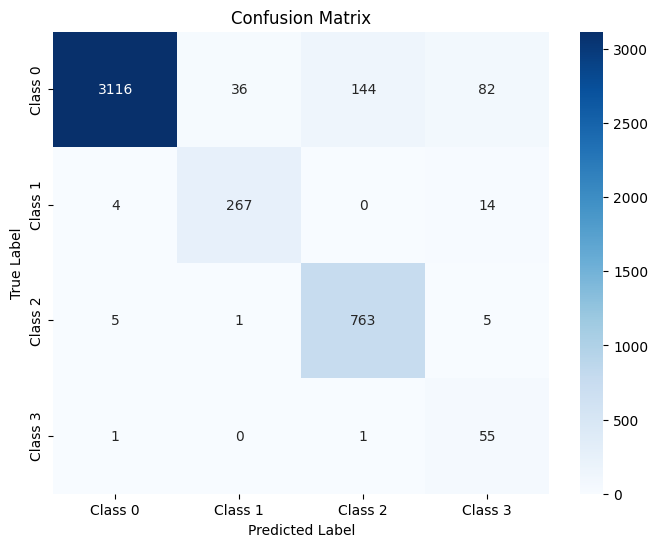

The function took 0.3082 seconds to execute.
[ARCH#020-[32, 32, 2]] done in 30.5s  best-val=0.1130


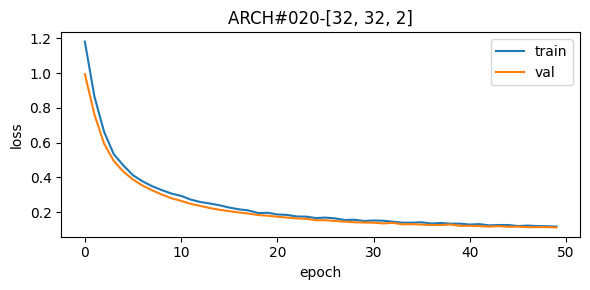


Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.95      0.97     10808
     Class 1       0.78      1.00      0.88       914
     Class 2       0.91      0.98      0.94      2475
     Class 3       0.61      0.93      0.74       182

    accuracy                           0.96     14379
   macro avg       0.82      0.96      0.88     14379
weighted avg       0.96      0.96      0.96     14379



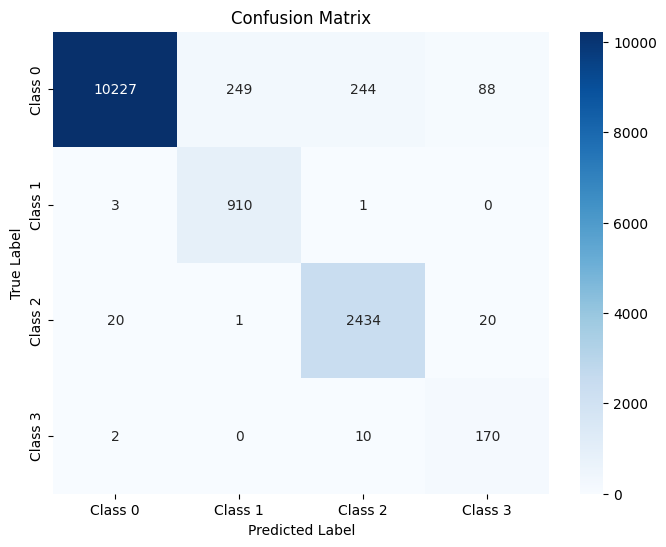

The function took 0.5604 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.94      0.97      2702
     Class 1       0.76      0.99      0.86       228
     Class 2       0.91      0.98      0.94       619
     Class 3       0.62      0.93      0.75        46

    accuracy                           0.95      3595
   macro avg       0.82      0.96      0.88      3595
weighted avg       0.96      0.95      0.96      3595



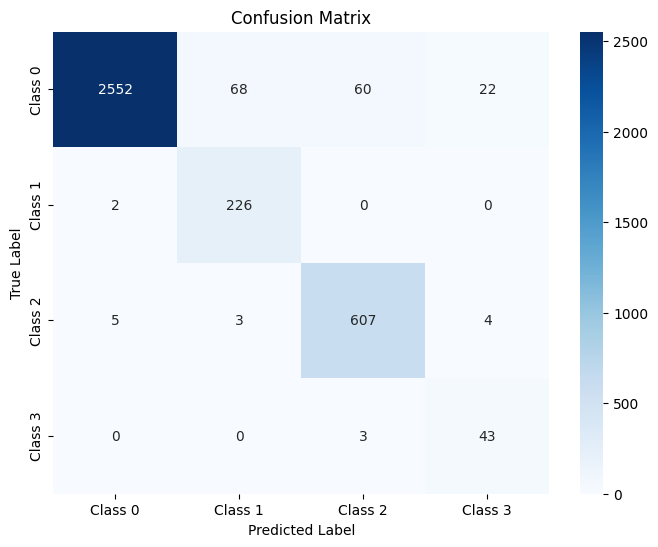

The function took 0.2934 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.95      0.97      3378
     Class 1       0.79      0.99      0.88       285
     Class 2       0.92      0.98      0.95       774
     Class 3       0.58      0.95      0.72        57

    accuracy                           0.96      4494
   macro avg       0.82      0.97      0.88      4494
weighted avg       0.96      0.96      0.96      4494



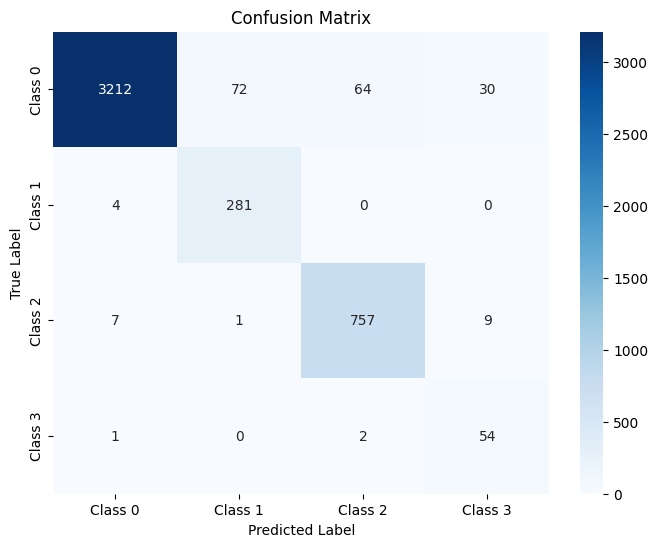

The function took 0.3147 seconds to execute.
[ARCH#021-[32, 16, 16]] done in 30.1s  best-val=0.0636


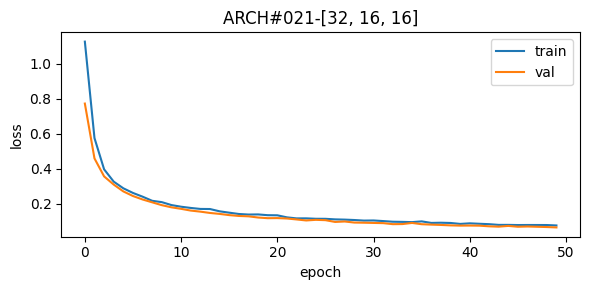


Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.95      0.98     10808
     Class 1       0.83      1.00      0.90       914
     Class 2       0.91      0.99      0.95      2475
     Class 3       0.70      0.99      0.82       182

    accuracy                           0.96     14379
   macro avg       0.86      0.98      0.91     14379
weighted avg       0.97      0.96      0.96     14379



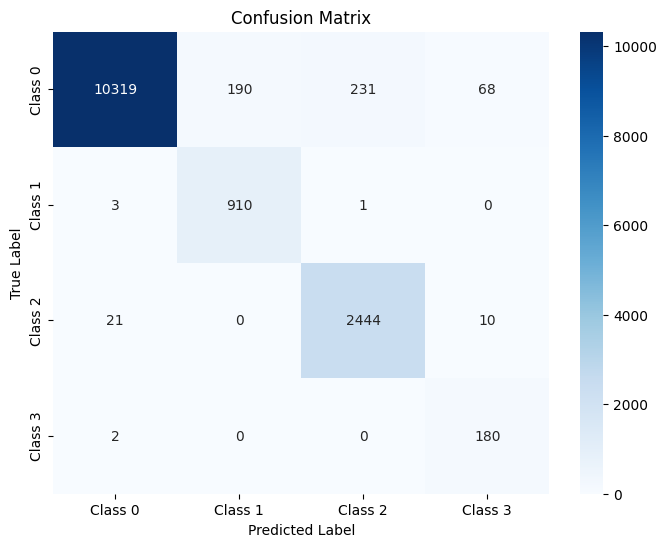

The function took 0.7816 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.95      0.97      2702
     Class 1       0.82      0.99      0.90       228
     Class 2       0.90      0.99      0.94       619
     Class 3       0.71      1.00      0.83        46

    accuracy                           0.96      3595
   macro avg       0.86      0.98      0.91      3595
weighted avg       0.97      0.96      0.96      3595



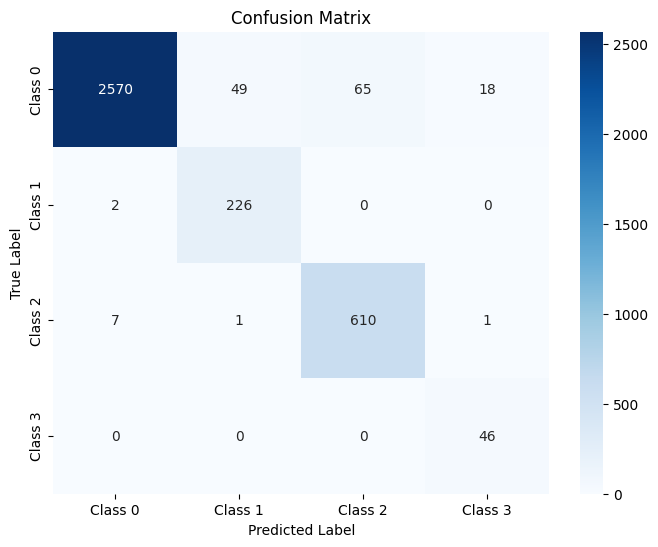

The function took 0.2682 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.96      0.98      3378
     Class 1       0.83      0.99      0.90       285
     Class 2       0.92      0.98      0.95       774
     Class 3       0.64      0.96      0.77        57

    accuracy                           0.96      4494
   macro avg       0.85      0.97      0.90      4494
weighted avg       0.97      0.96      0.96      4494



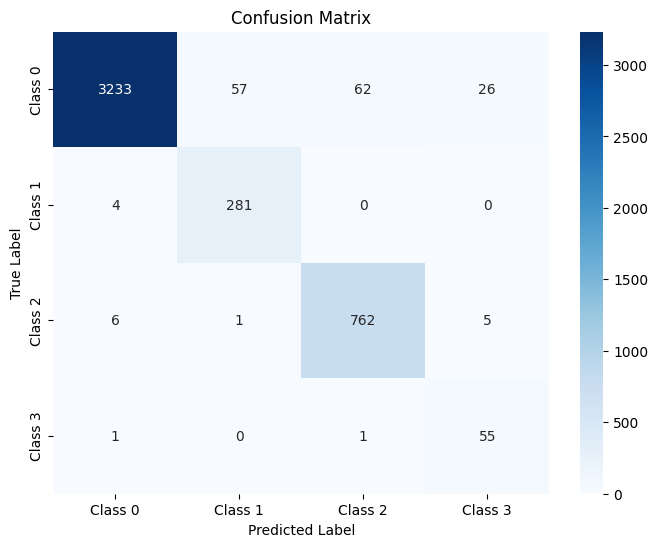

The function took 0.3218 seconds to execute.
[ARCH#022-[32, 16, 8]] done in 30.8s  best-val=0.0743


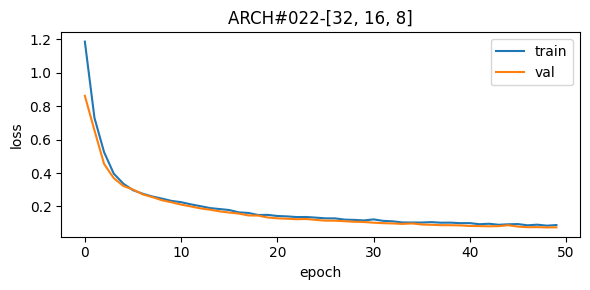


Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.95      0.97     10808
     Class 1       0.78      1.00      0.87       914
     Class 2       0.91      0.99      0.95      2475
     Class 3       0.68      0.99      0.81       182

    accuracy                           0.96     14379
   macro avg       0.84      0.98      0.90     14379
weighted avg       0.96      0.96      0.96     14379



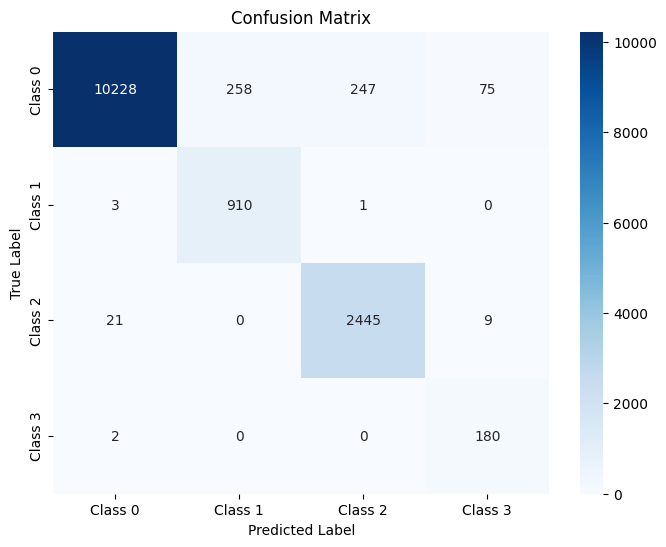

The function took 0.4540 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.94      0.97      2702
     Class 1       0.76      0.99      0.86       228
     Class 2       0.91      0.99      0.95       619
     Class 3       0.69      1.00      0.81        46

    accuracy                           0.95      3595
   macro avg       0.84      0.98      0.90      3595
weighted avg       0.96      0.95      0.96      3595



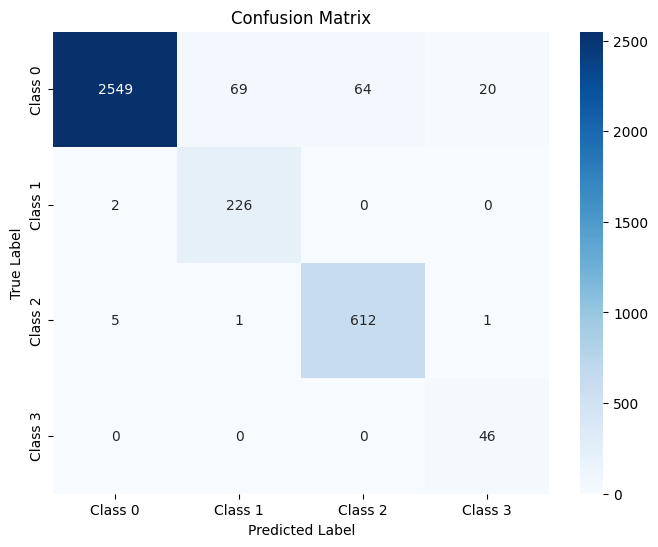

The function took 0.2887 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.95      0.97      3378
     Class 1       0.79      0.99      0.88       285
     Class 2       0.92      0.99      0.95       774
     Class 3       0.63      0.98      0.77        57

    accuracy                           0.96      4494
   macro avg       0.83      0.98      0.89      4494
weighted avg       0.97      0.96      0.96      4494



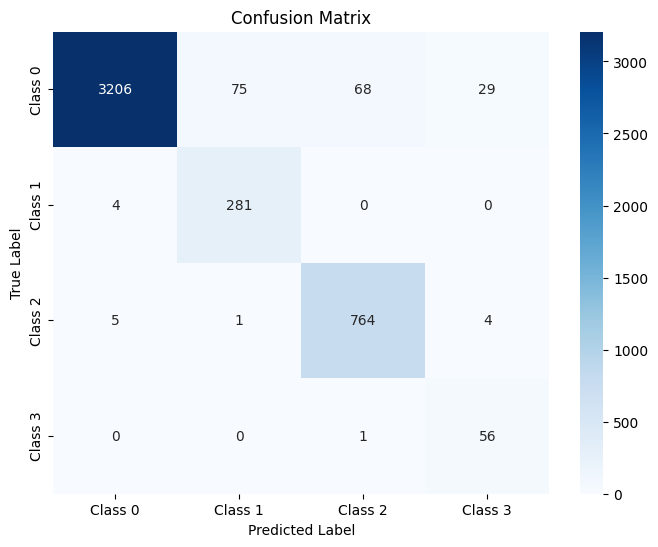

The function took 0.3951 seconds to execute.
[ARCH#023-[32, 16, 4]] done in 30.8s  best-val=0.0879


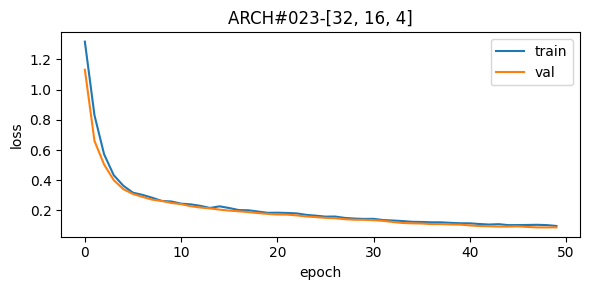


Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.93      0.96     10808
     Class 1       0.74      1.00      0.85       914
     Class 2       0.89      0.98      0.93      2475
     Class 3       0.63      0.99      0.77       182

    accuracy                           0.95     14379
   macro avg       0.82      0.98      0.88     14379
weighted avg       0.96      0.95      0.95     14379



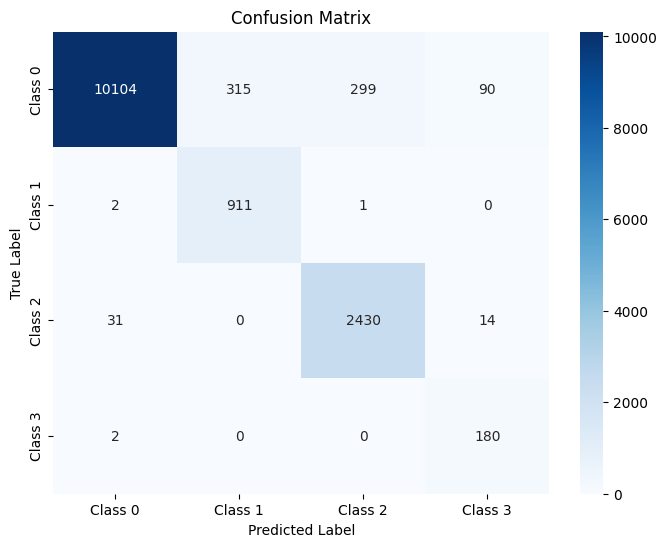

The function took 0.5328 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.93      0.96      2702
     Class 1       0.73      0.99      0.84       228
     Class 2       0.88      0.98      0.93       619
     Class 3       0.69      1.00      0.81        46

    accuracy                           0.95      3595
   macro avg       0.82      0.98      0.89      3595
weighted avg       0.96      0.95      0.95      3595



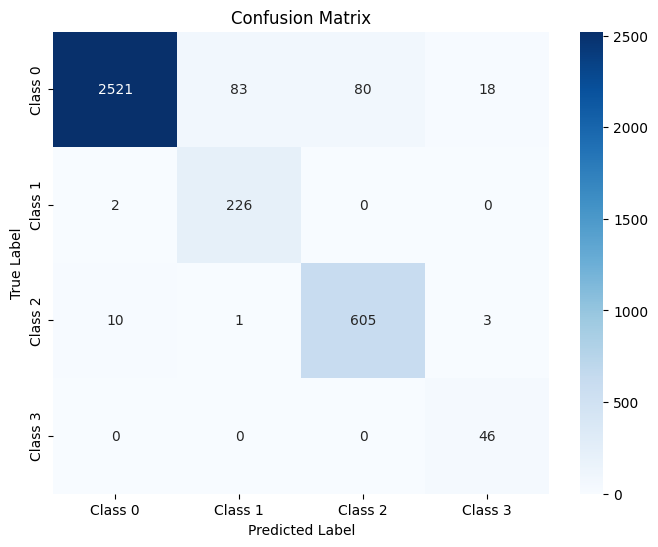

The function took 0.2743 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.94      0.97      3378
     Class 1       0.75      0.99      0.85       285
     Class 2       0.89      0.98      0.93       774
     Class 3       0.65      0.96      0.77        57

    accuracy                           0.95      4494
   macro avg       0.82      0.97      0.88      4494
weighted avg       0.96      0.95      0.95      4494



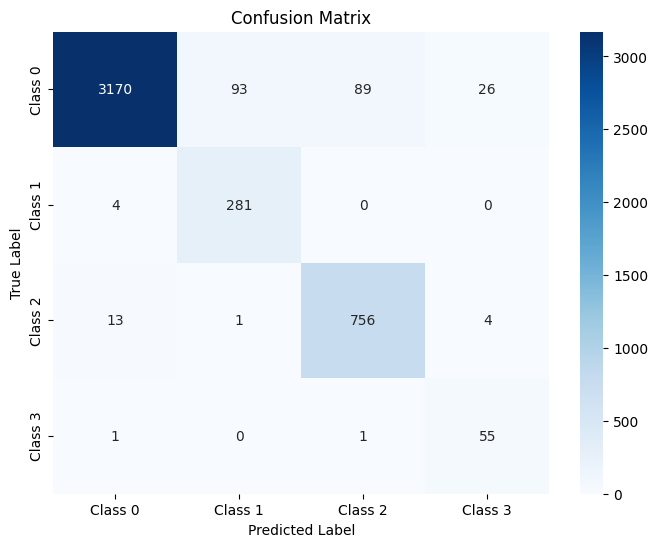

The function took 0.3043 seconds to execute.
[ARCH#024-[32, 16, 2]] done in 29.7s  best-val=0.1804


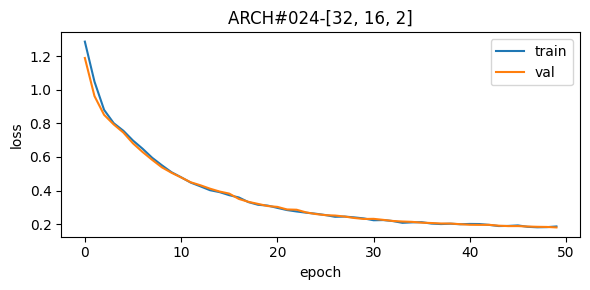


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.94      0.96     10808
     Class 1       0.78      0.90      0.83       914
     Class 2       0.87      0.99      0.93      2475
     Class 3       0.76      0.99      0.86       182

    accuracy                           0.95     14379
   macro avg       0.85      0.95      0.90     14379
weighted avg       0.95      0.95      0.95     14379



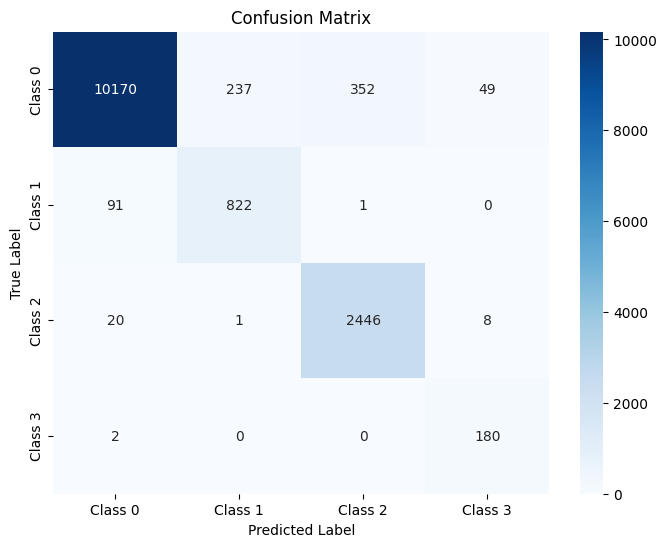

The function took 0.5575 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.94      0.96      2702
     Class 1       0.75      0.87      0.81       228
     Class 2       0.88      0.99      0.93       619
     Class 3       0.78      1.00      0.88        46

    accuracy                           0.95      3595
   macro avg       0.85      0.95      0.90      3595
weighted avg       0.95      0.95      0.95      3595



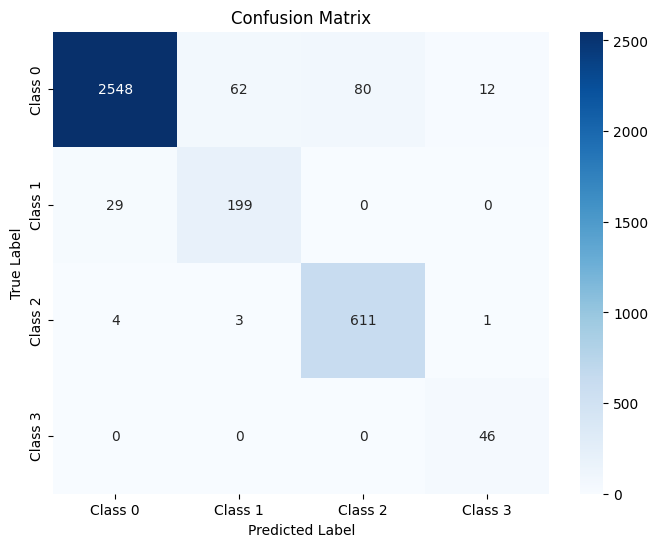

The function took 0.2921 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.95      0.97      3378
     Class 1       0.79      0.89      0.84       285
     Class 2       0.88      0.98      0.93       774
     Class 3       0.71      0.95      0.81        57

    accuracy                           0.95      4494
   macro avg       0.84      0.94      0.89      4494
weighted avg       0.95      0.95      0.95      4494



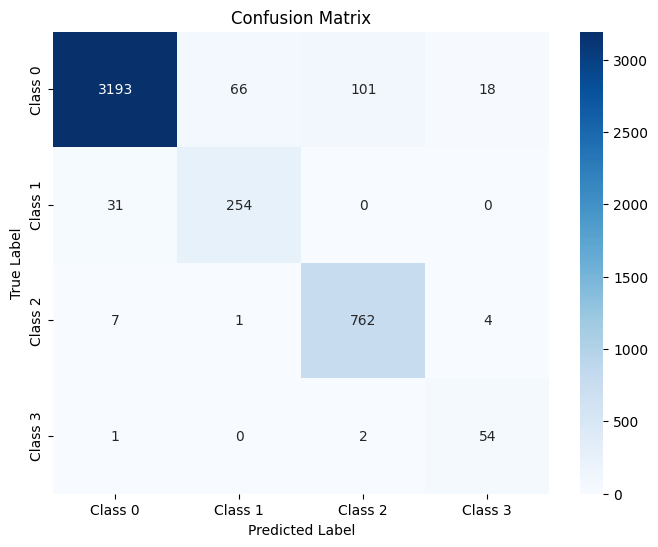

The function took 0.3108 seconds to execute.
[ARCH#025-[32, 8, 8]] done in 30.3s  best-val=0.0926


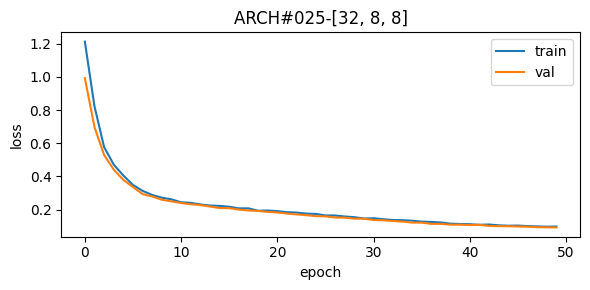


Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.94      0.97     10808
     Class 1       0.74      1.00      0.85       914
     Class 2       0.90      0.99      0.94      2475
     Class 3       0.60      0.99      0.74       182

    accuracy                           0.95     14379
   macro avg       0.81      0.98      0.88     14379
weighted avg       0.96      0.95      0.95     14379



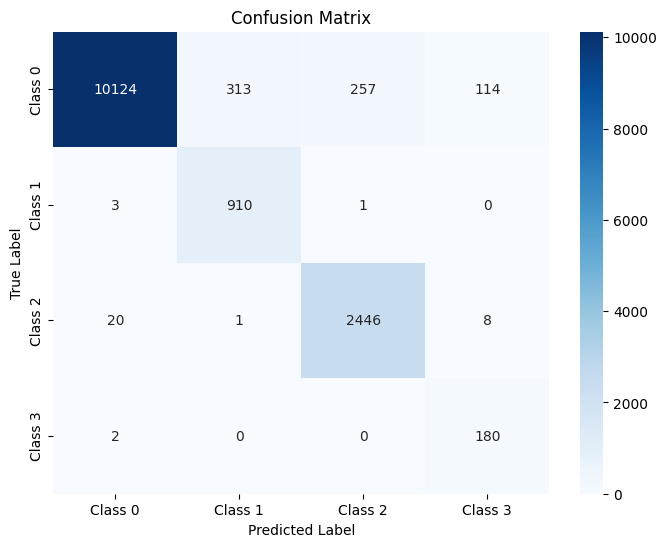

The function took 0.4562 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.94      0.97      2702
     Class 1       0.75      0.99      0.85       228
     Class 2       0.90      0.99      0.94       619
     Class 3       0.61      1.00      0.76        46

    accuracy                           0.95      3595
   macro avg       0.81      0.98      0.88      3595
weighted avg       0.96      0.95      0.95      3595



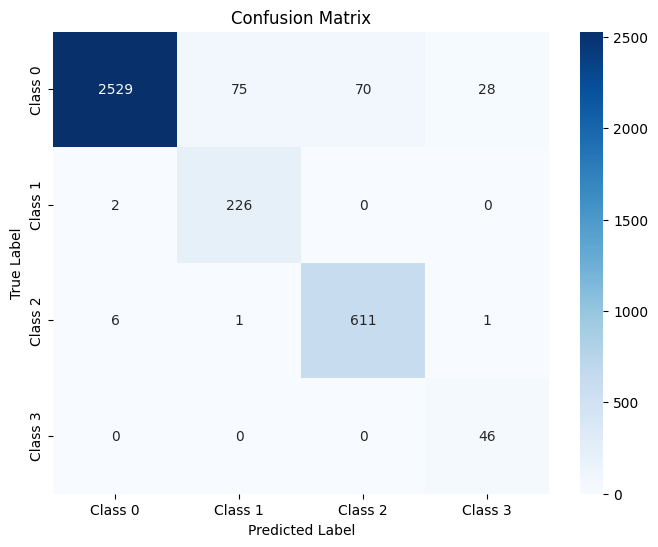

The function took 0.4012 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.94      0.97      3378
     Class 1       0.74      0.98      0.84       285
     Class 2       0.90      0.98      0.94       774
     Class 3       0.58      0.96      0.72        57

    accuracy                           0.95      4494
   macro avg       0.80      0.97      0.87      4494
weighted avg       0.96      0.95      0.95      4494



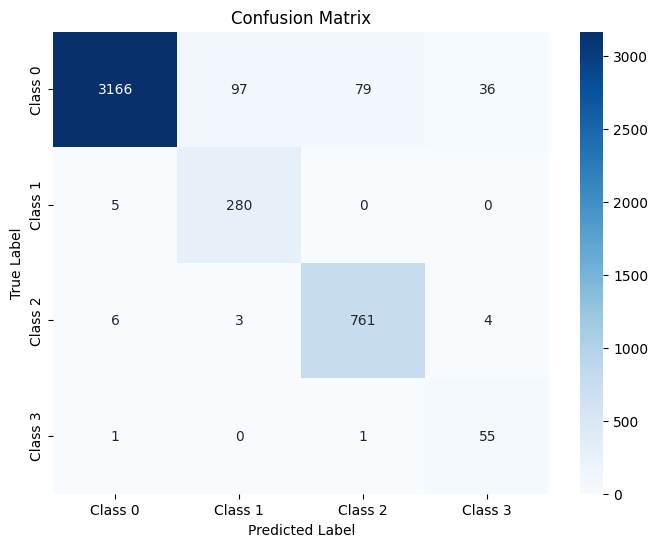

The function took 0.2779 seconds to execute.
[ARCH#026-[32, 8, 4]] done in 29.6s  best-val=0.0839


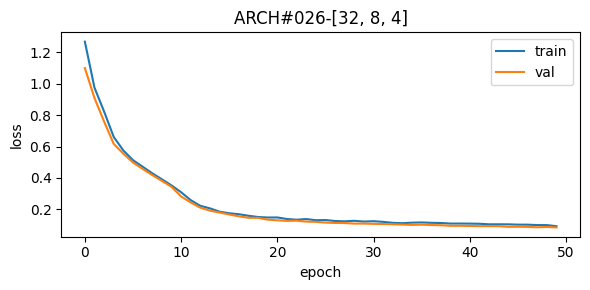


Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.93      0.96     10808
     Class 1       0.78      1.00      0.88       914
     Class 2       0.90      0.99      0.94      2475
     Class 3       0.43      0.96      0.60       182

    accuracy                           0.95     14379
   macro avg       0.78      0.97      0.84     14379
weighted avg       0.96      0.95      0.95     14379



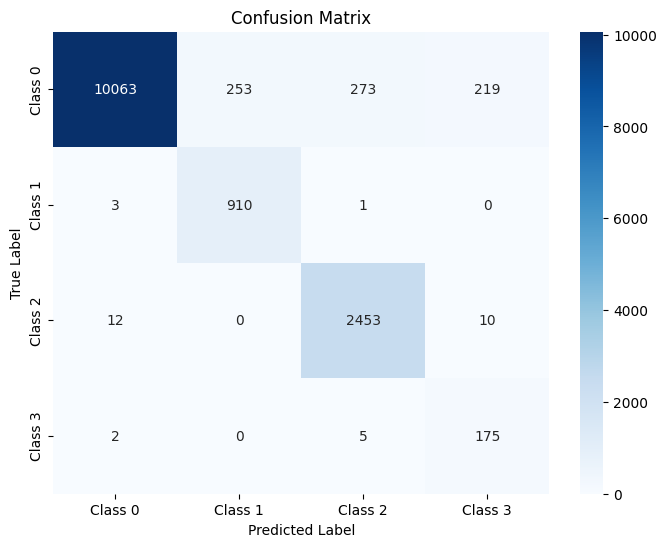

The function took 0.6683 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.93      0.96      2702
     Class 1       0.78      1.00      0.88       228
     Class 2       0.90      0.99      0.94       619
     Class 3       0.42      0.96      0.58        46

    accuracy                           0.94      3595
   macro avg       0.77      0.97      0.84      3595
weighted avg       0.96      0.94      0.95      3595



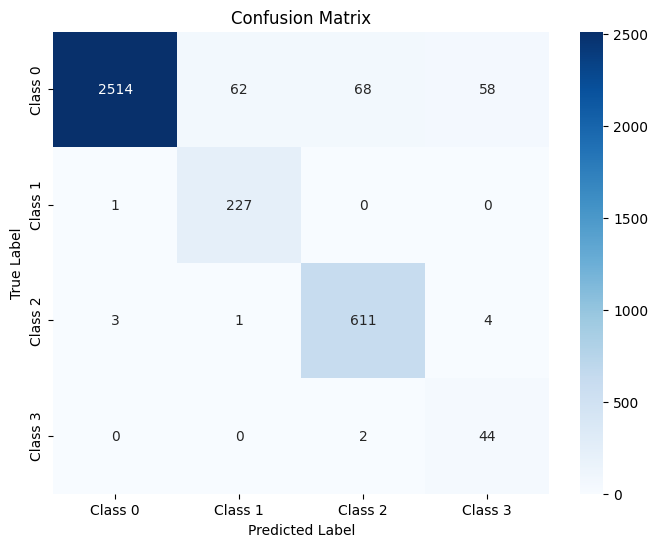

The function took 0.5218 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.93      0.96      3378
     Class 1       0.78      0.99      0.87       285
     Class 2       0.91      0.99      0.95       774
     Class 3       0.41      0.96      0.57        57

    accuracy                           0.95      4494
   macro avg       0.77      0.97      0.84      4494
weighted avg       0.96      0.95      0.95      4494



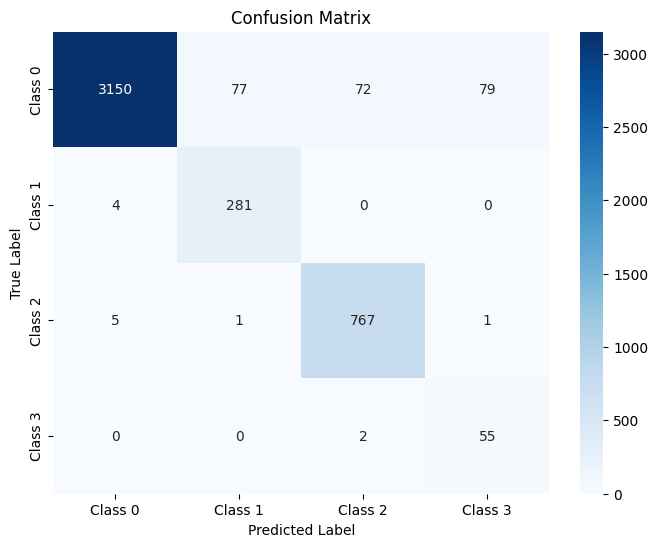

The function took 0.4174 seconds to execute.
[ARCH#027-[32, 8, 2]] done in 29.9s  best-val=0.2062


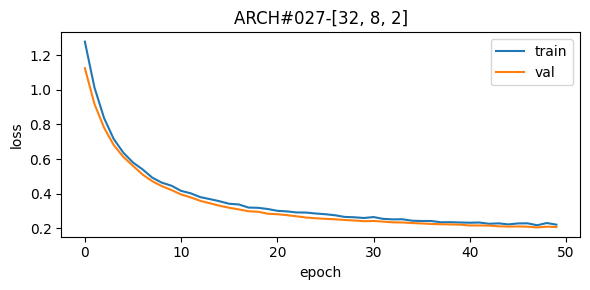


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.95      0.96     10808
     Class 1       0.91      0.96      0.93       914
     Class 2       0.93      0.90      0.91      2475
     Class 3       0.34      0.99      0.50       182

    accuracy                           0.94     14379
   macro avg       0.79      0.95      0.83     14379
weighted avg       0.96      0.94      0.95     14379



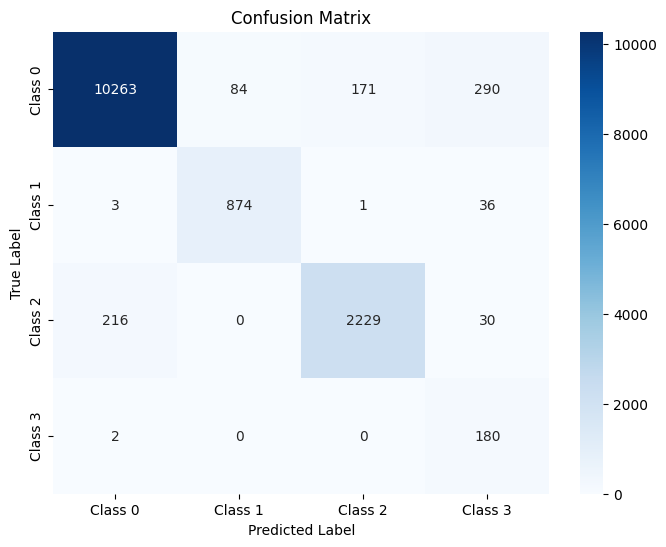

The function took 0.5527 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.95      0.97      2702
     Class 1       0.90      0.94      0.92       228
     Class 2       0.94      0.92      0.93       619
     Class 3       0.33      1.00      0.49        46

    accuracy                           0.95      3595
   macro avg       0.79      0.95      0.83      3595
weighted avg       0.96      0.95      0.95      3595



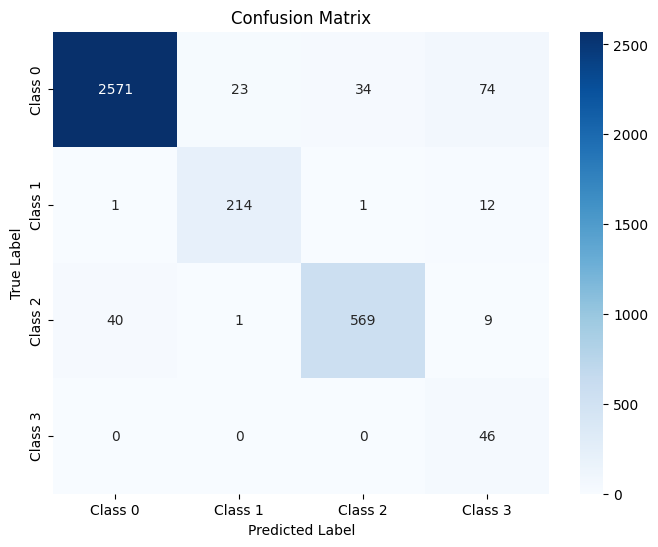

The function took 0.3009 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.95      0.96      3378
     Class 1       0.91      0.94      0.93       285
     Class 2       0.93      0.89      0.91       774
     Class 3       0.32      0.93      0.47        57

    accuracy                           0.94      4494
   macro avg       0.79      0.93      0.82      4494
weighted avg       0.96      0.94      0.95      4494



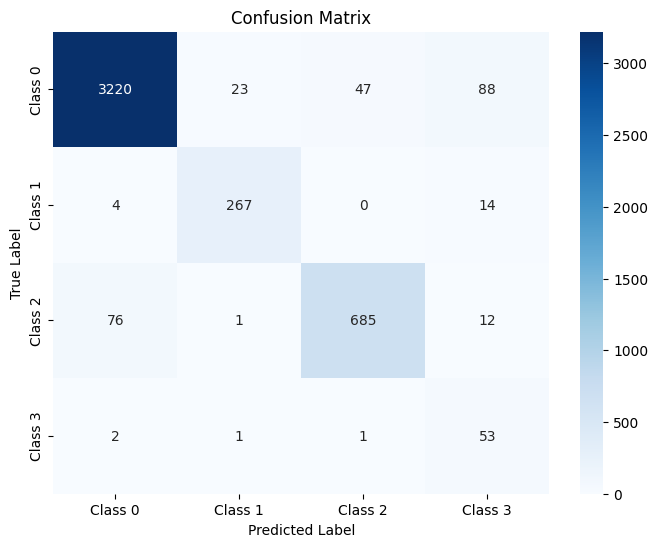

The function took 0.2999 seconds to execute.
[ARCH#028-[32, 4, 4]] done in 29.9s  best-val=0.2684


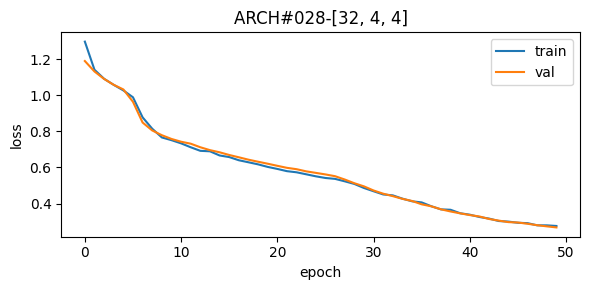


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.90      0.94     10808
     Class 1       0.90      0.91      0.90       914
     Class 2       0.88      0.92      0.90      2475
     Class 3       0.17      0.99      0.29       182

    accuracy                           0.90     14379
   macro avg       0.74      0.93      0.76     14379
weighted avg       0.96      0.90      0.93     14379



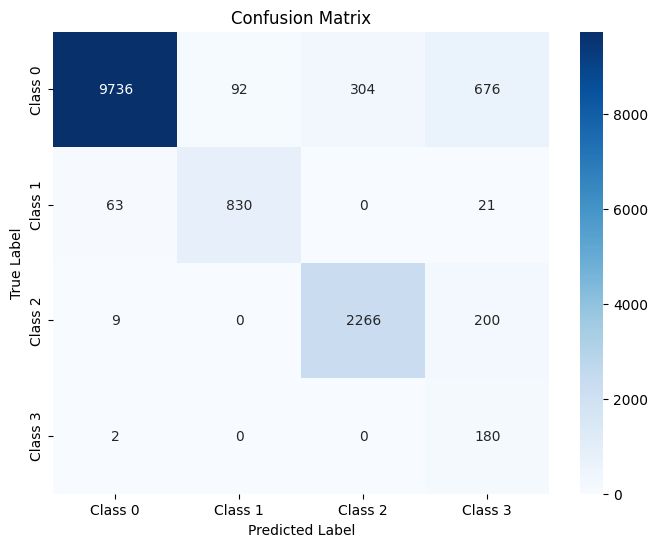

The function took 0.6679 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.91      0.95      2702
     Class 1       0.87      0.89      0.88       228
     Class 2       0.91      0.93      0.92       619
     Class 3       0.17      1.00      0.30        46

    accuracy                           0.91      3595
   macro avg       0.74      0.93      0.76      3595
weighted avg       0.96      0.91      0.93      3595



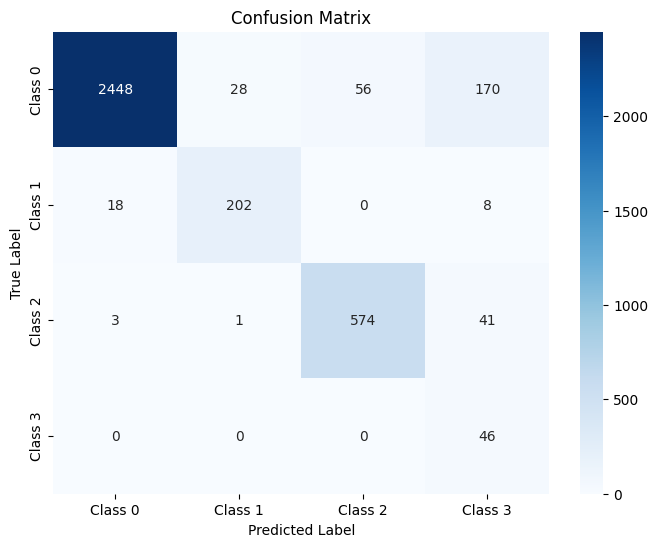

The function took 0.2558 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.91      0.95      3378
     Class 1       0.89      0.89      0.89       285
     Class 2       0.88      0.91      0.90       774
     Class 3       0.18      0.98      0.30        57

    accuracy                           0.91      4494
   macro avg       0.74      0.92      0.76      4494
weighted avg       0.96      0.91      0.93      4494



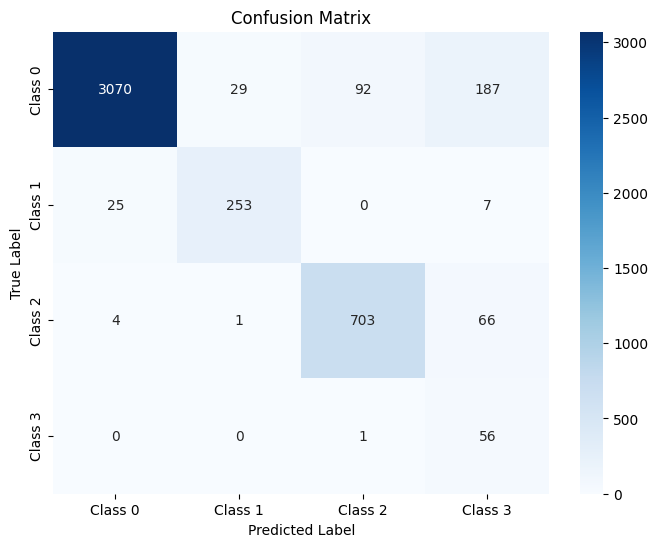

The function took 0.2890 seconds to execute.
[ARCH#029-[32, 4, 2]] done in 29.8s  best-val=0.4902


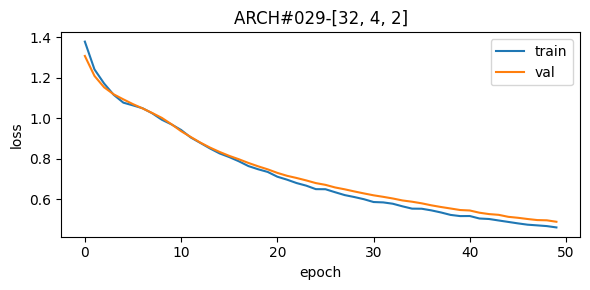


Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.89      0.94     10808
     Class 1       0.81      0.96      0.87       914
     Class 2       0.75      0.99      0.85      2475
     Class 3       0.39      0.90      0.54       182

    accuracy                           0.91     14379
   macro avg       0.74      0.93      0.80     14379
weighted avg       0.94      0.91      0.92     14379



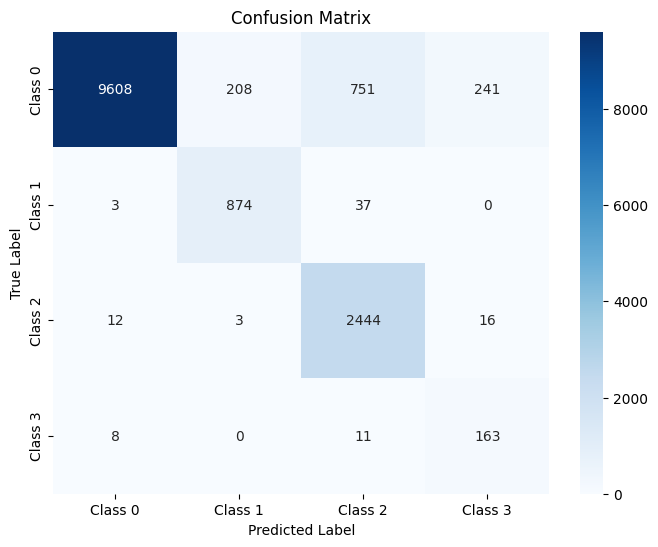

The function took 0.5175 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.90      0.94      2702
     Class 1       0.79      0.94      0.86       228
     Class 2       0.76      0.98      0.86       619
     Class 3       0.44      0.89      0.59        46

    accuracy                           0.91      3595
   macro avg       0.75      0.93      0.81      3595
weighted avg       0.94      0.91      0.92      3595



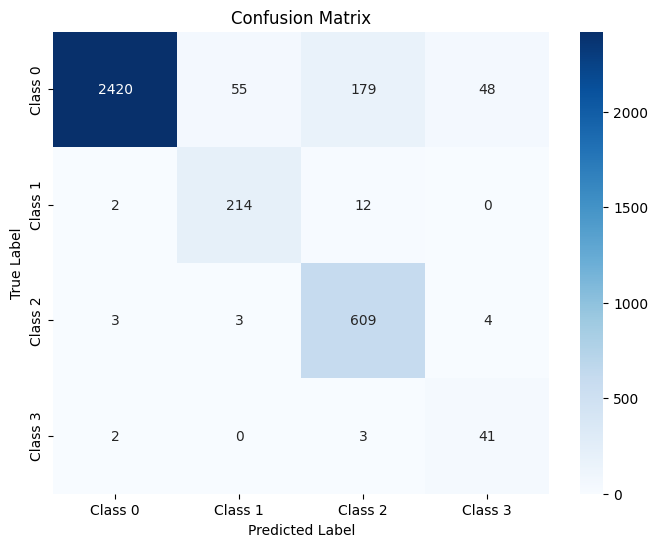

The function took 0.3015 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.89      0.94      3378
     Class 1       0.77      0.94      0.85       285
     Class 2       0.76      0.98      0.86       774
     Class 3       0.37      0.91      0.53        57

    accuracy                           0.91      4494
   macro avg       0.73      0.93      0.79      4494
weighted avg       0.93      0.91      0.91      4494



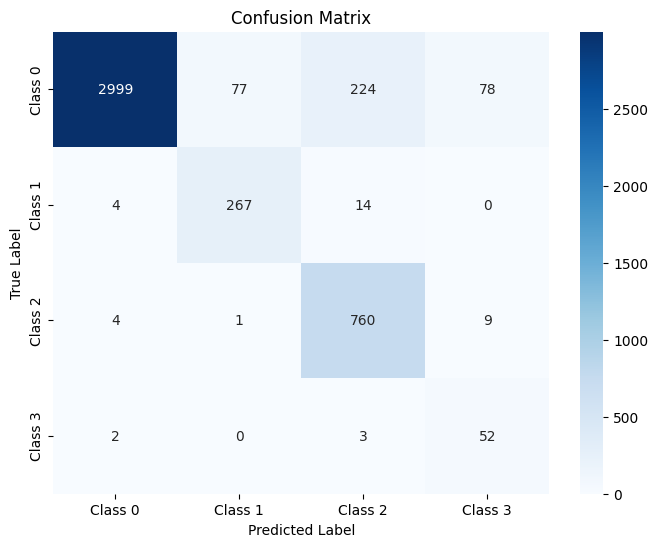

The function took 0.2927 seconds to execute.
[ARCH#030-[32, 2, 2]] done in 30.3s  best-val=0.4679


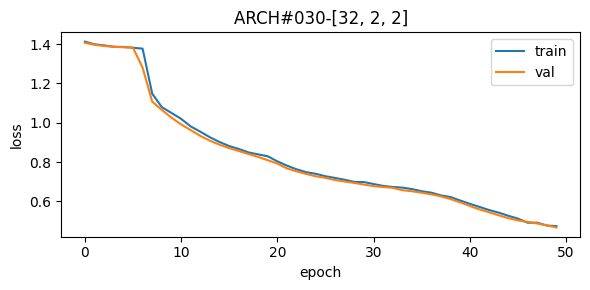


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.90      0.94     10808
     Class 1       0.71      1.00      0.83       914
     Class 2       0.80      0.92      0.85      2475
     Class 3       0.38      0.88      0.53       182

    accuracy                           0.91     14379
   macro avg       0.72      0.92      0.79     14379
weighted avg       0.93      0.91      0.92     14379



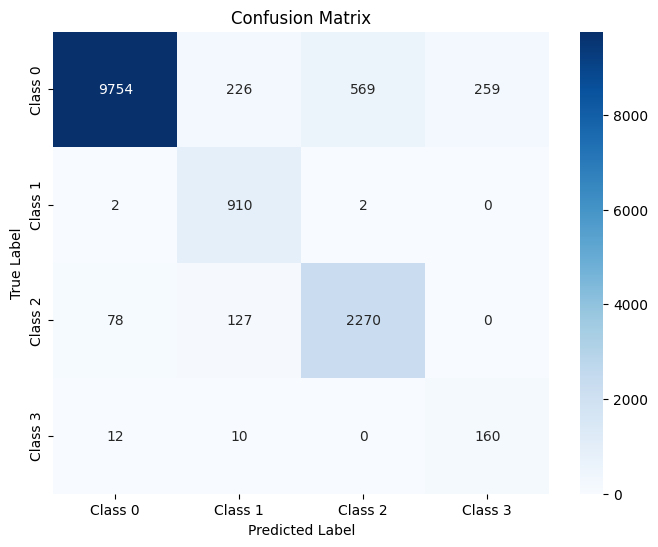

The function took 0.4574 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.90      0.94      2702
     Class 1       0.69      0.99      0.82       228
     Class 2       0.81      0.92      0.86       619
     Class 3       0.38      0.89      0.54        46

    accuracy                           0.91      3595
   macro avg       0.72      0.93      0.79      3595
weighted avg       0.93      0.91      0.92      3595



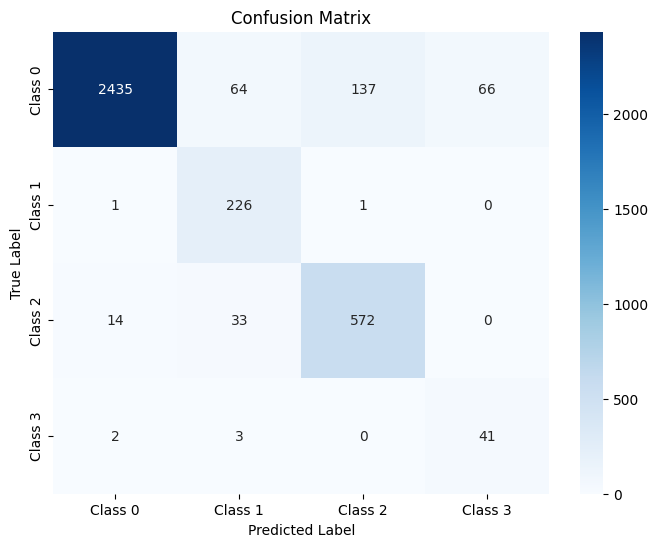

The function took 0.4179 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.90      0.94      3378
     Class 1       0.71      0.99      0.83       285
     Class 2       0.80      0.91      0.85       774
     Class 3       0.36      0.89      0.52        57

    accuracy                           0.91      4494
   macro avg       0.72      0.92      0.78      4494
weighted avg       0.93      0.91      0.92      4494



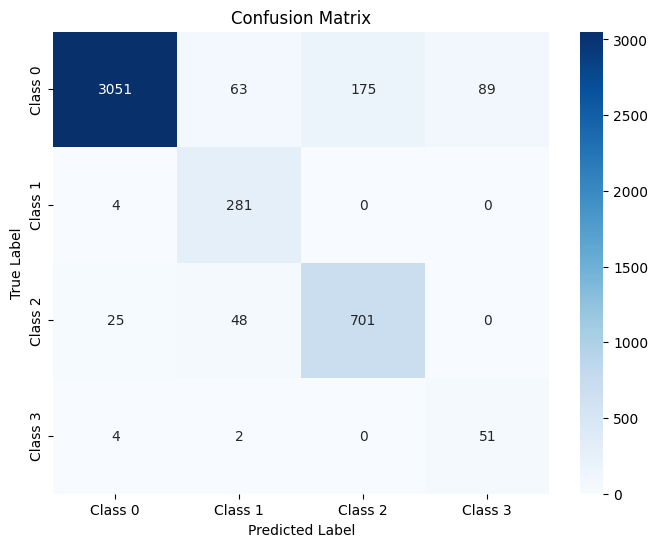

The function took 0.2754 seconds to execute.
[ARCH#031-[16, 16, 16]] done in 29.7s  best-val=0.0822


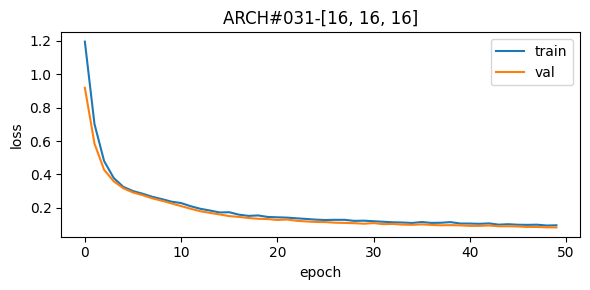


Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.94      0.97     10808
     Class 1       0.78      1.00      0.87       914
     Class 2       0.88      0.99      0.93      2475
     Class 3       0.66      0.97      0.79       182

    accuracy                           0.95     14379
   macro avg       0.83      0.97      0.89     14379
weighted avg       0.96      0.95      0.95     14379



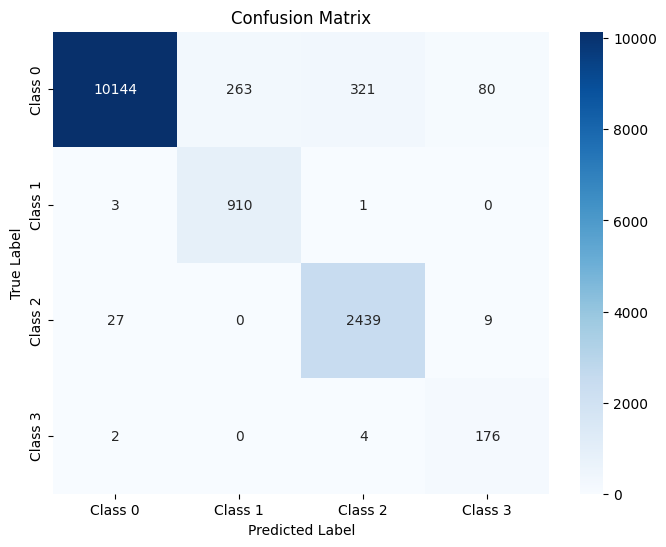

The function took 0.6114 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.94      0.97      2702
     Class 1       0.77      1.00      0.87       228
     Class 2       0.89      0.99      0.94       619
     Class 3       0.65      0.98      0.78        46

    accuracy                           0.95      3595
   macro avg       0.83      0.98      0.89      3595
weighted avg       0.96      0.95      0.95      3595



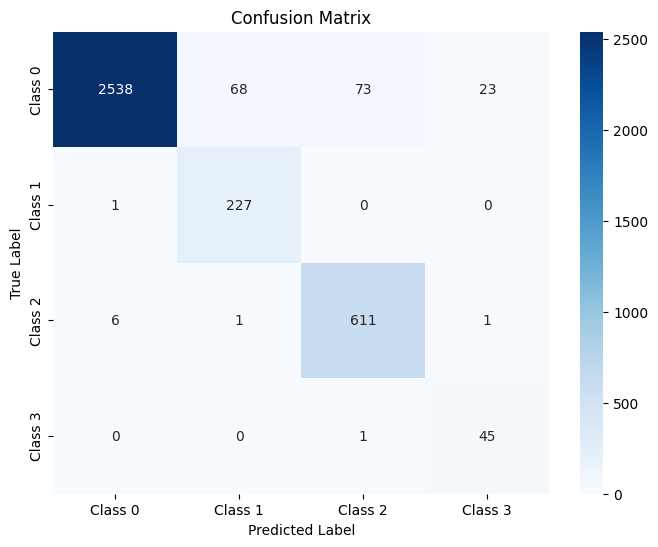

The function took 0.3949 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.94      0.97      3378
     Class 1       0.78      0.99      0.87       285
     Class 2       0.88      0.98      0.93       774
     Class 3       0.68      0.96      0.80        57

    accuracy                           0.95      4494
   macro avg       0.83      0.97      0.89      4494
weighted avg       0.96      0.95      0.95      4494



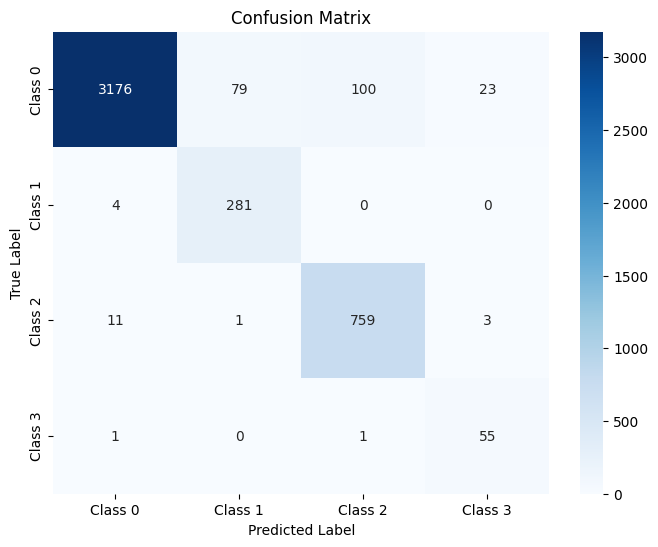

The function took 0.4296 seconds to execute.
[ARCH#032-[16, 16, 8]] done in 29.9s  best-val=0.1152


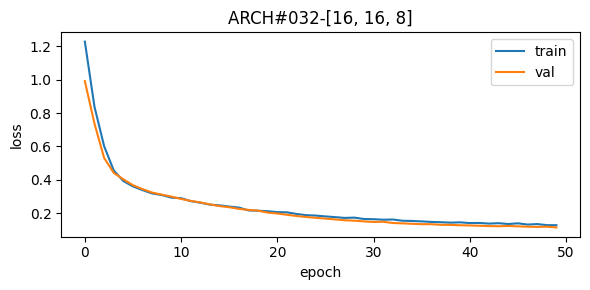


Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.93      0.96     10808
     Class 1       0.76      1.00      0.86       914
     Class 2       0.89      0.97      0.93      2475
     Class 3       0.52      0.93      0.67       182

    accuracy                           0.94     14379
   macro avg       0.79      0.96      0.86     14379
weighted avg       0.96      0.94      0.95     14379



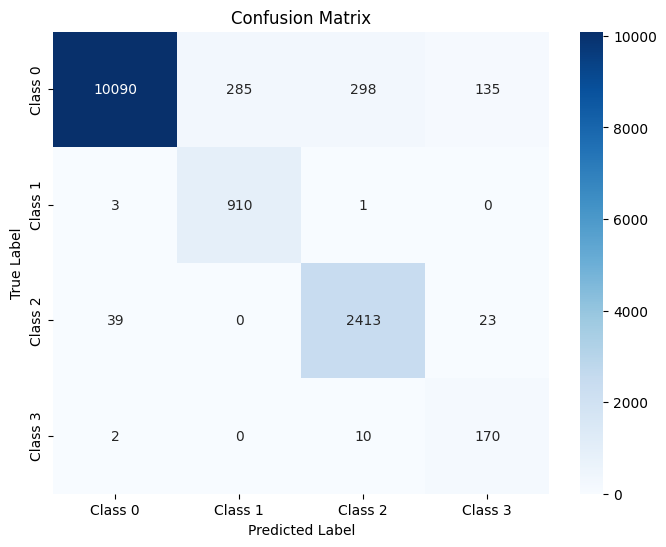

The function took 0.4545 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.93      0.96      2702
     Class 1       0.74      0.99      0.85       228
     Class 2       0.88      0.98      0.93       619
     Class 3       0.55      0.93      0.69        46

    accuracy                           0.94      3595
   macro avg       0.79      0.96      0.86      3595
weighted avg       0.95      0.94      0.95      3595



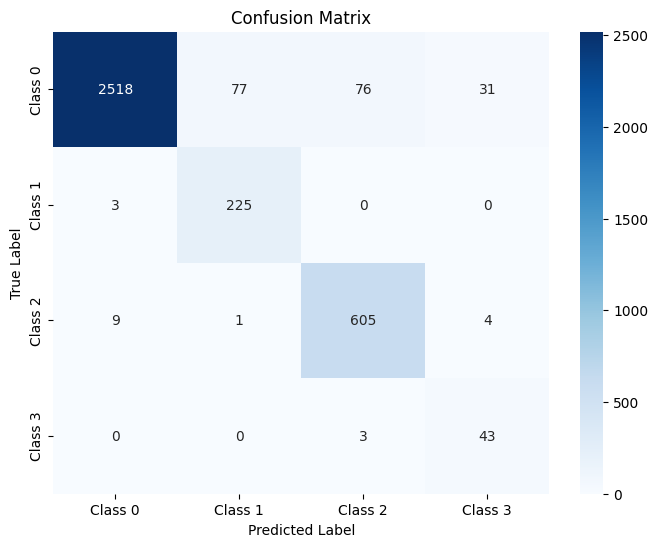

The function took 0.3109 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.93      0.96      3378
     Class 1       0.76      0.99      0.86       285
     Class 2       0.90      0.97      0.93       774
     Class 3       0.47      0.95      0.63        57

    accuracy                           0.94      4494
   macro avg       0.78      0.96      0.85      4494
weighted avg       0.96      0.94      0.95      4494



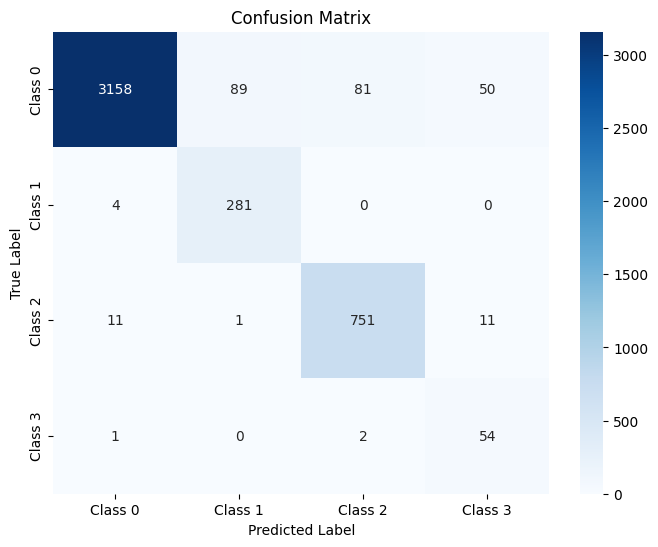

The function took 0.3763 seconds to execute.
[ARCH#033-[16, 16, 4]] done in 29.7s  best-val=0.1553


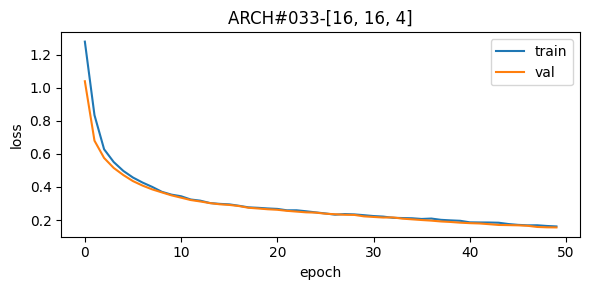


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.97      0.96      0.97     10808
     Class 1       0.81      0.93      0.87       914
     Class 2       0.95      0.88      0.92      2475
     Class 3       0.57      0.99      0.73       182

    accuracy                           0.95     14379
   macro avg       0.83      0.94      0.87     14379
weighted avg       0.95      0.95      0.95     14379



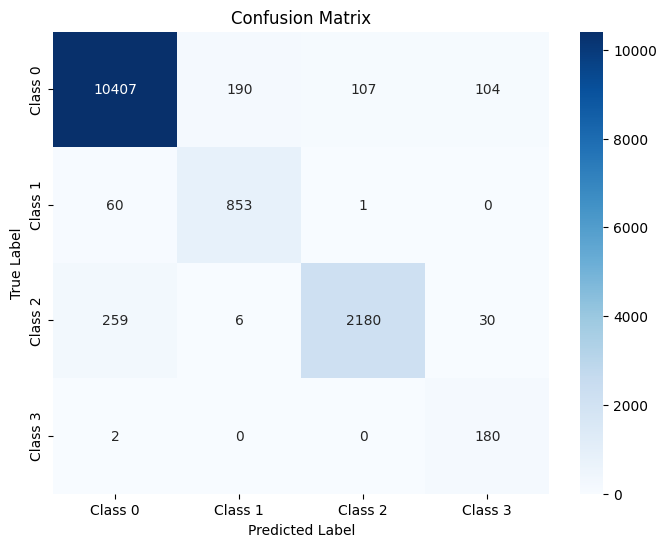

The function took 0.4954 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.97      0.96      0.97      2702
     Class 1       0.80      0.91      0.85       228
     Class 2       0.96      0.89      0.92       619
     Class 3       0.61      1.00      0.75        46

    accuracy                           0.95      3595
   macro avg       0.83      0.94      0.87      3595
weighted avg       0.95      0.95      0.95      3595



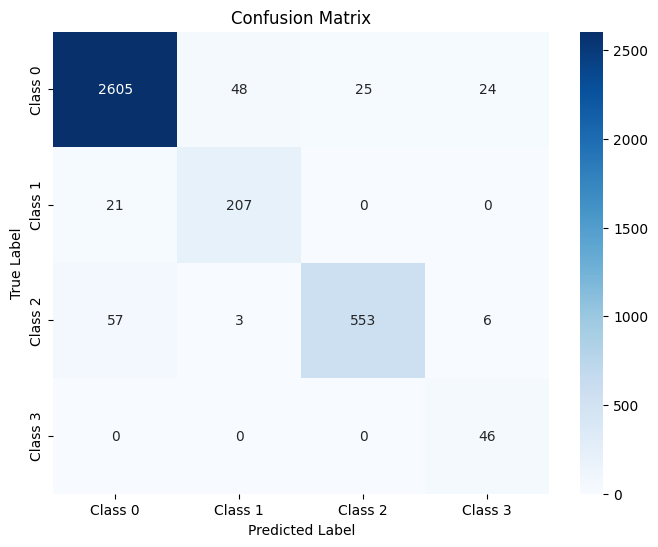

The function took 0.3105 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.96      0.96      0.96      3378
     Class 1       0.80      0.91      0.85       285
     Class 2       0.95      0.85      0.90       774
     Class 3       0.56      0.96      0.71        57

    accuracy                           0.94      4494
   macro avg       0.82      0.92      0.86      4494
weighted avg       0.94      0.94      0.94      4494



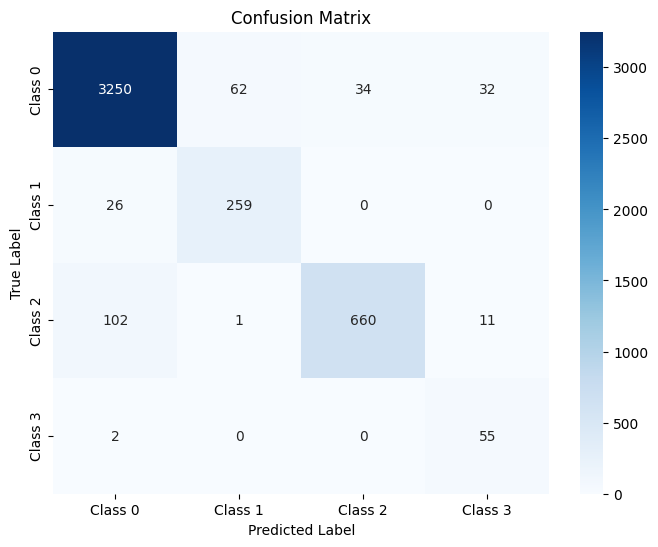

The function took 0.3741 seconds to execute.
[ARCH#034-[16, 16, 2]] done in 29.4s  best-val=0.1421


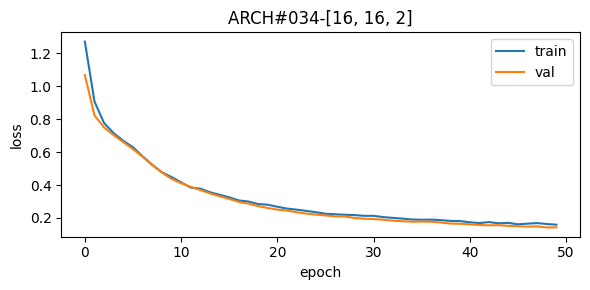


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.93      0.96     10808
     Class 1       0.71      1.00      0.83       914
     Class 2       0.97      0.87      0.92      2475
     Class 3       0.29      0.99      0.45       182

    accuracy                           0.93     14379
   macro avg       0.74      0.95      0.79     14379
weighted avg       0.95      0.93      0.94     14379



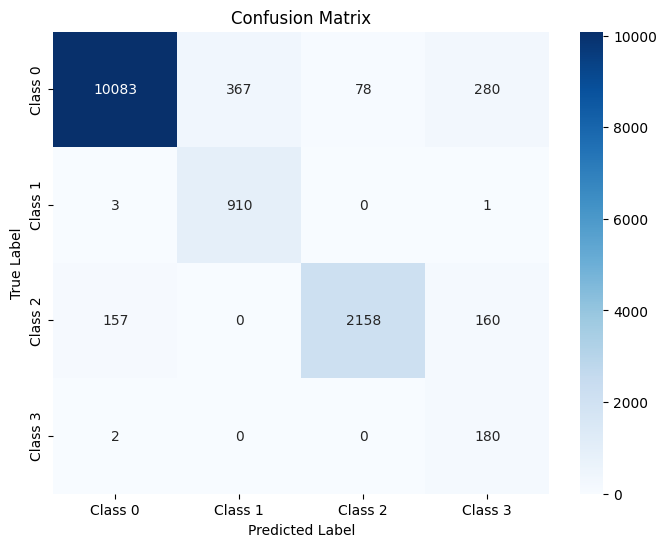

The function took 0.8413 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.93      0.96      2702
     Class 1       0.72      0.99      0.83       228
     Class 2       0.96      0.89      0.93       619
     Class 3       0.29      1.00      0.45        46

    accuracy                           0.93      3595
   macro avg       0.74      0.95      0.79      3595
weighted avg       0.96      0.93      0.94      3595



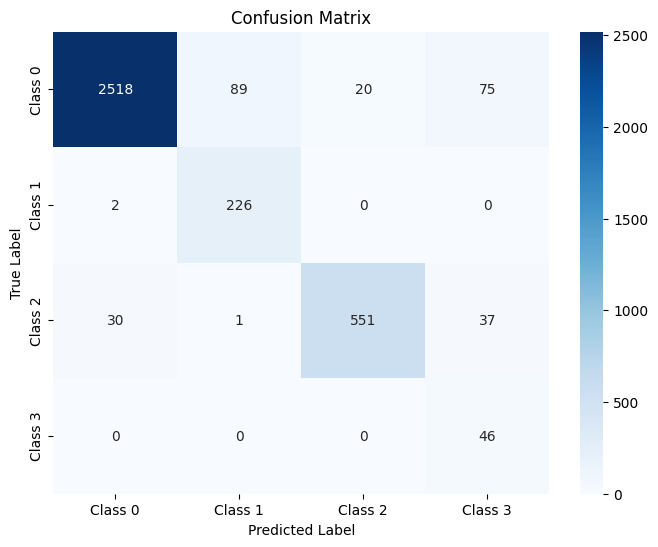

The function took 0.2716 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.93      0.96      3378
     Class 1       0.73      0.99      0.84       285
     Class 2       0.96      0.85      0.90       774
     Class 3       0.29      1.00      0.45        57

    accuracy                           0.92      4494
   macro avg       0.74      0.94      0.79      4494
weighted avg       0.95      0.92      0.93      4494



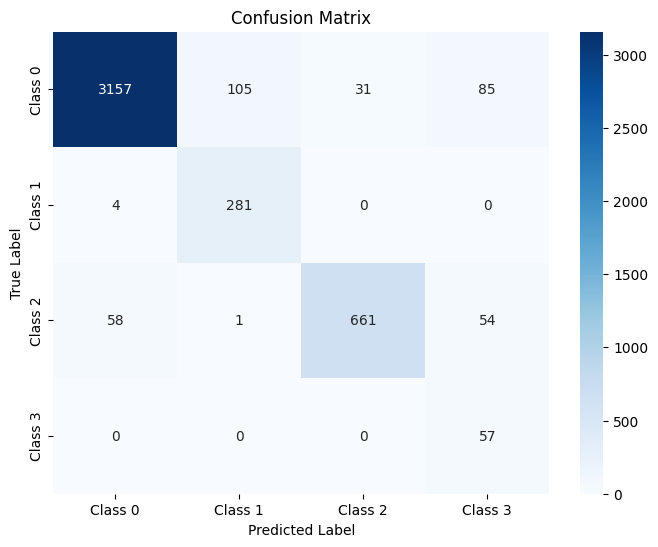

The function took 0.2922 seconds to execute.
[ARCH#035-[16, 8, 8]] done in 30.5s  best-val=0.1063


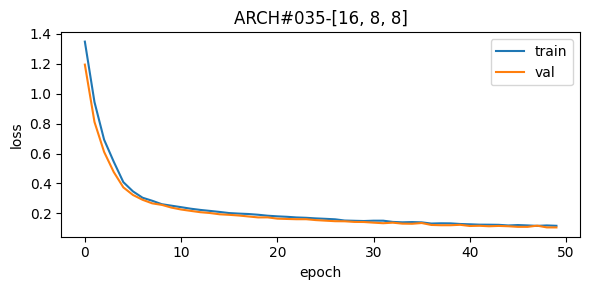


Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.94      0.97     10808
     Class 1       0.79      1.00      0.88       914
     Class 2       0.89      0.97      0.93      2475
     Class 3       0.47      0.96      0.63       182

    accuracy                           0.95     14379
   macro avg       0.79      0.97      0.85     14379
weighted avg       0.96      0.95      0.95     14379



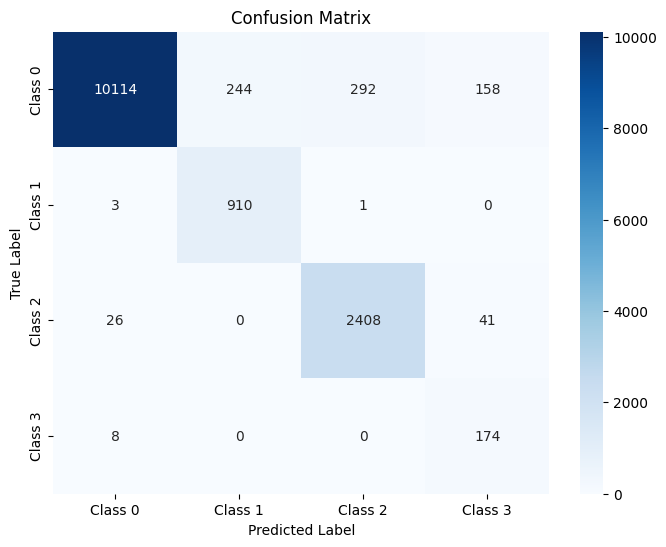

The function took 0.5596 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.94      0.97      2702
     Class 1       0.78      0.99      0.87       228
     Class 2       0.90      0.97      0.94       619
     Class 3       0.49      0.96      0.65        46

    accuracy                           0.95      3595
   macro avg       0.79      0.96      0.86      3595
weighted avg       0.96      0.95      0.95      3595



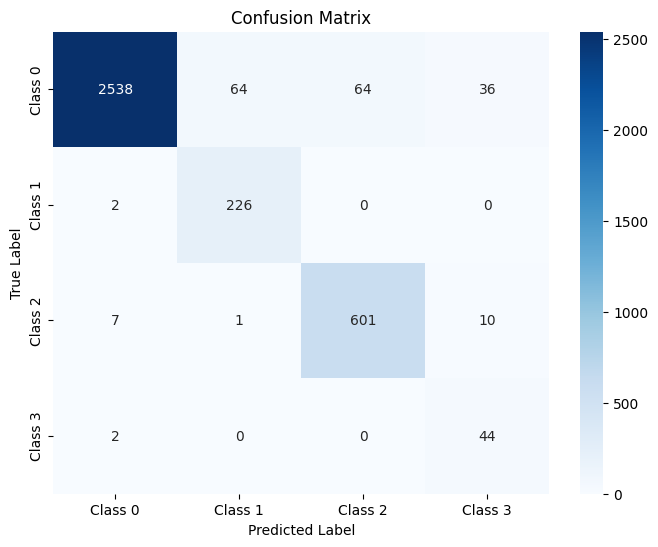

The function took 0.2995 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.94      0.96      3378
     Class 1       0.79      0.99      0.88       285
     Class 2       0.89      0.97      0.93       774
     Class 3       0.45      0.93      0.60        57

    accuracy                           0.95      4494
   macro avg       0.78      0.96      0.84      4494
weighted avg       0.96      0.95      0.95      4494



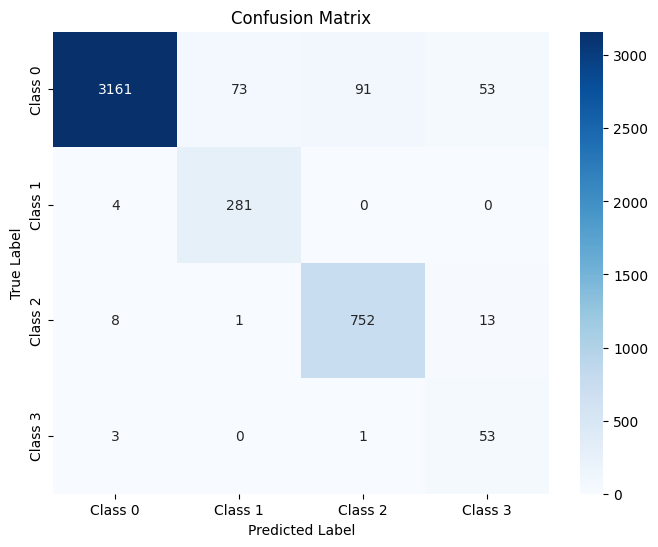

The function took 0.2959 seconds to execute.
[ARCH#036-[16, 8, 4]] done in 29.7s  best-val=0.1917


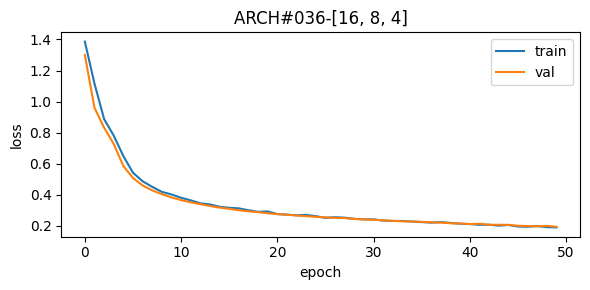


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.91      0.95     10808
     Class 1       0.89      0.91      0.90       914
     Class 2       0.80      0.99      0.89      2475
     Class 3       0.36      0.93      0.52       182

    accuracy                           0.93     14379
   macro avg       0.76      0.94      0.81     14379
weighted avg       0.95      0.93      0.93     14379



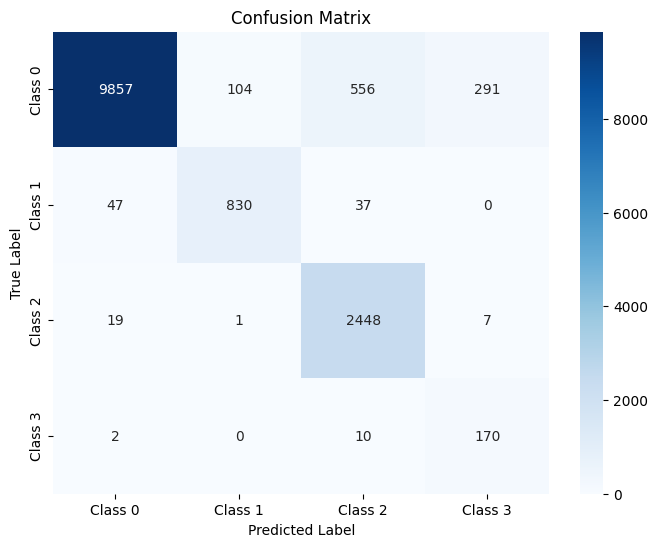

The function took 0.5363 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.91      0.95      2702
     Class 1       0.86      0.88      0.87       228
     Class 2       0.81      0.99      0.89       619
     Class 3       0.38      0.93      0.54        46

    accuracy                           0.93      3595
   macro avg       0.76      0.93      0.81      3595
weighted avg       0.94      0.93      0.93      3595



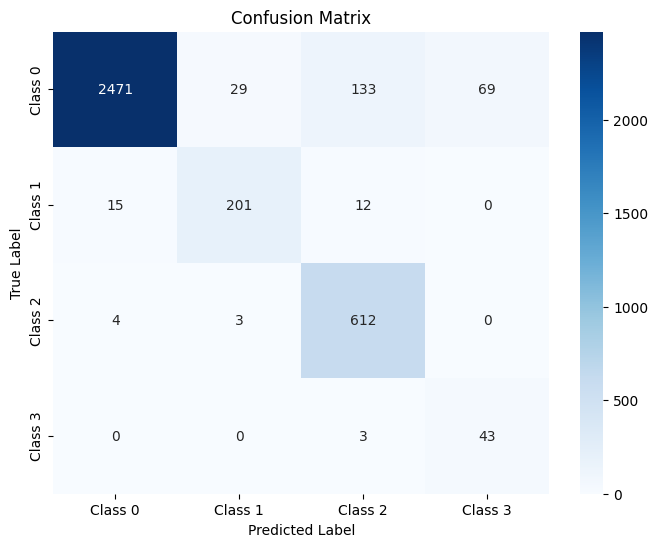

The function took 0.3712 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.92      0.95      3378
     Class 1       0.90      0.89      0.89       285
     Class 2       0.82      0.99      0.90       774
     Class 3       0.34      0.93      0.49        57

    accuracy                           0.93      4494
   macro avg       0.76      0.93      0.81      4494
weighted avg       0.95      0.93      0.93      4494



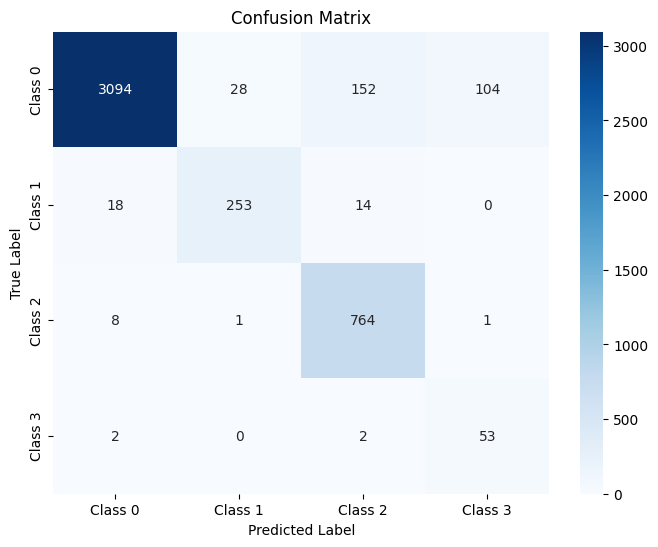

The function took 0.4099 seconds to execute.
[ARCH#037-[16, 8, 2]] done in 30.2s  best-val=0.1424


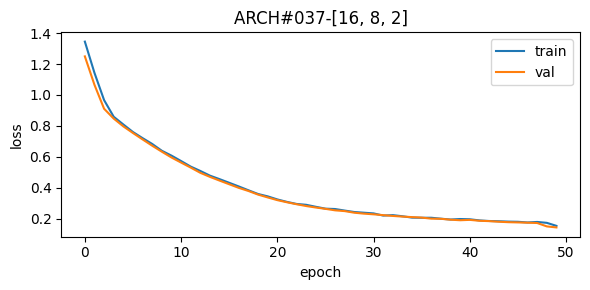


Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.93      0.96     10808
     Class 1       0.76      1.00      0.86       914
     Class 2       0.89      0.98      0.94      2475
     Class 3       0.42      0.93      0.58       182

    accuracy                           0.94     14379
   macro avg       0.77      0.96      0.83     14379
weighted avg       0.96      0.94      0.94     14379



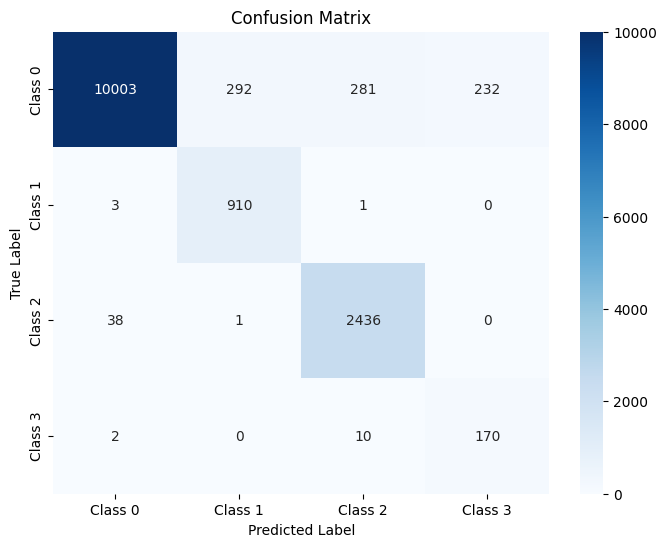

The function took 0.4739 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.93      0.96      2702
     Class 1       0.77      1.00      0.87       228
     Class 2       0.89      0.98      0.93       619
     Class 3       0.43      0.93      0.59        46

    accuracy                           0.94      3595
   macro avg       0.77      0.96      0.84      3595
weighted avg       0.96      0.94      0.95      3595



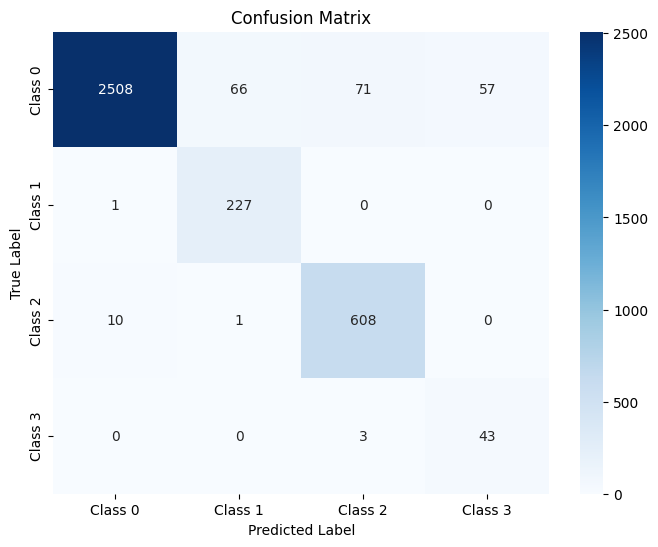

The function took 0.4134 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.93      0.96      3378
     Class 1       0.76      0.99      0.86       285
     Class 2       0.91      0.98      0.95       774
     Class 3       0.40      0.96      0.57        57

    accuracy                           0.94      4494
   macro avg       0.77      0.97      0.83      4494
weighted avg       0.96      0.94      0.95      4494



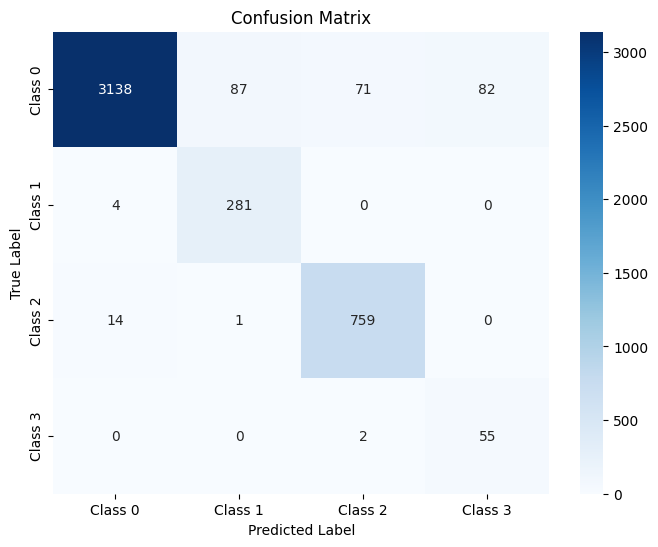

The function took 0.2865 seconds to execute.
[ARCH#038-[16, 4, 4]] done in 30.0s  best-val=0.1157


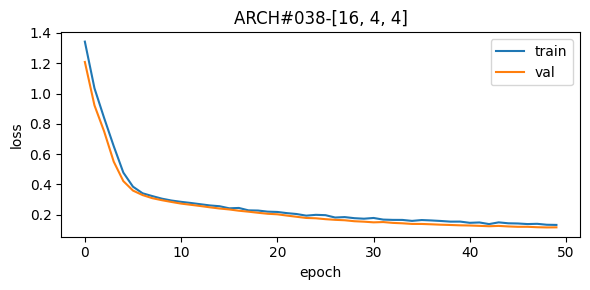


Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.92      0.96     10808
     Class 1       0.74      1.00      0.85       914
     Class 2       0.86      0.97      0.91      2475
     Class 3       0.46      0.98      0.63       182

    accuracy                           0.93     14379
   macro avg       0.76      0.97      0.84     14379
weighted avg       0.95      0.93      0.94     14379



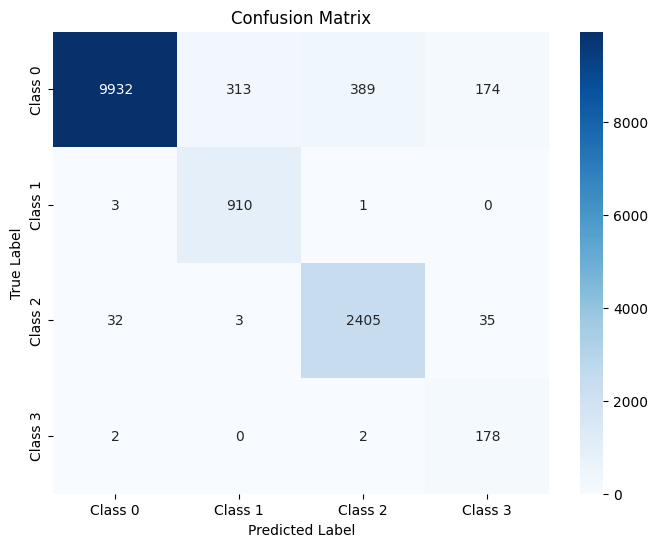

The function took 0.4636 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.92      0.96      2702
     Class 1       0.73      0.99      0.84       228
     Class 2       0.87      0.97      0.92       619
     Class 3       0.47      1.00      0.64        46

    accuracy                           0.94      3595
   macro avg       0.77      0.97      0.84      3595
weighted avg       0.95      0.94      0.94      3595



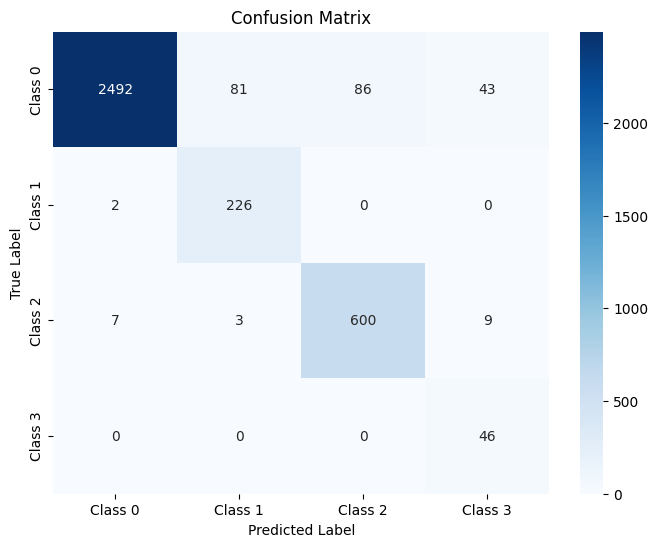

The function took 0.3011 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.92      0.96      3378
     Class 1       0.76      0.99      0.86       285
     Class 2       0.86      0.97      0.91       774
     Class 3       0.43      0.96      0.60        57

    accuracy                           0.93      4494
   macro avg       0.76      0.96      0.83      4494
weighted avg       0.95      0.93      0.94      4494



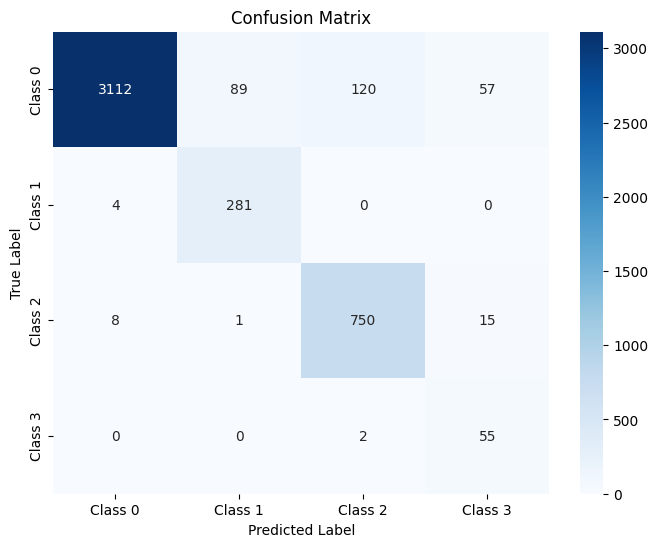

The function took 0.3044 seconds to execute.
[ARCH#039-[16, 4, 2]] done in 29.5s  best-val=0.2950


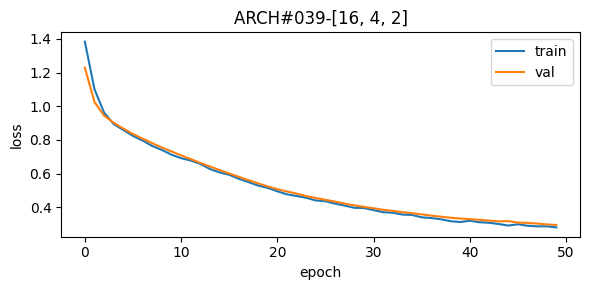


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.92      0.95     10808
     Class 1       0.76      0.90      0.82       914
     Class 2       0.82      0.96      0.88      2475
     Class 3       0.57      0.88      0.70       182

    accuracy                           0.93     14379
   macro avg       0.78      0.92      0.84     14379
weighted avg       0.94      0.93      0.93     14379



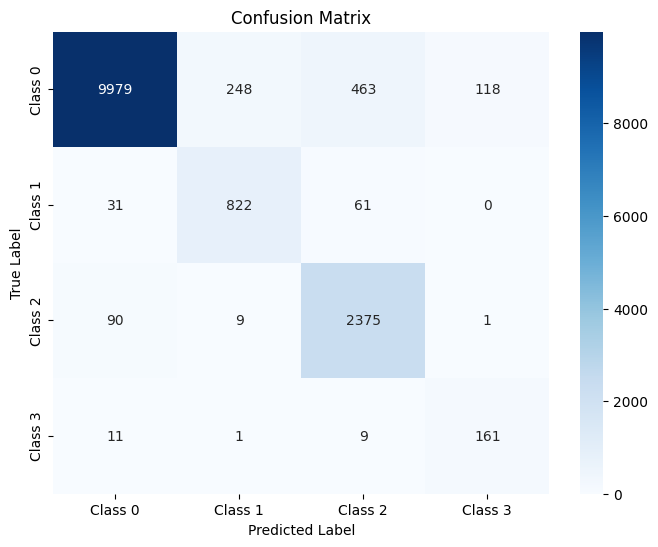

The function took 0.6160 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.92      0.95      2702
     Class 1       0.75      0.87      0.81       228
     Class 2       0.81      0.97      0.88       619
     Class 3       0.56      0.89      0.69        46

    accuracy                           0.93      3595
   macro avg       0.78      0.91      0.83      3595
weighted avg       0.94      0.93      0.93      3595



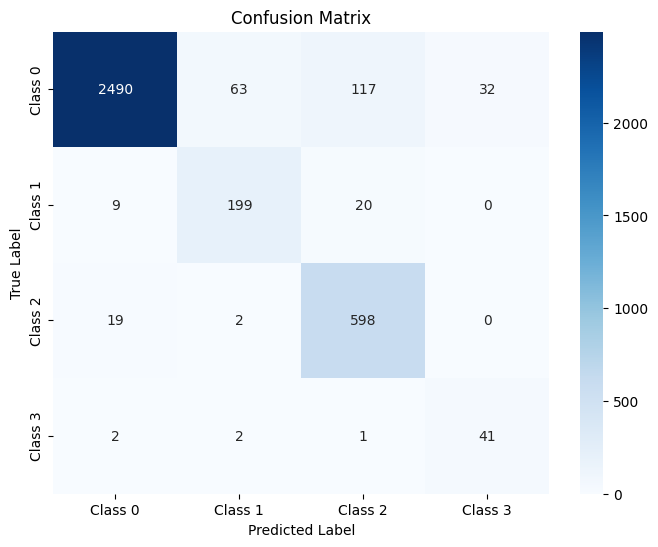

The function took 0.2770 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.93      0.95      3378
     Class 1       0.78      0.89      0.83       285
     Class 2       0.82      0.94      0.88       774
     Class 3       0.56      0.88      0.68        57

    accuracy                           0.93      4494
   macro avg       0.79      0.91      0.84      4494
weighted avg       0.94      0.93      0.93      4494



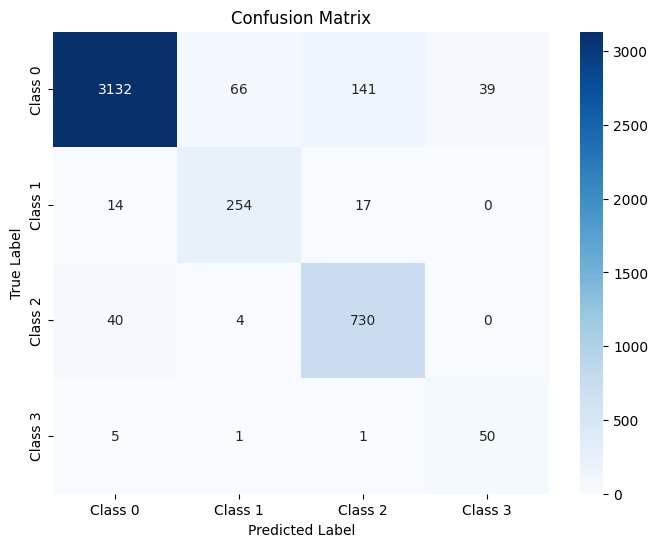

The function took 0.3102 seconds to execute.
[ARCH#040-[16, 2, 2]] done in 29.8s  best-val=0.4514


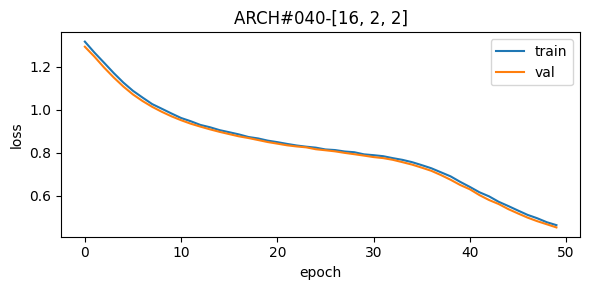


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.86      0.92     10808
     Class 1       0.82      1.00      0.90       914
     Class 2       0.75      0.96      0.84      2475
     Class 3       0.23      0.93      0.37       182

    accuracy                           0.88     14379
   macro avg       0.70      0.94      0.76     14379
weighted avg       0.93      0.88      0.90     14379



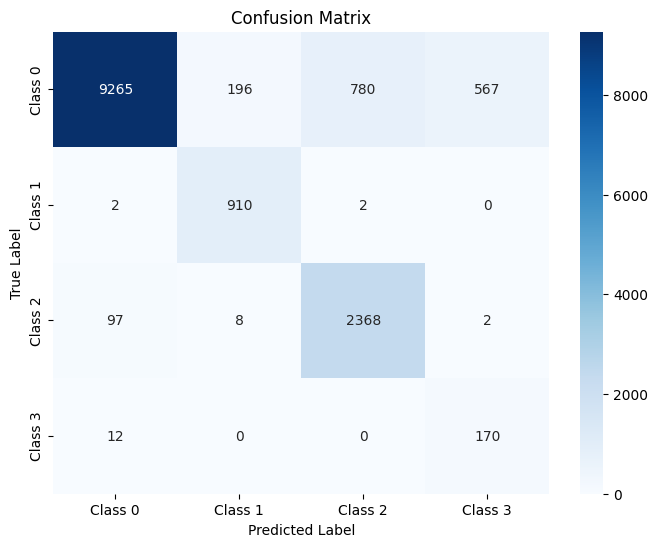

The function took 0.4693 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.87      0.92      2702
     Class 1       0.81      0.99      0.89       228
     Class 2       0.77      0.95      0.85       619
     Class 3       0.23      0.93      0.37        46

    accuracy                           0.89      3595
   macro avg       0.70      0.94      0.76      3595
weighted avg       0.93      0.89      0.90      3595



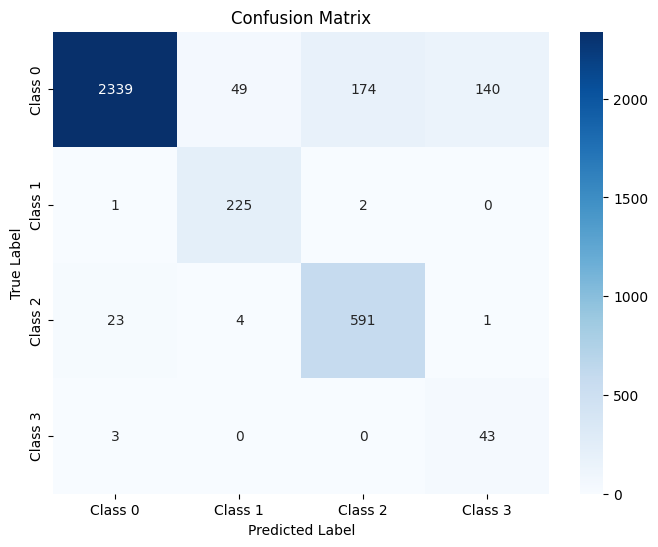

The function took 0.3479 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.86      0.92      3378
     Class 1       0.83      0.99      0.90       285
     Class 2       0.75      0.95      0.84       774
     Class 3       0.21      0.93      0.35        57

    accuracy                           0.88      4494
   macro avg       0.70      0.93      0.75      4494
weighted avg       0.93      0.88      0.90      4494



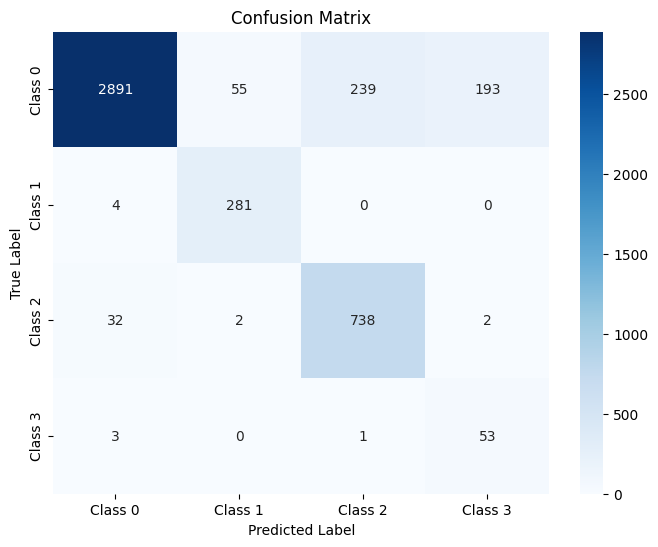

The function took 0.3490 seconds to execute.
[ARCH#041-[8, 8, 8]] done in 29.6s  best-val=0.1634


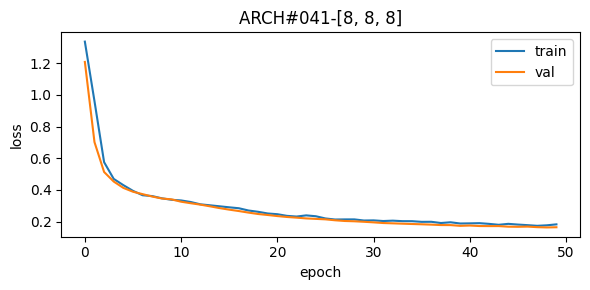


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.91      0.95     10808
     Class 1       0.60      1.00      0.75       914
     Class 2       0.89      0.94      0.91      2475
     Class 3       0.54      0.90      0.67       182

    accuracy                           0.92     14379
   macro avg       0.75      0.94      0.82     14379
weighted avg       0.94      0.92      0.92     14379



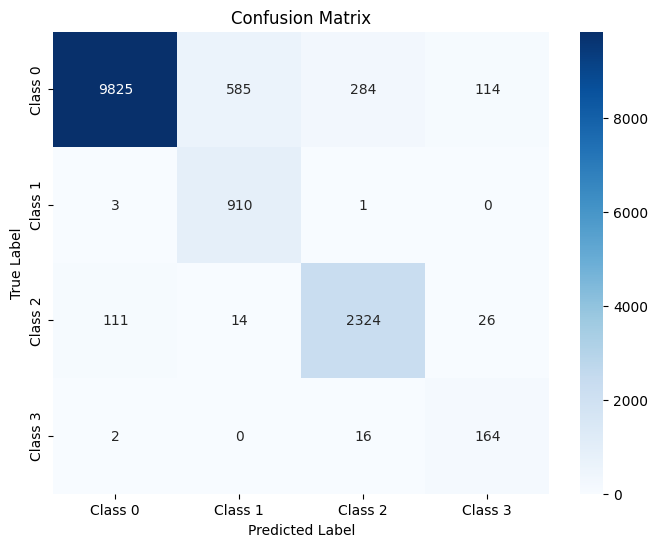

The function took 0.5695 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.91      0.95      2702
     Class 1       0.62      0.99      0.76       228
     Class 2       0.88      0.95      0.91       619
     Class 3       0.59      0.89      0.71        46

    accuracy                           0.92      3595
   macro avg       0.77      0.94      0.83      3595
weighted avg       0.94      0.92      0.93      3595



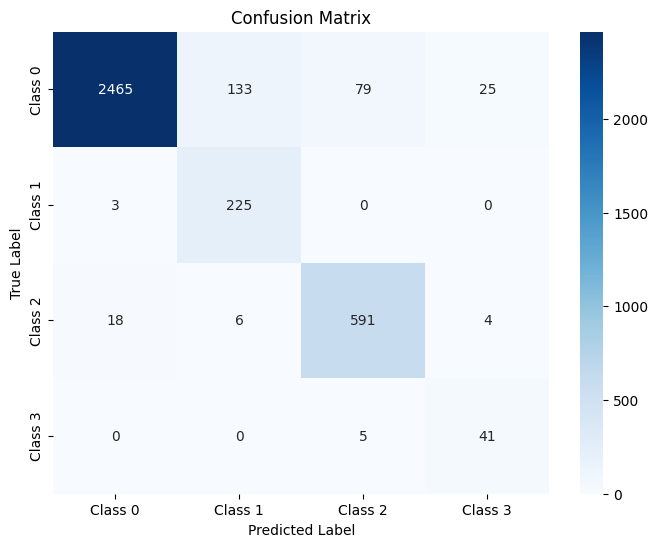

The function took 0.6768 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.91      0.94      3378
     Class 1       0.60      0.99      0.74       285
     Class 2       0.89      0.93      0.91       774
     Class 3       0.48      0.91      0.63        57

    accuracy                           0.92      4494
   macro avg       0.74      0.93      0.81      4494
weighted avg       0.94      0.92      0.92      4494



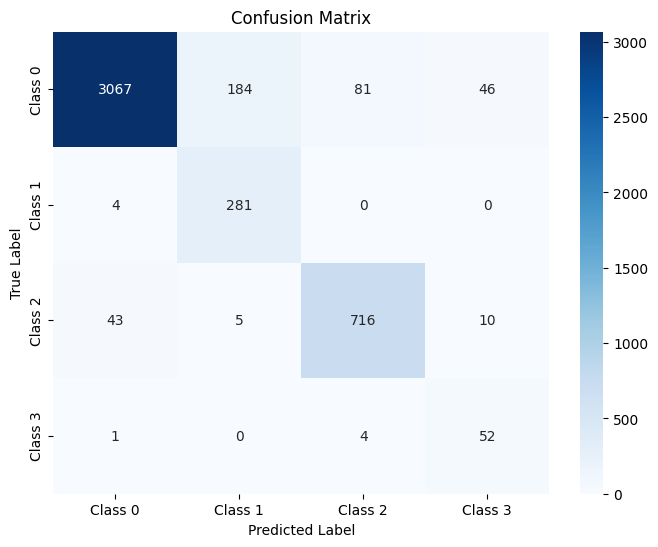

The function took 0.3033 seconds to execute.
[ARCH#042-[8, 8, 4]] done in 30.4s  best-val=0.1263


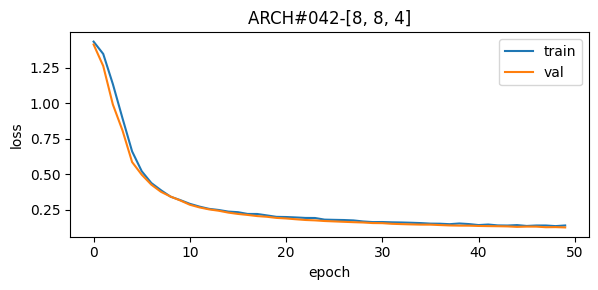


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.92      0.96     10808
     Class 1       0.70      1.00      0.82       914
     Class 2       0.90      0.97      0.93      2475
     Class 3       0.49      0.95      0.64       182

    accuracy                           0.94     14379
   macro avg       0.77      0.96      0.84     14379
weighted avg       0.95      0.94      0.94     14379



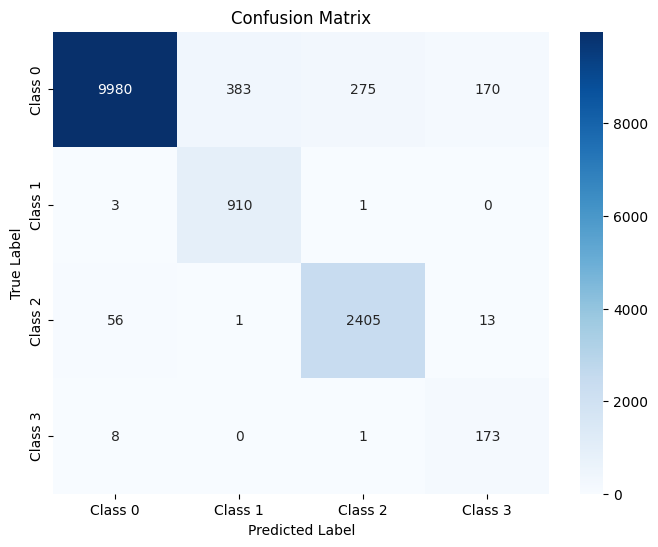

The function took 0.5735 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.92      0.96      2702
     Class 1       0.69      0.99      0.82       228
     Class 2       0.89      0.98      0.93       619
     Class 3       0.46      0.96      0.62        46

    accuracy                           0.93      3595
   macro avg       0.76      0.96      0.83      3595
weighted avg       0.95      0.93      0.94      3595



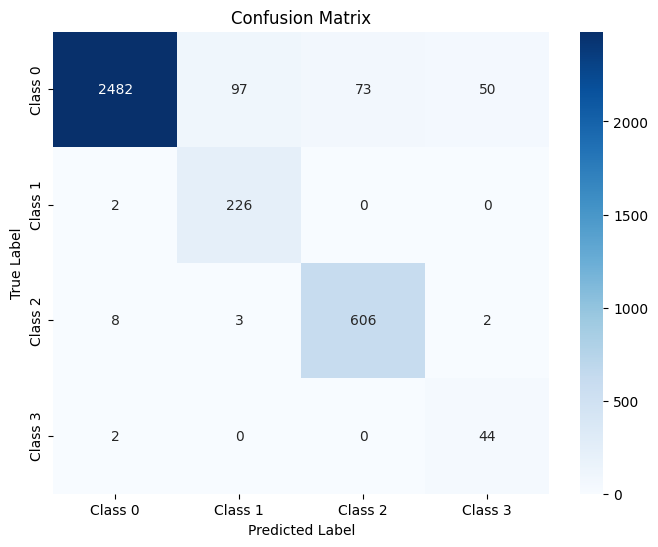

The function took 0.3223 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.92      0.96      3378
     Class 1       0.72      0.99      0.83       285
     Class 2       0.89      0.97      0.93       774
     Class 3       0.44      0.91      0.59        57

    accuracy                           0.93      4494
   macro avg       0.76      0.95      0.83      4494
weighted avg       0.95      0.93      0.94      4494



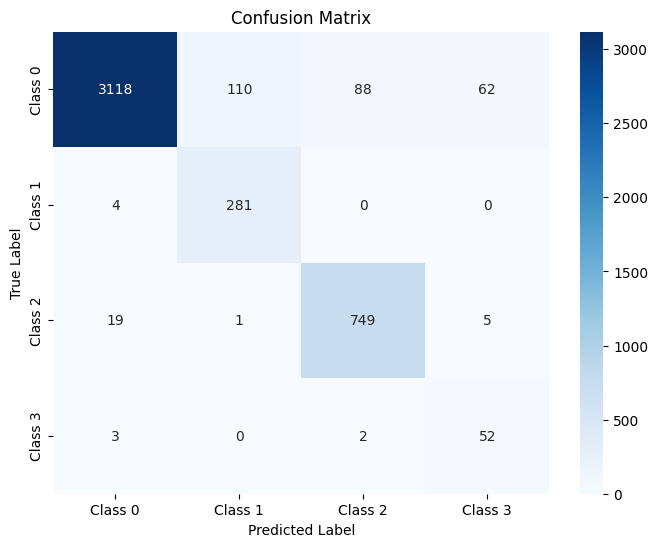

The function took 0.3011 seconds to execute.
[ARCH#043-[8, 8, 2]] done in 30.3s  best-val=0.2496


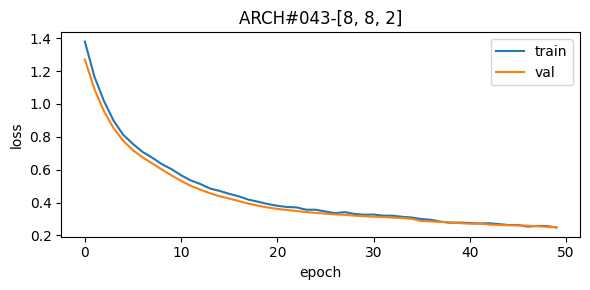


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.90      0.95     10808
     Class 1       0.82      0.96      0.88       914
     Class 2       0.97      0.89      0.93      2475
     Class 3       0.15      0.98      0.26       182

    accuracy                           0.90     14379
   macro avg       0.73      0.93      0.75     14379
weighted avg       0.97      0.90      0.93     14379



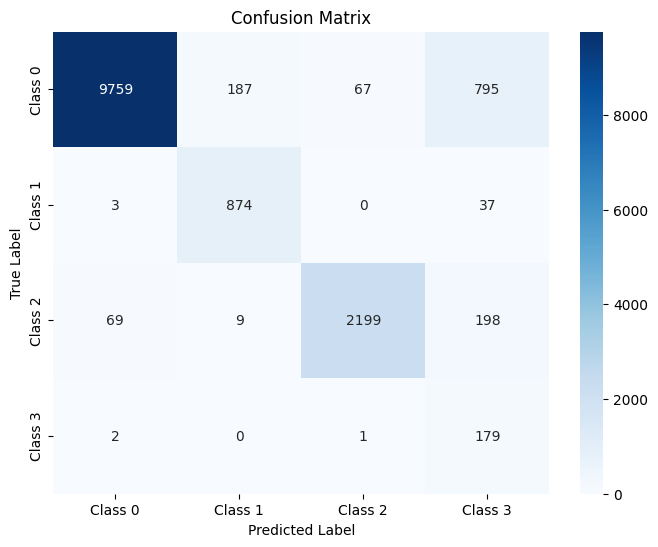

The function took 0.5983 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.90      0.94      2702
     Class 1       0.79      0.93      0.86       228
     Class 2       0.97      0.90      0.93       619
     Class 3       0.15      1.00      0.26        46

    accuracy                           0.90      3595
   macro avg       0.73      0.93      0.75      3595
weighted avg       0.97      0.90      0.93      3595



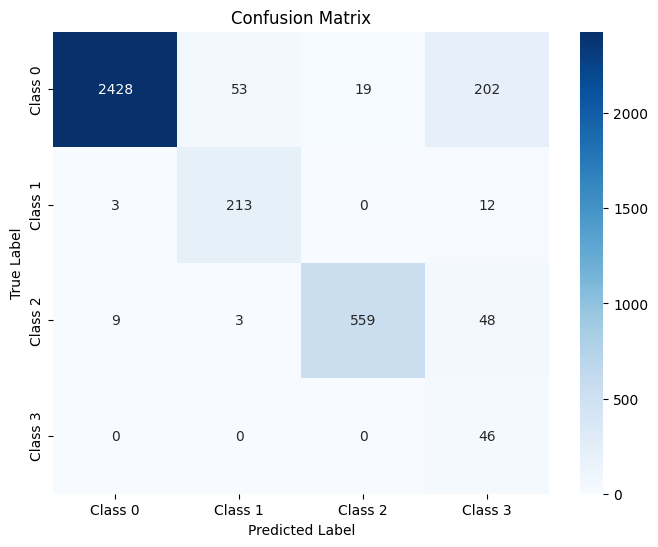

The function took 0.3106 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.91      0.95      3378
     Class 1       0.84      0.94      0.89       285
     Class 2       0.97      0.87      0.92       774
     Class 3       0.14      0.96      0.25        57

    accuracy                           0.91      4494
   macro avg       0.74      0.92      0.75      4494
weighted avg       0.97      0.91      0.93      4494



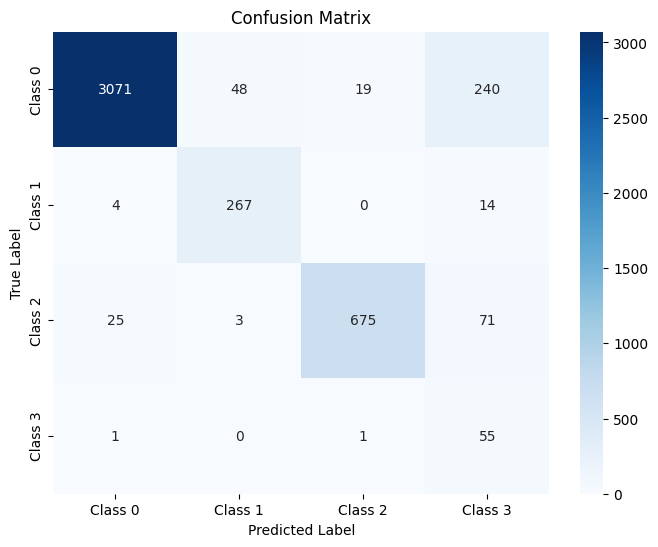

The function took 0.3016 seconds to execute.
[ARCH#044-[8, 4, 4]] done in 29.5s  best-val=0.1423


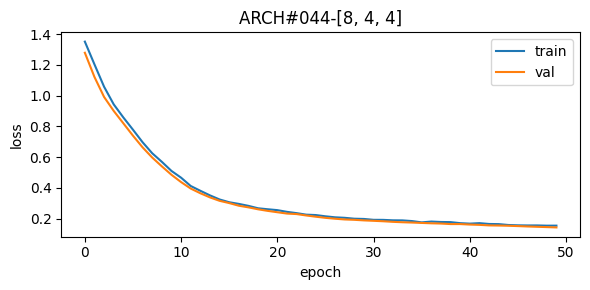


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.92      0.95     10808
     Class 1       0.64      1.00      0.78       914
     Class 2       0.90      0.95      0.92      2475
     Class 3       0.52      0.93      0.67       182

    accuracy                           0.93     14379
   macro avg       0.76      0.95      0.83     14379
weighted avg       0.95      0.93      0.93     14379



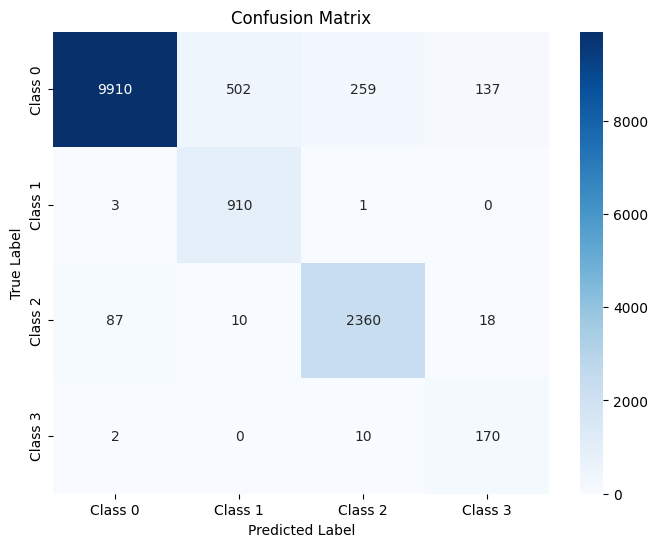

The function took 0.4718 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.92      0.95      2702
     Class 1       0.64      0.99      0.78       228
     Class 2       0.90      0.96      0.93       619
     Class 3       0.54      0.96      0.69        46

    accuracy                           0.93      3595
   macro avg       0.77      0.96      0.84      3595
weighted avg       0.95      0.93      0.93      3595



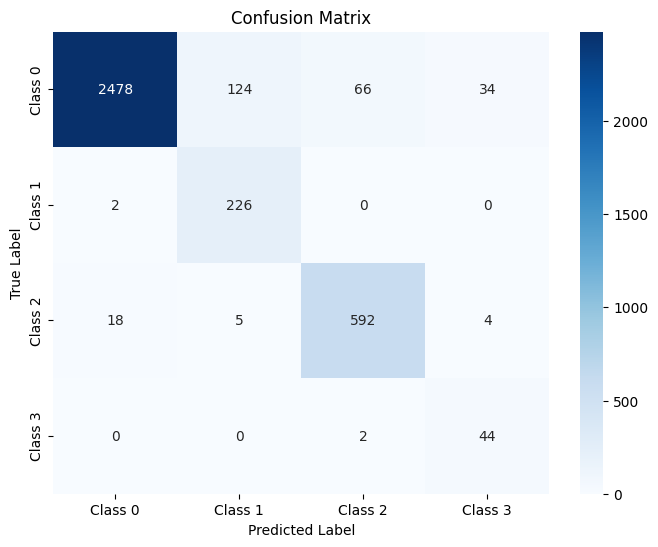

The function took 0.3276 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.92      0.95      3378
     Class 1       0.64      0.99      0.78       285
     Class 2       0.91      0.95      0.93       774
     Class 3       0.48      0.96      0.64        57

    accuracy                           0.93      4494
   macro avg       0.76      0.95      0.83      4494
weighted avg       0.95      0.93      0.93      4494



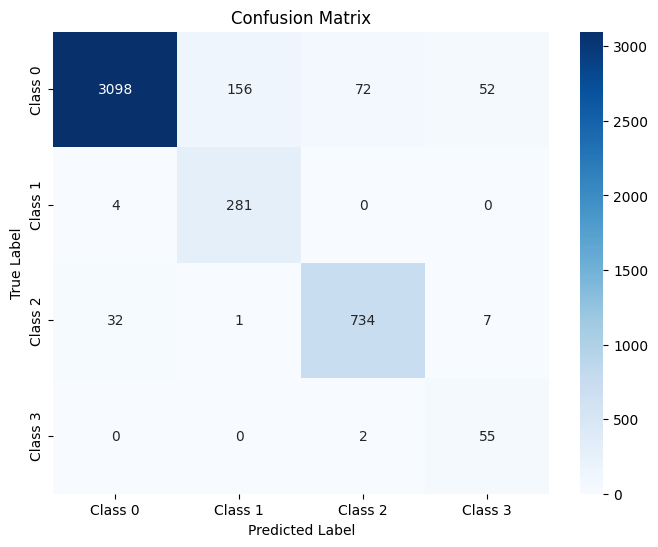

The function took 0.3081 seconds to execute.
[ARCH#045-[8, 4, 2]] done in 30.4s  best-val=0.5390


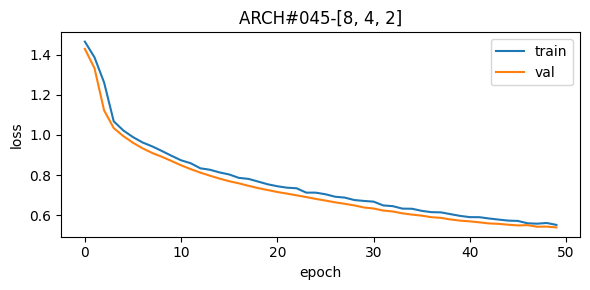


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.97      0.95      0.96     10808
     Class 1       0.69      0.98      0.81       914
     Class 2       0.92      0.86      0.89      2475
     Class 3       0.05      0.03      0.04       182

    accuracy                           0.93     14379
   macro avg       0.66      0.71      0.67     14379
weighted avg       0.93      0.93      0.93     14379



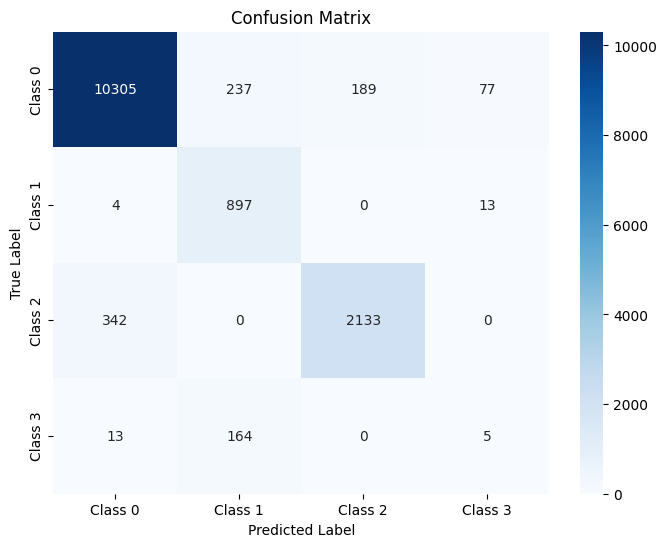

The function took 0.4809 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.97      0.96      0.96      2702
     Class 1       0.69      0.97      0.81       228
     Class 2       0.93      0.88      0.90       619
     Class 3       0.08      0.04      0.06        46

    accuracy                           0.93      3595
   macro avg       0.67      0.71      0.68      3595
weighted avg       0.93      0.93      0.93      3595



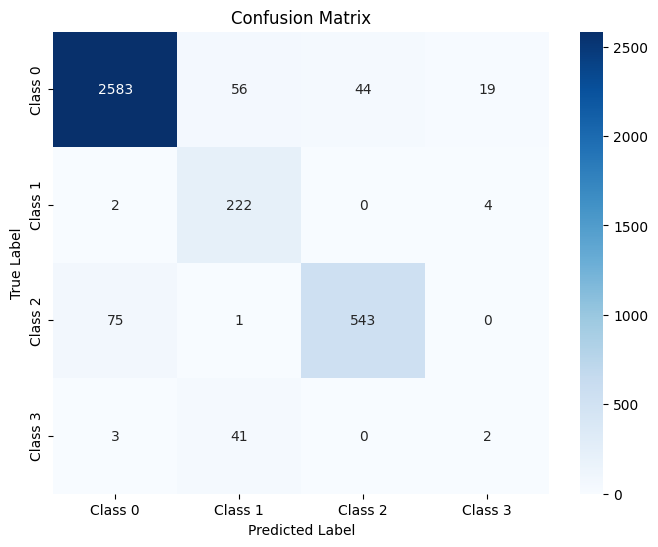

The function took 0.4312 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.96      0.95      0.95      3378
     Class 1       0.69      0.98      0.81       285
     Class 2       0.90      0.84      0.87       774
     Class 3       0.02      0.02      0.02        57

    accuracy                           0.92      4494
   macro avg       0.64      0.69      0.66      4494
weighted avg       0.92      0.92      0.92      4494



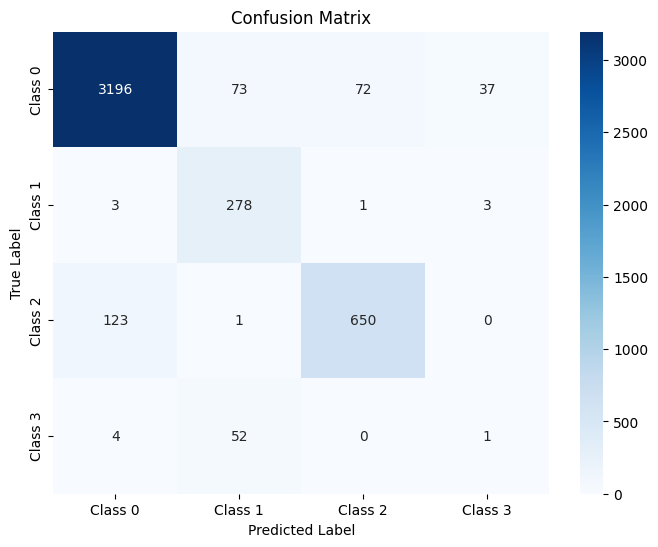

The function took 0.3109 seconds to execute.
[ARCH#046-[8, 2, 2]] done in 29.5s  best-val=0.3397


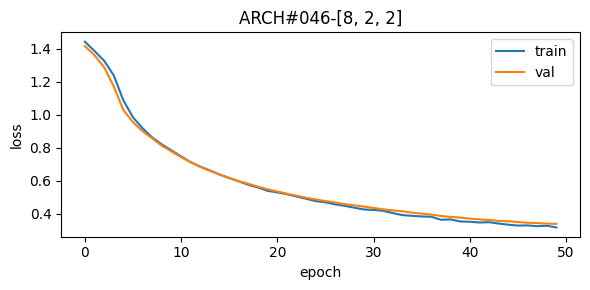


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.92      0.95     10808
     Class 1       0.87      0.96      0.91       914
     Class 2       0.83      0.97      0.89      2475
     Class 3       0.37      0.85      0.51       182

    accuracy                           0.93     14379
   macro avg       0.76      0.92      0.82     14379
weighted avg       0.94      0.93      0.93     14379



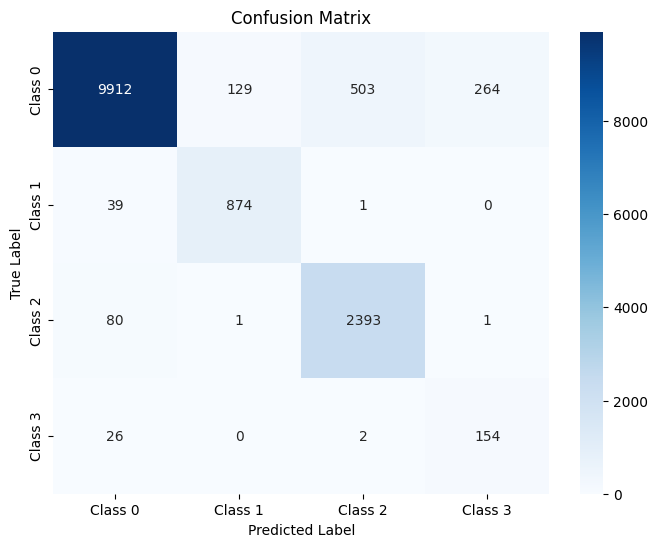

The function took 0.4666 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.91      0.95      2702
     Class 1       0.87      0.94      0.90       228
     Class 2       0.82      0.97      0.89       619
     Class 3       0.36      0.85      0.51        46

    accuracy                           0.92      3595
   macro avg       0.76      0.92      0.81      3595
weighted avg       0.94      0.92      0.93      3595



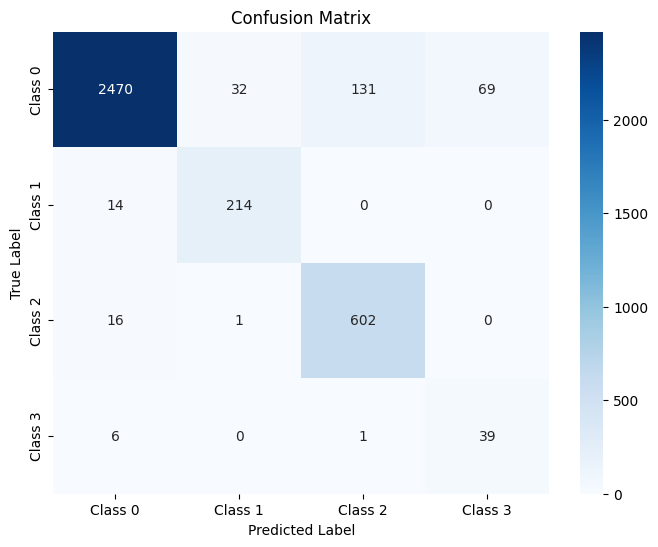

The function took 0.3601 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.92      0.95      3378
     Class 1       0.87      0.94      0.90       285
     Class 2       0.83      0.96      0.89       774
     Class 3       0.37      0.84      0.51        57

    accuracy                           0.93      4494
   macro avg       0.76      0.91      0.81      4494
weighted avg       0.94      0.93      0.93      4494



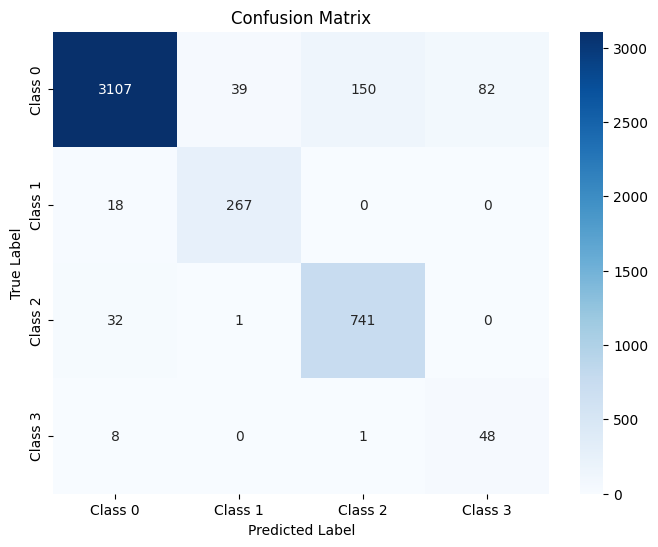

The function took 0.5109 seconds to execute.
[ARCH#047-[4, 4, 4]] done in 29.8s  best-val=0.4180


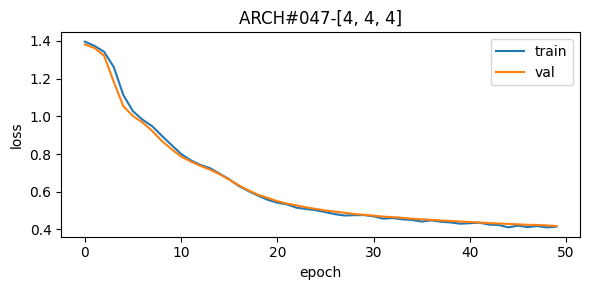


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.97      0.69      0.81     10808
     Class 1       0.81      0.86      0.84       914
     Class 2       0.43      0.89      0.58      2475
     Class 3       0.27      0.90      0.42       182

    accuracy                           0.74     14379
   macro avg       0.62      0.83      0.66     14379
weighted avg       0.86      0.74      0.76     14379



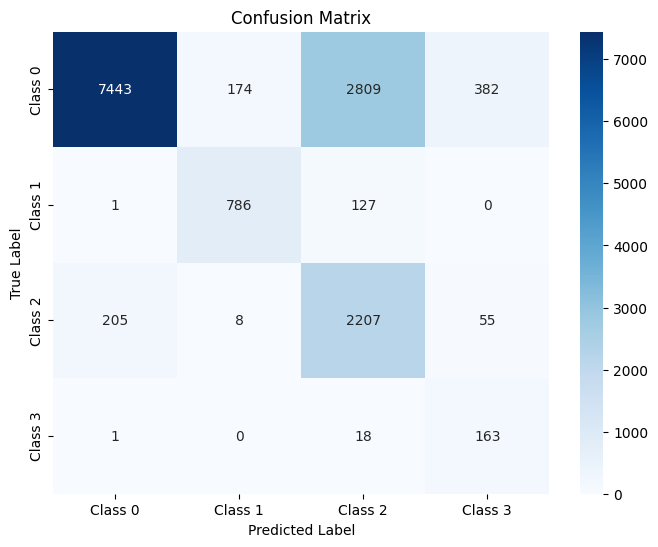

The function took 0.4808 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.97      0.69      0.81      2702
     Class 1       0.79      0.82      0.80       228
     Class 2       0.43      0.88      0.57       619
     Class 3       0.29      0.89      0.44        46

    accuracy                           0.74      3595
   macro avg       0.62      0.82      0.66      3595
weighted avg       0.86      0.74      0.76      3595



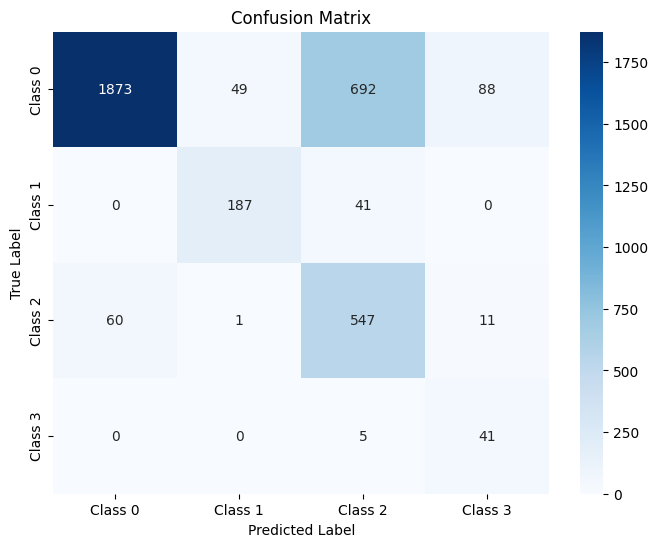

The function took 0.3610 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.97      0.68      0.80      3378
     Class 1       0.79      0.84      0.82       285
     Class 2       0.42      0.89      0.57       774
     Class 3       0.27      0.89      0.41        57

    accuracy                           0.73      4494
   macro avg       0.61      0.83      0.65      4494
weighted avg       0.86      0.73      0.76      4494



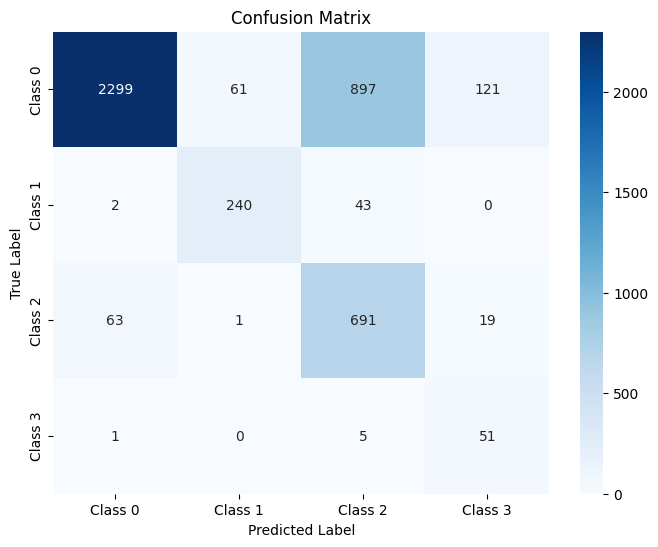

The function took 0.2980 seconds to execute.
[ARCH#048-[4, 4, 2]] done in 29.7s  best-val=0.7375


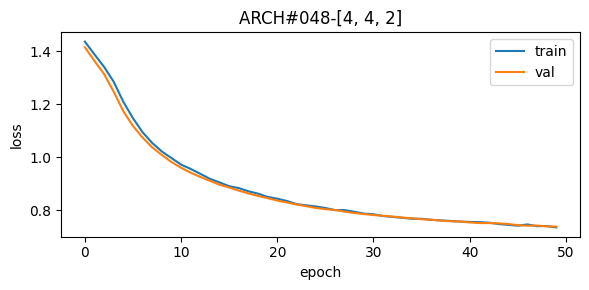


Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.81      0.90     10808
     Class 1       0.00      0.00      0.00       914
     Class 2       0.59      0.98      0.73      2475
     Class 3       0.11      0.93      0.20       182

    accuracy                           0.79     14379
   macro avg       0.42      0.68      0.46     14379
weighted avg       0.85      0.79      0.80     14379



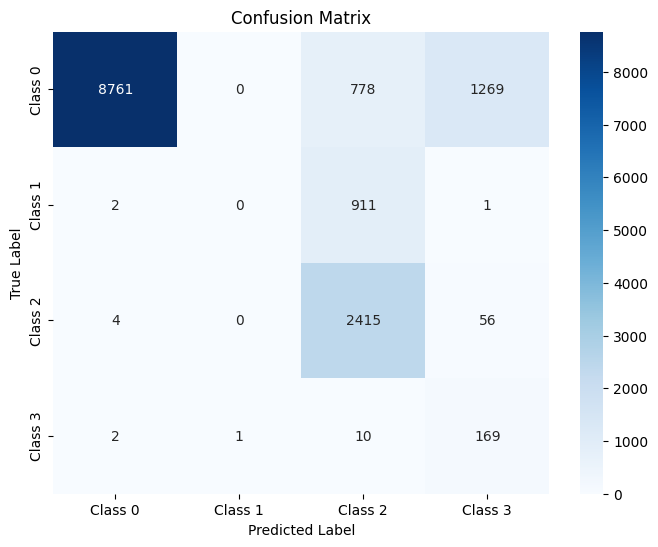

The function took 1.2138 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.83      0.90      2702
     Class 1       0.00      0.00      0.00       228
     Class 2       0.59      0.98      0.73       619
     Class 3       0.13      0.93      0.23        46

    accuracy                           0.80      3595
   macro avg       0.43      0.68      0.47      3595
weighted avg       0.85      0.80      0.81      3595



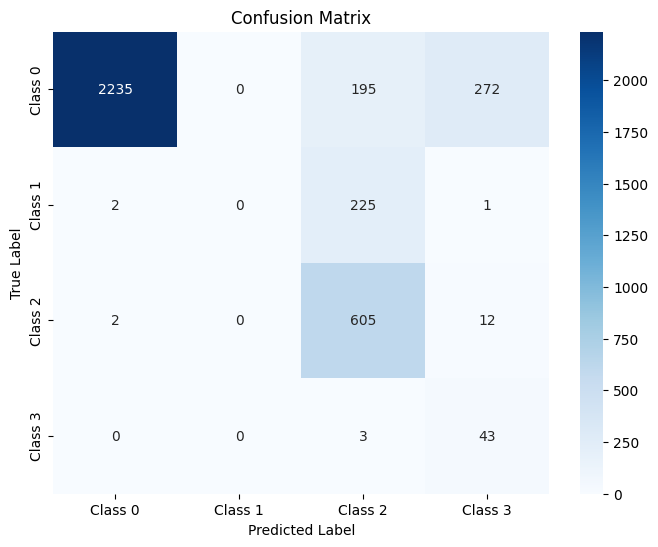

The function took 0.3016 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.81      0.90      3378
     Class 1       0.00      0.00      0.00       285
     Class 2       0.59      0.97      0.74       774
     Class 3       0.11      0.95      0.20        57

    accuracy                           0.79      4494
   macro avg       0.43      0.68      0.46      4494
weighted avg       0.85      0.79      0.80      4494



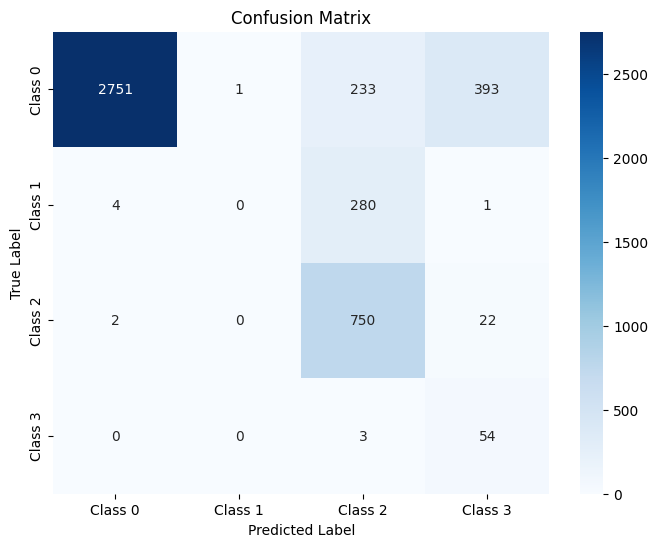

The function took 0.2913 seconds to execute.
[ARCH#049-[4, 2, 2]] done in 29.7s  best-val=0.8098


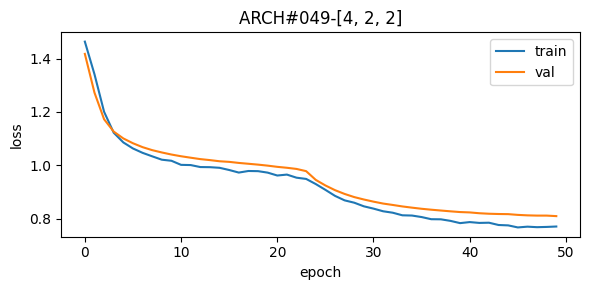


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.96      0.02      0.04     10808
     Class 1       0.87      0.86      0.86       914
     Class 2       0.20      0.99      0.33      2475
     Class 3       0.20      0.93      0.33       182

    accuracy                           0.25     14379
   macro avg       0.56      0.70      0.39     14379
weighted avg       0.82      0.25      0.15     14379



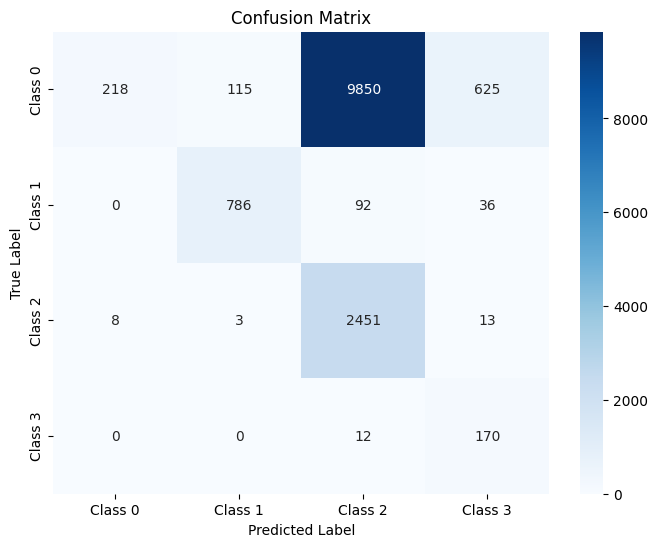

The function took 0.5697 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.97      0.02      0.04      2702
     Class 1       0.84      0.82      0.83       228
     Class 2       0.20      0.99      0.33       619
     Class 3       0.22      0.96      0.36        46

    accuracy                           0.25      3595
   macro avg       0.56      0.70      0.39      3595
weighted avg       0.82      0.25      0.14      3595



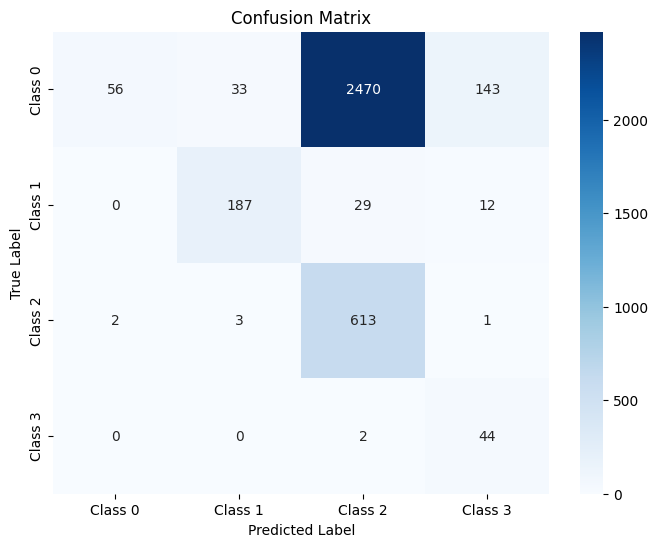

The function took 0.3471 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.94      0.02      0.04      3378
     Class 1       0.88      0.84      0.86       285
     Class 2       0.20      0.99      0.33       774
     Class 3       0.19      0.89      0.32        57

    accuracy                           0.25      4494
   macro avg       0.55      0.69      0.39      4494
weighted avg       0.80      0.25      0.15      4494



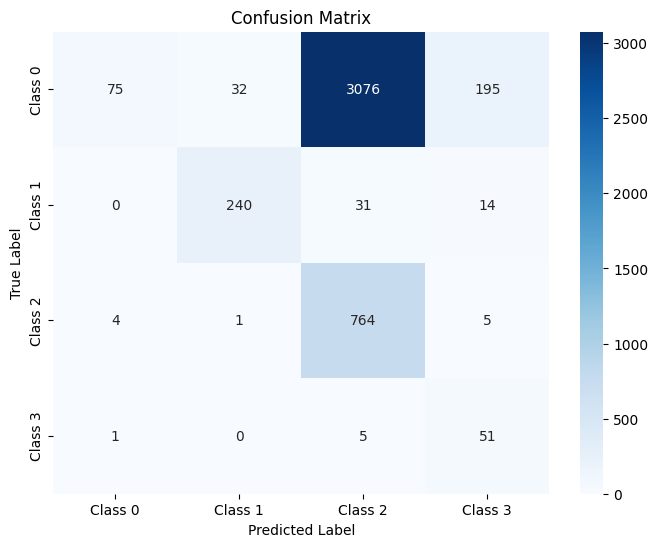

The function took 0.3459 seconds to execute.
[ARCH#050-[2, 2, 2]] early-stop @ epoch 031
[ARCH#050-[2, 2, 2]] done in 19.7s  best-val=1.3794


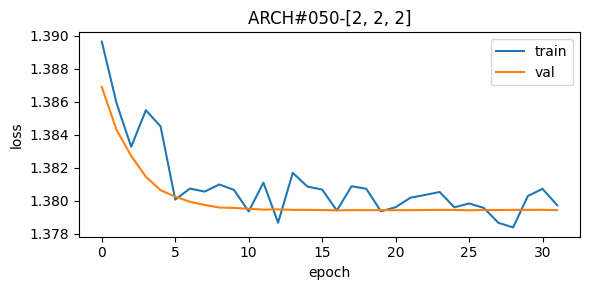


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86     10808
     Class 1       0.00      0.00      0.00       914
     Class 2       0.00      0.00      0.00      2475
     Class 3       0.00      0.00      0.00       182

    accuracy                           0.75     14379
   macro avg       0.19      0.25      0.21     14379
weighted avg       0.56      0.75      0.65     14379



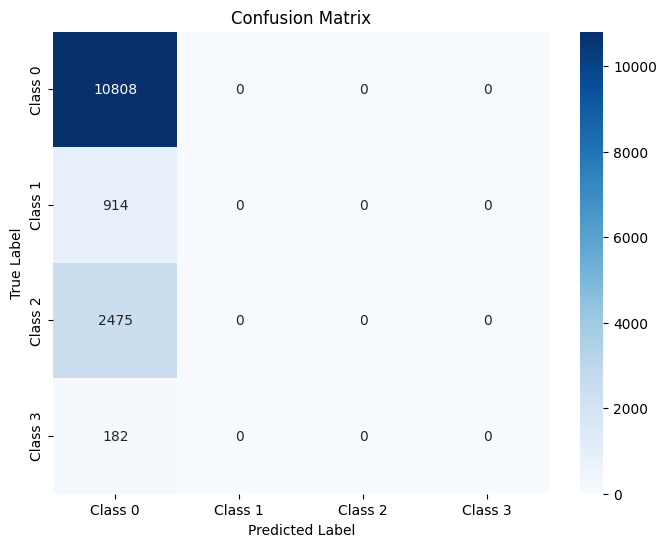

The function took 0.4996 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86      2702
     Class 1       0.00      0.00      0.00       228
     Class 2       0.00      0.00      0.00       619
     Class 3       0.00      0.00      0.00        46

    accuracy                           0.75      3595
   macro avg       0.19      0.25      0.21      3595
weighted avg       0.56      0.75      0.65      3595



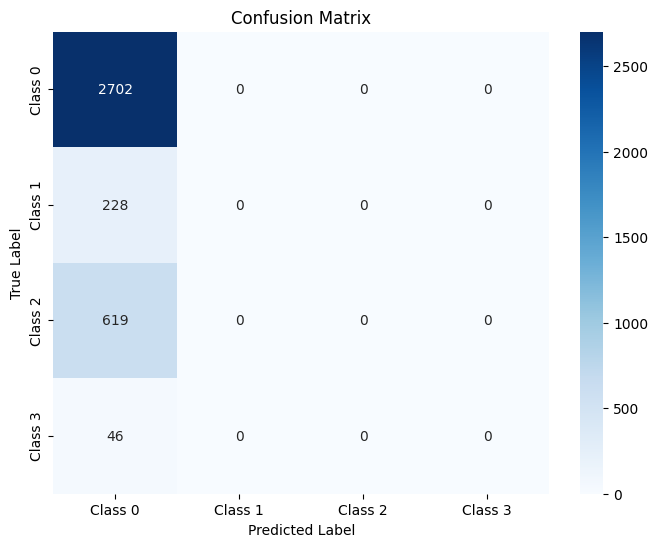

The function took 0.3818 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86      3378
     Class 1       0.00      0.00      0.00       285
     Class 2       0.00      0.00      0.00       774
     Class 3       0.00      0.00      0.00        57

    accuracy                           0.75      4494
   macro avg       0.19      0.25      0.21      4494
weighted avg       0.57      0.75      0.65      4494



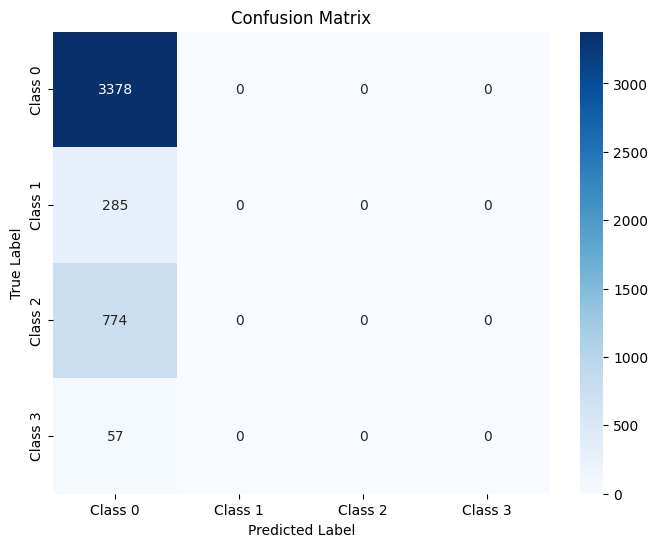

The function took 0.4281 seconds to execute.
[ARCH#051-[32, 32, 32, 32]] done in 33.2s  best-val=0.0517


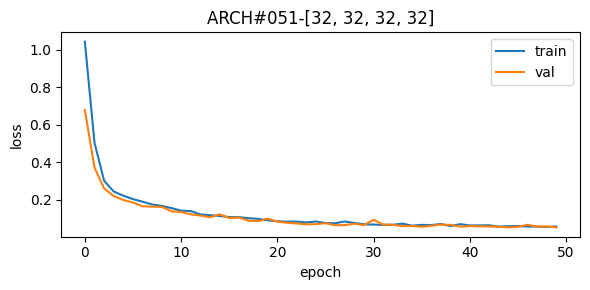


Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.96      0.98     10808
     Class 1       0.82      1.00      0.90       914
     Class 2       0.91      0.99      0.95      2475
     Class 3       0.84      0.99      0.91       182

    accuracy                           0.97     14379
   macro avg       0.89      0.99      0.93     14379
weighted avg       0.97      0.97      0.97     14379



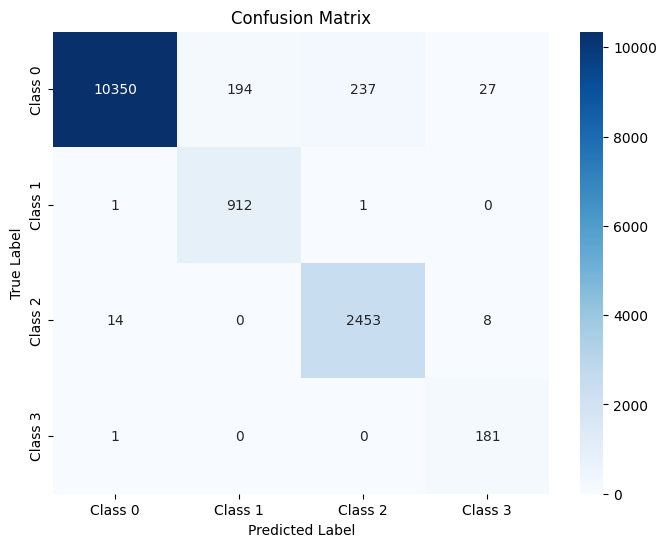

The function took 0.4920 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.96      0.98      2702
     Class 1       0.84      0.99      0.91       228
     Class 2       0.91      0.99      0.95       619
     Class 3       0.81      1.00      0.89        46

    accuracy                           0.97      3595
   macro avg       0.89      0.99      0.93      3595
weighted avg       0.97      0.97      0.97      3595



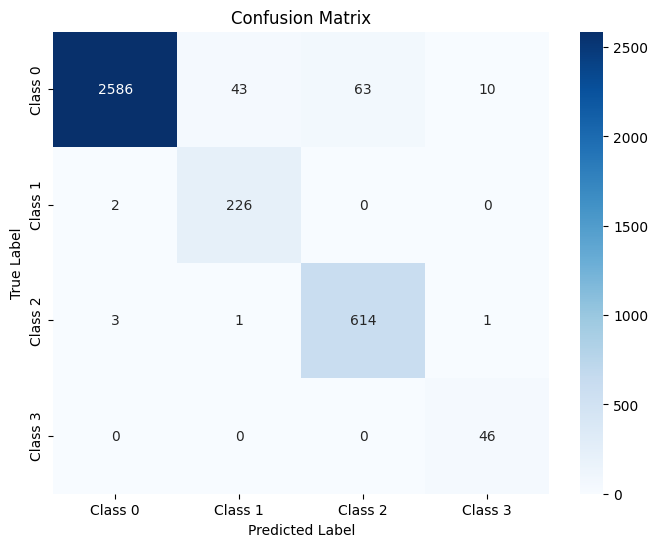

The function took 0.3606 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.96      0.98      3378
     Class 1       0.83      0.99      0.90       285
     Class 2       0.93      0.99      0.96       774
     Class 3       0.83      0.95      0.89        57

    accuracy                           0.97      4494
   macro avg       0.90      0.97      0.93      4494
weighted avg       0.97      0.97      0.97      4494



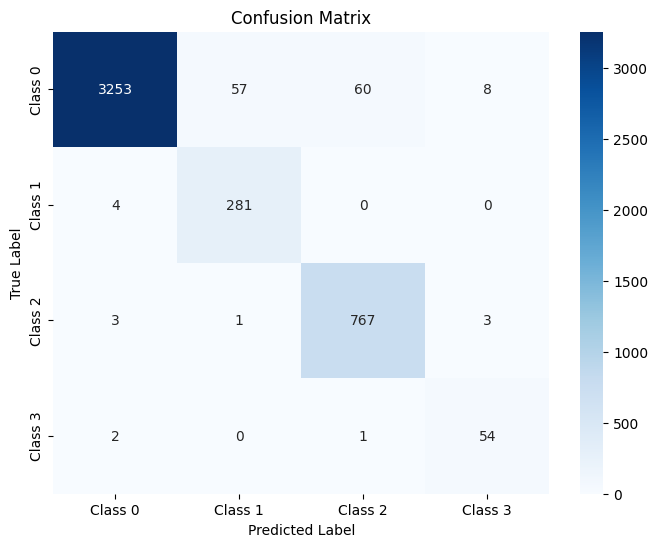

The function took 0.4334 seconds to execute.
[ARCH#052-[32, 32, 32, 16]] done in 32.8s  best-val=0.0568


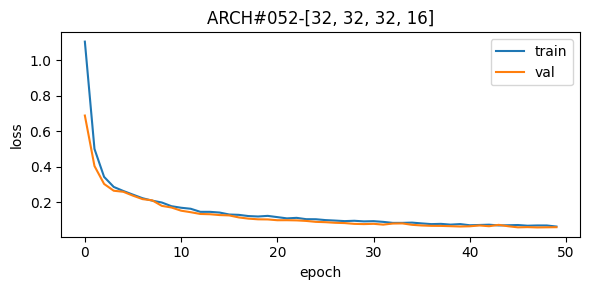


Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.96      0.98     10808
     Class 1       0.82      1.00      0.90       914
     Class 2       0.91      0.99      0.95      2475
     Class 3       0.84      0.99      0.91       182

    accuracy                           0.97     14379
   macro avg       0.89      0.98      0.93     14379
weighted avg       0.97      0.97      0.97     14379



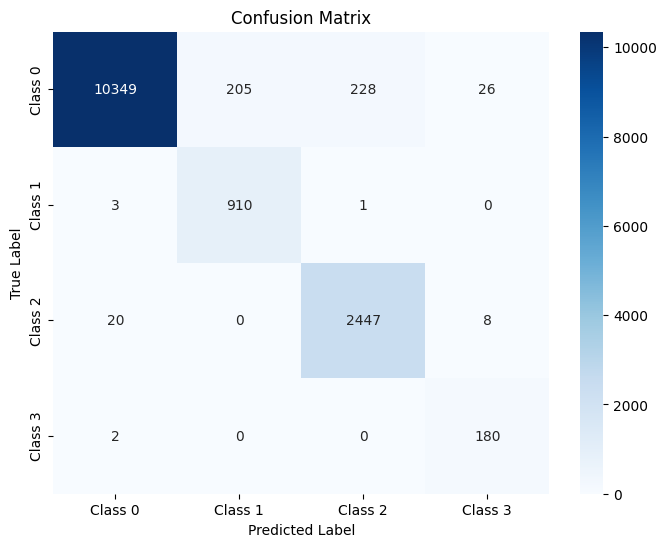

The function took 0.4549 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.96      0.98      2702
     Class 1       0.81      0.99      0.89       228
     Class 2       0.91      0.99      0.95       619
     Class 3       0.84      1.00      0.91        46

    accuracy                           0.96      3595
   macro avg       0.89      0.98      0.93      3595
weighted avg       0.97      0.96      0.97      3595



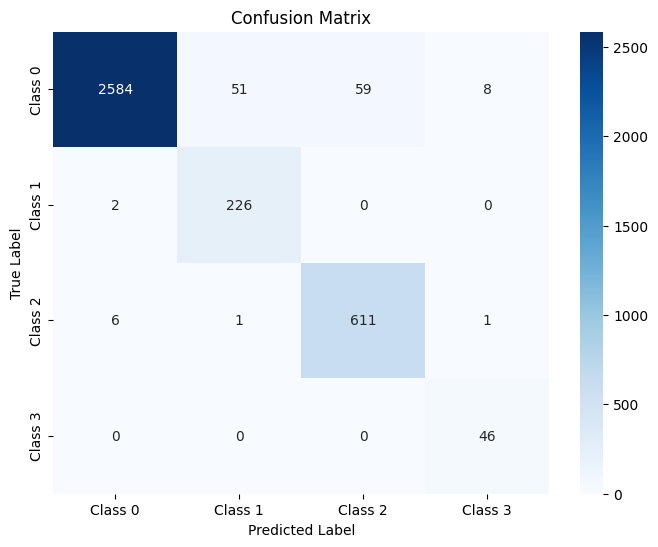

The function took 0.3527 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.97      0.98      3378
     Class 1       0.83      0.99      0.90       285
     Class 2       0.93      0.98      0.96       774
     Class 3       0.87      0.95      0.91        57

    accuracy                           0.97      4494
   macro avg       0.91      0.97      0.94      4494
weighted avg       0.97      0.97      0.97      4494



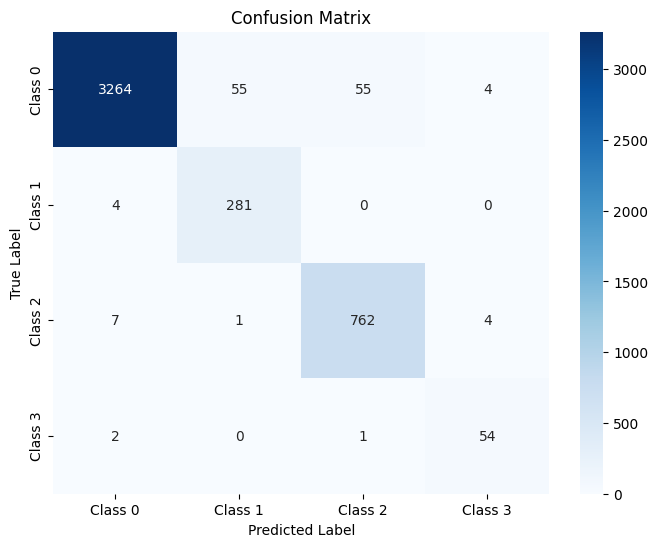

The function took 0.3279 seconds to execute.
[ARCH#053-[32, 32, 32, 8]] done in 32.1s  best-val=0.0729


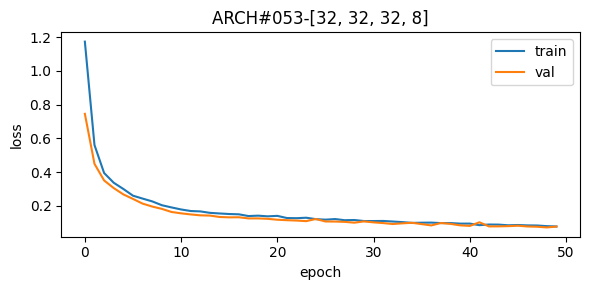


Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.94      0.97     10808
     Class 1       0.81      1.00      0.89       914
     Class 2       0.89      0.99      0.94      2475
     Class 3       0.69      0.99      0.81       182

    accuracy                           0.96     14379
   macro avg       0.85      0.98      0.90     14379
weighted avg       0.96      0.96      0.96     14379



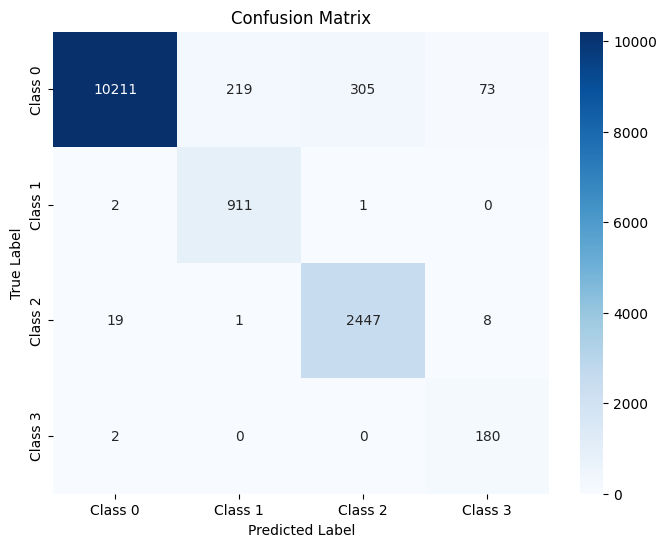

The function took 0.5366 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.94      0.97      2702
     Class 1       0.81      0.99      0.89       228
     Class 2       0.88      0.98      0.93       619
     Class 3       0.71      0.96      0.81        46

    accuracy                           0.95      3595
   macro avg       0.85      0.97      0.90      3595
weighted avg       0.96      0.95      0.95      3595



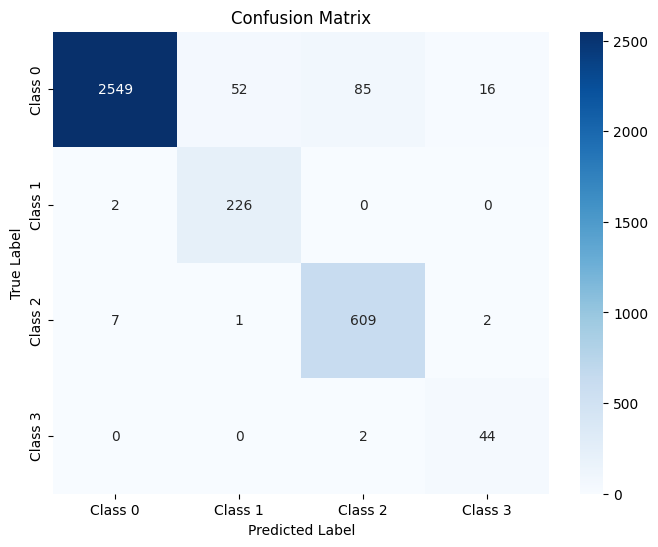

The function took 0.6098 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.95      0.97      3378
     Class 1       0.82      0.99      0.90       285
     Class 2       0.90      0.99      0.94       774
     Class 3       0.70      0.95      0.81        57

    accuracy                           0.96      4494
   macro avg       0.86      0.97      0.90      4494
weighted avg       0.97      0.96      0.96      4494



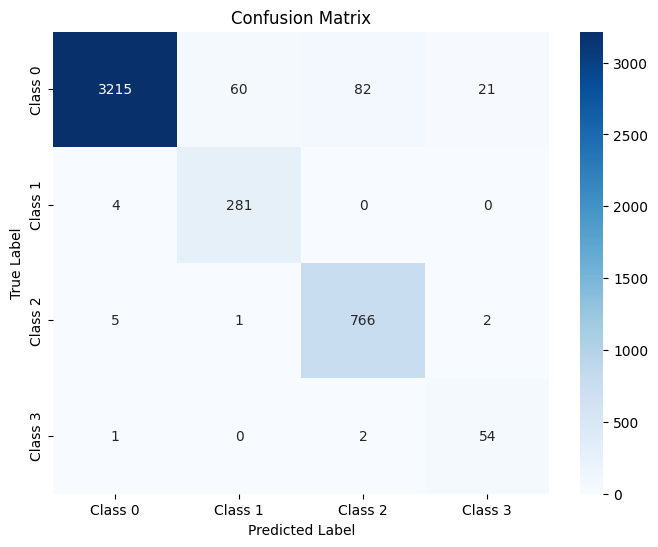

The function took 0.4486 seconds to execute.
[ARCH#054-[32, 32, 32, 4]] done in 32.6s  best-val=0.0850


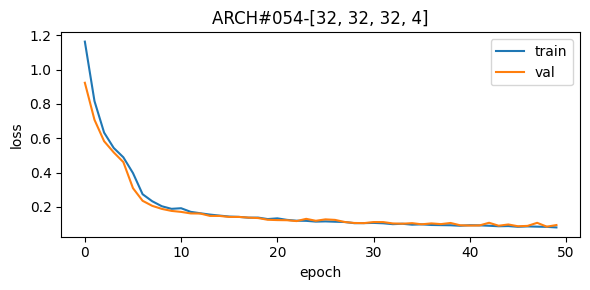


Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.95      0.97     10808
     Class 1       0.88      0.96      0.92       914
     Class 2       0.88      0.99      0.93      2475
     Class 3       0.52      0.99      0.69       182

    accuracy                           0.96     14379
   macro avg       0.82      0.97      0.88     14379
weighted avg       0.97      0.96      0.96     14379



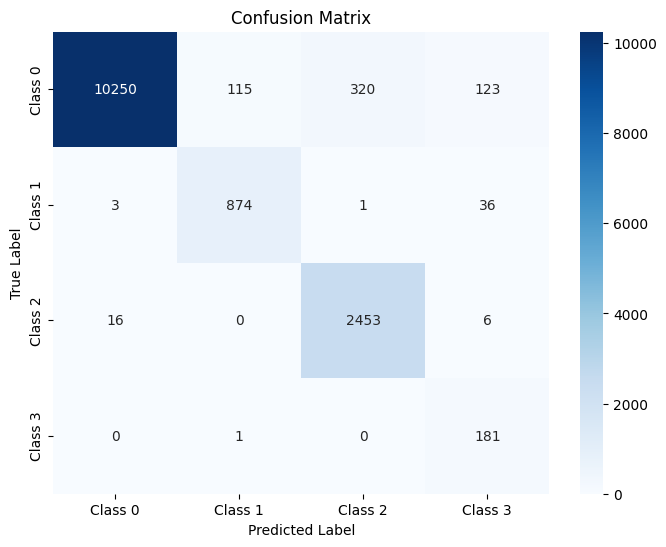

The function took 0.4981 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.95      0.97      2702
     Class 1       0.88      0.94      0.91       228
     Class 2       0.88      0.99      0.93       619
     Class 3       0.51      1.00      0.67        46

    accuracy                           0.96      3595
   macro avg       0.82      0.97      0.87      3595
weighted avg       0.96      0.96      0.96      3595



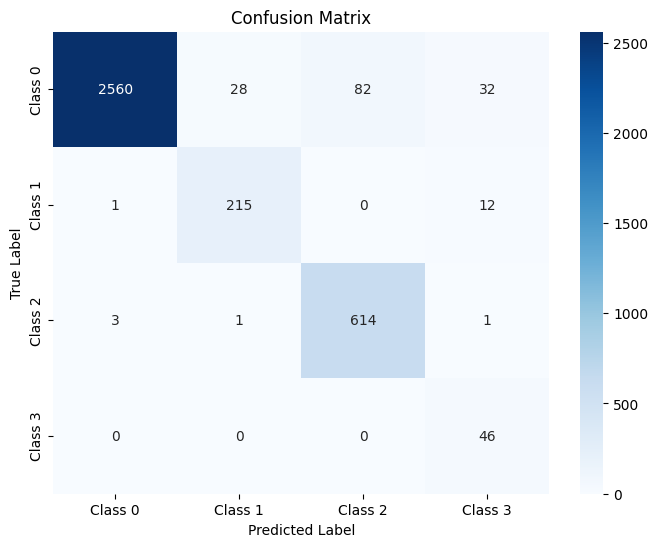

The function took 0.3431 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.95      0.97      3378
     Class 1       0.88      0.94      0.91       285
     Class 2       0.88      0.99      0.93       774
     Class 3       0.50      0.96      0.66        57

    accuracy                           0.96      4494
   macro avg       0.82      0.96      0.87      4494
weighted avg       0.96      0.96      0.96      4494



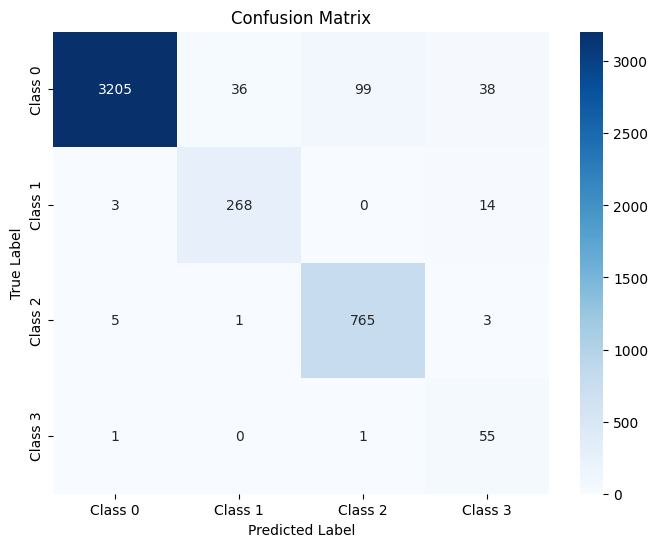

The function took 0.4385 seconds to execute.
[ARCH#055-[32, 32, 32, 2]] done in 32.7s  best-val=0.5265


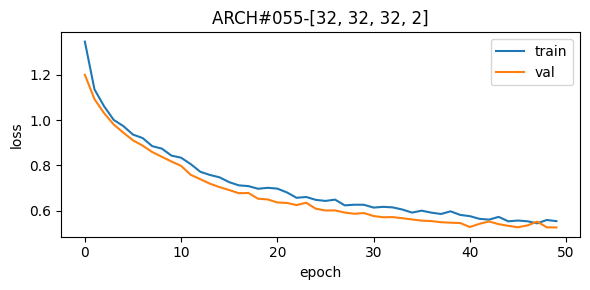


Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.87      0.93     10808
     Class 1       0.45      1.00      0.62       914
     Class 2       0.84      0.99      0.91      2475
     Class 3       0.10      0.03      0.05       182

    accuracy                           0.89     14379
   macro avg       0.60      0.72      0.63     14379
weighted avg       0.93      0.89      0.90     14379



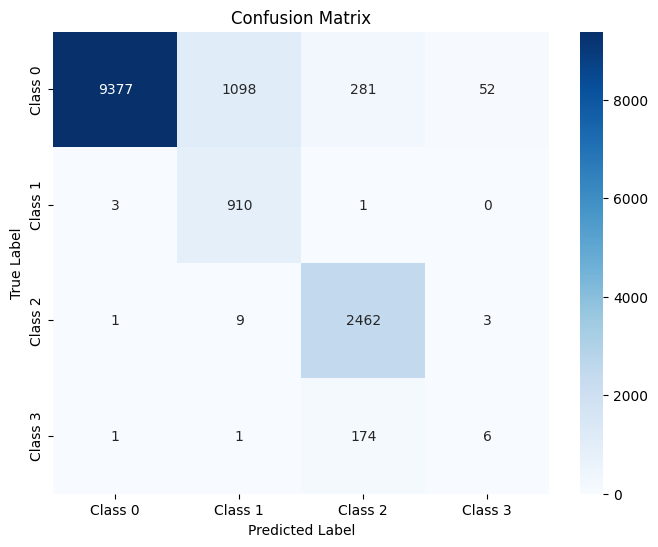

The function took 0.5047 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.87      0.93      2702
     Class 1       0.47      1.00      0.63       228
     Class 2       0.84      0.99      0.91       619
     Class 3       0.12      0.04      0.06        46

    accuracy                           0.89      3595
   macro avg       0.61      0.73      0.64      3595
weighted avg       0.93      0.89      0.90      3595



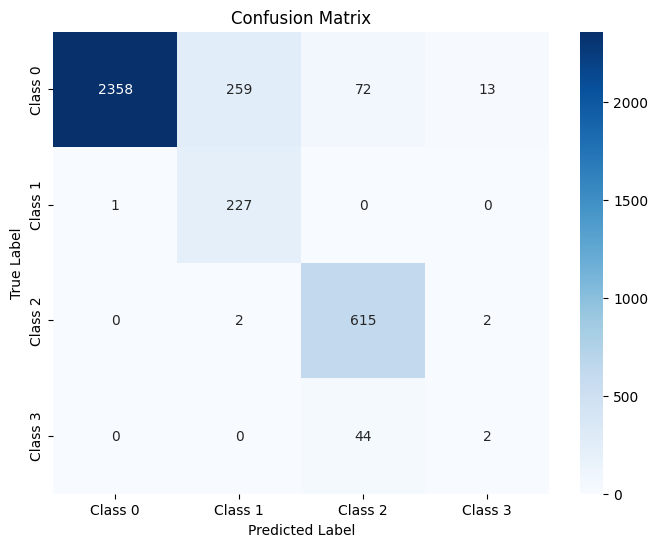

The function took 0.7168 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.87      0.93      3378
     Class 1       0.44      0.99      0.61       285
     Class 2       0.86      0.99      0.92       774
     Class 3       0.22      0.07      0.11        57

    accuracy                           0.89      4494
   macro avg       0.63      0.73      0.64      4494
weighted avg       0.93      0.89      0.90      4494



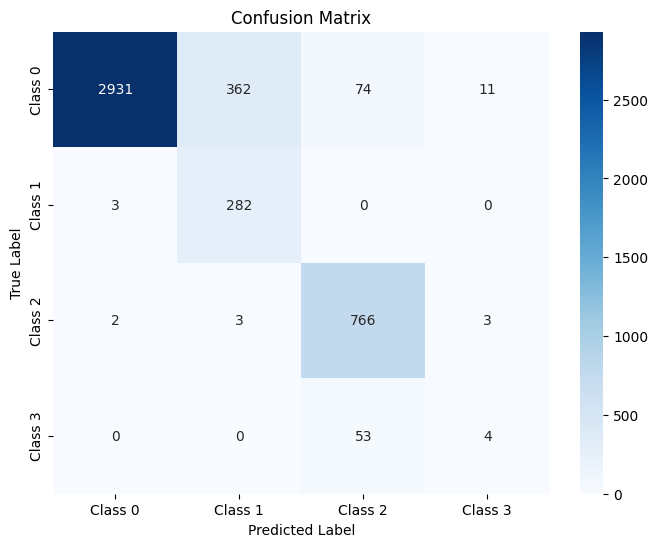

The function took 0.3258 seconds to execute.
[ARCH#056-[32, 32, 16, 16]] done in 33.2s  best-val=0.0562


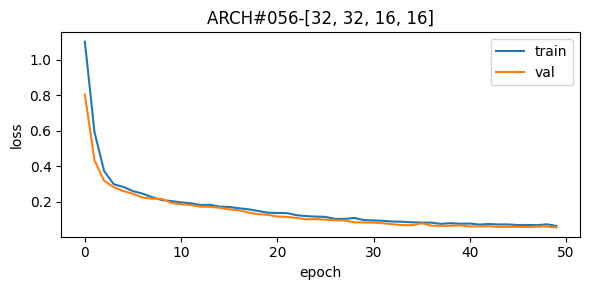


Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.96      0.98     10808
     Class 1       0.83      1.00      0.90       914
     Class 2       0.91      0.99      0.95      2475
     Class 3       0.79      0.99      0.88       182

    accuracy                           0.96     14379
   macro avg       0.88      0.98      0.93     14379
weighted avg       0.97      0.96      0.97     14379



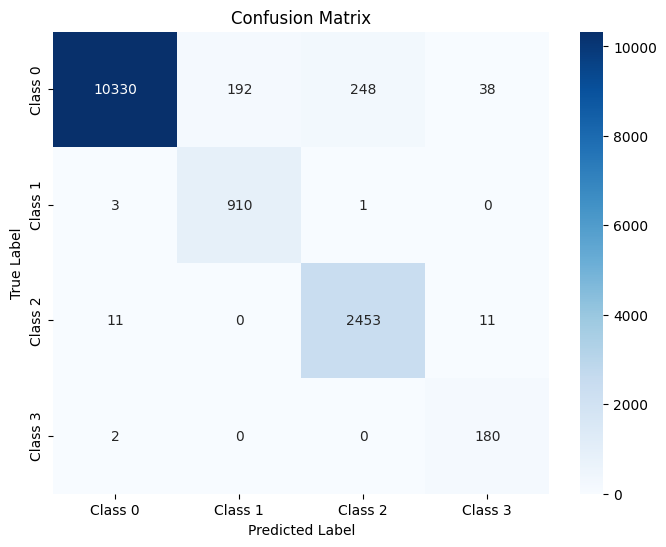

The function took 0.5324 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.95      0.98      2702
     Class 1       0.84      1.00      0.91       228
     Class 2       0.90      0.99      0.94       619
     Class 3       0.78      1.00      0.88        46

    accuracy                           0.96      3595
   macro avg       0.88      0.99      0.93      3595
weighted avg       0.97      0.96      0.96      3595



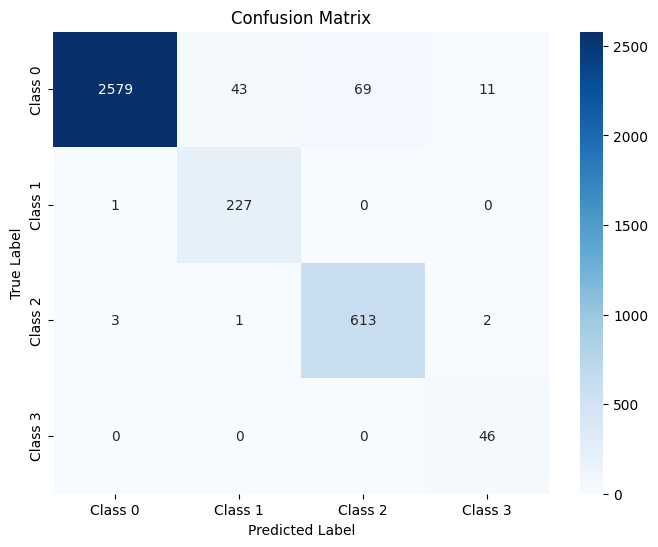

The function took 0.4049 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.96      0.98      3378
     Class 1       0.84      0.99      0.91       285
     Class 2       0.91      0.99      0.95       774
     Class 3       0.82      0.96      0.89        57

    accuracy                           0.97      4494
   macro avg       0.89      0.98      0.93      4494
weighted avg       0.97      0.97      0.97      4494



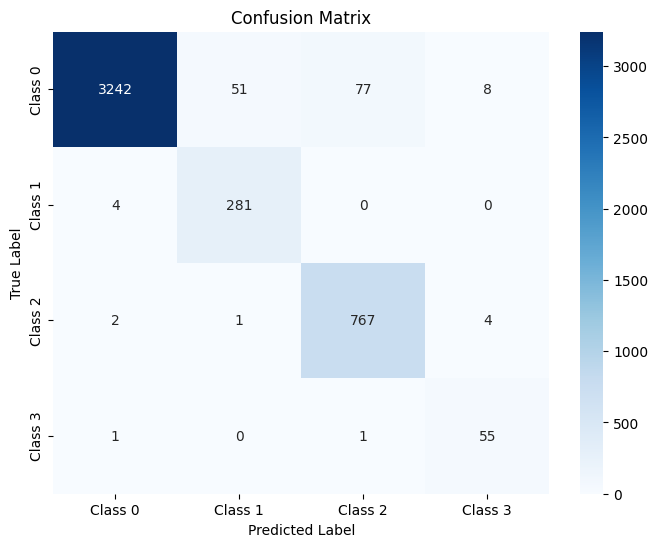

The function took 0.3872 seconds to execute.
[ARCH#057-[32, 32, 16, 8]] done in 32.9s  best-val=0.0839


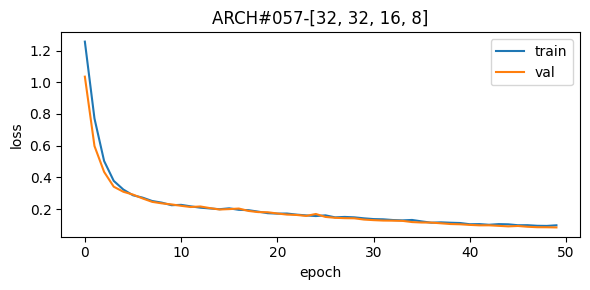


Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.95      0.97     10808
     Class 1       0.79      1.00      0.88       914
     Class 2       0.91      0.98      0.94      2475
     Class 3       0.78      0.99      0.87       182

    accuracy                           0.96     14379
   macro avg       0.87      0.98      0.92     14379
weighted avg       0.96      0.96      0.96     14379



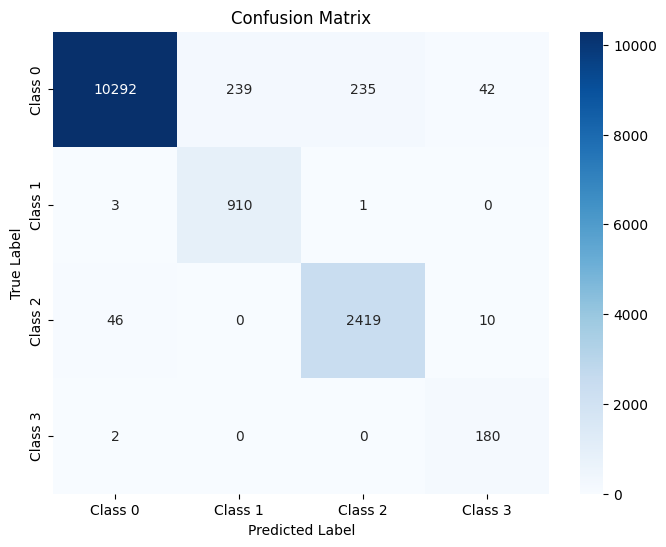

The function took 0.5968 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.95      0.97      2702
     Class 1       0.78      0.99      0.88       228
     Class 2       0.91      0.98      0.94       619
     Class 3       0.81      1.00      0.89        46

    accuracy                           0.96      3595
   macro avg       0.87      0.98      0.92      3595
weighted avg       0.96      0.96      0.96      3595



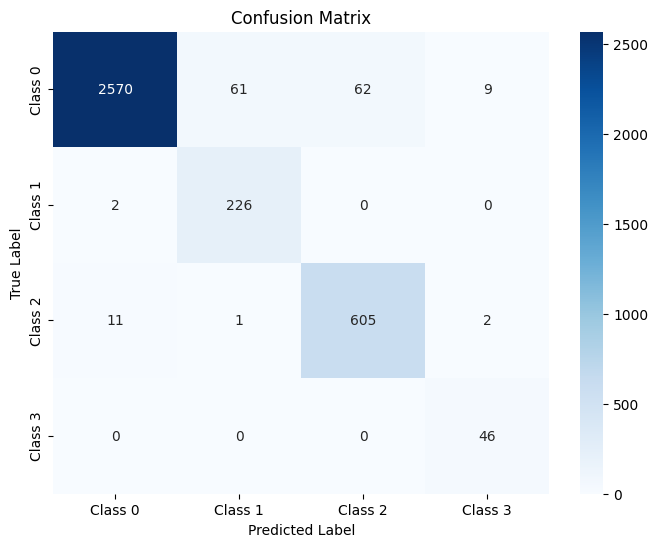

The function took 0.3549 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.96      0.97      3378
     Class 1       0.80      0.99      0.89       285
     Class 2       0.91      0.97      0.94       774
     Class 3       0.78      0.95      0.86        57

    accuracy                           0.96      4494
   macro avg       0.87      0.97      0.91      4494
weighted avg       0.96      0.96      0.96      4494



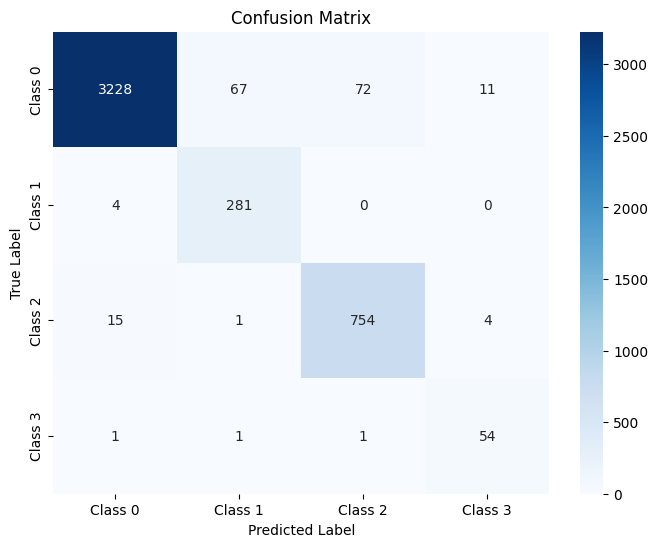

The function took 0.3385 seconds to execute.
[ARCH#058-[32, 32, 16, 4]] done in 32.7s  best-val=0.0951


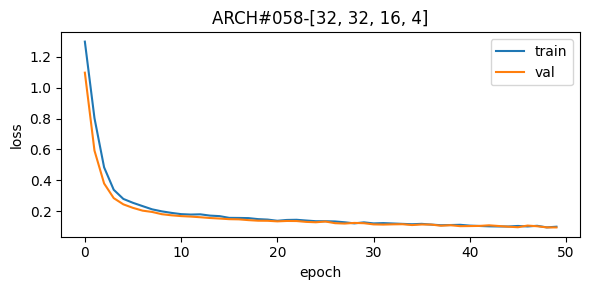


Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.95      0.97     10808
     Class 1       0.75      1.00      0.85       914
     Class 2       0.93      0.98      0.95      2475
     Class 3       0.60      0.93      0.73       182

    accuracy                           0.96     14379
   macro avg       0.82      0.96      0.88     14379
weighted avg       0.97      0.96      0.96     14379



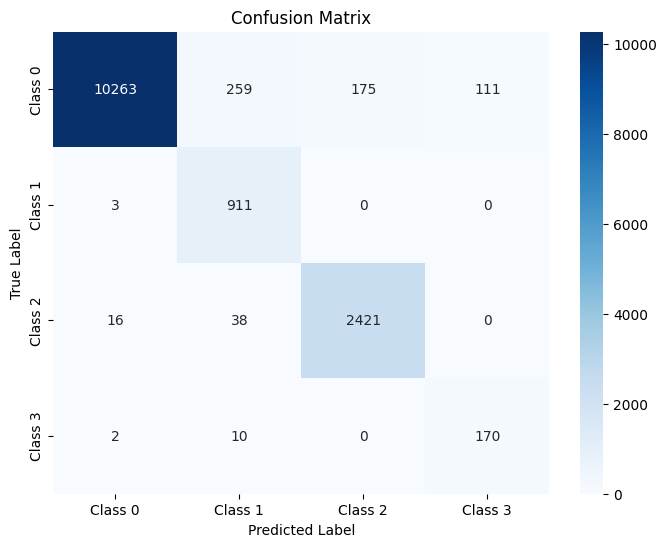

The function took 0.4967 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.95      0.97      2702
     Class 1       0.72      1.00      0.84       228
     Class 2       0.93      0.98      0.95       619
     Class 3       0.67      0.93      0.78        46

    accuracy                           0.96      3595
   macro avg       0.83      0.96      0.89      3595
weighted avg       0.97      0.96      0.96      3595



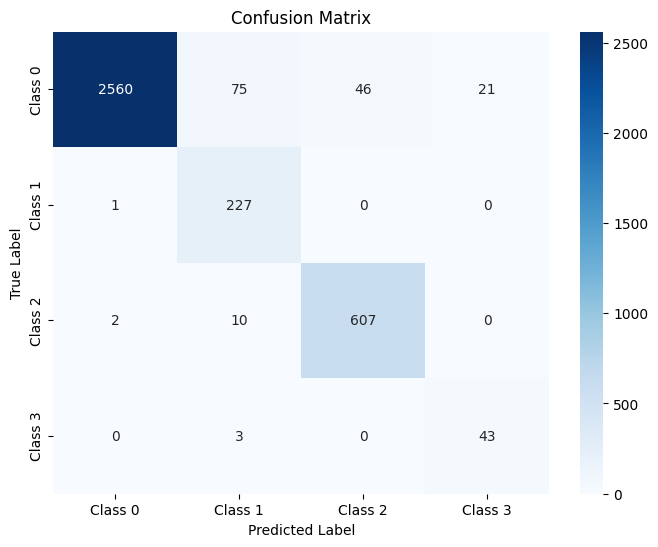

The function took 0.4760 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.95      0.97      3378
     Class 1       0.76      0.99      0.86       285
     Class 2       0.94      0.97      0.95       774
     Class 3       0.59      0.95      0.72        57

    accuracy                           0.96      4494
   macro avg       0.82      0.96      0.88      4494
weighted avg       0.97      0.96      0.96      4494



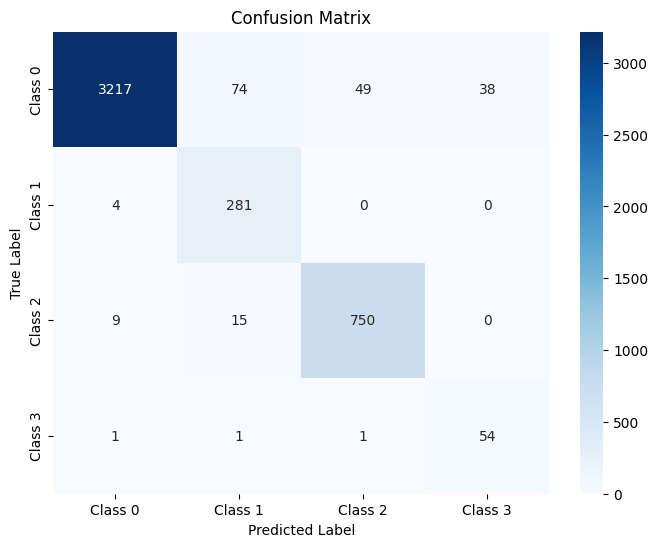

The function took 0.3159 seconds to execute.
[ARCH#059-[32, 32, 16, 2]] done in 32.0s  best-val=0.1930


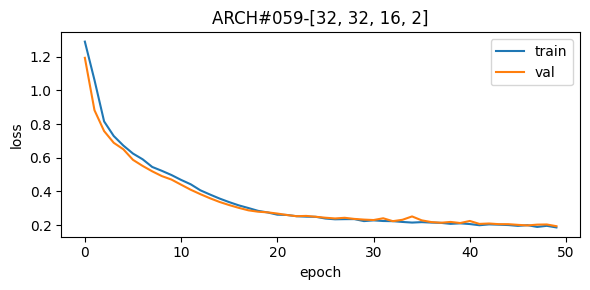


Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.93      0.96     10808
     Class 1       0.85      0.90      0.87       914
     Class 2       0.80      0.98      0.89      2475
     Class 3       0.67      0.98      0.80       182

    accuracy                           0.94     14379
   macro avg       0.83      0.95      0.88     14379
weighted avg       0.95      0.94      0.94     14379



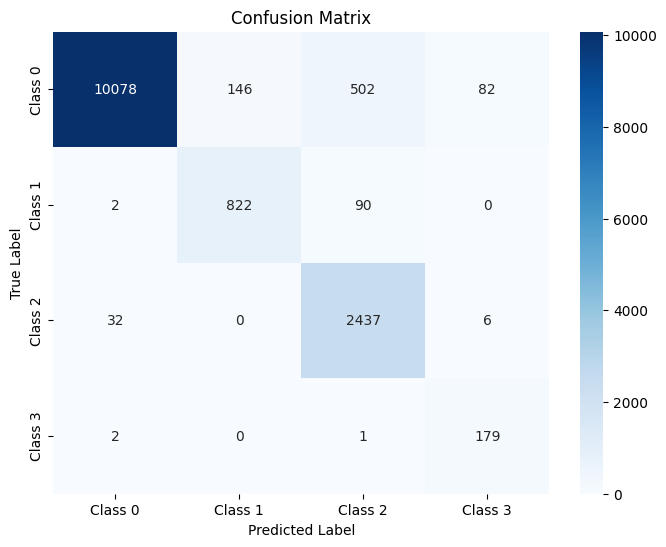

The function took 0.7002 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.93      0.96      2702
     Class 1       0.84      0.87      0.85       228
     Class 2       0.79      0.98      0.88       619
     Class 3       0.68      1.00      0.81        46

    accuracy                           0.94      3595
   macro avg       0.83      0.95      0.87      3595
weighted avg       0.95      0.94      0.94      3595



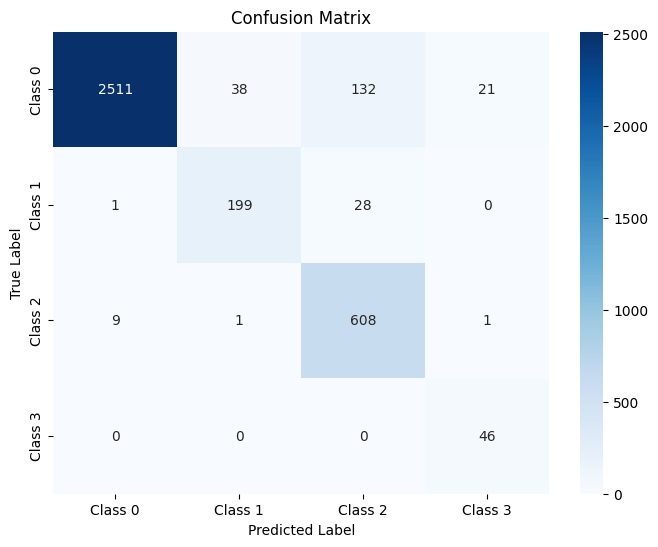

The function took 0.3569 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.94      0.97      3378
     Class 1       0.86      0.89      0.88       285
     Class 2       0.82      0.98      0.89       774
     Class 3       0.64      0.95      0.77        57

    accuracy                           0.94      4494
   macro avg       0.83      0.94      0.88      4494
weighted avg       0.95      0.94      0.95      4494



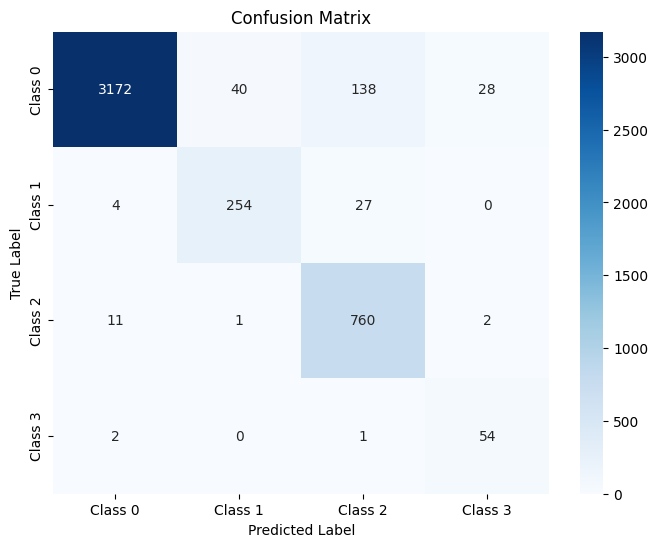

The function took 0.6324 seconds to execute.
[ARCH#060-[32, 32, 8, 8]] done in 32.5s  best-val=0.0823


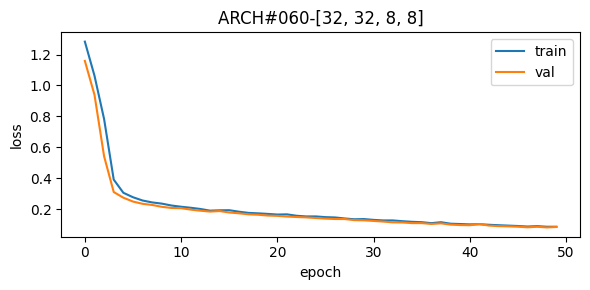


Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.94      0.97     10808
     Class 1       0.78      1.00      0.88       914
     Class 2       0.93      0.98      0.95      2475
     Class 3       0.51      0.99      0.67       182

    accuracy                           0.95     14379
   macro avg       0.80      0.98      0.87     14379
weighted avg       0.96      0.95      0.96     14379



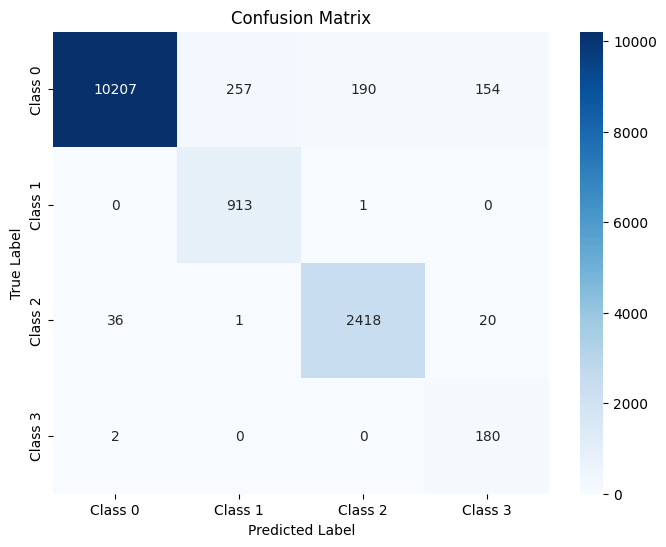

The function took 0.6058 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.94      0.97      2702
     Class 1       0.79      1.00      0.88       228
     Class 2       0.92      0.98      0.95       619
     Class 3       0.53      1.00      0.69        46

    accuracy                           0.95      3595
   macro avg       0.81      0.98      0.87      3595
weighted avg       0.96      0.95      0.96      3595



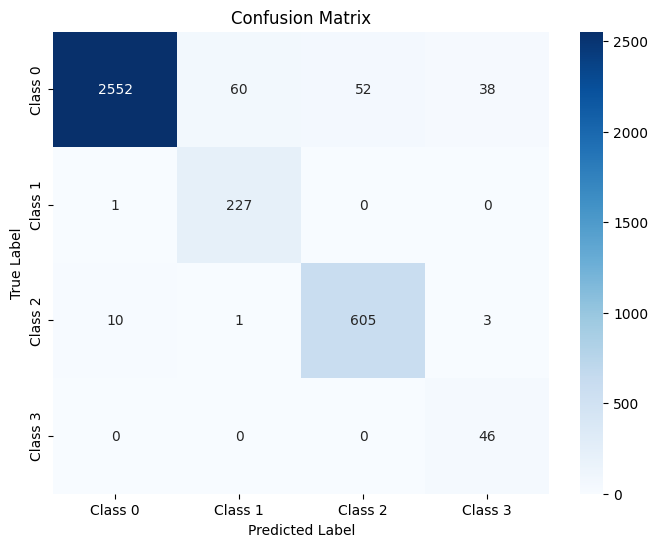

The function took 0.3213 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.95      0.97      3378
     Class 1       0.79      1.00      0.88       285
     Class 2       0.94      0.97      0.95       774
     Class 3       0.47      0.96      0.64        57

    accuracy                           0.96      4494
   macro avg       0.80      0.97      0.86      4494
weighted avg       0.97      0.96      0.96      4494



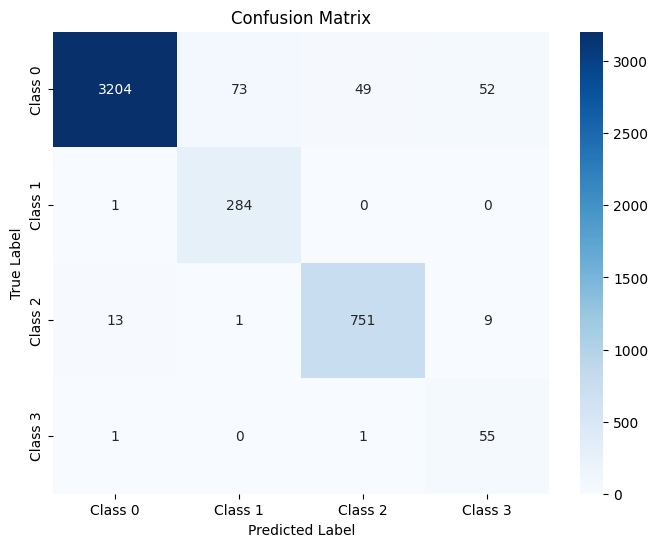

The function took 0.3205 seconds to execute.
[ARCH#061-[32, 32, 8, 4]] done in 32.9s  best-val=0.0869


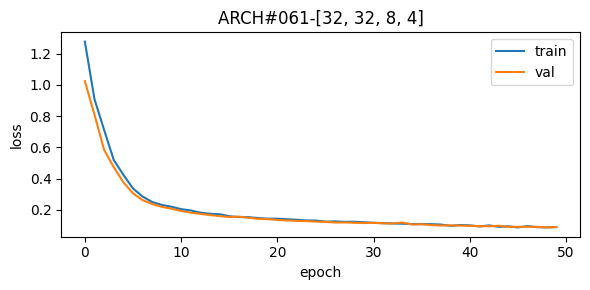


Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.95      0.97     10808
     Class 1       0.79      1.00      0.88       914
     Class 2       0.90      0.99      0.95      2475
     Class 3       0.85      0.94      0.89       182

    accuracy                           0.96     14379
   macro avg       0.89      0.97      0.92     14379
weighted avg       0.97      0.96      0.96     14379



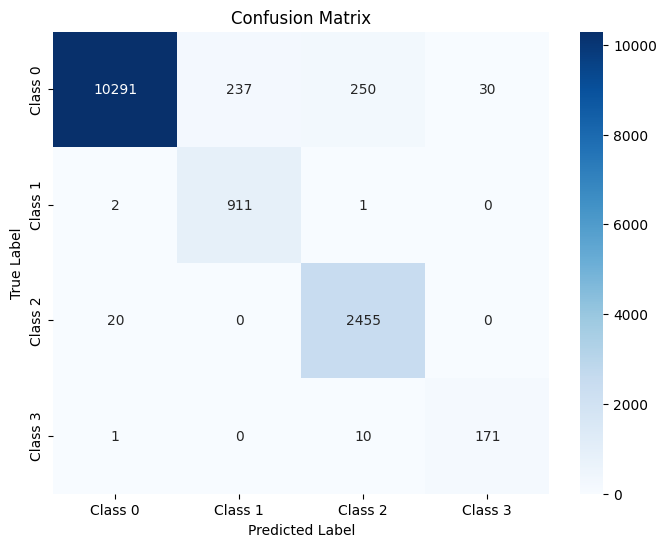

The function took 0.5084 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.95      0.98      2702
     Class 1       0.81      0.99      0.89       228
     Class 2       0.90      0.99      0.94       619
     Class 3       0.83      0.93      0.88        46

    accuracy                           0.96      3595
   macro avg       0.88      0.97      0.92      3595
weighted avg       0.97      0.96      0.96      3595



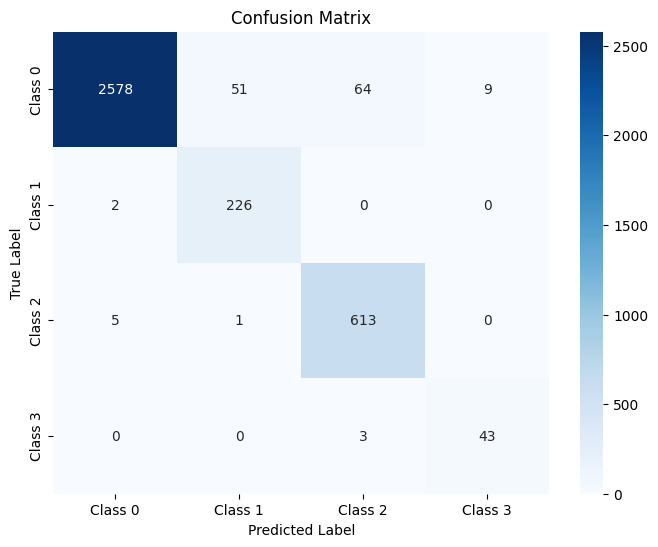

The function took 0.4662 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.95      0.97      3378
     Class 1       0.80      0.99      0.88       285
     Class 2       0.91      0.99      0.95       774
     Class 3       0.78      0.93      0.85        57

    accuracy                           0.96      4494
   macro avg       0.87      0.96      0.91      4494
weighted avg       0.97      0.96      0.96      4494



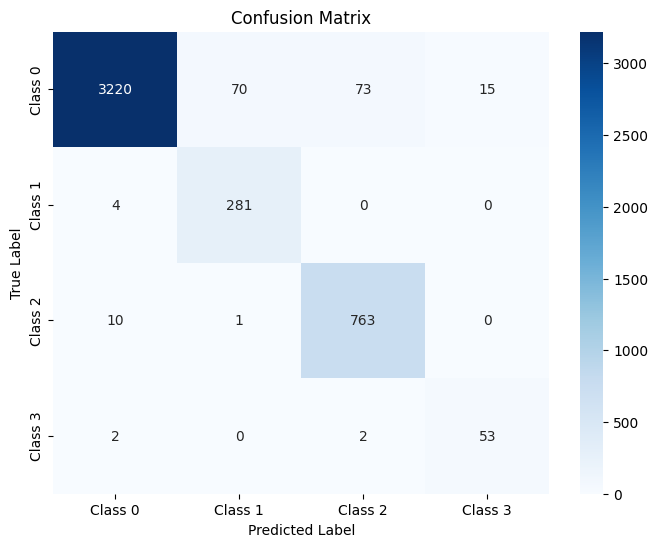

The function took 0.3068 seconds to execute.
[ARCH#062-[32, 32, 8, 2]] done in 32.6s  best-val=0.1470


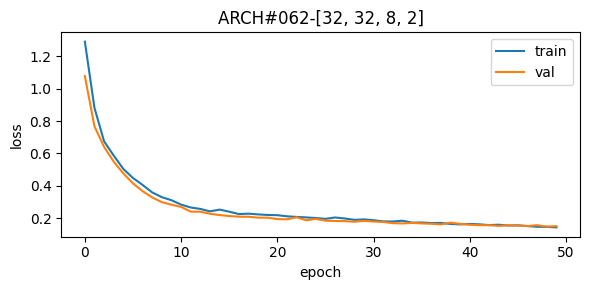


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.95      0.96     10808
     Class 1       0.81      1.00      0.89       914
     Class 2       0.89      0.91      0.90      2475
     Class 3       0.78      0.93      0.85       182

    accuracy                           0.95     14379
   macro avg       0.87      0.95      0.90     14379
weighted avg       0.95      0.95      0.95     14379



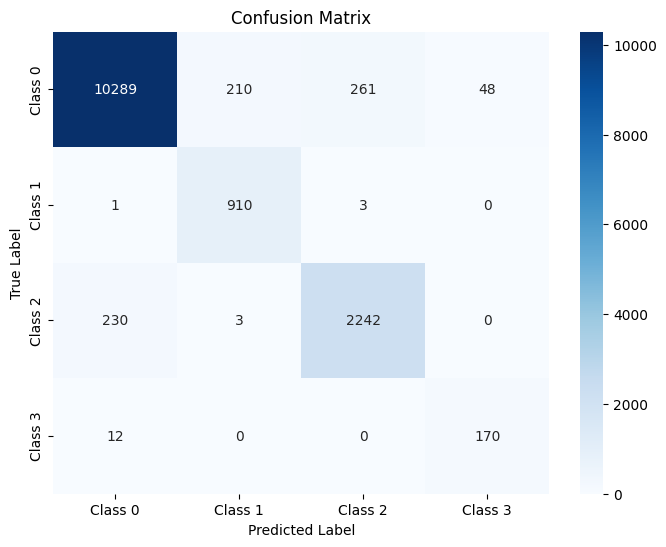

The function took 0.4899 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.96      0.97      2702
     Class 1       0.81      0.99      0.89       228
     Class 2       0.91      0.91      0.91       619
     Class 3       0.78      0.93      0.85        46

    accuracy                           0.95      3595
   macro avg       0.87      0.95      0.90      3595
weighted avg       0.95      0.95      0.95      3595



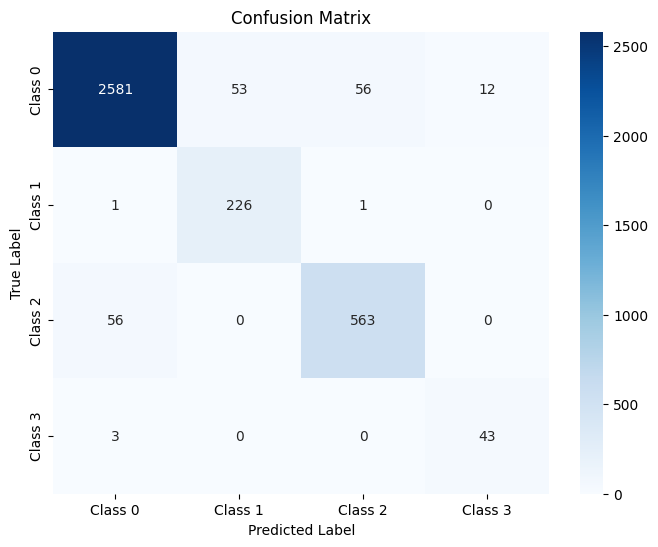

The function took 0.7667 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.97      0.95      0.96      3378
     Class 1       0.82      0.99      0.89       285
     Class 2       0.89      0.89      0.89       774
     Class 3       0.71      0.95      0.81        57

    accuracy                           0.94      4494
   macro avg       0.85      0.94      0.89      4494
weighted avg       0.94      0.94      0.94      4494



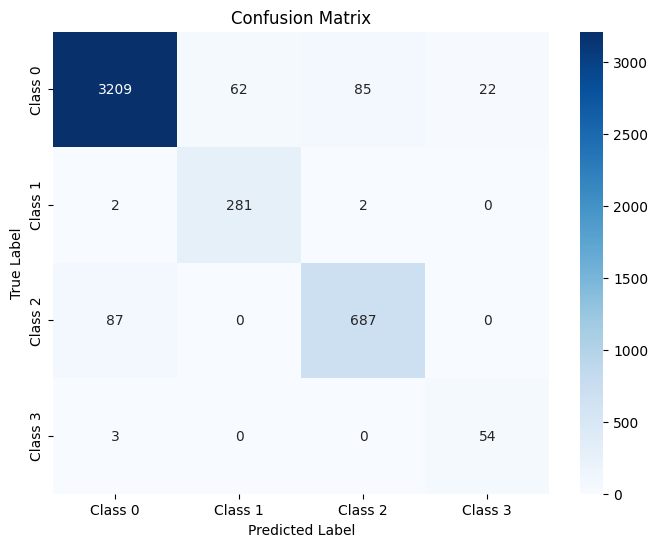

The function took 0.3171 seconds to execute.
[ARCH#063-[32, 32, 4, 4]] done in 33.1s  best-val=0.4649


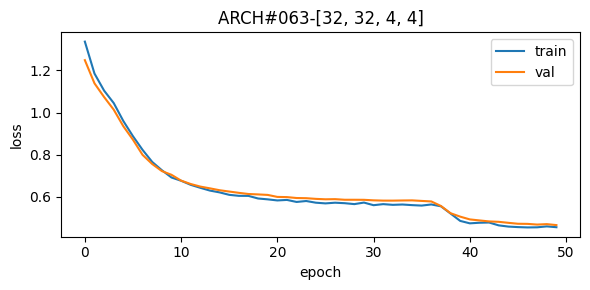


Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.53      0.70     10808
     Class 1       0.79      0.90      0.84       914
     Class 2       0.34      1.00      0.51      2475
     Class 3       0.67      0.93      0.78       182

    accuracy                           0.64     14379
   macro avg       0.70      0.84      0.71     14379
weighted avg       0.87      0.64      0.67     14379



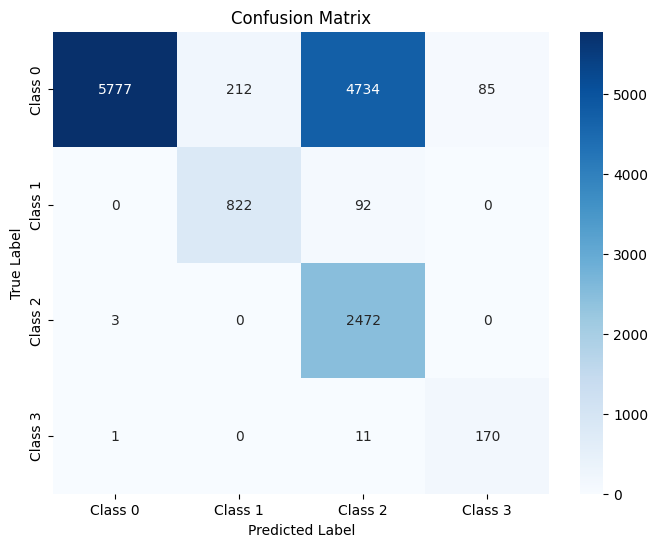

The function took 0.5275 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.54      0.70      2702
     Class 1       0.78      0.87      0.82       228
     Class 2       0.34      1.00      0.51       619
     Class 3       0.73      0.93      0.82        46

    accuracy                           0.65      3595
   macro avg       0.71      0.84      0.71      3595
weighted avg       0.87      0.65      0.68      3595



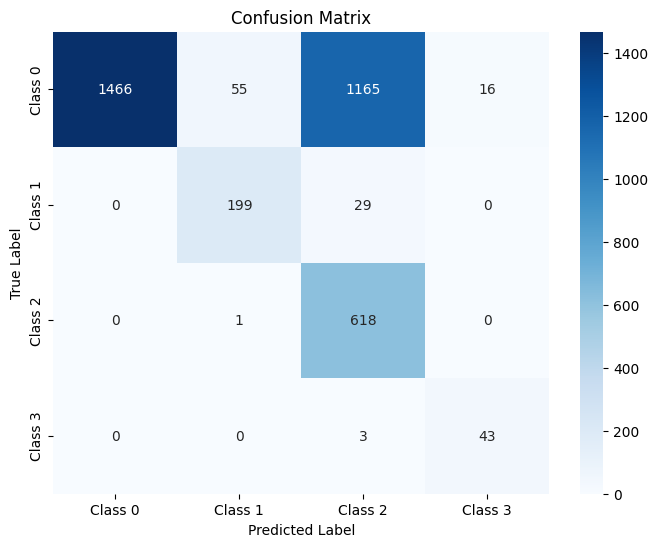

The function took 0.4549 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.53      0.69      3378
     Class 1       0.80      0.89      0.84       285
     Class 2       0.33      1.00      0.50       774
     Class 3       0.65      0.96      0.78        57

    accuracy                           0.64      4494
   macro avg       0.70      0.85      0.70      4494
weighted avg       0.87      0.64      0.67      4494



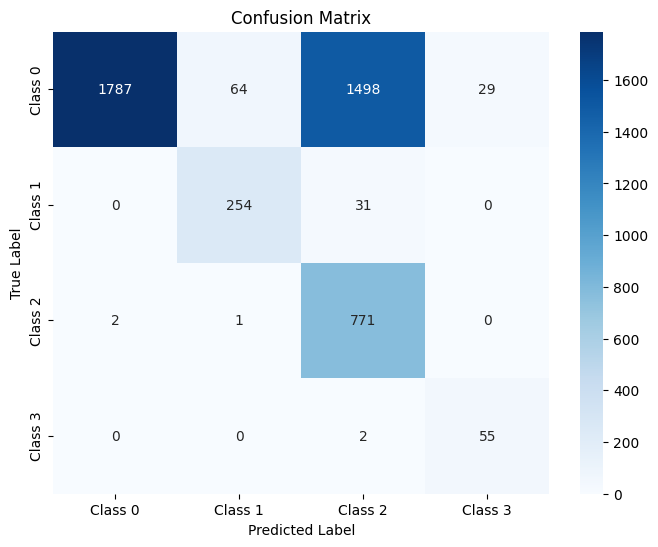

The function took 0.3690 seconds to execute.
[ARCH#064-[32, 32, 4, 2]] early-stop @ epoch 038
[ARCH#064-[32, 32, 4, 2]] done in 25.5s  best-val=1.3794


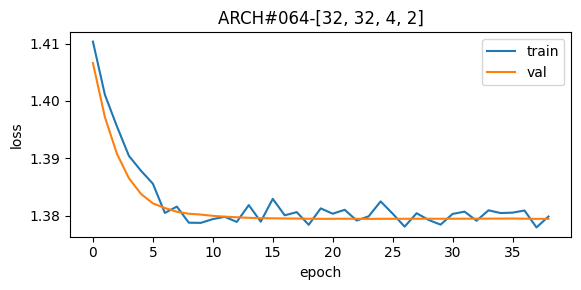


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86     10808
     Class 1       0.00      0.00      0.00       914
     Class 2       0.00      0.00      0.00      2475
     Class 3       0.00      0.00      0.00       182

    accuracy                           0.75     14379
   macro avg       0.19      0.25      0.21     14379
weighted avg       0.56      0.75      0.65     14379



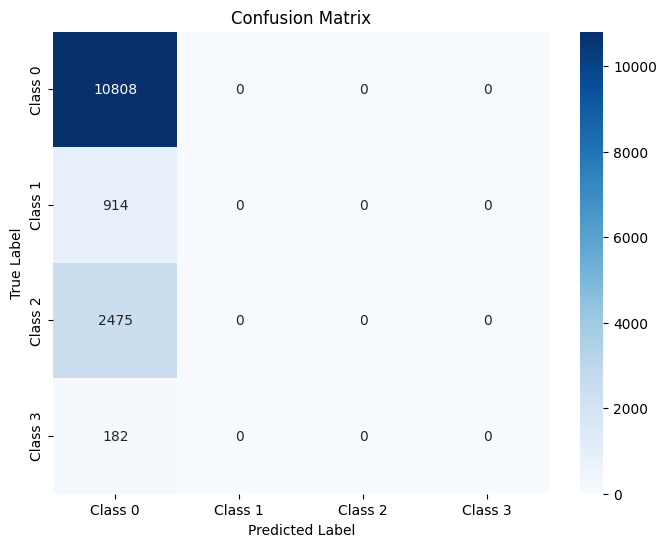

The function took 0.6036 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86      2702
     Class 1       0.00      0.00      0.00       228
     Class 2       0.00      0.00      0.00       619
     Class 3       0.00      0.00      0.00        46

    accuracy                           0.75      3595
   macro avg       0.19      0.25      0.21      3595
weighted avg       0.56      0.75      0.65      3595



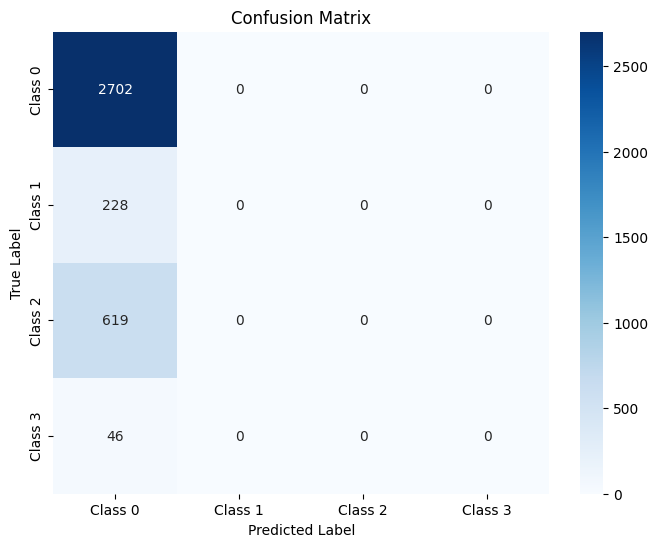

The function took 0.3350 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86      3378
     Class 1       0.00      0.00      0.00       285
     Class 2       0.00      0.00      0.00       774
     Class 3       0.00      0.00      0.00        57

    accuracy                           0.75      4494
   macro avg       0.19      0.25      0.21      4494
weighted avg       0.57      0.75      0.65      4494



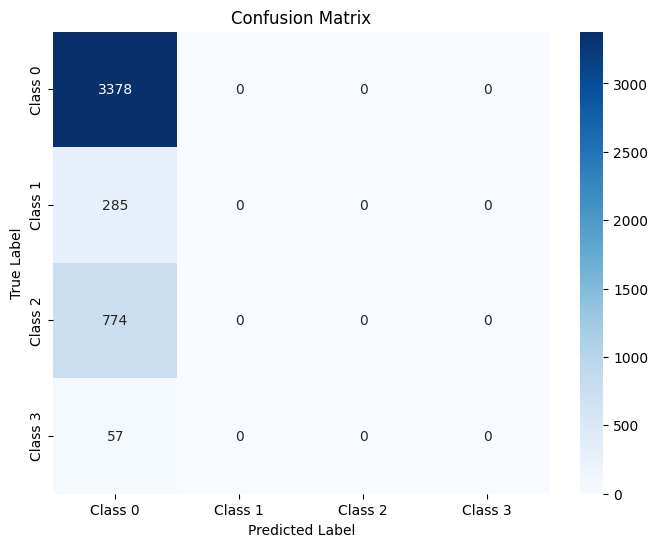

The function took 0.3735 seconds to execute.
[ARCH#065-[32, 32, 2, 2]] done in 33.1s  best-val=0.3516


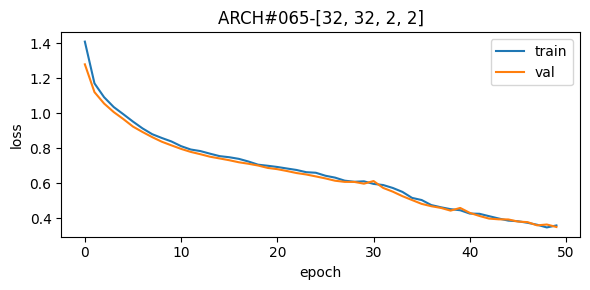


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.91      0.95     10808
     Class 1       0.69      1.00      0.82       914
     Class 2       0.84      0.92      0.88      2475
     Class 3       0.43      0.93      0.59       182

    accuracy                           0.92     14379
   macro avg       0.74      0.94      0.81     14379
weighted avg       0.94      0.92      0.93     14379



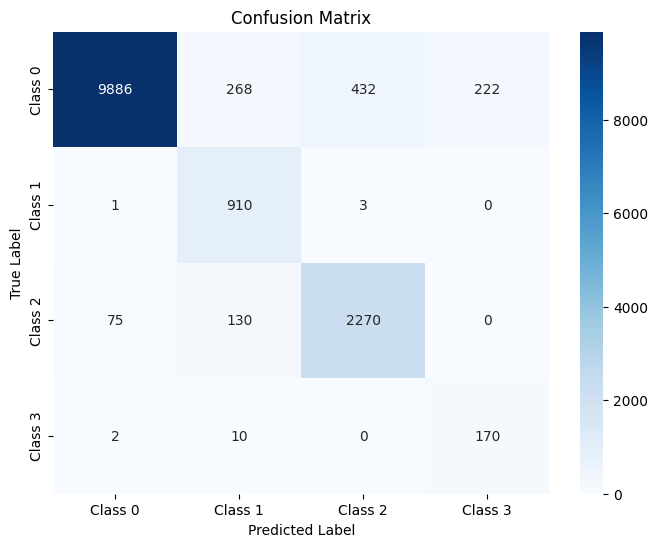

The function took 0.6007 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.91      0.95      2702
     Class 1       0.69      0.99      0.81       228
     Class 2       0.82      0.92      0.87       619
     Class 3       0.43      0.93      0.59        46

    accuracy                           0.92      3595
   macro avg       0.73      0.94      0.80      3595
weighted avg       0.94      0.92      0.92      3595



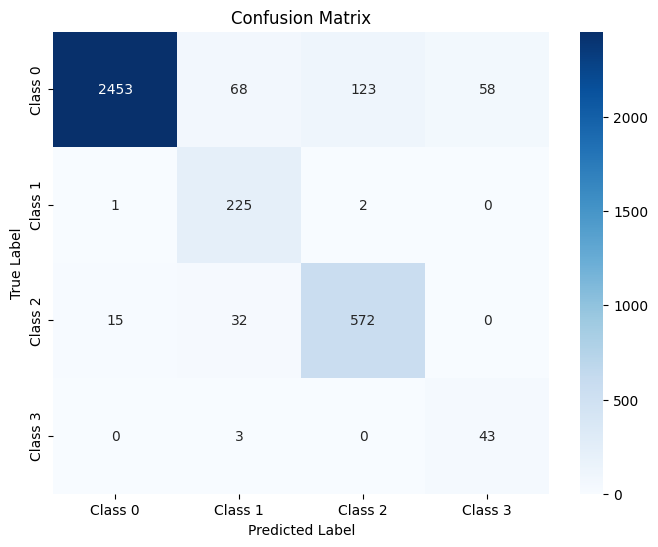

The function took 0.3437 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.91      0.95      3378
     Class 1       0.70      0.99      0.82       285
     Class 2       0.83      0.90      0.86       774
     Class 3       0.40      0.95      0.57        57

    accuracy                           0.91      4494
   macro avg       0.73      0.94      0.80      4494
weighted avg       0.94      0.91      0.92      4494



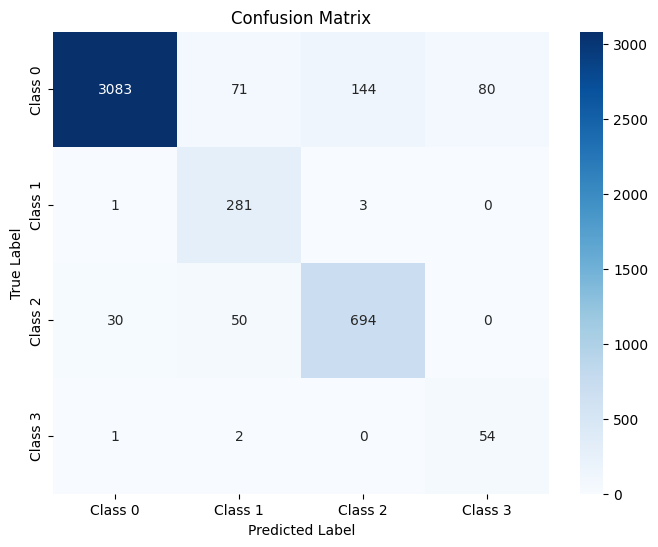

The function took 0.4187 seconds to execute.
[ARCH#066-[32, 16, 16, 16]] done in 33.2s  best-val=0.0619


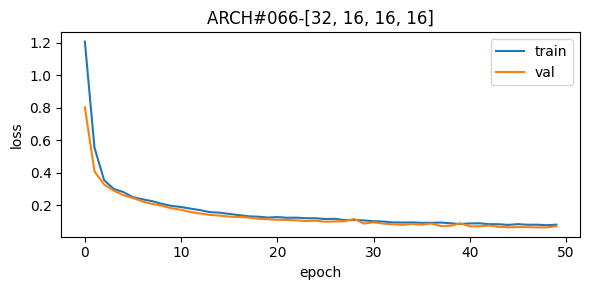


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.95      0.97     10808
     Class 1       0.80      1.00      0.89       914
     Class 2       0.90      0.97      0.94      2475
     Class 3       0.74      0.98      0.84       182

    accuracy                           0.96     14379
   macro avg       0.86      0.98      0.91     14379
weighted avg       0.96      0.96      0.96     14379



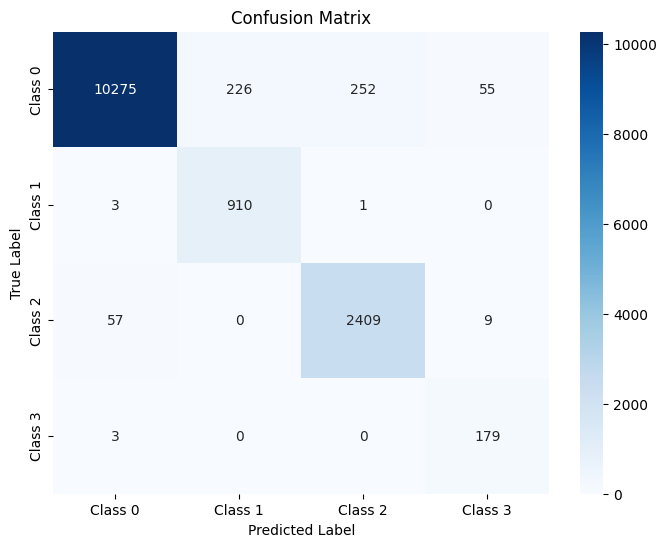

The function took 0.5143 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.95      0.97      2702
     Class 1       0.79      1.00      0.88       228
     Class 2       0.90      0.96      0.93       619
     Class 3       0.77      1.00      0.87        46

    accuracy                           0.95      3595
   macro avg       0.86      0.98      0.91      3595
weighted avg       0.96      0.95      0.96      3595



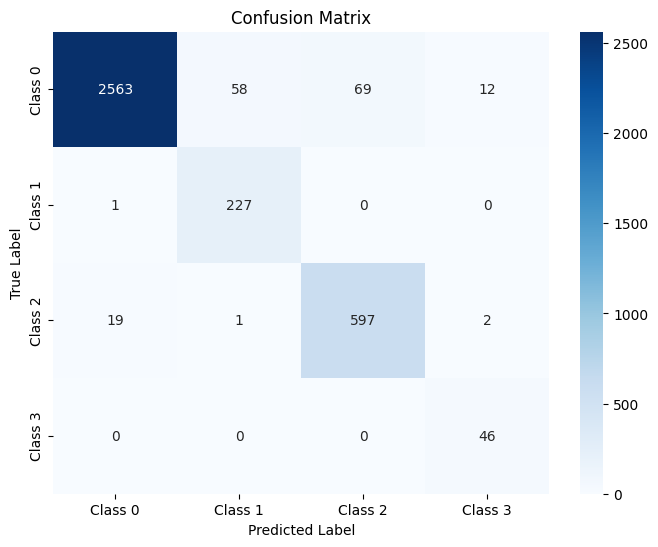

The function took 0.4710 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.96      0.97      3378
     Class 1       0.82      0.99      0.89       285
     Class 2       0.90      0.97      0.93       774
     Class 3       0.76      0.95      0.84        57

    accuracy                           0.96      4494
   macro avg       0.87      0.96      0.91      4494
weighted avg       0.96      0.96      0.96      4494



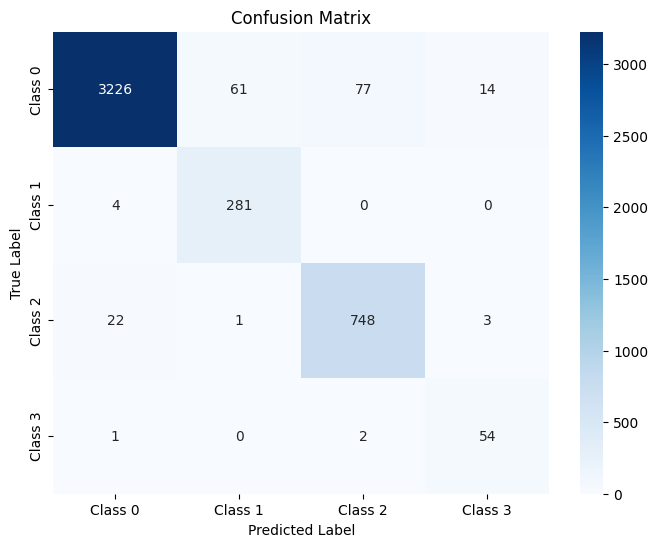

The function took 0.3300 seconds to execute.
[ARCH#067-[32, 16, 16, 8]] done in 32.3s  best-val=0.0723


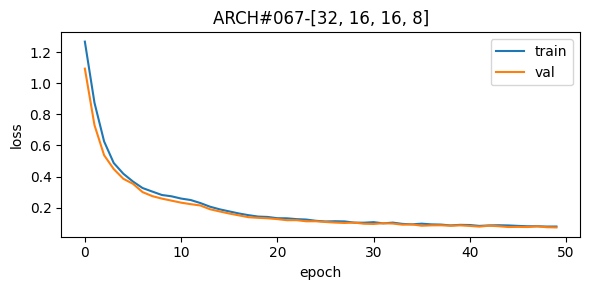


Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.95      0.97     10808
     Class 1       0.80      1.00      0.88       914
     Class 2       0.92      0.98      0.95      2475
     Class 3       0.72      0.99      0.84       182

    accuracy                           0.96     14379
   macro avg       0.86      0.98      0.91     14379
weighted avg       0.97      0.96      0.96     14379



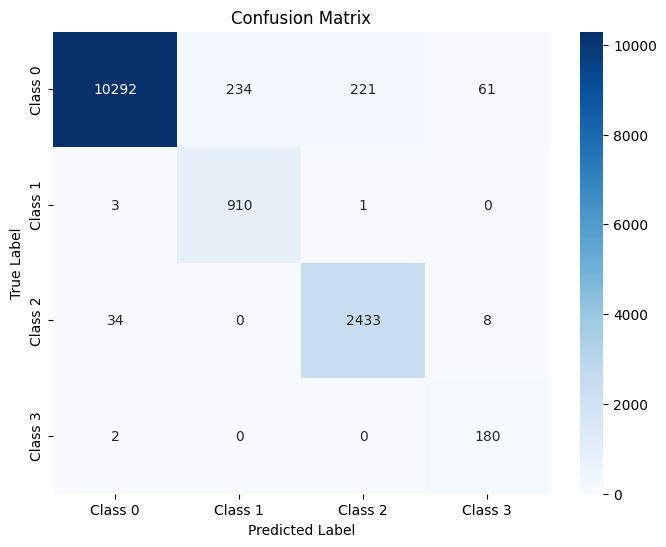

The function took 0.8503 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.95      0.97      2702
     Class 1       0.81      0.99      0.89       228
     Class 2       0.91      0.98      0.94       619
     Class 3       0.70      1.00      0.82        46

    accuracy                           0.96      3595
   macro avg       0.85      0.98      0.91      3595
weighted avg       0.97      0.96      0.96      3595



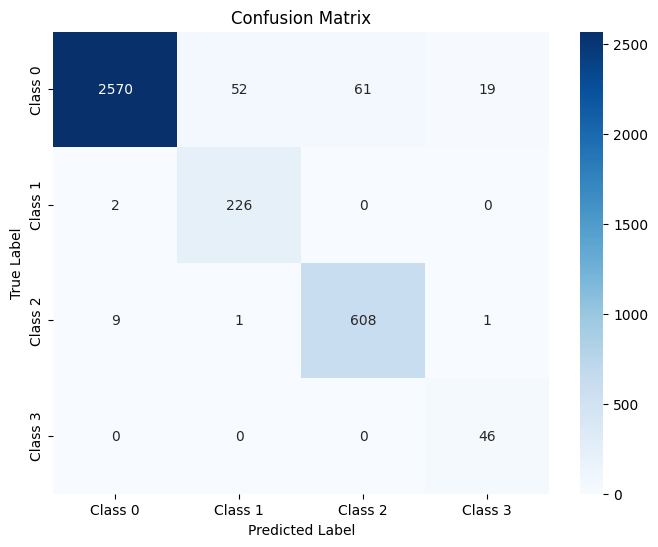

The function took 0.4690 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.95      0.97      3378
     Class 1       0.80      0.99      0.88       285
     Class 2       0.91      0.98      0.94       774
     Class 3       0.68      0.95      0.79        57

    accuracy                           0.96      4494
   macro avg       0.85      0.97      0.90      4494
weighted avg       0.96      0.96      0.96      4494



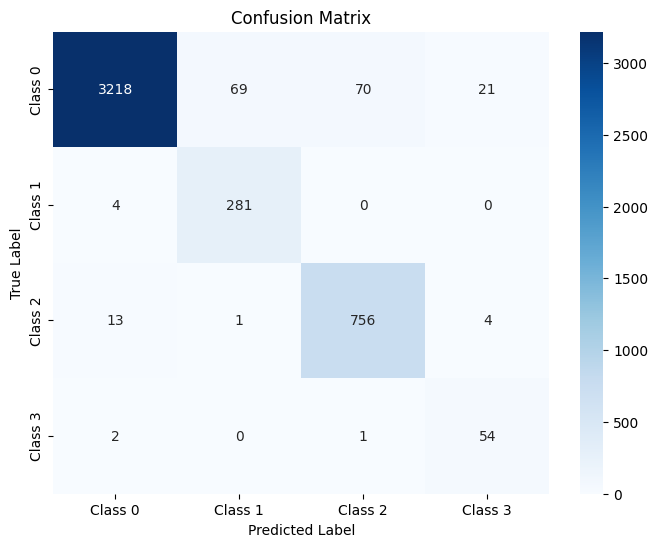

The function took 0.3793 seconds to execute.
[ARCH#068-[32, 16, 16, 4]] done in 32.6s  best-val=0.1024


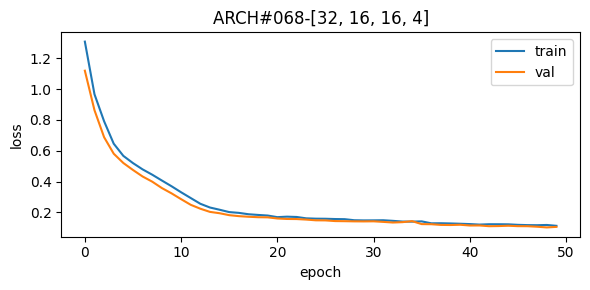


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.95      0.97     10808
     Class 1       0.77      1.00      0.87       914
     Class 2       0.92      0.96      0.94      2475
     Class 3       0.67      0.93      0.78       182

    accuracy                           0.95     14379
   macro avg       0.84      0.96      0.89     14379
weighted avg       0.96      0.95      0.96     14379



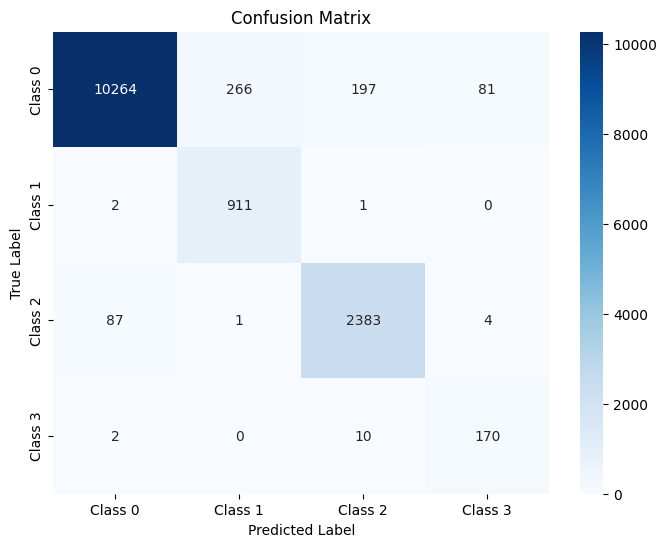

The function took 0.5145 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.95      0.97      2702
     Class 1       0.77      0.99      0.87       228
     Class 2       0.91      0.96      0.94       619
     Class 3       0.69      0.93      0.80        46

    accuracy                           0.95      3595
   macro avg       0.84      0.96      0.89      3595
weighted avg       0.96      0.95      0.96      3595



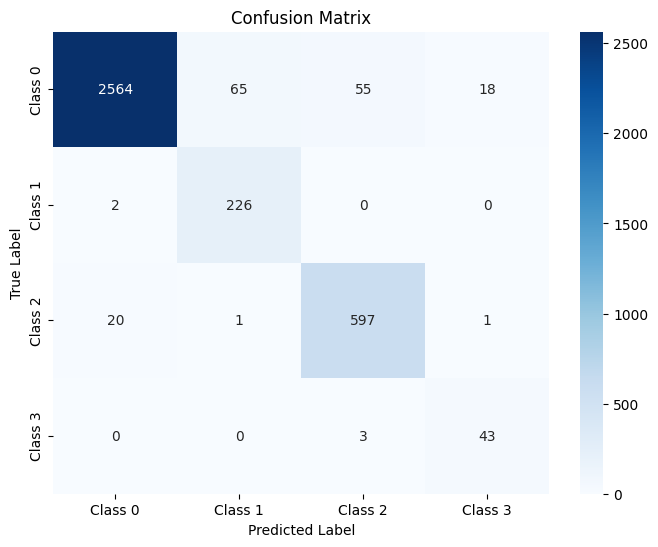

The function took 0.3825 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.96      0.97      3378
     Class 1       0.79      0.99      0.88       285
     Class 2       0.94      0.95      0.95       774
     Class 3       0.63      0.93      0.75        57

    accuracy                           0.96      4494
   macro avg       0.84      0.96      0.89      4494
weighted avg       0.96      0.96      0.96      4494



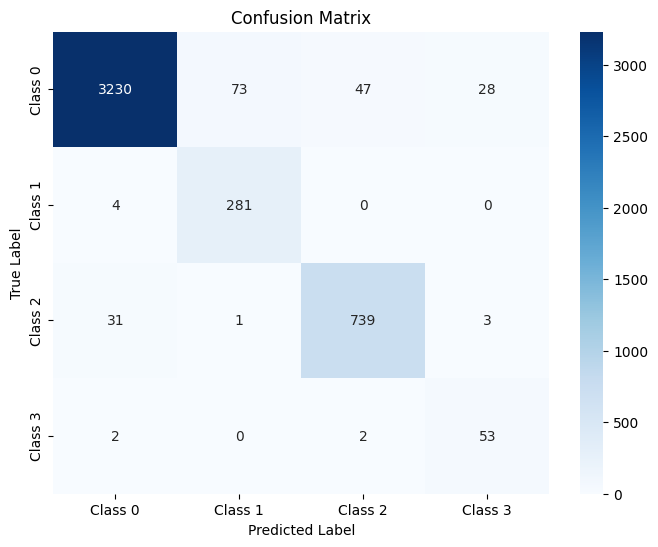

The function took 0.5260 seconds to execute.
[ARCH#069-[32, 16, 16, 2]] done in 32.7s  best-val=0.1330


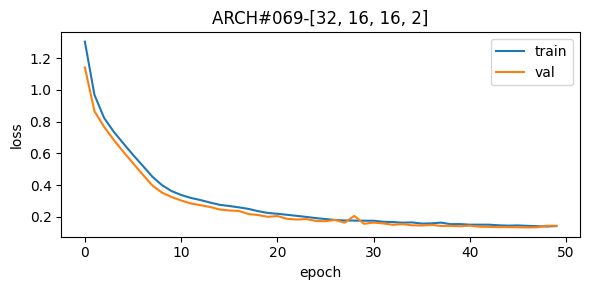


Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.93      0.96     10808
     Class 1       0.66      1.00      0.79       914
     Class 2       0.91      0.98      0.94      2475
     Class 3       0.67      0.90      0.77       182

    accuracy                           0.94     14379
   macro avg       0.81      0.95      0.87     14379
weighted avg       0.96      0.94      0.95     14379



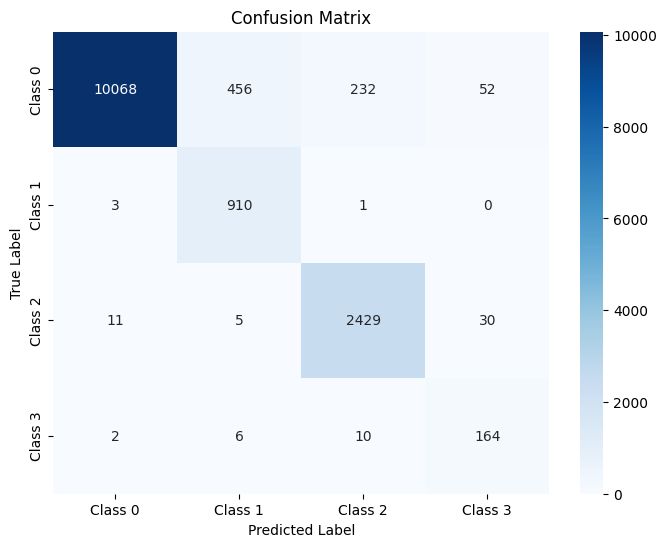

The function took 0.5018 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.93      0.96      2702
     Class 1       0.66      0.99      0.79       228
     Class 2       0.91      0.98      0.94       619
     Class 3       0.62      0.89      0.73        46

    accuracy                           0.94      3595
   macro avg       0.80      0.95      0.86      3595
weighted avg       0.96      0.94      0.95      3595



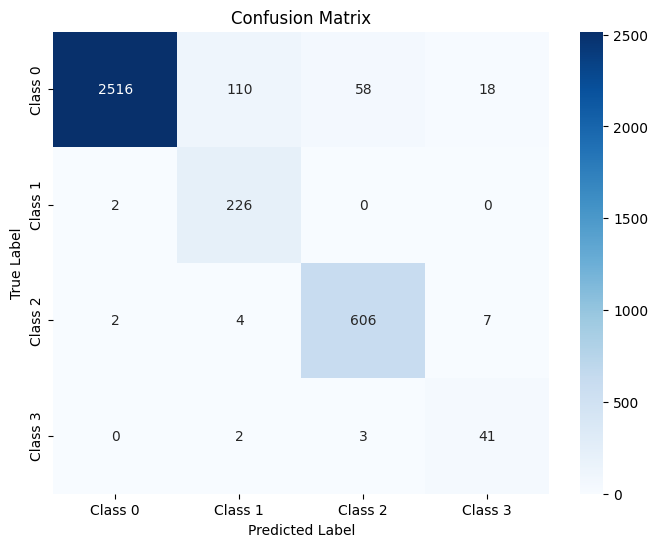

The function took 0.6434 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.93      0.96      3378
     Class 1       0.66      0.99      0.79       285
     Class 2       0.93      0.98      0.95       774
     Class 3       0.59      0.91      0.72        57

    accuracy                           0.95      4494
   macro avg       0.79      0.95      0.86      4494
weighted avg       0.96      0.95      0.95      4494



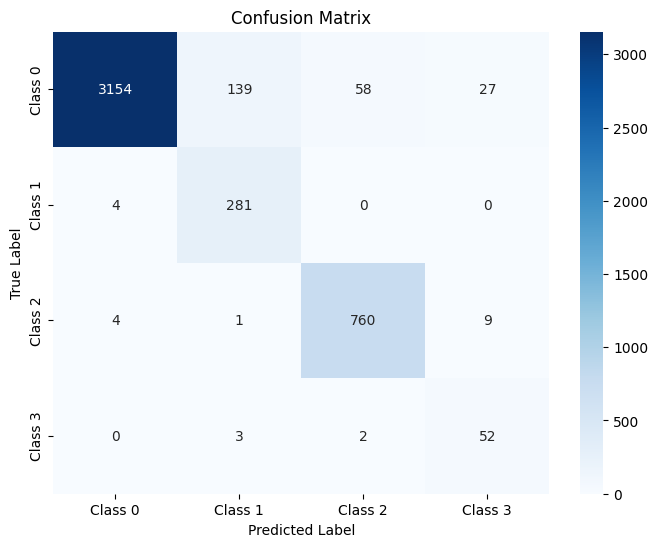

The function took 0.4184 seconds to execute.
[ARCH#070-[32, 16, 8, 8]] done in 33.2s  best-val=0.1106


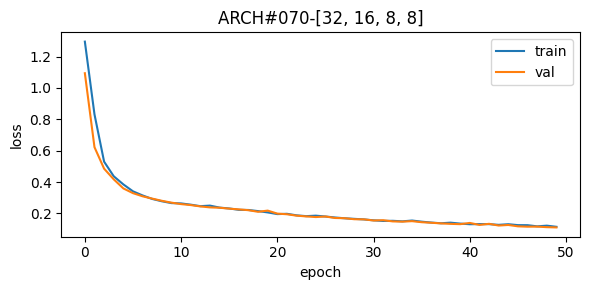


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.95      0.97     10808
     Class 1       0.89      0.96      0.92       914
     Class 2       0.87      0.99      0.93      2475
     Class 3       0.63      0.99      0.77       182

    accuracy                           0.96     14379
   macro avg       0.85      0.97      0.90     14379
weighted avg       0.96      0.96      0.96     14379



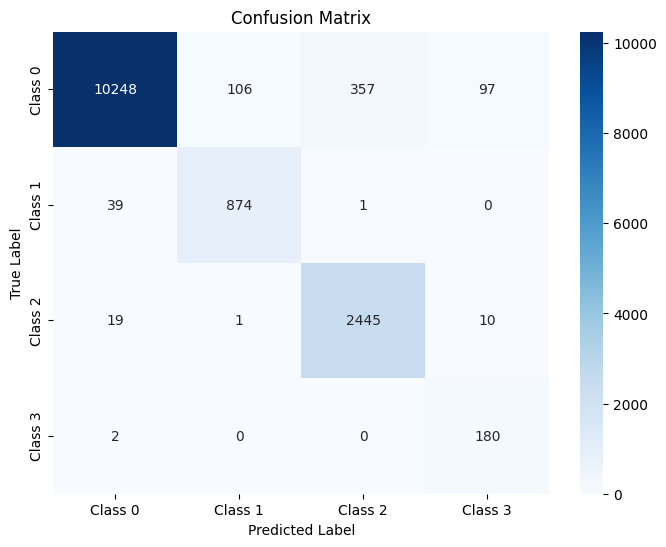

The function took 0.5337 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.95      0.97      2702
     Class 1       0.85      0.93      0.89       228
     Class 2       0.88      0.99      0.93       619
     Class 3       0.65      1.00      0.79        46

    accuracy                           0.95      3595
   macro avg       0.84      0.97      0.89      3595
weighted avg       0.96      0.95      0.96      3595



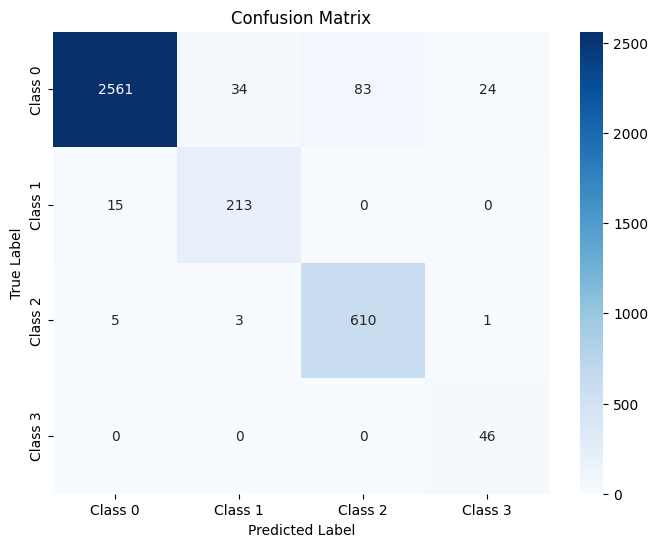

The function took 0.4765 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.95      0.97      3378
     Class 1       0.89      0.93      0.91       285
     Class 2       0.89      0.99      0.93       774
     Class 3       0.63      0.95      0.76        57

    accuracy                           0.96      4494
   macro avg       0.85      0.96      0.89      4494
weighted avg       0.96      0.96      0.96      4494



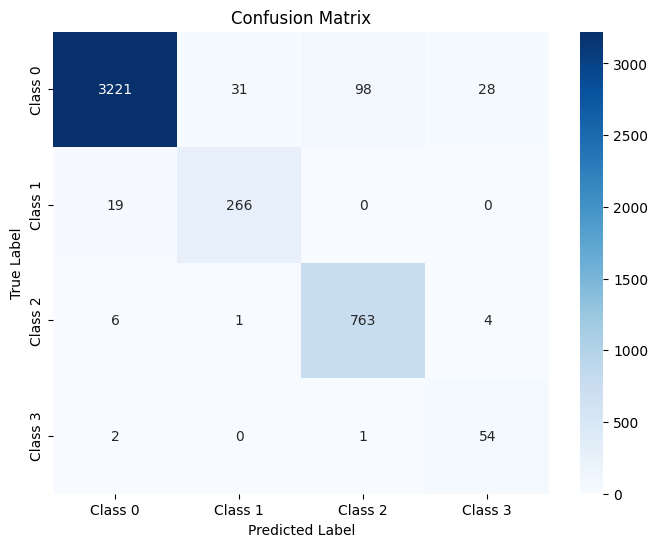

The function took 0.3901 seconds to execute.
[ARCH#071-[32, 16, 8, 4]] done in 32.8s  best-val=0.0749


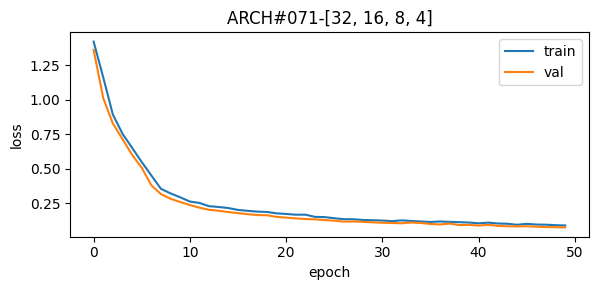


Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.95      0.97     10808
     Class 1       0.77      1.00      0.87       914
     Class 2       0.92      0.98      0.95      2475
     Class 3       0.74      0.99      0.85       182

    accuracy                           0.96     14379
   macro avg       0.86      0.98      0.91     14379
weighted avg       0.97      0.96      0.96     14379



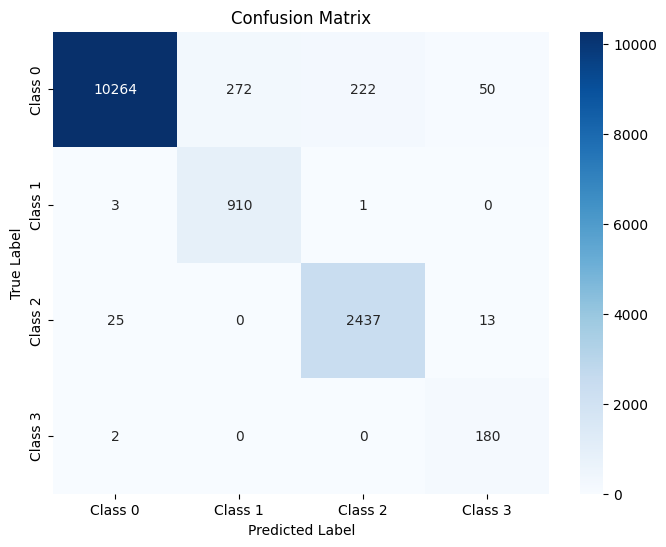

The function took 0.6176 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.95      0.97      2702
     Class 1       0.78      1.00      0.88       228
     Class 2       0.91      0.98      0.95       619
     Class 3       0.72      1.00      0.84        46

    accuracy                           0.96      3595
   macro avg       0.85      0.98      0.91      3595
weighted avg       0.97      0.96      0.96      3595



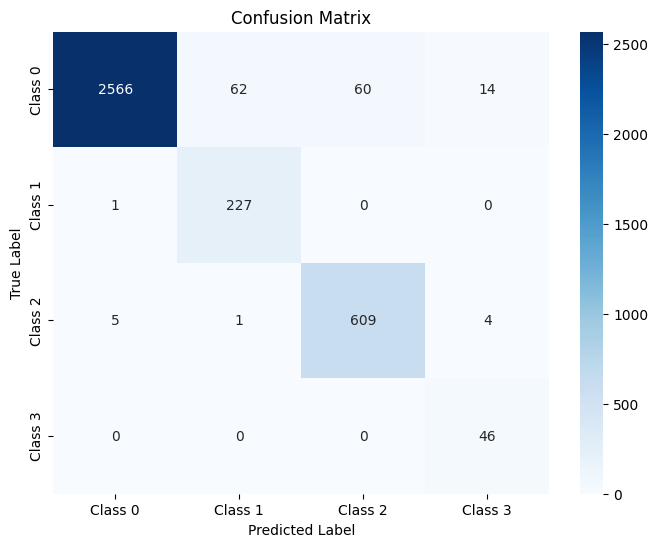

The function took 0.3752 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.95      0.97      3378
     Class 1       0.79      0.99      0.88       285
     Class 2       0.92      0.98      0.95       774
     Class 3       0.72      0.96      0.83        57

    accuracy                           0.96      4494
   macro avg       0.86      0.97      0.91      4494
weighted avg       0.96      0.96      0.96      4494



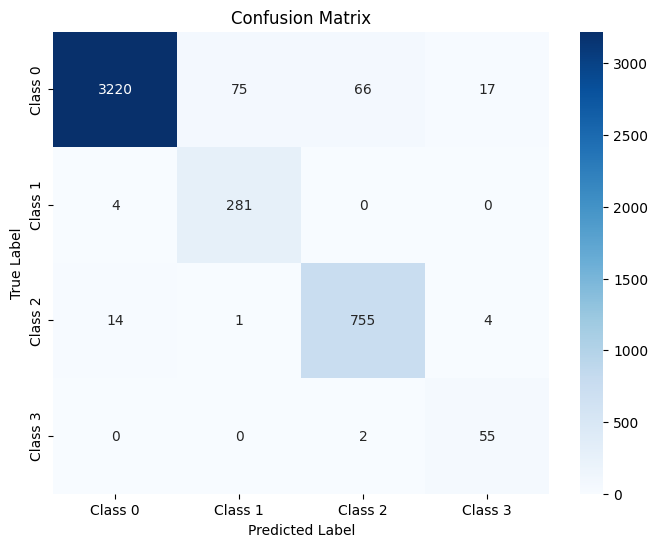

The function took 0.3936 seconds to execute.
[ARCH#072-[32, 16, 8, 2]] done in 32.9s  best-val=0.1277


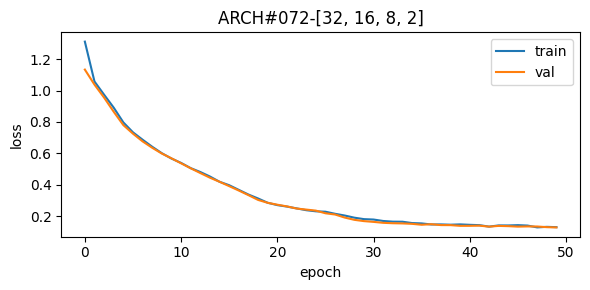


Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.95      0.97     10808
     Class 1       0.79      1.00      0.88       914
     Class 2       0.90      0.99      0.94      2475
     Class 3       0.73      0.93      0.82       182

    accuracy                           0.96     14379
   macro avg       0.85      0.97      0.90     14379
weighted avg       0.96      0.96      0.96     14379



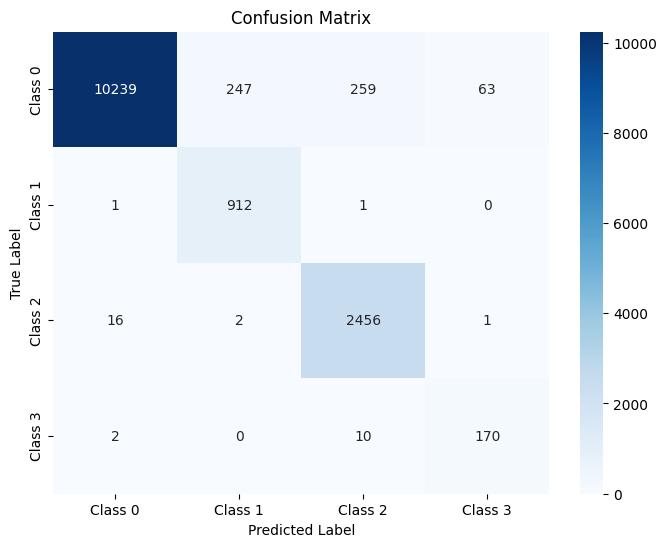

The function took 0.5250 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.95      0.97      2702
     Class 1       0.78      1.00      0.87       228
     Class 2       0.90      0.99      0.94       619
     Class 3       0.73      0.93      0.82        46

    accuracy                           0.96      3595
   macro avg       0.85      0.97      0.90      3595
weighted avg       0.96      0.96      0.96      3595



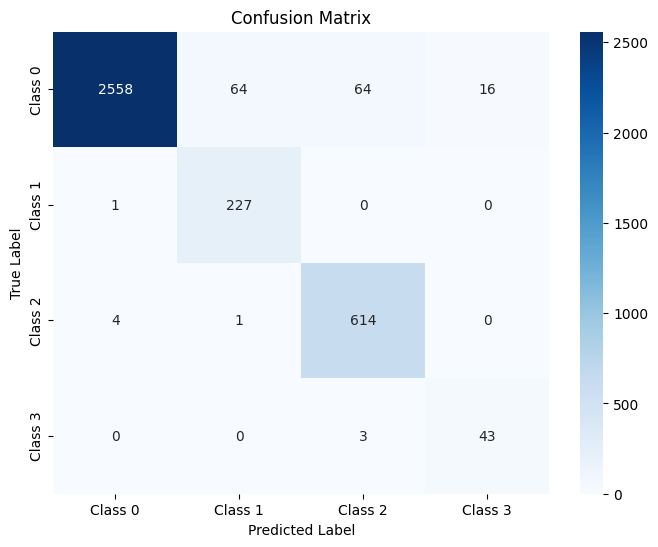

The function took 0.3432 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.95      0.97      3378
     Class 1       0.81      0.99      0.89       285
     Class 2       0.92      0.99      0.95       774
     Class 3       0.67      0.96      0.79        57

    accuracy                           0.96      4494
   macro avg       0.85      0.97      0.90      4494
weighted avg       0.97      0.96      0.96      4494



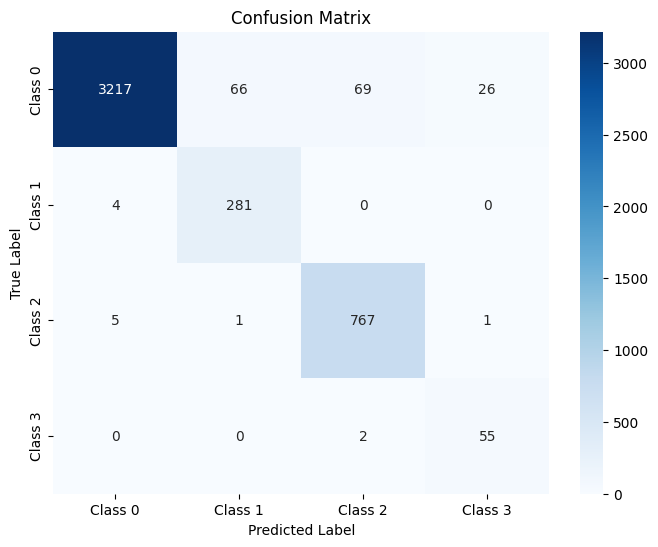

The function took 0.3920 seconds to execute.
[ARCH#073-[32, 16, 4, 4]] done in 32.8s  best-val=0.1272


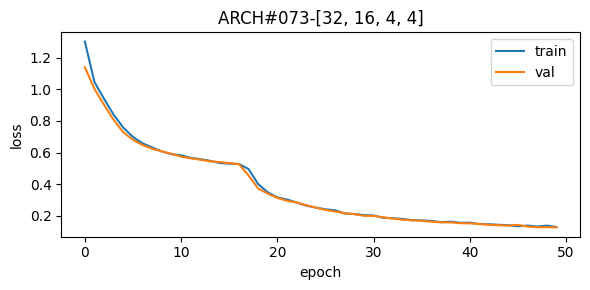


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.96      0.98     10808
     Class 1       0.84      0.96      0.89       914
     Class 2       0.91      0.99      0.95      2475
     Class 3       0.73      0.93      0.81       182

    accuracy                           0.96     14379
   macro avg       0.87      0.96      0.91     14379
weighted avg       0.97      0.96      0.96     14379



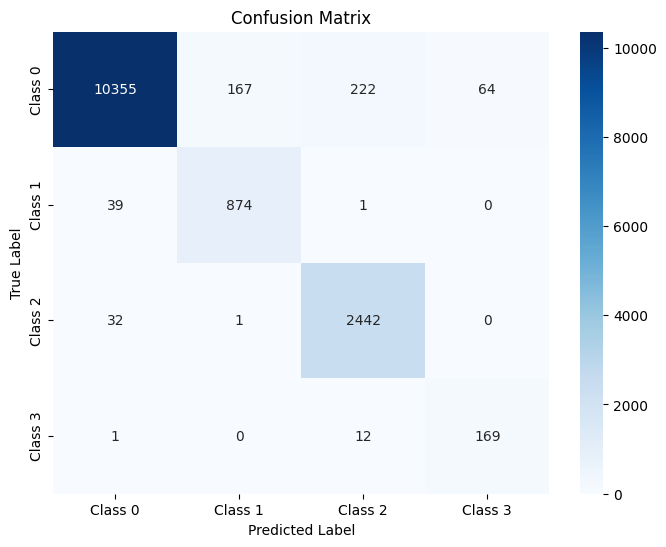

The function took 0.6317 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.96      0.98      2702
     Class 1       0.84      0.94      0.89       228
     Class 2       0.92      0.99      0.95       619
     Class 3       0.74      0.93      0.83        46

    accuracy                           0.96      3595
   macro avg       0.87      0.95      0.91      3595
weighted avg       0.97      0.96      0.96      3595



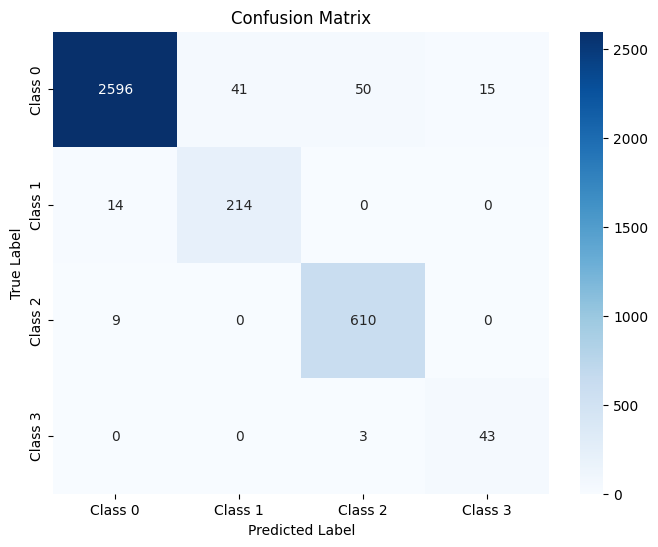

The function took 0.3370 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.96      0.97      3378
     Class 1       0.81      0.94      0.87       285
     Class 2       0.92      0.99      0.95       774
     Class 3       0.72      0.93      0.81        57

    accuracy                           0.96      4494
   macro avg       0.86      0.95      0.90      4494
weighted avg       0.96      0.96      0.96      4494



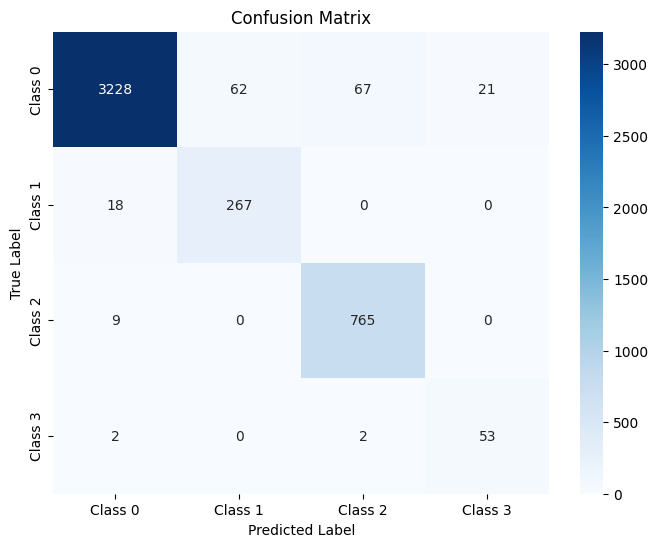

The function took 0.4877 seconds to execute.
[ARCH#074-[32, 16, 4, 2]] done in 32.1s  best-val=1.3794


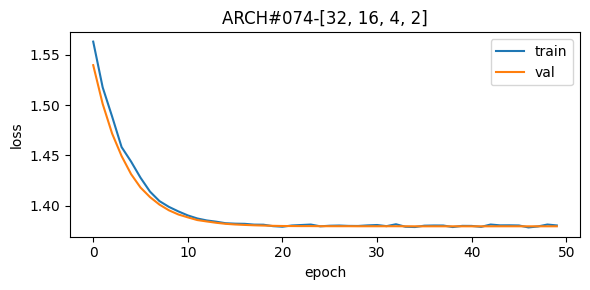


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86     10808
     Class 1       0.00      0.00      0.00       914
     Class 2       0.00      0.00      0.00      2475
     Class 3       0.00      0.00      0.00       182

    accuracy                           0.75     14379
   macro avg       0.19      0.25      0.21     14379
weighted avg       0.56      0.75      0.65     14379



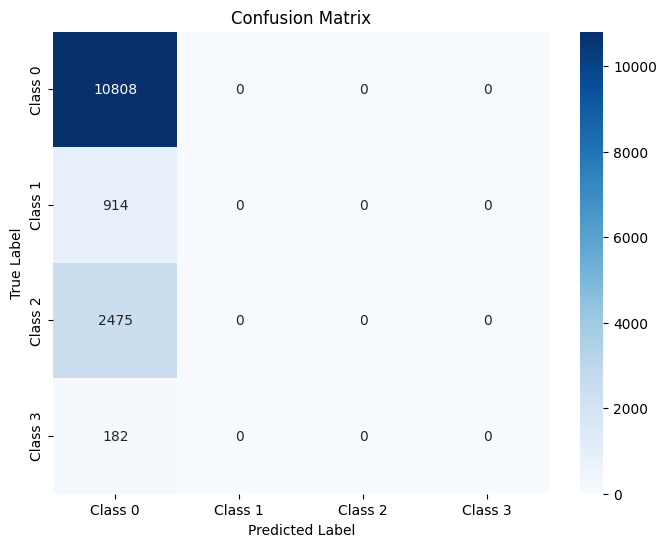

The function took 0.7920 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86      2702
     Class 1       0.00      0.00      0.00       228
     Class 2       0.00      0.00      0.00       619
     Class 3       0.00      0.00      0.00        46

    accuracy                           0.75      3595
   macro avg       0.19      0.25      0.21      3595
weighted avg       0.56      0.75      0.65      3595



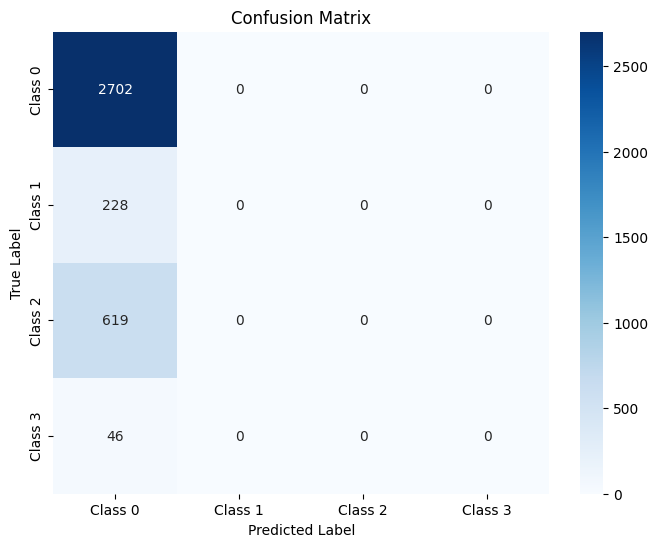

The function took 0.3950 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86      3378
     Class 1       0.00      0.00      0.00       285
     Class 2       0.00      0.00      0.00       774
     Class 3       0.00      0.00      0.00        57

    accuracy                           0.75      4494
   macro avg       0.19      0.25      0.21      4494
weighted avg       0.57      0.75      0.65      4494



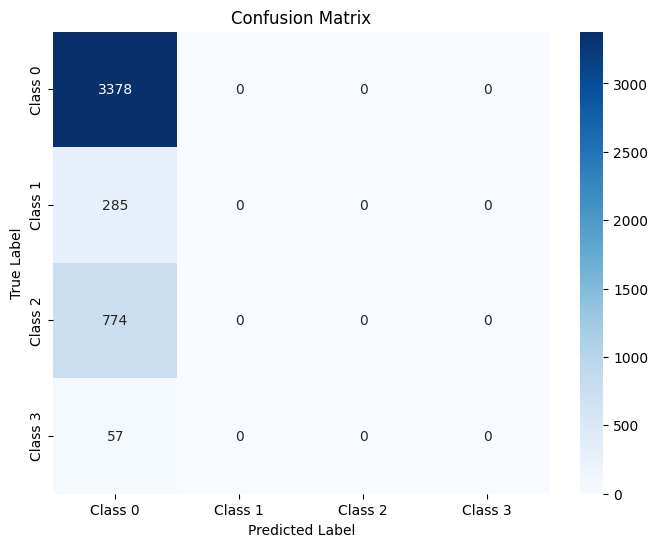

The function took 0.3988 seconds to execute.
[ARCH#075-[32, 16, 2, 2]] done in 32.2s  best-val=0.7542


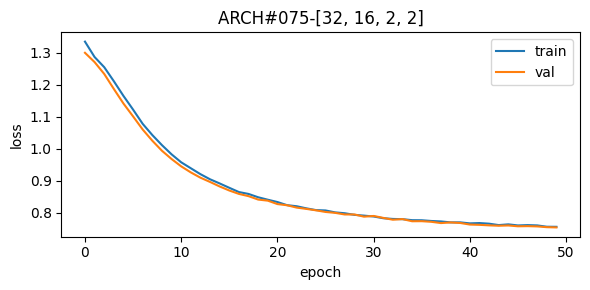


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.97      0.97     10808
     Class 1       0.00      0.00      0.00       914
     Class 2       0.66      0.98      0.79      2475
     Class 3       0.00      0.00      0.00       182

    accuracy                           0.90     14379
   macro avg       0.41      0.49      0.44     14379
weighted avg       0.85      0.90      0.87     14379



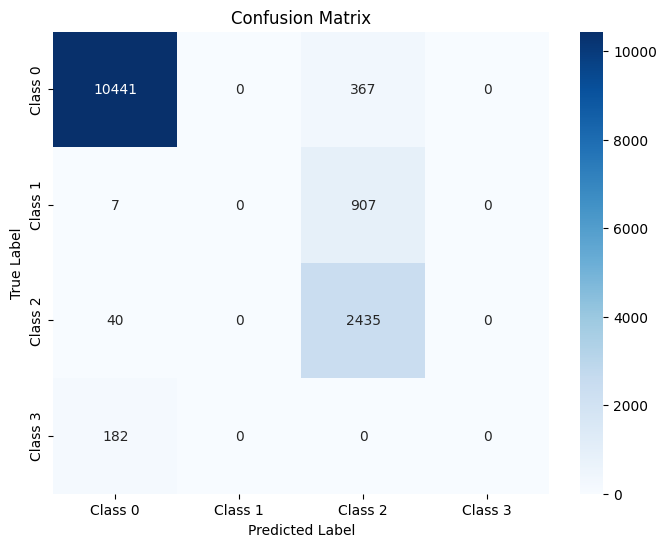

The function took 0.6169 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.96      0.97      2702
     Class 1       0.00      0.00      0.00       228
     Class 2       0.65      0.99      0.79       619
     Class 3       0.00      0.00      0.00        46

    accuracy                           0.89      3595
   macro avg       0.41      0.49      0.44      3595
weighted avg       0.85      0.89      0.87      3595



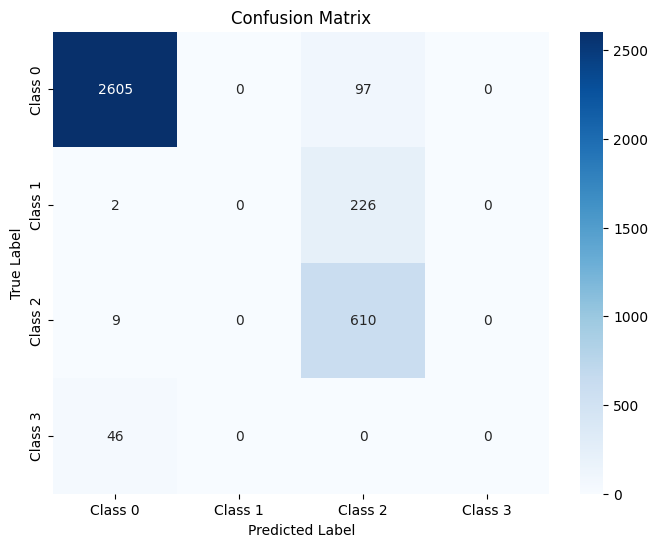

The function took 0.3435 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.97      0.97      3378
     Class 1       0.00      0.00      0.00       285
     Class 2       0.67      0.98      0.80       774
     Class 3       0.00      0.00      0.00        57

    accuracy                           0.90      4494
   macro avg       0.41      0.49      0.44      4494
weighted avg       0.85      0.90      0.87      4494



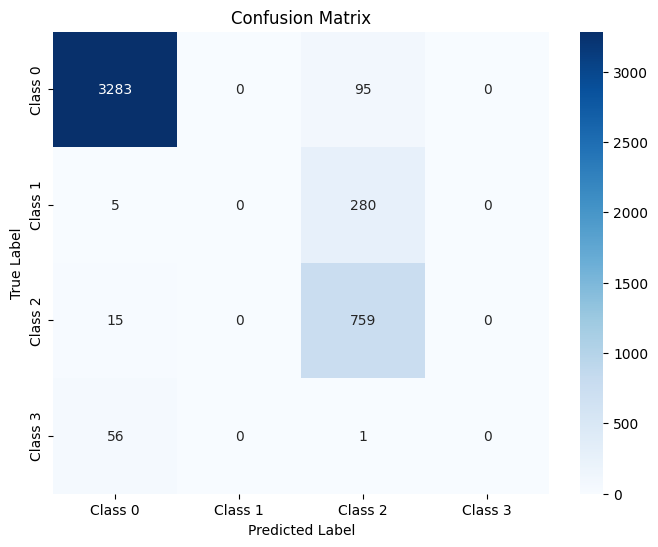

The function took 0.3990 seconds to execute.
[ARCH#076-[32, 8, 8, 8]] done in 32.5s  best-val=0.0894


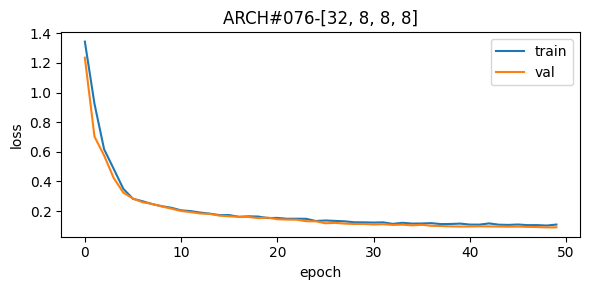


Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.95      0.97     10808
     Class 1       0.79      1.00      0.88       914
     Class 2       0.90      0.98      0.94      2475
     Class 3       0.60      0.93      0.73       182

    accuracy                           0.95     14379
   macro avg       0.82      0.96      0.88     14379
weighted avg       0.96      0.95      0.96     14379



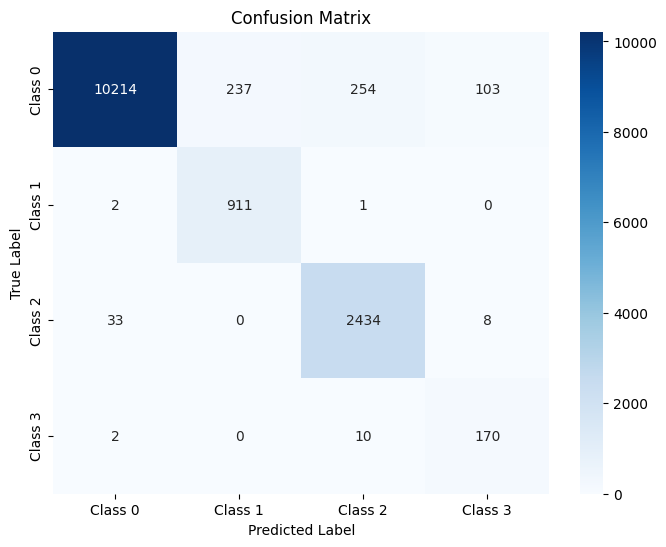

The function took 0.5220 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.94      0.97      2702
     Class 1       0.80      1.00      0.89       228
     Class 2       0.89      0.98      0.93       619
     Class 3       0.66      0.93      0.77        46

    accuracy                           0.95      3595
   macro avg       0.84      0.96      0.89      3595
weighted avg       0.96      0.95      0.96      3595



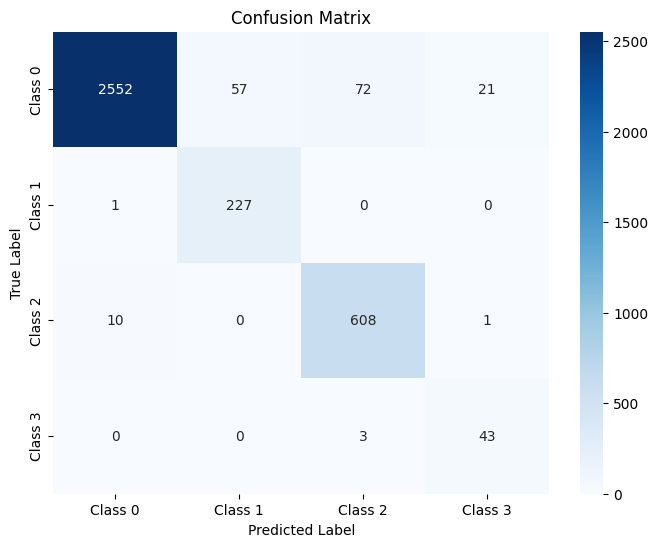

The function took 0.4805 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.95      0.97      3378
     Class 1       0.81      0.99      0.89       285
     Class 2       0.91      0.98      0.94       774
     Class 3       0.57      0.96      0.71        57

    accuracy                           0.96      4494
   macro avg       0.82      0.97      0.88      4494
weighted avg       0.96      0.96      0.96      4494



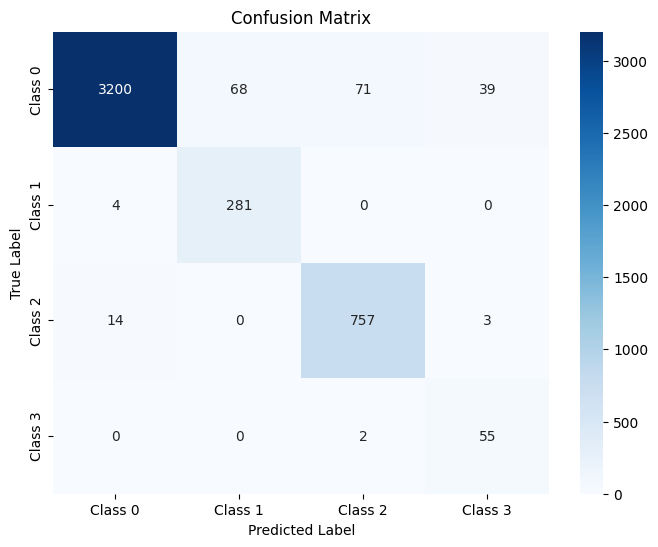

The function took 0.3612 seconds to execute.
[ARCH#077-[32, 8, 8, 4]] done in 32.5s  best-val=0.1202


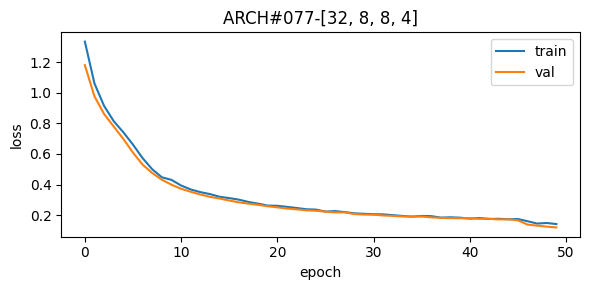


Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.92      0.96     10808
     Class 1       0.76      1.00      0.86       914
     Class 2       0.90      0.99      0.95      2475
     Class 3       0.38      0.99      0.55       182

    accuracy                           0.94     14379
   macro avg       0.76      0.97      0.83     14379
weighted avg       0.96      0.94      0.95     14379



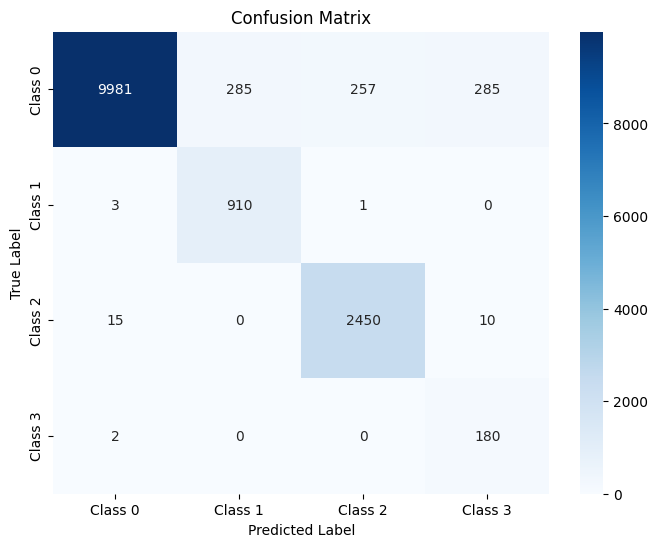

The function took 0.5399 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.93      0.96      2702
     Class 1       0.78      0.99      0.88       228
     Class 2       0.91      0.99      0.95       619
     Class 3       0.40      1.00      0.57        46

    accuracy                           0.94      3595
   macro avg       0.77      0.98      0.84      3595
weighted avg       0.96      0.94      0.95      3595



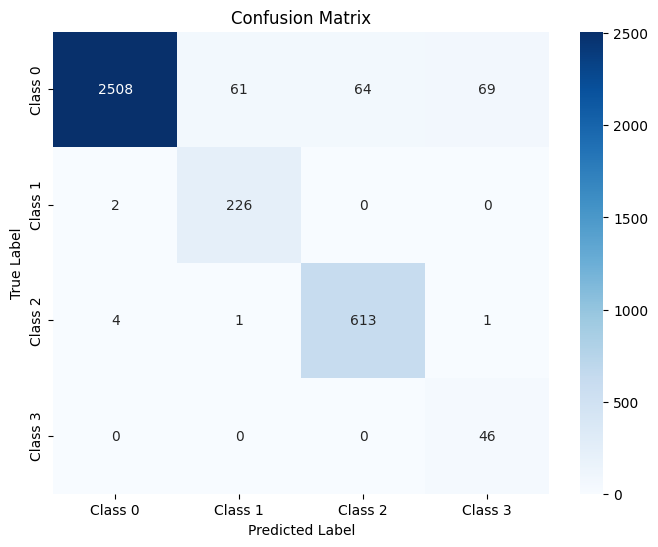

The function took 0.3396 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.93      0.96      3378
     Class 1       0.78      0.99      0.87       285
     Class 2       0.90      0.99      0.94       774
     Class 3       0.38      0.96      0.54        57

    accuracy                           0.94      4494
   macro avg       0.76      0.97      0.83      4494
weighted avg       0.96      0.94      0.95      4494



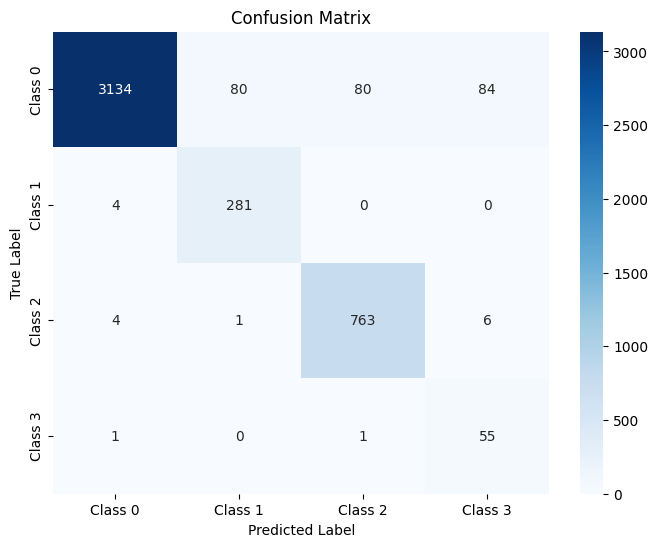

The function took 0.6721 seconds to execute.
[ARCH#078-[32, 8, 8, 2]] done in 33.1s  best-val=1.3794


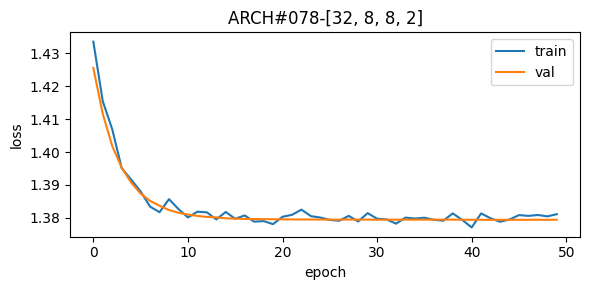


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86     10808
     Class 1       0.00      0.00      0.00       914
     Class 2       0.00      0.00      0.00      2475
     Class 3       0.00      0.00      0.00       182

    accuracy                           0.75     14379
   macro avg       0.19      0.25      0.21     14379
weighted avg       0.56      0.75      0.65     14379



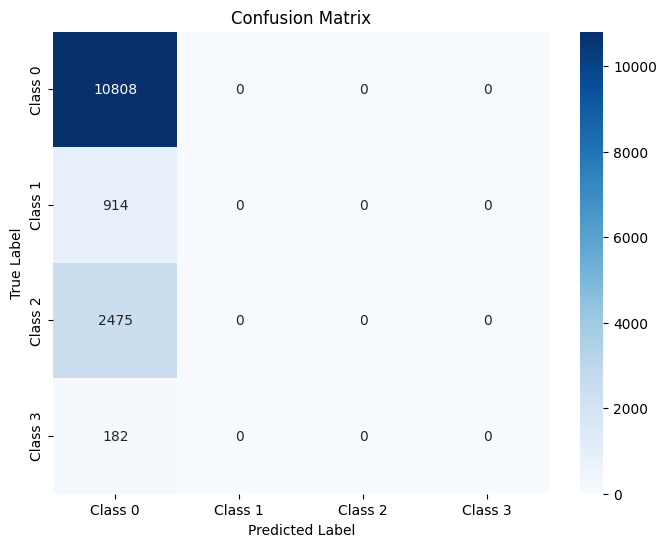

The function took 0.6244 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86      2702
     Class 1       0.00      0.00      0.00       228
     Class 2       0.00      0.00      0.00       619
     Class 3       0.00      0.00      0.00        46

    accuracy                           0.75      3595
   macro avg       0.19      0.25      0.21      3595
weighted avg       0.56      0.75      0.65      3595



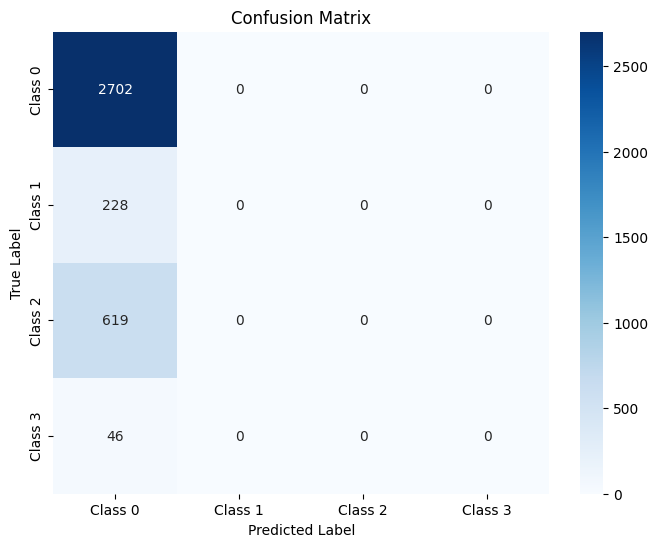

The function took 0.3694 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86      3378
     Class 1       0.00      0.00      0.00       285
     Class 2       0.00      0.00      0.00       774
     Class 3       0.00      0.00      0.00        57

    accuracy                           0.75      4494
   macro avg       0.19      0.25      0.21      4494
weighted avg       0.57      0.75      0.65      4494



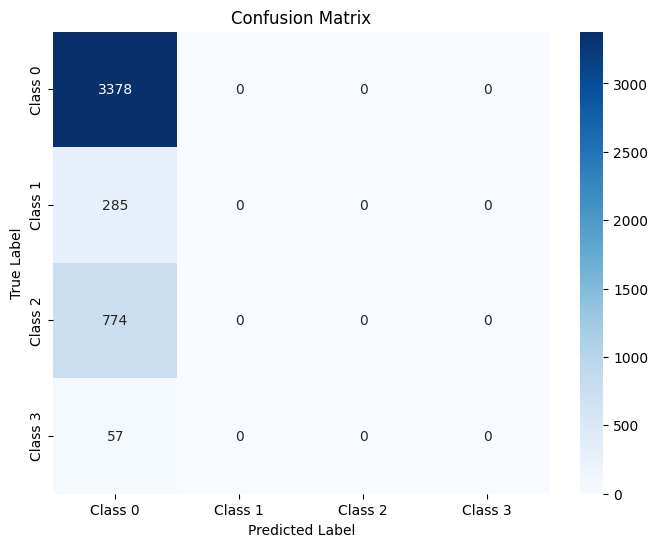

The function took 0.3726 seconds to execute.
[ARCH#079-[32, 8, 4, 4]] done in 33.0s  best-val=0.1367


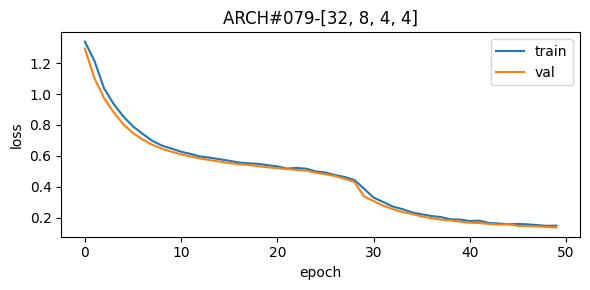


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.96      0.98     10808
     Class 1       0.81      0.95      0.87       914
     Class 2       0.93      0.98      0.96      2475
     Class 3       0.65      0.99      0.79       182

    accuracy                           0.96     14379
   macro avg       0.85      0.97      0.90     14379
weighted avg       0.97      0.96      0.96     14379



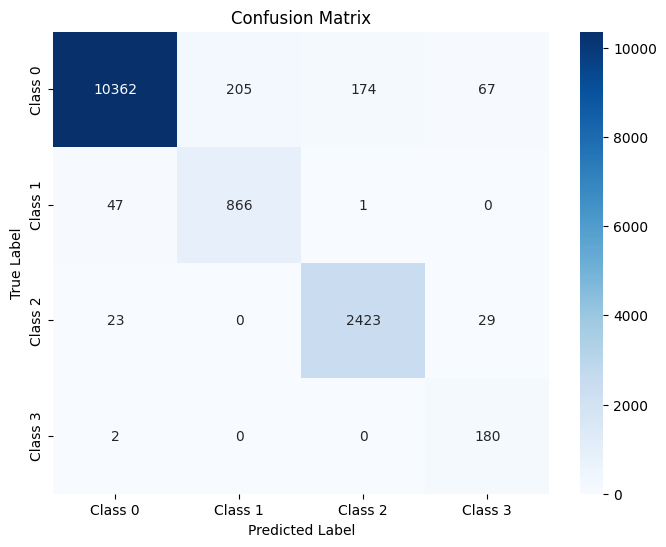

The function took 0.6214 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.96      0.97      2702
     Class 1       0.81      0.93      0.87       228
     Class 2       0.93      0.98      0.95       619
     Class 3       0.61      1.00      0.76        46

    accuracy                           0.96      3595
   macro avg       0.84      0.97      0.89      3595
weighted avg       0.96      0.96      0.96      3595



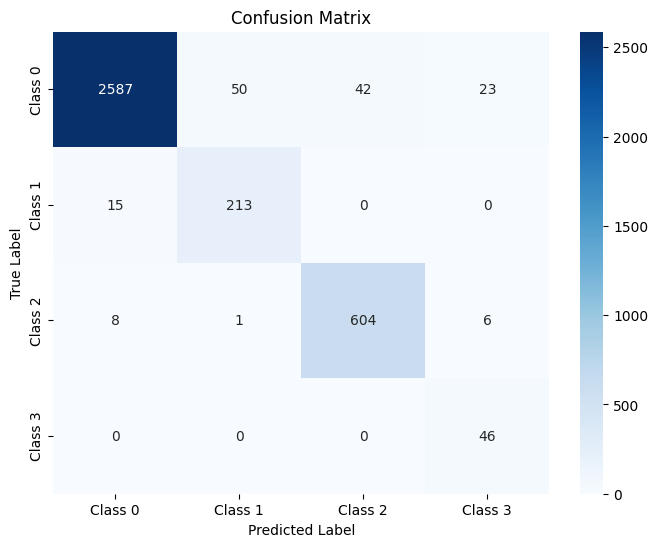

The function took 0.3567 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.96      0.98      3378
     Class 1       0.82      0.94      0.88       285
     Class 2       0.94      0.98      0.96       774
     Class 3       0.62      0.96      0.75        57

    accuracy                           0.96      4494
   macro avg       0.84      0.96      0.89      4494
weighted avg       0.97      0.96      0.96      4494



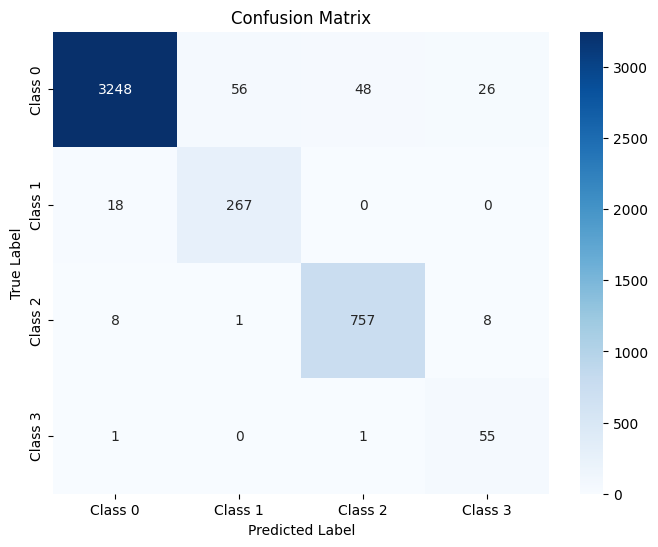

The function took 0.5116 seconds to execute.
[ARCH#080-[32, 8, 4, 2]] done in 32.3s  best-val=0.2261


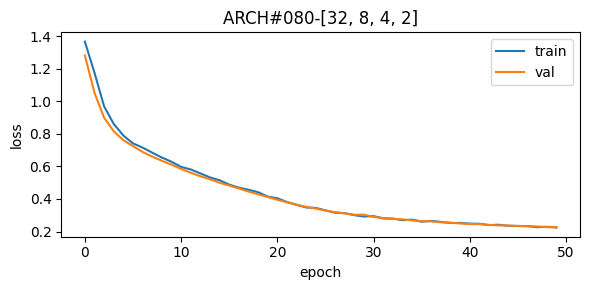


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.95      0.97     10808
     Class 1       0.75      0.90      0.82       914
     Class 2       0.89      0.98      0.94      2475
     Class 3       0.80      0.93      0.86       182

    accuracy                           0.95     14379
   macro avg       0.86      0.94      0.90     14379
weighted avg       0.95      0.95      0.95     14379



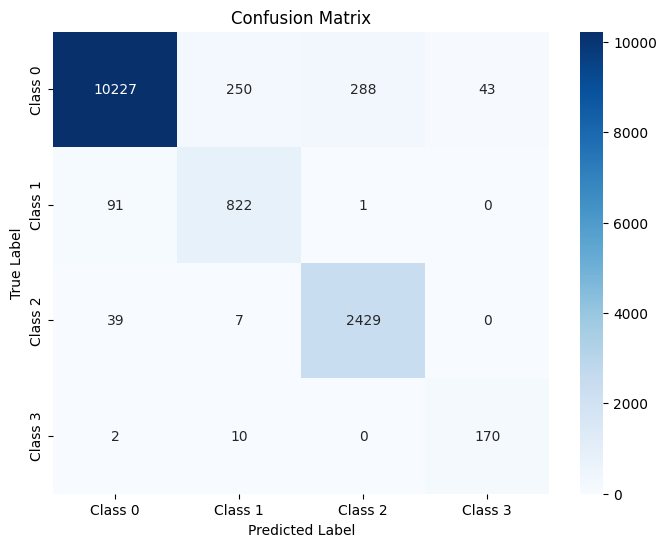

The function took 0.8509 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.95      0.97      2702
     Class 1       0.73      0.87      0.80       228
     Class 2       0.90      0.98      0.93       619
     Class 3       0.81      0.93      0.87        46

    accuracy                           0.95      3595
   macro avg       0.86      0.93      0.89      3595
weighted avg       0.95      0.95      0.95      3595



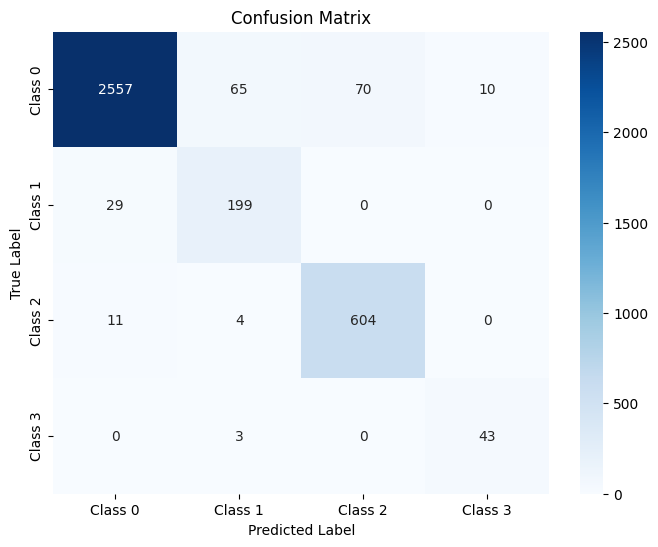

The function took 0.3481 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.95      0.97      3378
     Class 1       0.78      0.89      0.83       285
     Class 2       0.90      0.98      0.93       774
     Class 3       0.78      0.91      0.84        57

    accuracy                           0.95      4494
   macro avg       0.86      0.93      0.89      4494
weighted avg       0.95      0.95      0.95      4494



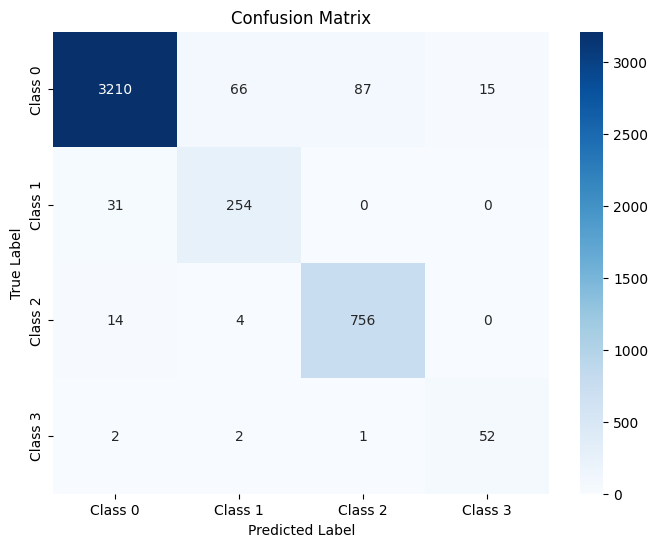

The function took 0.3775 seconds to execute.
[ARCH#081-[32, 8, 2, 2]] done in 32.5s  best-val=0.1272


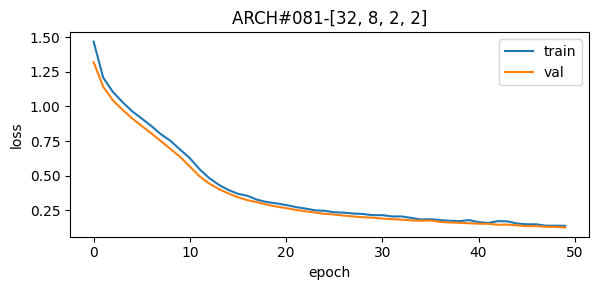


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.93      0.96     10808
     Class 1       0.72      1.00      0.83       914
     Class 2       0.87      0.97      0.92      2475
     Class 3       0.73      0.99      0.84       182

    accuracy                           0.94     14379
   macro avg       0.83      0.97      0.89     14379
weighted avg       0.95      0.94      0.94     14379



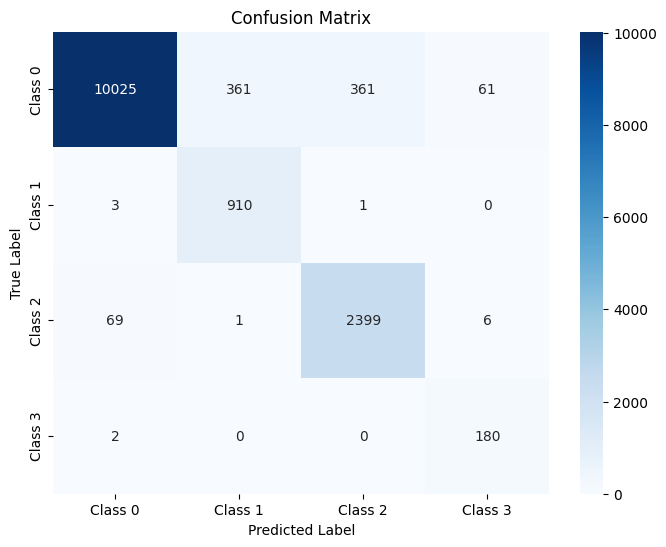

The function took 0.6519 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.93      0.96      2702
     Class 1       0.71      0.99      0.83       228
     Class 2       0.88      0.97      0.92       619
     Class 3       0.68      0.96      0.79        46

    accuracy                           0.94      3595
   macro avg       0.81      0.96      0.88      3595
weighted avg       0.95      0.94      0.94      3595



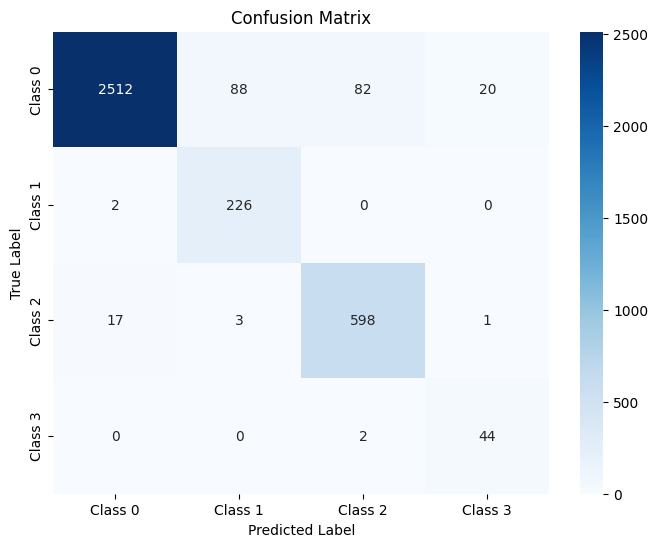

The function took 0.3379 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.93      0.96      3378
     Class 1       0.72      0.99      0.83       285
     Class 2       0.87      0.96      0.91       774
     Class 3       0.73      0.95      0.82        57

    accuracy                           0.94      4494
   macro avg       0.83      0.96      0.88      4494
weighted avg       0.95      0.94      0.94      4494



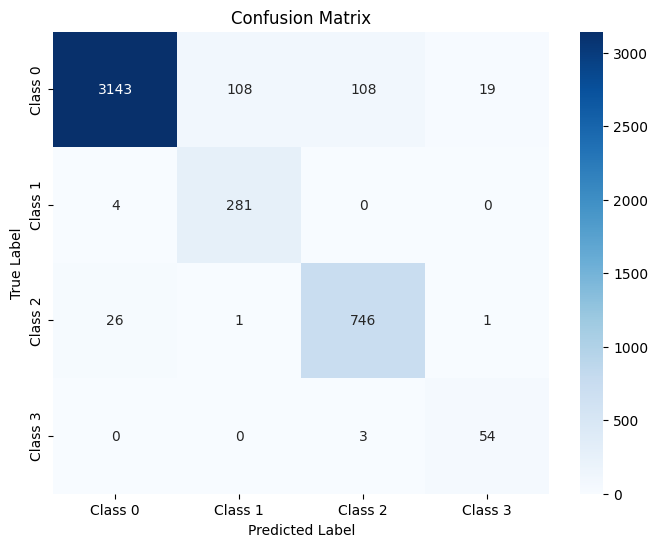

The function took 0.3524 seconds to execute.
[ARCH#082-[32, 4, 4, 4]] done in 32.4s  best-val=0.2887


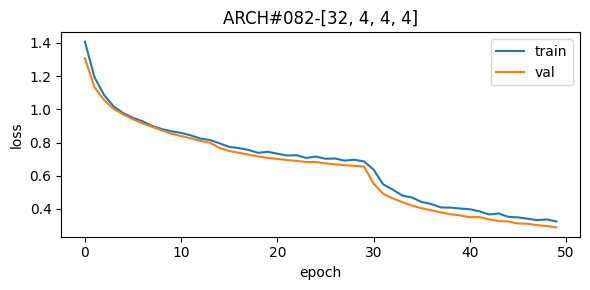


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.79      0.88     10808
     Class 1       0.31      0.95      0.46       914
     Class 2       0.91      0.98      0.94      2475
     Class 3       0.55      0.90      0.68       182

    accuracy                           0.83     14379
   macro avg       0.69      0.90      0.74     14379
weighted avg       0.93      0.83      0.86     14379



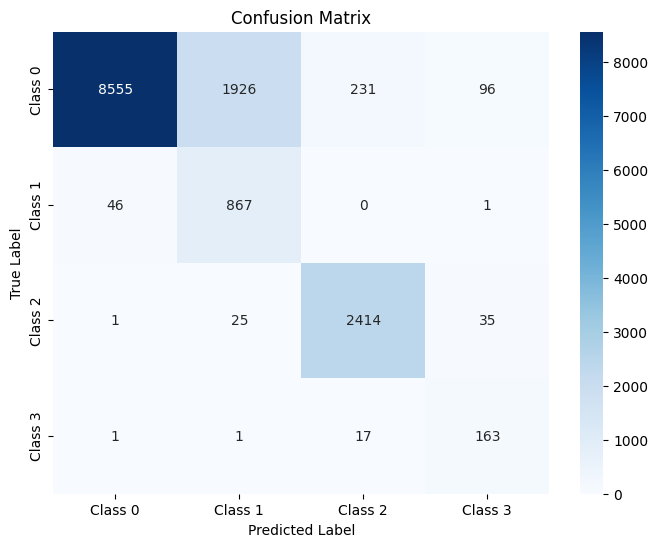

The function took 0.5373 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.80      0.89      2702
     Class 1       0.32      0.94      0.47       228
     Class 2       0.91      0.96      0.94       619
     Class 3       0.51      0.89      0.65        46

    accuracy                           0.84      3595
   macro avg       0.68      0.90      0.74      3595
weighted avg       0.93      0.84      0.87      3595



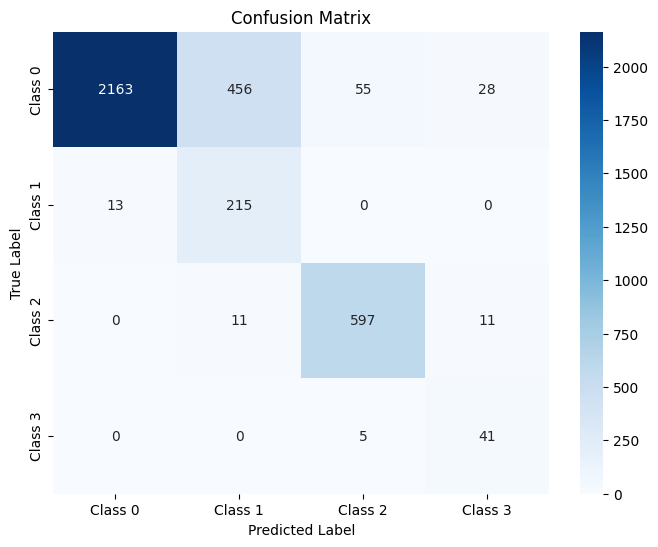

The function took 0.3480 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.79      0.88      3378
     Class 1       0.31      0.95      0.46       285
     Class 2       0.92      0.97      0.95       774
     Class 3       0.55      0.89      0.68        57

    accuracy                           0.84      4494
   macro avg       0.69      0.90      0.74      4494
weighted avg       0.93      0.84      0.86      4494



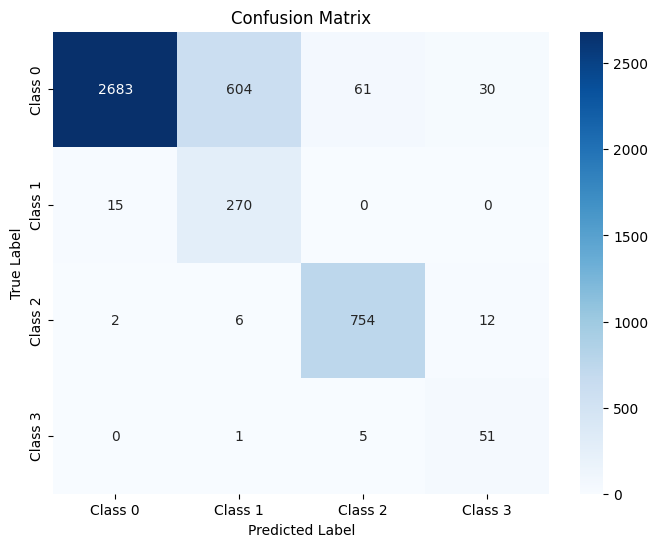

The function took 0.3670 seconds to execute.
[ARCH#083-[32, 4, 4, 2]] done in 32.3s  best-val=0.2043


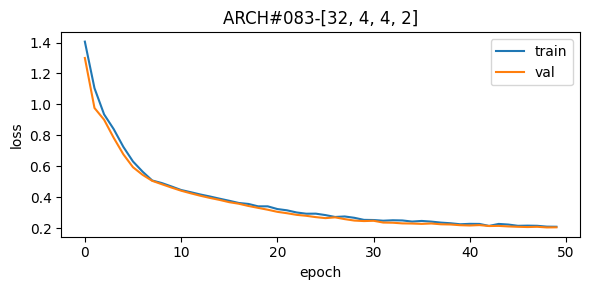


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.97      0.93      0.95     10808
     Class 1       0.63      1.00      0.77       914
     Class 2       0.91      0.86      0.89      2475
     Class 3       0.64      0.93      0.76       182

    accuracy                           0.92     14379
   macro avg       0.79      0.93      0.84     14379
weighted avg       0.93      0.92      0.92     14379



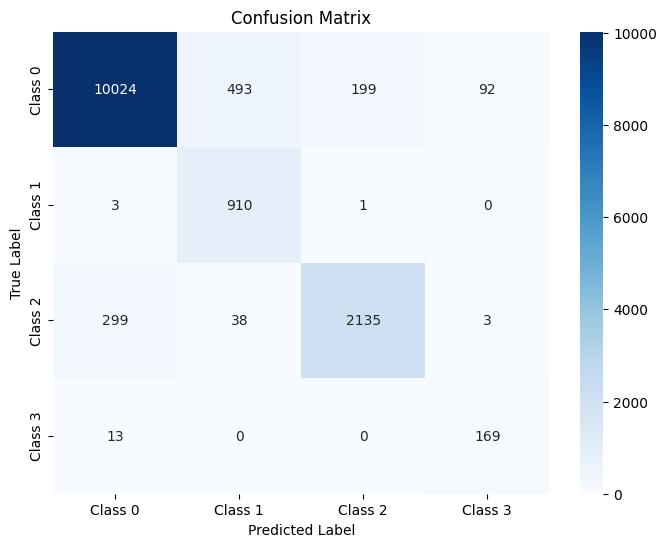

The function took 0.5467 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.97      0.93      0.95      2702
     Class 1       0.66      0.99      0.79       228
     Class 2       0.91      0.88      0.90       619
     Class 3       0.67      0.93      0.78        46

    accuracy                           0.93      3595
   macro avg       0.81      0.94      0.86      3595
weighted avg       0.94      0.93      0.93      3595



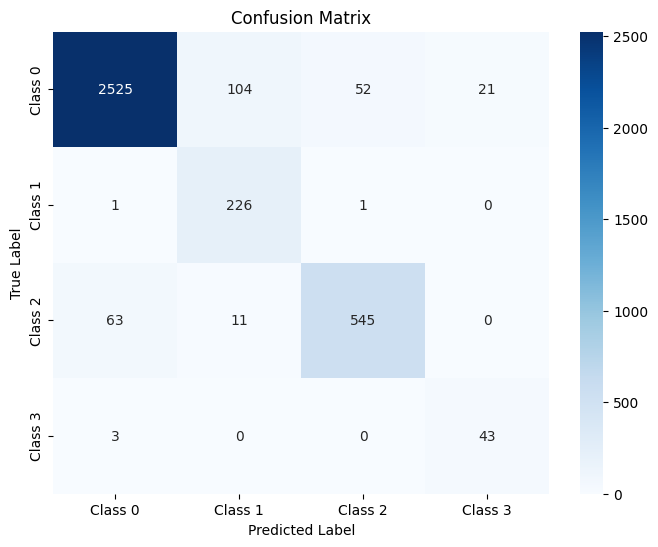

The function took 0.3558 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.96      0.93      0.95      3378
     Class 1       0.64      0.99      0.77       285
     Class 2       0.92      0.84      0.88       774
     Class 3       0.63      0.96      0.76        57

    accuracy                           0.92      4494
   macro avg       0.79      0.93      0.84      4494
weighted avg       0.93      0.92      0.92      4494



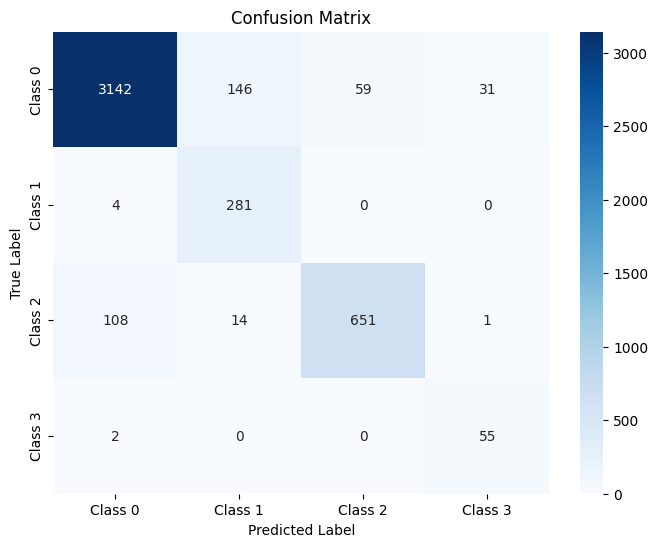

The function took 0.3708 seconds to execute.
[ARCH#084-[32, 4, 2, 2]] done in 32.5s  best-val=0.2598


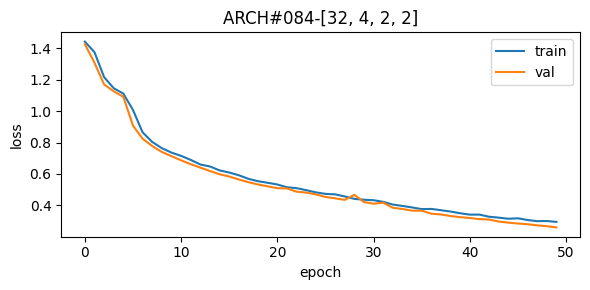


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.82      0.90     10808
     Class 1       0.86      0.96      0.90       914
     Class 2       0.61      0.95      0.74      2475
     Class 3       0.36      0.93      0.51       182

    accuracy                           0.85     14379
   macro avg       0.70      0.92      0.76     14379
weighted avg       0.91      0.85      0.87     14379



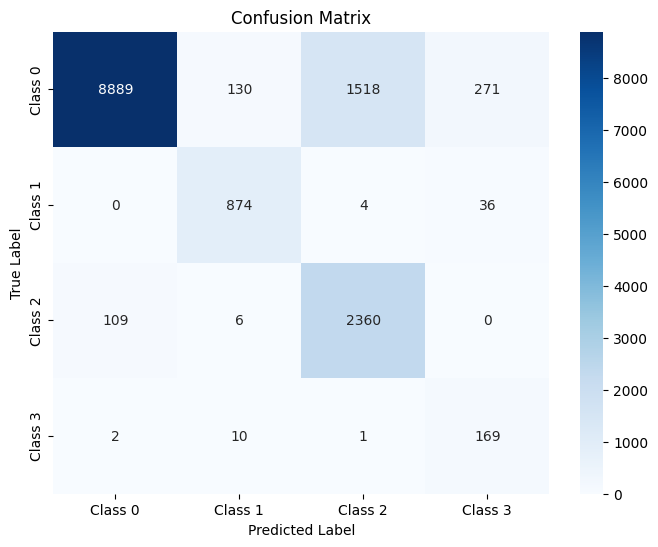

The function took 0.6917 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.82      0.89      2702
     Class 1       0.82      0.94      0.88       228
     Class 2       0.60      0.96      0.74       619
     Class 3       0.37      0.93      0.53        46

    accuracy                           0.85      3595
   macro avg       0.70      0.91      0.76      3595
weighted avg       0.90      0.85      0.86      3595



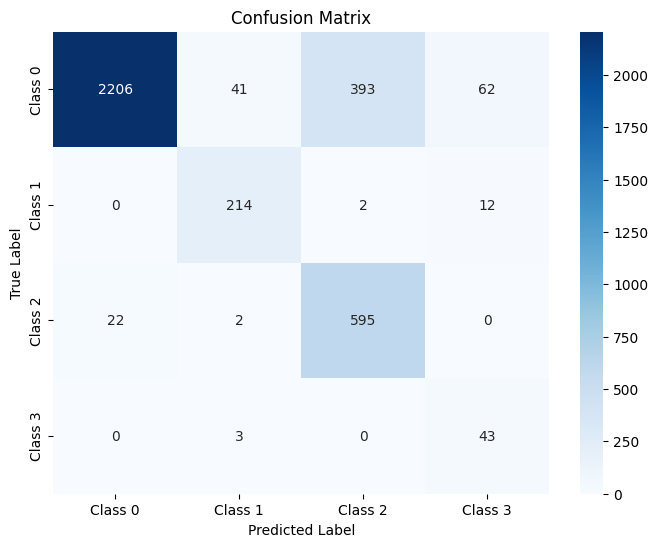

The function took 0.3458 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.82      0.90      3378
     Class 1       0.87      0.94      0.90       285
     Class 2       0.60      0.94      0.73       774
     Class 3       0.36      0.93      0.52        57

    accuracy                           0.85      4494
   macro avg       0.70      0.91      0.76      4494
weighted avg       0.90      0.85      0.86      4494



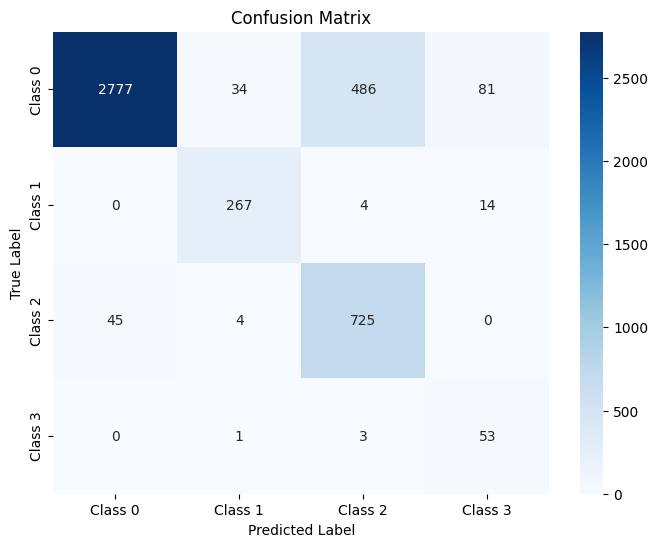

The function took 0.7329 seconds to execute.
[ARCH#085-[32, 2, 2, 2]] done in 32.7s  best-val=0.3675


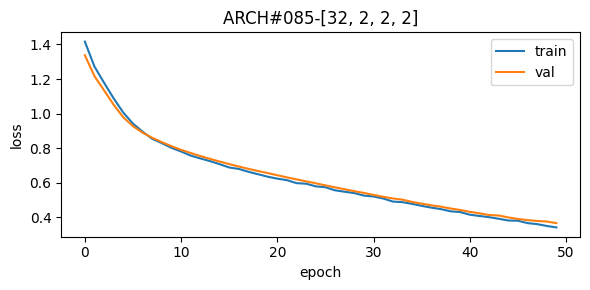


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.89      0.94     10808
     Class 1       0.65      0.96      0.78       914
     Class 2       0.90      0.99      0.94      2475
     Class 3       0.25      0.98      0.40       182

    accuracy                           0.91     14379
   macro avg       0.70      0.95      0.76     14379
weighted avg       0.95      0.91      0.92     14379



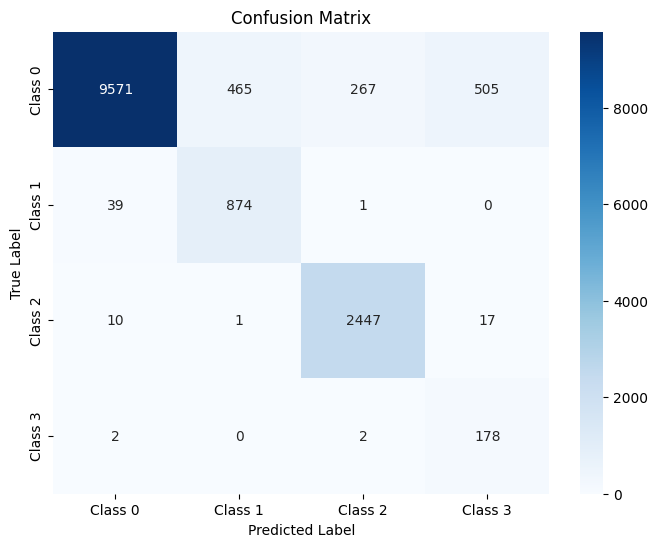

The function took 0.7286 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.89      0.94      2702
     Class 1       0.65      0.94      0.77       228
     Class 2       0.90      0.99      0.94       619
     Class 3       0.28      0.96      0.44        46

    accuracy                           0.91      3595
   macro avg       0.70      0.95      0.77      3595
weighted avg       0.95      0.91      0.92      3595



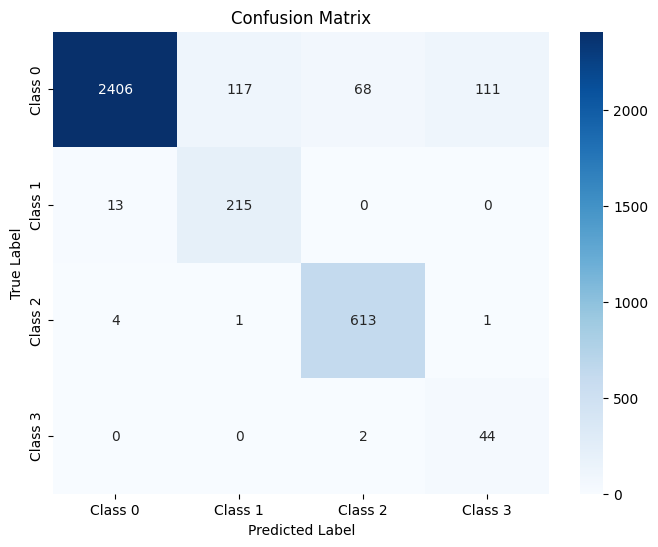

The function took 0.5778 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.89      0.94      3378
     Class 1       0.64      0.94      0.76       285
     Class 2       0.90      0.99      0.94       774
     Class 3       0.24      0.89      0.37        57

    accuracy                           0.91      4494
   macro avg       0.69      0.93      0.75      4494
weighted avg       0.94      0.91      0.92      4494



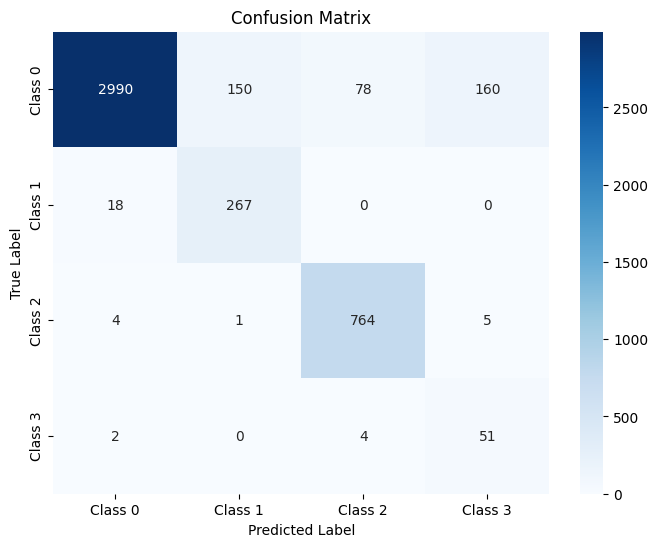

The function took 0.4168 seconds to execute.
[ARCH#086-[16, 16, 16, 16]] done in 32.5s  best-val=0.0842


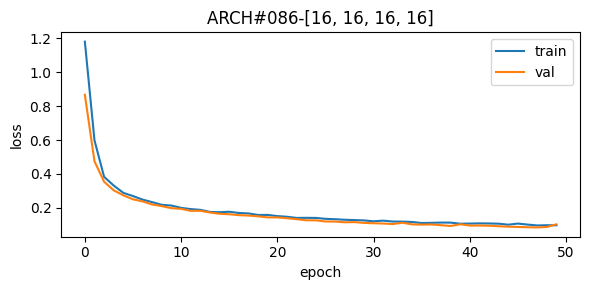


Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.95      0.97     10808
     Class 1       0.81      1.00      0.89       914
     Class 2       0.91      0.98      0.94      2475
     Class 3       0.70      0.93      0.80       182

    accuracy                           0.96     14379
   macro avg       0.85      0.97      0.90     14379
weighted avg       0.96      0.96      0.96     14379



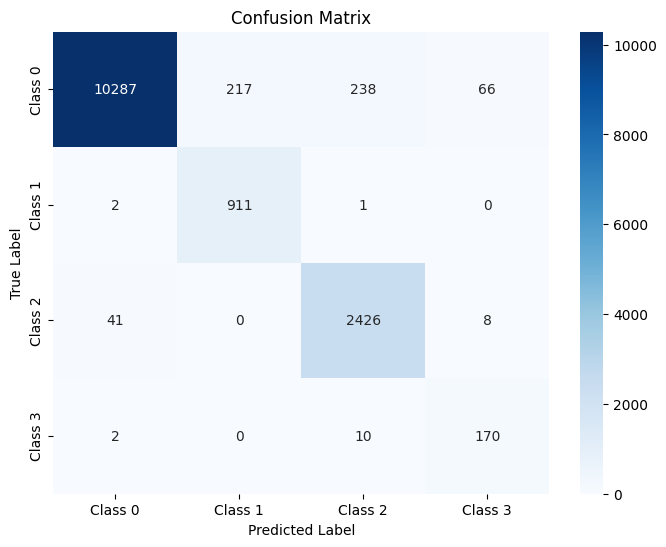

The function took 0.5232 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.95      0.97      2702
     Class 1       0.78      0.99      0.87       228
     Class 2       0.90      0.99      0.94       619
     Class 3       0.75      0.93      0.83        46

    accuracy                           0.96      3595
   macro avg       0.86      0.97      0.91      3595
weighted avg       0.96      0.96      0.96      3595



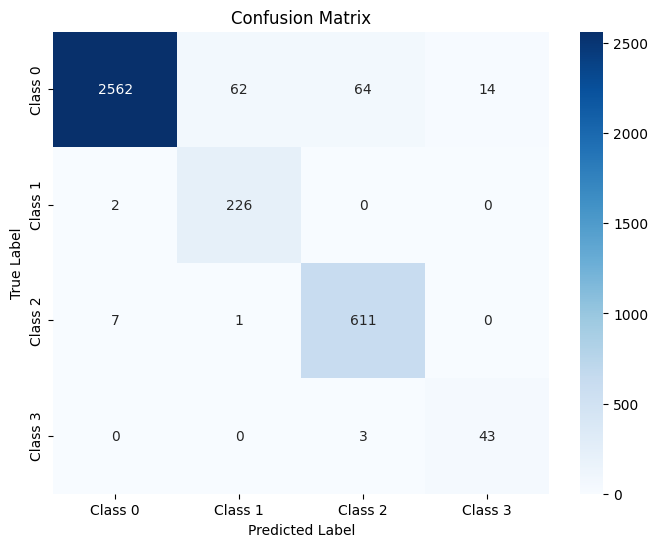

The function took 0.3588 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.95      0.97      3378
     Class 1       0.82      0.99      0.89       285
     Class 2       0.91      0.98      0.95       774
     Class 3       0.67      0.95      0.78        57

    accuracy                           0.96      4494
   macro avg       0.85      0.97      0.90      4494
weighted avg       0.96      0.96      0.96      4494



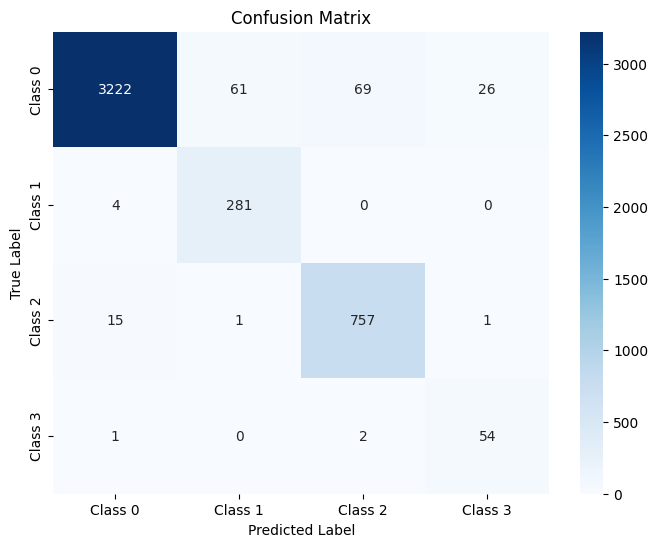

The function took 0.3705 seconds to execute.
[ARCH#087-[16, 16, 16, 8]] done in 33.2s  best-val=0.0818


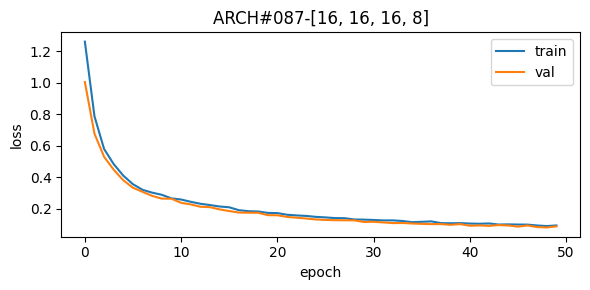


Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.94      0.97     10808
     Class 1       0.77      1.00      0.87       914
     Class 2       0.89      0.99      0.94      2475
     Class 3       0.64      0.98      0.77       182

    accuracy                           0.95     14379
   macro avg       0.82      0.98      0.89     14379
weighted avg       0.96      0.95      0.95     14379



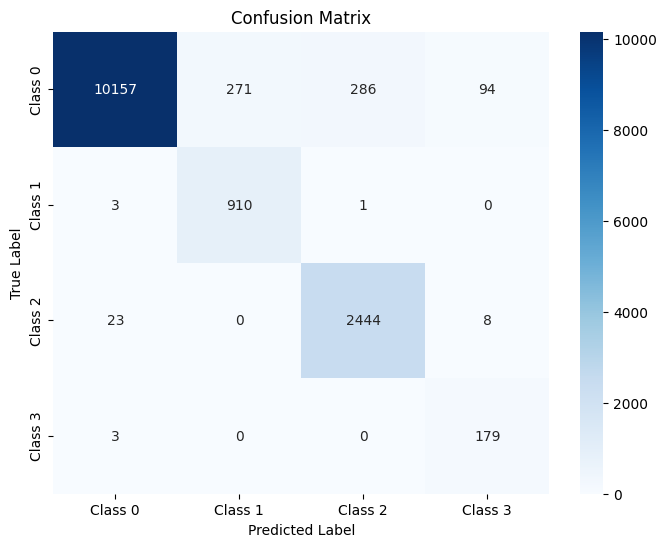

The function took 0.6257 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.94      0.97      2702
     Class 1       0.77      1.00      0.87       228
     Class 2       0.88      0.99      0.93       619
     Class 3       0.68      1.00      0.81        46

    accuracy                           0.95      3595
   macro avg       0.83      0.98      0.89      3595
weighted avg       0.96      0.95      0.95      3595



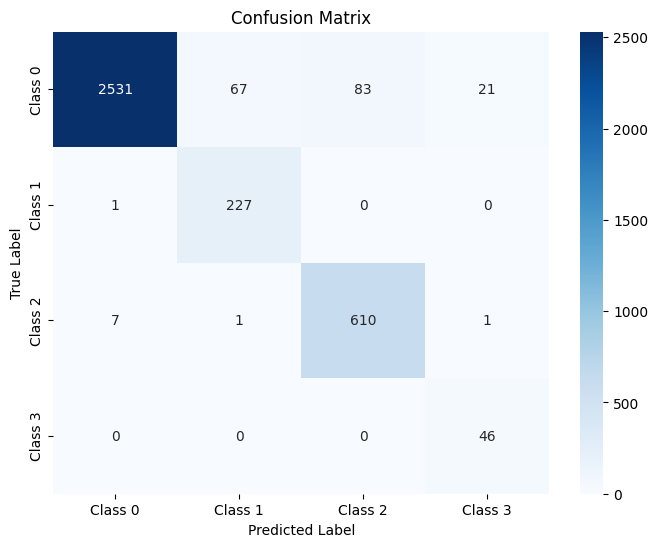

The function took 0.3279 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.94      0.97      3378
     Class 1       0.78      0.99      0.87       285
     Class 2       0.91      0.99      0.95       774
     Class 3       0.61      0.95      0.74        57

    accuracy                           0.95      4494
   macro avg       0.82      0.97      0.88      4494
weighted avg       0.96      0.95      0.96      4494



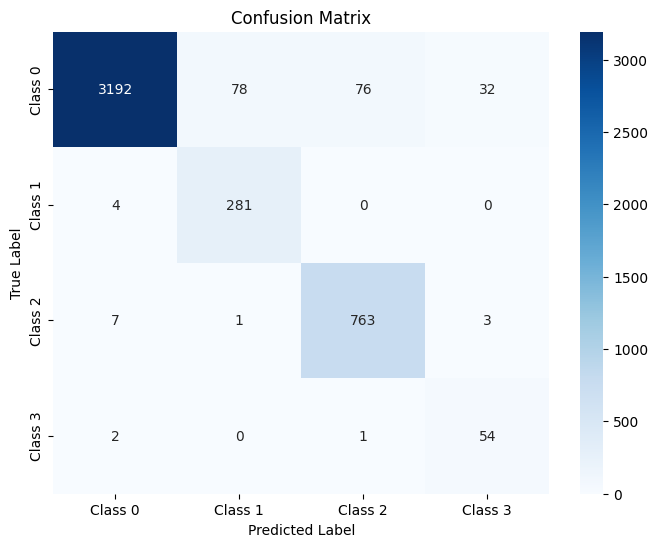

The function took 0.3751 seconds to execute.
[ARCH#088-[16, 16, 16, 4]] early-stop @ epoch 041
[ARCH#088-[16, 16, 16, 4]] done in 28.1s  best-val=1.3794


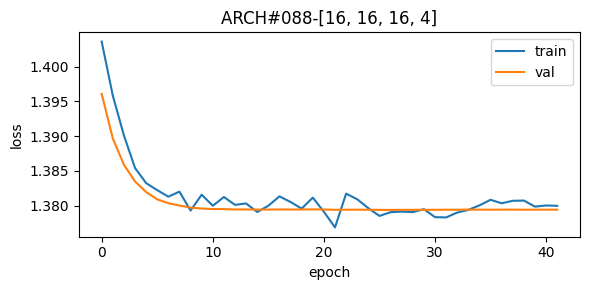


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86     10808
     Class 1       0.00      0.00      0.00       914
     Class 2       0.00      0.00      0.00      2475
     Class 3       0.00      0.00      0.00       182

    accuracy                           0.75     14379
   macro avg       0.19      0.25      0.21     14379
weighted avg       0.56      0.75      0.65     14379



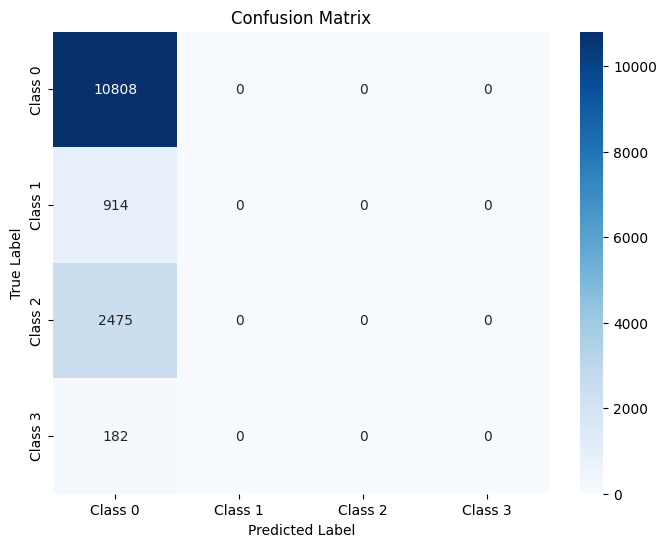

The function took 0.6327 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86      2702
     Class 1       0.00      0.00      0.00       228
     Class 2       0.00      0.00      0.00       619
     Class 3       0.00      0.00      0.00        46

    accuracy                           0.75      3595
   macro avg       0.19      0.25      0.21      3595
weighted avg       0.56      0.75      0.65      3595



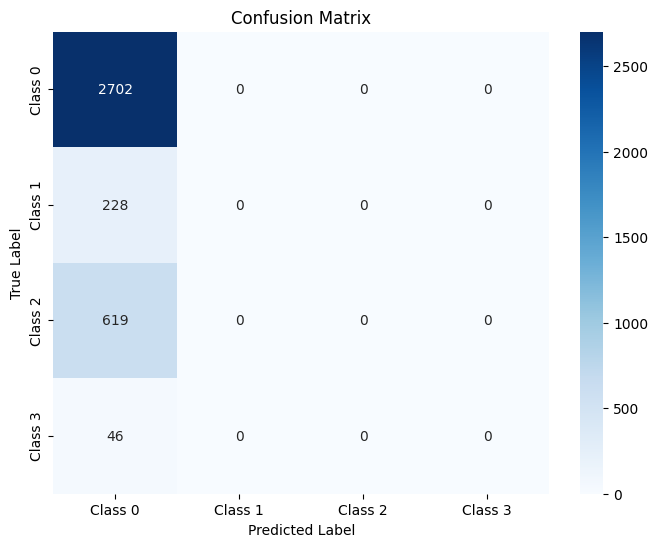

The function took 0.5073 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86      3378
     Class 1       0.00      0.00      0.00       285
     Class 2       0.00      0.00      0.00       774
     Class 3       0.00      0.00      0.00        57

    accuracy                           0.75      4494
   macro avg       0.19      0.25      0.21      4494
weighted avg       0.57      0.75      0.65      4494



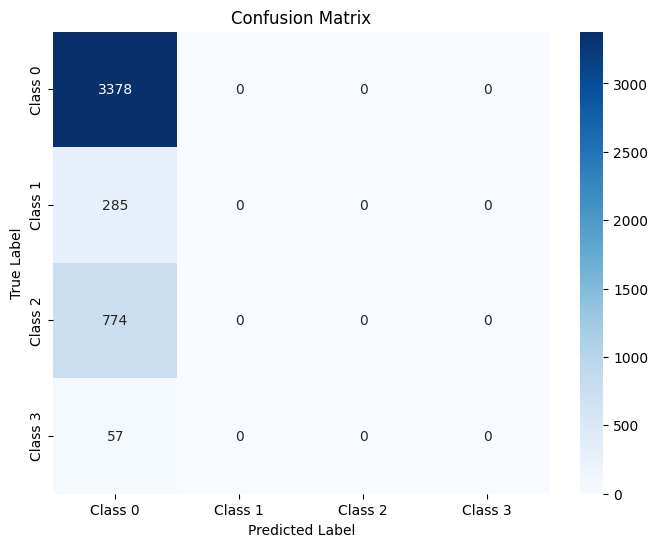

The function took 0.3875 seconds to execute.
[ARCH#089-[16, 16, 16, 2]] done in 32.4s  best-val=0.1139


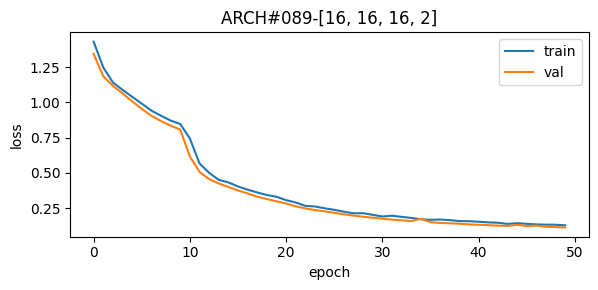


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.95      0.97     10808
     Class 1       0.84      1.00      0.91       914
     Class 2       0.92      0.93      0.93      2475
     Class 3       0.56      0.99      0.72       182

    accuracy                           0.95     14379
   macro avg       0.83      0.97      0.88     14379
weighted avg       0.96      0.95      0.96     14379



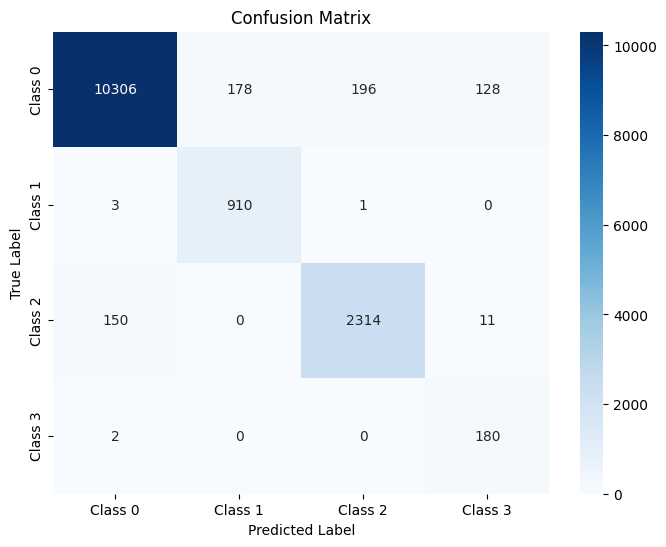

The function took 0.8725 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.95      0.97      2702
     Class 1       0.82      0.99      0.90       228
     Class 2       0.92      0.95      0.93       619
     Class 3       0.64      1.00      0.78        46

    accuracy                           0.96      3595
   macro avg       0.84      0.97      0.90      3595
weighted avg       0.96      0.96      0.96      3595



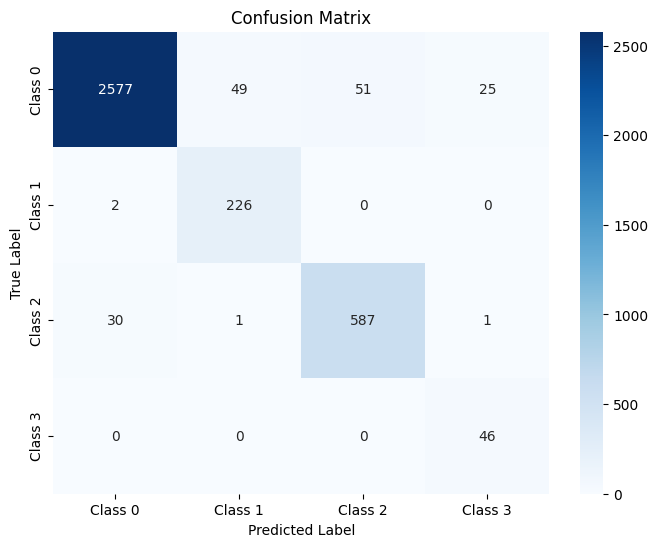

The function took 0.5254 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.96      0.97      3378
     Class 1       0.84      0.99      0.91       285
     Class 2       0.92      0.91      0.92       774
     Class 3       0.56      0.96      0.71        57

    accuracy                           0.95      4494
   macro avg       0.83      0.96      0.88      4494
weighted avg       0.96      0.95      0.95      4494



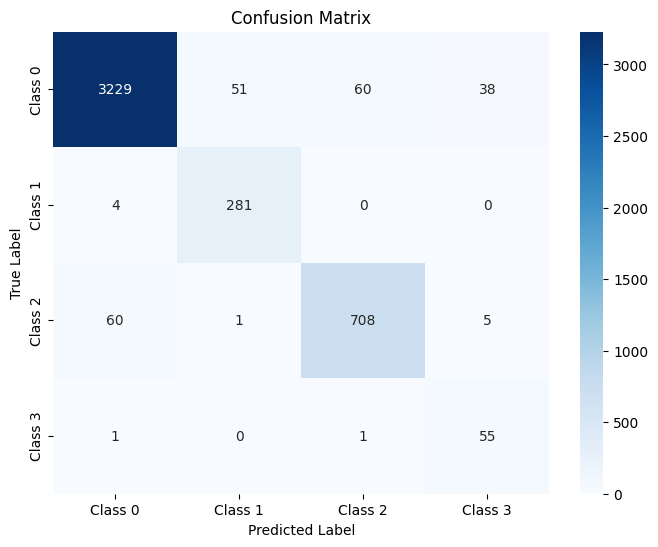

The function took 0.4614 seconds to execute.
[ARCH#090-[16, 16, 8, 8]] done in 32.1s  best-val=0.1262


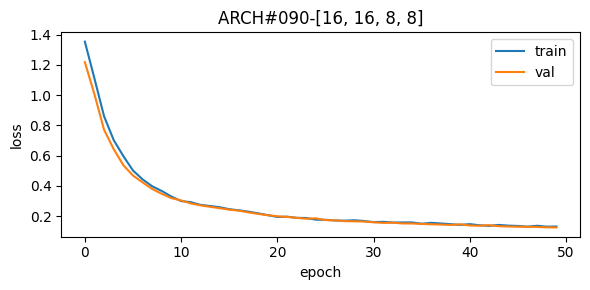


Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.91      0.95     10808
     Class 1       0.85      0.96      0.90       914
     Class 2       0.89      0.99      0.94      2475
     Class 3       0.24      0.93      0.38       182

    accuracy                           0.93     14379
   macro avg       0.74      0.95      0.79     14379
weighted avg       0.96      0.93      0.94     14379



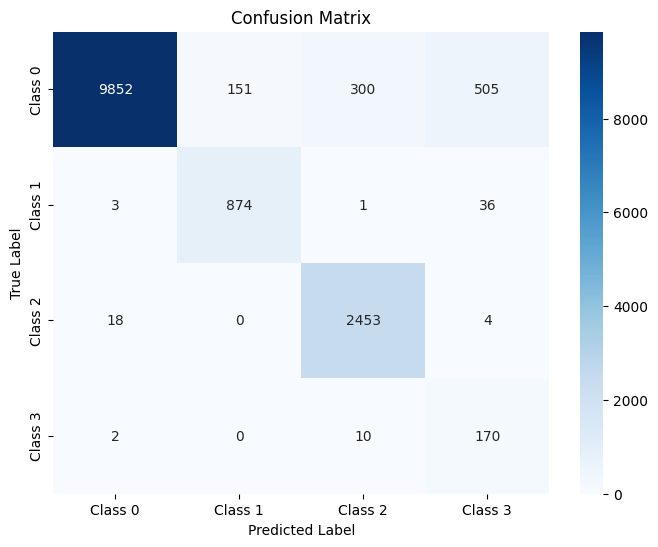

The function took 0.6618 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.91      0.95      2702
     Class 1       0.85      0.94      0.89       228
     Class 2       0.87      0.99      0.93       619
     Class 3       0.24      0.93      0.38        46

    accuracy                           0.92      3595
   macro avg       0.74      0.94      0.79      3595
weighted avg       0.96      0.92      0.94      3595



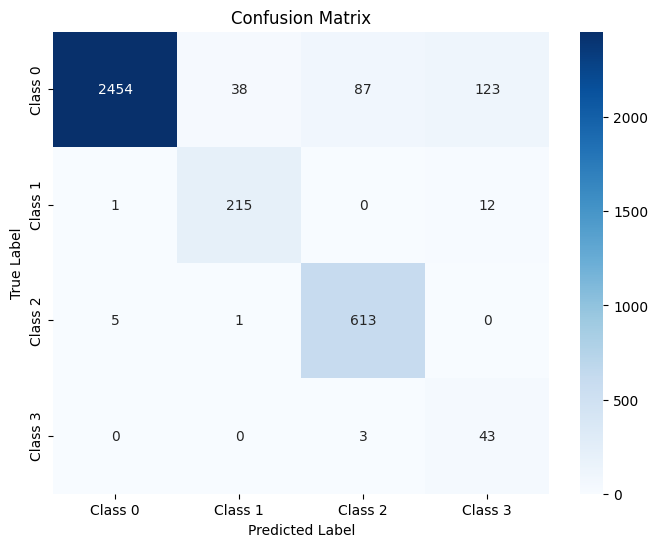

The function took 0.3279 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.92      0.96      3378
     Class 1       0.86      0.94      0.90       285
     Class 2       0.90      0.99      0.95       774
     Class 3       0.23      0.93      0.37        57

    accuracy                           0.93      4494
   macro avg       0.75      0.94      0.79      4494
weighted avg       0.96      0.93      0.94      4494



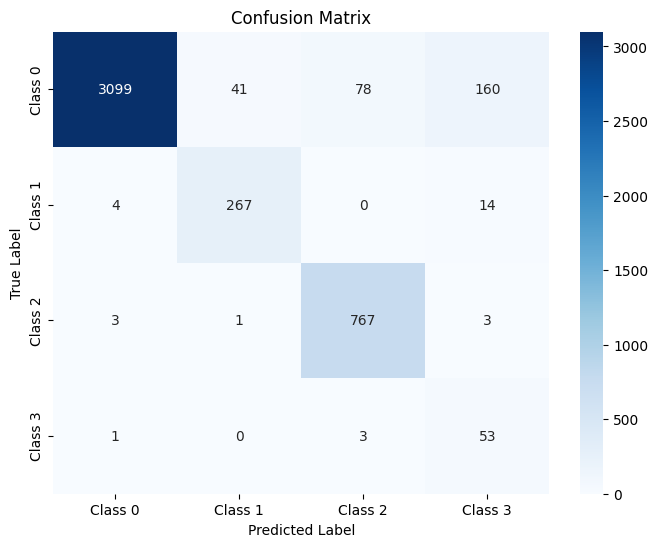

The function took 0.3951 seconds to execute.
[ARCH#091-[16, 16, 8, 4]] done in 32.4s  best-val=0.1305


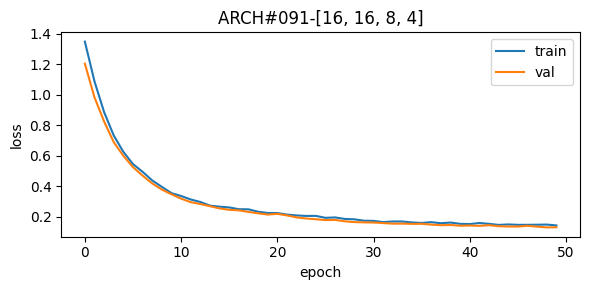


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.94      0.97     10808
     Class 1       0.73      1.00      0.84       914
     Class 2       0.91      0.96      0.93      2475
     Class 3       0.55      0.93      0.69       182

    accuracy                           0.95     14379
   macro avg       0.80      0.96      0.86     14379
weighted avg       0.96      0.95      0.95     14379



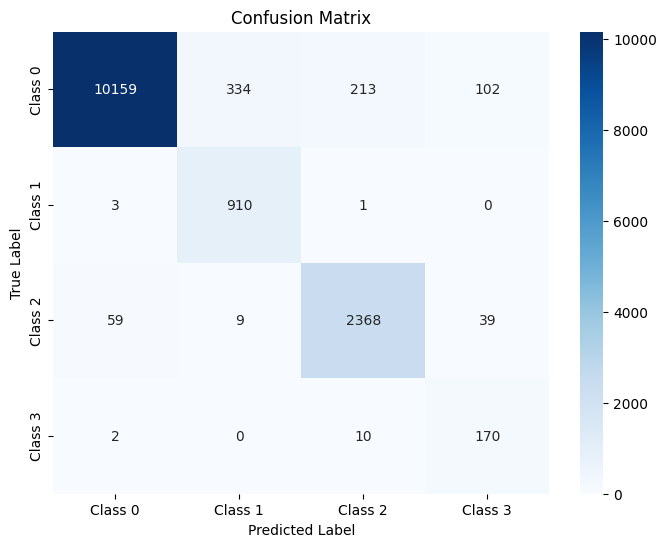

The function took 0.5374 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.94      0.97      2702
     Class 1       0.74      1.00      0.85       228
     Class 2       0.91      0.95      0.93       619
     Class 3       0.57      0.93      0.70        46

    accuracy                           0.95      3595
   macro avg       0.80      0.96      0.86      3595
weighted avg       0.96      0.95      0.95      3595



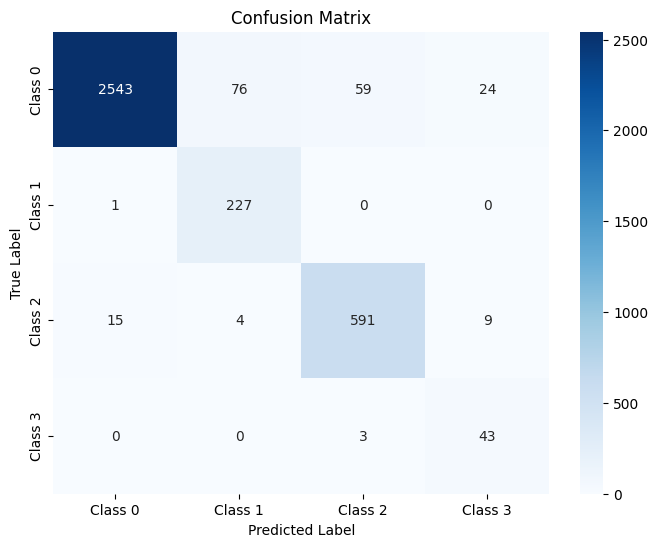

The function took 0.8465 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.95      0.97      3378
     Class 1       0.75      0.99      0.85       285
     Class 2       0.93      0.94      0.94       774
     Class 3       0.51      0.96      0.67        57

    accuracy                           0.95      4494
   macro avg       0.80      0.96      0.86      4494
weighted avg       0.96      0.95      0.95      4494



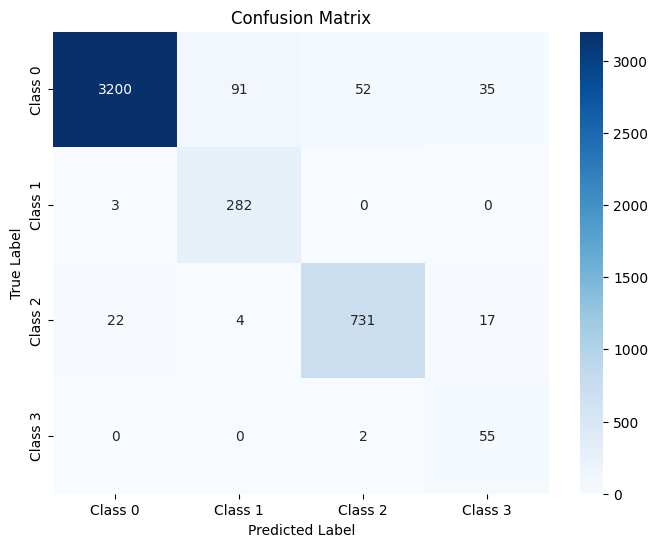

The function took 0.3769 seconds to execute.
[ARCH#092-[16, 16, 8, 2]] done in 33.0s  best-val=0.5714


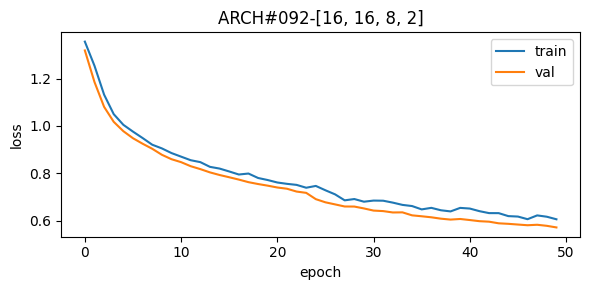


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.86      0.93     10808
     Class 1       0.42      0.95      0.58       914
     Class 2       0.85      0.97      0.91      2475
     Class 3       0.08      0.03      0.04       182

    accuracy                           0.88     14379
   macro avg       0.58      0.70      0.61     14379
weighted avg       0.92      0.88      0.89     14379



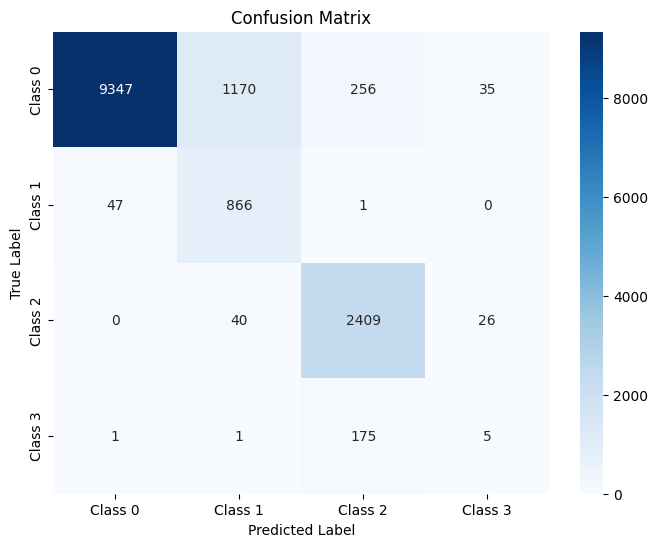

The function took 0.5321 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.87      0.93      2702
     Class 1       0.43      0.94      0.59       228
     Class 2       0.85      0.98      0.91       619
     Class 3       0.18      0.04      0.07        46

    accuracy                           0.89      3595
   macro avg       0.61      0.71      0.63      3595
weighted avg       0.92      0.89      0.89      3595



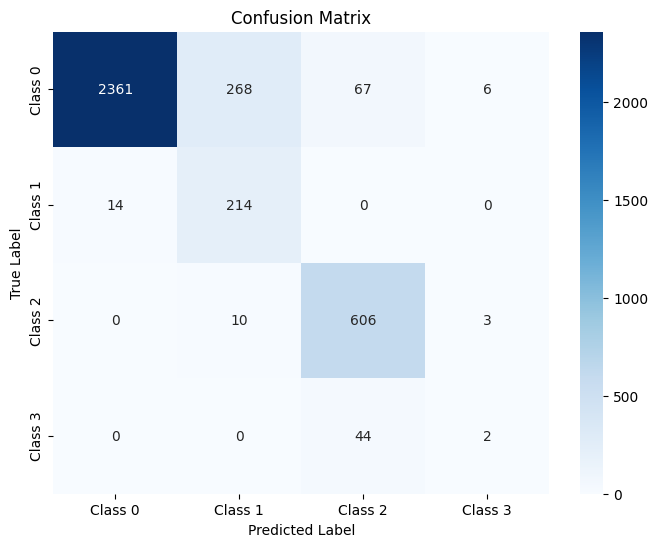

The function took 0.4776 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.86      0.92      3378
     Class 1       0.41      0.94      0.57       285
     Class 2       0.85      0.97      0.91       774
     Class 3       0.10      0.04      0.05        57

    accuracy                           0.88      4494
   macro avg       0.59      0.70      0.62      4494
weighted avg       0.92      0.88      0.89      4494



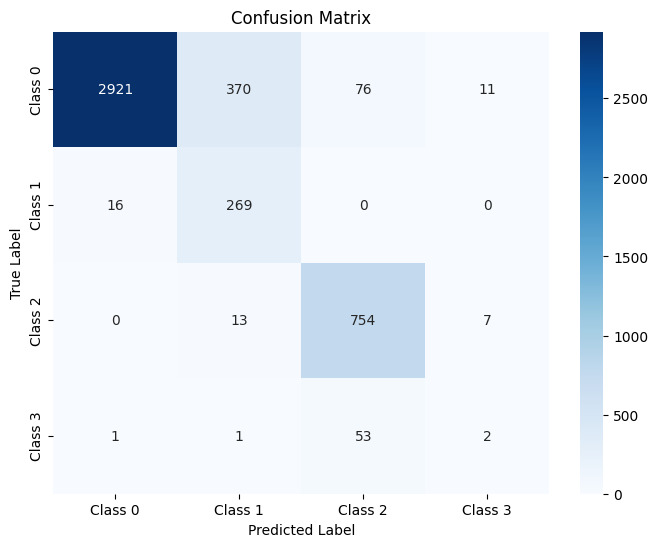

The function took 0.3799 seconds to execute.
[ARCH#093-[16, 16, 4, 4]] done in 32.8s  best-val=0.1384


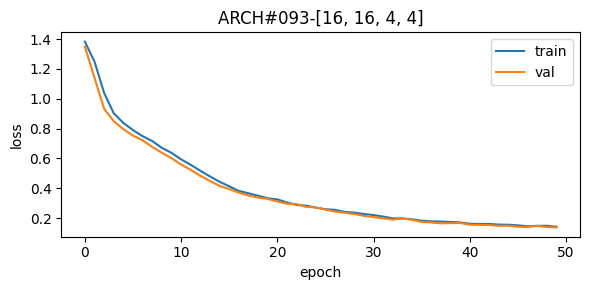


Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.93      0.96     10808
     Class 1       0.76      1.00      0.86       914
     Class 2       0.87      0.99      0.93      2475
     Class 3       0.67      0.93      0.78       182

    accuracy                           0.95     14379
   macro avg       0.83      0.96      0.88     14379
weighted avg       0.96      0.95      0.95     14379



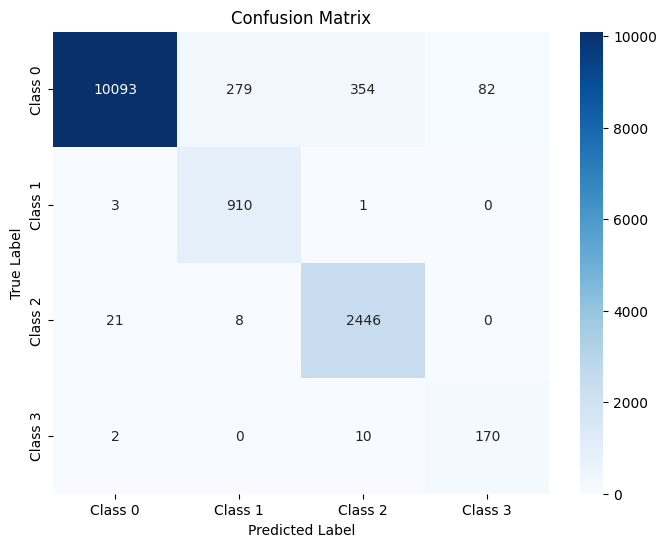

The function took 0.6715 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.93      0.96      2702
     Class 1       0.77      1.00      0.87       228
     Class 2       0.86      0.99      0.92       619
     Class 3       0.65      0.93      0.77        46

    accuracy                           0.95      3595
   macro avg       0.82      0.96      0.88      3595
weighted avg       0.96      0.95      0.95      3595



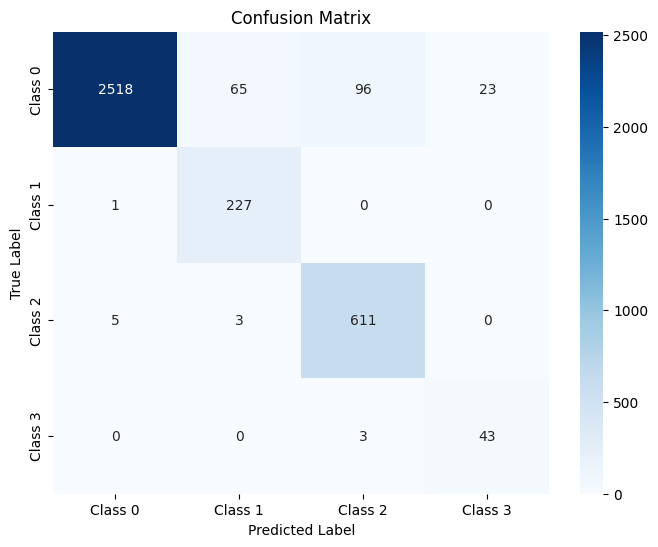

The function took 0.3534 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.93      0.96      3378
     Class 1       0.74      0.99      0.85       285
     Class 2       0.88      0.99      0.93       774
     Class 3       0.63      0.91      0.74        57

    accuracy                           0.95      4494
   macro avg       0.81      0.95      0.87      4494
weighted avg       0.96      0.95      0.95      4494



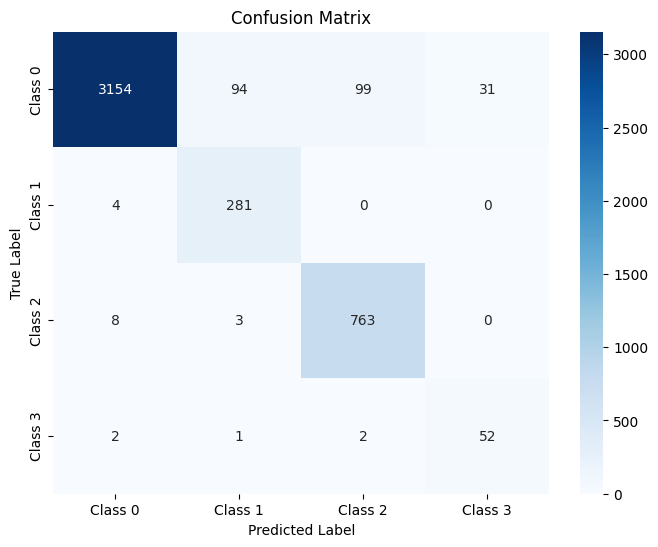

The function took 0.3711 seconds to execute.
[ARCH#094-[16, 16, 4, 2]] done in 32.5s  best-val=0.9205


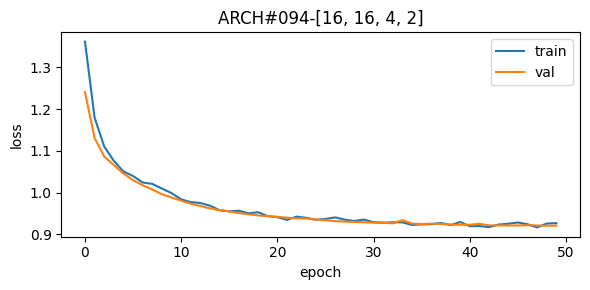


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.76      0.93      0.84     10808
     Class 1       0.00      0.00      0.00       914
     Class 2       0.25      0.10      0.14      2475
     Class 3       0.67      0.96      0.79       182

    accuracy                           0.72     14379
   macro avg       0.42      0.50      0.44     14379
weighted avg       0.62      0.72      0.66     14379



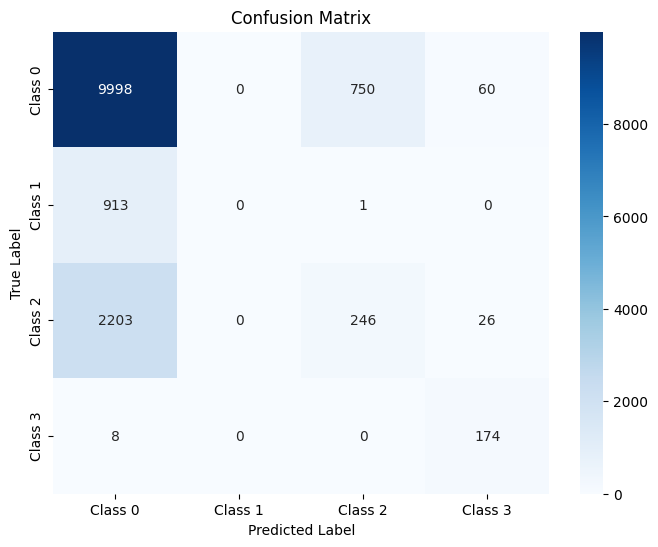

The function took 0.6138 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.76      0.93      0.84      2702
     Class 1       0.00      0.00      0.00       228
     Class 2       0.24      0.09      0.13       619
     Class 3       0.66      0.96      0.78        46

    accuracy                           0.73      3595
   macro avg       0.41      0.49      0.44      3595
weighted avg       0.62      0.73      0.66      3595



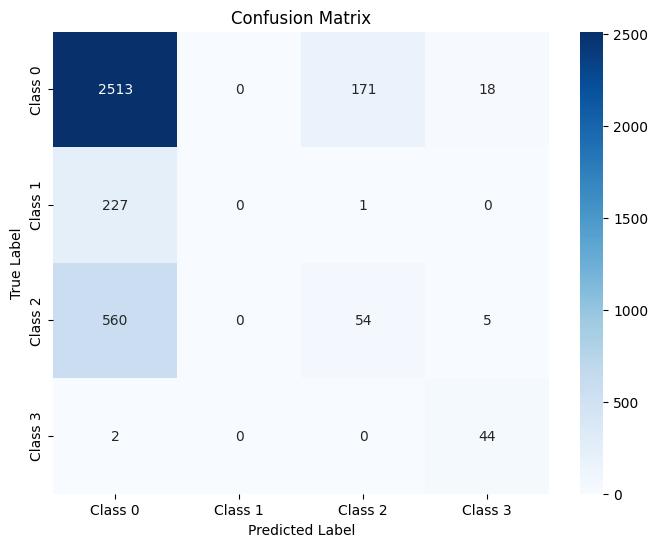

The function took 0.4098 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.77      0.93      0.84      3378
     Class 1       0.00      0.00      0.00       285
     Class 2       0.30      0.11      0.17       774
     Class 3       0.62      0.93      0.75        57

    accuracy                           0.73      4494
   macro avg       0.42      0.49      0.44      4494
weighted avg       0.64      0.73      0.67      4494



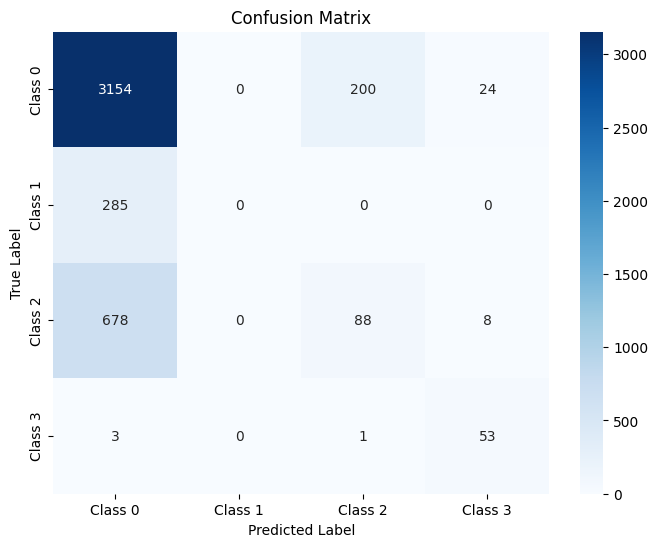

The function took 0.4541 seconds to execute.
[ARCH#095-[16, 16, 2, 2]] done in 31.9s  best-val=0.2018


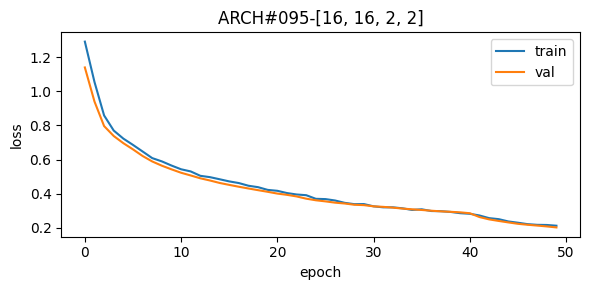


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.91      0.95     10808
     Class 1       0.80      0.96      0.87       914
     Class 2       0.91      0.86      0.89      2475
     Class 3       0.18      0.95      0.30       182

    accuracy                           0.91     14379
   macro avg       0.72      0.92      0.75     14379
weighted avg       0.95      0.91      0.92     14379



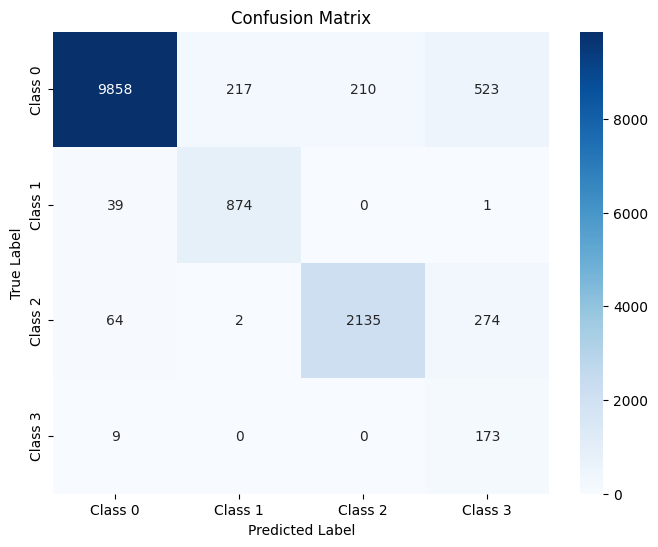

The function took 0.6370 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.91      0.95      2702
     Class 1       0.79      0.94      0.86       228
     Class 2       0.90      0.88      0.89       619
     Class 3       0.19      0.96      0.32        46

    accuracy                           0.91      3595
   macro avg       0.72      0.92      0.75      3595
weighted avg       0.95      0.91      0.92      3595



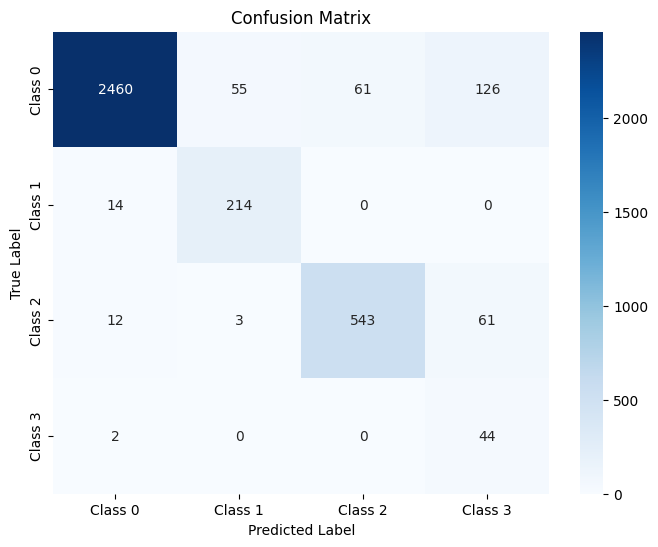

The function took 0.4805 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.91      0.95      3378
     Class 1       0.77      0.94      0.84       285
     Class 2       0.90      0.84      0.87       774
     Class 3       0.18      0.98      0.31        57

    accuracy                           0.90      4494
   macro avg       0.71      0.92      0.74      4494
weighted avg       0.95      0.90      0.92      4494



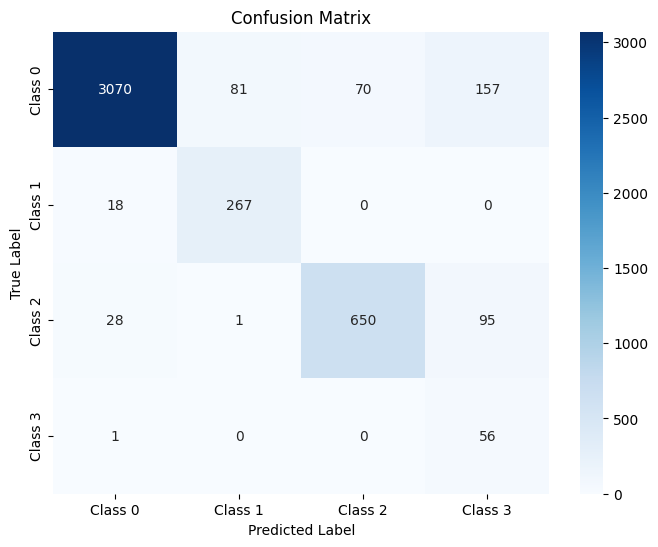

The function took 0.3616 seconds to execute.
[ARCH#096-[16, 8, 8, 8]] done in 32.2s  best-val=0.0944


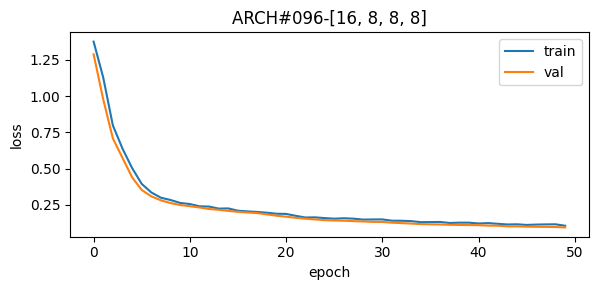


Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.95      0.97     10808
     Class 1       0.80      1.00      0.89       914
     Class 2       0.89      0.98      0.93      2475
     Class 3       0.72      0.95      0.82       182

    accuracy                           0.96     14379
   macro avg       0.85      0.97      0.90     14379
weighted avg       0.96      0.96      0.96     14379



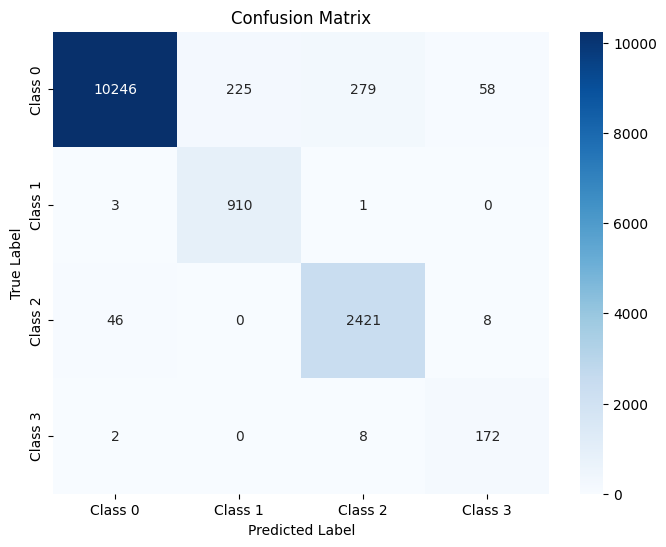

The function took 0.5533 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.95      0.97      2702
     Class 1       0.80      0.99      0.88       228
     Class 2       0.90      0.98      0.94       619
     Class 3       0.71      0.98      0.83        46

    accuracy                           0.96      3595
   macro avg       0.85      0.98      0.90      3595
weighted avg       0.96      0.96      0.96      3595



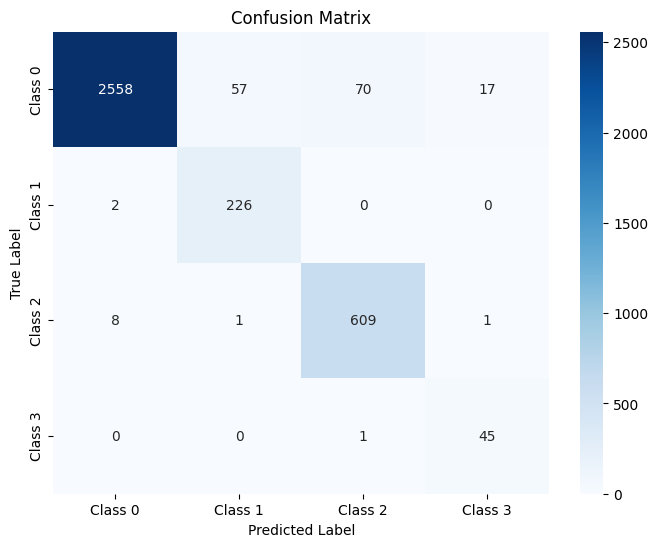

The function took 0.3552 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.95      0.97      3378
     Class 1       0.81      0.99      0.89       285
     Class 2       0.88      0.98      0.93       774
     Class 3       0.75      0.95      0.84        57

    accuracy                           0.96      4494
   macro avg       0.86      0.96      0.91      4494
weighted avg       0.96      0.96      0.96      4494



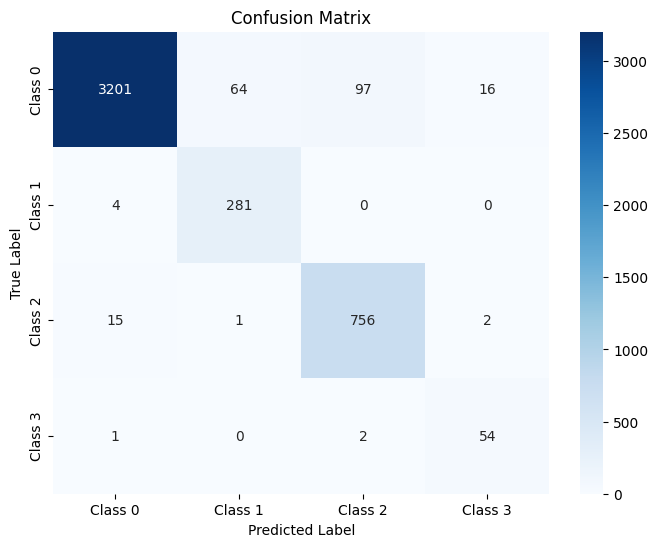

The function took 0.3746 seconds to execute.
[ARCH#097-[16, 8, 8, 4]] done in 32.7s  best-val=0.1164


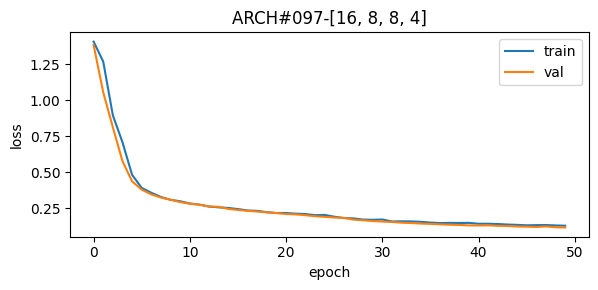


Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.93      0.96     10808
     Class 1       0.75      1.00      0.85       914
     Class 2       0.86      0.99      0.92      2475
     Class 3       0.68      0.93      0.79       182

    accuracy                           0.94     14379
   macro avg       0.82      0.96      0.88     14379
weighted avg       0.95      0.94      0.95     14379



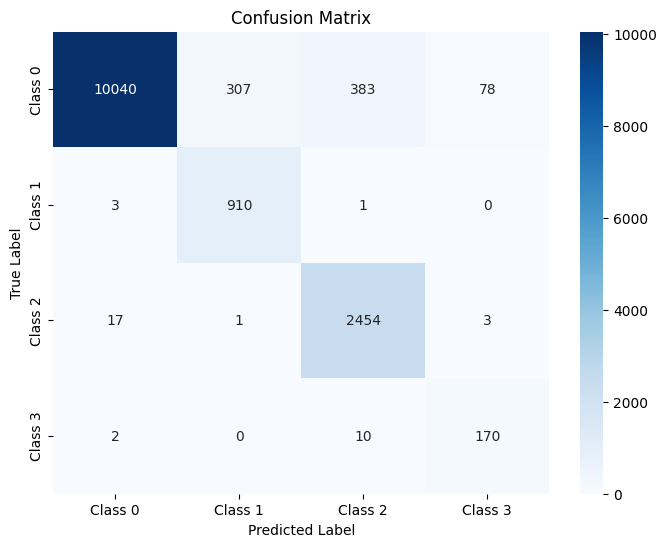

The function took 0.6426 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.92      0.96      2702
     Class 1       0.74      0.99      0.85       228
     Class 2       0.86      0.99      0.92       619
     Class 3       0.59      0.93      0.72        46

    accuracy                           0.94      3595
   macro avg       0.80      0.96      0.86      3595
weighted avg       0.95      0.94      0.94      3595



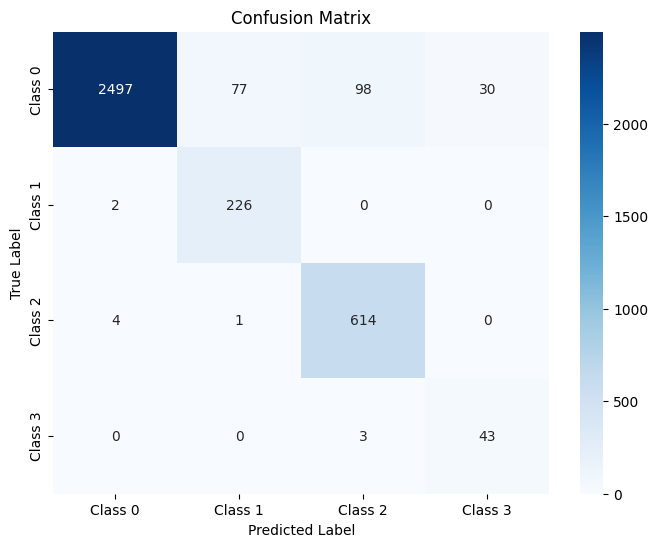

The function took 0.3226 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.93      0.96      3378
     Class 1       0.77      0.99      0.86       285
     Class 2       0.87      0.99      0.93       774
     Class 3       0.66      0.95      0.78        57

    accuracy                           0.95      4494
   macro avg       0.82      0.97      0.88      4494
weighted avg       0.96      0.95      0.95      4494



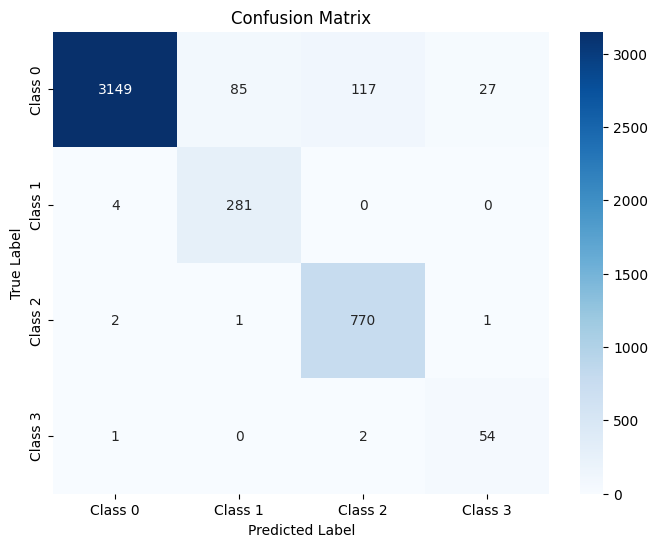

The function took 0.4969 seconds to execute.
[ARCH#098-[16, 8, 8, 2]] done in 32.6s  best-val=1.3794


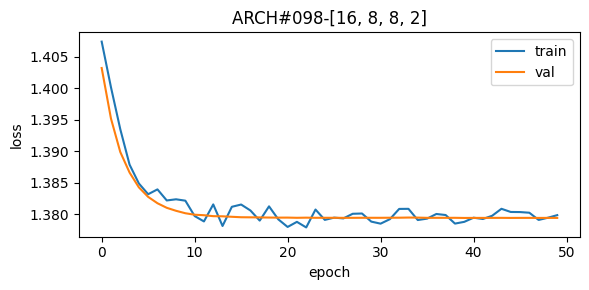


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86     10808
     Class 1       0.00      0.00      0.00       914
     Class 2       0.00      0.00      0.00      2475
     Class 3       0.00      0.00      0.00       182

    accuracy                           0.75     14379
   macro avg       0.19      0.25      0.21     14379
weighted avg       0.56      0.75      0.65     14379



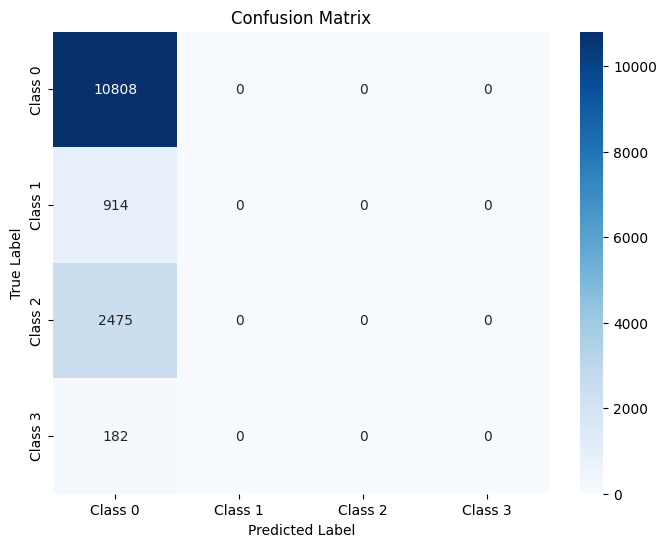

The function took 0.7114 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86      2702
     Class 1       0.00      0.00      0.00       228
     Class 2       0.00      0.00      0.00       619
     Class 3       0.00      0.00      0.00        46

    accuracy                           0.75      3595
   macro avg       0.19      0.25      0.21      3595
weighted avg       0.56      0.75      0.65      3595



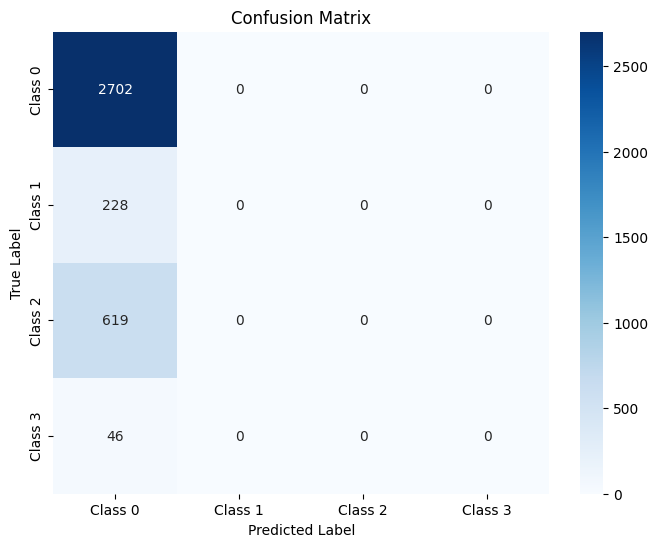

The function took 0.6325 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86      3378
     Class 1       0.00      0.00      0.00       285
     Class 2       0.00      0.00      0.00       774
     Class 3       0.00      0.00      0.00        57

    accuracy                           0.75      4494
   macro avg       0.19      0.25      0.21      4494
weighted avg       0.57      0.75      0.65      4494



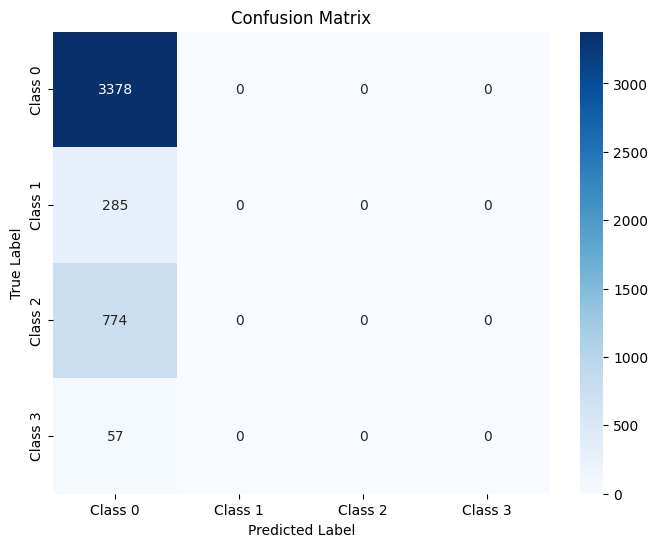

The function took 0.3918 seconds to execute.
[ARCH#099-[16, 8, 4, 4]] done in 33.2s  best-val=0.1851


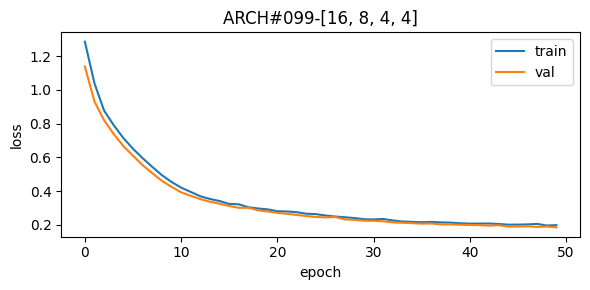


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.92      0.95     10808
     Class 1       0.73      1.00      0.84       914
     Class 2       0.92      0.94      0.93      2475
     Class 3       0.37      0.88      0.52       182

    accuracy                           0.93     14379
   macro avg       0.75      0.94      0.81     14379
weighted avg       0.95      0.93      0.94     14379



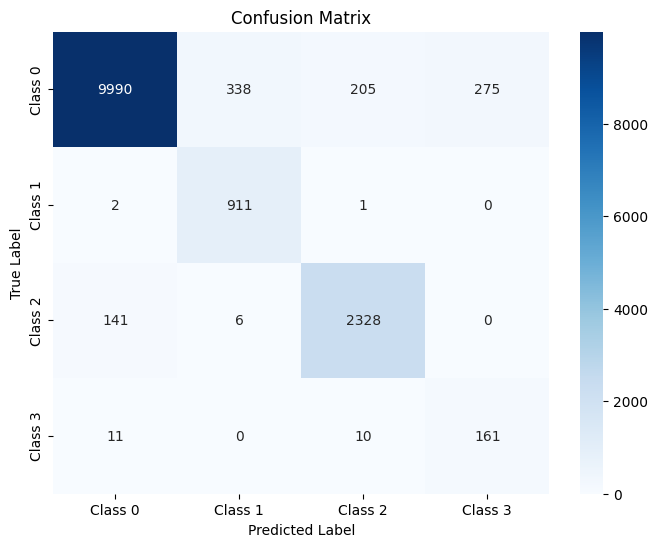

The function took 0.6374 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.92      0.95      2702
     Class 1       0.73      0.99      0.84       228
     Class 2       0.90      0.95      0.93       619
     Class 3       0.37      0.89      0.52        46

    accuracy                           0.93      3595
   macro avg       0.75      0.94      0.81      3595
weighted avg       0.95      0.93      0.94      3595



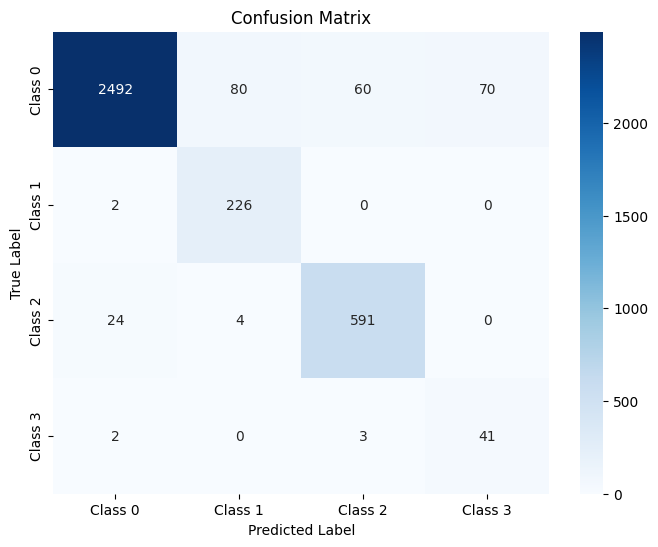

The function took 0.3452 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.93      0.95      3378
     Class 1       0.73      0.99      0.84       285
     Class 2       0.92      0.93      0.92       774
     Class 3       0.36      0.89      0.51        57

    accuracy                           0.93      4494
   macro avg       0.75      0.93      0.81      4494
weighted avg       0.95      0.93      0.93      4494



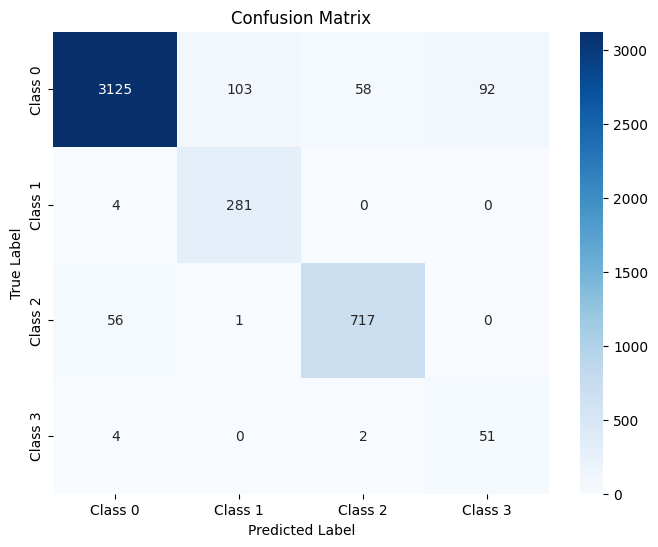

The function took 0.5142 seconds to execute.
[ARCH#100-[16, 8, 4, 2]] done in 33.0s  best-val=0.3322


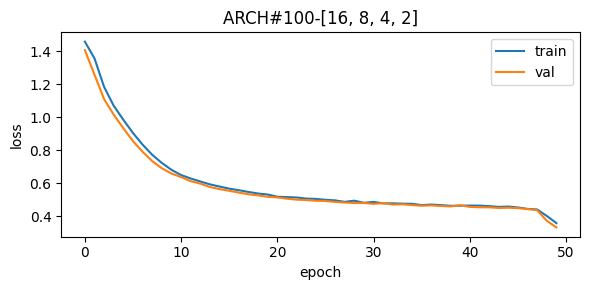


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.81      0.89     10808
     Class 1       0.35      0.99      0.52       914
     Class 2       0.90      0.93      0.92      2475
     Class 3       0.69      0.96      0.80       182

    accuracy                           0.85     14379
   macro avg       0.73      0.92      0.78     14379
weighted avg       0.92      0.85      0.87     14379



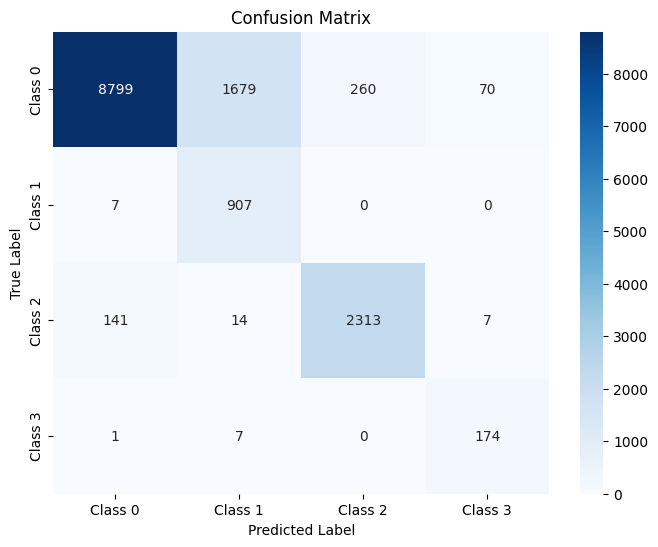

The function took 0.7154 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.82      0.90      2702
     Class 1       0.36      0.98      0.53       228
     Class 2       0.89      0.94      0.91       619
     Class 3       0.72      0.96      0.82        46

    accuracy                           0.85      3595
   macro avg       0.74      0.92      0.79      3595
weighted avg       0.92      0.85      0.87      3595



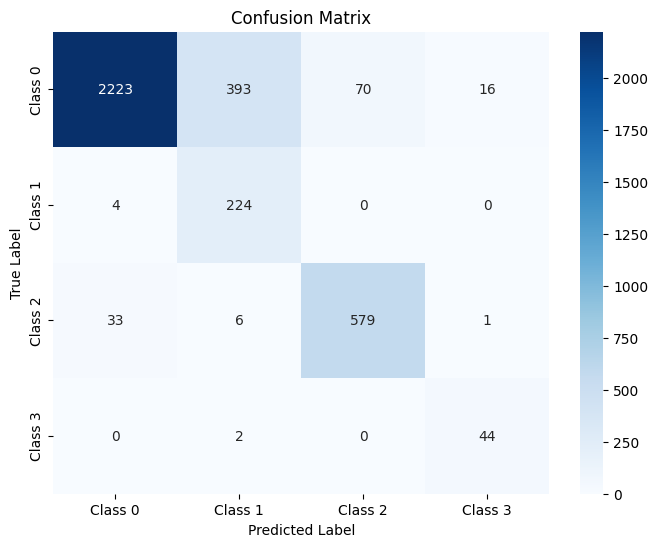

The function took 0.3543 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.81      0.89      3378
     Class 1       0.33      0.99      0.50       285
     Class 2       0.91      0.92      0.92       774
     Class 3       0.63      0.91      0.75        57

    accuracy                           0.84      4494
   macro avg       0.72      0.91      0.76      4494
weighted avg       0.92      0.84      0.87      4494



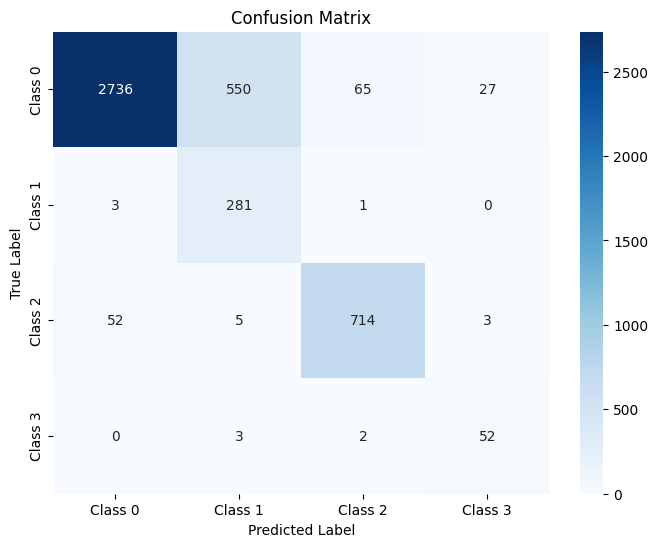

The function took 0.4698 seconds to execute.
[ARCH#101-[16, 8, 2, 2]] done in 32.0s  best-val=0.6087


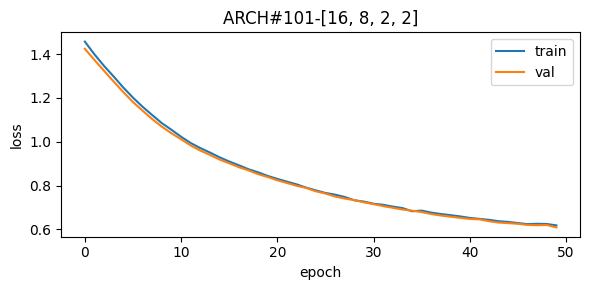


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.96      0.97      0.96     10808
     Class 1       0.90      0.95      0.93       914
     Class 2       0.88      0.89      0.89      2475
     Class 3       0.00      0.00      0.00       182

    accuracy                           0.94     14379
   macro avg       0.69      0.70      0.69     14379
weighted avg       0.93      0.94      0.94     14379



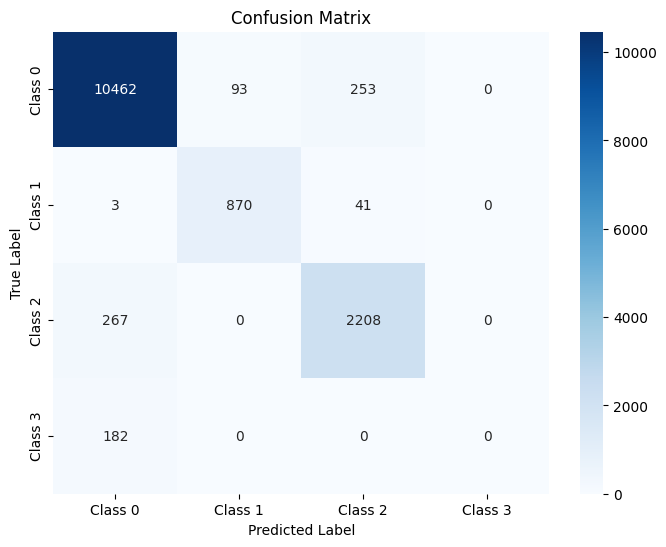

The function took 0.8593 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.96      0.97      0.97      2702
     Class 1       0.87      0.94      0.90       228
     Class 2       0.89      0.91      0.90       619
     Class 3       0.00      0.00      0.00        46

    accuracy                           0.94      3595
   macro avg       0.68      0.71      0.69      3595
weighted avg       0.93      0.94      0.94      3595



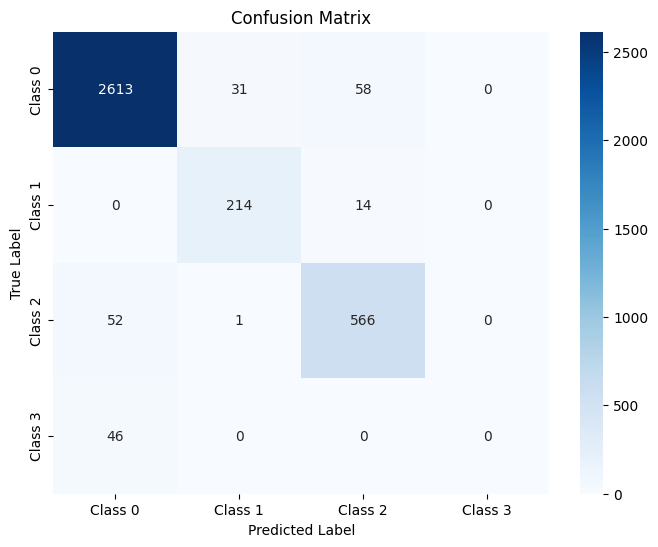

The function took 0.4589 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.96      0.97      0.96      3378
     Class 1       0.91      0.94      0.92       285
     Class 2       0.88      0.88      0.88       774
     Class 3       0.00      0.00      0.00        57

    accuracy                           0.94      4494
   macro avg       0.69      0.70      0.69      4494
weighted avg       0.93      0.94      0.93      4494



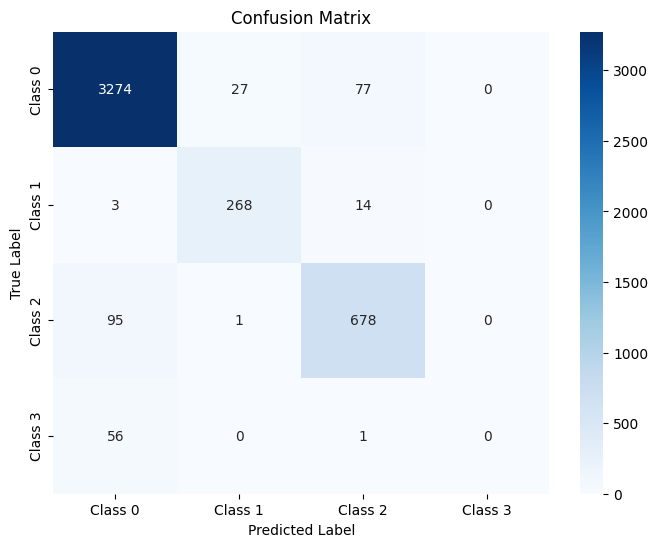

The function took 0.6801 seconds to execute.
[ARCH#102-[16, 4, 4, 4]] done in 32.4s  best-val=1.3794


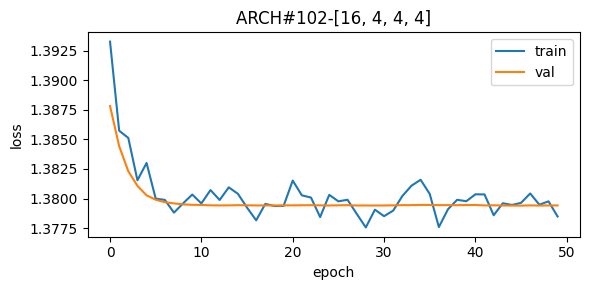


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86     10808
     Class 1       0.00      0.00      0.00       914
     Class 2       0.00      0.00      0.00      2475
     Class 3       0.00      0.00      0.00       182

    accuracy                           0.75     14379
   macro avg       0.19      0.25      0.21     14379
weighted avg       0.56      0.75      0.65     14379



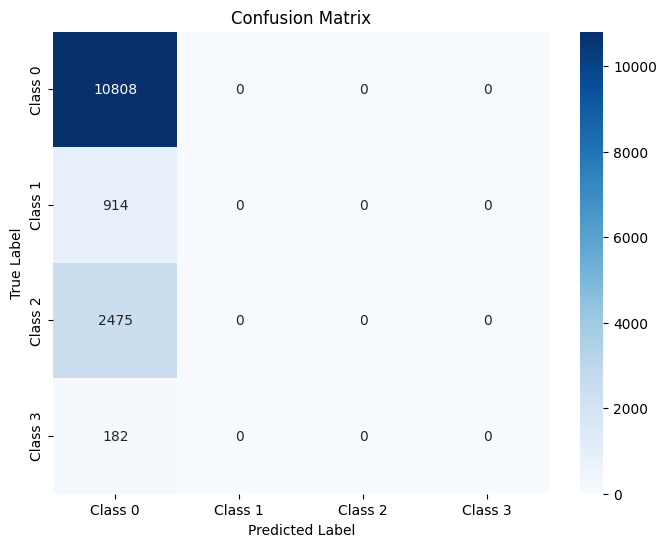

The function took 0.5631 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86      2702
     Class 1       0.00      0.00      0.00       228
     Class 2       0.00      0.00      0.00       619
     Class 3       0.00      0.00      0.00        46

    accuracy                           0.75      3595
   macro avg       0.19      0.25      0.21      3595
weighted avg       0.56      0.75      0.65      3595



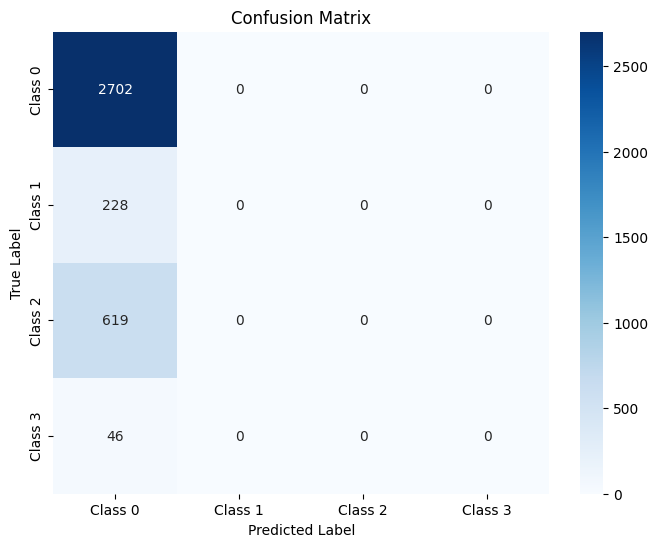

The function took 0.4713 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86      3378
     Class 1       0.00      0.00      0.00       285
     Class 2       0.00      0.00      0.00       774
     Class 3       0.00      0.00      0.00        57

    accuracy                           0.75      4494
   macro avg       0.19      0.25      0.21      4494
weighted avg       0.57      0.75      0.65      4494



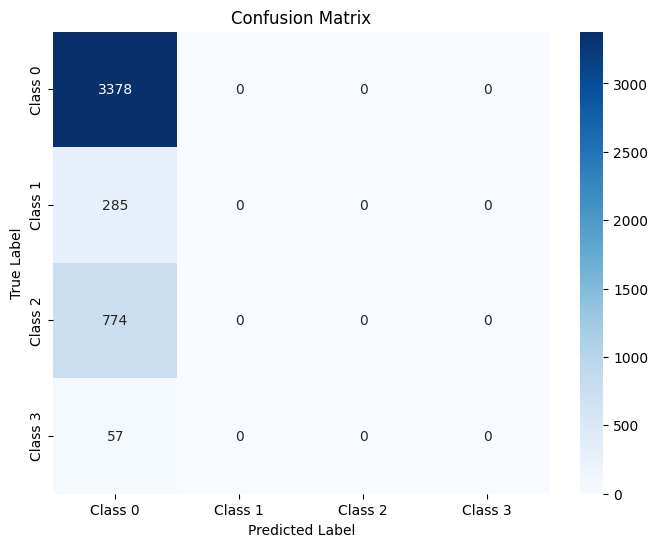

The function took 0.3742 seconds to execute.
[ARCH#103-[16, 4, 4, 2]] done in 32.6s  best-val=0.2122


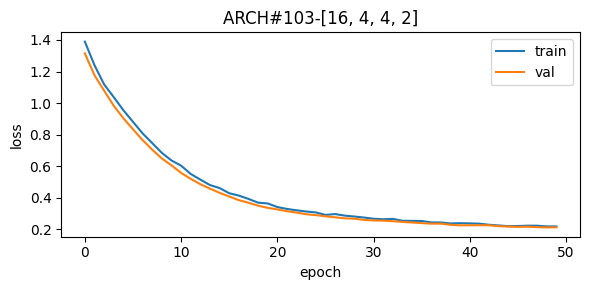


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.88      0.94     10808
     Class 1       0.83      0.96      0.89       914
     Class 2       0.80      0.97      0.88      2475
     Class 3       0.24      0.98      0.38       182

    accuracy                           0.90     14379
   macro avg       0.72      0.95      0.77     14379
weighted avg       0.94      0.90      0.92     14379



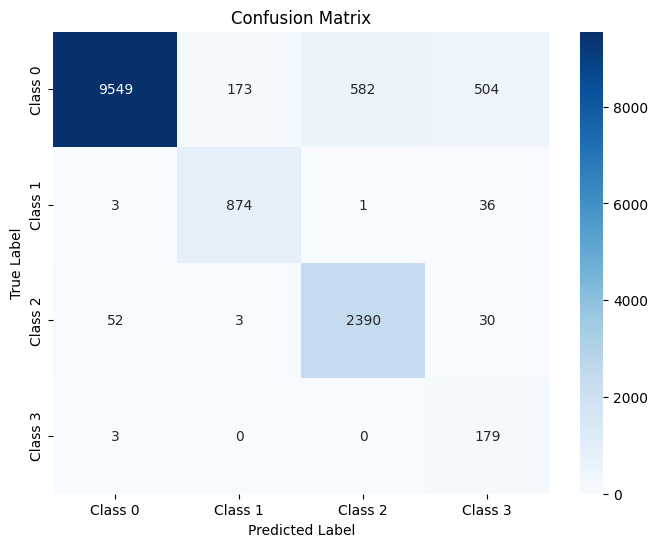

The function took 0.5630 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.88      0.94      2702
     Class 1       0.79      0.94      0.86       228
     Class 2       0.80      0.97      0.88       619
     Class 3       0.25      1.00      0.39        46

    accuracy                           0.90      3595
   macro avg       0.71      0.95      0.77      3595
weighted avg       0.94      0.90      0.91      3595



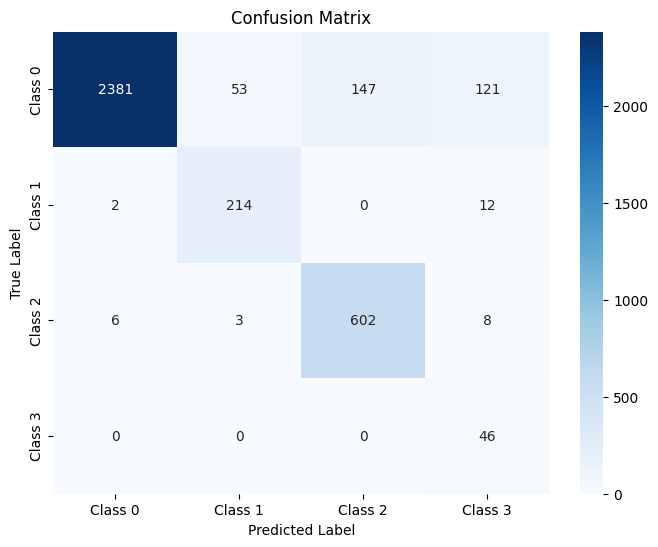

The function took 0.3527 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.89      0.94      3378
     Class 1       0.82      0.94      0.87       285
     Class 2       0.82      0.95      0.88       774
     Class 3       0.22      0.95      0.36        57

    accuracy                           0.90      4494
   macro avg       0.71      0.93      0.76      4494
weighted avg       0.94      0.90      0.91      4494



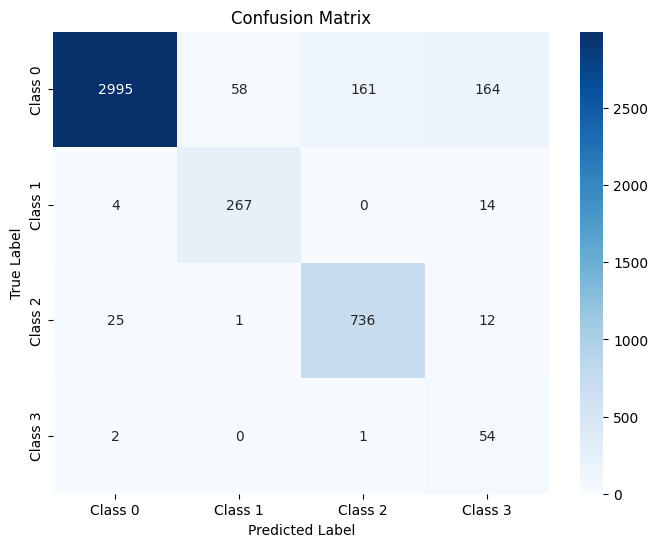

The function took 0.5106 seconds to execute.
[ARCH#104-[16, 4, 2, 2]] done in 32.6s  best-val=1.3794


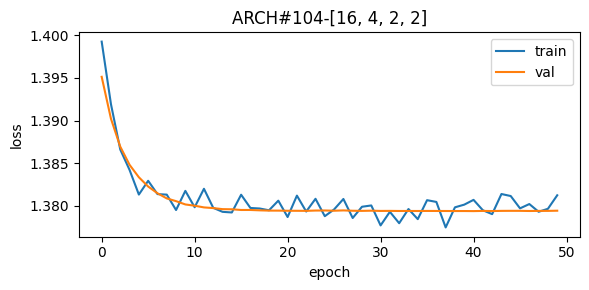


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86     10808
     Class 1       0.00      0.00      0.00       914
     Class 2       0.00      0.00      0.00      2475
     Class 3       0.00      0.00      0.00       182

    accuracy                           0.75     14379
   macro avg       0.19      0.25      0.21     14379
weighted avg       0.56      0.75      0.65     14379



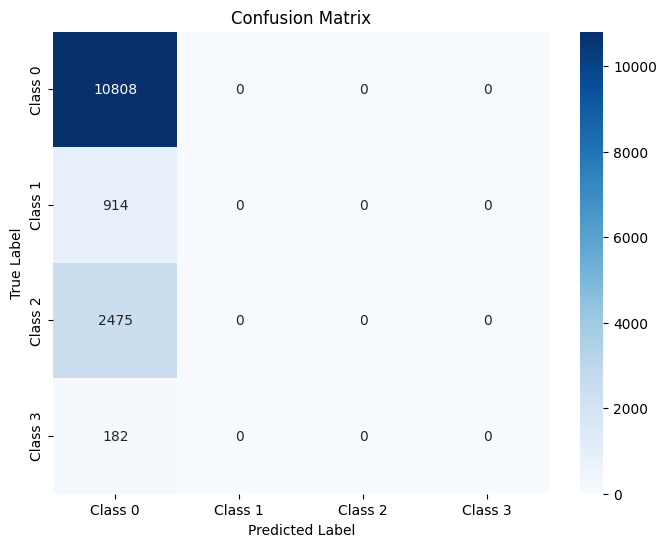

The function took 0.6210 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86      2702
     Class 1       0.00      0.00      0.00       228
     Class 2       0.00      0.00      0.00       619
     Class 3       0.00      0.00      0.00        46

    accuracy                           0.75      3595
   macro avg       0.19      0.25      0.21      3595
weighted avg       0.56      0.75      0.65      3595



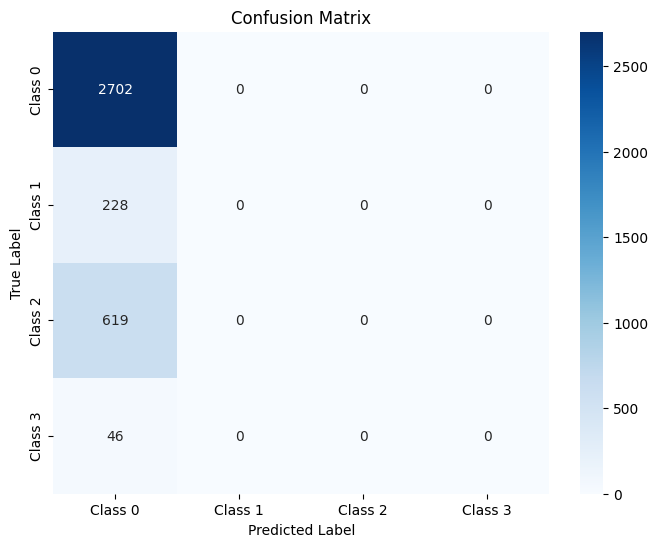

The function took 0.3520 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86      3378
     Class 1       0.00      0.00      0.00       285
     Class 2       0.00      0.00      0.00       774
     Class 3       0.00      0.00      0.00        57

    accuracy                           0.75      4494
   macro avg       0.19      0.25      0.21      4494
weighted avg       0.57      0.75      0.65      4494



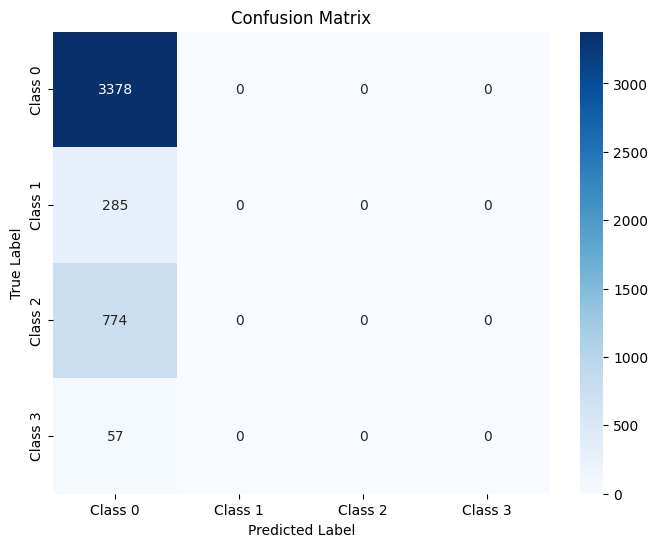

The function took 0.3674 seconds to execute.
[ARCH#105-[16, 2, 2, 2]] done in 32.9s  best-val=0.3308


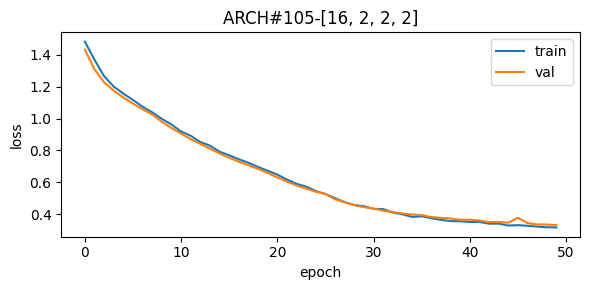


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.88      0.93     10808
     Class 1       0.77      1.00      0.87       914
     Class 2       0.73      0.97      0.84      2475
     Class 3       0.46      0.90      0.60       182

    accuracy                           0.90     14379
   macro avg       0.74      0.94      0.81     14379
weighted avg       0.93      0.90      0.91     14379



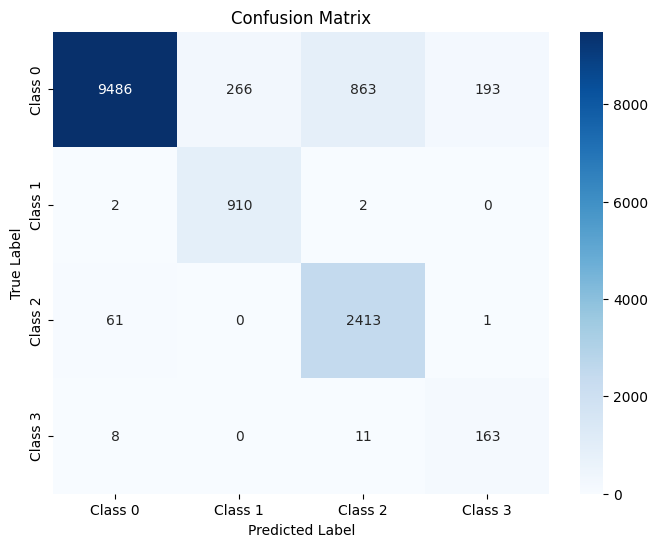

The function took 0.8984 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.88      0.93      2702
     Class 1       0.76      0.99      0.86       228
     Class 2       0.75      0.98      0.85       619
     Class 3       0.38      0.89      0.54        46

    accuracy                           0.90      3595
   macro avg       0.72      0.93      0.79      3595
weighted avg       0.93      0.90      0.91      3595



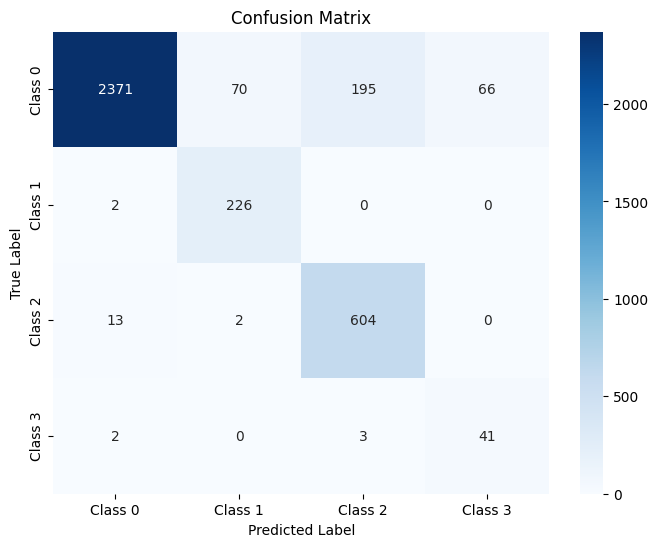

The function took 0.3355 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.88      0.93      3378
     Class 1       0.79      0.98      0.88       285
     Class 2       0.73      0.97      0.83       774
     Class 3       0.45      0.88      0.60        57

    accuracy                           0.90      4494
   macro avg       0.74      0.93      0.81      4494
weighted avg       0.93      0.90      0.91      4494



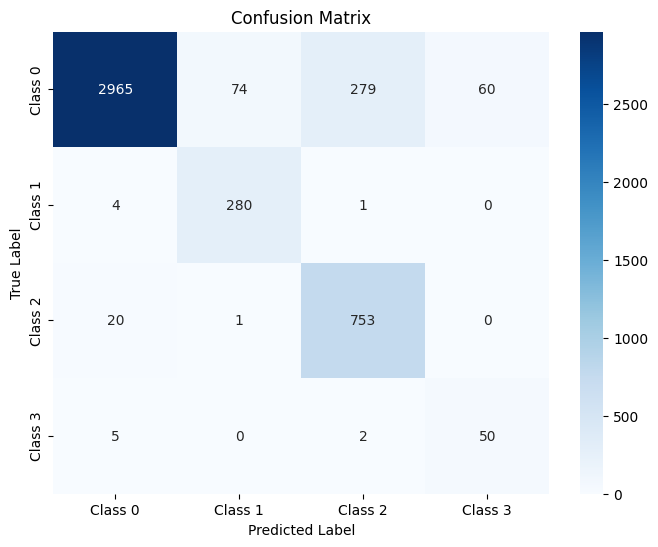

The function took 0.4540 seconds to execute.
[ARCH#106-[8, 8, 8, 8]] done in 33.3s  best-val=0.1553


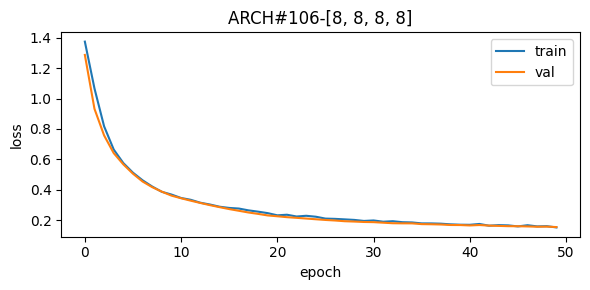


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.94      0.96     10808
     Class 1       0.82      0.96      0.88       914
     Class 2       0.89      0.95      0.92      2475
     Class 3       0.45      0.93      0.61       182

    accuracy                           0.94     14379
   macro avg       0.79      0.95      0.84     14379
weighted avg       0.95      0.94      0.95     14379



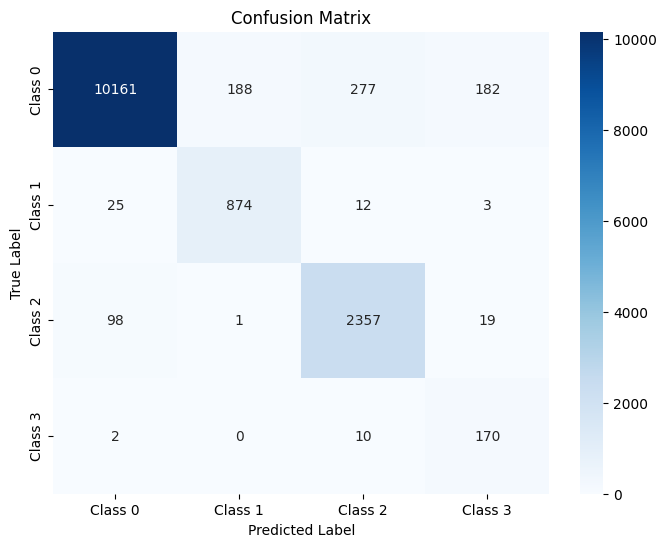

The function took 0.6598 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.94      0.96      2702
     Class 1       0.82      0.93      0.87       228
     Class 2       0.88      0.96      0.92       619
     Class 3       0.43      0.93      0.59        46

    accuracy                           0.94      3595
   macro avg       0.78      0.94      0.84      3595
weighted avg       0.95      0.94      0.94      3595



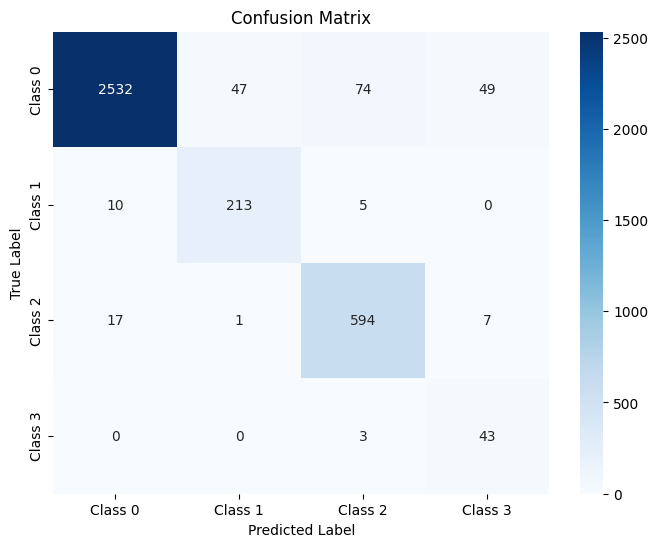

The function took 0.3685 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.95      0.97      3378
     Class 1       0.84      0.93      0.89       285
     Class 2       0.89      0.94      0.92       774
     Class 3       0.45      0.95      0.61        57

    accuracy                           0.94      4494
   macro avg       0.79      0.94      0.84      4494
weighted avg       0.95      0.94      0.95      4494



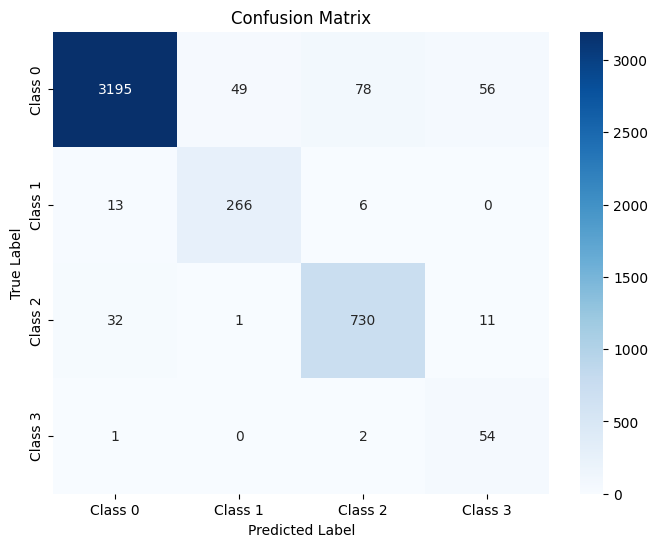

The function took 0.4567 seconds to execute.
[ARCH#107-[8, 8, 8, 4]] done in 32.6s  best-val=0.2177


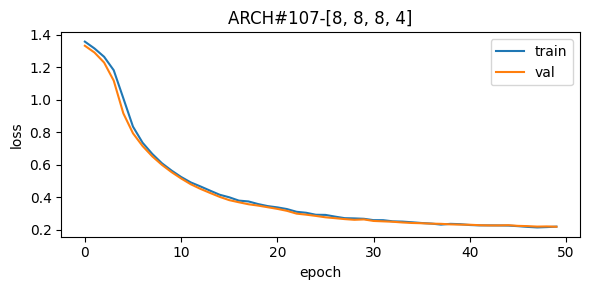


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.90      0.95     10808
     Class 1       0.77      0.96      0.85       914
     Class 2       0.85      0.98      0.91      2475
     Class 3       0.26      0.88      0.40       182

    accuracy                           0.92     14379
   macro avg       0.72      0.93      0.78     14379
weighted avg       0.95      0.92      0.93     14379



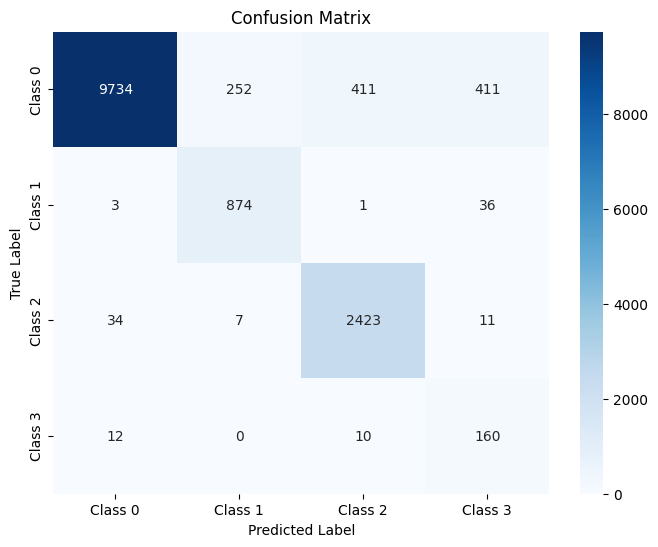

The function took 0.8432 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.90      0.95      2702
     Class 1       0.73      0.93      0.82       228
     Class 2       0.85      0.98      0.91       619
     Class 3       0.28      0.89      0.42        46

    accuracy                           0.92      3595
   macro avg       0.71      0.93      0.78      3595
weighted avg       0.94      0.92      0.92      3595



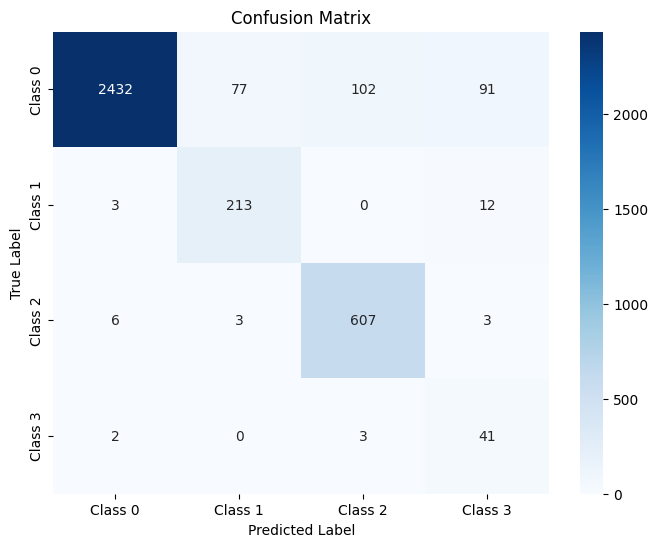

The function took 0.5375 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.90      0.95      3378
     Class 1       0.74      0.94      0.83       285
     Class 2       0.87      0.97      0.92       774
     Class 3       0.25      0.89      0.40        57

    accuracy                           0.92      4494
   macro avg       0.71      0.93      0.77      4494
weighted avg       0.95      0.92      0.93      4494



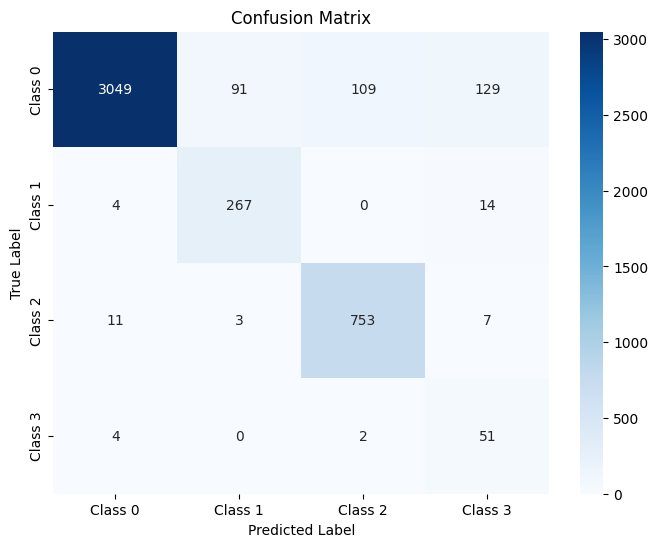

The function took 0.4421 seconds to execute.
[ARCH#108-[8, 8, 8, 2]] done in 32.8s  best-val=0.3287


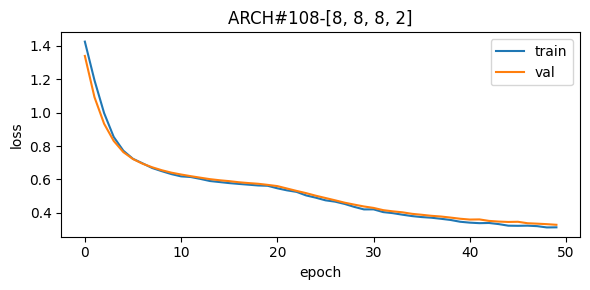


Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.87      0.93     10808
     Class 1       0.90      0.91      0.90       914
     Class 2       0.93      0.94      0.93      2475
     Class 3       0.12      0.98      0.22       182

    accuracy                           0.89     14379
   macro avg       0.74      0.93      0.75     14379
weighted avg       0.97      0.89      0.92     14379



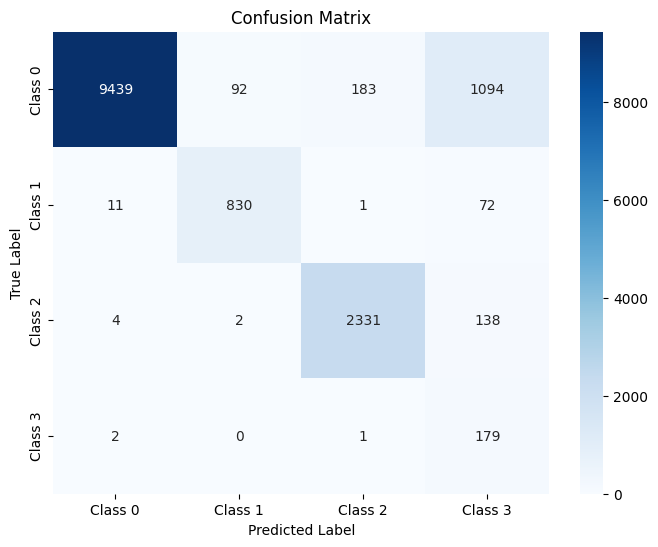

The function took 0.6325 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.89      0.94      2702
     Class 1       0.89      0.88      0.88       228
     Class 2       0.93      0.95      0.94       619
     Class 3       0.14      1.00      0.24        46

    accuracy                           0.90      3595
   macro avg       0.74      0.93      0.75      3595
weighted avg       0.97      0.90      0.93      3595



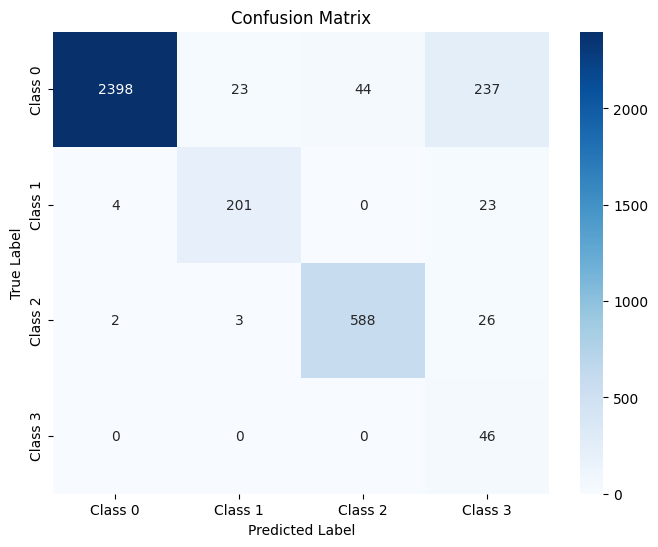

The function took 0.4213 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.88      0.93      3378
     Class 1       0.91      0.89      0.90       285
     Class 2       0.93      0.94      0.93       774
     Class 3       0.12      0.96      0.21        57

    accuracy                           0.89      4494
   macro avg       0.74      0.92      0.74      4494
weighted avg       0.97      0.89      0.92      4494



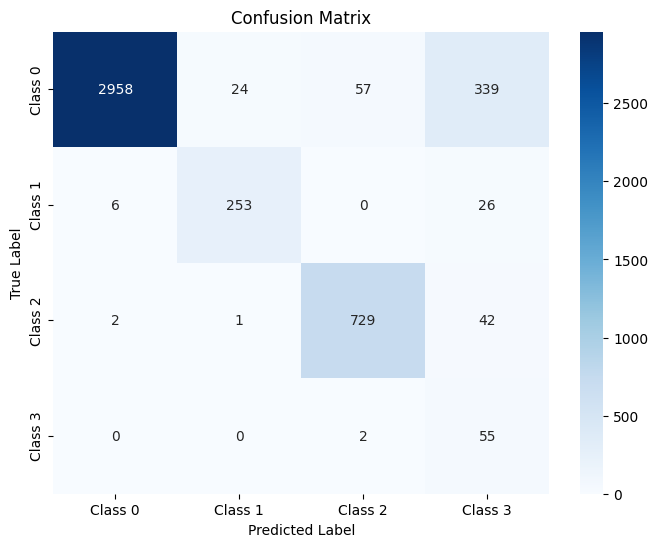

The function took 0.3708 seconds to execute.
[ARCH#109-[8, 8, 4, 4]] done in 33.1s  best-val=0.4974


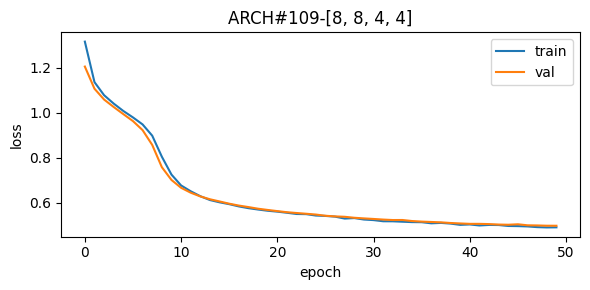


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.38      0.55     10808
     Class 1       0.81      0.96      0.88       914
     Class 2       0.98      0.86      0.92      2475
     Class 3       0.03      0.98      0.05       182

    accuracy                           0.51     14379
   macro avg       0.70      0.80      0.60     14379
weighted avg       0.96      0.51      0.63     14379



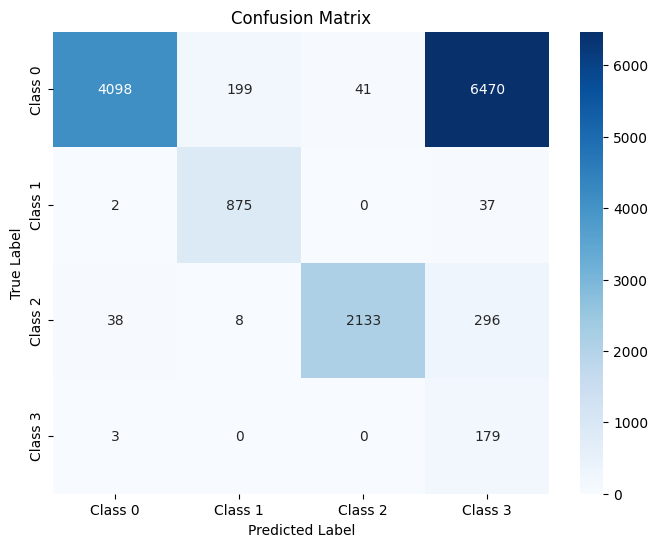

The function took 0.6685 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.38      0.55      2702
     Class 1       0.81      0.94      0.87       228
     Class 2       0.99      0.88      0.93       619
     Class 3       0.02      0.91      0.05        46

    accuracy                           0.51      3595
   macro avg       0.70      0.78      0.60      3595
weighted avg       0.96      0.51      0.63      3595



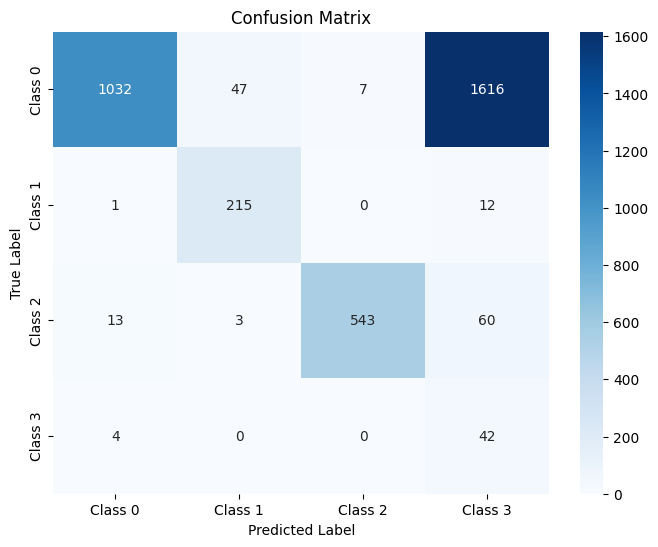

The function took 0.3787 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.38      0.55      3378
     Class 1       0.80      0.94      0.86       285
     Class 2       0.98      0.84      0.90       774
     Class 3       0.02      0.93      0.05        57

    accuracy                           0.50      4494
   macro avg       0.70      0.77      0.59      4494
weighted avg       0.96      0.50      0.63      4494



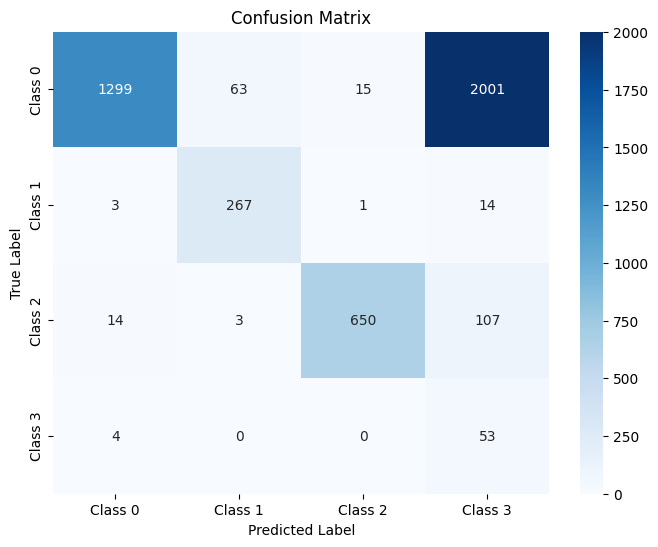

The function took 0.3983 seconds to execute.
[ARCH#110-[8, 8, 4, 2]] early-stop @ epoch 048
[ARCH#110-[8, 8, 4, 2]] done in 32.7s  best-val=1.3794


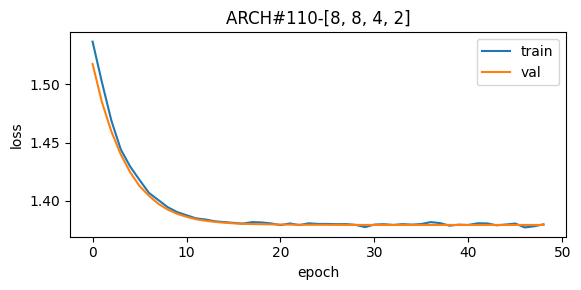


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86     10808
     Class 1       0.00      0.00      0.00       914
     Class 2       0.00      0.00      0.00      2475
     Class 3       0.00      0.00      0.00       182

    accuracy                           0.75     14379
   macro avg       0.19      0.25      0.21     14379
weighted avg       0.56      0.75      0.65     14379



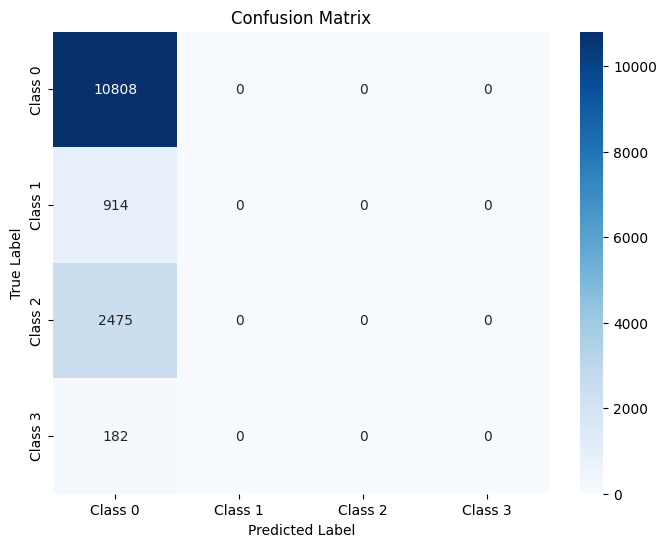

The function took 0.5870 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86      2702
     Class 1       0.00      0.00      0.00       228
     Class 2       0.00      0.00      0.00       619
     Class 3       0.00      0.00      0.00        46

    accuracy                           0.75      3595
   macro avg       0.19      0.25      0.21      3595
weighted avg       0.56      0.75      0.65      3595



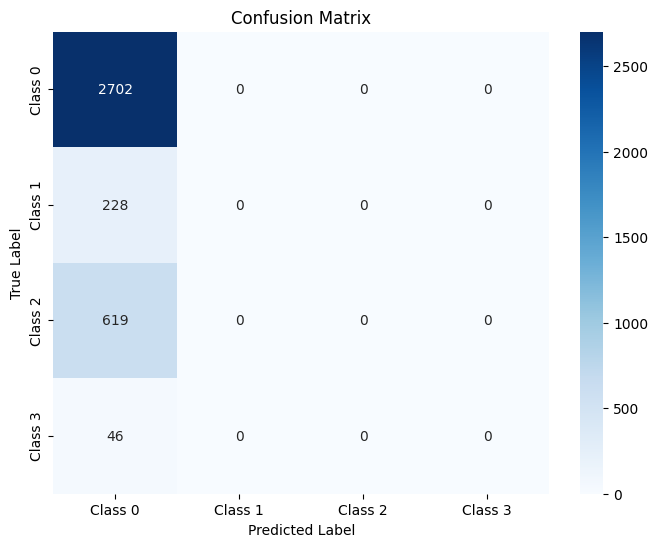

The function took 0.4797 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86      3378
     Class 1       0.00      0.00      0.00       285
     Class 2       0.00      0.00      0.00       774
     Class 3       0.00      0.00      0.00        57

    accuracy                           0.75      4494
   macro avg       0.19      0.25      0.21      4494
weighted avg       0.57      0.75      0.65      4494



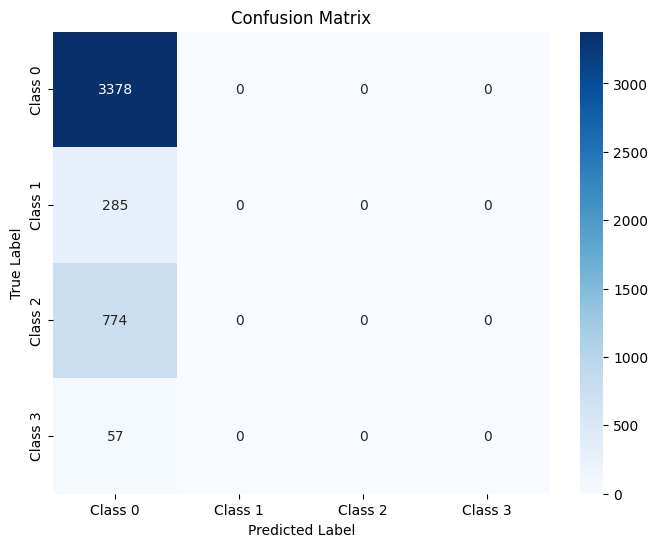

The function took 0.3961 seconds to execute.
[ARCH#111-[8, 8, 2, 2]] done in 33.0s  best-val=0.7316


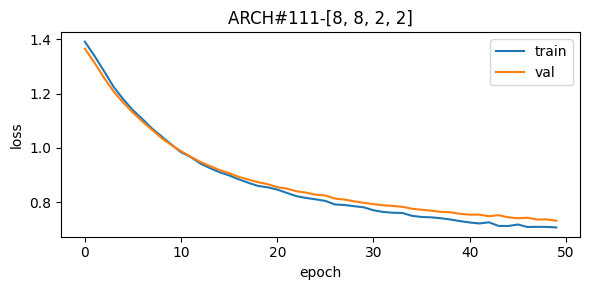


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.90      0.02      0.03     10808
     Class 1       0.90      0.91      0.90       914
     Class 2       0.19      0.99      0.32      2475
     Class 3       0.38      0.94      0.54       182

    accuracy                           0.25     14379
   macro avg       0.59      0.71      0.45     14379
weighted avg       0.77      0.25      0.14     14379



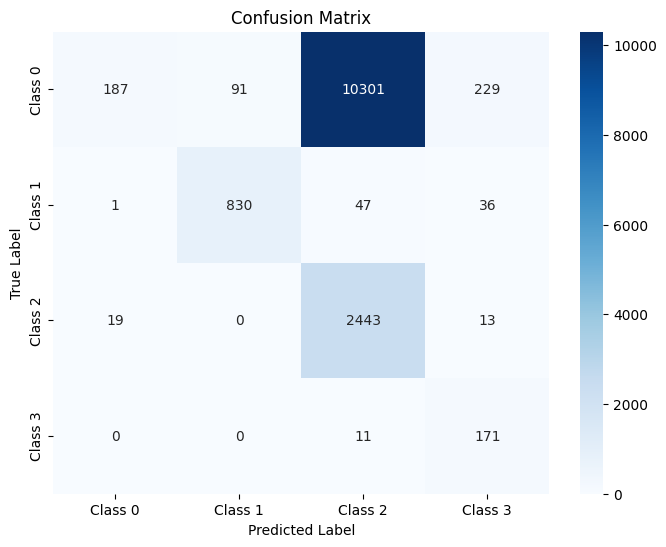

The function took 0.5657 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.89      0.01      0.03      2702
     Class 1       0.87      0.88      0.87       228
     Class 2       0.19      0.99      0.32       619
     Class 3       0.40      0.96      0.57        46

    accuracy                           0.25      3595
   macro avg       0.59      0.71      0.45      3595
weighted avg       0.76      0.25      0.14      3595



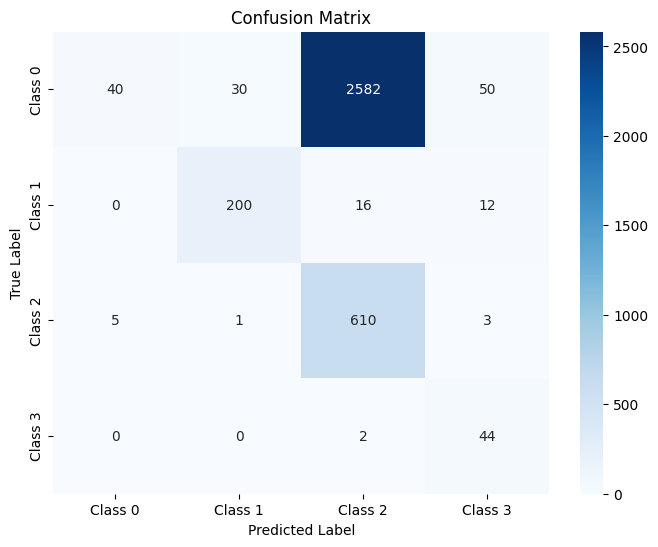

The function took 0.4965 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.90      0.02      0.03      3378
     Class 1       0.90      0.89      0.90       285
     Class 2       0.19      0.99      0.32       774
     Class 3       0.40      0.88      0.55        57

    accuracy                           0.25      4494
   macro avg       0.60      0.69      0.45      4494
weighted avg       0.77      0.25      0.14      4494



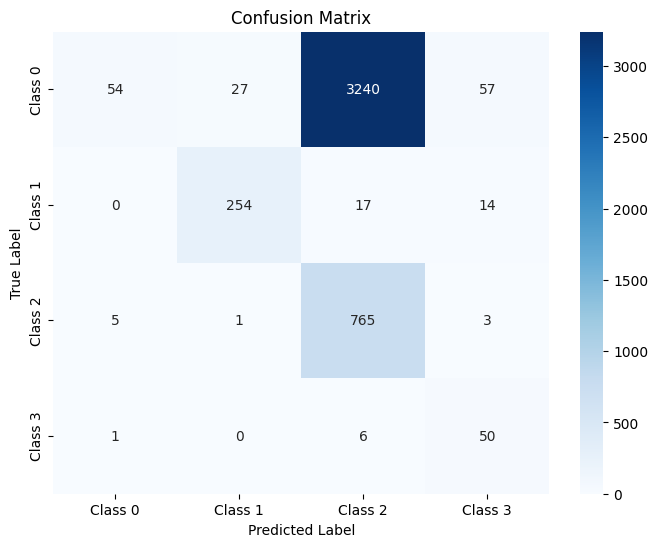

The function took 0.3772 seconds to execute.
[ARCH#112-[8, 4, 4, 4]] early-stop @ epoch 041
[ARCH#112-[8, 4, 4, 4]] done in 27.2s  best-val=1.3794


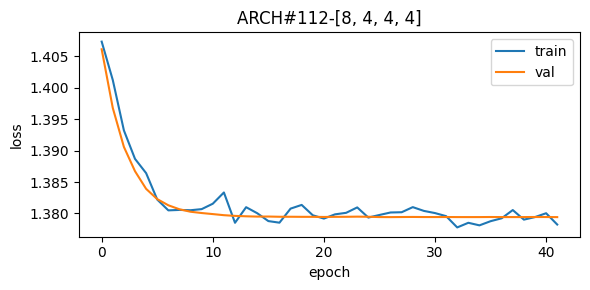


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86     10808
     Class 1       0.00      0.00      0.00       914
     Class 2       0.00      0.00      0.00      2475
     Class 3       0.00      0.00      0.00       182

    accuracy                           0.75     14379
   macro avg       0.19      0.25      0.21     14379
weighted avg       0.56      0.75      0.65     14379



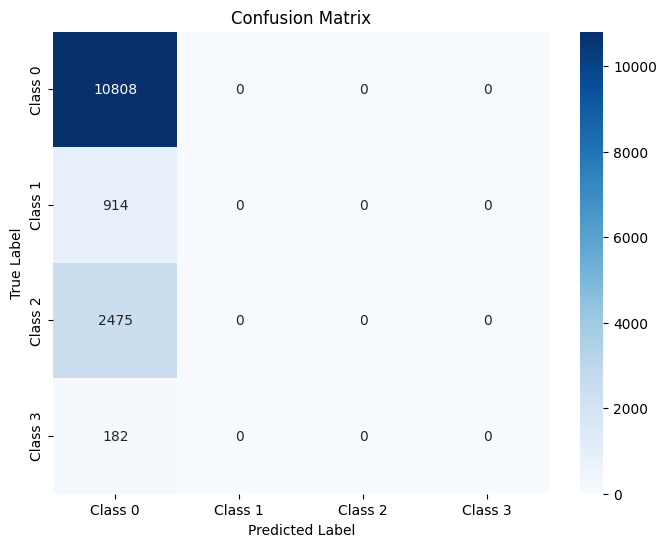

The function took 0.6970 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86      2702
     Class 1       0.00      0.00      0.00       228
     Class 2       0.00      0.00      0.00       619
     Class 3       0.00      0.00      0.00        46

    accuracy                           0.75      3595
   macro avg       0.19      0.25      0.21      3595
weighted avg       0.56      0.75      0.65      3595



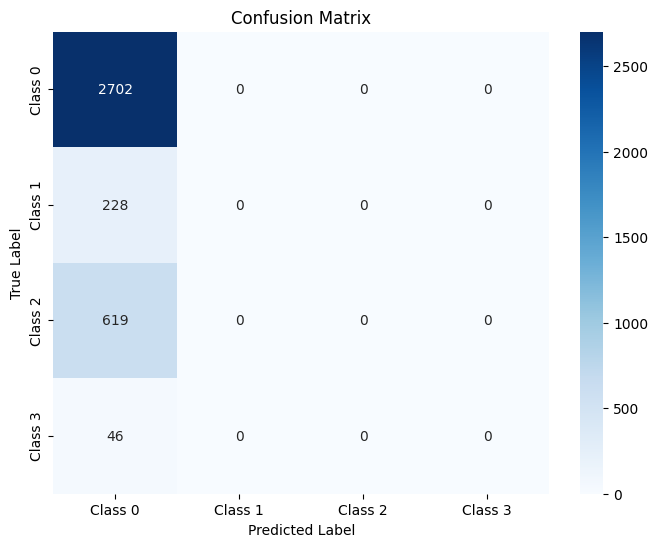

The function took 0.6805 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86      3378
     Class 1       0.00      0.00      0.00       285
     Class 2       0.00      0.00      0.00       774
     Class 3       0.00      0.00      0.00        57

    accuracy                           0.75      4494
   macro avg       0.19      0.25      0.21      4494
weighted avg       0.57      0.75      0.65      4494



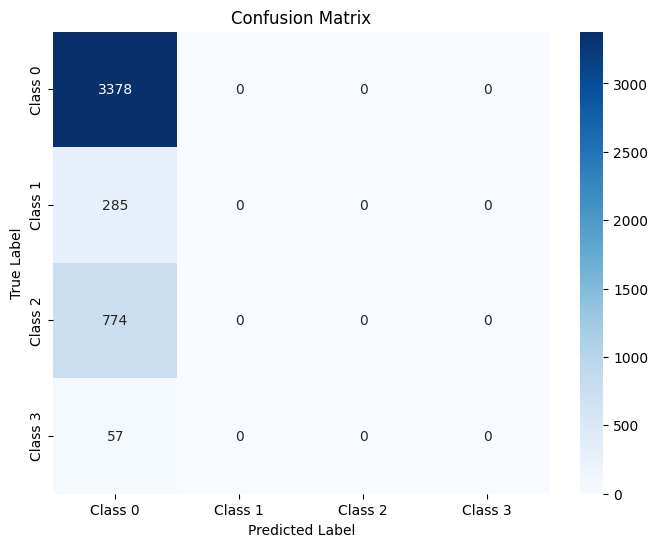

The function took 0.3686 seconds to execute.
[ARCH#113-[8, 4, 4, 2]] done in 33.5s  best-val=0.4541


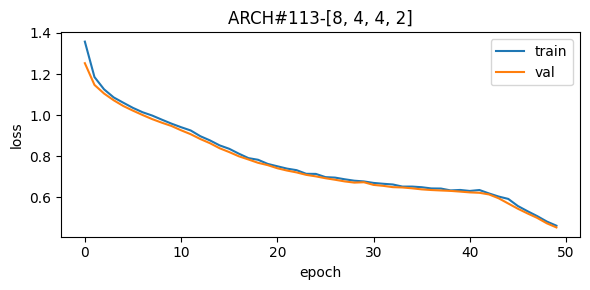


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.91      0.94     10808
     Class 1       0.63      0.97      0.77       914
     Class 2       0.82      0.89      0.86      2475
     Class 3       0.42      0.90      0.57       182

    accuracy                           0.91     14379
   macro avg       0.72      0.92      0.79     14379
weighted avg       0.93      0.91      0.91     14379



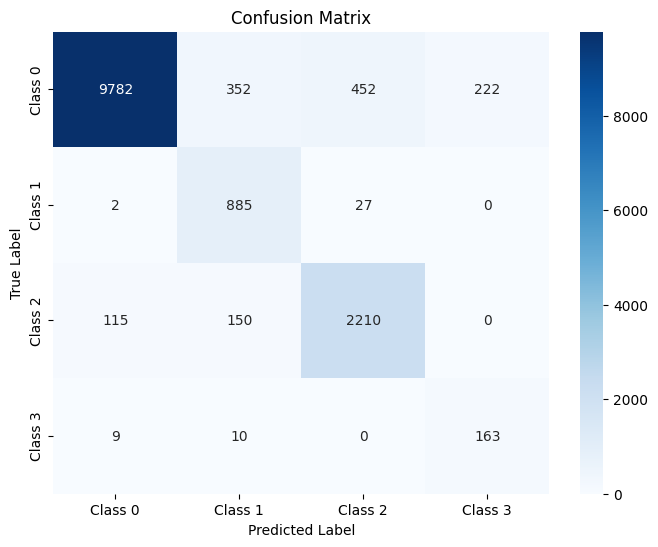

The function took 0.5862 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.91      0.95      2702
     Class 1       0.62      0.95      0.75       228
     Class 2       0.83      0.90      0.86       619
     Class 3       0.43      0.89      0.58        46

    accuracy                           0.91      3595
   macro avg       0.72      0.91      0.78      3595
weighted avg       0.93      0.91      0.91      3595



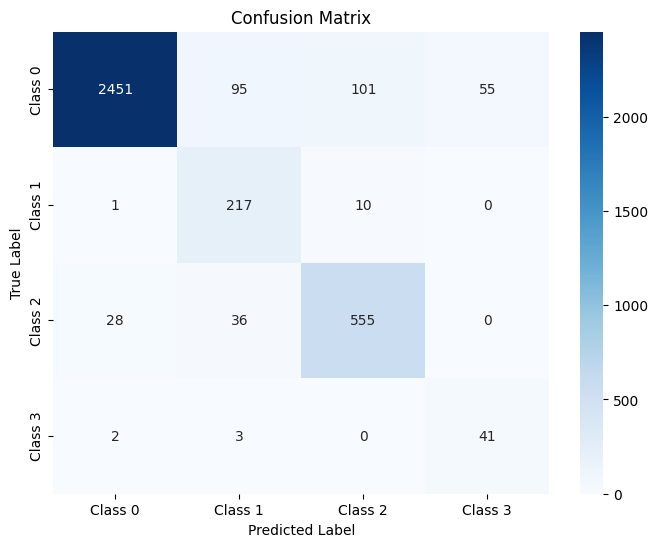

The function took 0.4786 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.91      0.95      3378
     Class 1       0.64      0.95      0.77       285
     Class 2       0.83      0.88      0.86       774
     Class 3       0.40      0.88      0.55        57

    accuracy                           0.91      4494
   macro avg       0.72      0.91      0.78      4494
weighted avg       0.93      0.91      0.91      4494



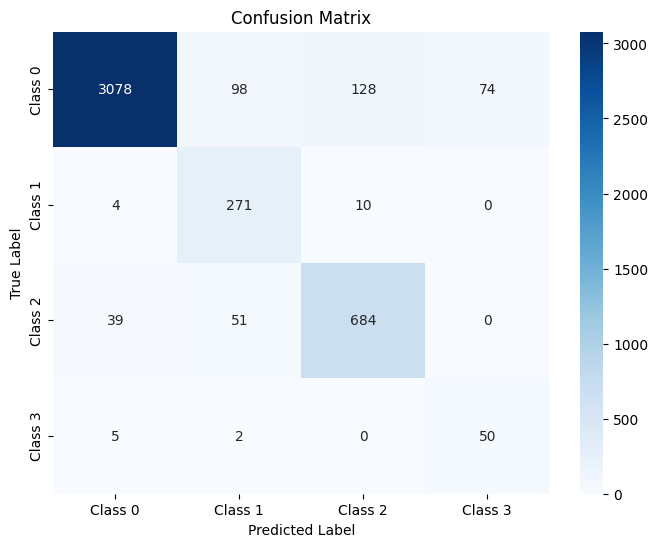

The function took 0.3699 seconds to execute.
[ARCH#114-[8, 4, 2, 2]] done in 32.9s  best-val=0.8059


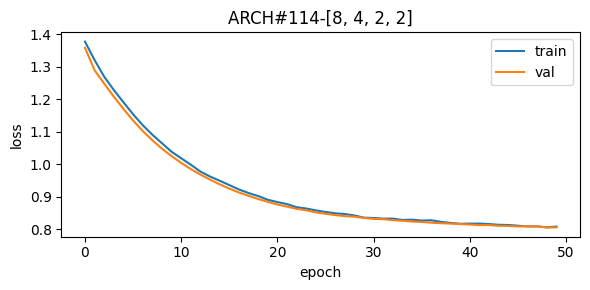


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.95      0.96     10808
     Class 1       0.00      0.00      0.00       914
     Class 2       0.62      0.99      0.76      2475
     Class 3       0.00      0.00      0.00       182

    accuracy                           0.88     14379
   macro avg       0.40      0.48      0.43     14379
weighted avg       0.84      0.88      0.85     14379



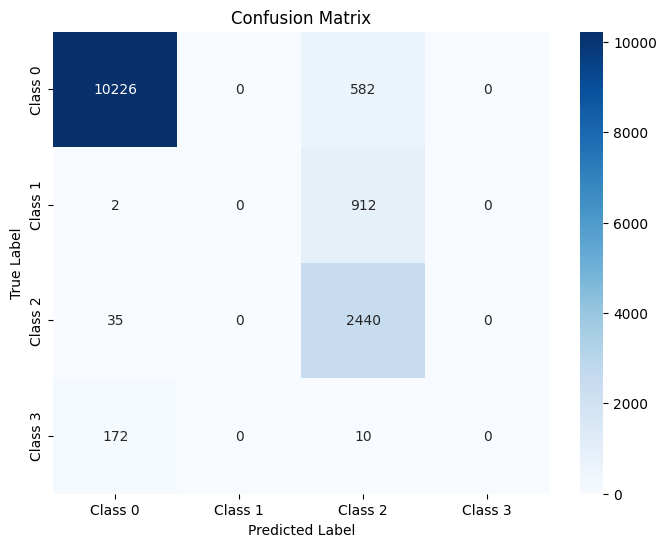

The function took 0.6694 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.95      0.96      2702
     Class 1       0.00      0.00      0.00       228
     Class 2       0.62      0.99      0.76       619
     Class 3       0.00      0.00      0.00        46

    accuracy                           0.88      3595
   macro avg       0.40      0.48      0.43      3595
weighted avg       0.84      0.88      0.85      3595



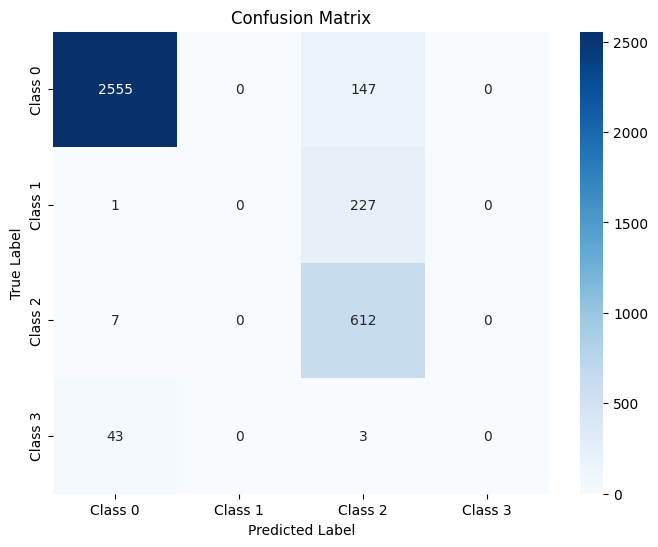

The function took 0.3534 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.95      0.96      3378
     Class 1       0.00      0.00      0.00       285
     Class 2       0.63      0.98      0.77       774
     Class 3       0.00      0.00      0.00        57

    accuracy                           0.88      4494
   macro avg       0.40      0.48      0.43      4494
weighted avg       0.84      0.88      0.86      4494



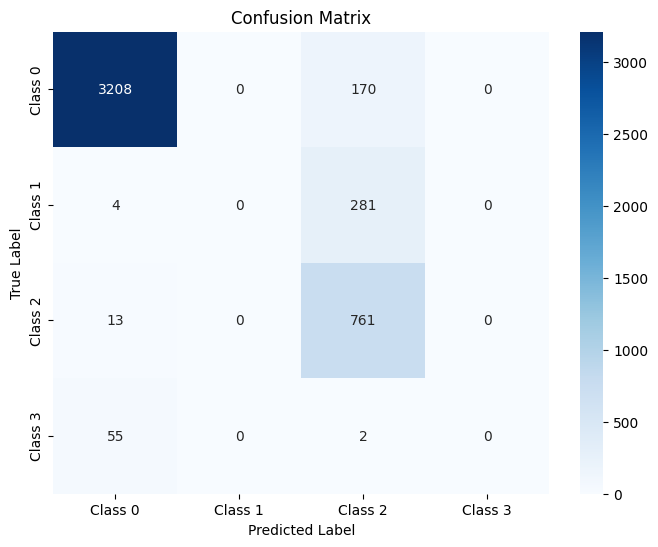

The function took 0.5224 seconds to execute.
[ARCH#115-[8, 2, 2, 2]] early-stop @ epoch 049
[ARCH#115-[8, 2, 2, 2]] done in 32.9s  best-val=1.3794


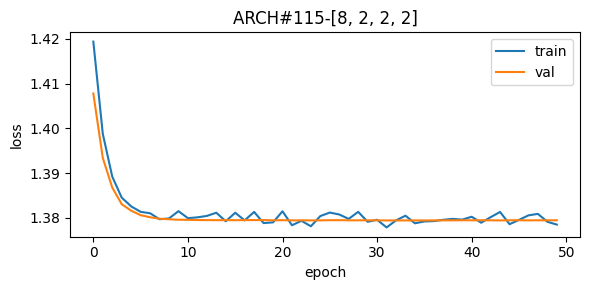


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86     10808
     Class 1       0.00      0.00      0.00       914
     Class 2       0.00      0.00      0.00      2475
     Class 3       0.00      0.00      0.00       182

    accuracy                           0.75     14379
   macro avg       0.19      0.25      0.21     14379
weighted avg       0.56      0.75      0.65     14379



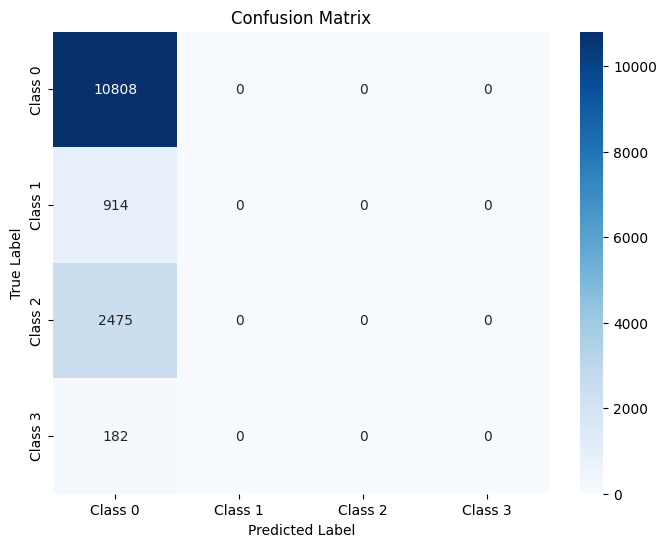

The function took 0.6476 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86      2702
     Class 1       0.00      0.00      0.00       228
     Class 2       0.00      0.00      0.00       619
     Class 3       0.00      0.00      0.00        46

    accuracy                           0.75      3595
   macro avg       0.19      0.25      0.21      3595
weighted avg       0.56      0.75      0.65      3595



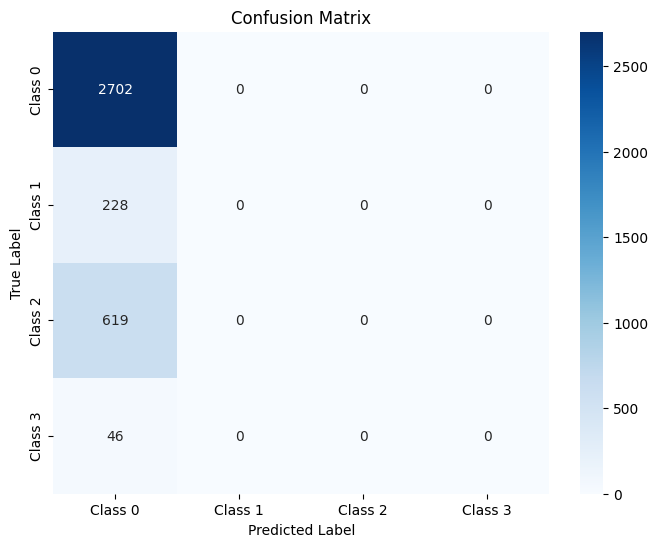

The function took 0.3829 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86      3378
     Class 1       0.00      0.00      0.00       285
     Class 2       0.00      0.00      0.00       774
     Class 3       0.00      0.00      0.00        57

    accuracy                           0.75      4494
   macro avg       0.19      0.25      0.21      4494
weighted avg       0.57      0.75      0.65      4494



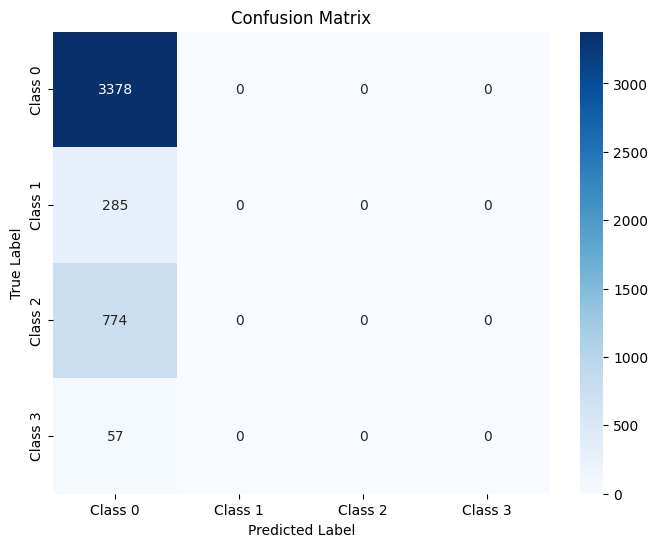

The function took 0.3647 seconds to execute.
[ARCH#116-[4, 4, 4, 4]] done in 32.9s  best-val=0.3334


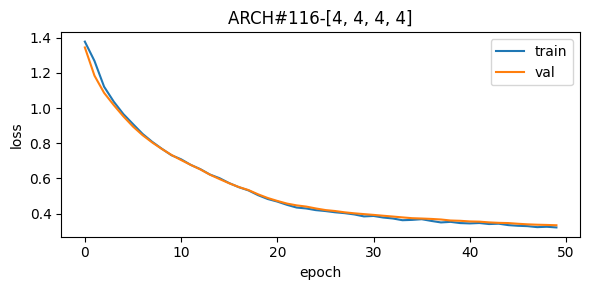


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.88      0.92     10808
     Class 1       0.50      0.86      0.63       914
     Class 2       0.82      0.90      0.86      2475
     Class 3       0.41      0.90      0.56       182

    accuracy                           0.88     14379
   macro avg       0.68      0.88      0.74     14379
weighted avg       0.91      0.88      0.89     14379



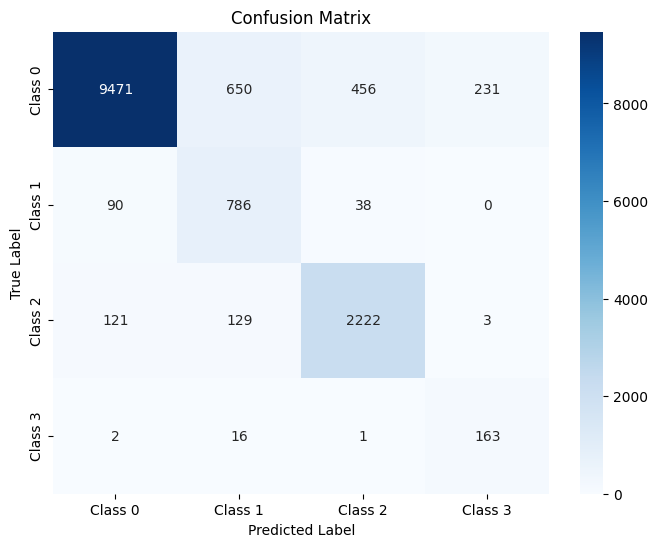

The function took 0.5904 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.87      0.92      2702
     Class 1       0.49      0.82      0.61       228
     Class 2       0.80      0.90      0.85       619
     Class 3       0.41      0.89      0.57        46

    accuracy                           0.88      3595
   macro avg       0.67      0.87      0.74      3595
weighted avg       0.91      0.88      0.89      3595



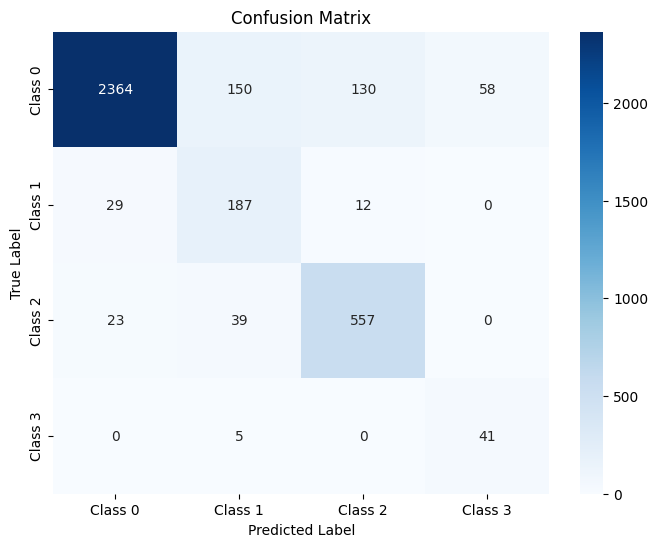

The function took 0.3328 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.97      0.88      0.92      3378
     Class 1       0.48      0.84      0.61       285
     Class 2       0.82      0.87      0.84       774
     Class 3       0.38      0.88      0.53        57

    accuracy                           0.87      4494
   macro avg       0.66      0.87      0.73      4494
weighted avg       0.91      0.87      0.88      4494



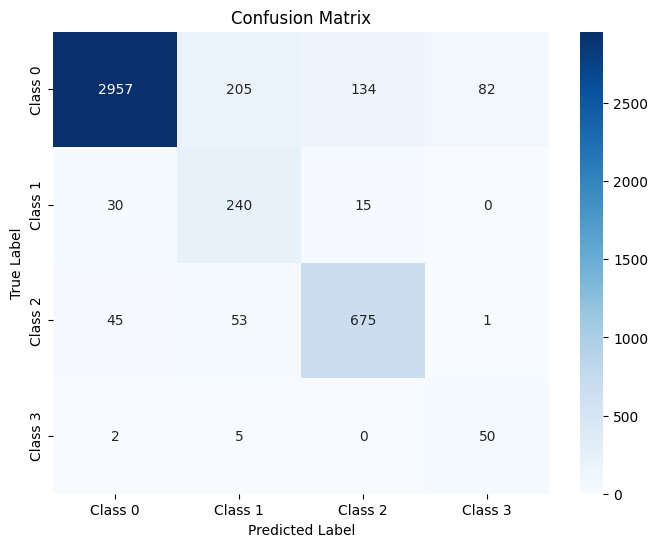

The function took 0.5052 seconds to execute.
[ARCH#117-[4, 4, 4, 2]] done in 32.6s  best-val=0.8435


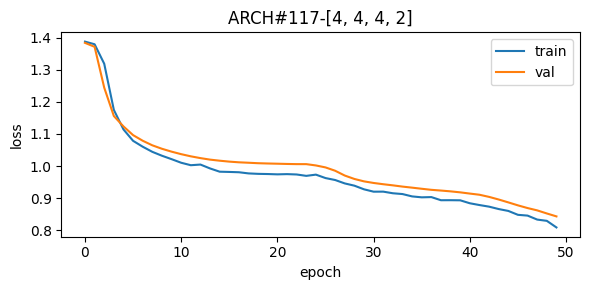


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.97      0.56      0.71     10808
     Class 1       0.82      0.91      0.86       914
     Class 2       0.33      0.94      0.48      2475
     Class 3       0.00      0.00      0.00       182

    accuracy                           0.64     14379
   macro avg       0.53      0.60      0.51     14379
weighted avg       0.84      0.64      0.67     14379



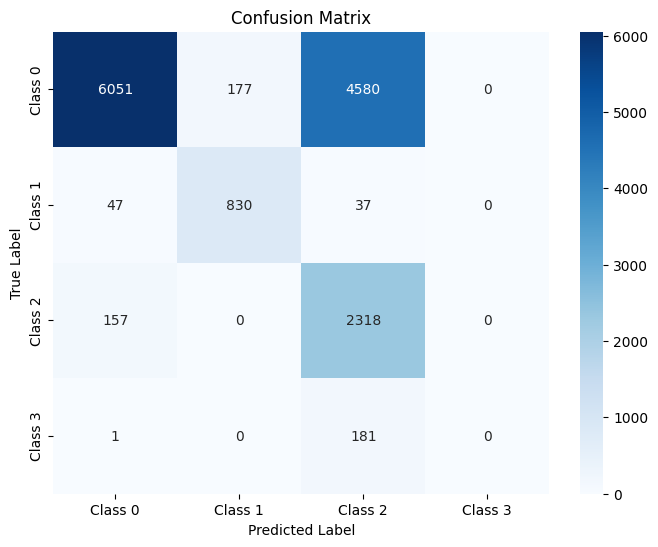

The function took 0.5661 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.97      0.55      0.70      2702
     Class 1       0.81      0.89      0.85       228
     Class 2       0.32      0.94      0.48       619
     Class 3       0.00      0.00      0.00        46

    accuracy                           0.63      3595
   macro avg       0.52      0.59      0.51      3595
weighted avg       0.83      0.63      0.66      3595



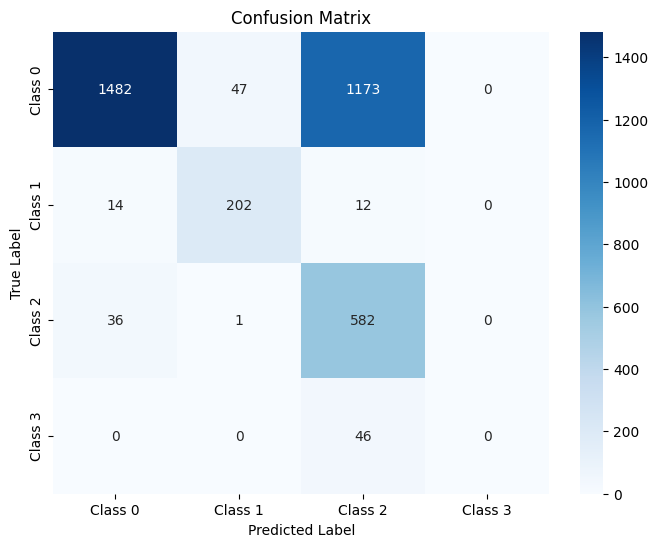

The function took 0.4837 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.96      0.56      0.71      3378
     Class 1       0.80      0.89      0.84       285
     Class 2       0.33      0.93      0.48       774
     Class 3       0.00      0.00      0.00        57

    accuracy                           0.64      4494
   macro avg       0.52      0.60      0.51      4494
weighted avg       0.83      0.64      0.67      4494



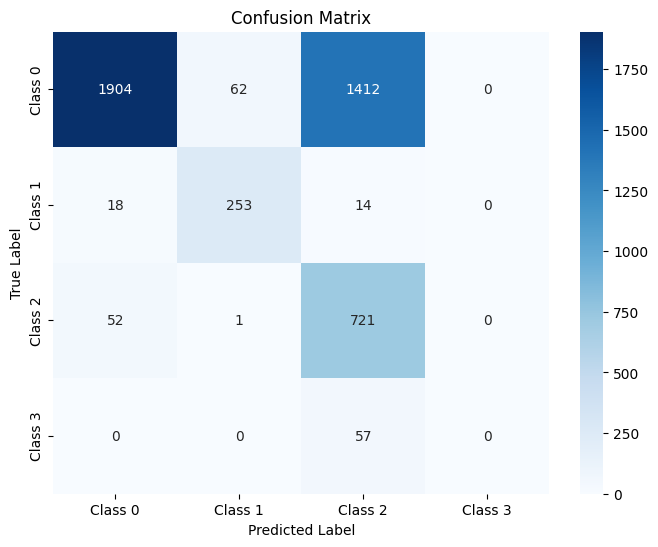

The function took 0.3980 seconds to execute.
[ARCH#118-[4, 4, 2, 2]] done in 32.0s  best-val=0.5618


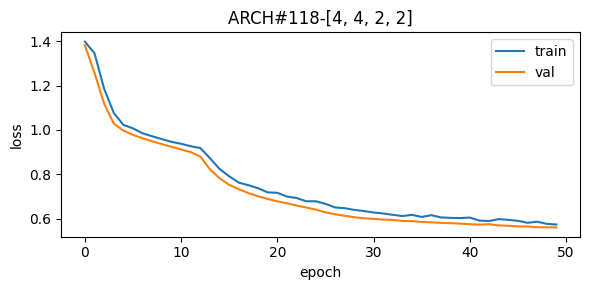


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.89      0.93     10808
     Class 1       0.50      1.00      0.66       914
     Class 2       0.99      0.86      0.92      2475
     Class 3       0.14      0.42      0.21       182

    accuracy                           0.89     14379
   macro avg       0.65      0.79      0.68     14379
weighted avg       0.94      0.89      0.90     14379



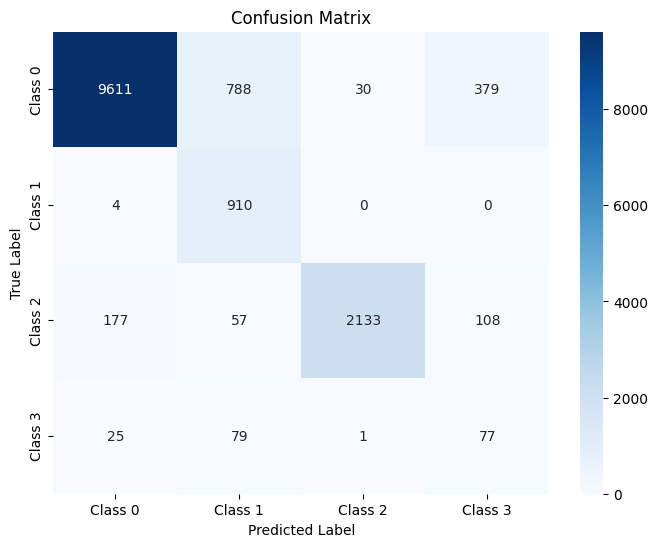

The function took 0.7481 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.89      0.93      2702
     Class 1       0.50      0.99      0.66       228
     Class 2       0.99      0.88      0.93       619
     Class 3       0.12      0.37      0.19        46

    accuracy                           0.89      3595
   macro avg       0.65      0.78      0.68      3595
weighted avg       0.94      0.89      0.91      3595



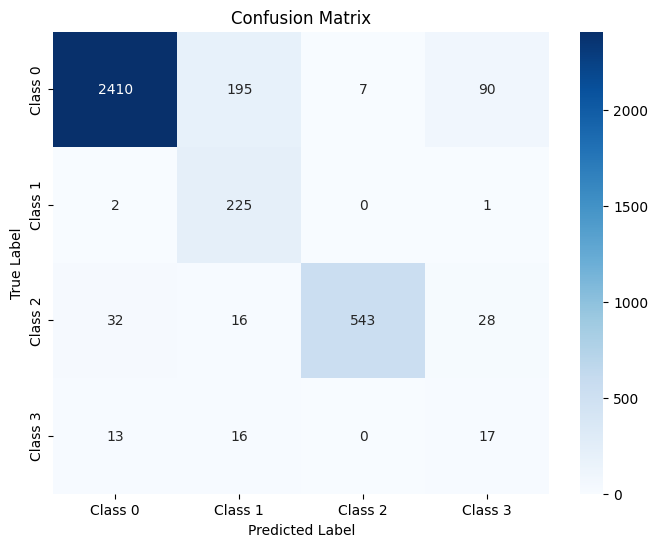

The function took 0.4796 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.88      0.92      3378
     Class 1       0.48      0.98      0.64       285
     Class 2       0.98      0.84      0.91       774
     Class 3       0.11      0.40      0.18        57

    accuracy                           0.87      4494
   macro avg       0.64      0.78      0.66      4494
weighted avg       0.93      0.87      0.89      4494



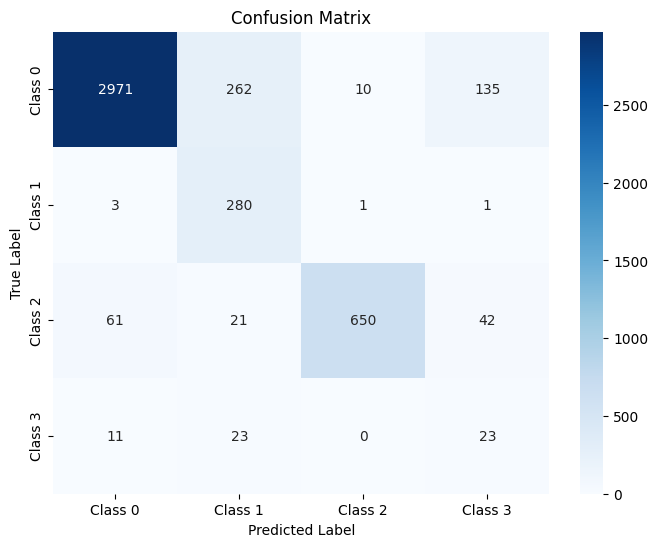

The function took 0.5106 seconds to execute.
[ARCH#119-[4, 2, 2, 2]] done in 32.8s  best-val=0.7360


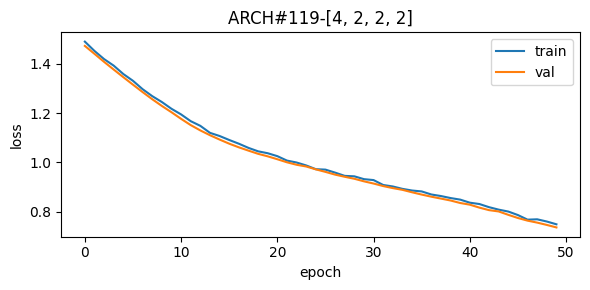


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.96      0.85      0.90     10808
     Class 1       0.00      0.00      0.00       914
     Class 2       0.49      0.86      0.62      2475
     Class 3       0.38      0.95      0.54       182

    accuracy                           0.80     14379
   macro avg       0.46      0.66      0.52     14379
weighted avg       0.81      0.80      0.79     14379



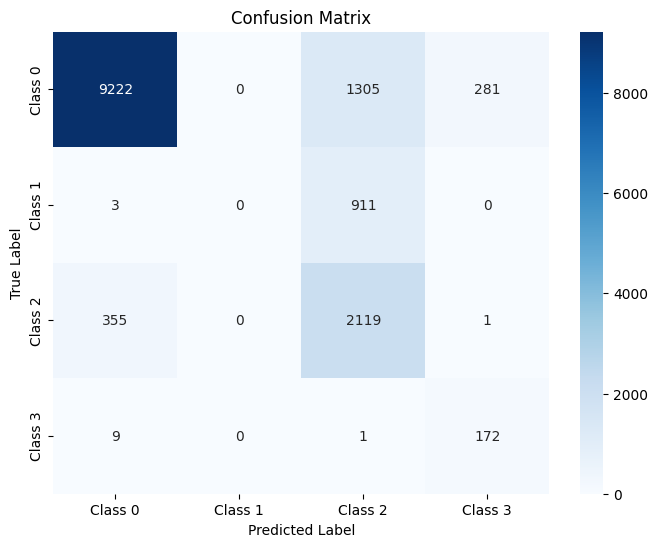

The function took 0.6259 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.96      0.86      0.90      2702
     Class 1       0.00      0.00      0.00       228
     Class 2       0.49      0.84      0.62       619
     Class 3       0.36      0.93      0.52        46

    accuracy                           0.80      3595
   macro avg       0.45      0.66      0.51      3595
weighted avg       0.81      0.80      0.79      3595



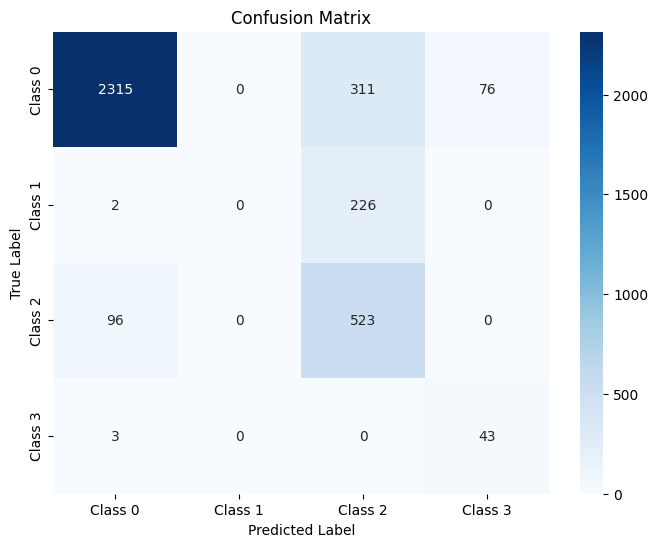

The function took 0.3454 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.96      0.85      0.90      3378
     Class 1       0.00      0.00      0.00       285
     Class 2       0.49      0.86      0.62       774
     Class 3       0.36      0.95      0.52        57

    accuracy                           0.80      4494
   macro avg       0.45      0.66      0.51      4494
weighted avg       0.81      0.80      0.79      4494



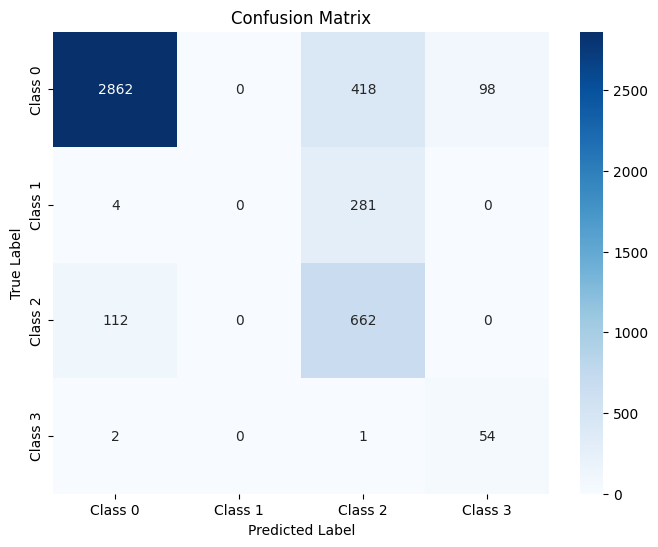

The function took 0.8617 seconds to execute.
[ARCH#120-[2, 2, 2, 2]] done in 33.4s  best-val=0.7564


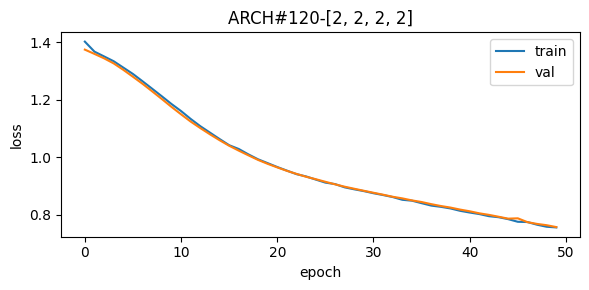


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.97      0.57      0.72     10808
     Class 1       0.22      0.96      0.36       914
     Class 2       0.62      0.91      0.74      2475
     Class 3       0.45      0.85      0.59       182

    accuracy                           0.66     14379
   macro avg       0.56      0.82      0.60     14379
weighted avg       0.85      0.66      0.70     14379



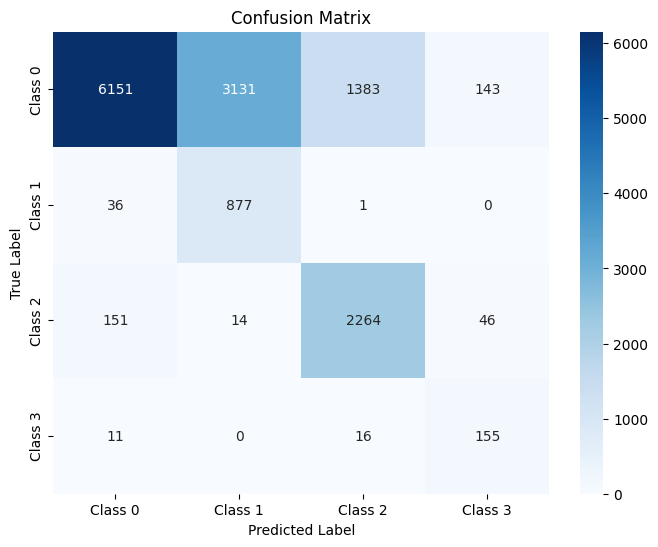

The function took 0.6202 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.97      0.57      0.72      2702
     Class 1       0.22      0.95      0.36       228
     Class 2       0.61      0.91      0.73       619
     Class 3       0.43      0.85      0.57        46

    accuracy                           0.66      3595
   macro avg       0.56      0.82      0.59      3595
weighted avg       0.85      0.66      0.70      3595



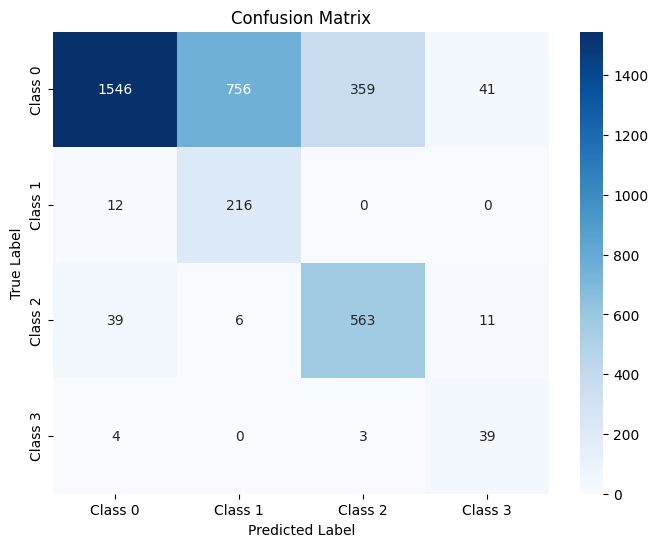

The function took 0.4897 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.97      0.56      0.71      3378
     Class 1       0.21      0.95      0.35       285
     Class 2       0.61      0.92      0.73       774
     Class 3       0.44      0.86      0.58        57

    accuracy                           0.65      4494
   macro avg       0.56      0.82      0.59      4494
weighted avg       0.85      0.65      0.69      4494



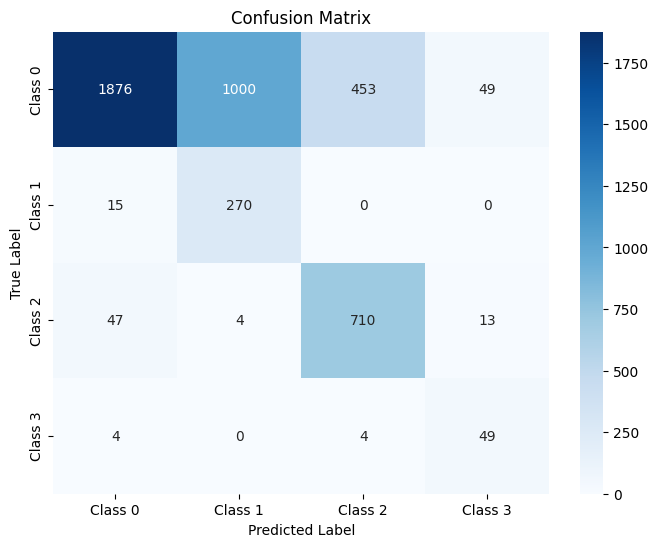

The function took 0.3791 seconds to execute.
[ARCH#121-[32, 32, 32, 32, 32]] done in 35.9s  best-val=0.0624


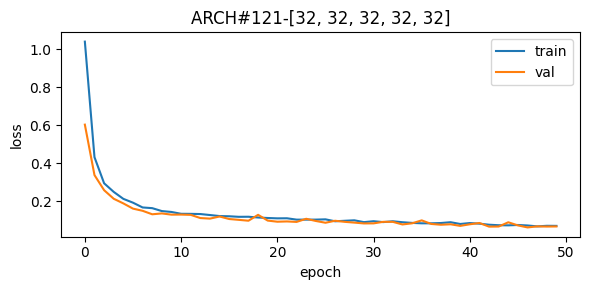


Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.95      0.97     10808
     Class 1       0.82      1.00      0.90       914
     Class 2       0.91      0.99      0.95      2475
     Class 3       0.65      0.99      0.79       182

    accuracy                           0.96     14379
   macro avg       0.85      0.98      0.90     14379
weighted avg       0.97      0.96      0.96     14379



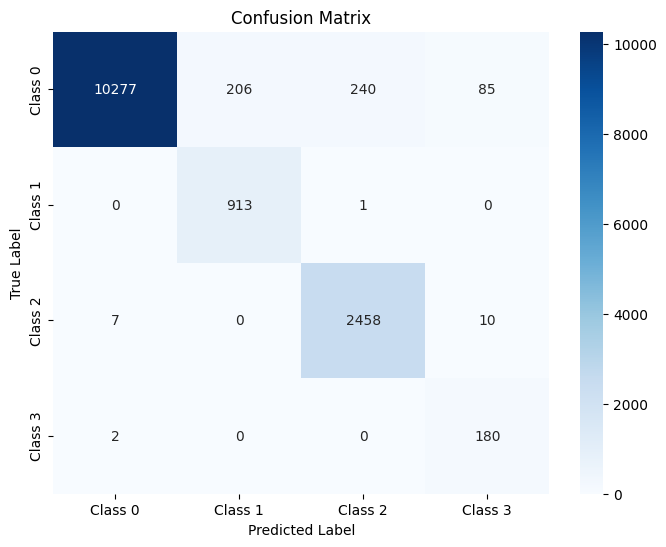

The function took 0.6905 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.95      0.97      2702
     Class 1       0.80      1.00      0.89       228
     Class 2       0.90      0.99      0.94       619
     Class 3       0.70      1.00      0.82        46

    accuracy                           0.96      3595
   macro avg       0.85      0.98      0.91      3595
weighted avg       0.96      0.96      0.96      3595



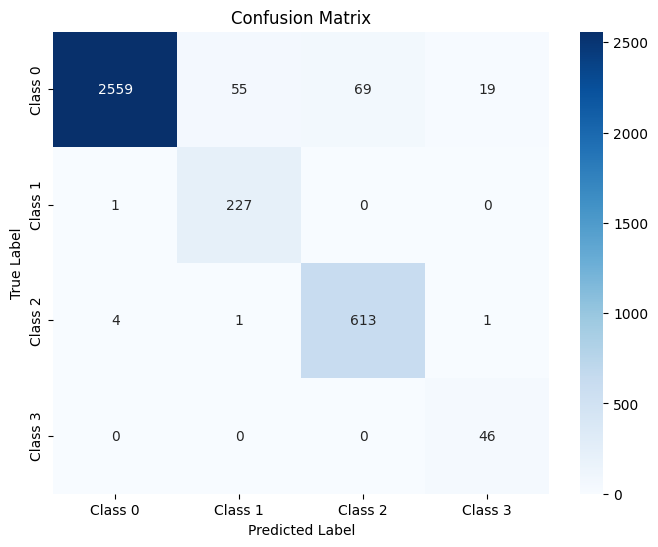

The function took 0.3633 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.95      0.97      3378
     Class 1       0.81      0.99      0.89       285
     Class 2       0.91      0.98      0.95       774
     Class 3       0.68      0.95      0.79        57

    accuracy                           0.96      4494
   macro avg       0.85      0.97      0.90      4494
weighted avg       0.97      0.96      0.96      4494



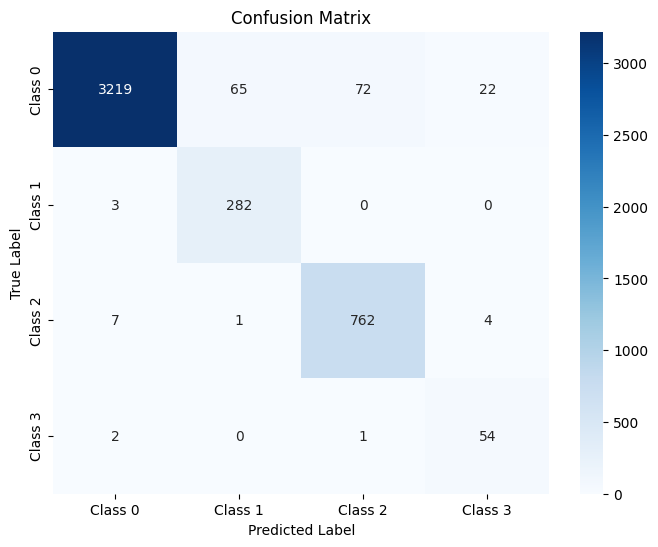

The function took 0.3770 seconds to execute.
[ARCH#122-[32, 32, 32, 32, 16]] done in 35.6s  best-val=0.0623


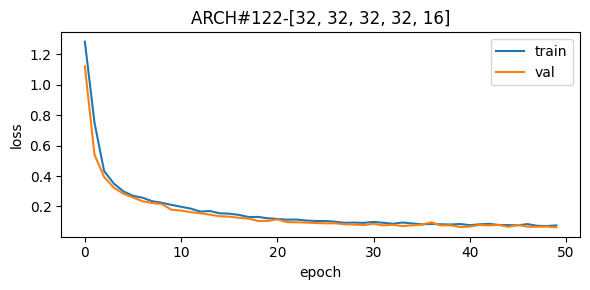


Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.95      0.97     10808
     Class 1       0.80      1.00      0.89       914
     Class 2       0.90      0.99      0.94      2475
     Class 3       0.77      0.99      0.87       182

    accuracy                           0.96     14379
   macro avg       0.87      0.98      0.92     14379
weighted avg       0.97      0.96      0.96     14379



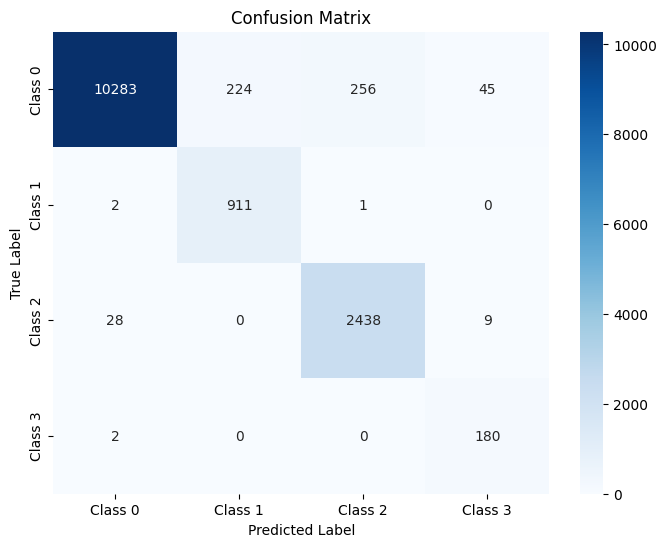

The function took 0.6366 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.95      0.97      2702
     Class 1       0.82      0.99      0.90       228
     Class 2       0.89      0.99      0.94       619
     Class 3       0.75      1.00      0.86        46

    accuracy                           0.96      3595
   macro avg       0.87      0.98      0.92      3595
weighted avg       0.96      0.96      0.96      3595



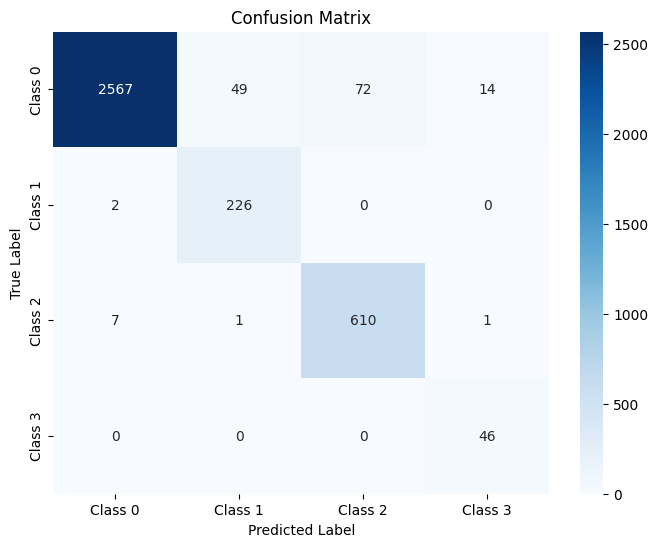

The function took 0.4607 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.95      0.97      3378
     Class 1       0.81      0.99      0.89       285
     Class 2       0.91      0.97      0.94       774
     Class 3       0.75      0.96      0.85        57

    accuracy                           0.96      4494
   macro avg       0.87      0.97      0.91      4494
weighted avg       0.96      0.96      0.96      4494



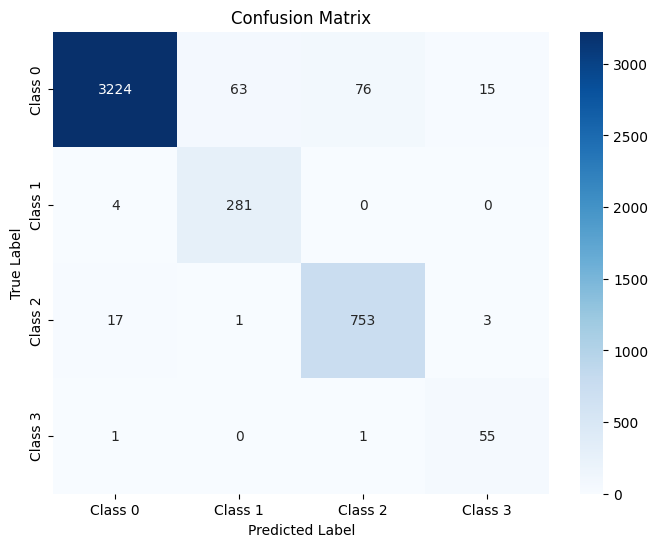

The function took 0.3854 seconds to execute.
[ARCH#123-[32, 32, 32, 32, 8]] done in 35.7s  best-val=0.0579


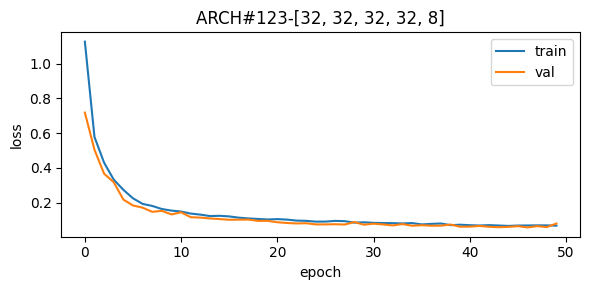


Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.96      0.98     10808
     Class 1       0.80      1.00      0.88       914
     Class 2       0.92      0.98      0.95      2475
     Class 3       0.80      0.99      0.89       182

    accuracy                           0.96     14379
   macro avg       0.88      0.98      0.92     14379
weighted avg       0.97      0.96      0.96     14379



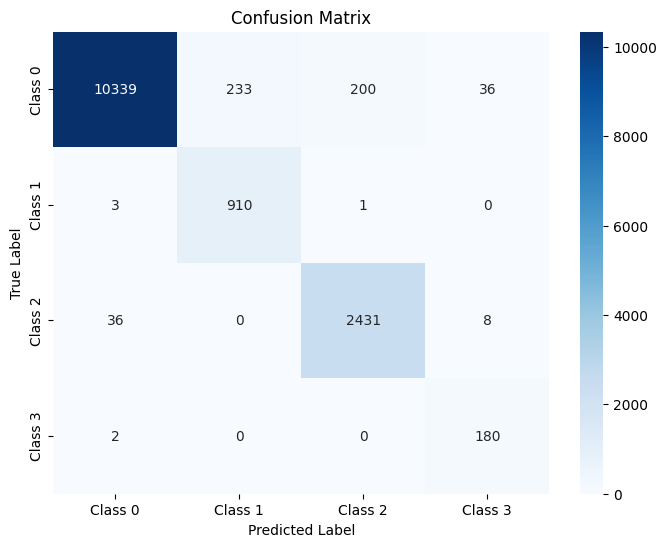

The function took 0.5840 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.96      0.98      2702
     Class 1       0.80      1.00      0.89       228
     Class 2       0.92      0.99      0.95       619
     Class 3       0.77      1.00      0.87        46

    accuracy                           0.96      3595
   macro avg       0.87      0.98      0.92      3595
weighted avg       0.97      0.96      0.97      3595



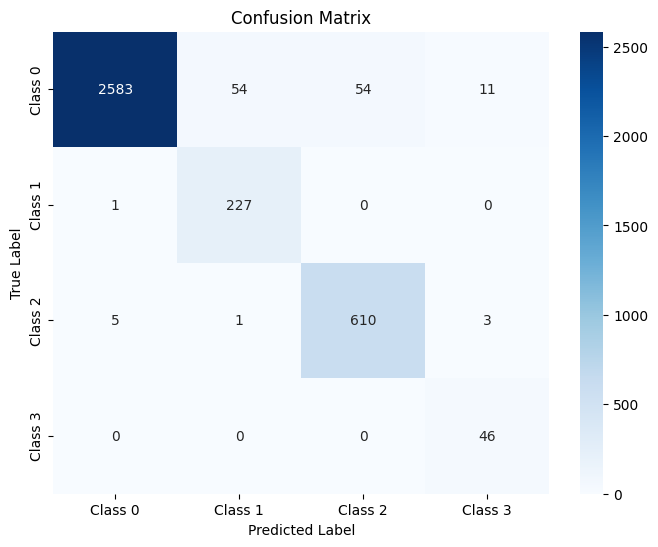

The function took 0.3651 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.96      0.98      3378
     Class 1       0.79      0.99      0.88       285
     Class 2       0.93      0.98      0.95       774
     Class 3       0.87      0.95      0.91        57

    accuracy                           0.97      4494
   macro avg       0.90      0.97      0.93      4494
weighted avg       0.97      0.97      0.97      4494



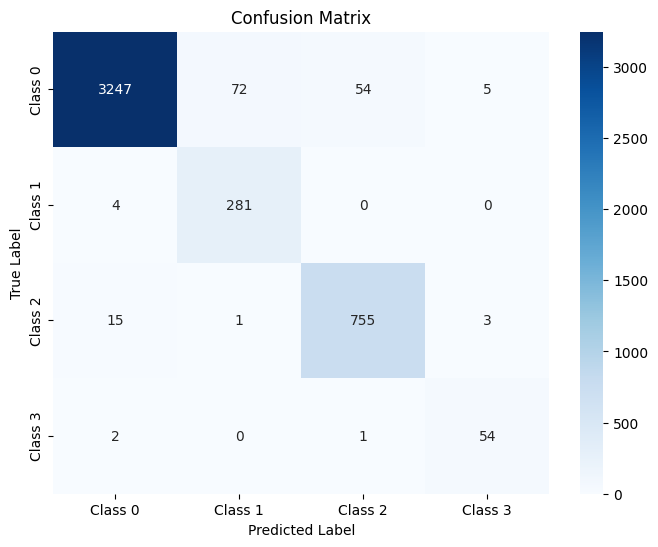

The function took 0.4767 seconds to execute.
[ARCH#124-[32, 32, 32, 32, 4]] done in 35.7s  best-val=0.1958


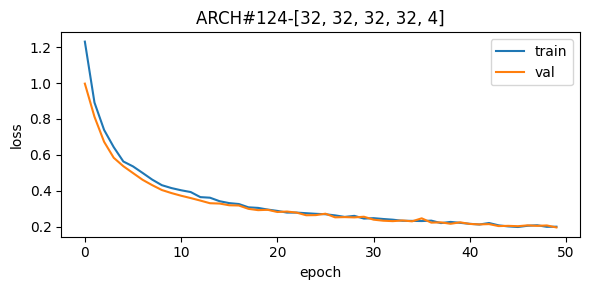


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.97      0.97      0.97     10808
     Class 1       0.92      0.96      0.94       914
     Class 2       0.96      0.86      0.91      2475
     Class 3       0.40      0.99      0.57       182

    accuracy                           0.95     14379
   macro avg       0.82      0.94      0.85     14379
weighted avg       0.96      0.95      0.95     14379



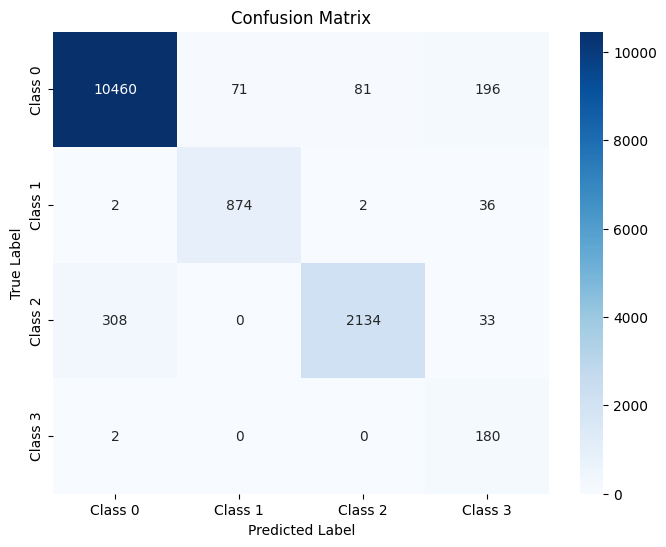

The function took 0.6941 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.97      0.97      0.97      2702
     Class 1       0.91      0.93      0.92       228
     Class 2       0.97      0.88      0.92       619
     Class 3       0.37      1.00      0.54        46

    accuracy                           0.95      3595
   macro avg       0.81      0.94      0.84      3595
weighted avg       0.96      0.95      0.95      3595



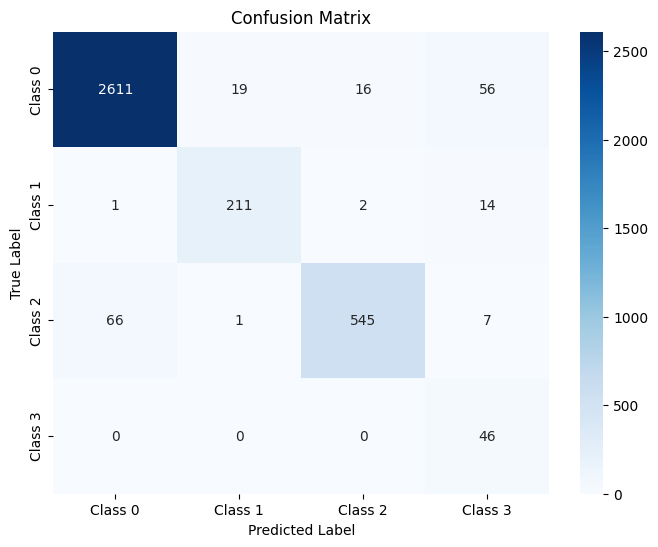

The function took 0.5015 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.97      0.97      0.97      3378
     Class 1       0.93      0.94      0.93       285
     Class 2       0.96      0.84      0.90       774
     Class 3       0.39      0.95      0.56        57

    accuracy                           0.95      4494
   macro avg       0.81      0.92      0.84      4494
weighted avg       0.96      0.95      0.95      4494



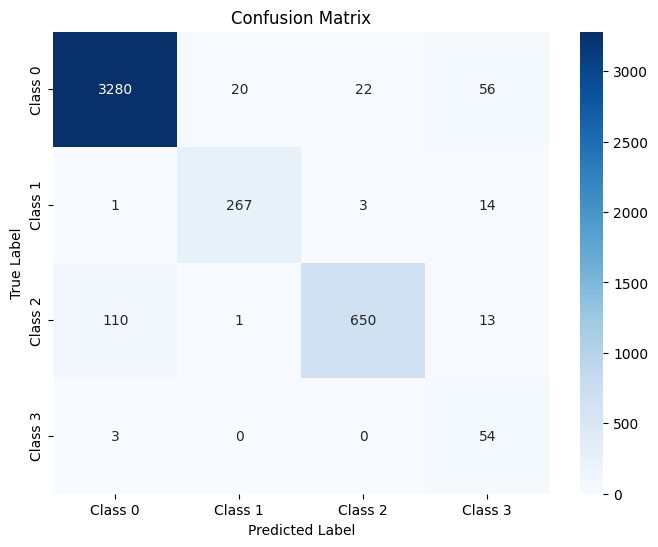

The function took 0.4891 seconds to execute.
[ARCH#125-[32, 32, 32, 32, 2]] done in 35.9s  best-val=0.0737


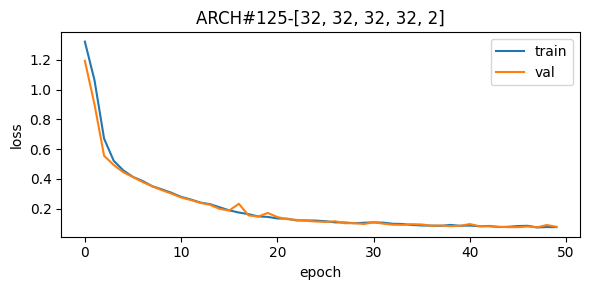


Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.95      0.98     10808
     Class 1       0.80      1.00      0.89       914
     Class 2       0.91      1.00      0.95      2475
     Class 3       0.80      0.99      0.88       182

    accuracy                           0.96     14379
   macro avg       0.88      0.98      0.92     14379
weighted avg       0.97      0.96      0.97     14379



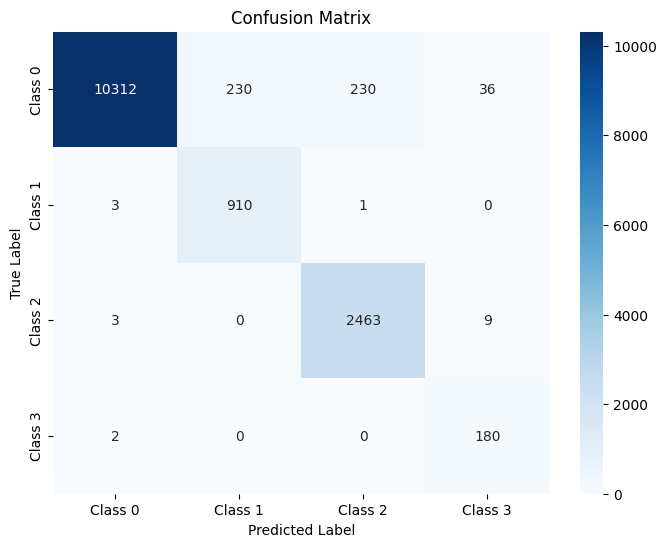

The function took 0.6039 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.95      0.98      2702
     Class 1       0.81      0.99      0.89       228
     Class 2       0.90      1.00      0.95       619
     Class 3       0.82      1.00      0.90        46

    accuracy                           0.96      3595
   macro avg       0.88      0.99      0.93      3595
weighted avg       0.97      0.96      0.96      3595



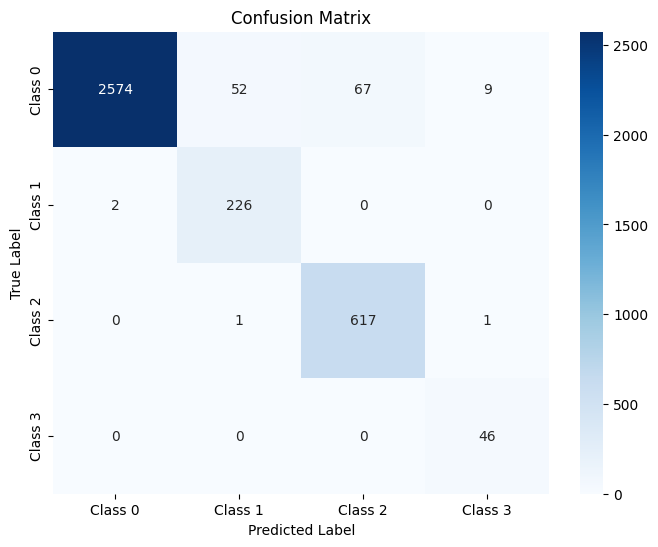

The function took 0.5563 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.96      0.98      3378
     Class 1       0.81      0.99      0.89       285
     Class 2       0.91      0.99      0.95       774
     Class 3       0.79      0.95      0.86        57

    accuracy                           0.96      4494
   macro avg       0.88      0.97      0.92      4494
weighted avg       0.97      0.96      0.96      4494



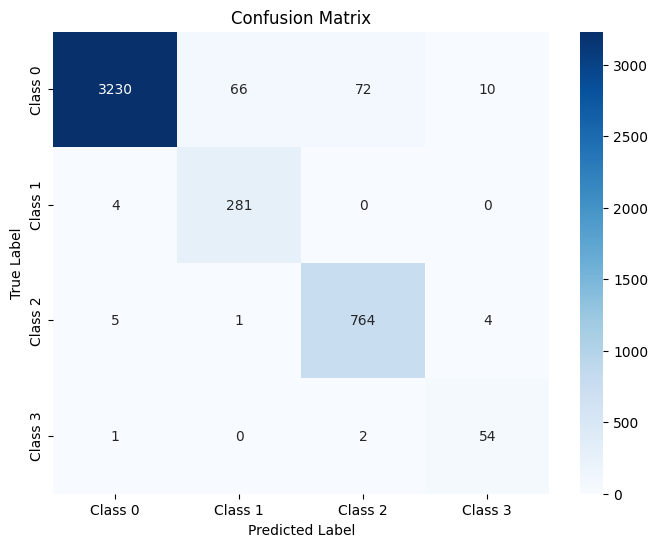

The function took 0.5168 seconds to execute.
[ARCH#126-[32, 32, 32, 16, 16]] done in 35.2s  best-val=0.0568


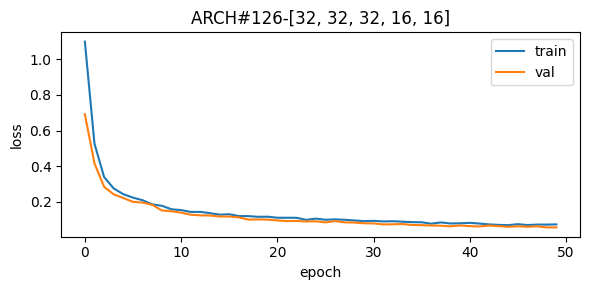


Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.95      0.98     10808
     Class 1       0.80      1.00      0.89       914
     Class 2       0.91      0.99      0.95      2475
     Class 3       0.78      0.99      0.87       182

    accuracy                           0.96     14379
   macro avg       0.87      0.98      0.92     14379
weighted avg       0.97      0.96      0.96     14379



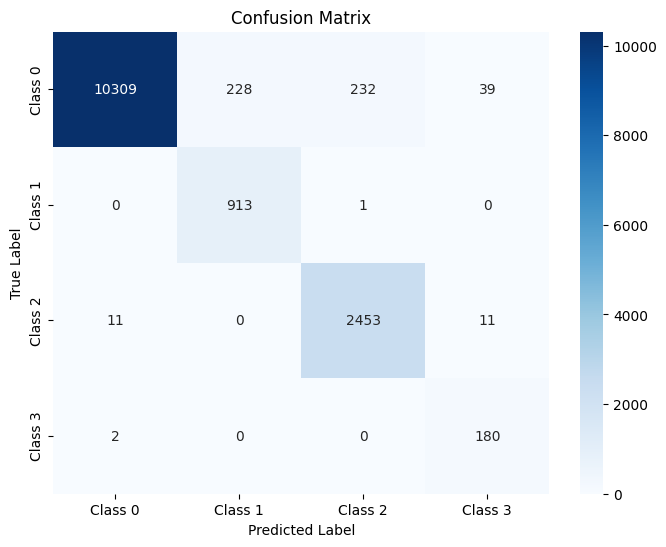

The function took 0.7037 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.95      0.98      2702
     Class 1       0.81      1.00      0.90       228
     Class 2       0.91      0.99      0.95       619
     Class 3       0.81      1.00      0.89        46

    accuracy                           0.96      3595
   macro avg       0.88      0.99      0.93      3595
weighted avg       0.97      0.96      0.96      3595



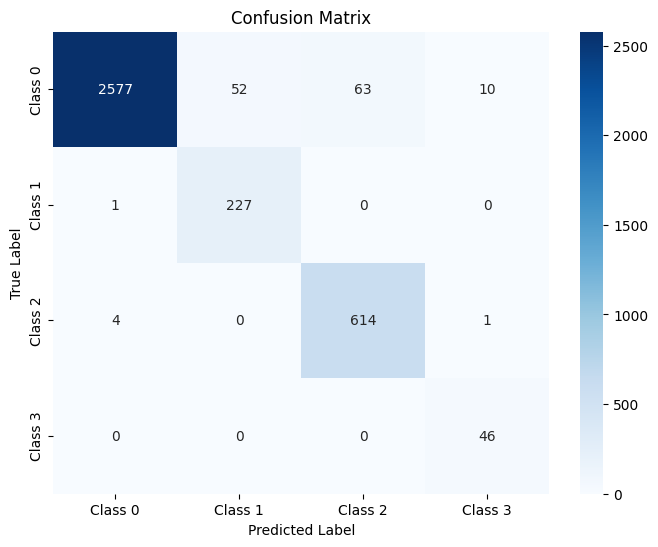

The function took 0.3507 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.96      0.98      3378
     Class 1       0.80      0.99      0.89       285
     Class 2       0.92      0.99      0.95       774
     Class 3       0.77      0.95      0.85        57

    accuracy                           0.96      4494
   macro avg       0.87      0.97      0.92      4494
weighted avg       0.97      0.96      0.96      4494



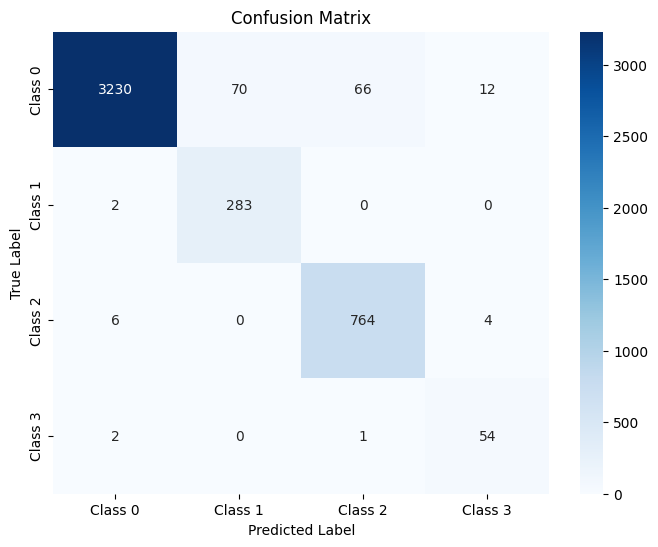

The function took 1.0385 seconds to execute.
[ARCH#127-[32, 32, 32, 16, 8]] done in 35.8s  best-val=0.0601


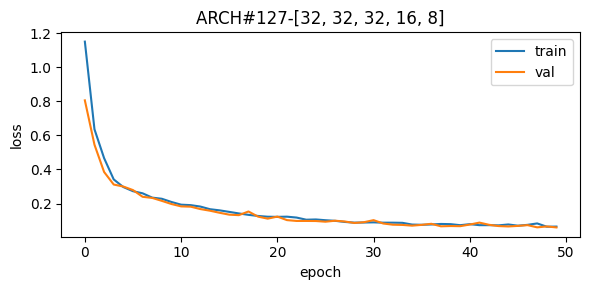


Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.95      0.97     10808
     Class 1       0.80      1.00      0.88       914
     Class 2       0.90      0.99      0.94      2475
     Class 3       0.78      0.99      0.87       182

    accuracy                           0.96     14379
   macro avg       0.87      0.98      0.92     14379
weighted avg       0.97      0.96      0.96     14379



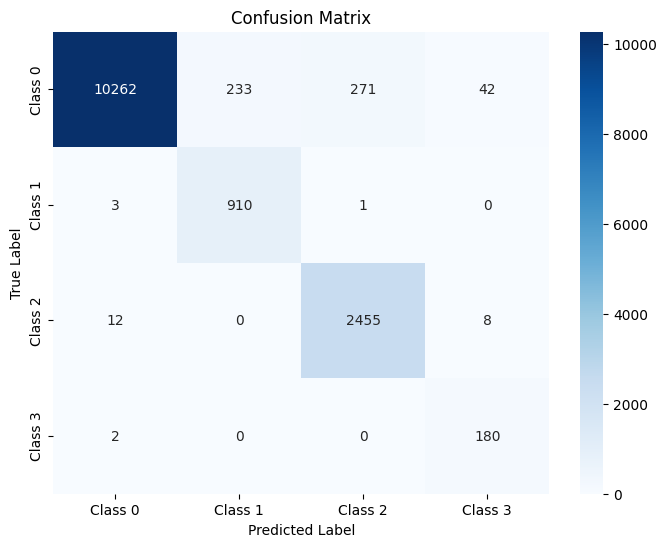

The function took 0.8308 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.95      0.97      2702
     Class 1       0.80      1.00      0.89       228
     Class 2       0.89      0.99      0.94       619
     Class 3       0.75      1.00      0.86        46

    accuracy                           0.96      3595
   macro avg       0.86      0.98      0.92      3595
weighted avg       0.96      0.96      0.96      3595



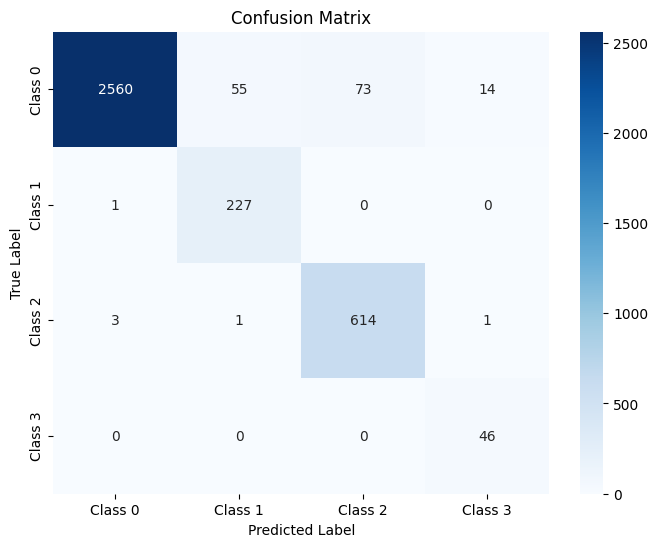

The function took 0.4306 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.95      0.97      3378
     Class 1       0.81      0.99      0.89       285
     Class 2       0.91      0.98      0.94       774
     Class 3       0.70      0.95      0.81        57

    accuracy                           0.96      4494
   macro avg       0.85      0.97      0.90      4494
weighted avg       0.97      0.96      0.96      4494



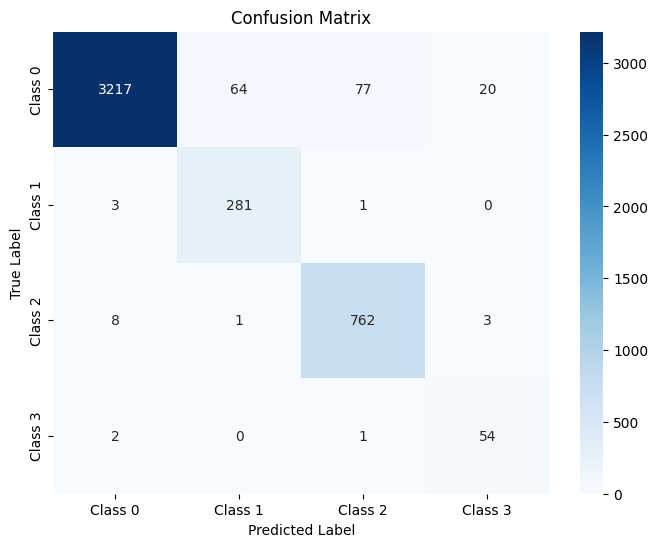

The function took 0.5019 seconds to execute.
[ARCH#128-[32, 32, 32, 16, 4]] early-stop @ epoch 041
[ARCH#128-[32, 32, 32, 16, 4]] done in 30.2s  best-val=1.3794


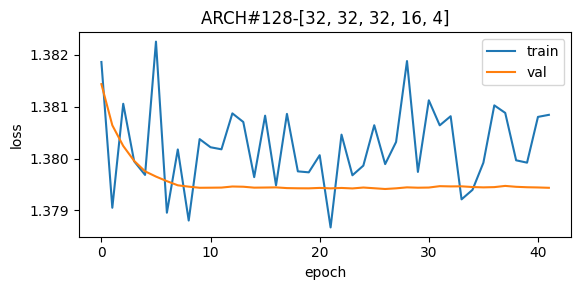


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86     10808
     Class 1       0.00      0.00      0.00       914
     Class 2       0.00      0.00      0.00      2475
     Class 3       0.00      0.00      0.00       182

    accuracy                           0.75     14379
   macro avg       0.19      0.25      0.21     14379
weighted avg       0.56      0.75      0.65     14379



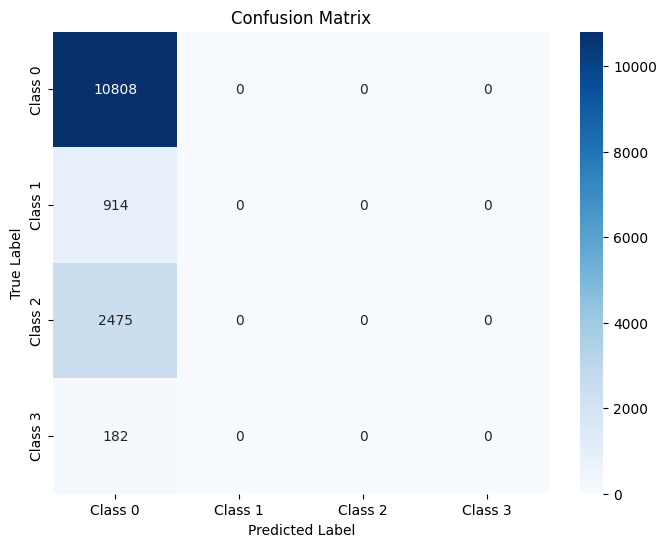

The function took 0.7434 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86      2702
     Class 1       0.00      0.00      0.00       228
     Class 2       0.00      0.00      0.00       619
     Class 3       0.00      0.00      0.00        46

    accuracy                           0.75      3595
   macro avg       0.19      0.25      0.21      3595
weighted avg       0.56      0.75      0.65      3595



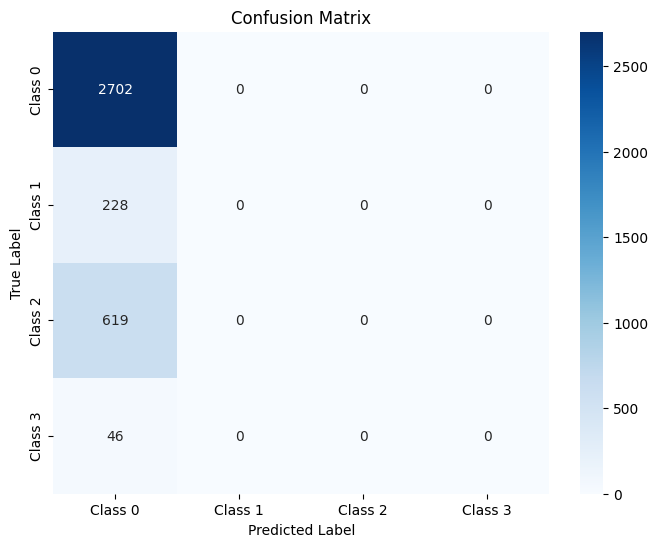

The function took 0.3581 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86      3378
     Class 1       0.00      0.00      0.00       285
     Class 2       0.00      0.00      0.00       774
     Class 3       0.00      0.00      0.00        57

    accuracy                           0.75      4494
   macro avg       0.19      0.25      0.21      4494
weighted avg       0.57      0.75      0.65      4494



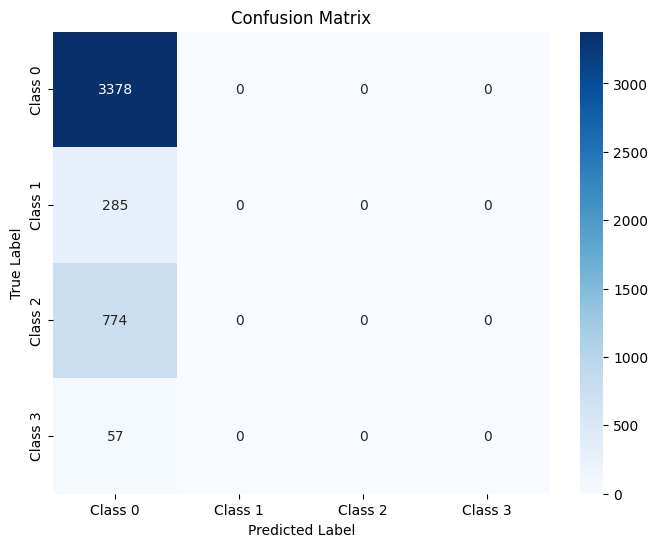

The function took 0.3767 seconds to execute.
[ARCH#129-[32, 32, 32, 16, 2]] done in 35.3s  best-val=0.1076


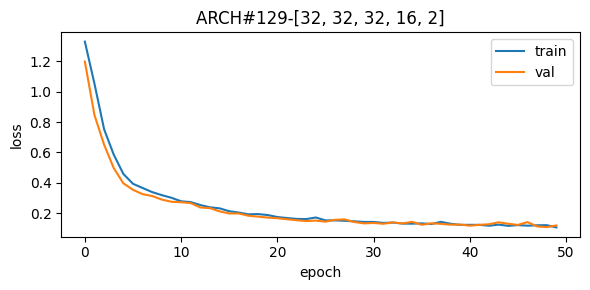


Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.95      0.97     10808
     Class 1       0.80      1.00      0.89       914
     Class 2       0.90      0.99      0.94      2475
     Class 3       0.78      0.94      0.85       182

    accuracy                           0.96     14379
   macro avg       0.87      0.97      0.91     14379
weighted avg       0.97      0.96      0.96     14379



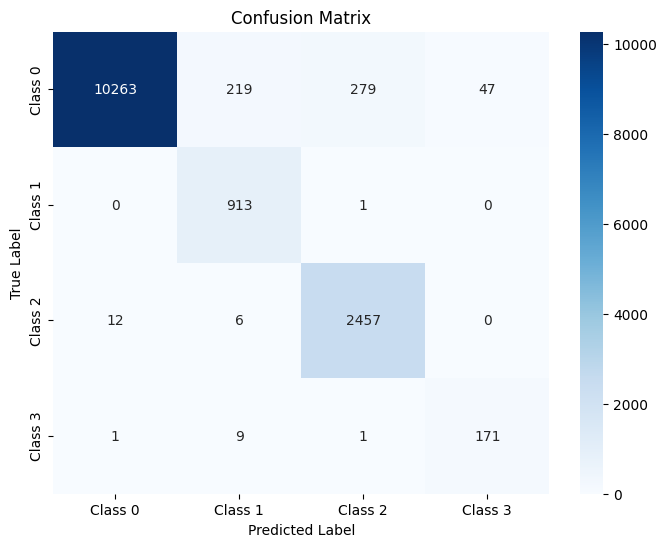

The function took 0.6273 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.95      0.97      2702
     Class 1       0.80      1.00      0.88       228
     Class 2       0.89      0.99      0.94       619
     Class 3       0.78      0.93      0.85        46

    accuracy                           0.96      3595
   macro avg       0.87      0.97      0.91      3595
weighted avg       0.96      0.96      0.96      3595



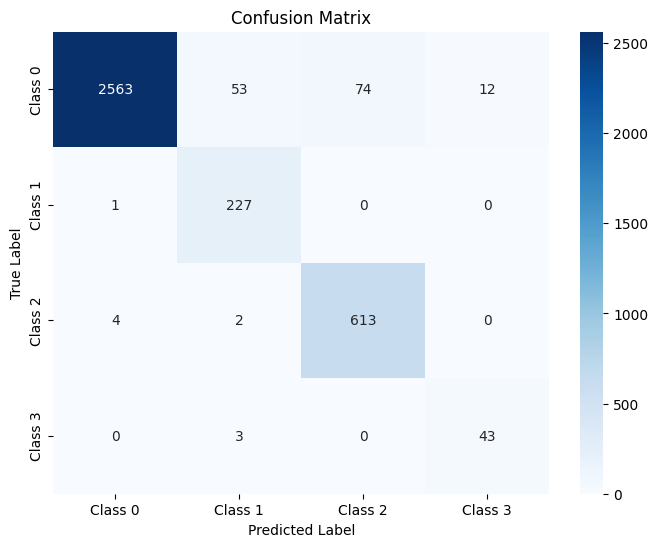

The function took 0.4290 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.95      0.98      3378
     Class 1       0.80      0.99      0.89       285
     Class 2       0.91      0.99      0.95       774
     Class 3       0.74      0.91      0.82        57

    accuracy                           0.96      4494
   macro avg       0.86      0.96      0.91      4494
weighted avg       0.97      0.96      0.96      4494



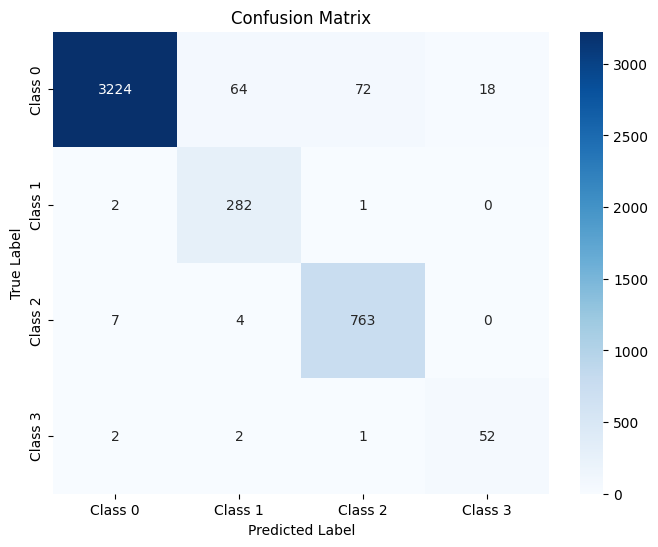

The function took 0.3942 seconds to execute.
[ARCH#130-[32, 32, 32, 8, 8]] done in 35.4s  best-val=0.0596


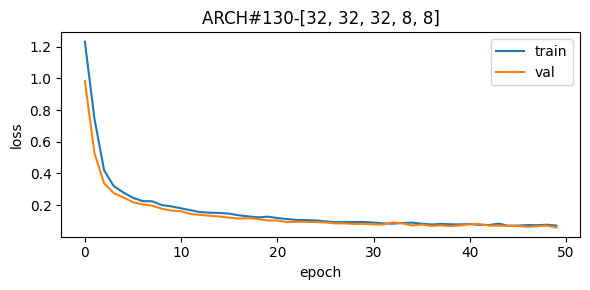


Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.95      0.98     10808
     Class 1       0.83      1.00      0.91       914
     Class 2       0.90      0.99      0.94      2475
     Class 3       0.83      0.99      0.90       182

    accuracy                           0.96     14379
   macro avg       0.89      0.98      0.93     14379
weighted avg       0.97      0.96      0.96     14379



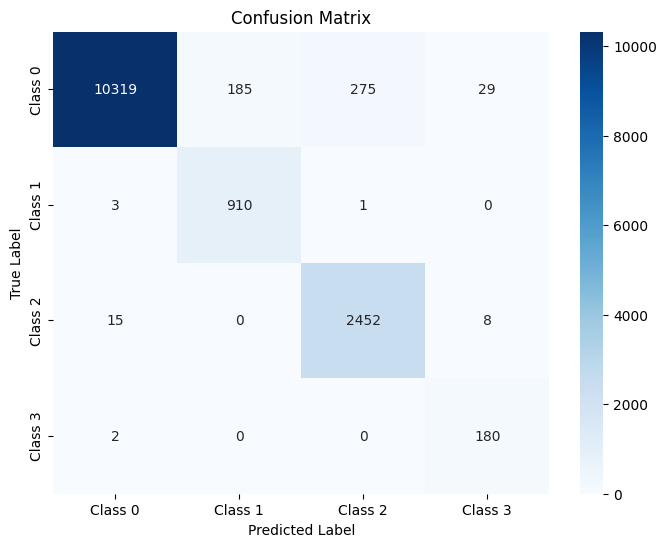

The function took 0.7443 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.95      0.98      2702
     Class 1       0.83      1.00      0.91       228
     Class 2       0.90      0.99      0.94       619
     Class 3       0.81      1.00      0.89        46

    accuracy                           0.96      3595
   macro avg       0.88      0.98      0.93      3595
weighted avg       0.97      0.96      0.96      3595



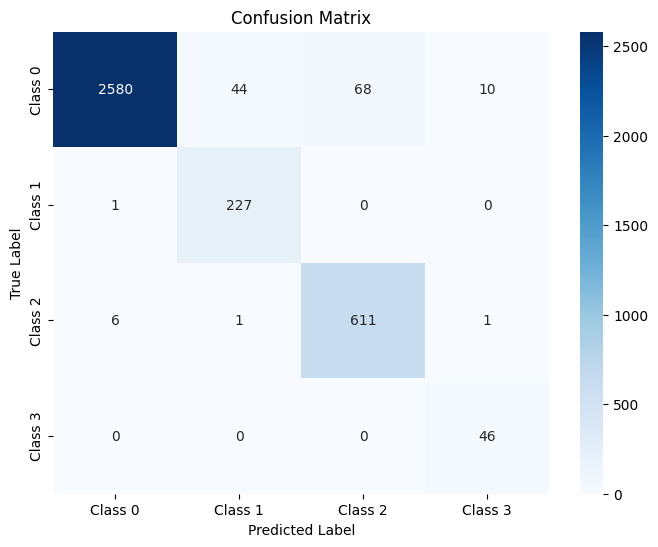

The function took 0.4343 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.96      0.98      3378
     Class 1       0.84      0.99      0.91       285
     Class 2       0.89      0.99      0.94       774
     Class 3       0.83      0.93      0.88        57

    accuracy                           0.96      4494
   macro avg       0.89      0.97      0.92      4494
weighted avg       0.97      0.96      0.96      4494



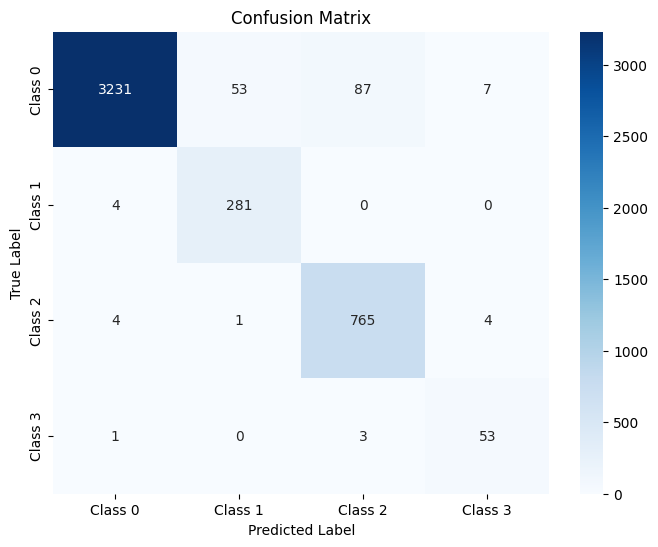

The function took 0.3986 seconds to execute.
[ARCH#131-[32, 32, 32, 8, 4]] done in 35.0s  best-val=0.1022


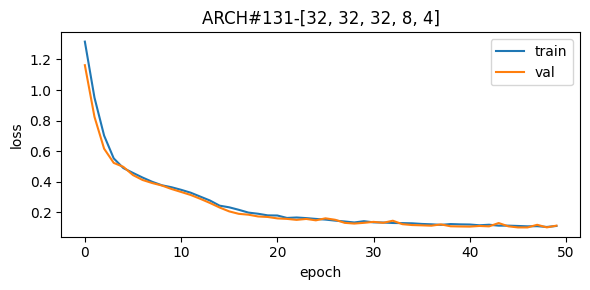


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.95      0.97     10808
     Class 1       0.75      1.00      0.86       914
     Class 2       0.94      0.92      0.93      2475
     Class 3       0.71      0.99      0.83       182

    accuracy                           0.95     14379
   macro avg       0.85      0.97      0.90     14379
weighted avg       0.96      0.95      0.95     14379



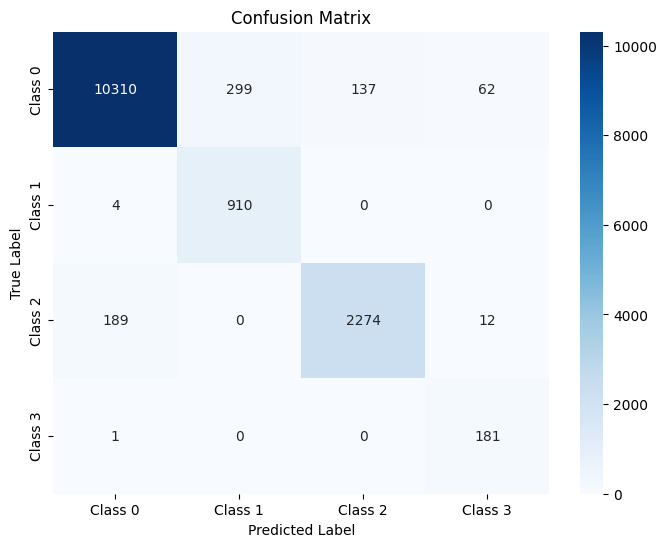

The function took 0.7757 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.95      0.97      2702
     Class 1       0.76      0.99      0.86       228
     Class 2       0.93      0.93      0.93       619
     Class 3       0.72      1.00      0.84        46

    accuracy                           0.95      3595
   macro avg       0.85      0.97      0.90      3595
weighted avg       0.96      0.95      0.95      3595



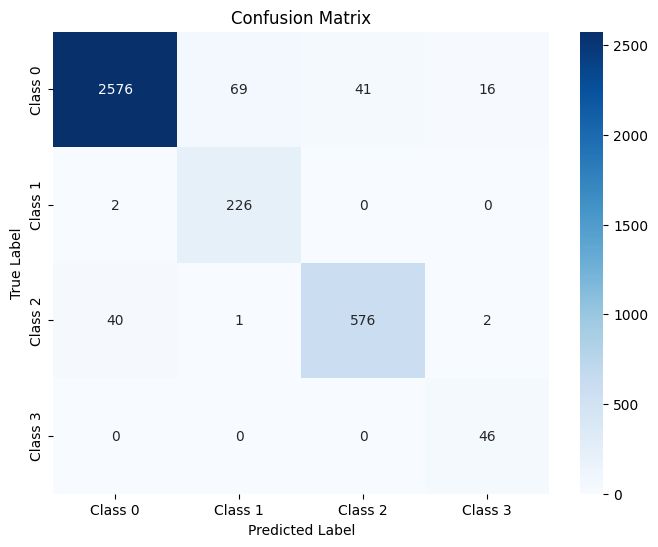

The function took 0.3534 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.95      0.96      3378
     Class 1       0.74      0.99      0.85       285
     Class 2       0.94      0.92      0.93       774
     Class 3       0.59      0.95      0.73        57

    accuracy                           0.95      4494
   macro avg       0.82      0.95      0.87      4494
weighted avg       0.95      0.95      0.95      4494



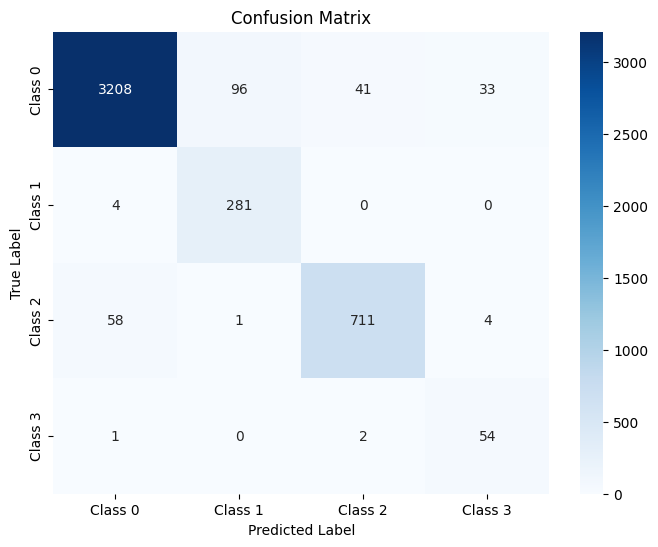

The function took 0.3798 seconds to execute.
[ARCH#132-[32, 32, 32, 8, 2]] done in 35.4s  best-val=1.3794


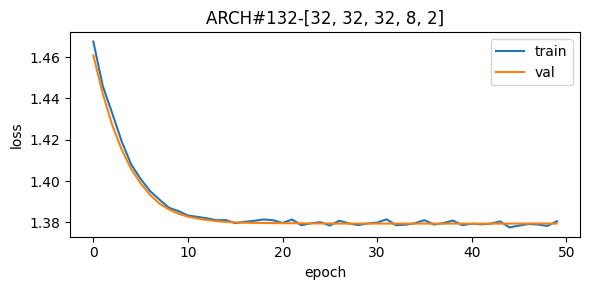


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86     10808
     Class 1       0.00      0.00      0.00       914
     Class 2       0.00      0.00      0.00      2475
     Class 3       0.00      0.00      0.00       182

    accuracy                           0.75     14379
   macro avg       0.19      0.25      0.21     14379
weighted avg       0.56      0.75      0.65     14379



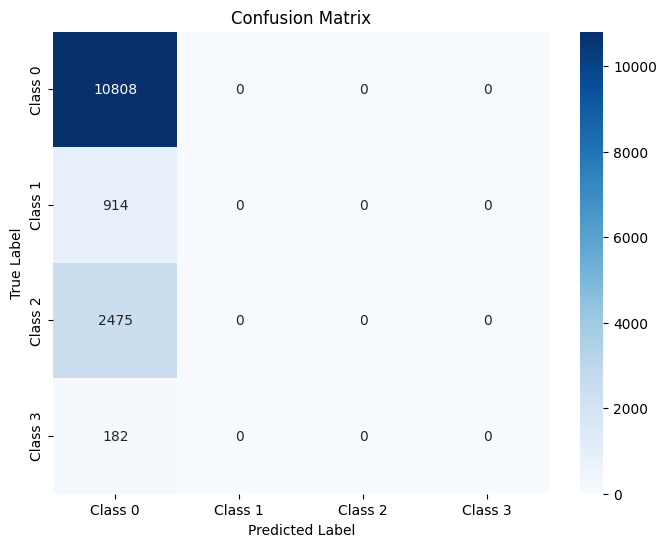

The function took 0.7307 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86      2702
     Class 1       0.00      0.00      0.00       228
     Class 2       0.00      0.00      0.00       619
     Class 3       0.00      0.00      0.00        46

    accuracy                           0.75      3595
   macro avg       0.19      0.25      0.21      3595
weighted avg       0.56      0.75      0.65      3595



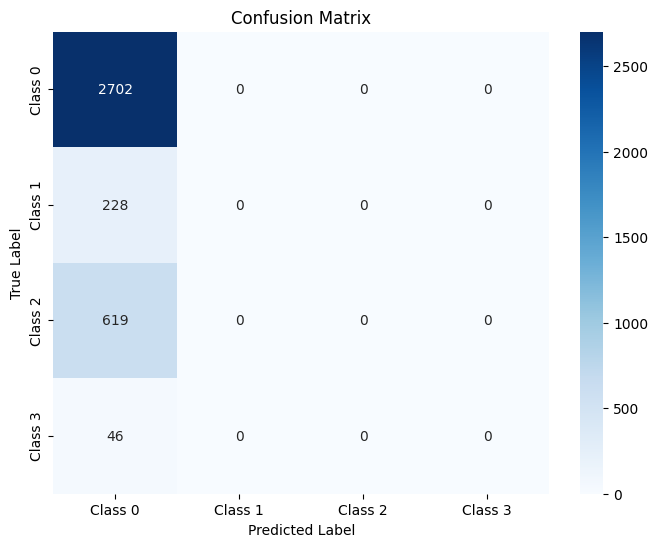

The function took 0.3502 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86      3378
     Class 1       0.00      0.00      0.00       285
     Class 2       0.00      0.00      0.00       774
     Class 3       0.00      0.00      0.00        57

    accuracy                           0.75      4494
   macro avg       0.19      0.25      0.21      4494
weighted avg       0.57      0.75      0.65      4494



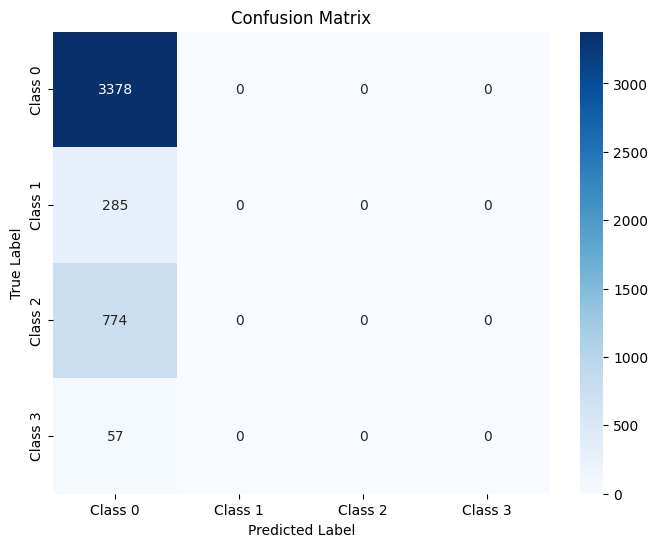

The function took 0.4619 seconds to execute.
[ARCH#133-[32, 32, 32, 4, 4]] done in 34.9s  best-val=0.1490


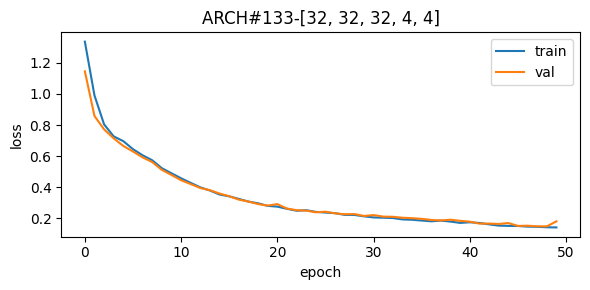


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.95      0.97     10808
     Class 1       0.89      0.96      0.92       914
     Class 2       0.90      0.98      0.94      2475
     Class 3       0.46      0.99      0.63       182

    accuracy                           0.96     14379
   macro avg       0.81      0.97      0.86     14379
weighted avg       0.97      0.96      0.96     14379



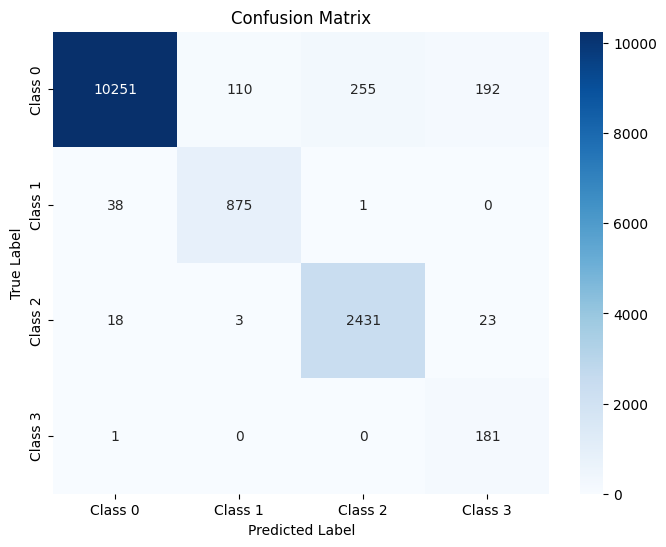

The function took 0.7052 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.95      0.97      2702
     Class 1       0.87      0.94      0.91       228
     Class 2       0.90      0.98      0.94       619
     Class 3       0.53      1.00      0.69        46

    accuracy                           0.96      3595
   macro avg       0.82      0.97      0.88      3595
weighted avg       0.96      0.96      0.96      3595



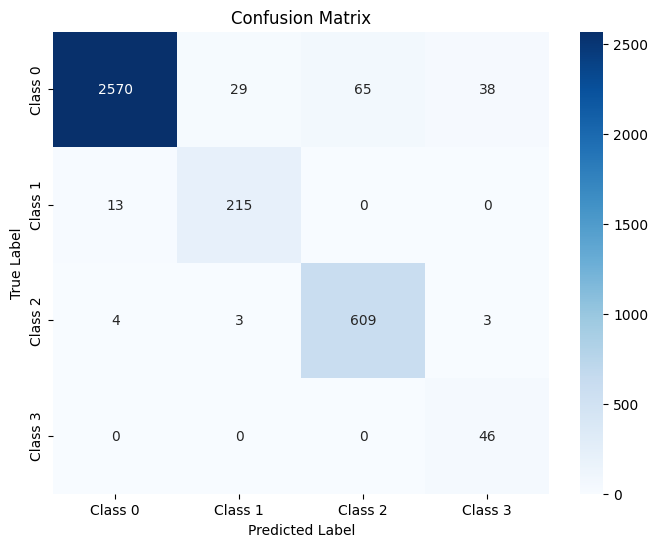

The function took 0.6824 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.95      0.97      3378
     Class 1       0.88      0.94      0.91       285
     Class 2       0.92      0.98      0.95       774
     Class 3       0.42      0.98      0.59        57

    accuracy                           0.95      4494
   macro avg       0.80      0.96      0.85      4494
weighted avg       0.97      0.95      0.96      4494



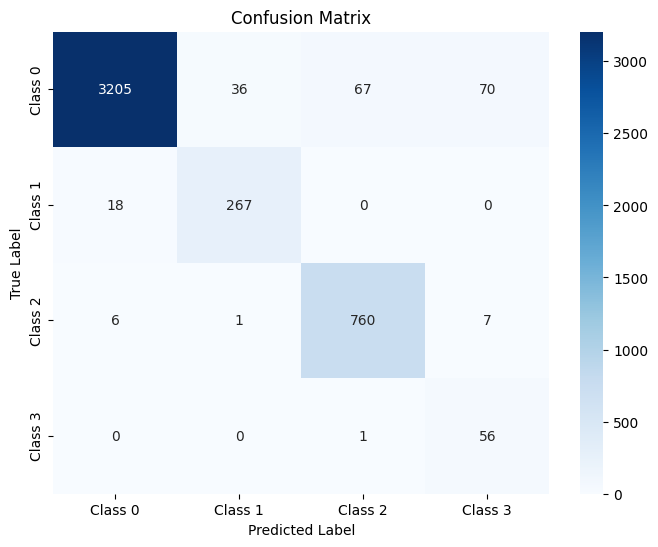

The function took 0.3783 seconds to execute.
[ARCH#134-[32, 32, 32, 4, 2]] done in 35.5s  best-val=0.1403


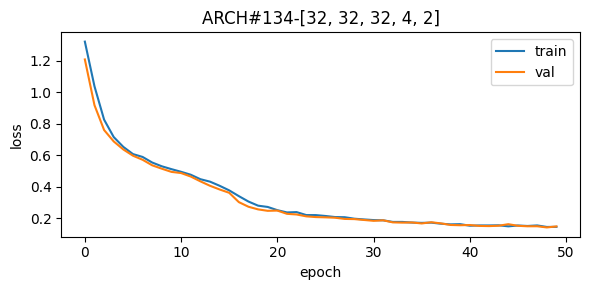


Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.94      0.97     10808
     Class 1       0.89      0.96      0.92       914
     Class 2       0.89      0.99      0.94      2475
     Class 3       0.35      0.99      0.52       182

    accuracy                           0.95     14379
   macro avg       0.78      0.97      0.84     14379
weighted avg       0.96      0.95      0.95     14379



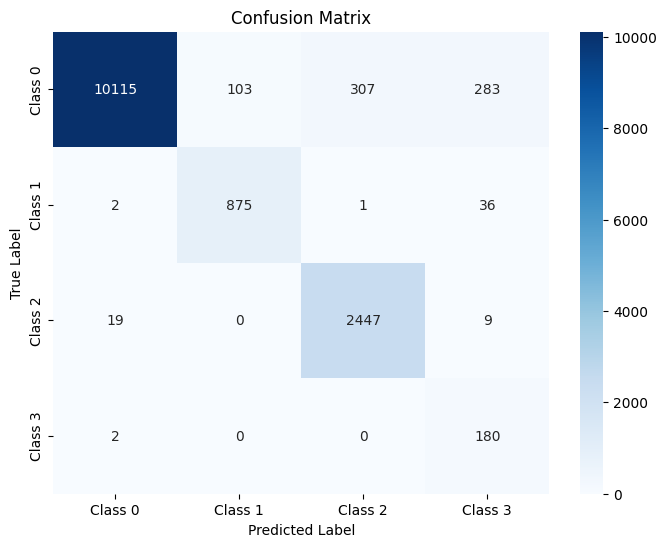

The function took 0.7562 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.94      0.97      2702
     Class 1       0.89      0.94      0.91       228
     Class 2       0.88      0.99      0.93       619
     Class 3       0.38      1.00      0.55        46

    accuracy                           0.95      3595
   macro avg       0.79      0.97      0.84      3595
weighted avg       0.96      0.95      0.95      3595



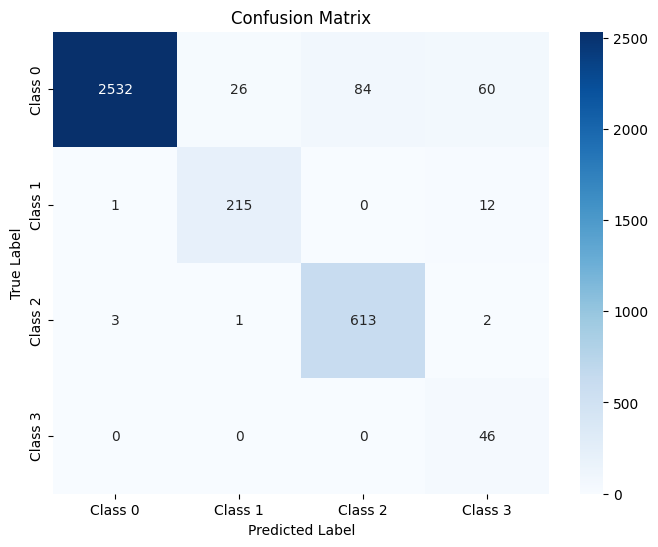

The function took 0.3359 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.94      0.97      3378
     Class 1       0.89      0.94      0.91       285
     Class 2       0.89      0.99      0.94       774
     Class 3       0.34      0.96      0.51        57

    accuracy                           0.95      4494
   macro avg       0.78      0.96      0.83      4494
weighted avg       0.96      0.95      0.95      4494



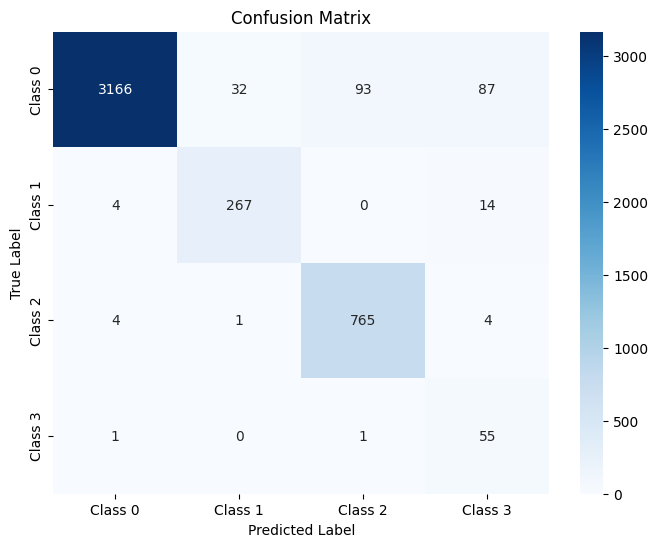

The function took 0.6092 seconds to execute.
[ARCH#135-[32, 32, 32, 2, 2]] early-stop @ epoch 042
[ARCH#135-[32, 32, 32, 2, 2]] done in 30.4s  best-val=1.3794


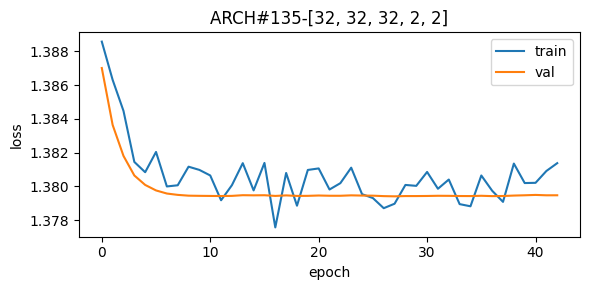


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86     10808
     Class 1       0.00      0.00      0.00       914
     Class 2       0.00      0.00      0.00      2475
     Class 3       0.00      0.00      0.00       182

    accuracy                           0.75     14379
   macro avg       0.19      0.25      0.21     14379
weighted avg       0.56      0.75      0.65     14379



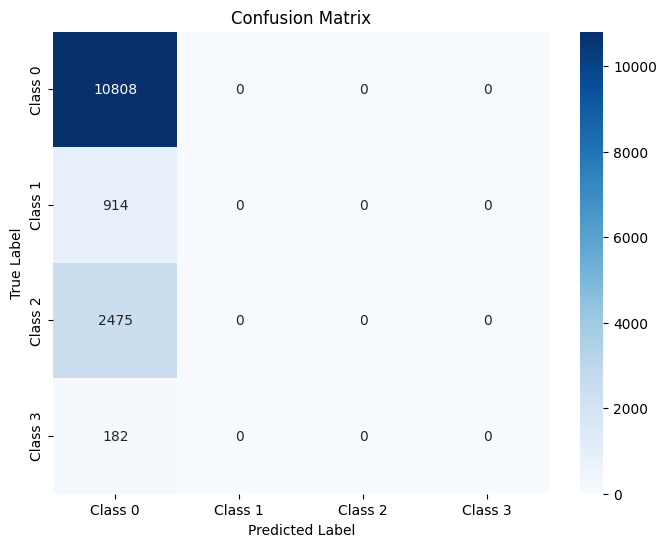

The function took 0.6975 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86      2702
     Class 1       0.00      0.00      0.00       228
     Class 2       0.00      0.00      0.00       619
     Class 3       0.00      0.00      0.00        46

    accuracy                           0.75      3595
   macro avg       0.19      0.25      0.21      3595
weighted avg       0.56      0.75      0.65      3595



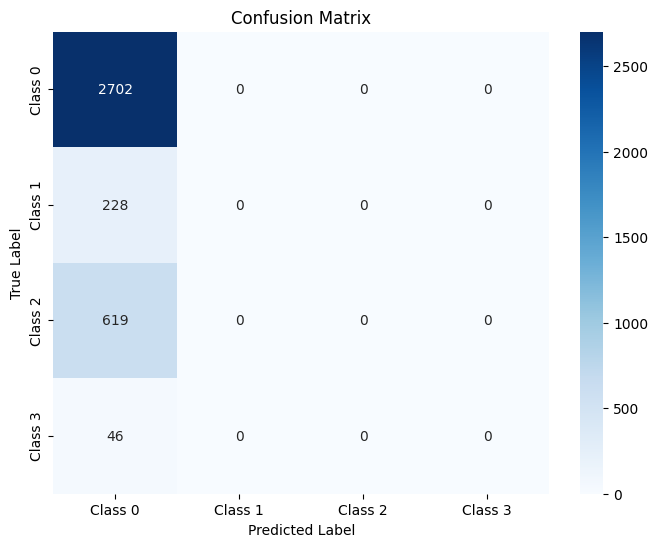

The function took 0.3327 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86      3378
     Class 1       0.00      0.00      0.00       285
     Class 2       0.00      0.00      0.00       774
     Class 3       0.00      0.00      0.00        57

    accuracy                           0.75      4494
   macro avg       0.19      0.25      0.21      4494
weighted avg       0.57      0.75      0.65      4494



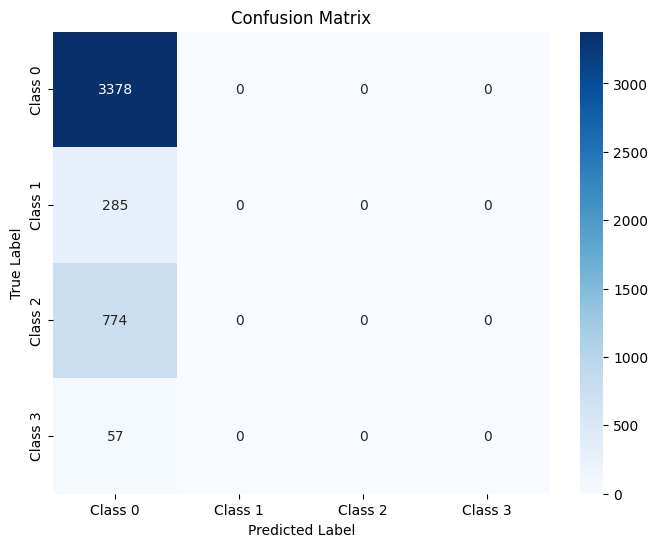

The function took 0.5151 seconds to execute.
[ARCH#136-[32, 32, 16, 16, 16]] done in 35.4s  best-val=0.0747


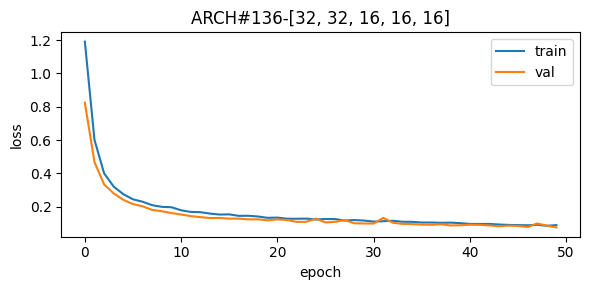


Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.95      0.97     10808
     Class 1       0.83      1.00      0.90       914
     Class 2       0.90      0.99      0.94      2475
     Class 3       0.64      0.94      0.76       182

    accuracy                           0.96     14379
   macro avg       0.84      0.97      0.90     14379
weighted avg       0.97      0.96      0.96     14379



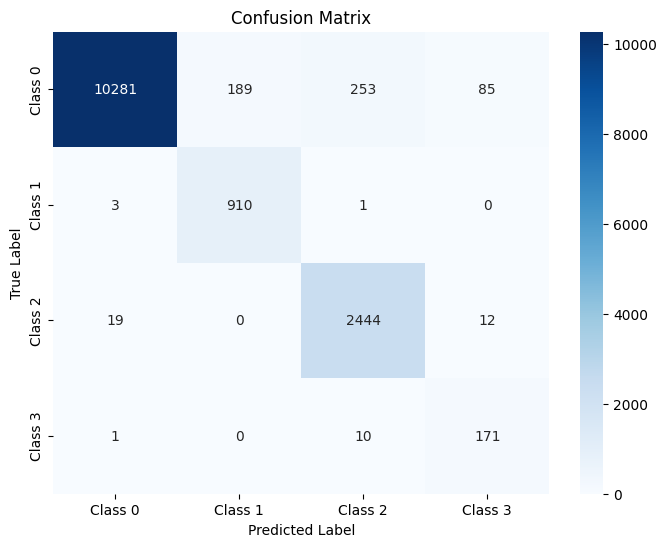

The function took 0.6072 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.95      0.97      2702
     Class 1       0.84      1.00      0.91       228
     Class 2       0.90      0.99      0.94       619
     Class 3       0.67      0.93      0.78        46

    accuracy                           0.96      3595
   macro avg       0.85      0.97      0.90      3595
weighted avg       0.97      0.96      0.96      3595



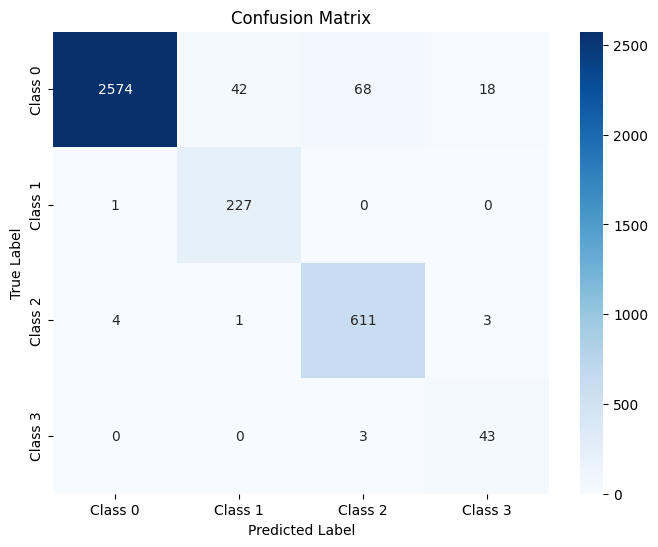

The function took 0.3505 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.96      0.98      3378
     Class 1       0.83      0.99      0.90       285
     Class 2       0.92      0.99      0.95       774
     Class 3       0.62      0.96      0.75        57

    accuracy                           0.96      4494
   macro avg       0.84      0.97      0.90      4494
weighted avg       0.97      0.96      0.97      4494



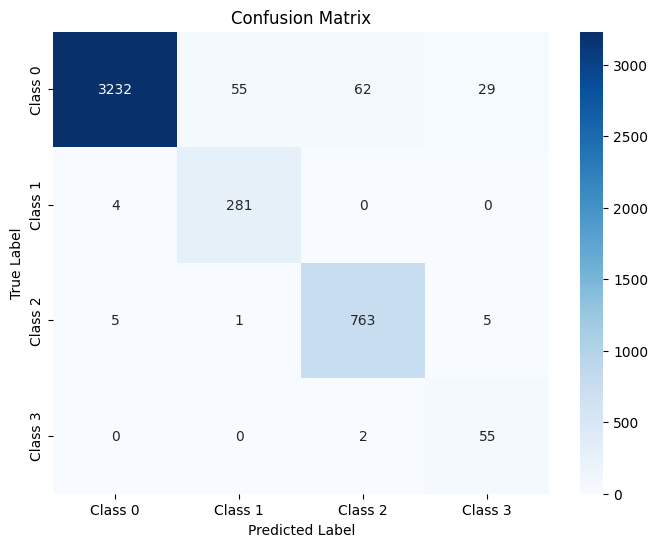

The function took 0.5239 seconds to execute.
[ARCH#137-[32, 32, 16, 16, 8]] done in 35.2s  best-val=0.0737


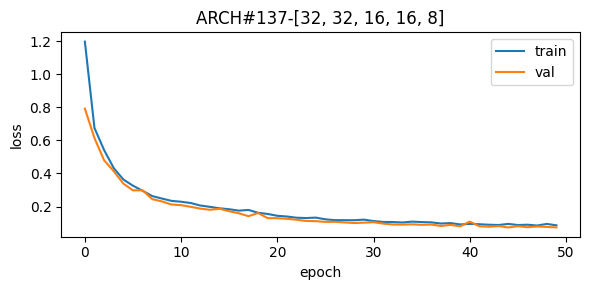


Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.94      0.97     10808
     Class 1       0.80      1.00      0.89       914
     Class 2       0.88      0.99      0.93      2475
     Class 3       0.70      0.99      0.82       182

    accuracy                           0.95     14379
   macro avg       0.84      0.98      0.90     14379
weighted avg       0.96      0.95      0.96     14379



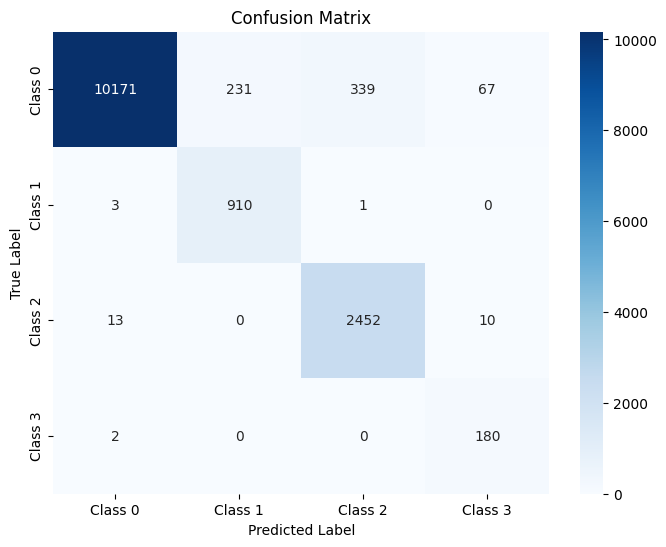

The function took 0.6362 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.94      0.97      2702
     Class 1       0.81      0.99      0.89       228
     Class 2       0.87      0.99      0.92       619
     Class 3       0.69      1.00      0.81        46

    accuracy                           0.95      3595
   macro avg       0.84      0.98      0.90      3595
weighted avg       0.96      0.95      0.95      3595



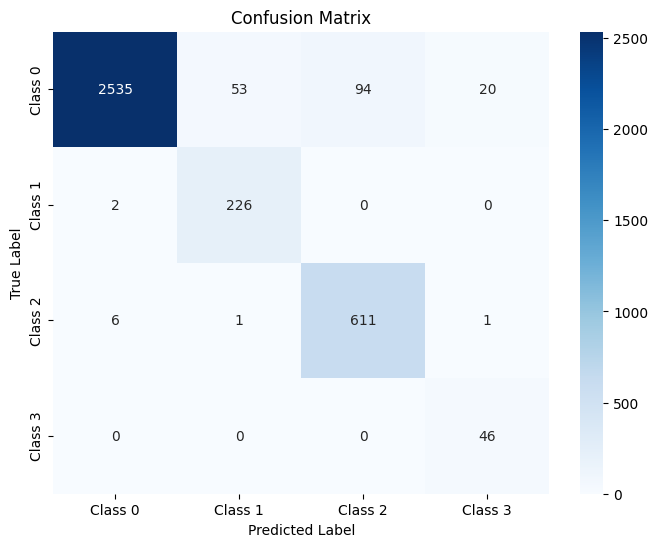

The function took 0.4699 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.94      0.97      3378
     Class 1       0.80      0.99      0.89       285
     Class 2       0.88      0.99      0.93       774
     Class 3       0.66      0.96      0.79        57

    accuracy                           0.95      4494
   macro avg       0.84      0.97      0.89      4494
weighted avg       0.96      0.95      0.96      4494



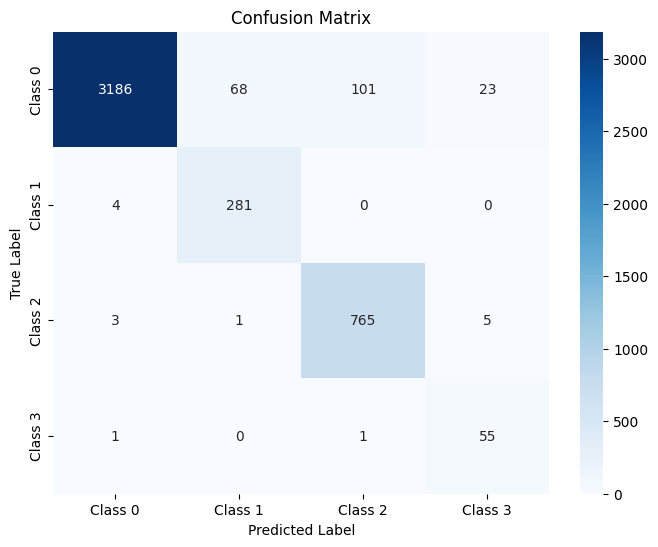

The function took 0.3961 seconds to execute.
[ARCH#138-[32, 32, 16, 16, 4]] done in 35.0s  best-val=0.0640


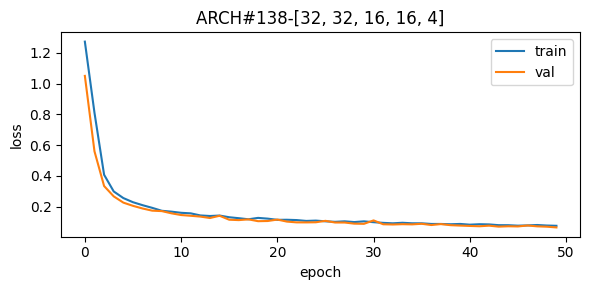


Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.95      0.97     10808
     Class 1       0.77      1.00      0.87       914
     Class 2       0.92      0.99      0.95      2475
     Class 3       0.69      0.99      0.81       182

    accuracy                           0.96     14379
   macro avg       0.84      0.98      0.90     14379
weighted avg       0.97      0.96      0.96     14379



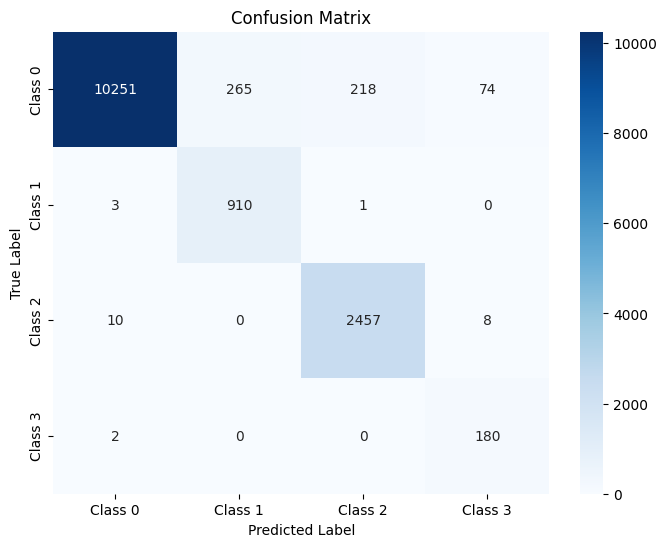

The function took 0.6344 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.95      0.97      2702
     Class 1       0.80      1.00      0.89       228
     Class 2       0.91      0.99      0.95       619
     Class 3       0.69      1.00      0.81        46

    accuracy                           0.96      3595
   macro avg       0.85      0.98      0.91      3595
weighted avg       0.97      0.96      0.96      3595



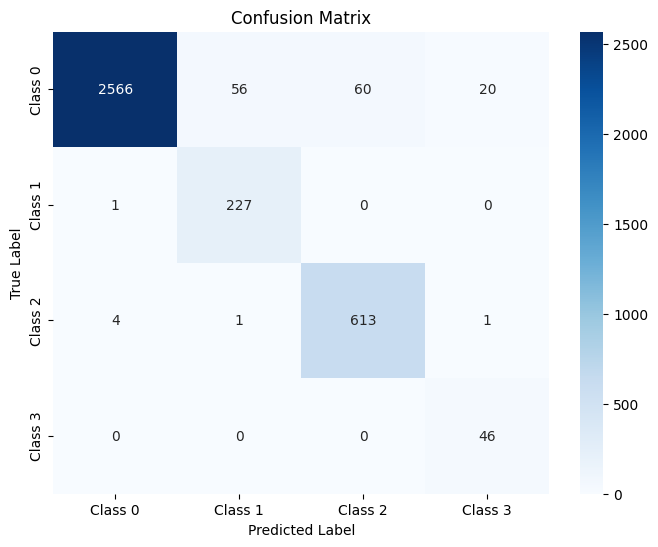

The function took 0.3692 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.95      0.97      3378
     Class 1       0.78      0.99      0.87       285
     Class 2       0.93      0.99      0.96       774
     Class 3       0.65      0.96      0.77        57

    accuracy                           0.96      4494
   macro avg       0.84      0.97      0.89      4494
weighted avg       0.97      0.96      0.96      4494



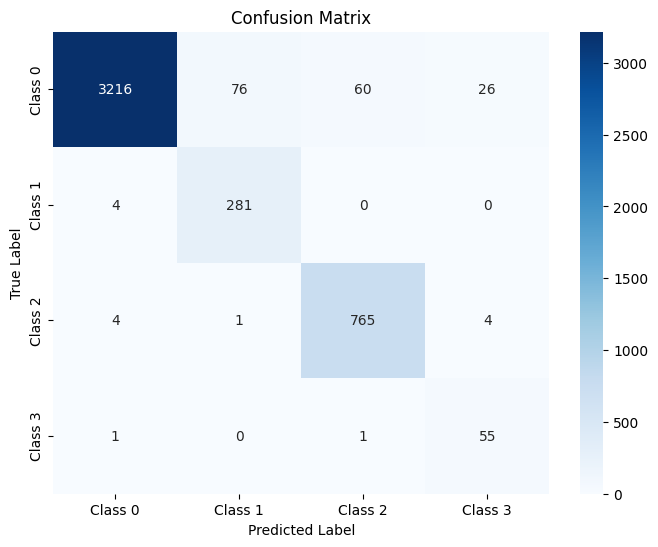

The function took 0.3904 seconds to execute.
[ARCH#139-[32, 32, 16, 16, 2]] done in 35.0s  best-val=1.3794


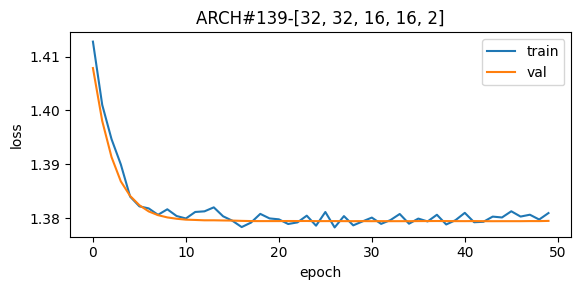


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86     10808
     Class 1       0.00      0.00      0.00       914
     Class 2       0.00      0.00      0.00      2475
     Class 3       0.00      0.00      0.00       182

    accuracy                           0.75     14379
   macro avg       0.19      0.25      0.21     14379
weighted avg       0.56      0.75      0.65     14379



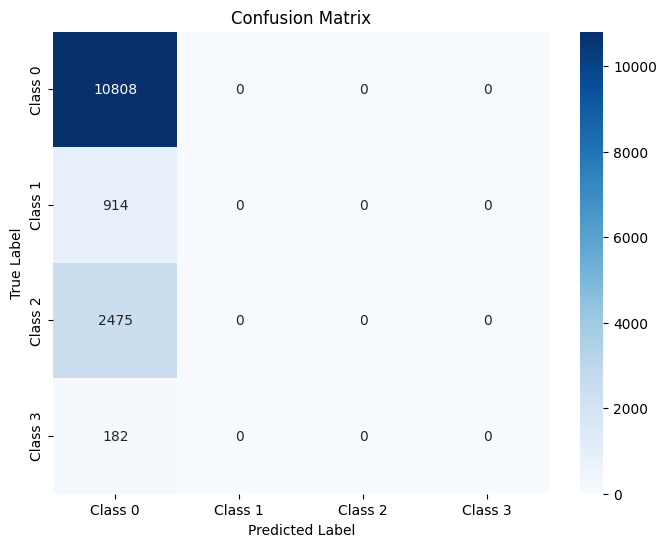

The function took 0.7174 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86      2702
     Class 1       0.00      0.00      0.00       228
     Class 2       0.00      0.00      0.00       619
     Class 3       0.00      0.00      0.00        46

    accuracy                           0.75      3595
   macro avg       0.19      0.25      0.21      3595
weighted avg       0.56      0.75      0.65      3595



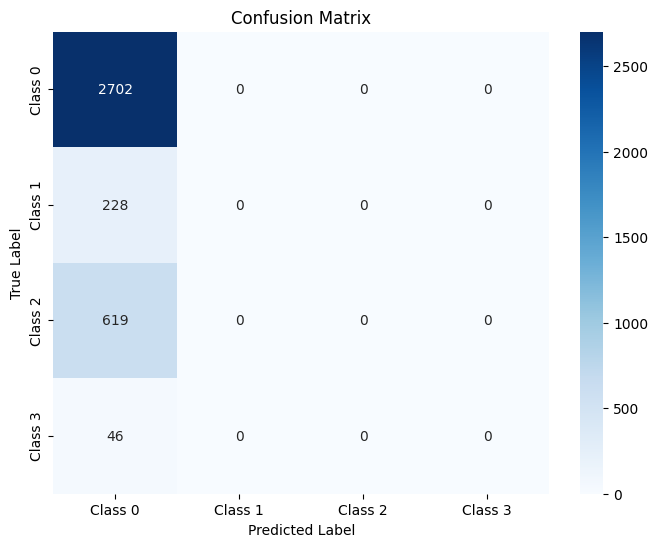

The function took 0.3685 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86      3378
     Class 1       0.00      0.00      0.00       285
     Class 2       0.00      0.00      0.00       774
     Class 3       0.00      0.00      0.00        57

    accuracy                           0.75      4494
   macro avg       0.19      0.25      0.21      4494
weighted avg       0.57      0.75      0.65      4494



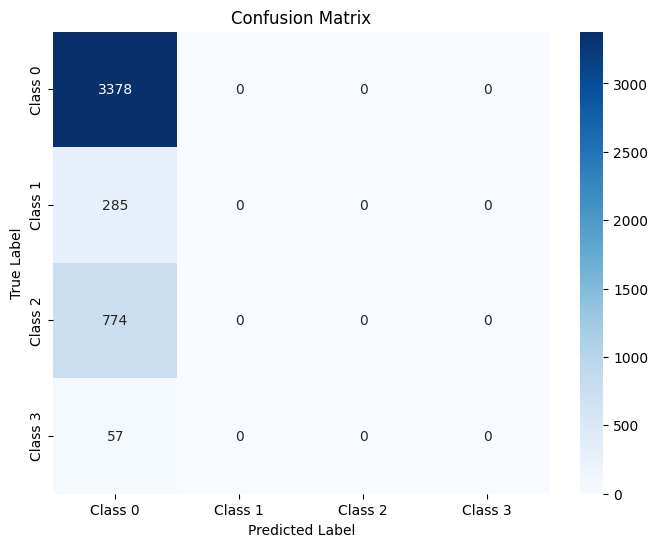

The function took 0.5140 seconds to execute.
[ARCH#140-[32, 32, 16, 8, 8]] done in 35.1s  best-val=0.0632


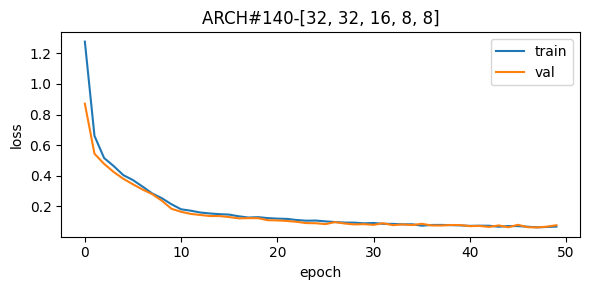


Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.96      0.98     10808
     Class 1       0.83      1.00      0.90       914
     Class 2       0.91      0.99      0.95      2475
     Class 3       0.82      0.99      0.90       182

    accuracy                           0.97     14379
   macro avg       0.89      0.98      0.93     14379
weighted avg       0.97      0.97      0.97     14379



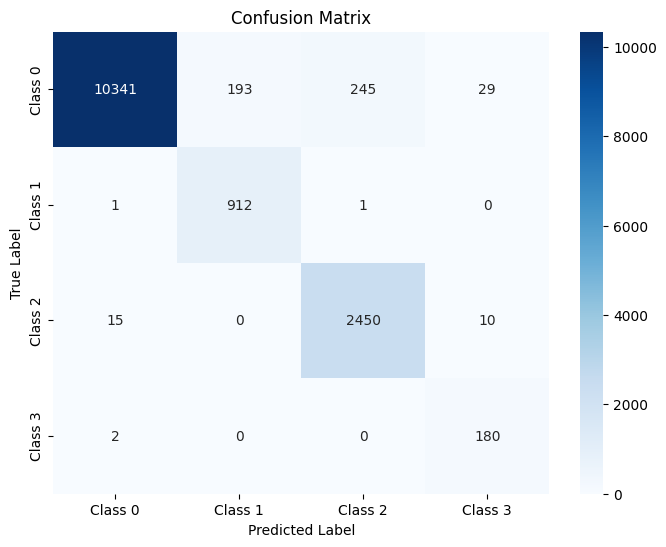

The function took 0.6832 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.95      0.97      2702
     Class 1       0.82      0.99      0.90       228
     Class 2       0.90      0.99      0.94       619
     Class 3       0.79      1.00      0.88        46

    accuracy                           0.96      3595
   macro avg       0.88      0.98      0.92      3595
weighted avg       0.97      0.96      0.96      3595



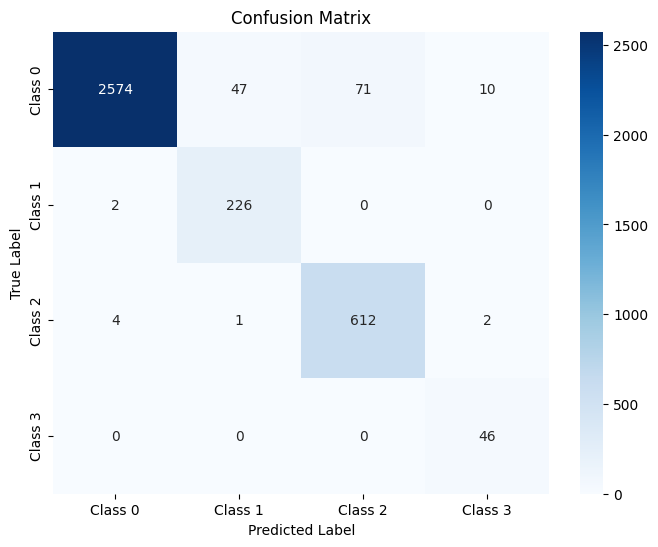

The function took 0.3375 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.96      0.98      3378
     Class 1       0.83      0.99      0.90       285
     Class 2       0.92      0.99      0.95       774
     Class 3       0.78      0.95      0.86        57

    accuracy                           0.97      4494
   macro avg       0.88      0.97      0.92      4494
weighted avg       0.97      0.97      0.97      4494



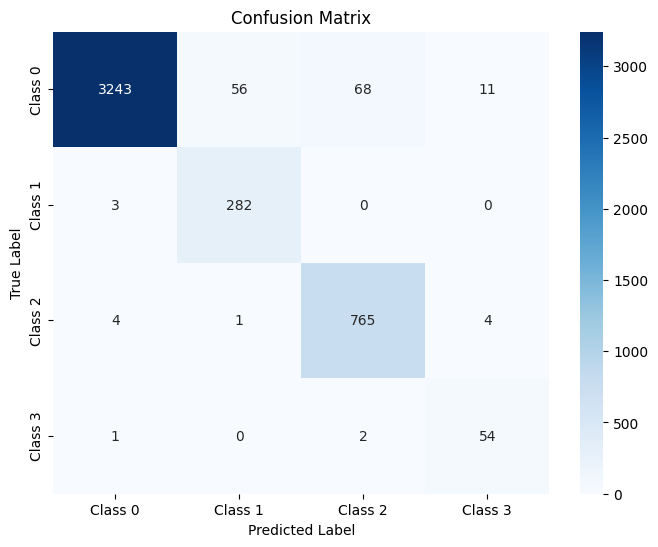

The function took 0.4595 seconds to execute.
[ARCH#141-[32, 32, 16, 8, 4]] done in 35.7s  best-val=0.9466


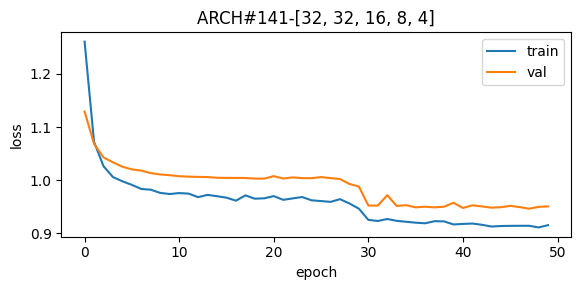


Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.08      0.14     10808
     Class 1       0.83      0.90      0.86       914
     Class 2       0.20      1.00      0.33      2475
     Class 3       0.00      0.00      0.00       182

    accuracy                           0.29     14379
   macro avg       0.50      0.49      0.33     14379
weighted avg       0.83      0.29      0.22     14379



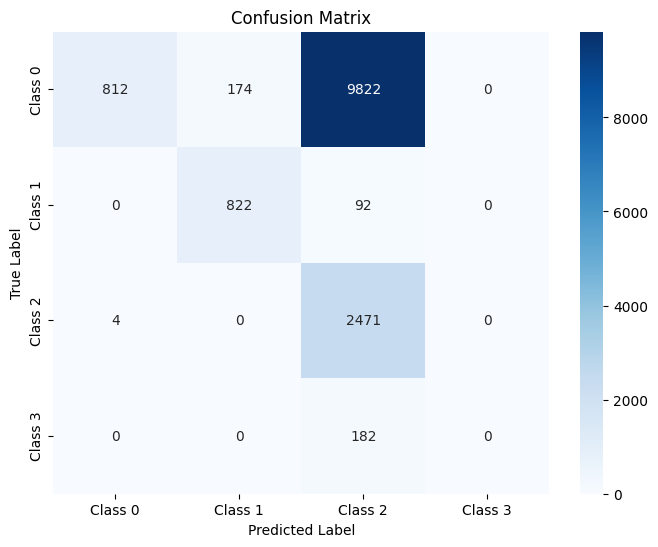

The function took 0.6956 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.07      0.13      2702
     Class 1       0.83      0.87      0.85       228
     Class 2       0.19      1.00      0.33       619
     Class 3       0.00      0.00      0.00        46

    accuracy                           0.28      3595
   macro avg       0.50      0.48      0.33      3595
weighted avg       0.83      0.28      0.21      3595



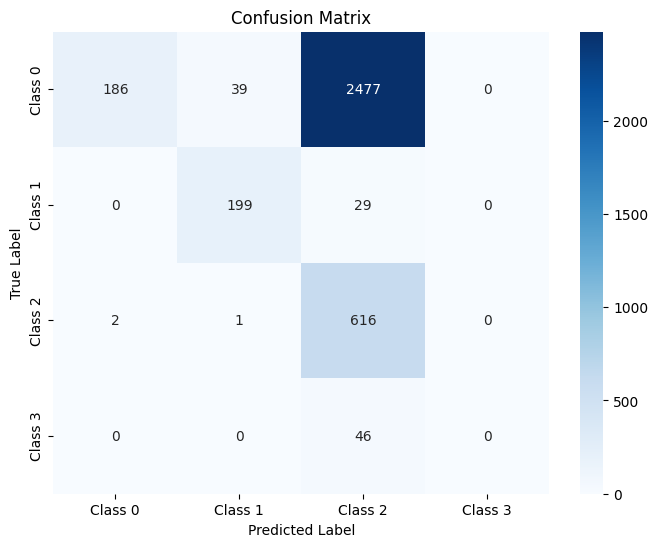

The function took 0.3370 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.08      0.15      3378
     Class 1       0.83      0.89      0.86       285
     Class 2       0.20      1.00      0.33       774
     Class 3       0.00      0.00      0.00        57

    accuracy                           0.29      4494
   macro avg       0.51      0.49      0.33      4494
weighted avg       0.84      0.29      0.22      4494



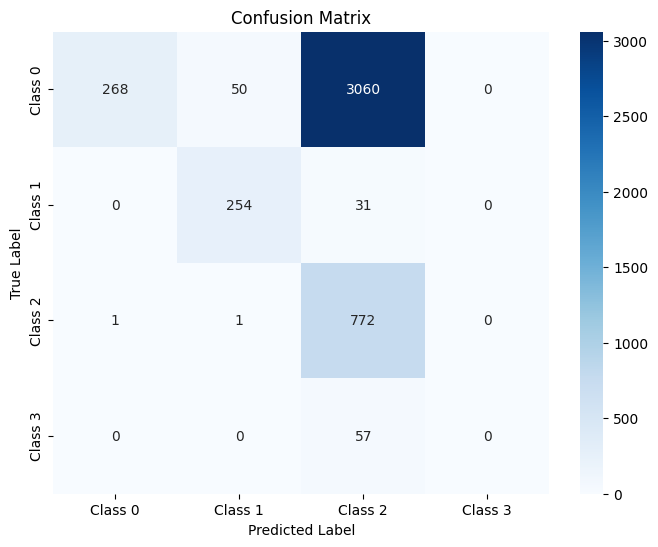

The function took 0.4232 seconds to execute.
[ARCH#142-[32, 32, 16, 8, 2]] done in 36.1s  best-val=0.1477


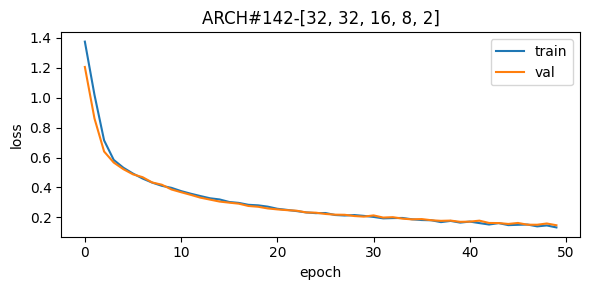


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.96      0.98     10808
     Class 1       0.88      0.86      0.87       914
     Class 2       0.91      0.99      0.95      2475
     Class 3       0.87      0.99      0.92       182

    accuracy                           0.96     14379
   macro avg       0.91      0.95      0.93     14379
weighted avg       0.96      0.96      0.96     14379



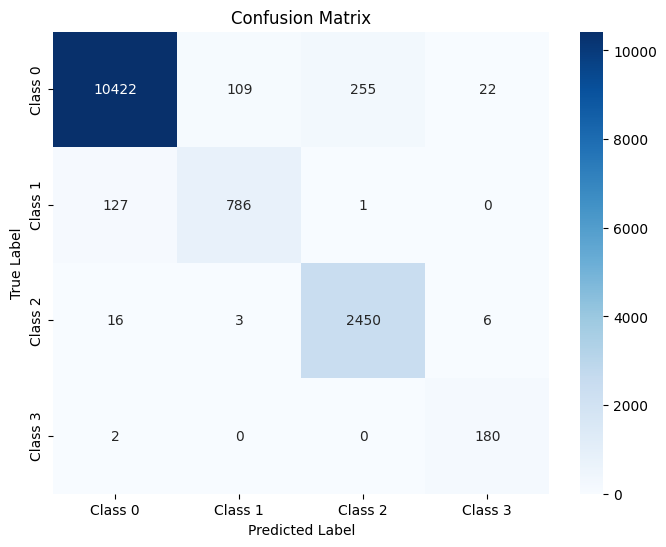

The function took 0.6929 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.96      0.97      2702
     Class 1       0.85      0.82      0.84       228
     Class 2       0.89      0.99      0.94       619
     Class 3       0.84      1.00      0.91        46

    accuracy                           0.96      3595
   macro avg       0.89      0.94      0.91      3595
weighted avg       0.96      0.96      0.96      3595



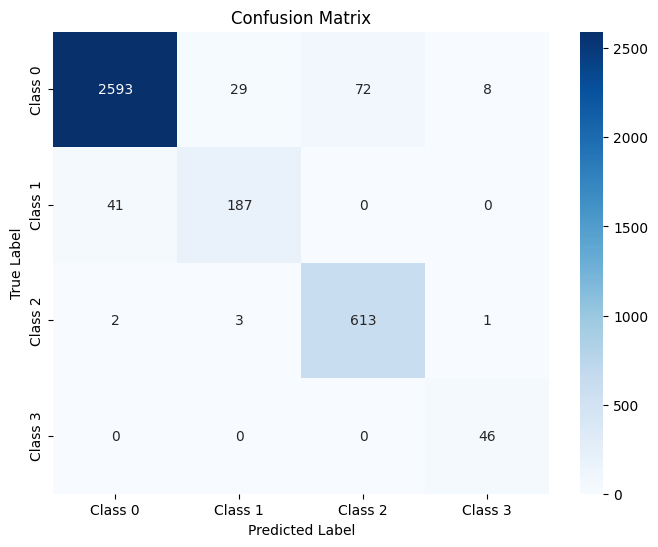

The function took 0.3912 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.97      0.98      3378
     Class 1       0.88      0.84      0.86       285
     Class 2       0.91      0.99      0.95       774
     Class 3       0.88      0.91      0.90        57

    accuracy                           0.96      4494
   macro avg       0.91      0.93      0.92      4494
weighted avg       0.96      0.96      0.96      4494



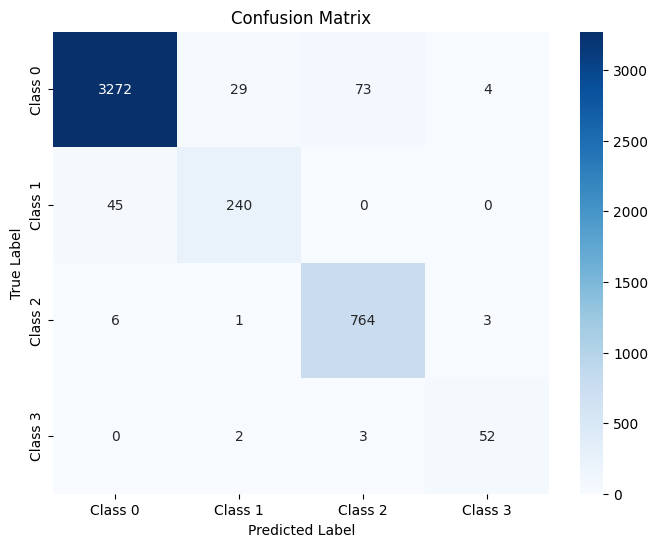

The function took 0.4651 seconds to execute.
[ARCH#143-[32, 32, 16, 4, 4]] done in 35.2s  best-val=0.0747


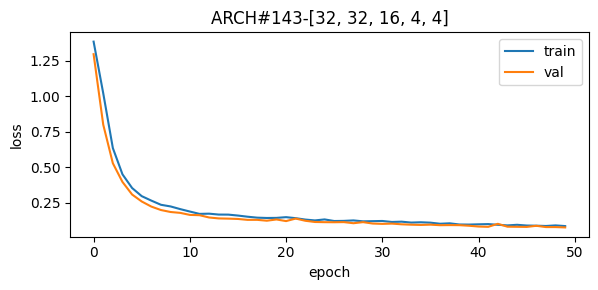


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.96      0.97     10808
     Class 1       0.82      1.00      0.90       914
     Class 2       0.91      0.98      0.94      2475
     Class 3       0.85      0.99      0.91       182

    accuracy                           0.96     14379
   macro avg       0.89      0.98      0.93     14379
weighted avg       0.97      0.96      0.96     14379



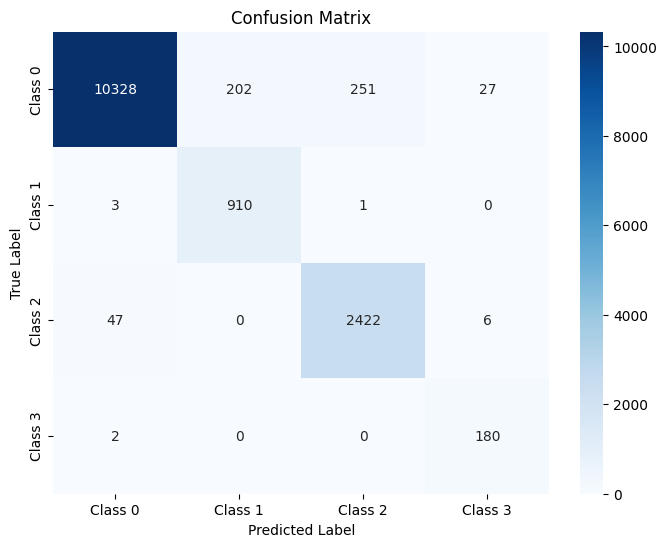

The function took 0.7582 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.95      0.97      2702
     Class 1       0.80      0.99      0.89       228
     Class 2       0.90      0.98      0.94       619
     Class 3       0.81      1.00      0.89        46

    accuracy                           0.96      3595
   macro avg       0.88      0.98      0.92      3595
weighted avg       0.97      0.96      0.96      3595



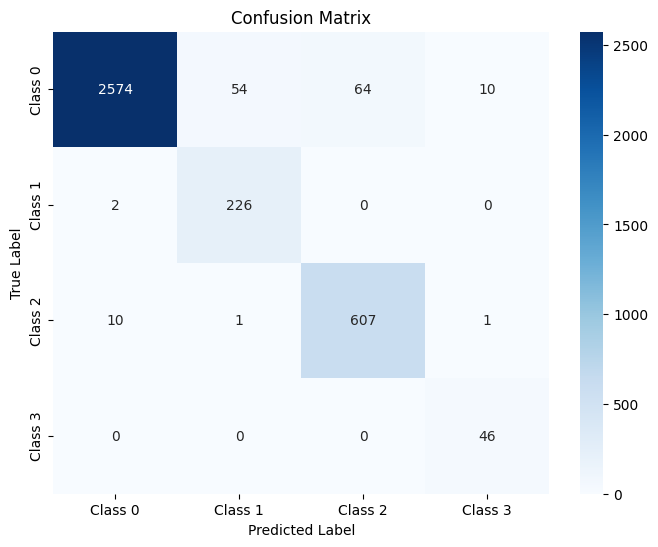

The function took 0.3360 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.96      0.98      3378
     Class 1       0.84      0.99      0.90       285
     Class 2       0.91      0.98      0.94       774
     Class 3       0.86      0.95      0.90        57

    accuracy                           0.97      4494
   macro avg       0.90      0.97      0.93      4494
weighted avg       0.97      0.97      0.97      4494



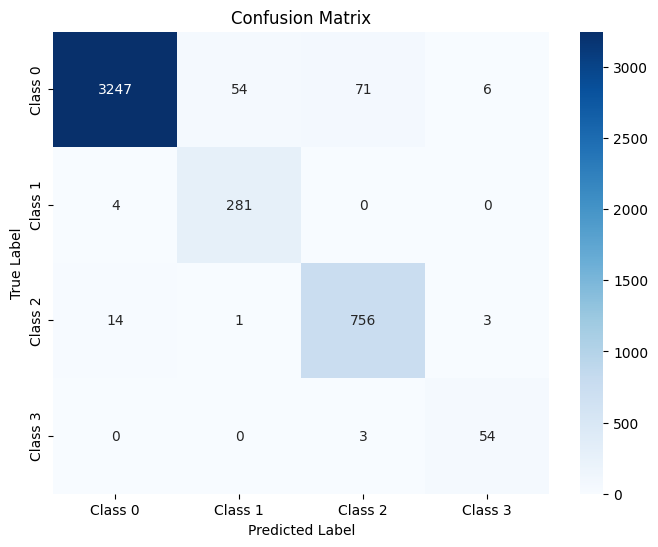

The function took 0.4198 seconds to execute.
[ARCH#144-[32, 32, 16, 4, 2]] done in 35.3s  best-val=0.6202


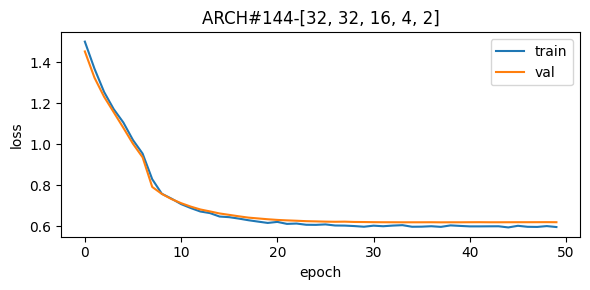


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.94      0.99      0.97     10808
     Class 1       0.92      0.86      0.89       914
     Class 2       1.00      0.86      0.93      2475
     Class 3       0.00      0.00      0.00       182

    accuracy                           0.95     14379
   macro avg       0.72      0.68      0.70     14379
weighted avg       0.94      0.95      0.94     14379



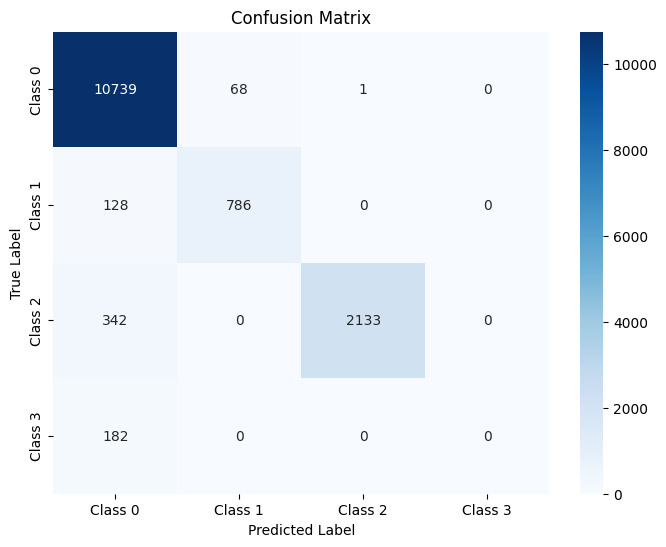

The function took 0.7704 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.94      0.99      0.97      2702
     Class 1       0.91      0.82      0.86       228
     Class 2       1.00      0.88      0.93       619
     Class 3       0.00      0.00      0.00        46

    accuracy                           0.95      3595
   macro avg       0.71      0.67      0.69      3595
weighted avg       0.94      0.95      0.94      3595



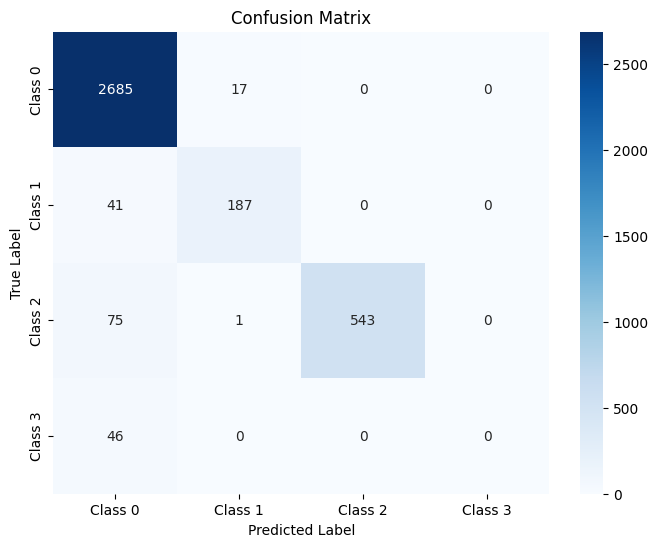

The function took 0.3491 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.94      0.99      0.96      3378
     Class 1       0.92      0.84      0.88       285
     Class 2       1.00      0.84      0.91       774
     Class 3       0.00      0.00      0.00        57

    accuracy                           0.95      4494
   macro avg       0.71      0.67      0.69      4494
weighted avg       0.94      0.95      0.94      4494



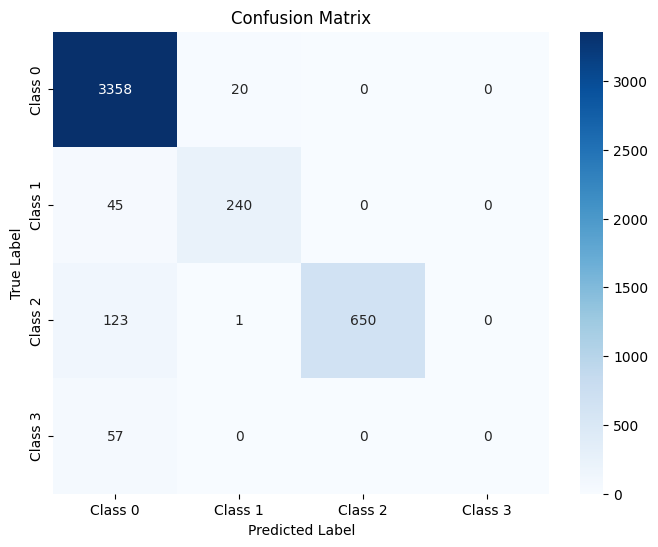

The function took 0.3913 seconds to execute.
[ARCH#145-[32, 32, 16, 2, 2]] done in 35.0s  best-val=0.4544


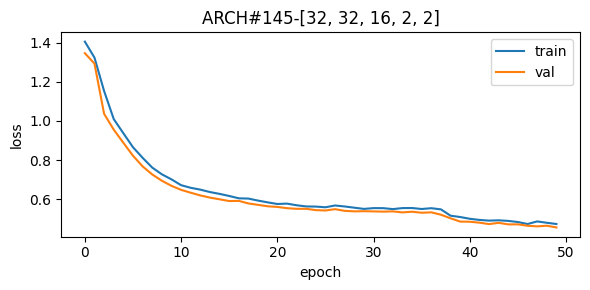


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.97      0.96      0.97     10808
     Class 1       0.67      0.99      0.80       914
     Class 2       1.00      0.86      0.92      2475
     Class 3       0.10      0.10      0.10       182

    accuracy                           0.94     14379
   macro avg       0.69      0.73      0.70     14379
weighted avg       0.95      0.94      0.94     14379



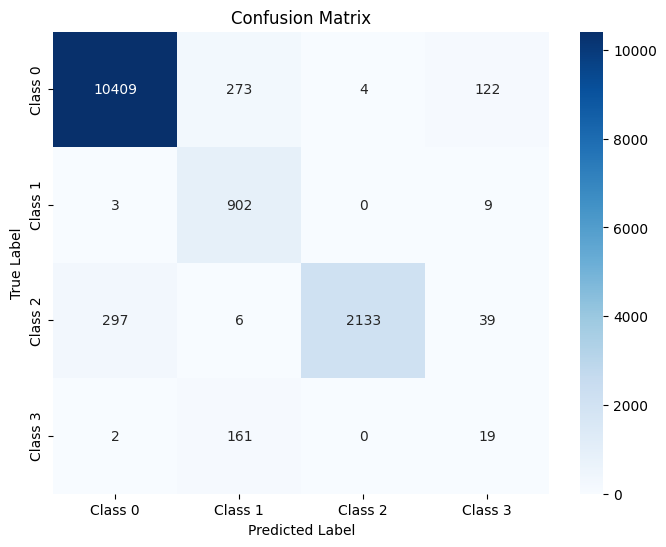

The function took 0.6094 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.96      0.97      2702
     Class 1       0.67      0.98      0.79       228
     Class 2       0.99      0.88      0.93       619
     Class 3       0.13      0.13      0.13        46

    accuracy                           0.94      3595
   macro avg       0.69      0.74      0.71      3595
weighted avg       0.95      0.94      0.94      3595



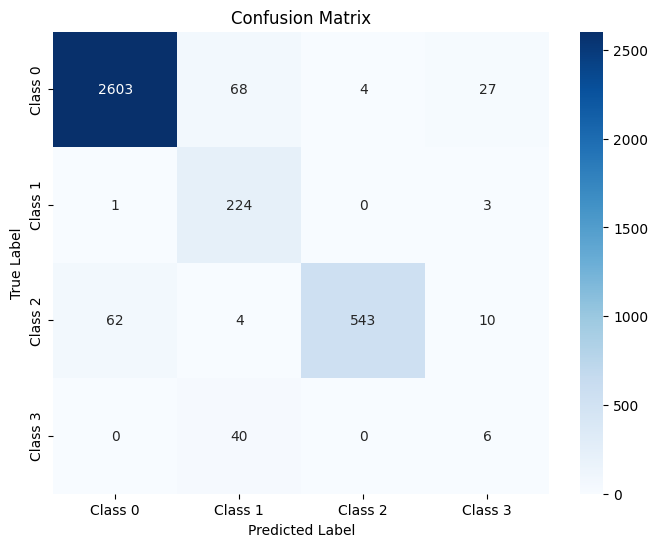

The function took 0.3506 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.97      0.96      0.97      3378
     Class 1       0.67      0.98      0.79       285
     Class 2       0.99      0.84      0.91       774
     Class 3       0.08      0.07      0.07        57

    accuracy                           0.93      4494
   macro avg       0.68      0.71      0.69      4494
weighted avg       0.94      0.93      0.93      4494



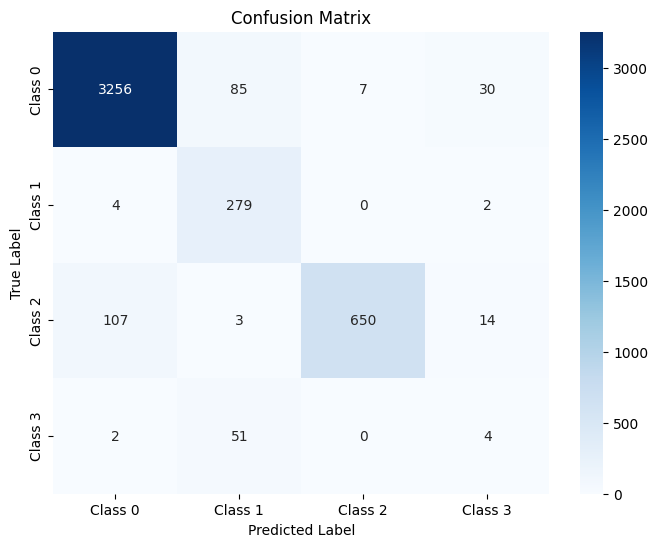

The function took 0.3774 seconds to execute.
[ARCH#146-[32, 32, 8, 8, 8]] done in 35.0s  best-val=0.0723


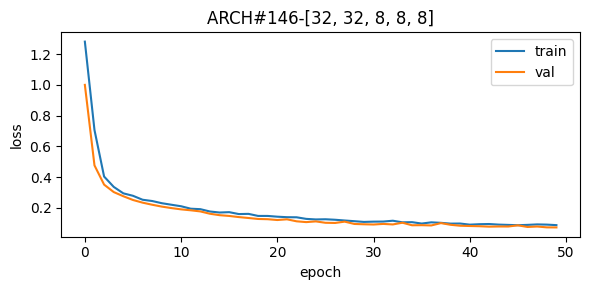


Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.96      0.98     10808
     Class 1       0.82      1.00      0.90       914
     Class 2       0.91      0.98      0.94      2475
     Class 3       0.73      0.99      0.84       182

    accuracy                           0.96     14379
   macro avg       0.86      0.98      0.92     14379
weighted avg       0.97      0.96      0.96     14379



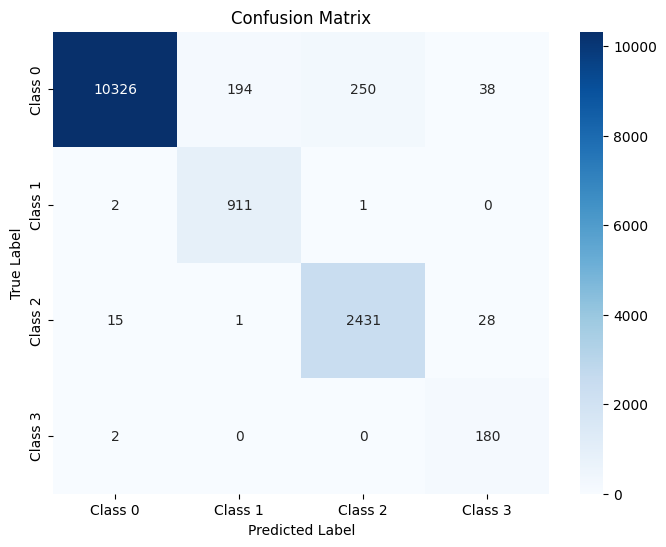

The function took 0.7373 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.96      0.98      2702
     Class 1       0.83      1.00      0.91       228
     Class 2       0.91      0.98      0.94       619
     Class 3       0.71      1.00      0.83        46

    accuracy                           0.96      3595
   macro avg       0.86      0.98      0.91      3595
weighted avg       0.97      0.96      0.96      3595



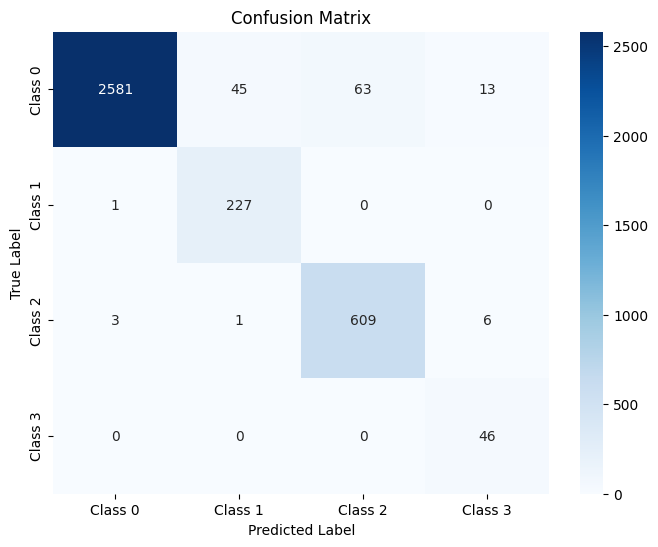

The function took 0.3614 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.96      0.98      3378
     Class 1       0.83      0.99      0.90       285
     Class 2       0.91      0.98      0.95       774
     Class 3       0.71      0.96      0.82        57

    accuracy                           0.96      4494
   macro avg       0.86      0.97      0.91      4494
weighted avg       0.97      0.96      0.96      4494



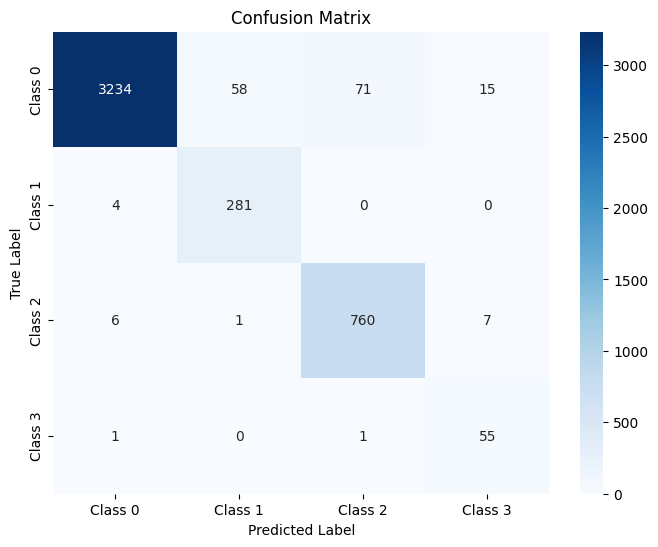

The function took 0.7135 seconds to execute.
[ARCH#147-[32, 32, 8, 8, 4]] done in 35.4s  best-val=0.1443


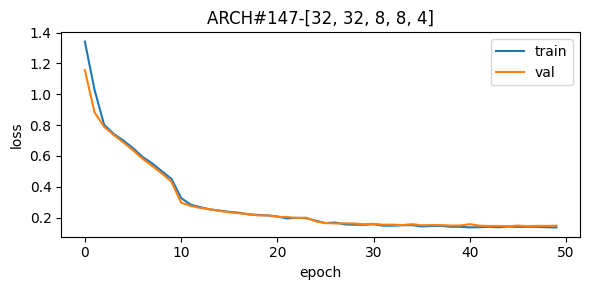


Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.93      0.96     10808
     Class 1       0.89      0.96      0.92       914
     Class 2       0.83      1.00      0.91      2475
     Class 3       0.44      0.93      0.60       182

    accuracy                           0.94     14379
   macro avg       0.79      0.95      0.85     14379
weighted avg       0.96      0.94      0.95     14379



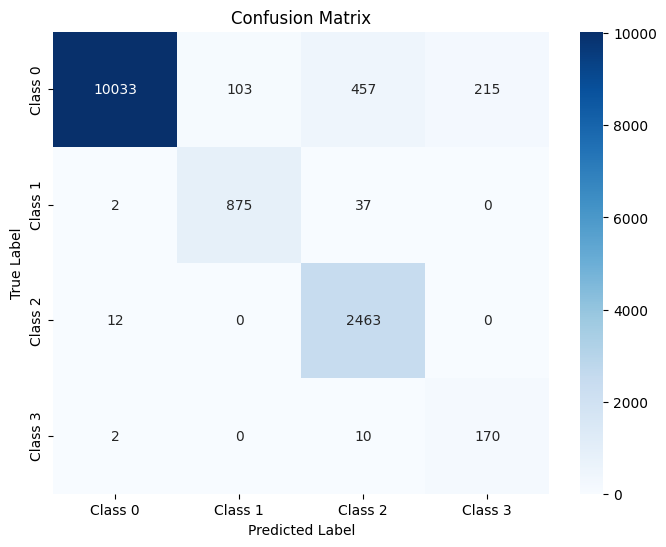

The function took 0.6796 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.93      0.96      2702
     Class 1       0.87      0.94      0.90       228
     Class 2       0.84      0.99      0.91       619
     Class 3       0.44      0.93      0.60        46

    accuracy                           0.94      3595
   macro avg       0.79      0.95      0.84      3595
weighted avg       0.96      0.94      0.94      3595



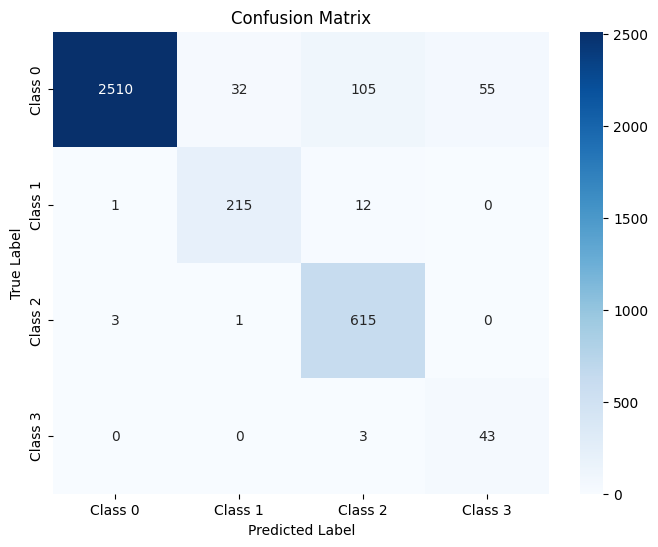

The function took 0.4625 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.93      0.96      3378
     Class 1       0.88      0.94      0.91       285
     Class 2       0.84      0.99      0.91       774
     Class 3       0.44      0.95      0.60        57

    accuracy                           0.94      4494
   macro avg       0.79      0.95      0.85      4494
weighted avg       0.96      0.94      0.95      4494



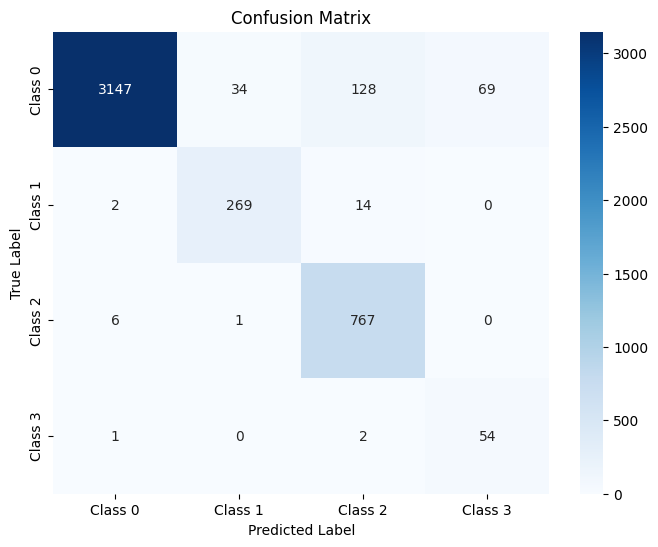

The function took 0.4181 seconds to execute.
[ARCH#148-[32, 32, 8, 8, 2]] done in 35.6s  best-val=0.0998


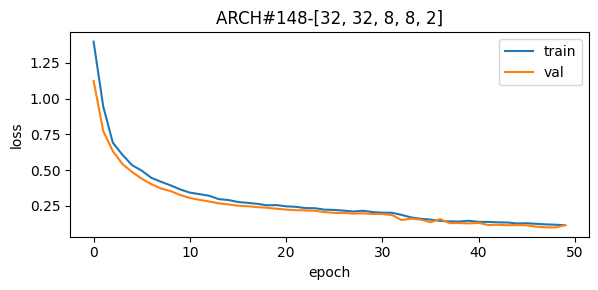


Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.93      0.96     10808
     Class 1       0.75      1.00      0.85       914
     Class 2       0.89      0.98      0.94      2475
     Class 3       0.53      0.99      0.69       182

    accuracy                           0.95     14379
   macro avg       0.79      0.98      0.86     14379
weighted avg       0.96      0.95      0.95     14379



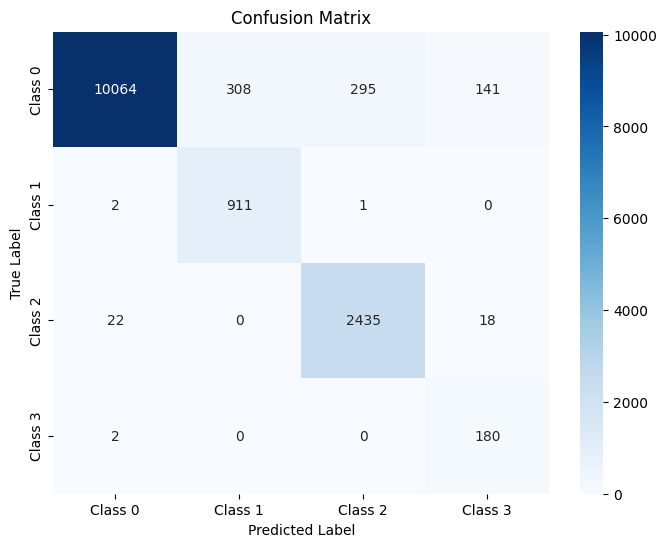

The function took 0.7325 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.93      0.96      2702
     Class 1       0.75      1.00      0.86       228
     Class 2       0.89      0.98      0.93       619
     Class 3       0.57      1.00      0.73        46

    accuracy                           0.95      3595
   macro avg       0.80      0.98      0.87      3595
weighted avg       0.96      0.95      0.95      3595



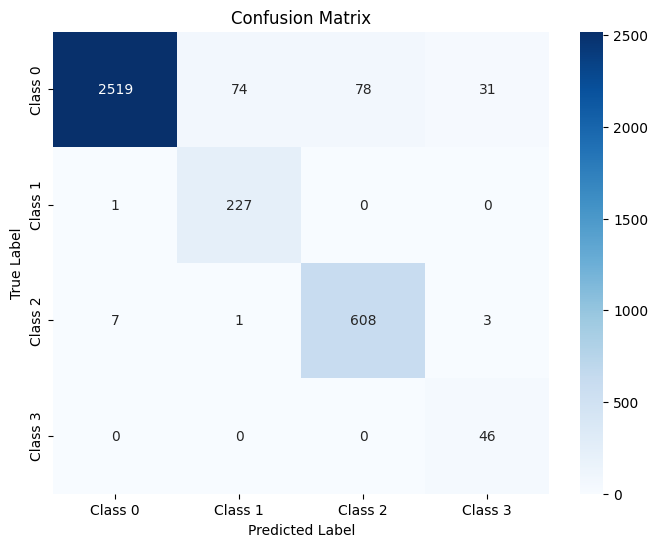

The function took 0.3465 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.93      0.96      3378
     Class 1       0.75      0.99      0.85       285
     Class 2       0.90      0.98      0.94       774
     Class 3       0.50      0.96      0.66        57

    accuracy                           0.95      4494
   macro avg       0.79      0.97      0.85      4494
weighted avg       0.96      0.95      0.95      4494



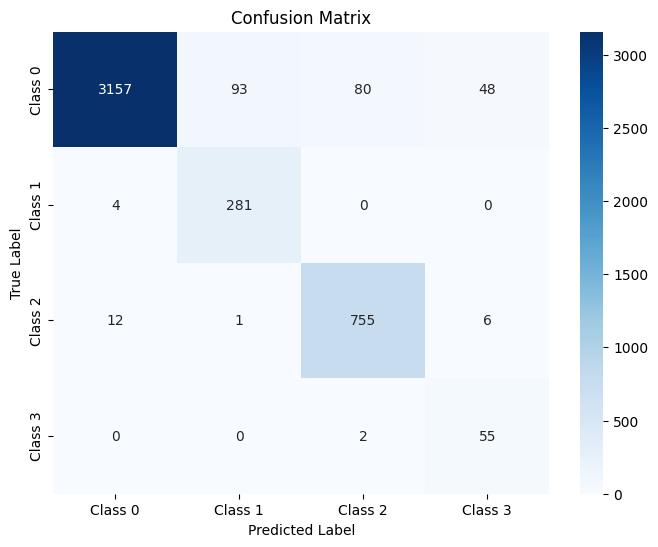

The function took 0.6625 seconds to execute.
[ARCH#149-[32, 32, 8, 4, 4]] done in 35.2s  best-val=0.0613


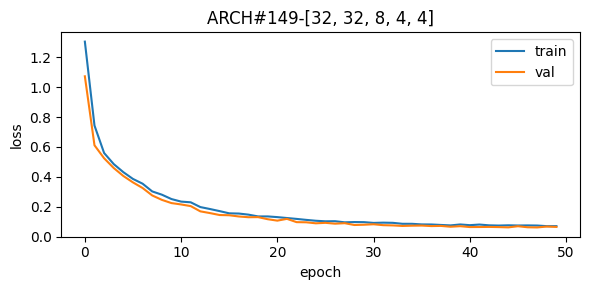


Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.95      0.98     10808
     Class 1       0.80      1.00      0.88       914
     Class 2       0.92      0.99      0.95      2475
     Class 3       0.76      0.99      0.86       182

    accuracy                           0.96     14379
   macro avg       0.87      0.98      0.92     14379
weighted avg       0.97      0.96      0.96     14379



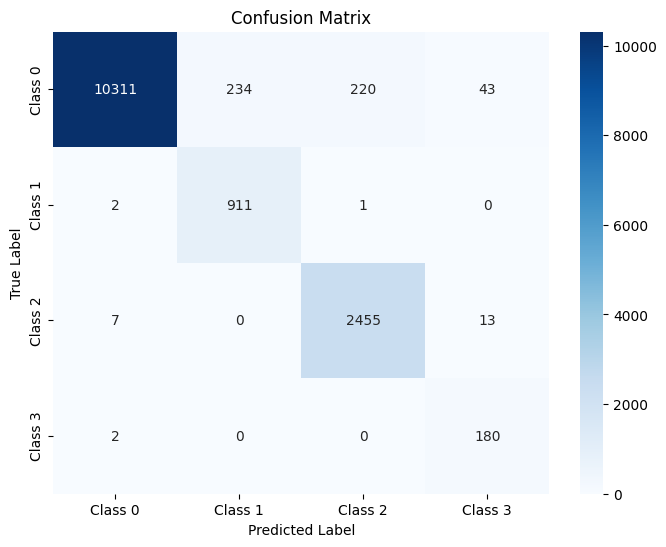

The function took 0.7305 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.95      0.97      2702
     Class 1       0.80      0.99      0.88       228
     Class 2       0.91      1.00      0.95       619
     Class 3       0.78      1.00      0.88        46

    accuracy                           0.96      3595
   macro avg       0.87      0.98      0.92      3595
weighted avg       0.97      0.96      0.96      3595



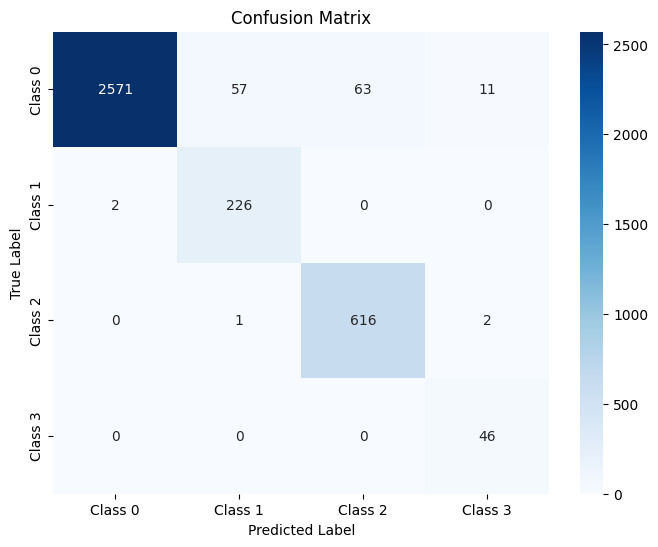

The function took 0.3534 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.96      0.98      3378
     Class 1       0.80      0.99      0.88       285
     Class 2       0.92      0.99      0.95       774
     Class 3       0.72      0.96      0.83        57

    accuracy                           0.96      4494
   macro avg       0.86      0.97      0.91      4494
weighted avg       0.97      0.96      0.96      4494



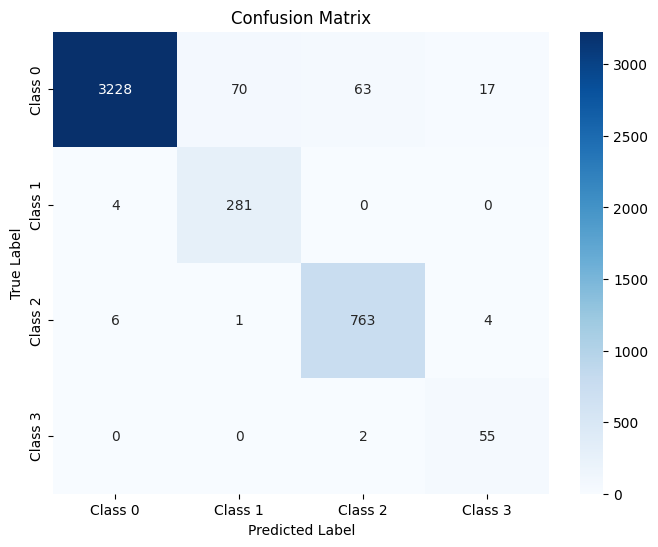

The function took 0.5102 seconds to execute.
[ARCH#150-[32, 32, 8, 4, 2]] done in 35.4s  best-val=0.3391


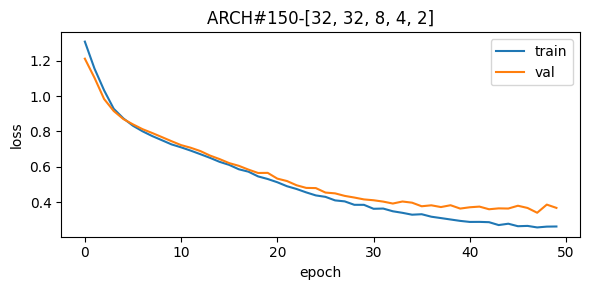


Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.90      0.95     10808
     Class 1       0.80      0.96      0.87       914
     Class 2       0.94      0.95      0.95      2475
     Class 3       0.17      0.98      0.29       182

    accuracy                           0.92     14379
   macro avg       0.73      0.95      0.77     14379
weighted avg       0.97      0.92      0.94     14379



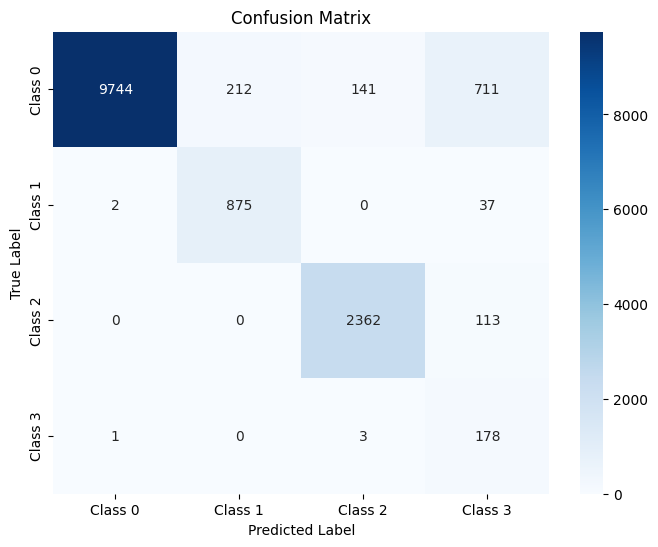

The function took 0.6157 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.91      0.95      2702
     Class 1       0.78      0.94      0.85       228
     Class 2       0.95      0.96      0.95       619
     Class 3       0.19      0.98      0.32        46

    accuracy                           0.92      3595
   macro avg       0.73      0.95      0.77      3595
weighted avg       0.97      0.92      0.94      3595



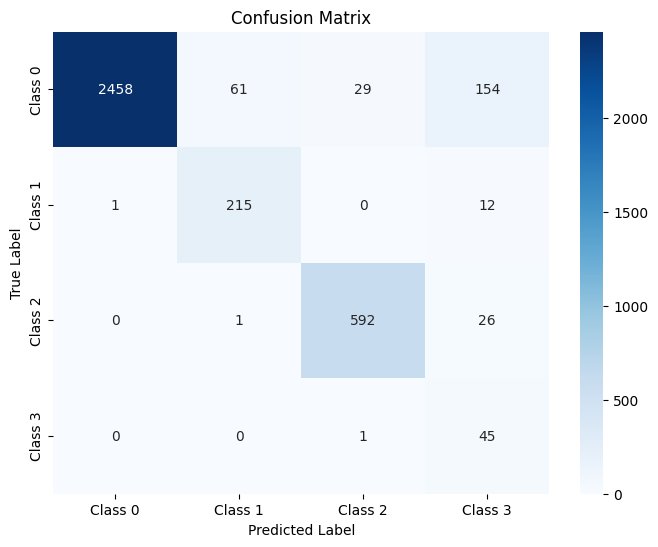

The function took 0.4880 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.90      0.95      3378
     Class 1       0.77      0.94      0.84       285
     Class 2       0.93      0.95      0.94       774
     Class 3       0.18      0.96      0.30        57

    accuracy                           0.91      4494
   macro avg       0.72      0.94      0.76      4494
weighted avg       0.96      0.91      0.93      4494



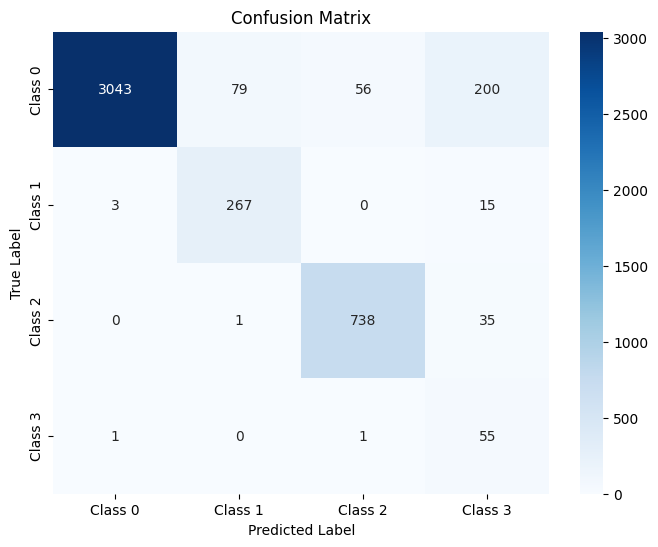

The function took 0.3783 seconds to execute.
[ARCH#151-[32, 32, 8, 2, 2]] done in 35.2s  best-val=0.4092


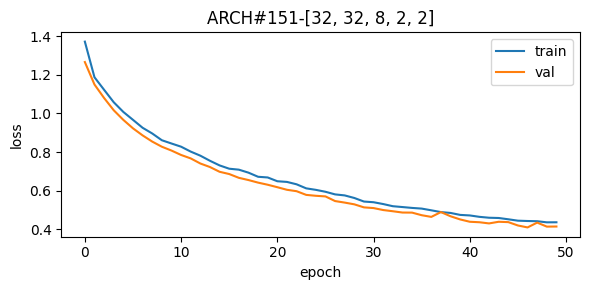


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.97      0.96      0.97     10808
     Class 1       0.77      1.00      0.87       914
     Class 2       0.97      0.86      0.92      2475
     Class 3       0.38      0.52      0.44       182

    accuracy                           0.94     14379
   macro avg       0.77      0.84      0.80     14379
weighted avg       0.95      0.94      0.94     14379



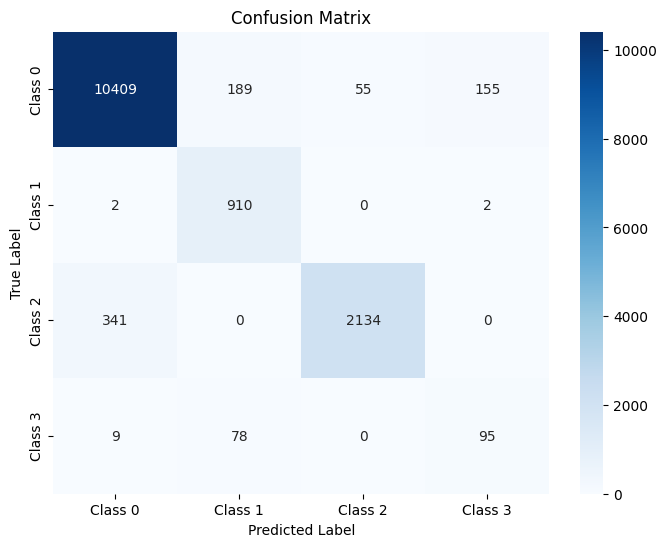

The function took 0.7710 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.97      0.97      0.97      2702
     Class 1       0.79      0.99      0.88       228
     Class 2       0.98      0.88      0.93       619
     Class 3       0.40      0.59      0.47        46

    accuracy                           0.95      3595
   macro avg       0.78      0.86      0.81      3595
weighted avg       0.95      0.95      0.95      3595



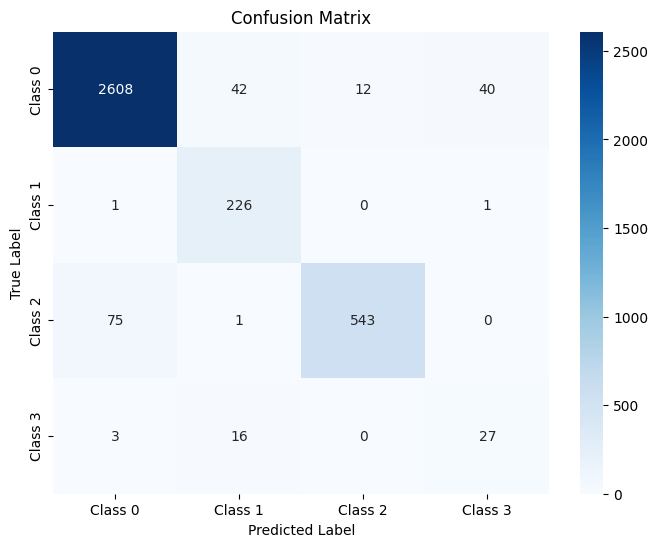

The function took 0.3394 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.96      0.96      0.96      3378
     Class 1       0.78      0.99      0.87       285
     Class 2       0.96      0.84      0.90       774
     Class 3       0.37      0.47      0.42        57

    accuracy                           0.94      4494
   macro avg       0.77      0.82      0.79      4494
weighted avg       0.94      0.94      0.94      4494



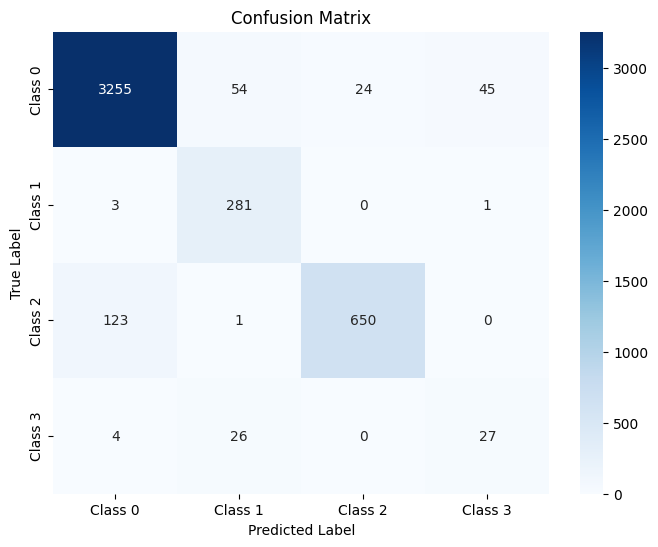

The function took 0.4892 seconds to execute.
[ARCH#152-[32, 32, 4, 4, 4]] done in 34.9s  best-val=0.1825


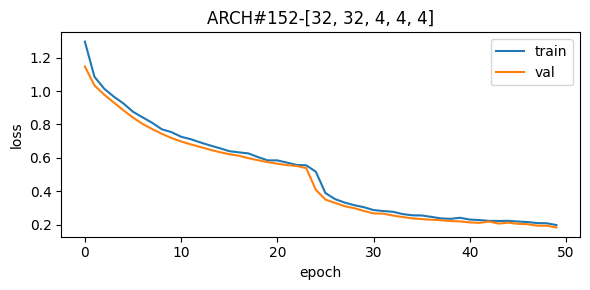


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.97      0.98     10808
     Class 1       0.70      1.00      0.82       914
     Class 2       1.00      0.86      0.92      2475
     Class 3       0.97      0.93      0.95       182

    accuracy                           0.96     14379
   macro avg       0.91      0.94      0.92     14379
weighted avg       0.96      0.96      0.96     14379



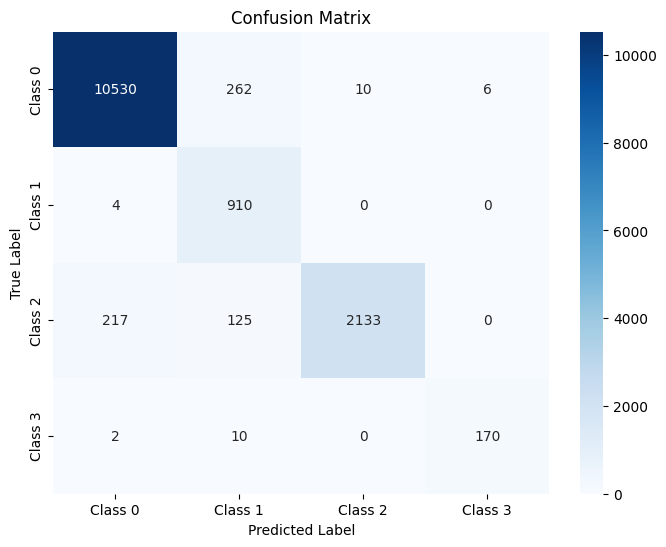

The function took 0.7165 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.97      0.98      2702
     Class 1       0.67      0.99      0.80       228
     Class 2       0.99      0.88      0.93       619
     Class 3       0.96      0.93      0.95        46

    accuracy                           0.96      3595
   macro avg       0.90      0.94      0.91      3595
weighted avg       0.96      0.96      0.96      3595



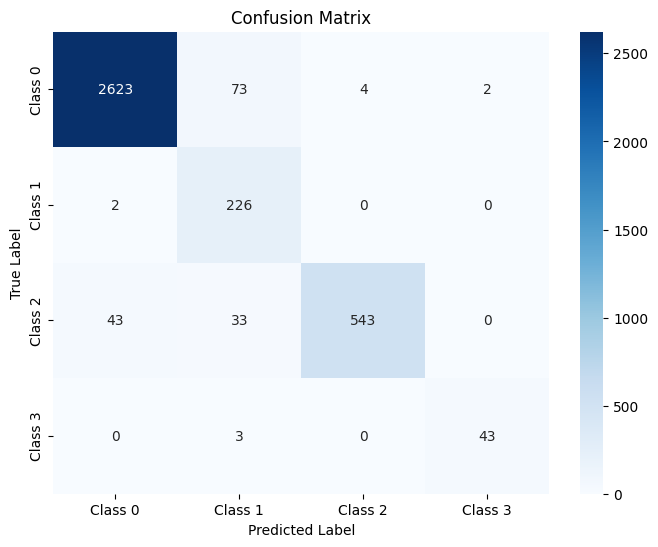

The function took 0.3446 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.98      0.98      3378
     Class 1       0.69      0.99      0.81       285
     Class 2       0.99      0.84      0.91       774
     Class 3       0.98      0.91      0.95        57

    accuracy                           0.95      4494
   macro avg       0.91      0.93      0.91      4494
weighted avg       0.96      0.95      0.95      4494



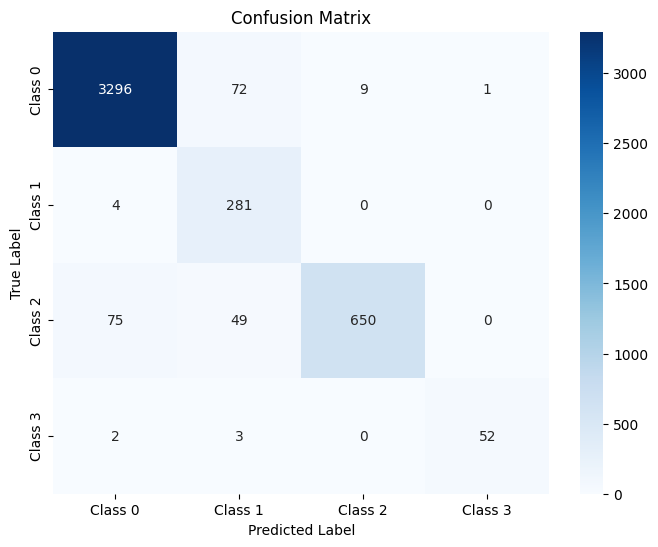

The function took 0.3979 seconds to execute.
[ARCH#153-[32, 32, 4, 4, 2]] done in 35.2s  best-val=0.1408


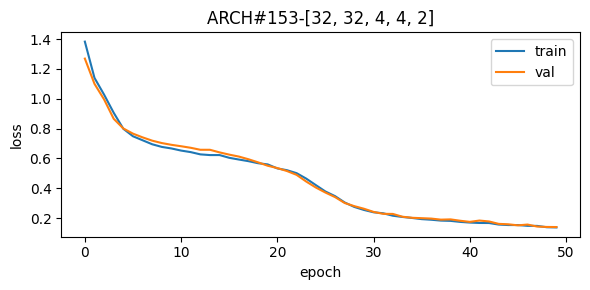


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.94      0.96     10808
     Class 1       0.76      0.94      0.84       914
     Class 2       0.91      0.97      0.94      2475
     Class 3       0.53      0.99      0.69       182

    accuracy                           0.95     14379
   macro avg       0.80      0.96      0.86     14379
weighted avg       0.96      0.95      0.95     14379



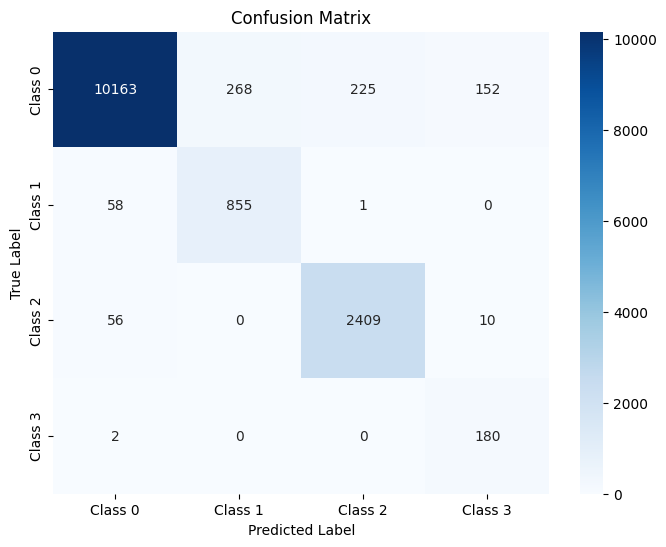

The function took 0.7550 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.94      0.96      2702
     Class 1       0.76      0.91      0.83       228
     Class 2       0.92      0.97      0.94       619
     Class 3       0.53      1.00      0.70        46

    accuracy                           0.95      3595
   macro avg       0.80      0.96      0.86      3595
weighted avg       0.95      0.95      0.95      3595



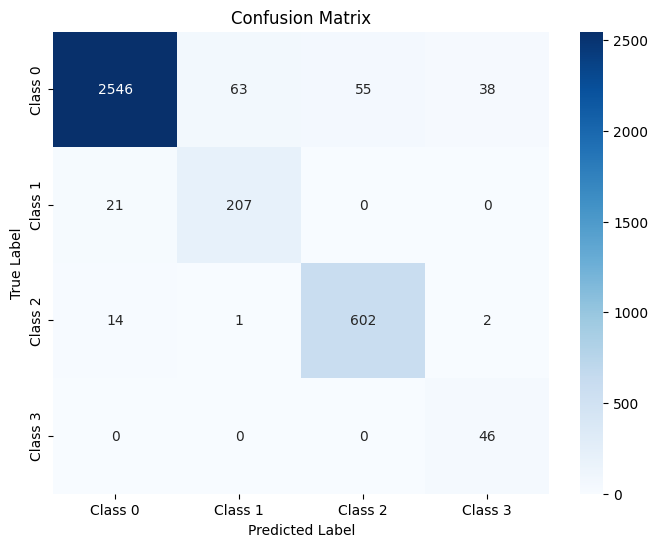

The function took 0.3625 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.94      0.96      3378
     Class 1       0.75      0.91      0.82       285
     Class 2       0.91      0.97      0.94       774
     Class 3       0.53      0.95      0.68        57

    accuracy                           0.94      4494
   macro avg       0.80      0.94      0.85      4494
weighted avg       0.95      0.94      0.95      4494



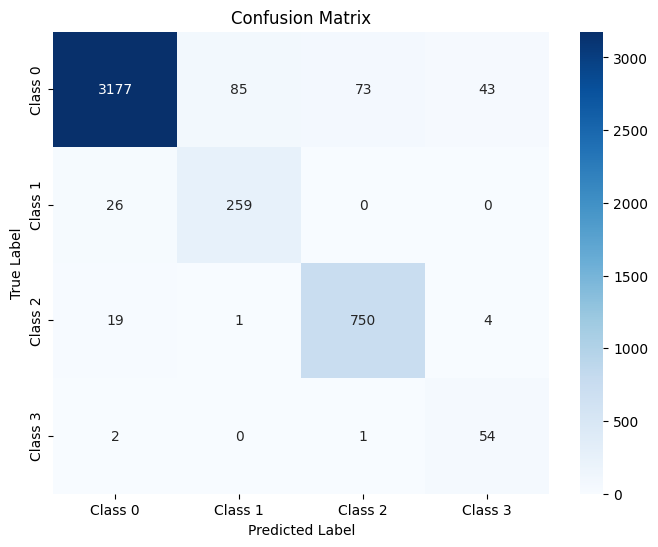

The function took 0.3805 seconds to execute.
[ARCH#154-[32, 32, 4, 2, 2]] early-stop @ epoch 033
[ARCH#154-[32, 32, 4, 2, 2]] done in 23.7s  best-val=1.3794


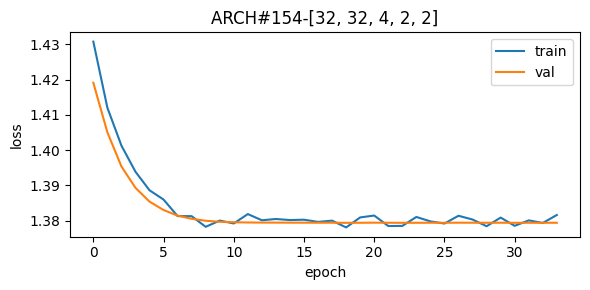


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86     10808
     Class 1       0.00      0.00      0.00       914
     Class 2       0.00      0.00      0.00      2475
     Class 3       0.00      0.00      0.00       182

    accuracy                           0.75     14379
   macro avg       0.19      0.25      0.21     14379
weighted avg       0.56      0.75      0.65     14379



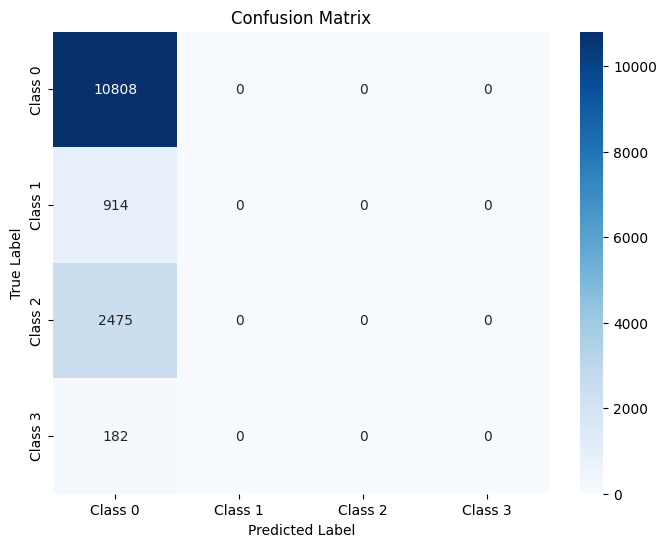

The function took 0.7028 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86      2702
     Class 1       0.00      0.00      0.00       228
     Class 2       0.00      0.00      0.00       619
     Class 3       0.00      0.00      0.00        46

    accuracy                           0.75      3595
   macro avg       0.19      0.25      0.21      3595
weighted avg       0.56      0.75      0.65      3595



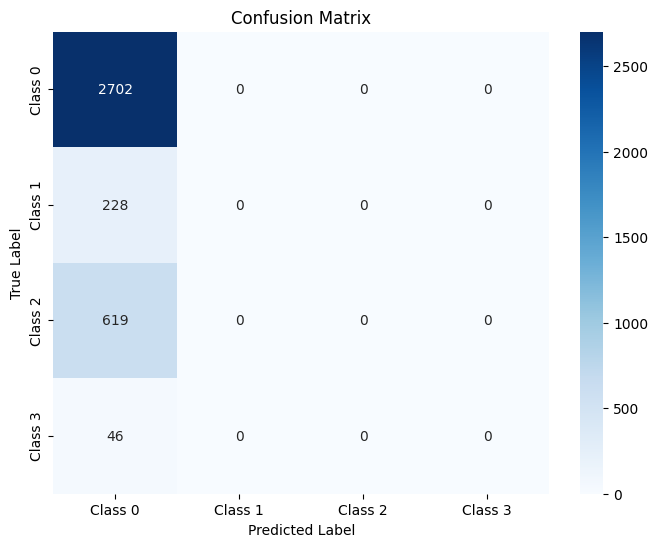

The function took 0.3422 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86      3378
     Class 1       0.00      0.00      0.00       285
     Class 2       0.00      0.00      0.00       774
     Class 3       0.00      0.00      0.00        57

    accuracy                           0.75      4494
   macro avg       0.19      0.25      0.21      4494
weighted avg       0.57      0.75      0.65      4494



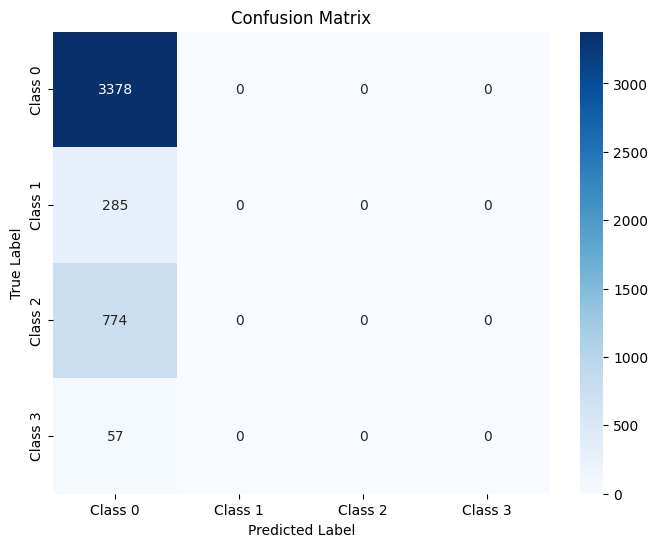

The function took 0.4531 seconds to execute.
[ARCH#155-[32, 32, 2, 2, 2]] early-stop @ epoch 032
[ARCH#155-[32, 32, 2, 2, 2]] done in 23.5s  best-val=1.3794


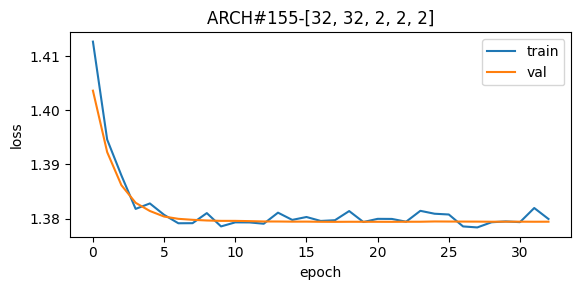


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86     10808
     Class 1       0.00      0.00      0.00       914
     Class 2       0.00      0.00      0.00      2475
     Class 3       0.00      0.00      0.00       182

    accuracy                           0.75     14379
   macro avg       0.19      0.25      0.21     14379
weighted avg       0.56      0.75      0.65     14379



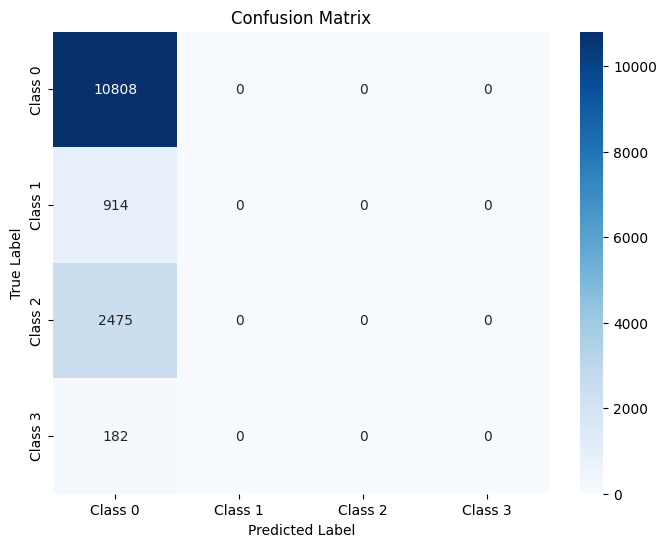

The function took 0.6577 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86      2702
     Class 1       0.00      0.00      0.00       228
     Class 2       0.00      0.00      0.00       619
     Class 3       0.00      0.00      0.00        46

    accuracy                           0.75      3595
   macro avg       0.19      0.25      0.21      3595
weighted avg       0.56      0.75      0.65      3595



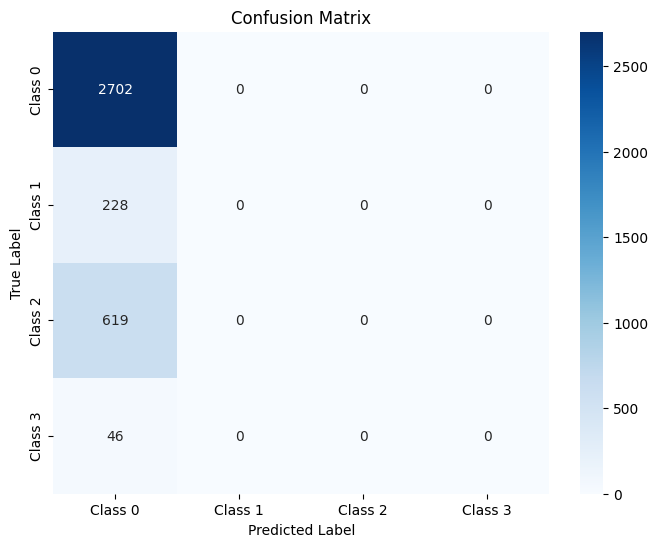

The function took 0.3410 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86      3378
     Class 1       0.00      0.00      0.00       285
     Class 2       0.00      0.00      0.00       774
     Class 3       0.00      0.00      0.00        57

    accuracy                           0.75      4494
   macro avg       0.19      0.25      0.21      4494
weighted avg       0.57      0.75      0.65      4494



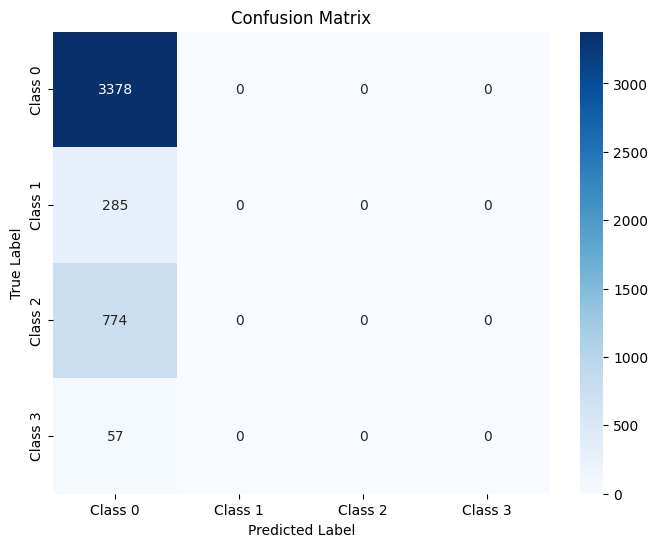

The function took 0.5517 seconds to execute.
[ARCH#156-[32, 16, 16, 16, 16]] done in 35.2s  best-val=0.0895


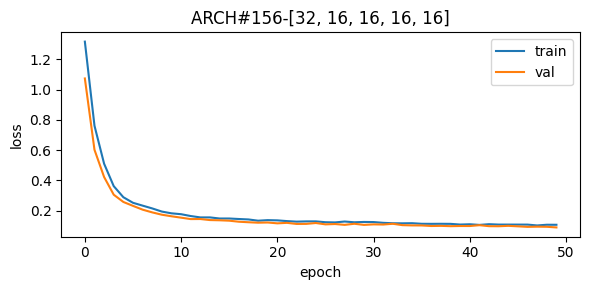


Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.93      0.96     10808
     Class 1       0.79      1.00      0.88       914
     Class 2       0.87      0.98      0.92      2475
     Class 3       0.54      0.99      0.70       182

    accuracy                           0.94     14379
   macro avg       0.80      0.97      0.87     14379
weighted avg       0.96      0.94      0.95     14379



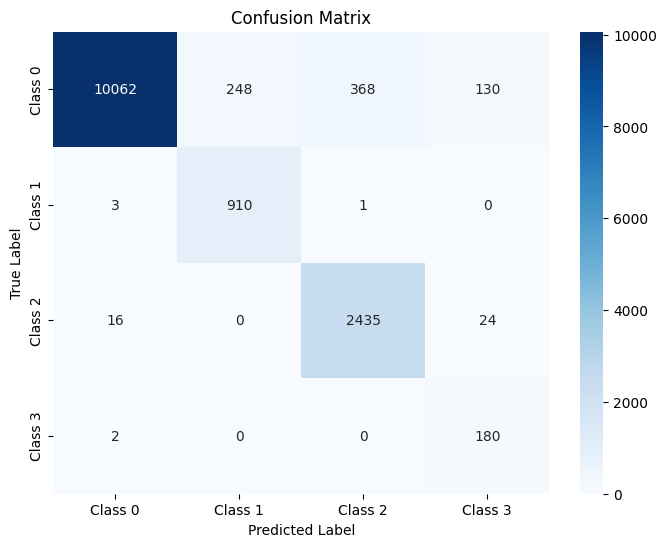

The function took 0.6631 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.93      0.96      2702
     Class 1       0.79      1.00      0.88       228
     Class 2       0.87      0.98      0.92       619
     Class 3       0.55      1.00      0.71        46

    accuracy                           0.95      3595
   macro avg       0.80      0.98      0.87      3595
weighted avg       0.96      0.95      0.95      3595



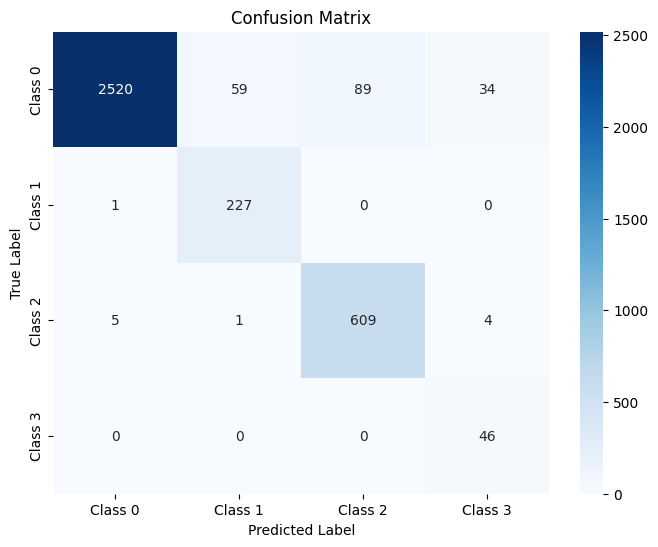

The function took 0.4622 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.93      0.96      3378
     Class 1       0.80      0.99      0.88       285
     Class 2       0.87      0.99      0.92       774
     Class 3       0.52      0.93      0.67        57

    accuracy                           0.95      4494
   macro avg       0.80      0.96      0.86      4494
weighted avg       0.96      0.95      0.95      4494



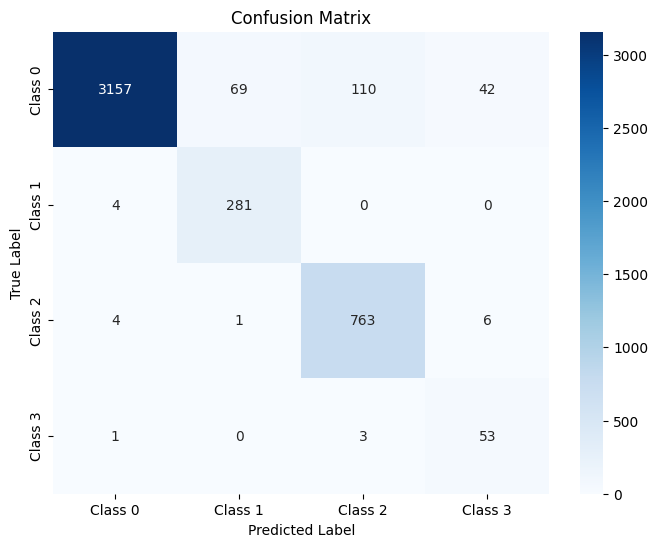

The function took 0.3717 seconds to execute.
[ARCH#157-[32, 16, 16, 16, 8]] done in 35.1s  best-val=0.0765


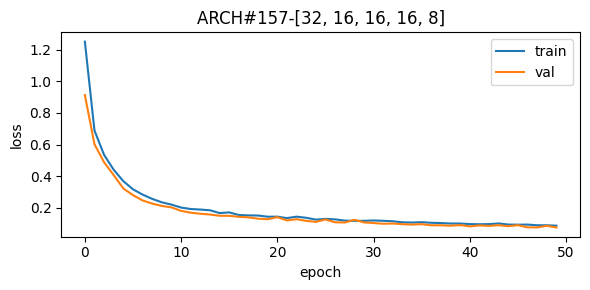


Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.94      0.97     10808
     Class 1       0.77      1.00      0.87       914
     Class 2       0.90      0.99      0.94      2475
     Class 3       0.64      0.99      0.78       182

    accuracy                           0.95     14379
   macro avg       0.83      0.98      0.89     14379
weighted avg       0.96      0.95      0.96     14379



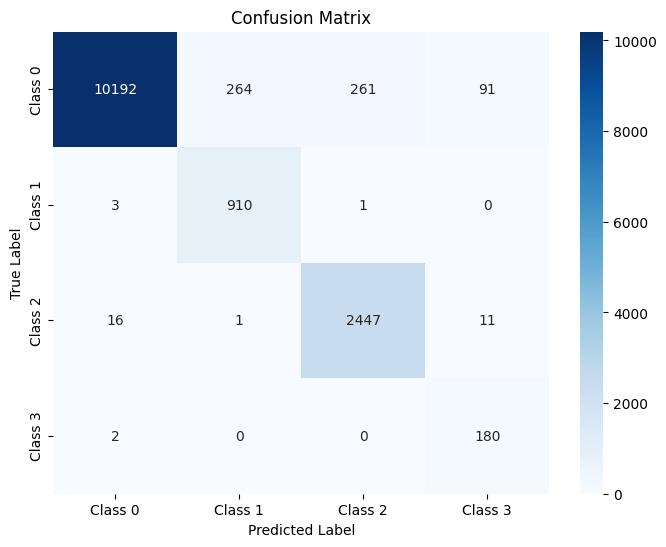

The function took 0.7894 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.94      0.97      2702
     Class 1       0.79      1.00      0.88       228
     Class 2       0.89      0.99      0.94       619
     Class 3       0.65      1.00      0.79        46

    accuracy                           0.95      3595
   macro avg       0.83      0.98      0.89      3595
weighted avg       0.96      0.95      0.96      3595



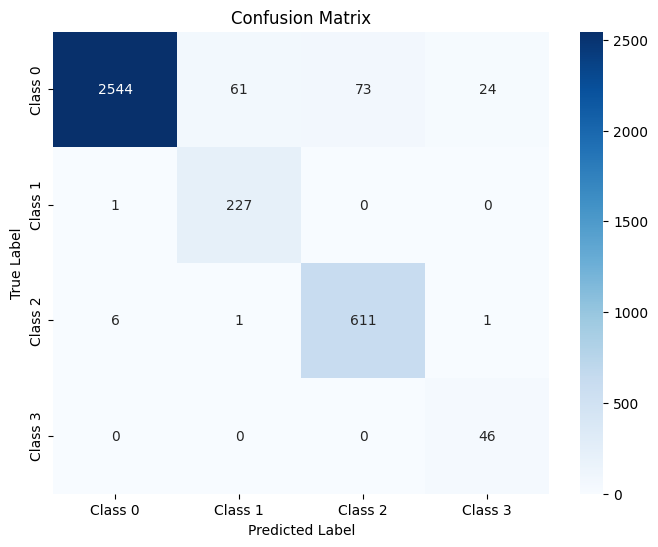

The function took 0.3420 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.95      0.97      3378
     Class 1       0.79      0.99      0.88       285
     Class 2       0.91      0.99      0.95       774
     Class 3       0.62      0.95      0.75        57

    accuracy                           0.96      4494
   macro avg       0.83      0.97      0.89      4494
weighted avg       0.96      0.96      0.96      4494



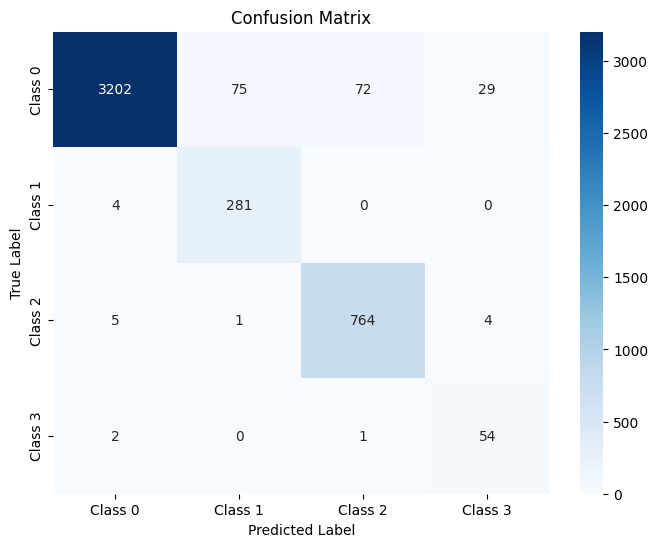

The function took 0.3976 seconds to execute.
[ARCH#158-[32, 16, 16, 16, 4]] done in 35.1s  best-val=0.0811


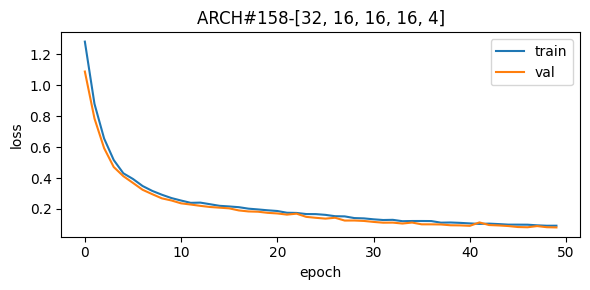


Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.94      0.97     10808
     Class 1       0.77      1.00      0.87       914
     Class 2       0.89      0.99      0.94      2475
     Class 3       0.77      0.98      0.86       182

    accuracy                           0.96     14379
   macro avg       0.86      0.98      0.91     14379
weighted avg       0.96      0.96      0.96     14379



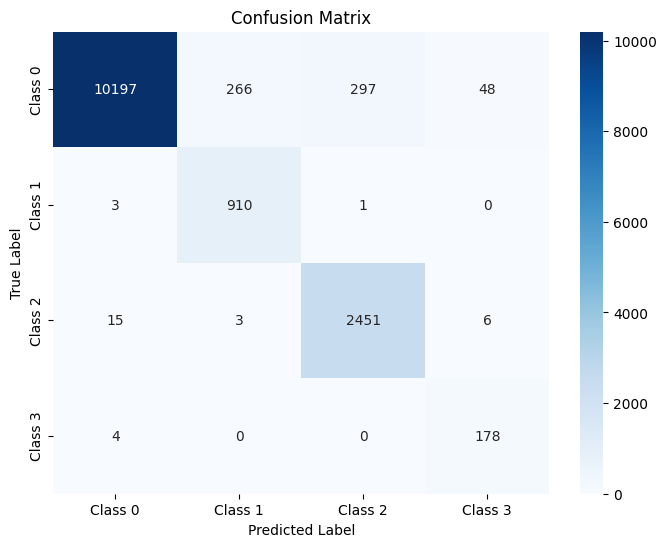

The function took 0.7149 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.95      0.97      2702
     Class 1       0.77      0.99      0.87       228
     Class 2       0.90      0.99      0.94       619
     Class 3       0.75      0.98      0.85        46

    accuracy                           0.96      3595
   macro avg       0.86      0.98      0.91      3595
weighted avg       0.96      0.96      0.96      3595



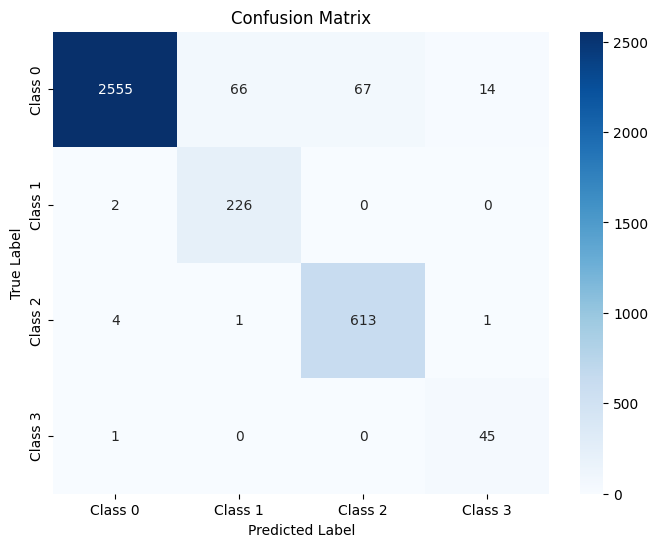

The function took 0.3811 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.95      0.97      3378
     Class 1       0.77      0.99      0.87       285
     Class 2       0.91      0.99      0.94       774
     Class 3       0.75      0.95      0.84        57

    accuracy                           0.96      4494
   macro avg       0.86      0.97      0.90      4494
weighted avg       0.96      0.96      0.96      4494



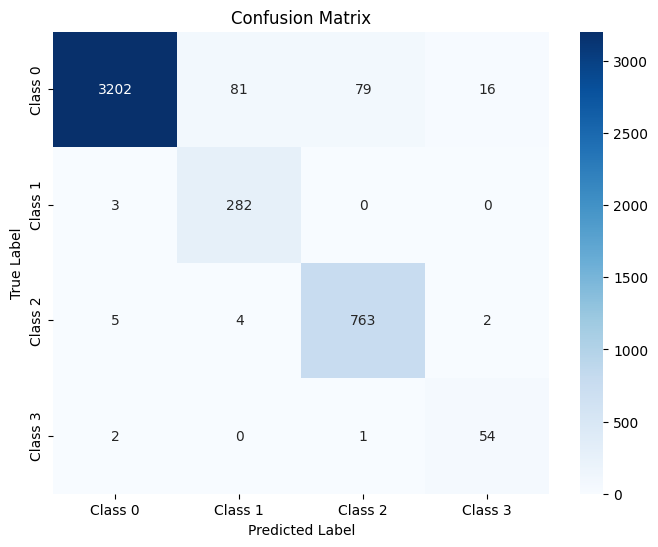

The function took 0.3727 seconds to execute.
[ARCH#159-[32, 16, 16, 16, 2]] early-stop @ epoch 043
[ARCH#159-[32, 16, 16, 16, 2]] done in 31.4s  best-val=1.3794


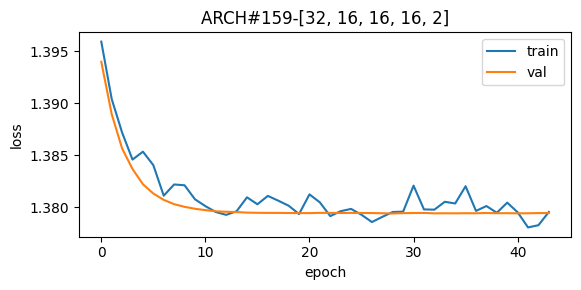


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86     10808
     Class 1       0.00      0.00      0.00       914
     Class 2       0.00      0.00      0.00      2475
     Class 3       0.00      0.00      0.00       182

    accuracy                           0.75     14379
   macro avg       0.19      0.25      0.21     14379
weighted avg       0.56      0.75      0.65     14379



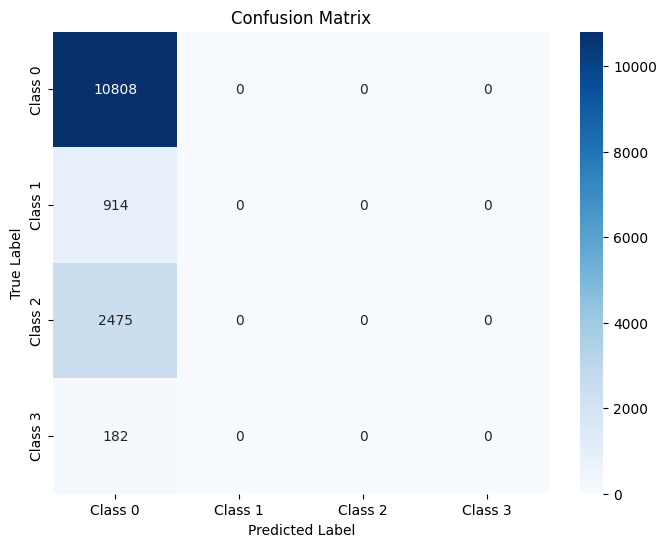

The function took 0.6553 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86      2702
     Class 1       0.00      0.00      0.00       228
     Class 2       0.00      0.00      0.00       619
     Class 3       0.00      0.00      0.00        46

    accuracy                           0.75      3595
   macro avg       0.19      0.25      0.21      3595
weighted avg       0.56      0.75      0.65      3595



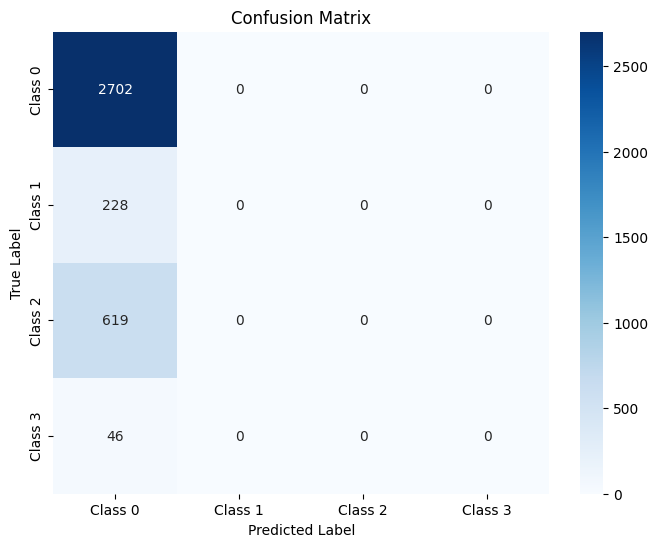

The function took 0.4751 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86      3378
     Class 1       0.00      0.00      0.00       285
     Class 2       0.00      0.00      0.00       774
     Class 3       0.00      0.00      0.00        57

    accuracy                           0.75      4494
   macro avg       0.19      0.25      0.21      4494
weighted avg       0.57      0.75      0.65      4494



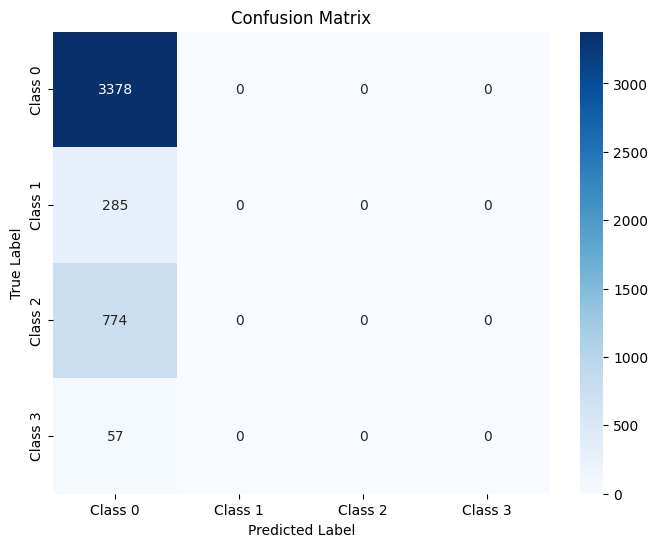

The function took 0.3799 seconds to execute.
[ARCH#160-[32, 16, 16, 8, 8]] done in 35.0s  best-val=0.0773


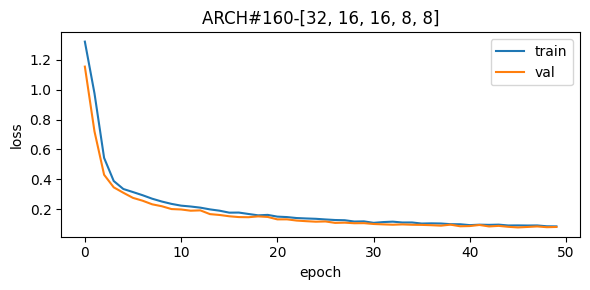


Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.94      0.97     10808
     Class 1       0.79      1.00      0.88       914
     Class 2       0.90      0.99      0.94      2475
     Class 3       0.61      0.99      0.76       182

    accuracy                           0.95     14379
   macro avg       0.83      0.98      0.89     14379
weighted avg       0.96      0.95      0.96     14379



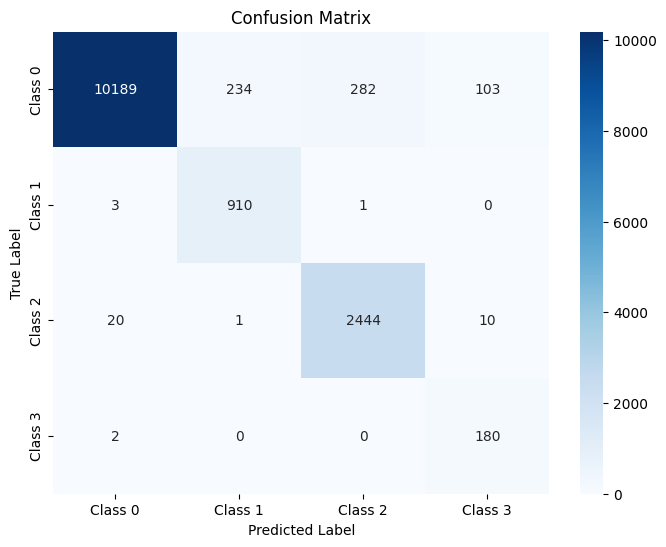

The function took 0.6344 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.94      0.97      2702
     Class 1       0.77      0.99      0.86       228
     Class 2       0.90      0.99      0.94       619
     Class 3       0.64      1.00      0.78        46

    accuracy                           0.95      3595
   macro avg       0.83      0.98      0.89      3595
weighted avg       0.96      0.95      0.95      3595



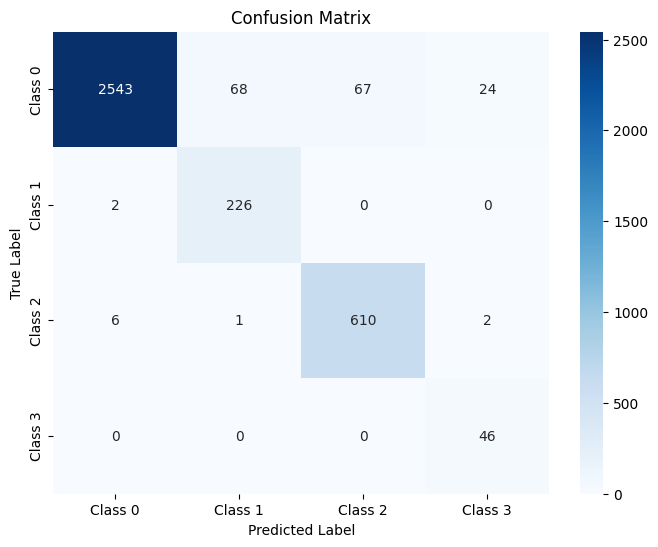

The function took 0.3424 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.95      0.97      3378
     Class 1       0.78      0.99      0.87       285
     Class 2       0.91      0.98      0.95       774
     Class 3       0.60      0.96      0.74        57

    accuracy                           0.96      4494
   macro avg       0.82      0.97      0.88      4494
weighted avg       0.96      0.96      0.96      4494



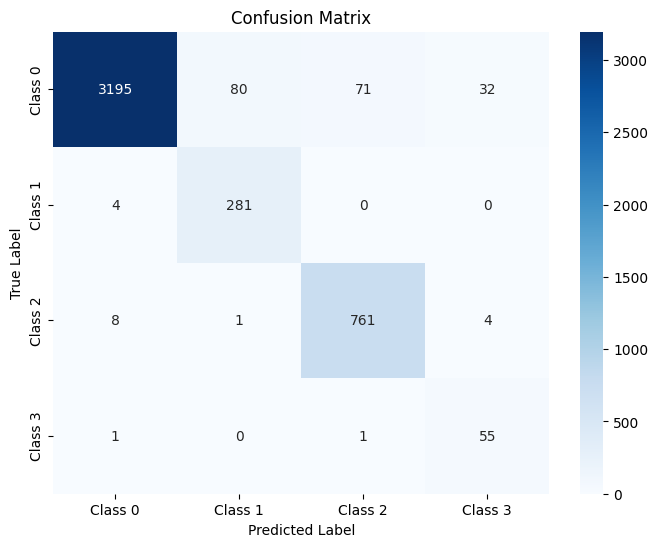

The function took 0.5183 seconds to execute.
[ARCH#161-[32, 16, 16, 8, 4]] done in 35.2s  best-val=0.1025


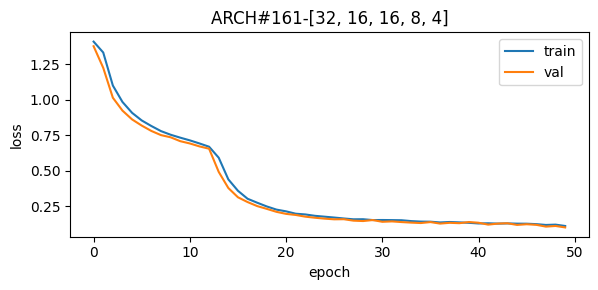


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.95      0.97     10808
     Class 1       0.76      1.00      0.86       914
     Class 2       0.93      0.95      0.94      2475
     Class 3       0.56      0.99      0.72       182

    accuracy                           0.95     14379
   macro avg       0.81      0.97      0.87     14379
weighted avg       0.96      0.95      0.95     14379



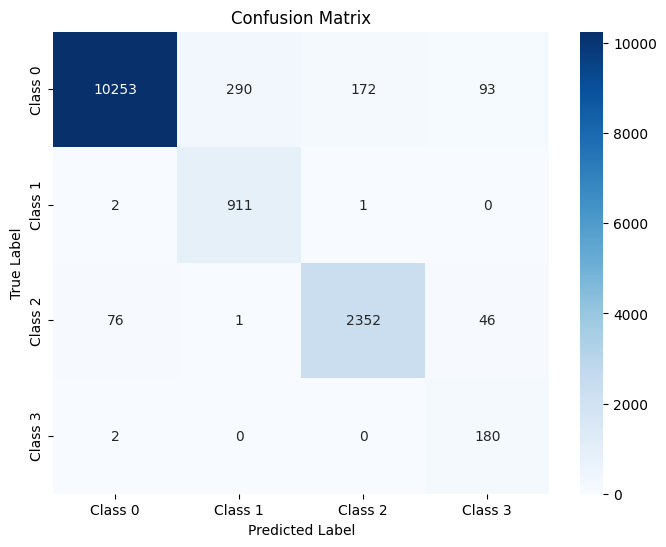

The function took 0.6618 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.95      0.97      2702
     Class 1       0.75      1.00      0.86       228
     Class 2       0.94      0.95      0.94       619
     Class 3       0.51      1.00      0.68        46

    accuracy                           0.95      3595
   macro avg       0.80      0.97      0.86      3595
weighted avg       0.96      0.95      0.95      3595



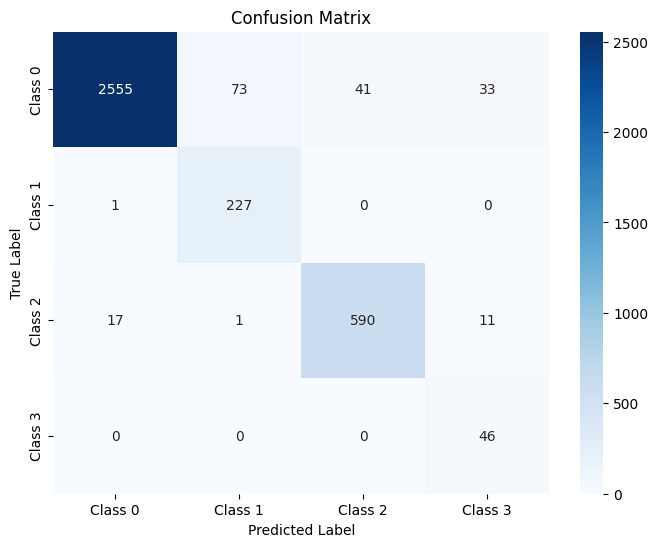

The function took 0.4672 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.95      0.97      3378
     Class 1       0.76      0.99      0.86       285
     Class 2       0.94      0.95      0.94       774
     Class 3       0.55      0.93      0.69        57

    accuracy                           0.95      4494
   macro avg       0.81      0.95      0.87      4494
weighted avg       0.96      0.95      0.96      4494



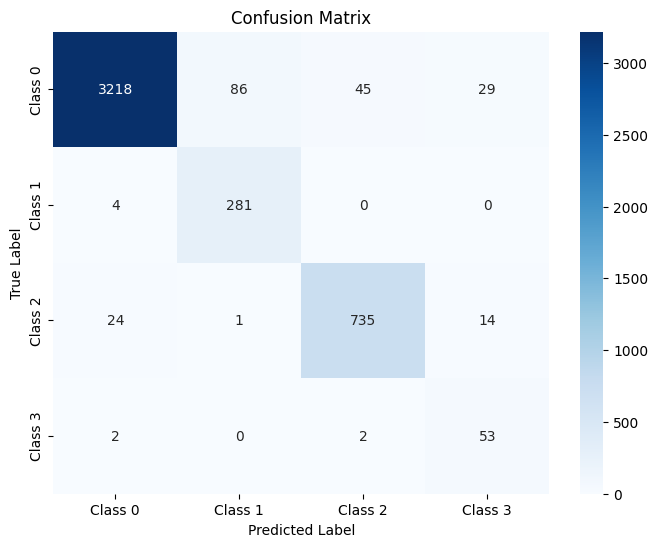

The function took 0.3853 seconds to execute.
[ARCH#162-[32, 16, 16, 8, 2]] early-stop @ epoch 047
[ARCH#162-[32, 16, 16, 8, 2]] done in 34.3s  best-val=1.3794


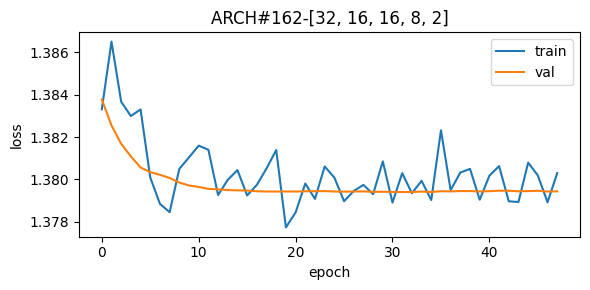


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86     10808
     Class 1       0.00      0.00      0.00       914
     Class 2       0.00      0.00      0.00      2475
     Class 3       0.00      0.00      0.00       182

    accuracy                           0.75     14379
   macro avg       0.19      0.25      0.21     14379
weighted avg       0.56      0.75      0.65     14379



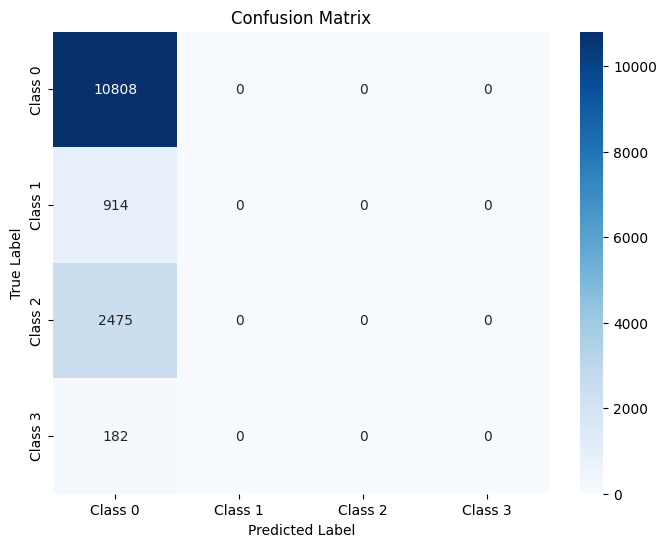

The function took 0.6400 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86      2702
     Class 1       0.00      0.00      0.00       228
     Class 2       0.00      0.00      0.00       619
     Class 3       0.00      0.00      0.00        46

    accuracy                           0.75      3595
   macro avg       0.19      0.25      0.21      3595
weighted avg       0.56      0.75      0.65      3595



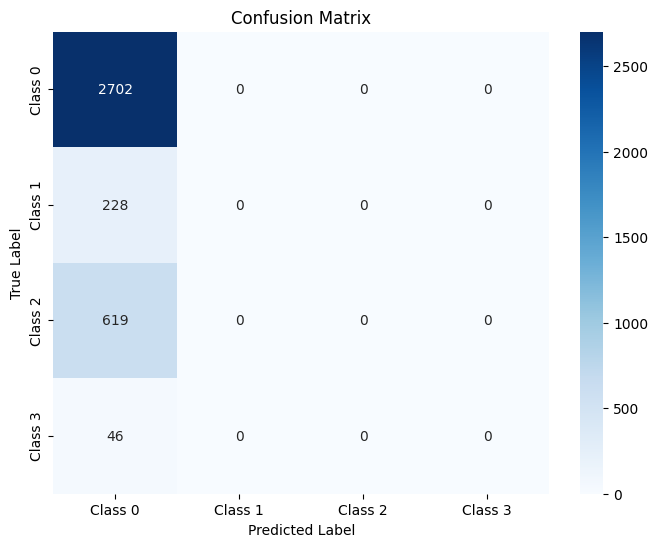

The function took 0.5027 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86      3378
     Class 1       0.00      0.00      0.00       285
     Class 2       0.00      0.00      0.00       774
     Class 3       0.00      0.00      0.00        57

    accuracy                           0.75      4494
   macro avg       0.19      0.25      0.21      4494
weighted avg       0.57      0.75      0.65      4494



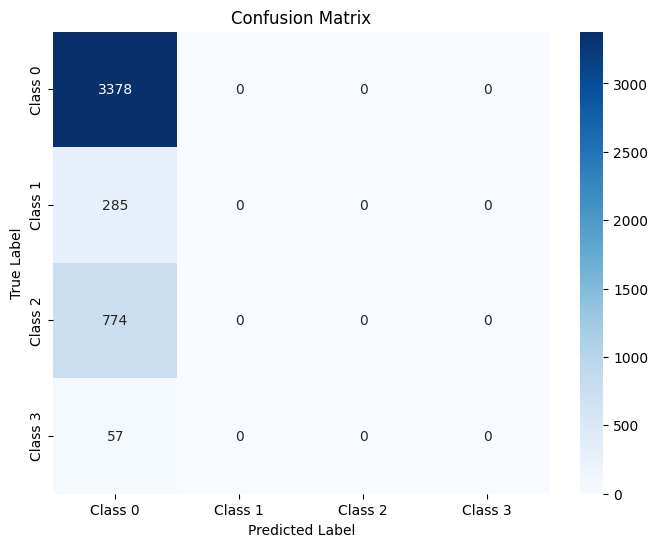

The function took 0.3668 seconds to execute.
[ARCH#163-[32, 16, 16, 4, 4]] done in 35.2s  best-val=0.2606


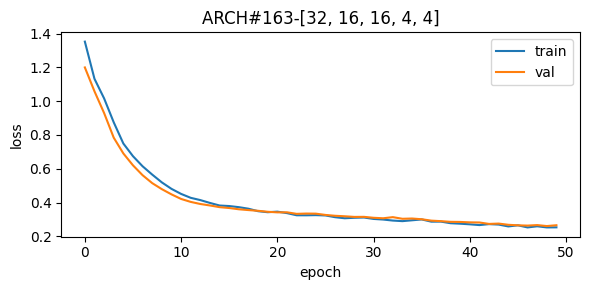


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.93      0.96     10808
     Class 1       0.50      0.90      0.65       914
     Class 2       0.99      0.87      0.93      2475
     Class 3       0.51      0.99      0.68       182

    accuracy                           0.92     14379
   macro avg       0.75      0.92      0.80     14379
weighted avg       0.95      0.92      0.93     14379



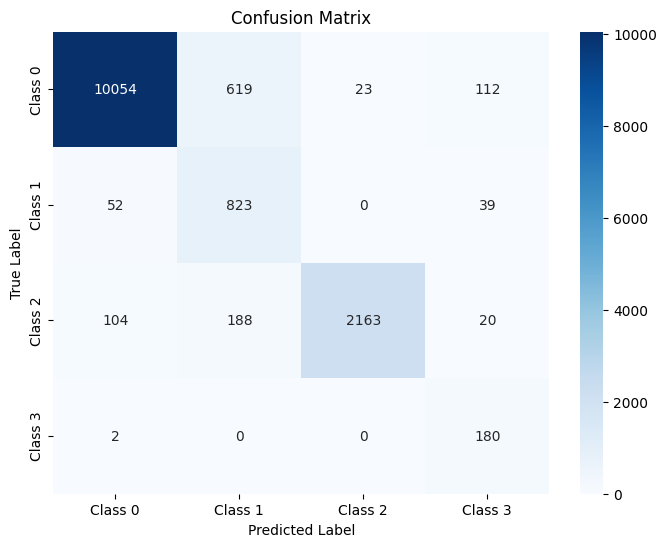

The function took 0.6424 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.93      0.96      2702
     Class 1       0.49      0.87      0.62       228
     Class 2       0.99      0.88      0.93       619
     Class 3       0.53      1.00      0.70        46

    accuracy                           0.92      3595
   macro avg       0.75      0.92      0.80      3595
weighted avg       0.95      0.92      0.93      3595



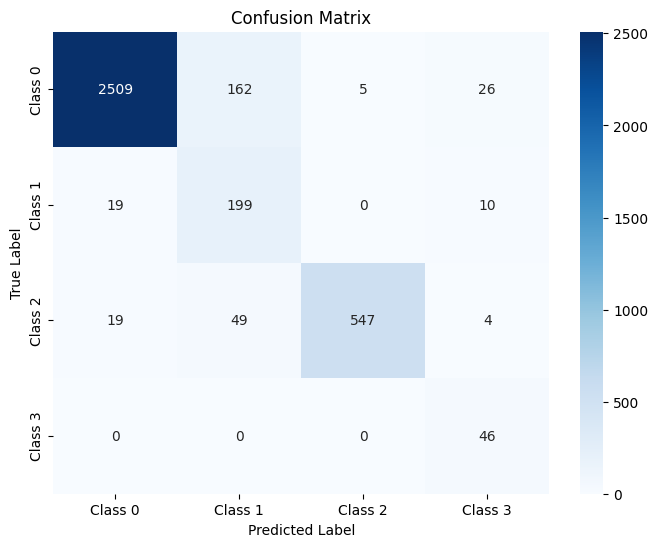

The function took 0.3431 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.93      0.96      3378
     Class 1       0.50      0.89      0.64       285
     Class 2       0.99      0.85      0.91       774
     Class 3       0.50      0.95      0.66        57

    accuracy                           0.92      4494
   macro avg       0.74      0.91      0.79      4494
weighted avg       0.95      0.92      0.92      4494



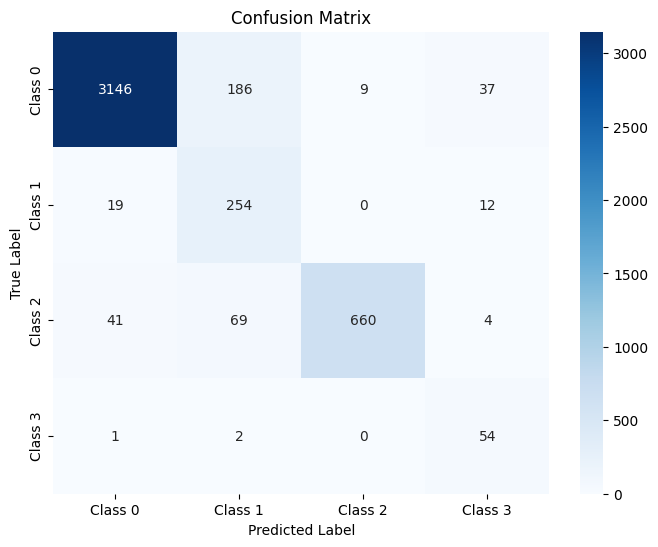

The function took 0.3853 seconds to execute.
[ARCH#164-[32, 16, 16, 4, 2]] done in 35.2s  best-val=0.1940


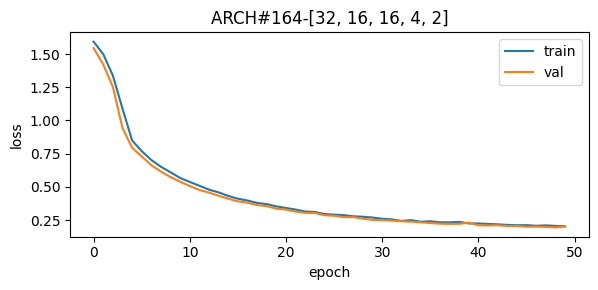


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.97      0.96      0.96     10808
     Class 1       0.75      1.00      0.86       914
     Class 2       0.93      0.87      0.90      2475
     Class 3       0.89      0.90      0.90       182

    accuracy                           0.94     14379
   macro avg       0.89      0.93      0.90     14379
weighted avg       0.95      0.94      0.94     14379



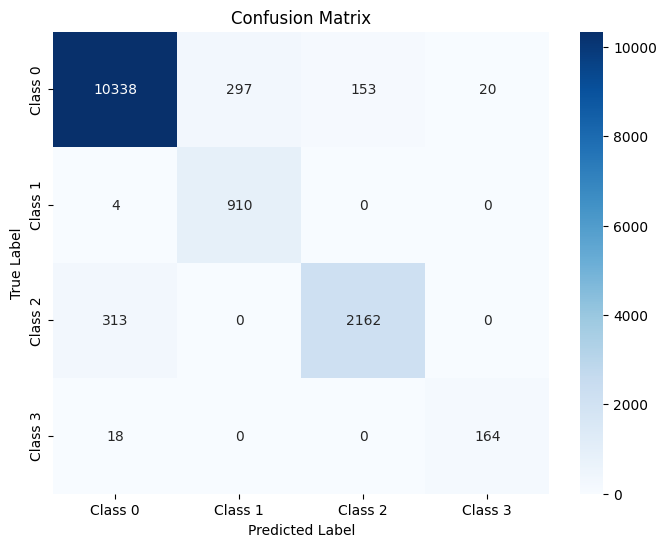

The function took 0.6854 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.97      0.96      0.96      2702
     Class 1       0.73      0.99      0.84       228
     Class 2       0.94      0.88      0.91       619
     Class 3       0.89      0.89      0.89        46

    accuracy                           0.94      3595
   macro avg       0.88      0.93      0.90      3595
weighted avg       0.95      0.94      0.95      3595



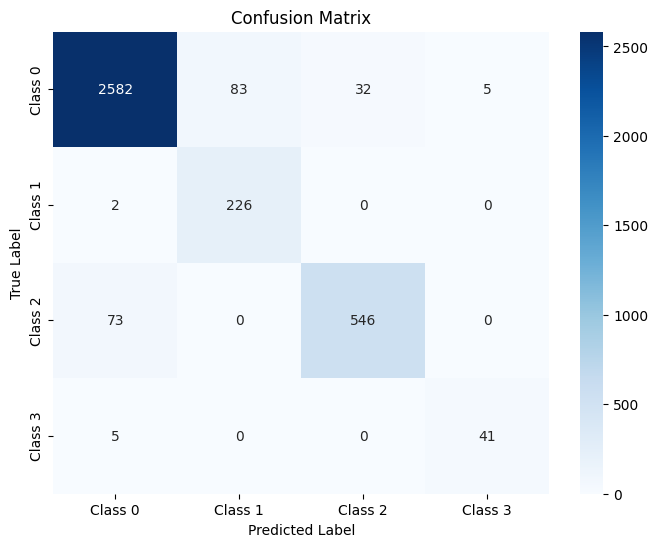

The function took 0.4502 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.96      0.95      0.96      3378
     Class 1       0.76      0.99      0.86       285
     Class 2       0.92      0.85      0.88       774
     Class 3       0.79      0.91      0.85        57

    accuracy                           0.94      4494
   macro avg       0.86      0.93      0.89      4494
weighted avg       0.94      0.94      0.94      4494



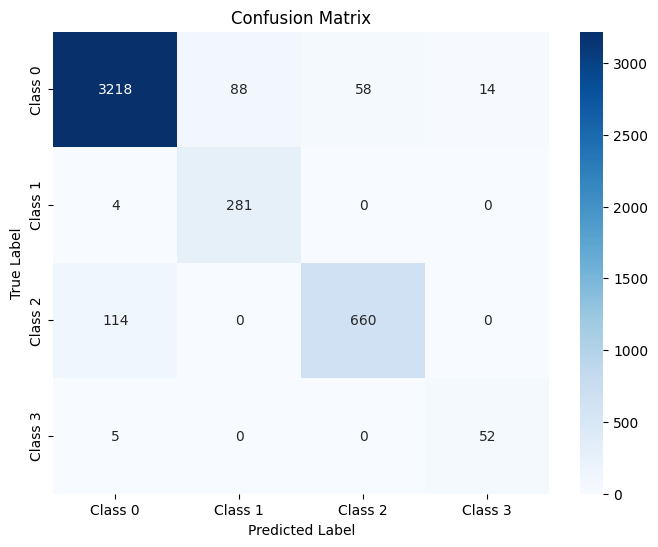

The function took 0.3673 seconds to execute.
[ARCH#165-[32, 16, 16, 2, 2]] done in 35.1s  best-val=0.1246


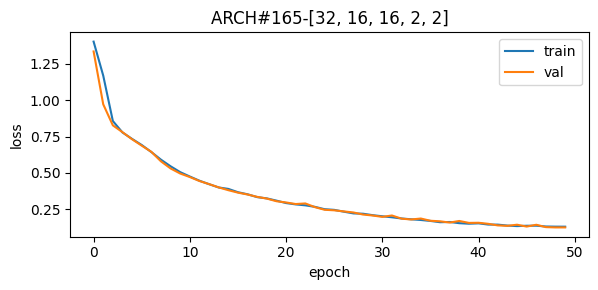


Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.93      0.96     10808
     Class 1       0.78      1.00      0.88       914
     Class 2       0.83      1.00      0.91      2475
     Class 3       0.95      0.94      0.94       182

    accuracy                           0.95     14379
   macro avg       0.89      0.97      0.92     14379
weighted avg       0.96      0.95      0.95     14379



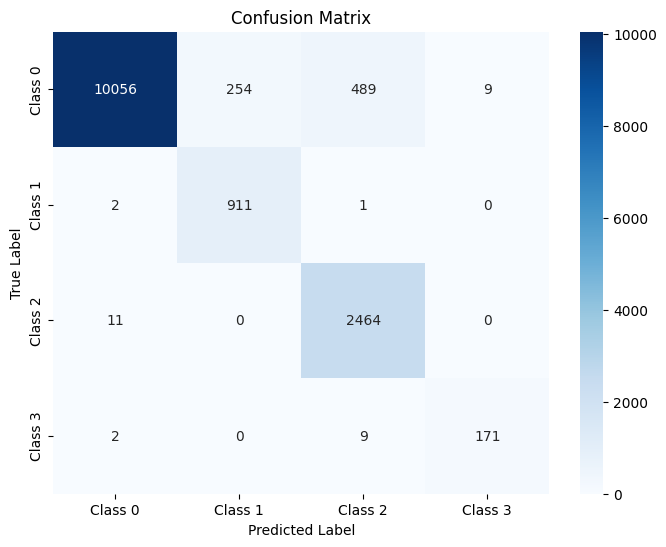

The function took 0.7385 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.93      0.96      2702
     Class 1       0.79      1.00      0.88       228
     Class 2       0.83      1.00      0.91       619
     Class 3       0.90      0.93      0.91        46

    accuracy                           0.95      3595
   macro avg       0.88      0.96      0.92      3595
weighted avg       0.96      0.95      0.95      3595



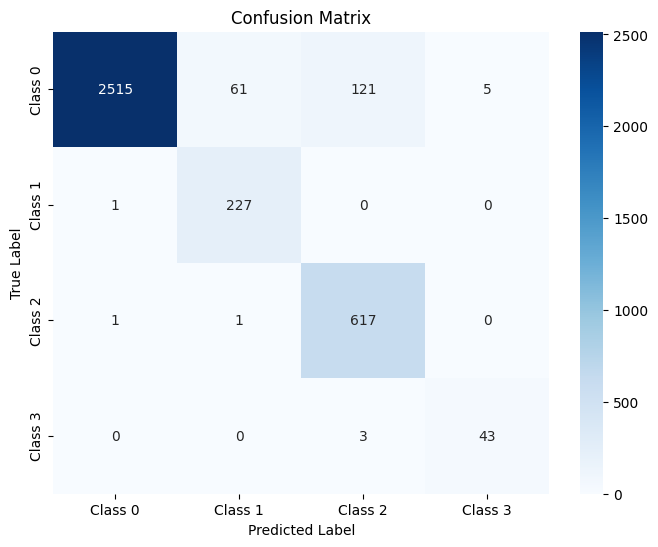

The function took 0.3492 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.93      0.96      3378
     Class 1       0.80      0.99      0.88       285
     Class 2       0.84      0.99      0.91       774
     Class 3       0.91      0.93      0.92        57

    accuracy                           0.95      4494
   macro avg       0.89      0.96      0.92      4494
weighted avg       0.96      0.95      0.95      4494



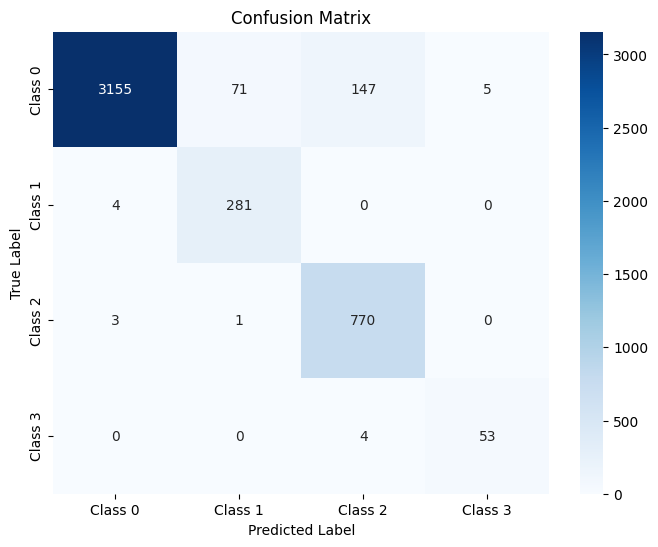

The function took 0.3705 seconds to execute.
[ARCH#166-[32, 16, 8, 8, 8]] done in 35.2s  best-val=0.1045


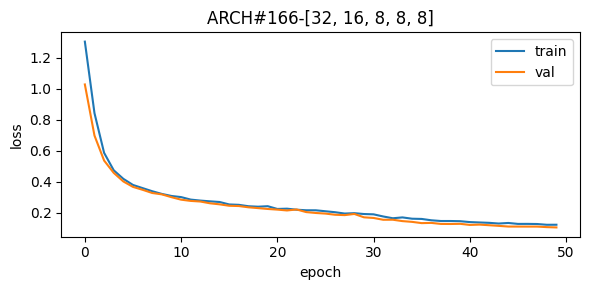


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.94      0.96     10808
     Class 1       0.82      1.00      0.90       914
     Class 2       0.86      0.96      0.91      2475
     Class 3       0.61      0.93      0.74       182

    accuracy                           0.95     14379
   macro avg       0.82      0.96      0.88     14379
weighted avg       0.95      0.95      0.95     14379



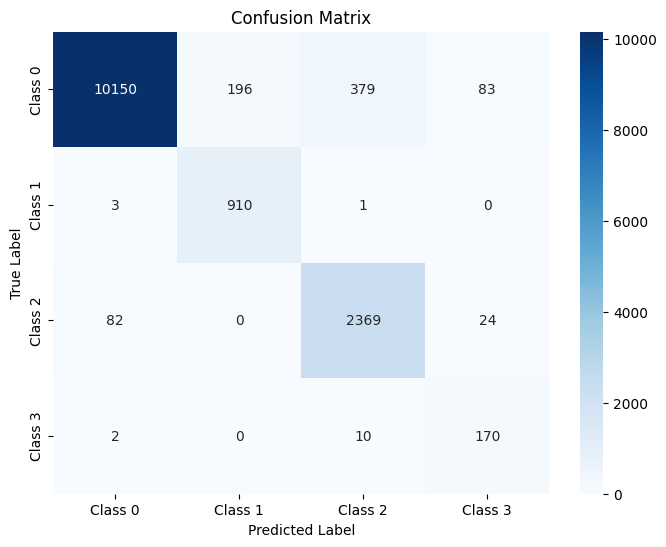

The function took 0.6788 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.93      0.96      2702
     Class 1       0.82      0.99      0.90       228
     Class 2       0.85      0.96      0.90       619
     Class 3       0.60      0.93      0.73        46

    accuracy                           0.94      3595
   macro avg       0.81      0.96      0.87      3595
weighted avg       0.95      0.94      0.94      3595



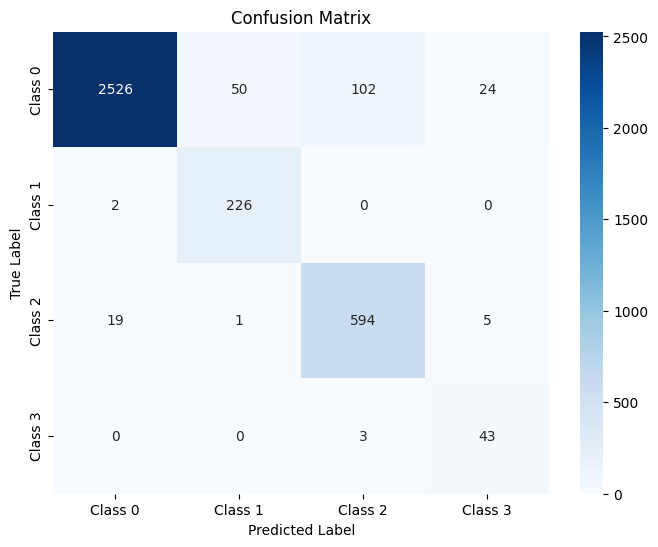

The function took 0.3645 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.94      0.96      3378
     Class 1       0.82      0.99      0.90       285
     Class 2       0.86      0.95      0.91       774
     Class 3       0.58      0.93      0.72        57

    accuracy                           0.94      4494
   macro avg       0.81      0.95      0.87      4494
weighted avg       0.95      0.94      0.95      4494



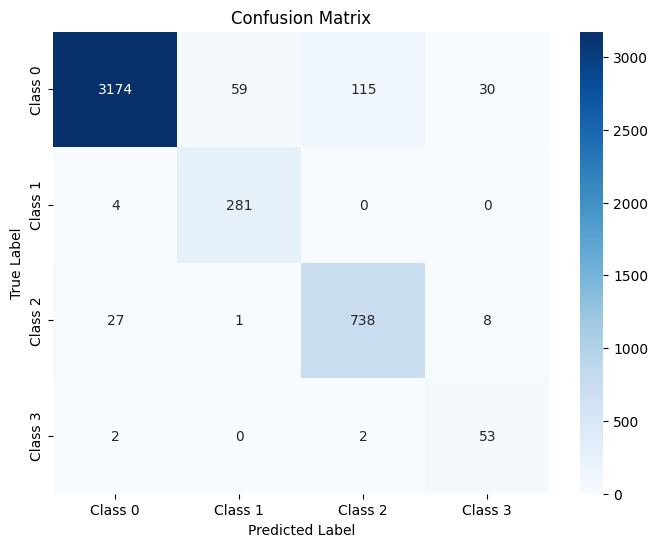

The function took 0.4997 seconds to execute.
[ARCH#167-[32, 16, 8, 8, 4]] done in 35.4s  best-val=0.1170


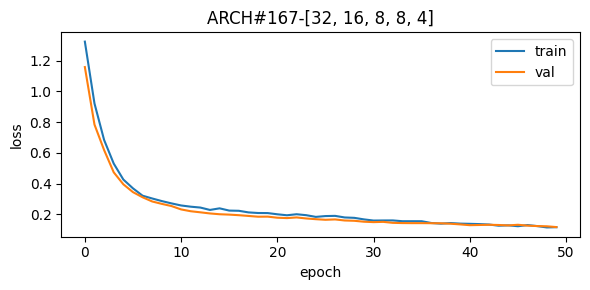


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.95      0.97     10808
     Class 1       0.79      1.00      0.88       914
     Class 2       0.89      0.96      0.92      2475
     Class 3       0.81      0.93      0.87       182

    accuracy                           0.95     14379
   macro avg       0.87      0.96      0.91     14379
weighted avg       0.96      0.95      0.95     14379



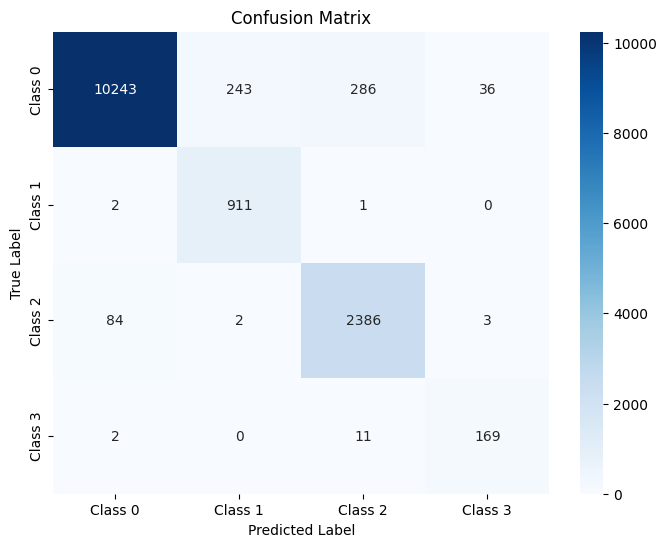

The function took 0.7705 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.95      0.97      2702
     Class 1       0.78      0.99      0.87       228
     Class 2       0.89      0.97      0.93       619
     Class 3       0.78      0.93      0.85        46

    accuracy                           0.95      3595
   macro avg       0.86      0.96      0.91      3595
weighted avg       0.96      0.95      0.95      3595



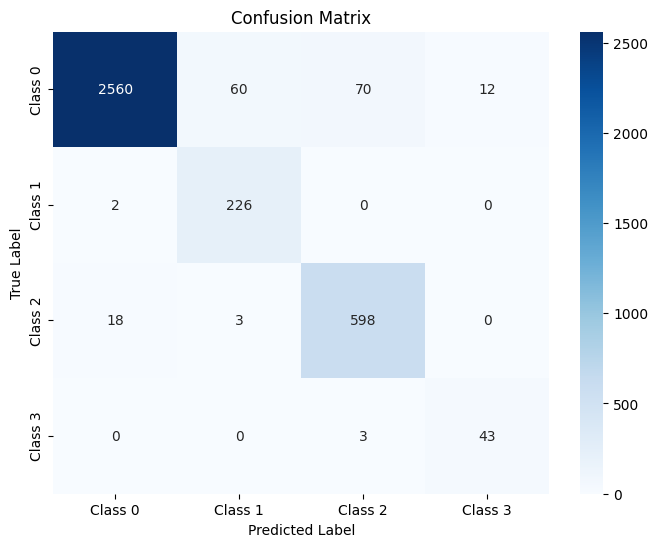

The function took 0.3443 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.95      0.97      3378
     Class 1       0.81      0.99      0.89       285
     Class 2       0.91      0.96      0.93       774
     Class 3       0.75      0.95      0.84        57

    accuracy                           0.96      4494
   macro avg       0.86      0.96      0.91      4494
weighted avg       0.96      0.96      0.96      4494



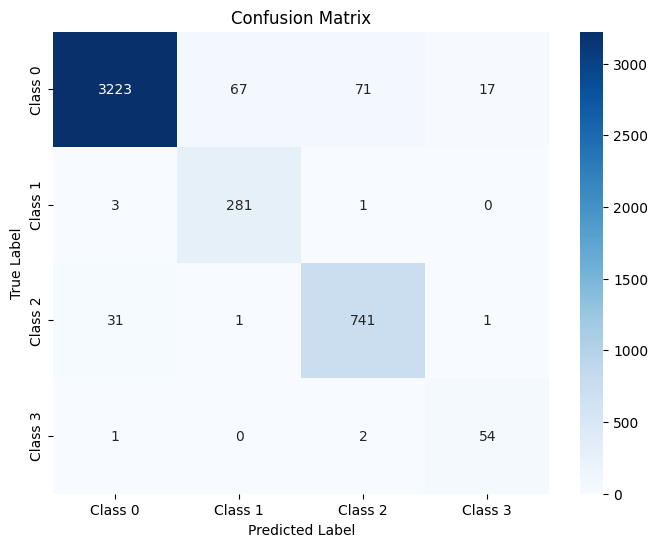

The function took 0.3790 seconds to execute.
[ARCH#168-[32, 16, 8, 8, 2]] done in 35.0s  best-val=1.3794


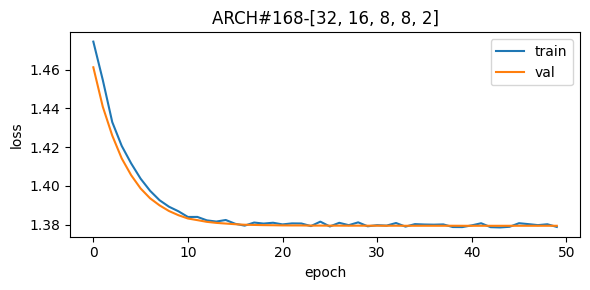


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86     10808
     Class 1       0.00      0.00      0.00       914
     Class 2       0.00      0.00      0.00      2475
     Class 3       0.00      0.00      0.00       182

    accuracy                           0.75     14379
   macro avg       0.19      0.25      0.21     14379
weighted avg       0.56      0.75      0.65     14379



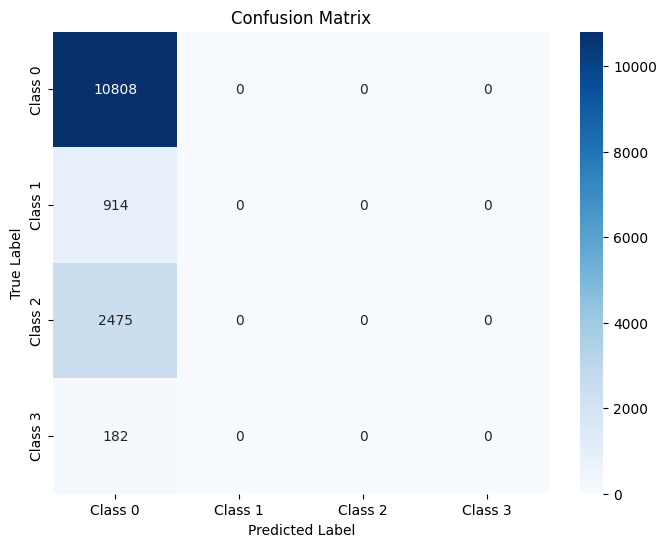

The function took 0.6566 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86      2702
     Class 1       0.00      0.00      0.00       228
     Class 2       0.00      0.00      0.00       619
     Class 3       0.00      0.00      0.00        46

    accuracy                           0.75      3595
   macro avg       0.19      0.25      0.21      3595
weighted avg       0.56      0.75      0.65      3595



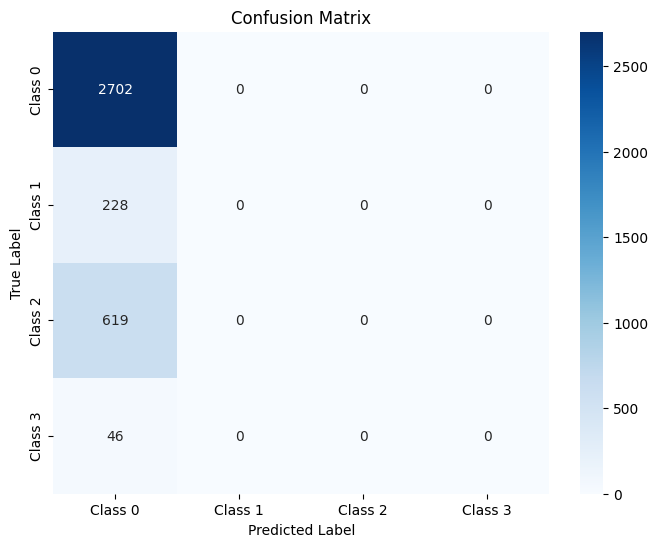

The function took 0.7133 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86      3378
     Class 1       0.00      0.00      0.00       285
     Class 2       0.00      0.00      0.00       774
     Class 3       0.00      0.00      0.00        57

    accuracy                           0.75      4494
   macro avg       0.19      0.25      0.21      4494
weighted avg       0.57      0.75      0.65      4494



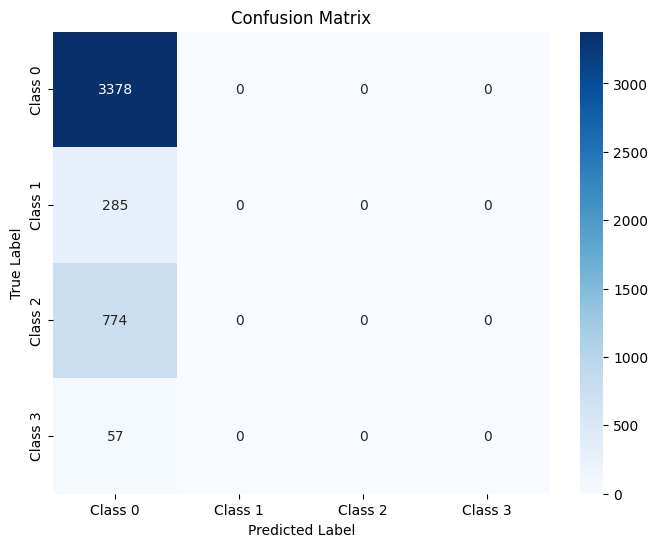

The function took 0.4491 seconds to execute.
[ARCH#169-[32, 16, 8, 4, 4]] done in 35.4s  best-val=0.2336


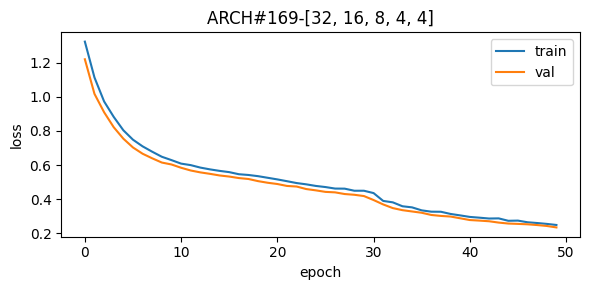


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.96      0.97     10808
     Class 1       0.84      1.00      0.91       914
     Class 2       1.00      0.86      0.92      2475
     Class 3       0.31      0.99      0.47       182

    accuracy                           0.94     14379
   macro avg       0.78      0.95      0.82     14379
weighted avg       0.96      0.94      0.95     14379



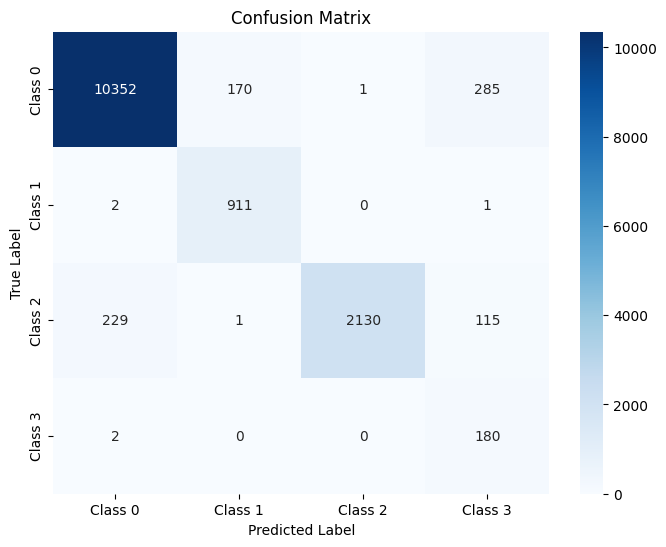

The function took 0.7839 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.96      0.97      2702
     Class 1       0.82      1.00      0.90       228
     Class 2       1.00      0.88      0.93       619
     Class 3       0.31      1.00      0.47        46

    accuracy                           0.94      3595
   macro avg       0.78      0.96      0.82      3595
weighted avg       0.97      0.94      0.95      3595



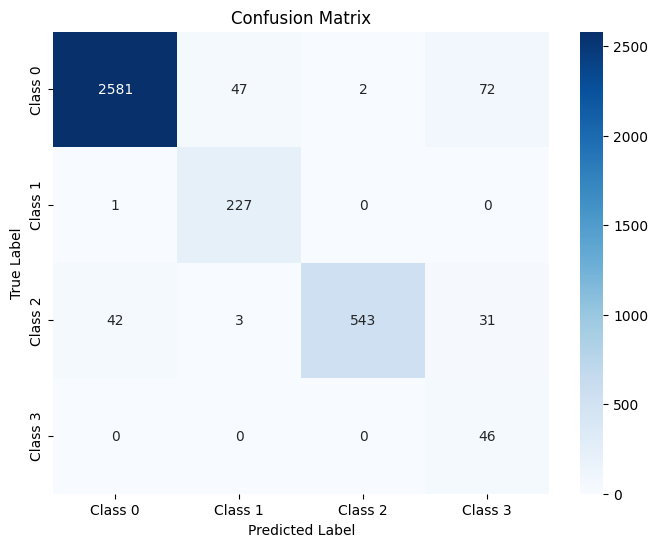

The function took 0.3421 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.97      0.96      0.97      3378
     Class 1       0.86      0.99      0.92       285
     Class 2       1.00      0.84      0.91       774
     Class 3       0.29      0.95      0.44        57

    accuracy                           0.94      4494
   macro avg       0.78      0.93      0.81      4494
weighted avg       0.96      0.94      0.95      4494



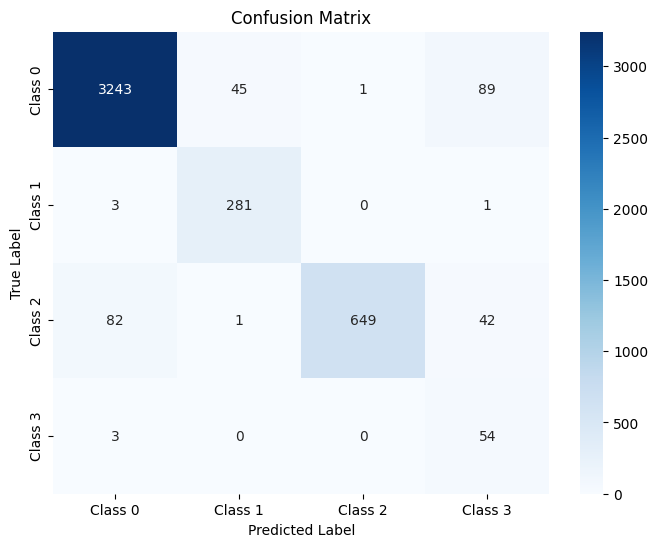

The function took 0.3990 seconds to execute.
[ARCH#170-[32, 16, 8, 4, 2]] done in 35.8s  best-val=0.0919


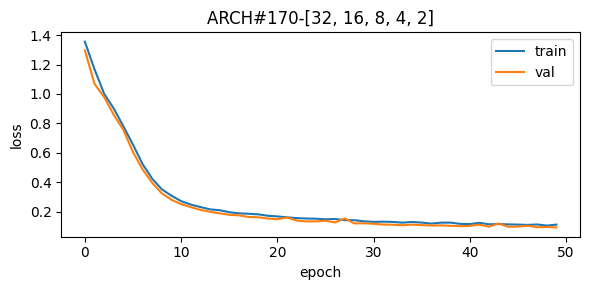


Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.95      0.97     10808
     Class 1       0.80      1.00      0.89       914
     Class 2       0.92      0.98      0.95      2475
     Class 3       0.49      0.99      0.66       182

    accuracy                           0.96     14379
   macro avg       0.80      0.98      0.87     14379
weighted avg       0.97      0.96      0.96     14379



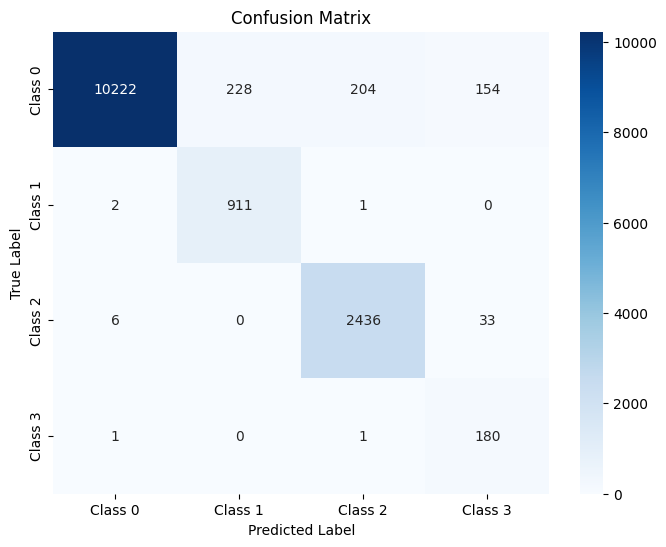

The function took 0.6691 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.95      0.97      2702
     Class 1       0.80      0.99      0.89       228
     Class 2       0.92      0.98      0.95       619
     Class 3       0.49      1.00      0.66        46

    accuracy                           0.96      3595
   macro avg       0.80      0.98      0.87      3595
weighted avg       0.97      0.96      0.96      3595



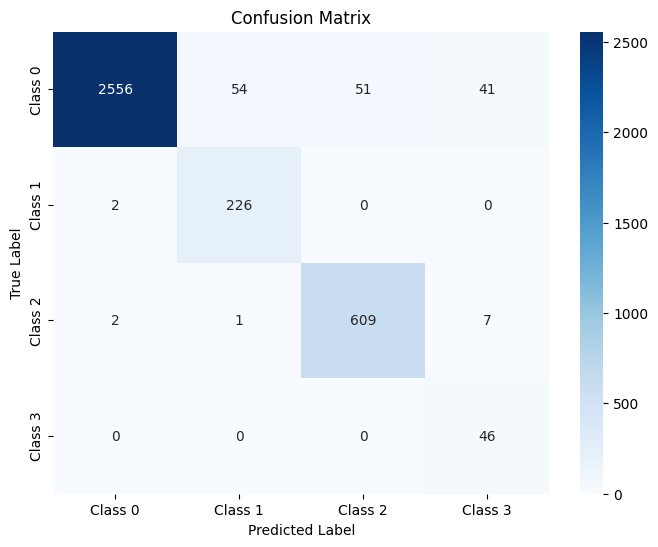

The function took 0.3526 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.95      0.97      3378
     Class 1       0.80      0.99      0.89       285
     Class 2       0.93      0.98      0.95       774
     Class 3       0.43      0.95      0.59        57

    accuracy                           0.95      4494
   macro avg       0.79      0.96      0.85      4494
weighted avg       0.97      0.95      0.96      4494



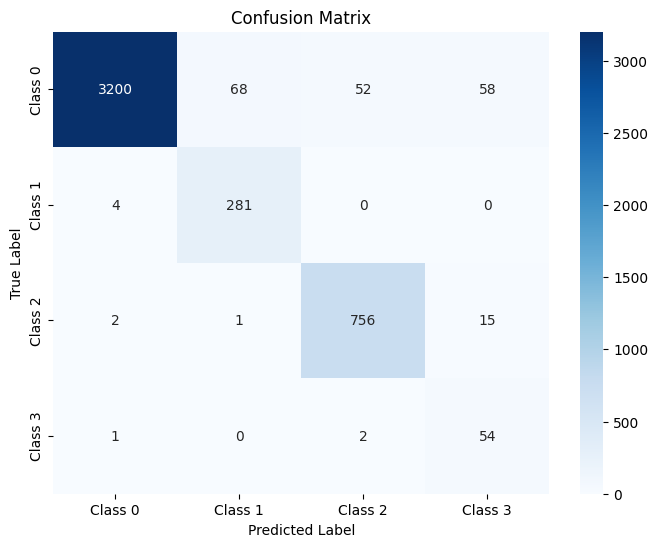

The function took 0.4197 seconds to execute.
[ARCH#171-[32, 16, 8, 2, 2]] done in 35.9s  best-val=0.2962


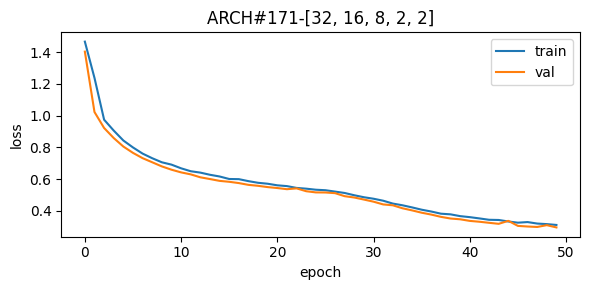


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.92      0.95     10808
     Class 1       0.54      1.00      0.70       914
     Class 2       1.00      0.86      0.92      2475
     Class 3       0.33      0.91      0.48       182

    accuracy                           0.91     14379
   macro avg       0.71      0.92      0.76     14379
weighted avg       0.95      0.91      0.92     14379



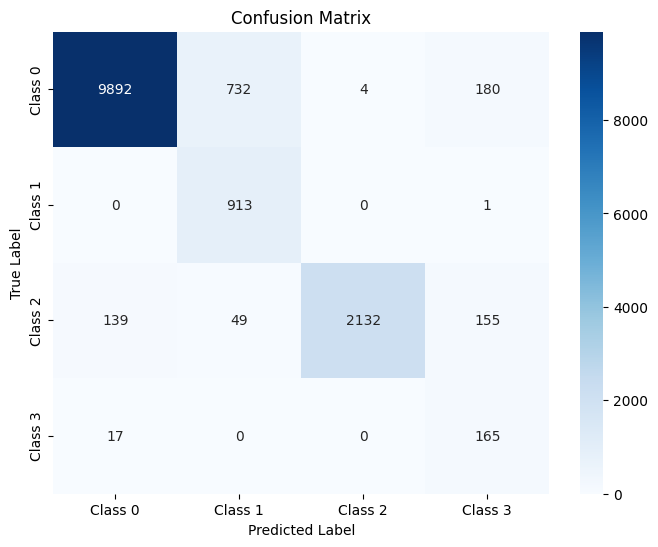

The function took 0.7825 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.92      0.95      2702
     Class 1       0.54      0.99      0.70       228
     Class 2       1.00      0.88      0.93       619
     Class 3       0.32      0.91      0.48        46

    accuracy                           0.91      3595
   macro avg       0.71      0.92      0.77      3595
weighted avg       0.95      0.91      0.93      3595



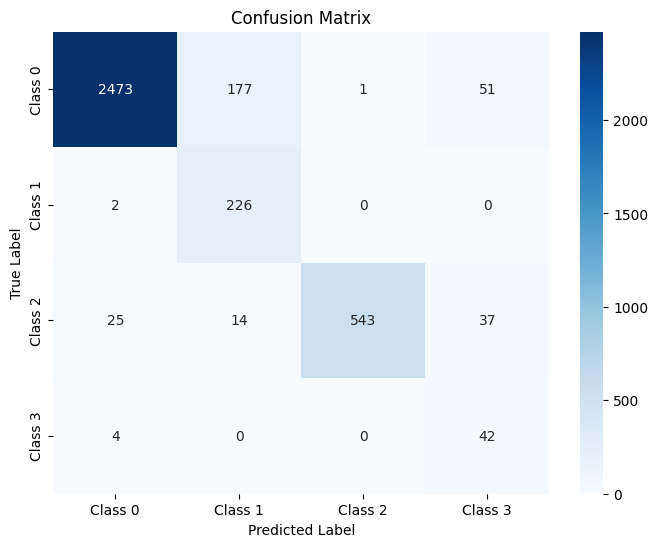

The function took 0.3504 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.92      0.95      3378
     Class 1       0.54      0.99      0.70       285
     Class 2       1.00      0.84      0.91       774
     Class 3       0.34      0.89      0.49        57

    accuracy                           0.91      4494
   macro avg       0.71      0.91      0.76      4494
weighted avg       0.95      0.91      0.92      4494



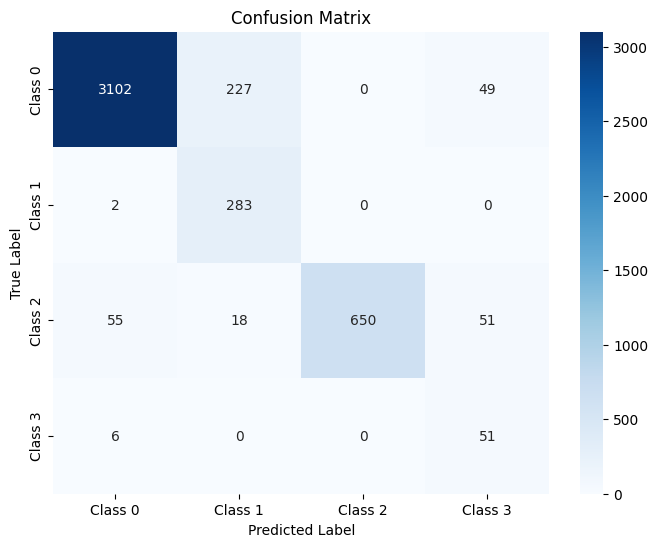

The function took 0.4454 seconds to execute.
[ARCH#172-[32, 16, 4, 4, 4]] done in 35.3s  best-val=0.1850


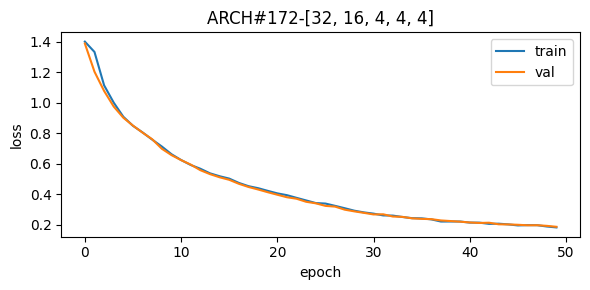


Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.92      0.96     10808
     Class 1       0.74      1.00      0.85       914
     Class 2       0.88      0.98      0.93      2475
     Class 3       0.43      0.93      0.59       182

    accuracy                           0.94     14379
   macro avg       0.76      0.96      0.83     14379
weighted avg       0.95      0.94      0.94     14379



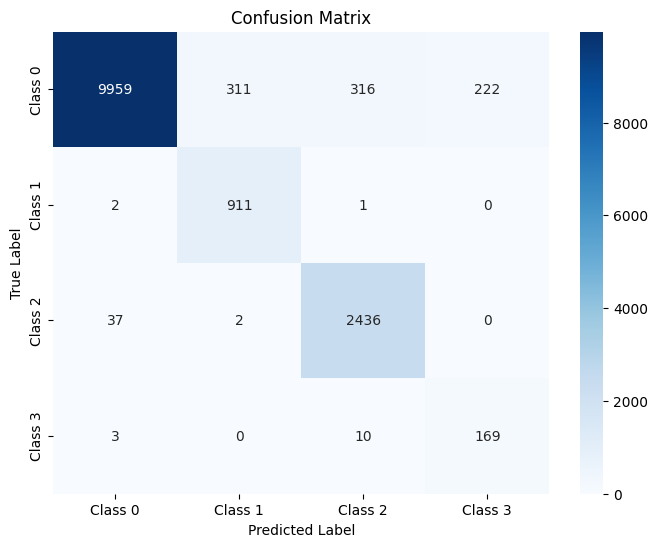

The function took 0.7492 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.92      0.96      2702
     Class 1       0.75      1.00      0.85       228
     Class 2       0.88      0.98      0.93       619
     Class 3       0.43      0.93      0.59        46

    accuracy                           0.94      3595
   macro avg       0.76      0.96      0.83      3595
weighted avg       0.95      0.94      0.94      3595



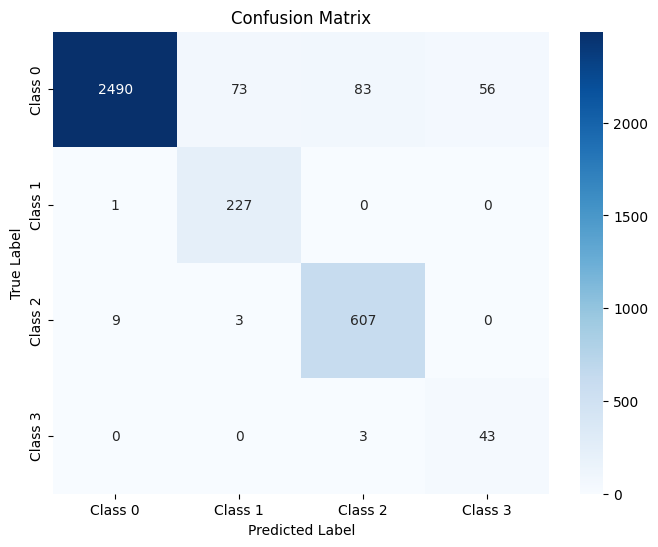

The function took 0.3424 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.93      0.96      3378
     Class 1       0.77      0.99      0.87       285
     Class 2       0.91      0.98      0.94       774
     Class 3       0.41      0.91      0.57        57

    accuracy                           0.94      4494
   macro avg       0.77      0.95      0.83      4494
weighted avg       0.96      0.94      0.95      4494



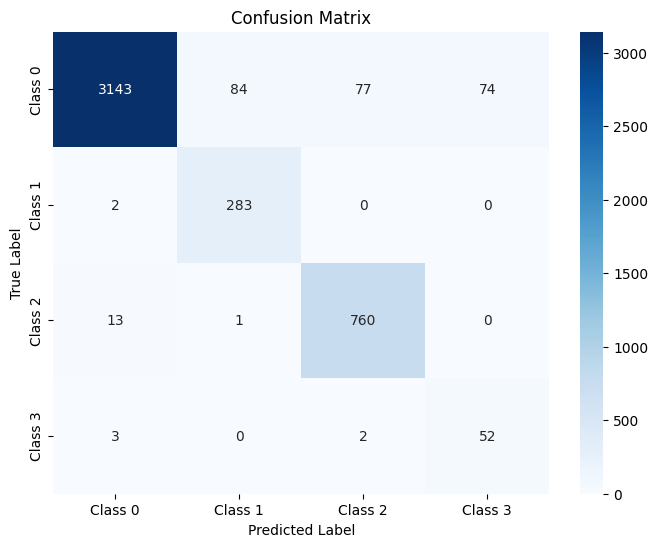

The function took 0.3740 seconds to execute.
[ARCH#173-[32, 16, 4, 4, 2]] done in 35.5s  best-val=1.3794


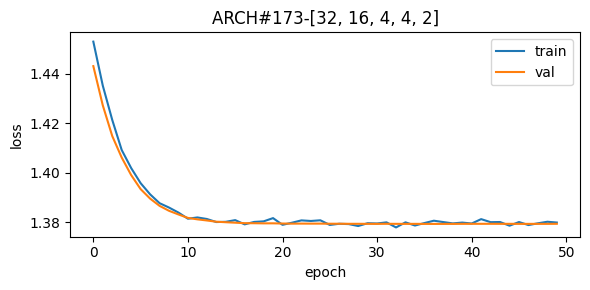


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86     10808
     Class 1       0.00      0.00      0.00       914
     Class 2       0.00      0.00      0.00      2475
     Class 3       0.00      0.00      0.00       182

    accuracy                           0.75     14379
   macro avg       0.19      0.25      0.21     14379
weighted avg       0.56      0.75      0.65     14379



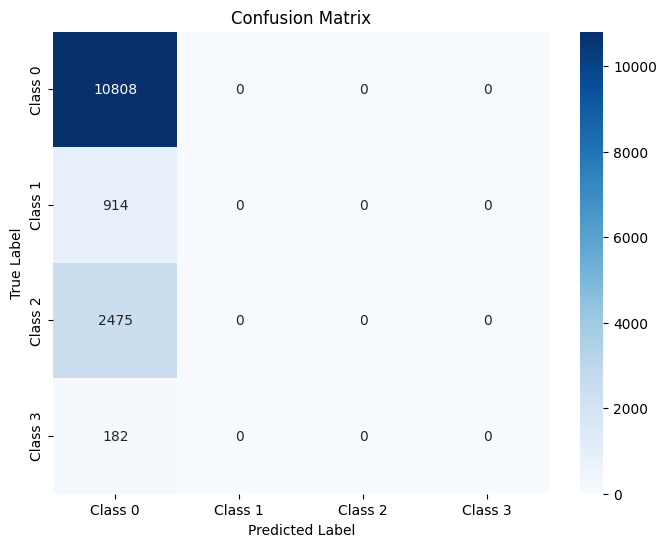

The function took 0.6739 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86      2702
     Class 1       0.00      0.00      0.00       228
     Class 2       0.00      0.00      0.00       619
     Class 3       0.00      0.00      0.00        46

    accuracy                           0.75      3595
   macro avg       0.19      0.25      0.21      3595
weighted avg       0.56      0.75      0.65      3595



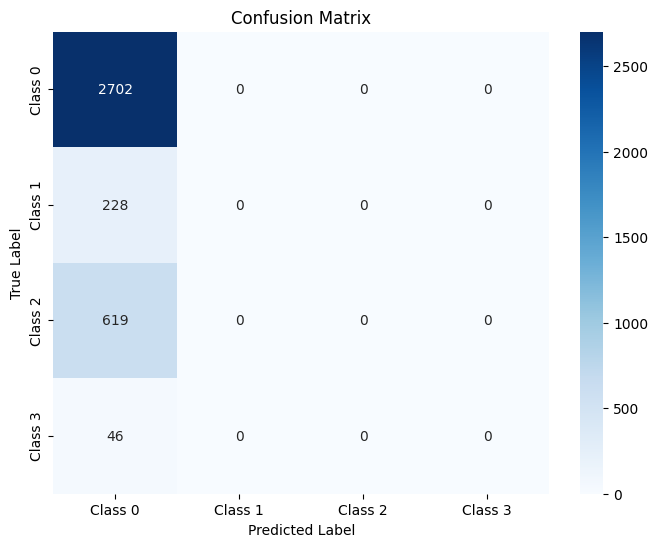

The function took 0.4822 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86      3378
     Class 1       0.00      0.00      0.00       285
     Class 2       0.00      0.00      0.00       774
     Class 3       0.00      0.00      0.00        57

    accuracy                           0.75      4494
   macro avg       0.19      0.25      0.21      4494
weighted avg       0.57      0.75      0.65      4494



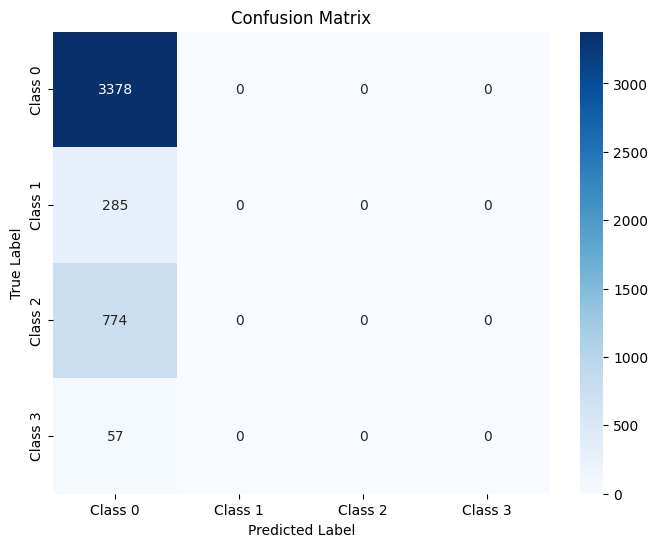

The function took 0.3915 seconds to execute.
[ARCH#174-[32, 16, 4, 2, 2]] done in 35.1s  best-val=0.2974


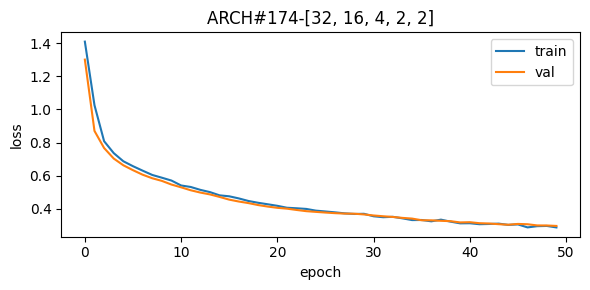


Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.87      0.93     10808
     Class 1       0.79      1.00      0.88       914
     Class 2       0.97      0.86      0.91      2475
     Class 3       0.11      0.99      0.20       182

    accuracy                           0.88     14379
   macro avg       0.72      0.93      0.73     14379
weighted avg       0.97      0.88      0.92     14379



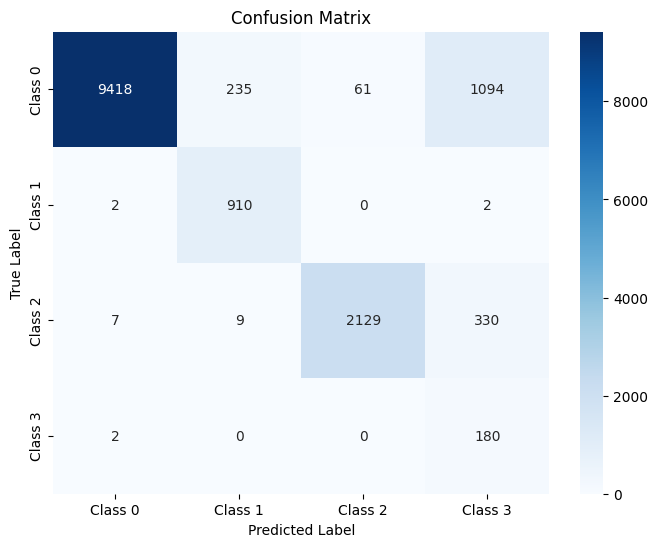

The function took 0.7908 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.88      0.94      2702
     Class 1       0.77      0.99      0.87       228
     Class 2       0.99      0.88      0.93       619
     Class 3       0.12      1.00      0.22        46

    accuracy                           0.89      3595
   macro avg       0.72      0.94      0.74      3595
weighted avg       0.97      0.89      0.92      3595



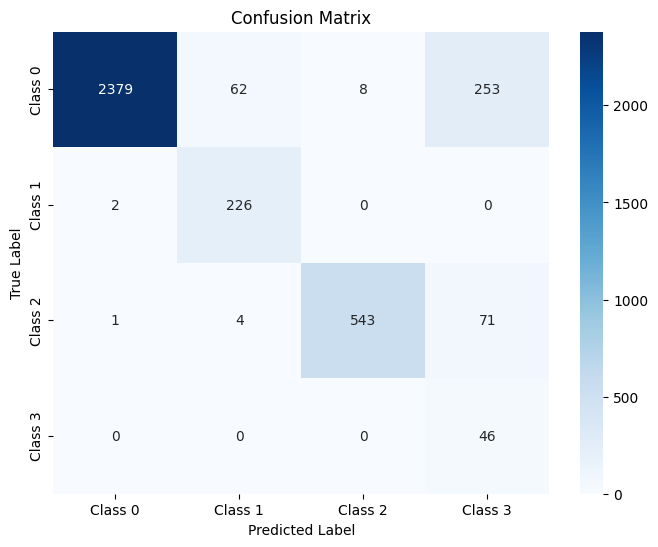

The function took 0.3497 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.88      0.93      3378
     Class 1       0.80      0.98      0.88       285
     Class 2       0.97      0.84      0.90       774
     Class 3       0.11      0.96      0.20        57

    accuracy                           0.88      4494
   macro avg       0.72      0.92      0.73      4494
weighted avg       0.97      0.88      0.92      4494



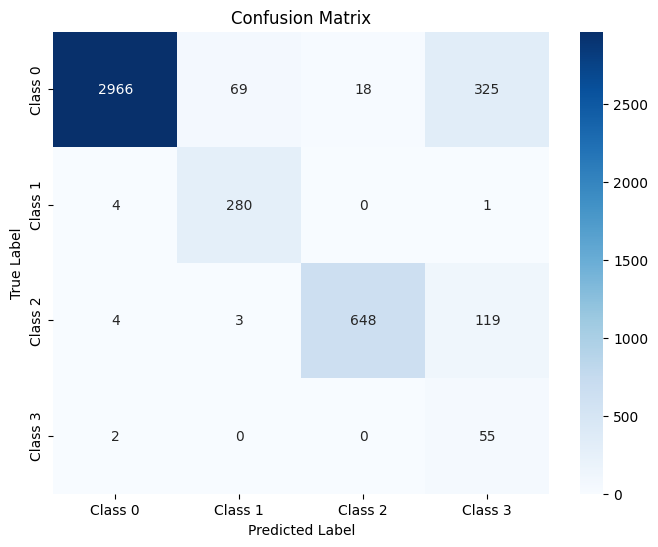

The function took 0.3862 seconds to execute.
[ARCH#175-[32, 16, 2, 2, 2]] done in 35.3s  best-val=0.4759


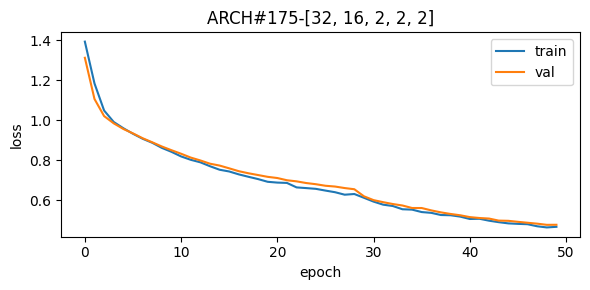


Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.94      0.97     10808
     Class 1       0.71      1.00      0.83       914
     Class 2       0.85      0.98      0.91      2475
     Class 3       0.00      0.00      0.00       182

    accuracy                           0.94     14379
   macro avg       0.64      0.73      0.68     14379
weighted avg       0.94      0.94      0.94     14379



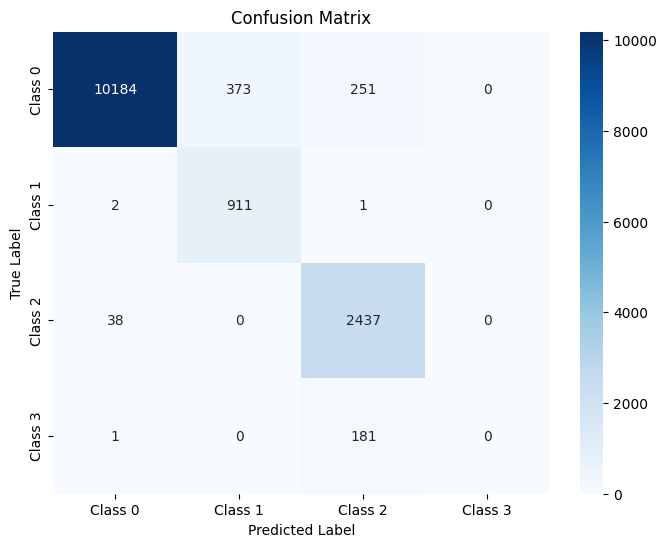

The function took 0.7947 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.94      0.97      2702
     Class 1       0.70      1.00      0.83       228
     Class 2       0.83      0.98      0.90       619
     Class 3       0.00      0.00      0.00        46

    accuracy                           0.94      3595
   macro avg       0.63      0.73      0.67      3595
weighted avg       0.94      0.94      0.93      3595



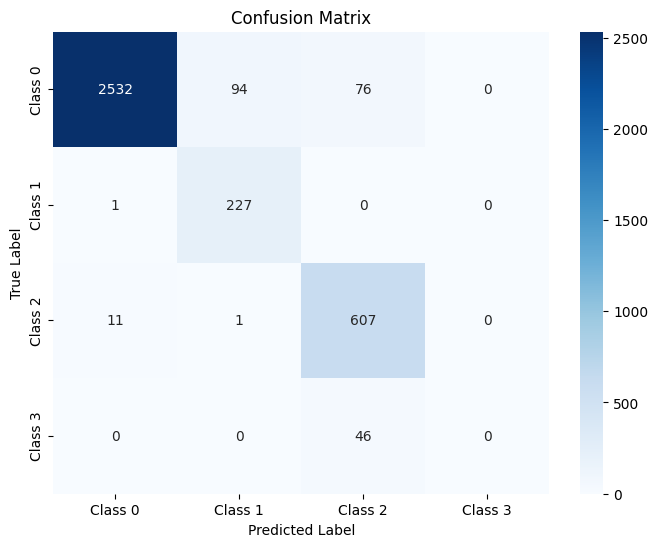

The function took 0.3660 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.94      0.97      3378
     Class 1       0.71      0.99      0.83       285
     Class 2       0.85      0.98      0.91       774
     Class 3       0.00      0.00      0.00        57

    accuracy                           0.94      4494
   macro avg       0.64      0.73      0.68      4494
weighted avg       0.94      0.94      0.94      4494



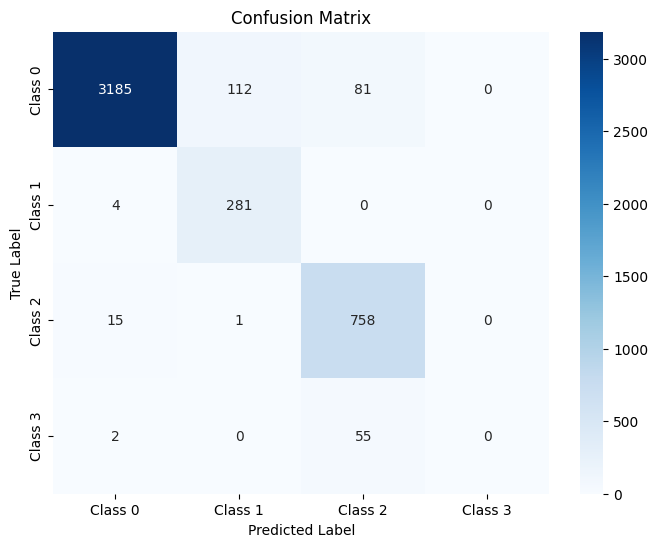

The function took 0.8318 seconds to execute.
[ARCH#176-[32, 8, 8, 8, 8]] done in 36.0s  best-val=0.0911


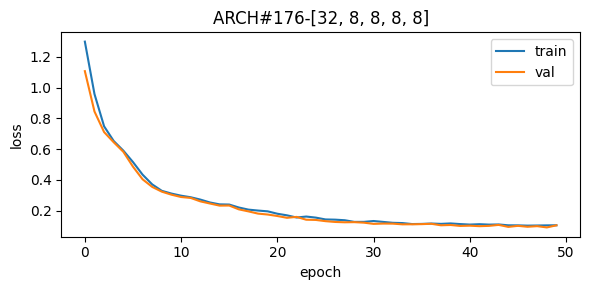


Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.93      0.96     10808
     Class 1       0.77      1.00      0.87       914
     Class 2       0.87      0.99      0.93      2475
     Class 3       0.50      0.93      0.65       182

    accuracy                           0.94     14379
   macro avg       0.78      0.96      0.85     14379
weighted avg       0.95      0.94      0.94     14379



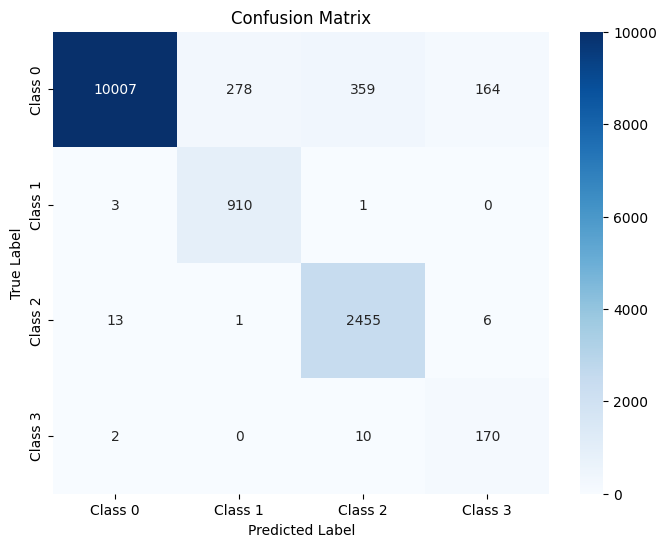

The function took 0.7893 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.93      0.96      2702
     Class 1       0.76      0.99      0.86       228
     Class 2       0.86      0.99      0.92       619
     Class 3       0.57      0.93      0.71        46

    accuracy                           0.94      3595
   macro avg       0.80      0.96      0.86      3595
weighted avg       0.95      0.94      0.94      3595



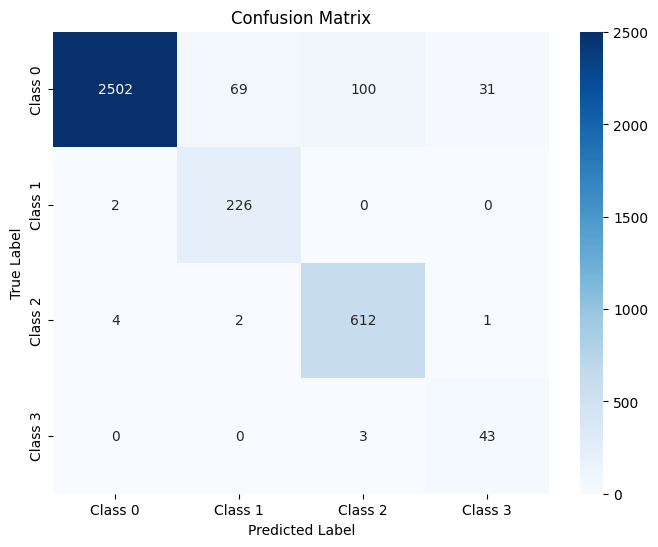

The function took 0.4060 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.92      0.96      3378
     Class 1       0.77      0.99      0.87       285
     Class 2       0.87      0.99      0.92       774
     Class 3       0.46      0.95      0.62        57

    accuracy                           0.94      4494
   macro avg       0.77      0.96      0.84      4494
weighted avg       0.95      0.94      0.94      4494



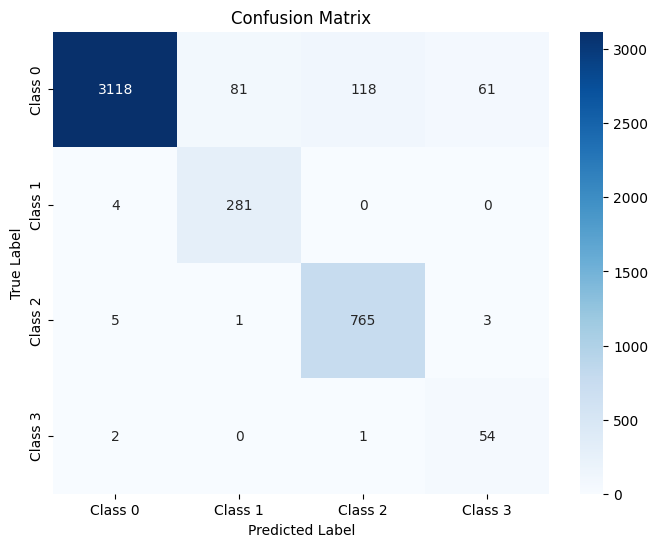

The function took 0.4810 seconds to execute.
[ARCH#177-[32, 8, 8, 8, 4]] done in 35.8s  best-val=0.1305


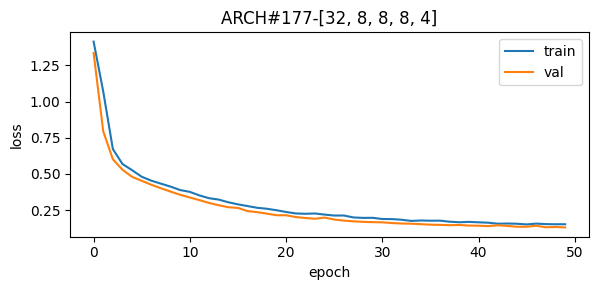


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.93      0.96     10808
     Class 1       0.75      1.00      0.85       914
     Class 2       0.89      0.92      0.90      2475
     Class 3       0.43      0.95      0.59       182

    accuracy                           0.93     14379
   macro avg       0.76      0.95      0.83     14379
weighted avg       0.95      0.93      0.94     14379



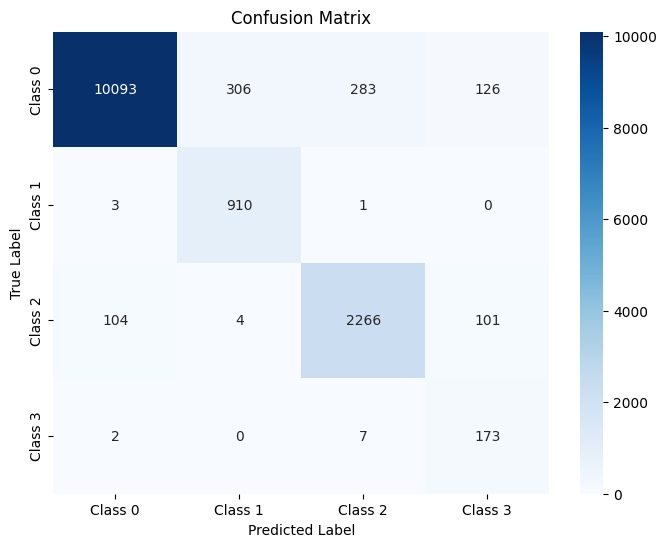

The function took 0.6840 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.93      0.96      2702
     Class 1       0.76      1.00      0.86       228
     Class 2       0.87      0.93      0.90       619
     Class 3       0.43      0.96      0.59        46

    accuracy                           0.94      3595
   macro avg       0.76      0.95      0.83      3595
weighted avg       0.95      0.94      0.94      3595



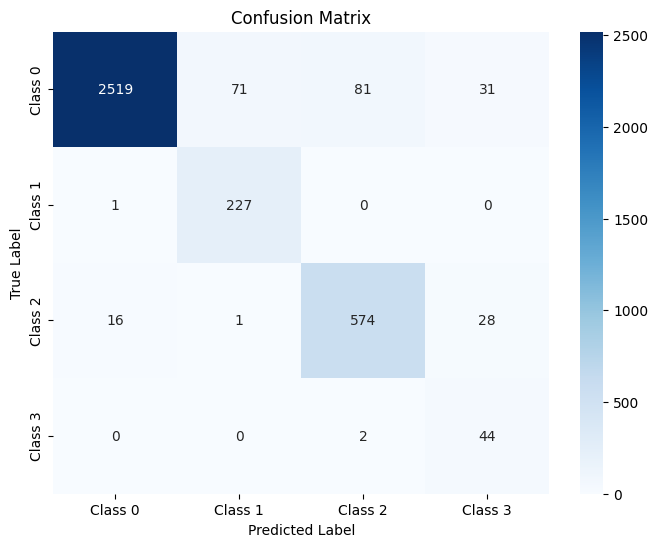

The function took 0.5146 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.93      0.96      3378
     Class 1       0.74      0.99      0.85       285
     Class 2       0.89      0.89      0.89       774
     Class 3       0.36      0.95      0.53        57

    accuracy                           0.93      4494
   macro avg       0.74      0.94      0.81      4494
weighted avg       0.95      0.93      0.93      4494



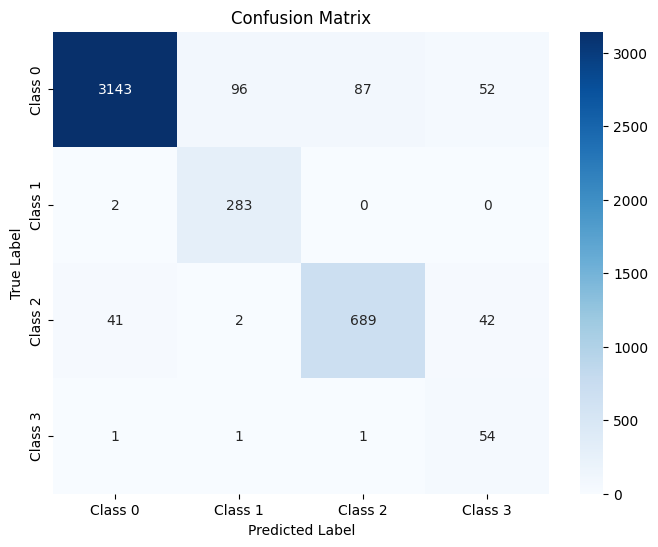

The function took 0.4677 seconds to execute.
[ARCH#178-[32, 8, 8, 8, 2]] done in 35.6s  best-val=0.2145


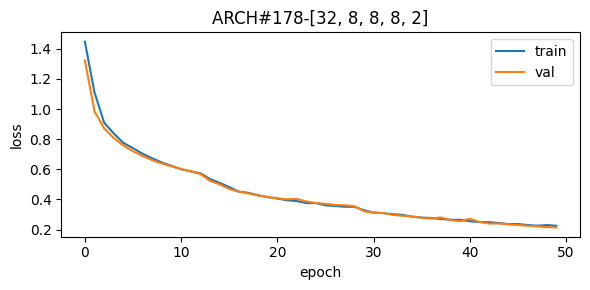


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.97      0.97      0.97     10808
     Class 1       0.86      0.95      0.90       914
     Class 2       1.00      0.86      0.92      2475
     Class 3       0.41      0.99      0.58       182

    accuracy                           0.95     14379
   macro avg       0.81      0.94      0.85     14379
weighted avg       0.96      0.95      0.95     14379



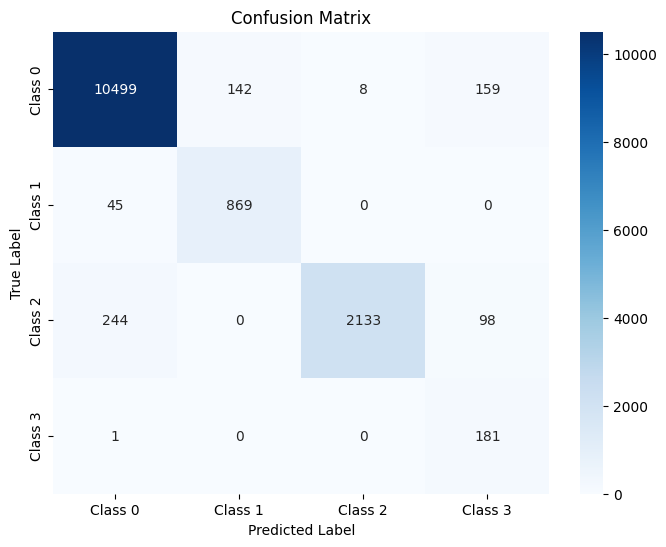

The function took 0.6769 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.97      0.97      2702
     Class 1       0.83      0.93      0.88       228
     Class 2       1.00      0.88      0.93       619
     Class 3       0.43      1.00      0.60        46

    accuracy                           0.95      3595
   macro avg       0.81      0.94      0.85      3595
weighted avg       0.96      0.95      0.96      3595



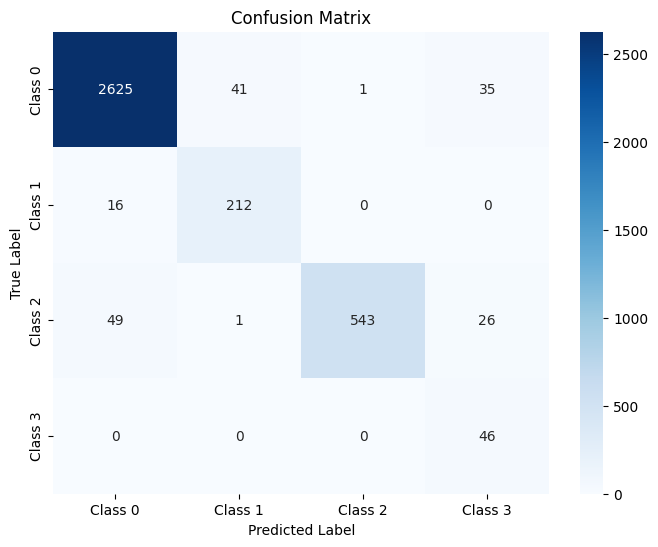

The function took 0.4702 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.97      0.97      0.97      3378
     Class 1       0.84      0.93      0.88       285
     Class 2       1.00      0.84      0.91       774
     Class 3       0.39      1.00      0.56        57

    accuracy                           0.95      4494
   macro avg       0.80      0.93      0.83      4494
weighted avg       0.96      0.95      0.95      4494



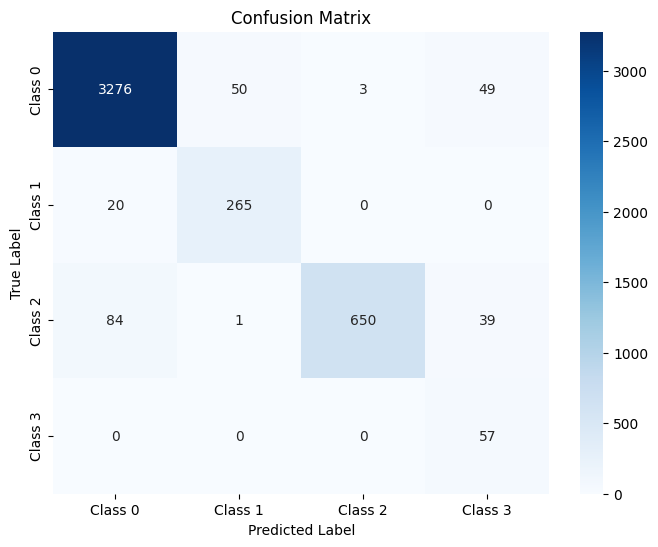

The function took 0.4656 seconds to execute.
[ARCH#179-[32, 8, 8, 4, 4]] done in 35.4s  best-val=0.1216


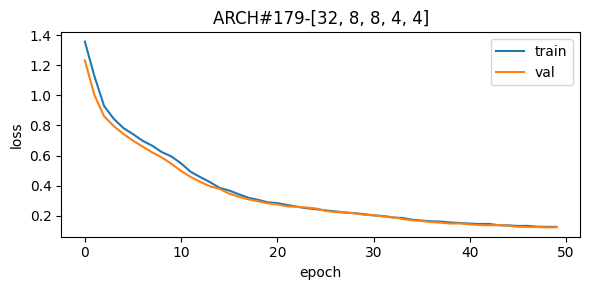


Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.94      0.97     10808
     Class 1       0.82      1.00      0.90       914
     Class 2       0.89      0.98      0.93      2475
     Class 3       0.54      0.93      0.68       182

    accuracy                           0.95     14379
   macro avg       0.81      0.96      0.87     14379
weighted avg       0.96      0.95      0.95     14379



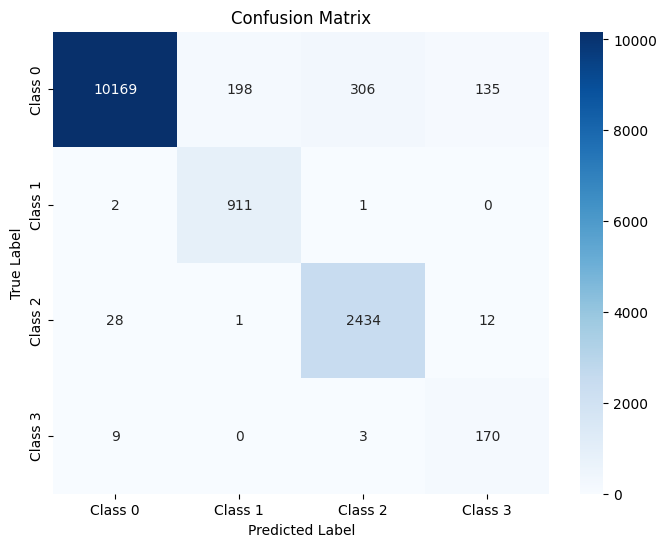

The function took 0.6655 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.94      0.97      2702
     Class 1       0.82      0.99      0.90       228
     Class 2       0.89      0.97      0.93       619
     Class 3       0.57      0.93      0.70        46

    accuracy                           0.95      3595
   macro avg       0.82      0.96      0.87      3595
weighted avg       0.96      0.95      0.95      3595



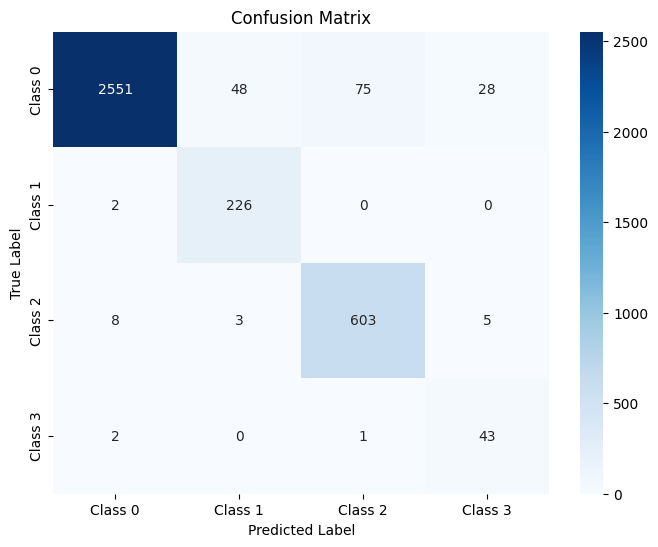

The function took 0.4906 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.94      0.97      3378
     Class 1       0.83      0.99      0.90       285
     Class 2       0.90      0.98      0.94       774
     Class 3       0.49      0.93      0.64        57

    accuracy                           0.95      4494
   macro avg       0.80      0.96      0.86      4494
weighted avg       0.96      0.95      0.96      4494



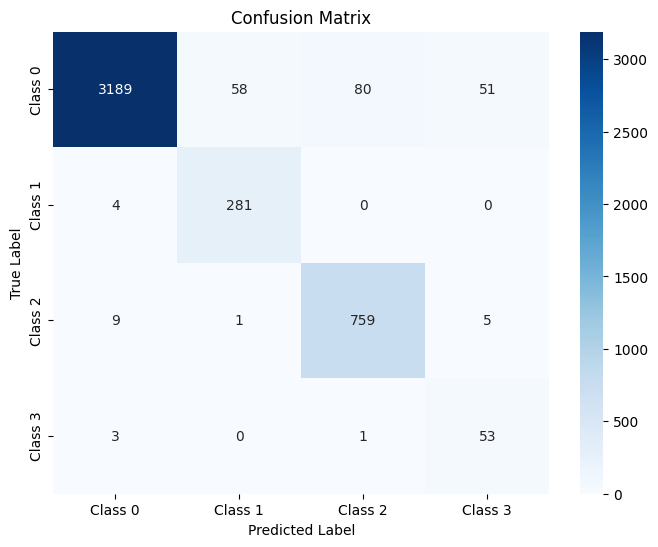

The function took 0.3752 seconds to execute.
[ARCH#180-[32, 8, 8, 4, 2]] early-stop @ epoch 044
[ARCH#180-[32, 8, 8, 4, 2]] done in 32.1s  best-val=1.3794


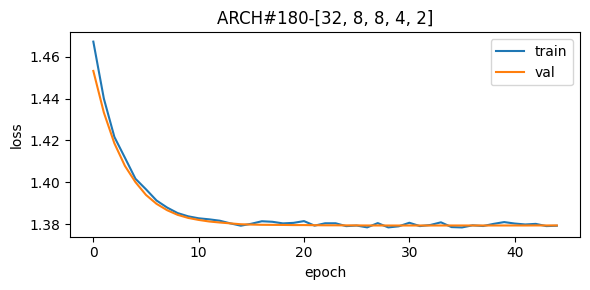


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86     10808
     Class 1       0.00      0.00      0.00       914
     Class 2       0.00      0.00      0.00      2475
     Class 3       0.00      0.00      0.00       182

    accuracy                           0.75     14379
   macro avg       0.19      0.25      0.21     14379
weighted avg       0.56      0.75      0.65     14379



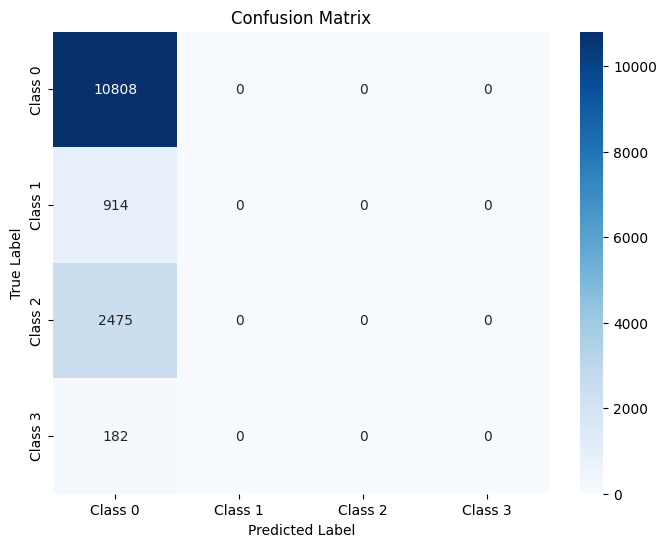

The function took 0.7763 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86      2702
     Class 1       0.00      0.00      0.00       228
     Class 2       0.00      0.00      0.00       619
     Class 3       0.00      0.00      0.00        46

    accuracy                           0.75      3595
   macro avg       0.19      0.25      0.21      3595
weighted avg       0.56      0.75      0.65      3595



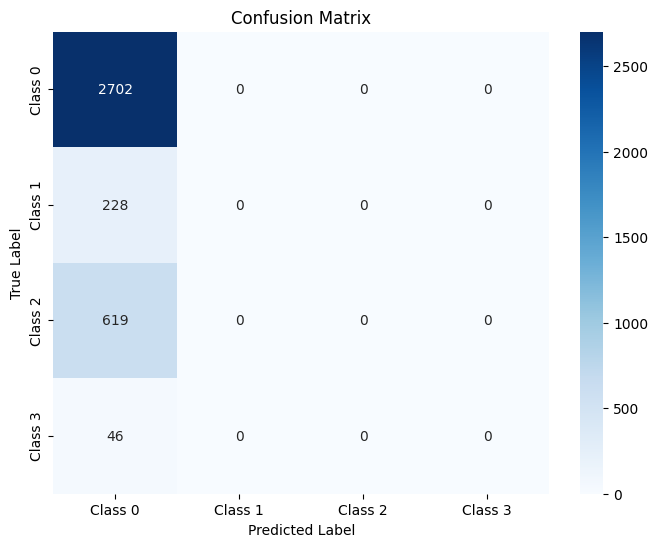

The function took 0.3519 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86      3378
     Class 1       0.00      0.00      0.00       285
     Class 2       0.00      0.00      0.00       774
     Class 3       0.00      0.00      0.00        57

    accuracy                           0.75      4494
   macro avg       0.19      0.25      0.21      4494
weighted avg       0.57      0.75      0.65      4494



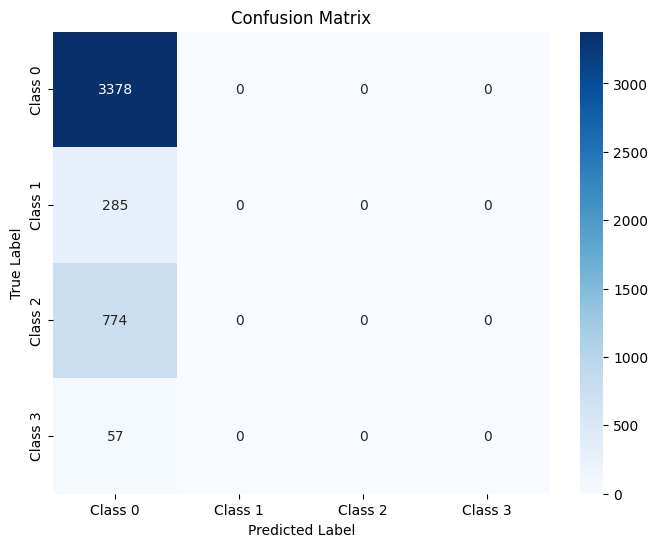

The function took 0.4023 seconds to execute.
[ARCH#181-[32, 8, 8, 2, 2]] early-stop @ epoch 049
[ARCH#181-[32, 8, 8, 2, 2]] done in 35.1s  best-val=1.3794


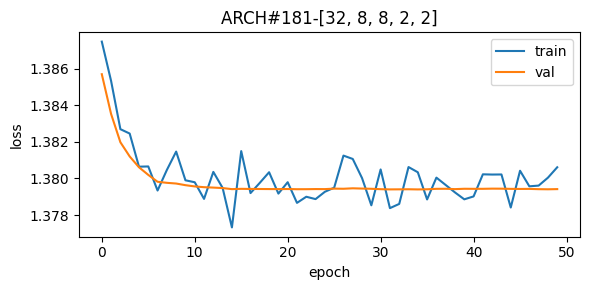


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86     10808
     Class 1       0.00      0.00      0.00       914
     Class 2       0.00      0.00      0.00      2475
     Class 3       0.00      0.00      0.00       182

    accuracy                           0.75     14379
   macro avg       0.19      0.25      0.21     14379
weighted avg       0.56      0.75      0.65     14379



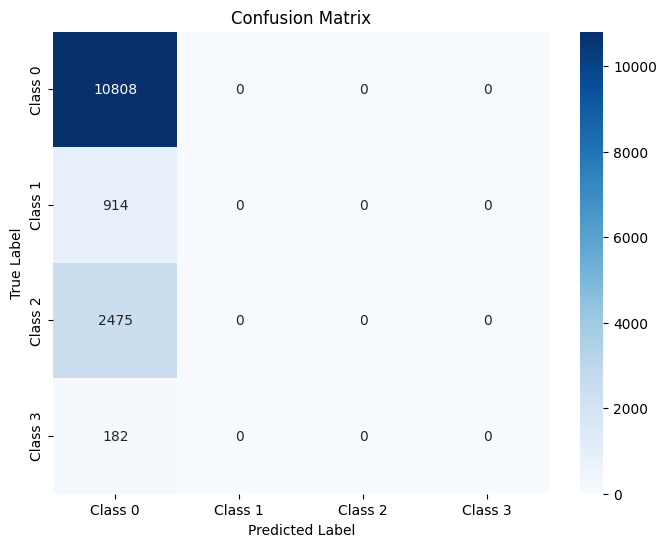

The function took 0.7232 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86      2702
     Class 1       0.00      0.00      0.00       228
     Class 2       0.00      0.00      0.00       619
     Class 3       0.00      0.00      0.00        46

    accuracy                           0.75      3595
   macro avg       0.19      0.25      0.21      3595
weighted avg       0.56      0.75      0.65      3595



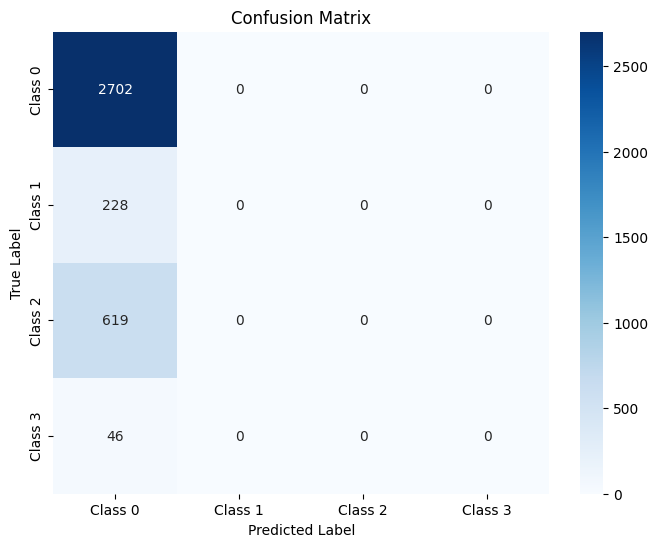

The function took 0.4344 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86      3378
     Class 1       0.00      0.00      0.00       285
     Class 2       0.00      0.00      0.00       774
     Class 3       0.00      0.00      0.00        57

    accuracy                           0.75      4494
   macro avg       0.19      0.25      0.21      4494
weighted avg       0.57      0.75      0.65      4494



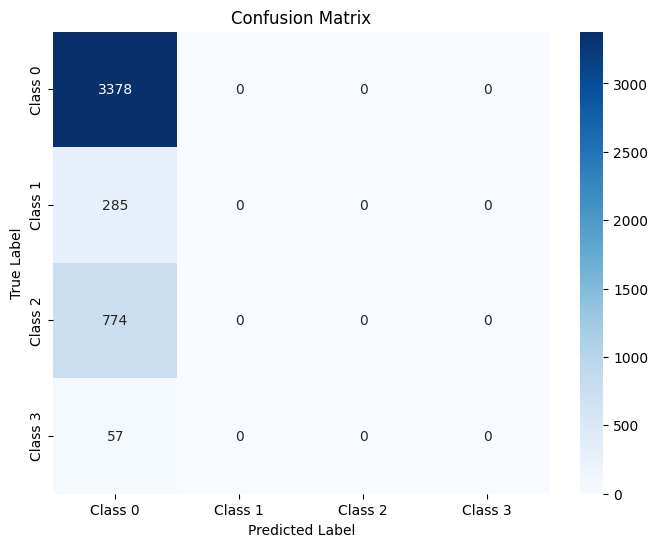

The function took 0.3860 seconds to execute.
[ARCH#182-[32, 8, 4, 4, 4]] done in 34.9s  best-val=0.1417


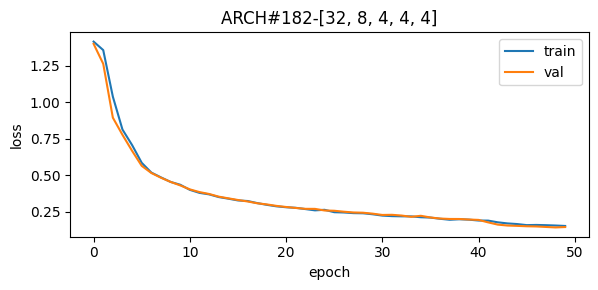


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.94      0.97     10808
     Class 1       0.79      1.00      0.88       914
     Class 2       0.86      0.96      0.91      2475
     Class 3       0.85      0.90      0.87       182

    accuracy                           0.95     14379
   macro avg       0.87      0.95      0.91     14379
weighted avg       0.95      0.95      0.95     14379



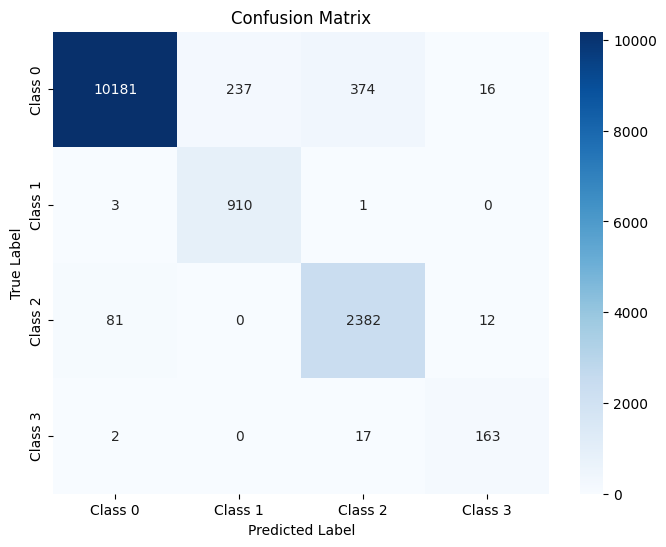

The function took 0.6471 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.94      0.97      2702
     Class 1       0.80      1.00      0.89       228
     Class 2       0.86      0.97      0.91       619
     Class 3       0.82      0.89      0.85        46

    accuracy                           0.95      3595
   macro avg       0.87      0.95      0.90      3595
weighted avg       0.95      0.95      0.95      3595



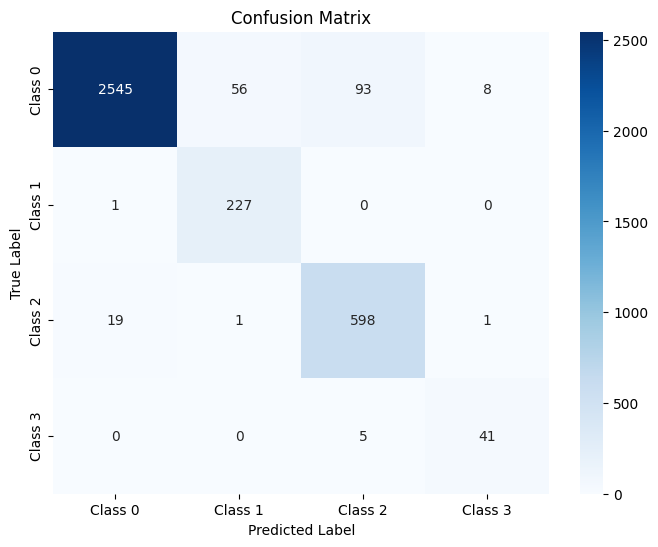

The function took 0.4869 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.94      0.97      3378
     Class 1       0.80      0.99      0.89       285
     Class 2       0.86      0.95      0.91       774
     Class 3       0.74      0.89      0.81        57

    accuracy                           0.95      4494
   macro avg       0.85      0.94      0.89      4494
weighted avg       0.95      0.95      0.95      4494



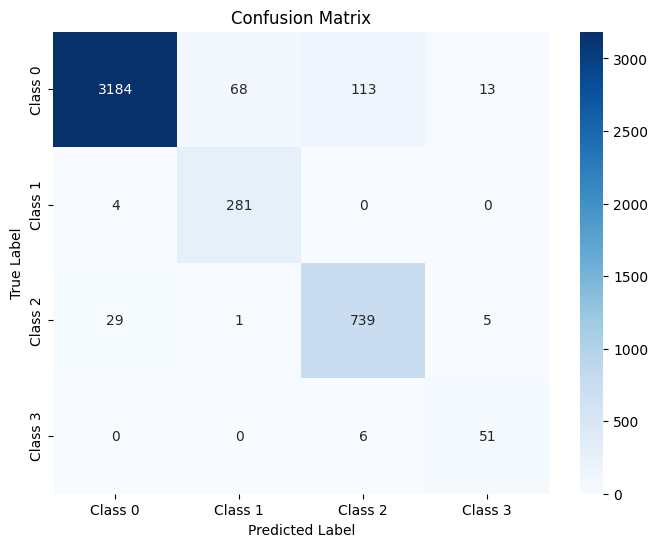

The function took 0.7305 seconds to execute.
[ARCH#183-[32, 8, 4, 4, 2]] done in 35.5s  best-val=0.2581


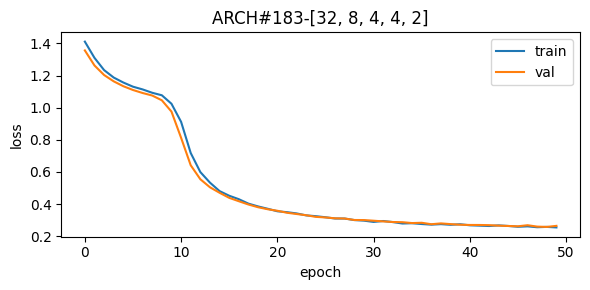


Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.84      0.92     10808
     Class 1       0.87      0.96      0.91       914
     Class 2       0.82      0.98      0.89      2475
     Class 3       0.13      0.93      0.23       182

    accuracy                           0.88     14379
   macro avg       0.71      0.93      0.74     14379
weighted avg       0.95      0.88      0.90     14379



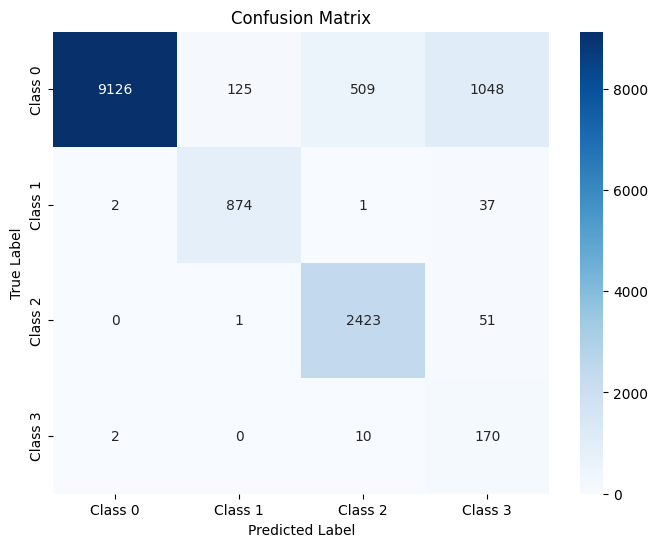

The function took 0.7939 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.86      0.92      2702
     Class 1       0.85      0.94      0.89       228
     Class 2       0.82      0.99      0.90       619
     Class 3       0.15      0.93      0.26        46

    accuracy                           0.89      3595
   macro avg       0.71      0.93      0.74      3595
weighted avg       0.95      0.89      0.91      3595



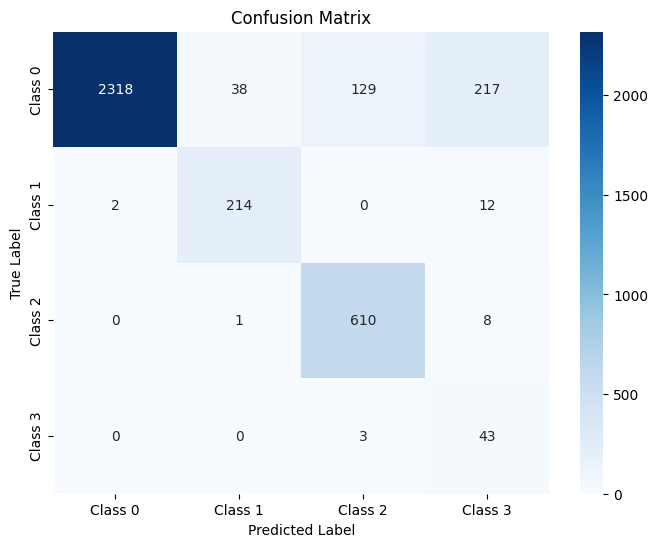

The function took 0.3410 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.84      0.91      3378
     Class 1       0.85      0.94      0.89       285
     Class 2       0.84      0.98      0.90       774
     Class 3       0.12      0.93      0.22        57

    accuracy                           0.87      4494
   macro avg       0.70      0.92      0.73      4494
weighted avg       0.95      0.87      0.90      4494



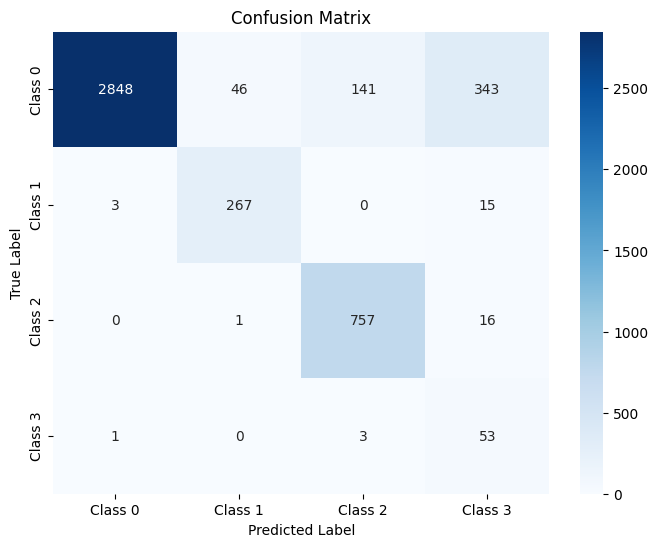

The function took 0.5193 seconds to execute.
[ARCH#184-[32, 8, 4, 2, 2]] done in 36.2s  best-val=1.3794


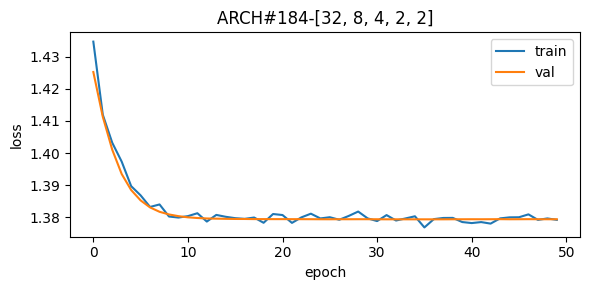


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86     10808
     Class 1       0.00      0.00      0.00       914
     Class 2       0.00      0.00      0.00      2475
     Class 3       0.00      0.00      0.00       182

    accuracy                           0.75     14379
   macro avg       0.19      0.25      0.21     14379
weighted avg       0.56      0.75      0.65     14379



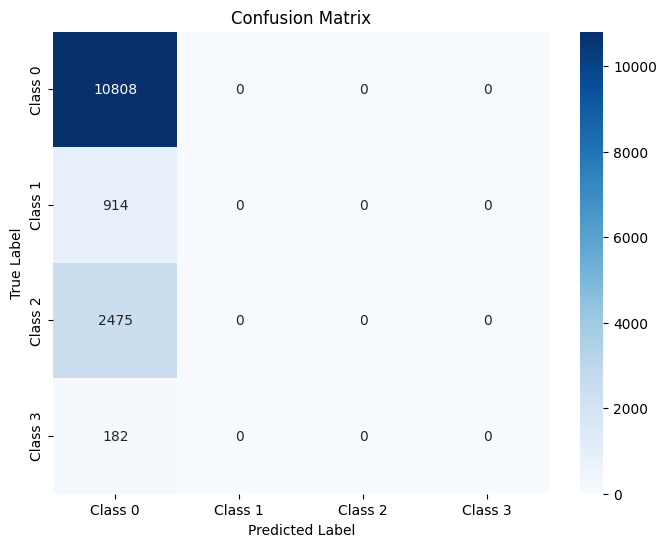

The function took 0.6955 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86      2702
     Class 1       0.00      0.00      0.00       228
     Class 2       0.00      0.00      0.00       619
     Class 3       0.00      0.00      0.00        46

    accuracy                           0.75      3595
   macro avg       0.19      0.25      0.21      3595
weighted avg       0.56      0.75      0.65      3595



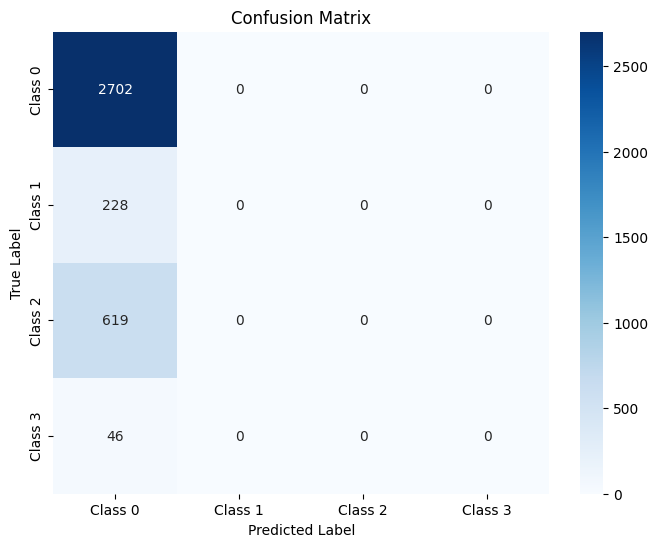

The function took 0.3484 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86      3378
     Class 1       0.00      0.00      0.00       285
     Class 2       0.00      0.00      0.00       774
     Class 3       0.00      0.00      0.00        57

    accuracy                           0.75      4494
   macro avg       0.19      0.25      0.21      4494
weighted avg       0.57      0.75      0.65      4494



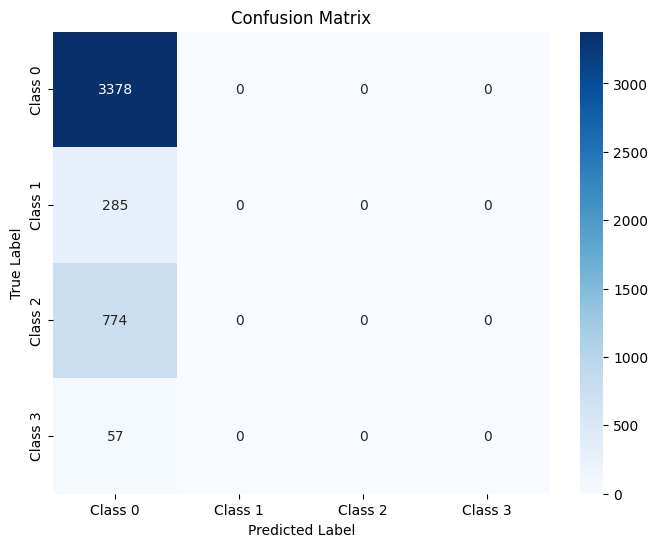

The function took 0.5412 seconds to execute.
[ARCH#185-[32, 8, 2, 2, 2]] done in 35.5s  best-val=0.4937


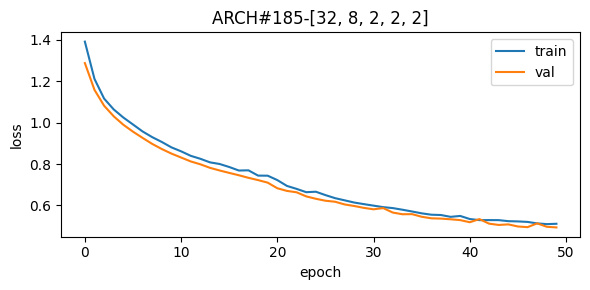


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.97      0.94      0.96     10808
     Class 1       0.65      1.00      0.79       914
     Class 2       0.90      0.88      0.89      2475
     Class 3       0.03      0.02      0.03       182

    accuracy                           0.92     14379
   macro avg       0.64      0.71      0.66     14379
weighted avg       0.93      0.92      0.92     14379



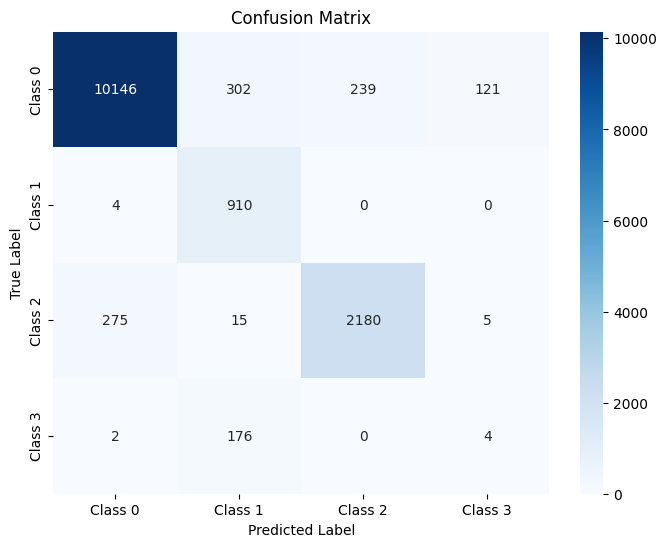

The function took 0.6879 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.94      0.96      2702
     Class 1       0.65      0.99      0.79       228
     Class 2       0.92      0.89      0.91       619
     Class 3       0.03      0.02      0.03        46

    accuracy                           0.93      3595
   macro avg       0.64      0.71      0.67      3595
weighted avg       0.93      0.93      0.93      3595



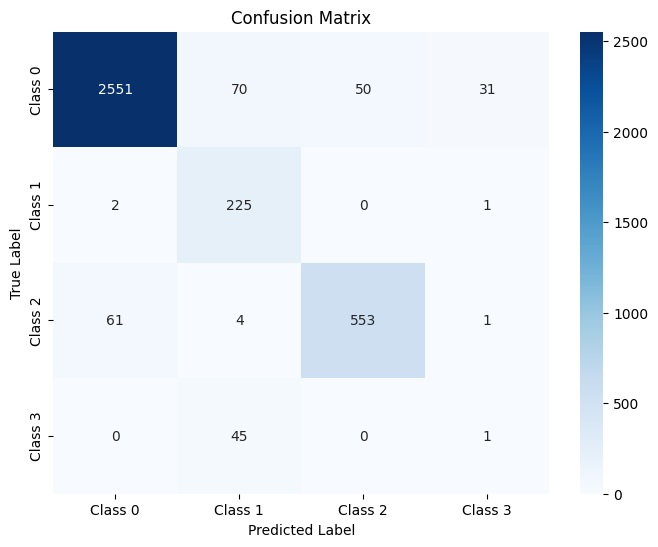

The function took 0.4110 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.97      0.94      0.95      3378
     Class 1       0.64      0.99      0.78       285
     Class 2       0.89      0.86      0.87       774
     Class 3       0.00      0.00      0.00        57

    accuracy                           0.91      4494
   macro avg       0.62      0.69      0.65      4494
weighted avg       0.92      0.91      0.92      4494



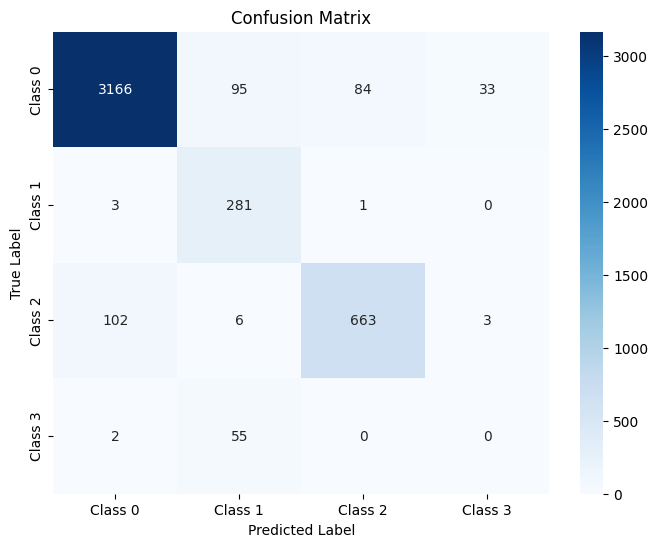

The function took 0.4320 seconds to execute.
[ARCH#186-[32, 4, 4, 4, 4]] done in 35.7s  best-val=0.1313


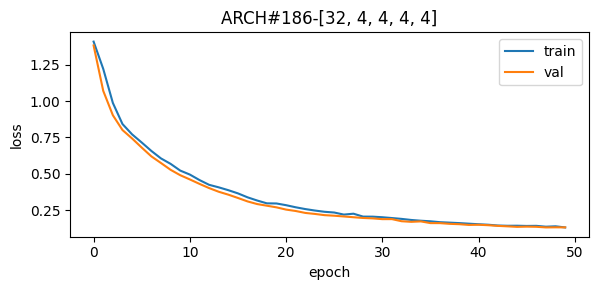


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.94      0.96     10808
     Class 1       0.83      0.96      0.89       914
     Class 2       0.87      0.95      0.91      2475
     Class 3       0.53      0.96      0.68       182

    accuracy                           0.94     14379
   macro avg       0.80      0.95      0.86     14379
weighted avg       0.95      0.94      0.94     14379



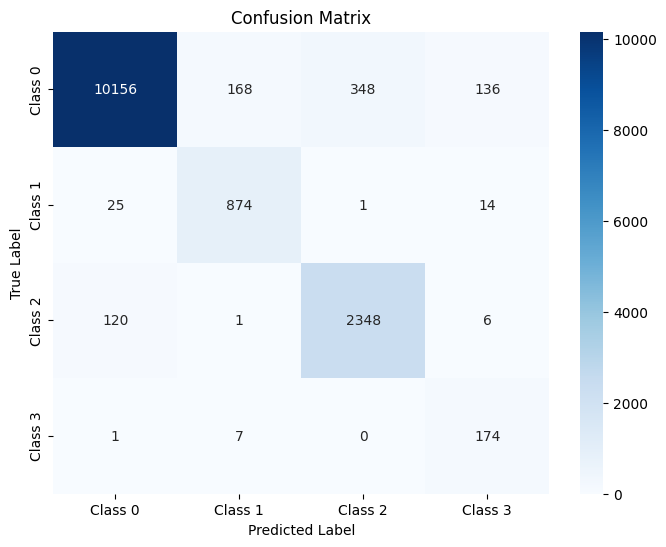

The function took 0.7798 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.94      0.96      2702
     Class 1       0.84      0.94      0.89       228
     Class 2       0.86      0.95      0.90       619
     Class 3       0.52      0.96      0.68        46

    accuracy                           0.94      3595
   macro avg       0.80      0.95      0.86      3595
weighted avg       0.95      0.94      0.94      3595



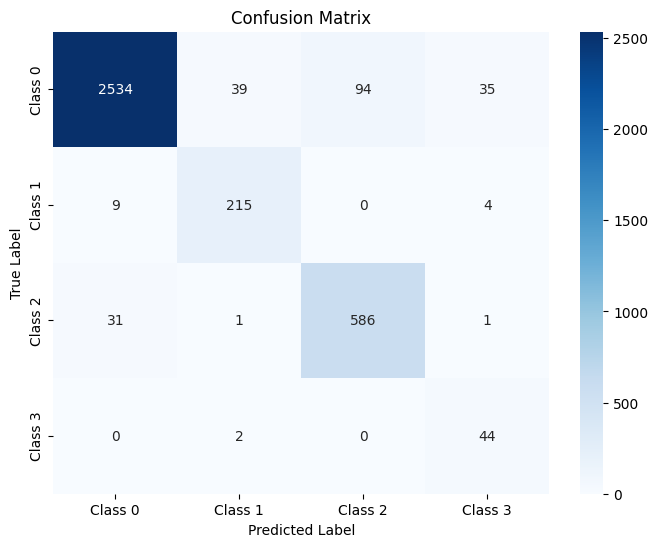

The function took 0.3433 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.94      0.96      3378
     Class 1       0.85      0.94      0.89       285
     Class 2       0.87      0.94      0.90       774
     Class 3       0.54      0.91      0.68        57

    accuracy                           0.94      4494
   macro avg       0.81      0.93      0.86      4494
weighted avg       0.95      0.94      0.94      4494



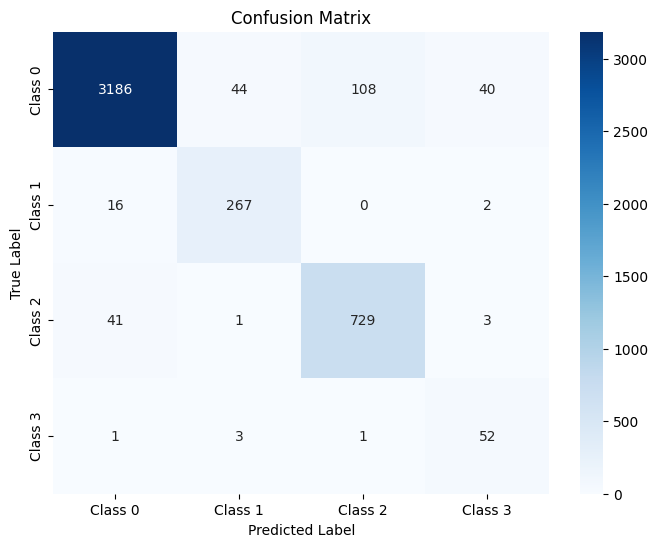

The function took 0.3773 seconds to execute.
[ARCH#187-[32, 4, 4, 4, 2]] early-stop @ epoch 028
[ARCH#187-[32, 4, 4, 4, 2]] done in 21.6s  best-val=1.3794


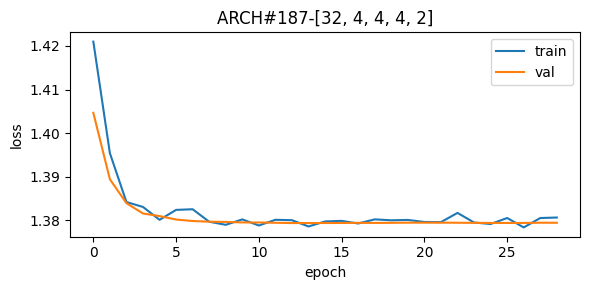


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86     10808
     Class 1       0.00      0.00      0.00       914
     Class 2       0.00      0.00      0.00      2475
     Class 3       0.00      0.00      0.00       182

    accuracy                           0.75     14379
   macro avg       0.19      0.25      0.21     14379
weighted avg       0.56      0.75      0.65     14379



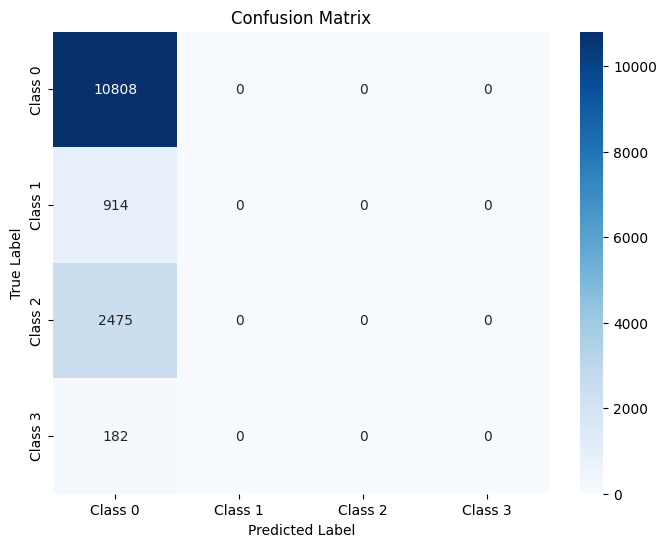

The function took 0.8396 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86      2702
     Class 1       0.00      0.00      0.00       228
     Class 2       0.00      0.00      0.00       619
     Class 3       0.00      0.00      0.00        46

    accuracy                           0.75      3595
   macro avg       0.19      0.25      0.21      3595
weighted avg       0.56      0.75      0.65      3595



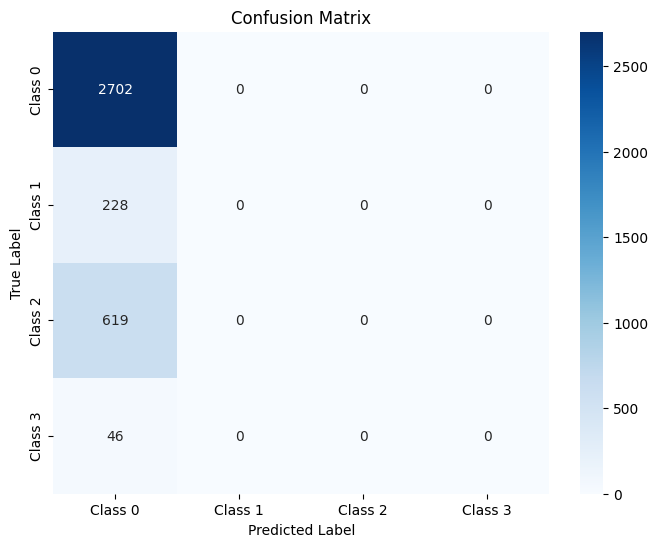

The function took 0.3447 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86      3378
     Class 1       0.00      0.00      0.00       285
     Class 2       0.00      0.00      0.00       774
     Class 3       0.00      0.00      0.00        57

    accuracy                           0.75      4494
   macro avg       0.19      0.25      0.21      4494
weighted avg       0.57      0.75      0.65      4494



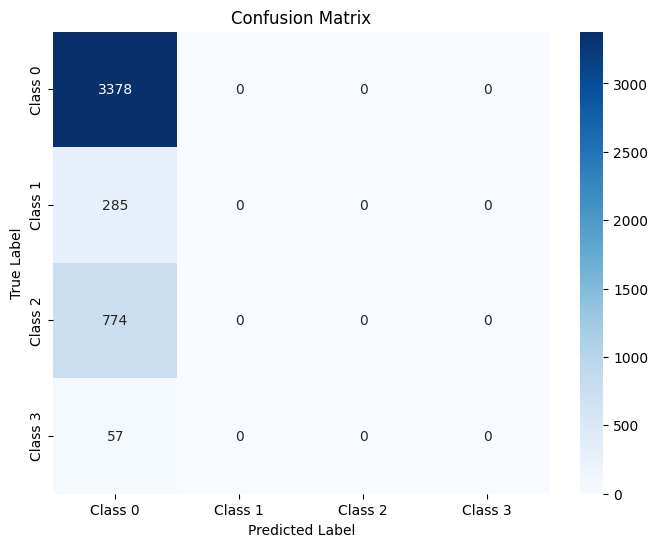

The function took 0.4049 seconds to execute.
[ARCH#188-[32, 4, 4, 2, 2]] done in 36.0s  best-val=0.2571


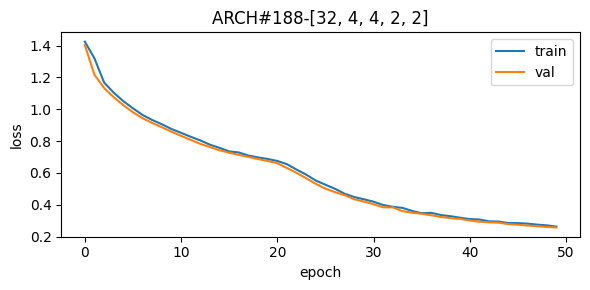


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.89      0.94     10808
     Class 1       0.82      1.00      0.90       914
     Class 2       0.77      0.98      0.86      2475
     Class 3       0.39      0.88      0.54       182

    accuracy                           0.91     14379
   macro avg       0.74      0.94      0.81     14379
weighted avg       0.94      0.91      0.92     14379



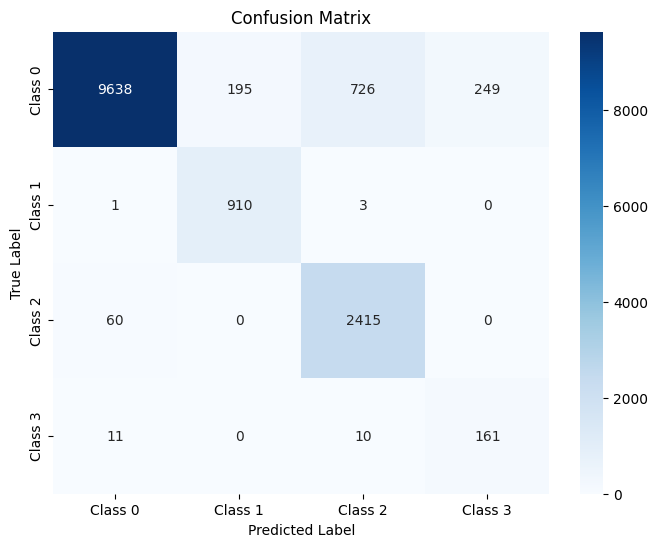

The function took 0.6776 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.90      0.94      2702
     Class 1       0.82      1.00      0.90       228
     Class 2       0.78      0.98      0.87       619
     Class 3       0.40      0.89      0.55        46

    accuracy                           0.92      3595
   macro avg       0.75      0.94      0.82      3595
weighted avg       0.94      0.92      0.92      3595



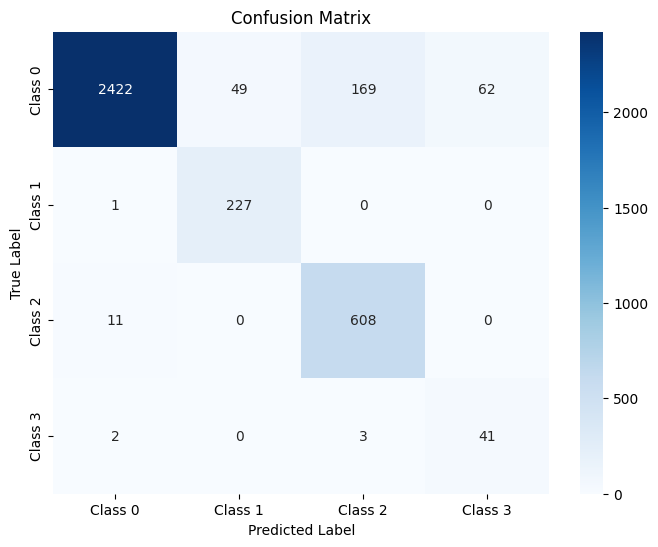

The function took 0.4838 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.89      0.94      3378
     Class 1       0.84      0.99      0.91       285
     Class 2       0.76      0.97      0.85       774
     Class 3       0.37      0.89      0.52        57

    accuracy                           0.91      4494
   macro avg       0.74      0.94      0.81      4494
weighted avg       0.93      0.91      0.92      4494



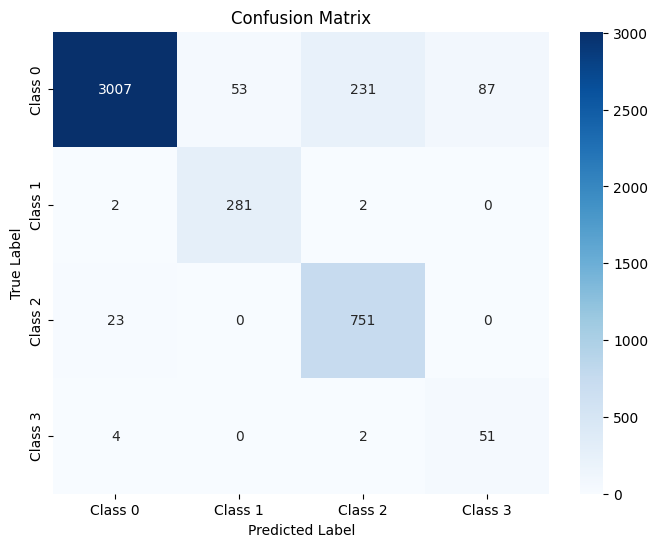

The function took 0.3910 seconds to execute.
[ARCH#189-[32, 4, 2, 2, 2]] early-stop @ epoch 031
[ARCH#189-[32, 4, 2, 2, 2]] done in 23.3s  best-val=1.3794


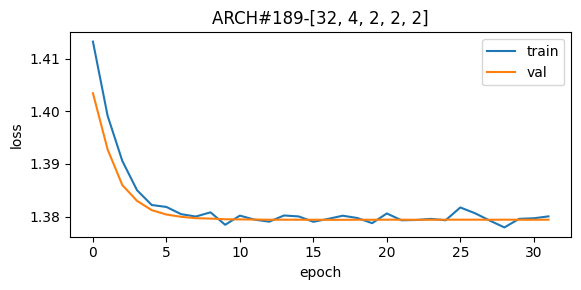


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86     10808
     Class 1       0.00      0.00      0.00       914
     Class 2       0.00      0.00      0.00      2475
     Class 3       0.00      0.00      0.00       182

    accuracy                           0.75     14379
   macro avg       0.19      0.25      0.21     14379
weighted avg       0.56      0.75      0.65     14379



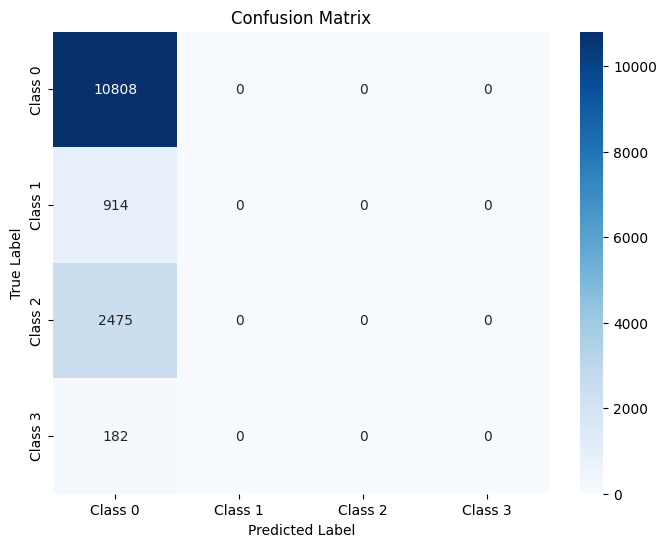

The function took 0.6895 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86      2702
     Class 1       0.00      0.00      0.00       228
     Class 2       0.00      0.00      0.00       619
     Class 3       0.00      0.00      0.00        46

    accuracy                           0.75      3595
   macro avg       0.19      0.25      0.21      3595
weighted avg       0.56      0.75      0.65      3595



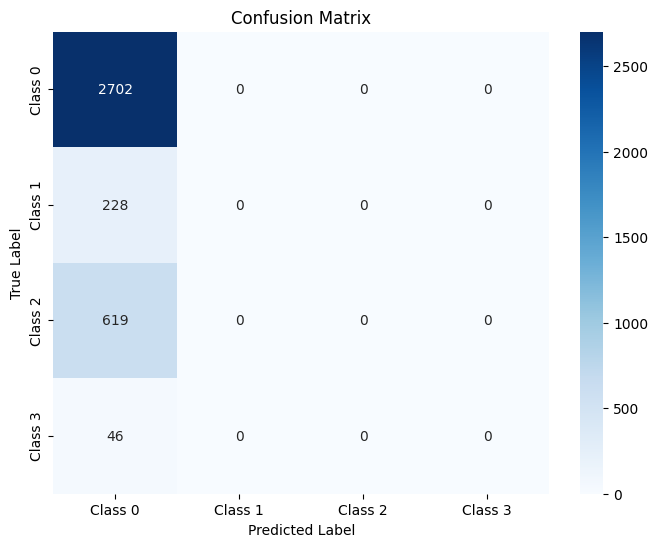

The function took 0.4916 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.75      1.00      0.86      3378
     Class 1       0.00      0.00      0.00       285
     Class 2       0.00      0.00      0.00       774
     Class 3       0.00      0.00      0.00        57

    accuracy                           0.75      4494
   macro avg       0.19      0.25      0.21      4494
weighted avg       0.57      0.75      0.65      4494



In [ ]:
# ---------------- architecture sweep -------------------------------

# Run a small hyper-parameter sweep over fully connected architectures:
#   1. Build a candidate grid of 2-5 hidden layers whose widths monotonically
#      decrease (e.g. 32 -> 16 -> 8).  Each architecture is encoded as a list like
#      [input_dim, 32, 16, 8, n_classes].
#   2. For every architecture:
#        • Instantiate a PlainFFNN with ReLU activations
#        • Train it with AdamW + Cross-Entropy (class-weighted), early-stopping
#          max 50 epochs / 15 patience via `training_loop`
#        • Record accuracy on train, validation and test sets using
#          `testing_model`
#   3. Collect all results in a dict -> transpose to a DataFrame for comparison.
import itertools, torch.nn as nn, torch.optim as optim, numpy as np

input_dim  = X_train_tensor.shape[1]
n_classes  = len(torch.unique(y_train_tensor))

def PlainFFNN(sizes):
    layers=[]
    for a,b in zip(sizes[:-1], sizes[1:]):
        layers += [nn.Linear(a,b), nn.ReLU()]
    layers.pop()
    return nn.Sequential(*layers)

arch_grid = []
for d in range(2,6):
    for widths in itertools.product([32,16,8,4,2], repeat=d):
        if list(widths)==sorted(widths, reverse=True):
            arch_grid.append([input_dim,*widths,n_classes])

results_arch = {}   # {cfg_name : {'train':…, 'val':…, 'test':…}}

for idx, arch in enumerate(arch_grid,1):
    cfg = f"ARCH#{idx:03d}-{arch[1:-1]}"
    net = PlainFFNN(arch)
    opt = optim.AdamW(net.parameters(), lr=5e-4)
    hist, net = training_loop(net, train_loader, val_loader,
                              train_dataset, val_dataset, DEVICE,
                              opt, nn.CrossEntropyLoss(weight=class_weights),
                              max_epochs=50, patience=15,
                              verbose_every=0, cfg_name=cfg)

    tr  = testing_model(net, train_loader, DEVICE)
    vl  = testing_model(net,  val_loader, DEVICE)
    tst = testing_model(net,  test_loader, DEVICE)
    results_arch[cfg] = {'train':tr, 'val':vl, 'test':tst}


pd.DataFrame(results_arch).T


### best - batch-size

[BS=1] done in 1717.0s  best-val=0.0556


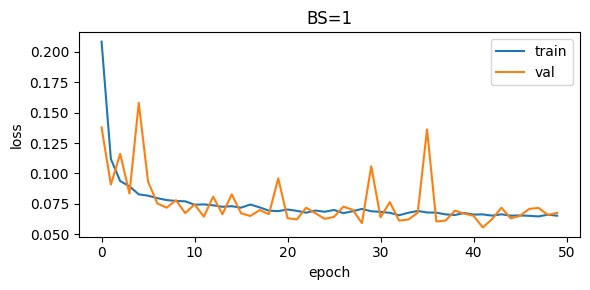


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.99      0.99     10808
     Class 1       0.93      0.96      0.94       914
     Class 2       0.99      0.95      0.97      2475
     Class 3       0.99      0.93      0.96       182

    accuracy                           0.98     14379
   macro avg       0.97      0.96      0.97     14379
weighted avg       0.98      0.98      0.98     14379



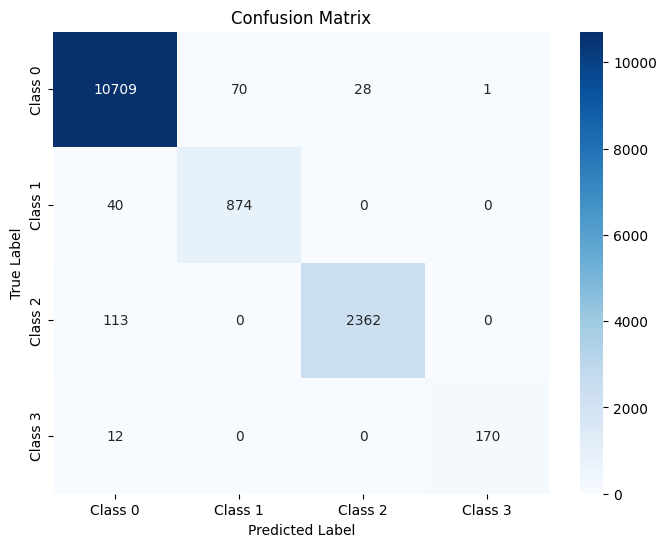

The function took 9.9291 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.99      0.99      2702
     Class 1       0.92      0.94      0.93       228
     Class 2       0.98      0.96      0.97       619
     Class 3       0.98      0.93      0.96        46

    accuracy                           0.98      3595
   macro avg       0.97      0.96      0.96      3595
weighted avg       0.98      0.98      0.98      3595



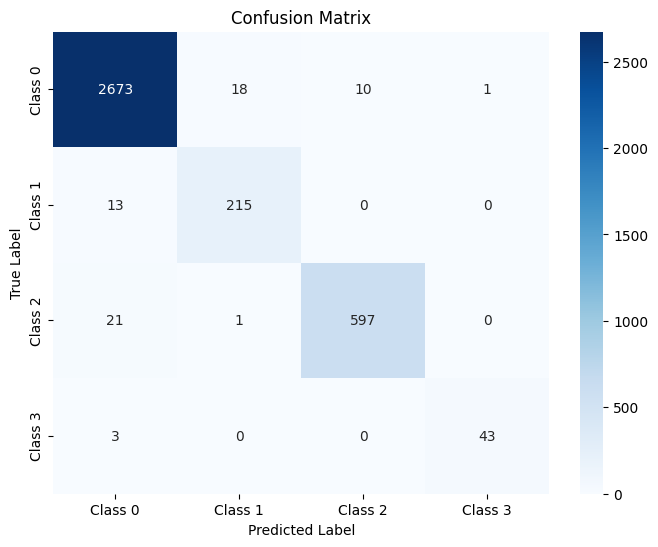

The function took 2.6149 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.99      0.99      3378
     Class 1       0.92      0.94      0.93       285
     Class 2       0.99      0.95      0.97       774
     Class 3       0.96      0.93      0.95        57

    accuracy                           0.98      4494
   macro avg       0.96      0.95      0.96      4494
weighted avg       0.98      0.98      0.98      4494



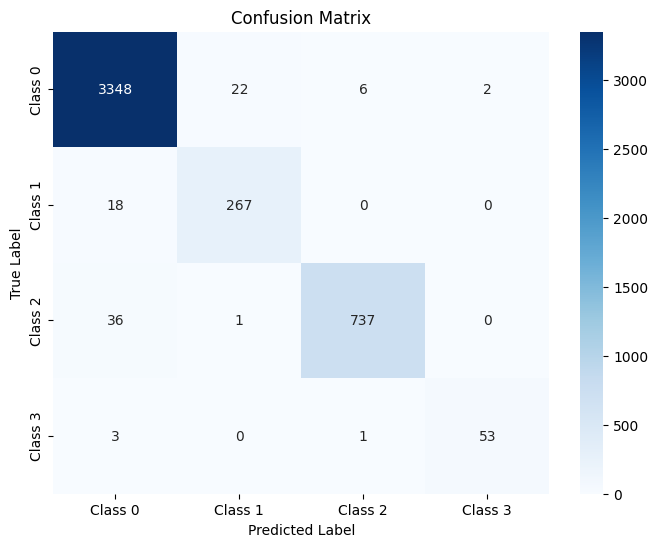

The function took 0.3864 seconds to execute.
[BS=32] done in 61.8s  best-val=0.0497


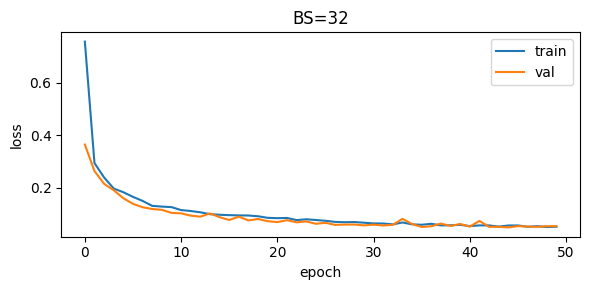


Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.96      0.98     10808
     Class 1       0.85      1.00      0.92       914
     Class 2       0.92      0.99      0.96      2475
     Class 3       0.84      0.99      0.91       182

    accuracy                           0.97     14379
   macro avg       0.90      0.99      0.94     14379
weighted avg       0.97      0.97      0.97     14379



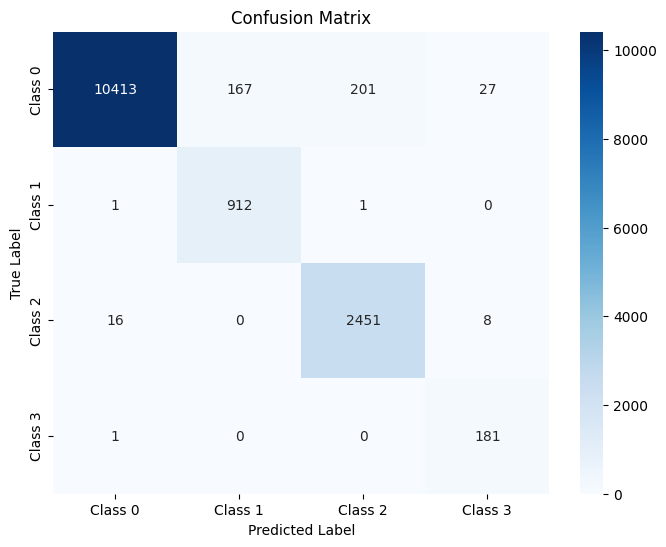

The function took 0.6196 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.96      0.98      2702
     Class 1       0.84      1.00      0.91       228
     Class 2       0.92      0.99      0.95       619
     Class 3       0.84      1.00      0.91        46

    accuracy                           0.97      3595
   macro avg       0.90      0.99      0.94      3595
weighted avg       0.97      0.97      0.97      3595



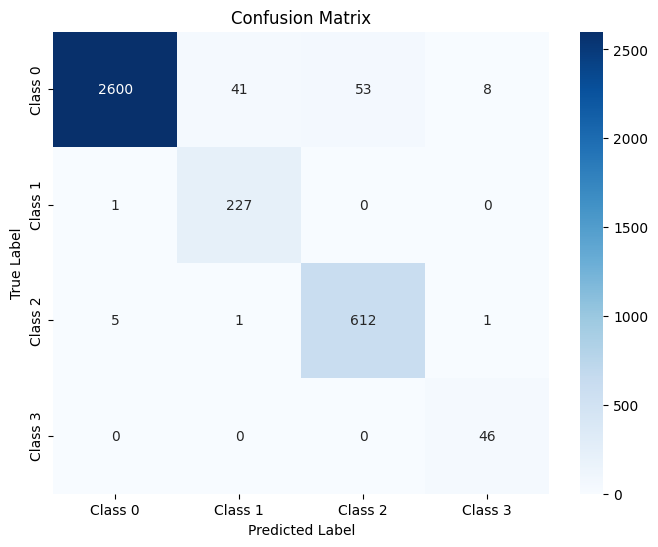

The function took 0.2833 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.97      0.98      3378
     Class 1       0.85      0.99      0.91       285
     Class 2       0.94      0.98      0.96       774
     Class 3       0.78      0.93      0.85        57

    accuracy                           0.97      4494
   macro avg       0.89      0.97      0.93      4494
weighted avg       0.97      0.97      0.97      4494



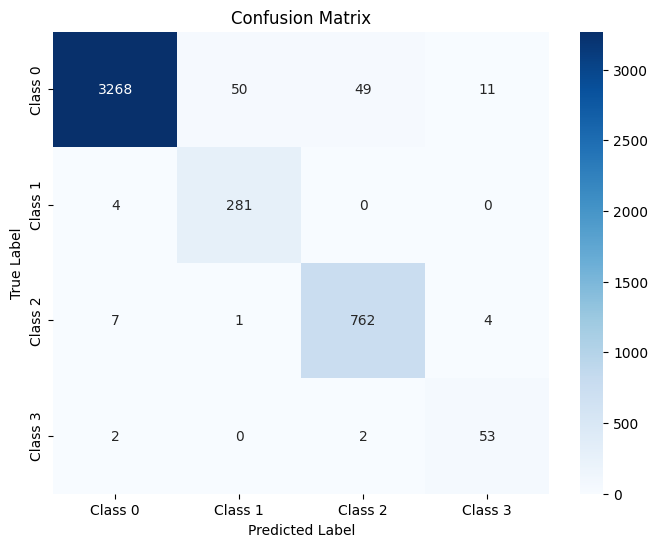

The function took 0.2751 seconds to execute.
[BS=64] done in 35.0s  best-val=0.0514


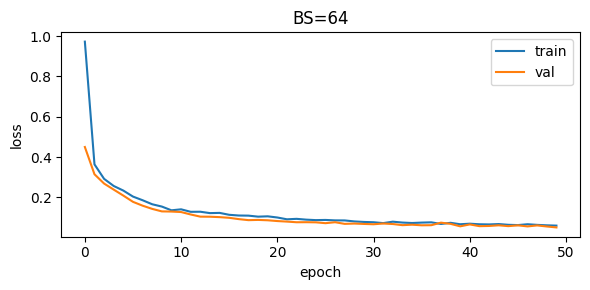


Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.96      0.98     10808
     Class 1       0.82      1.00      0.90       914
     Class 2       0.91      0.99      0.95      2475
     Class 3       0.77      0.99      0.87       182

    accuracy                           0.97     14379
   macro avg       0.88      0.98      0.92     14379
weighted avg       0.97      0.97      0.97     14379



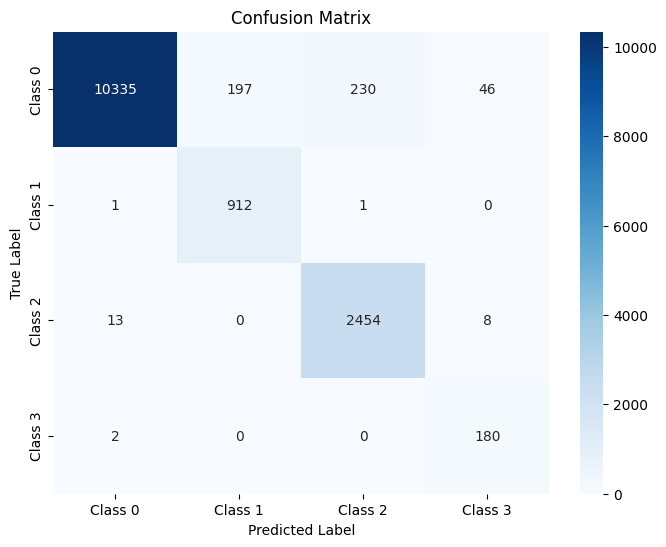

The function took 0.5872 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.95      0.97      2702
     Class 1       0.81      1.00      0.90       228
     Class 2       0.91      0.99      0.95       619
     Class 3       0.75      1.00      0.86        46

    accuracy                           0.96      3595
   macro avg       0.87      0.98      0.92      3595
weighted avg       0.97      0.96      0.96      3595



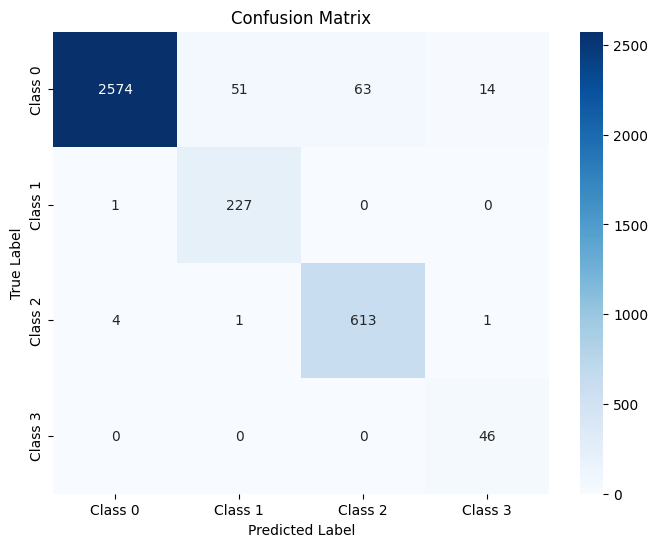

The function took 0.2662 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.96      0.98      3378
     Class 1       0.82      0.99      0.90       285
     Class 2       0.92      0.98      0.95       774
     Class 3       0.81      0.96      0.88        57

    accuracy                           0.97      4494
   macro avg       0.89      0.97      0.93      4494
weighted avg       0.97      0.97      0.97      4494



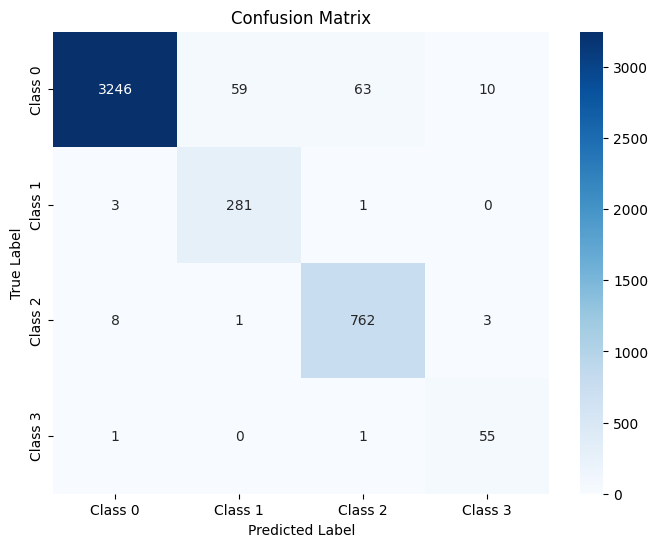

The function took 0.2733 seconds to execute.
[BS=128] done in 20.9s  best-val=0.0591


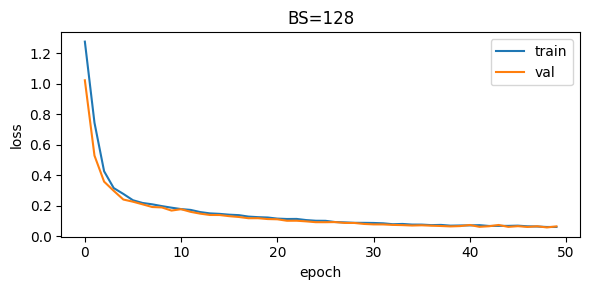


Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.94      0.97     10808
     Class 1       0.80      1.00      0.89       914
     Class 2       0.90      0.99      0.94      2475
     Class 3       0.62      0.99      0.76       182

    accuracy                           0.96     14379
   macro avg       0.83      0.98      0.89     14379
weighted avg       0.96      0.96      0.96     14379



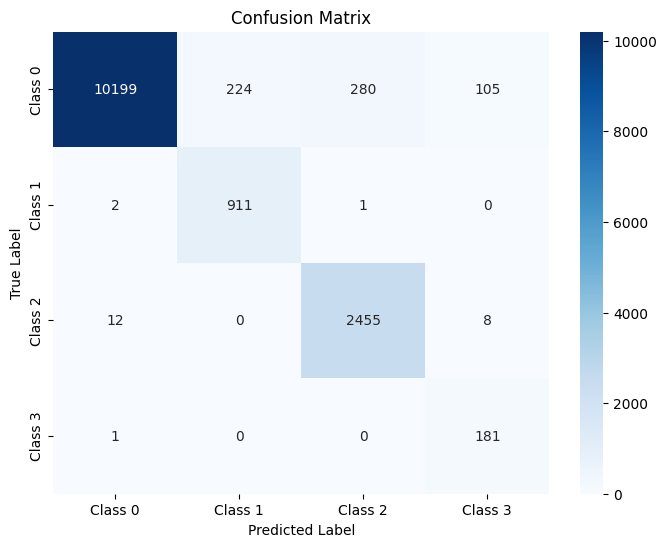

The function took 0.4125 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.94      0.97      2702
     Class 1       0.80      1.00      0.89       228
     Class 2       0.88      0.99      0.94       619
     Class 3       0.63      1.00      0.77        46

    accuracy                           0.95      3595
   macro avg       0.83      0.98      0.89      3595
weighted avg       0.96      0.95      0.95      3595



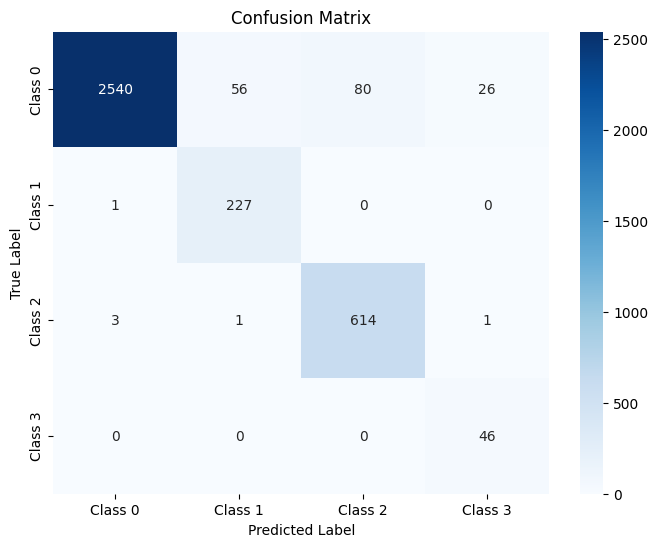

The function took 0.2380 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.94      0.97      3378
     Class 1       0.80      0.99      0.89       285
     Class 2       0.90      0.99      0.94       774
     Class 3       0.58      0.95      0.72        57

    accuracy                           0.95      4494
   macro avg       0.82      0.97      0.88      4494
weighted avg       0.96      0.95      0.96      4494



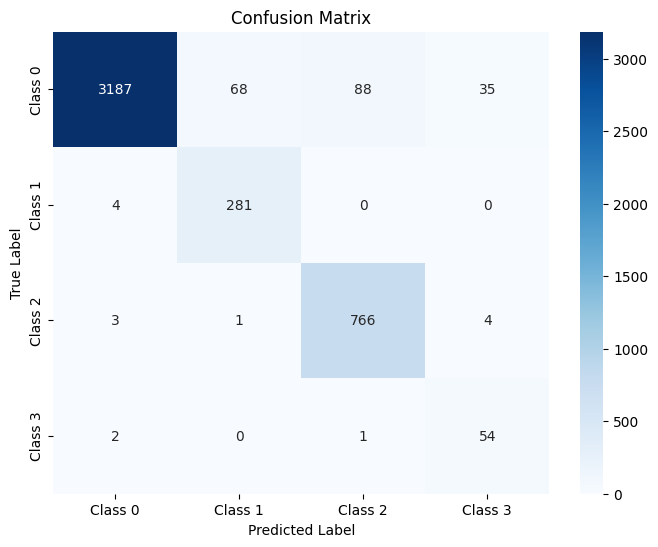

The function took 0.3923 seconds to execute.
[BS=512] done in 11.0s  best-val=0.0966


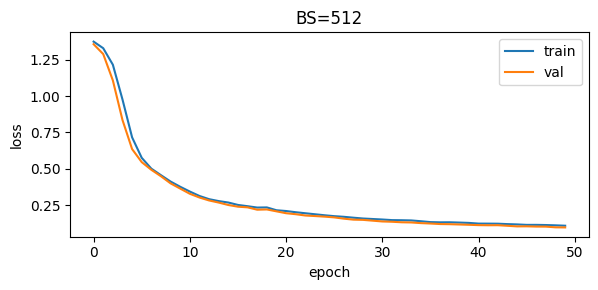


Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.92      0.96     10808
     Class 1       0.76      1.00      0.86       914
     Class 2       0.88      0.99      0.93      2475
     Class 3       0.43      0.99      0.60       182

    accuracy                           0.94     14379
   macro avg       0.77      0.97      0.84     14379
weighted avg       0.95      0.94      0.94     14379



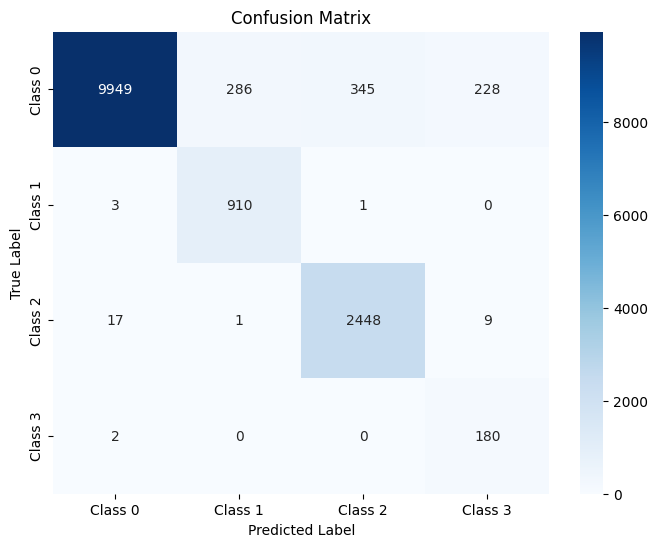

The function took 0.4359 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.91      0.95      2702
     Class 1       0.75      0.99      0.85       228
     Class 2       0.86      0.99      0.92       619
     Class 3       0.43      1.00      0.60        46

    accuracy                           0.93      3595
   macro avg       0.76      0.97      0.83      3595
weighted avg       0.95      0.93      0.94      3595



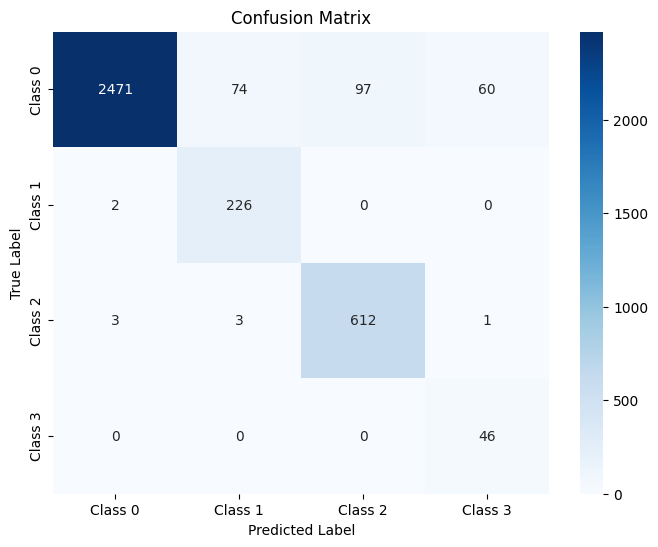

The function took 0.2419 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.92      0.96      3378
     Class 1       0.77      0.99      0.86       285
     Class 2       0.88      0.98      0.93       774
     Class 3       0.43      0.95      0.59        57

    accuracy                           0.94      4494
   macro avg       0.77      0.96      0.84      4494
weighted avg       0.95      0.94      0.94      4494



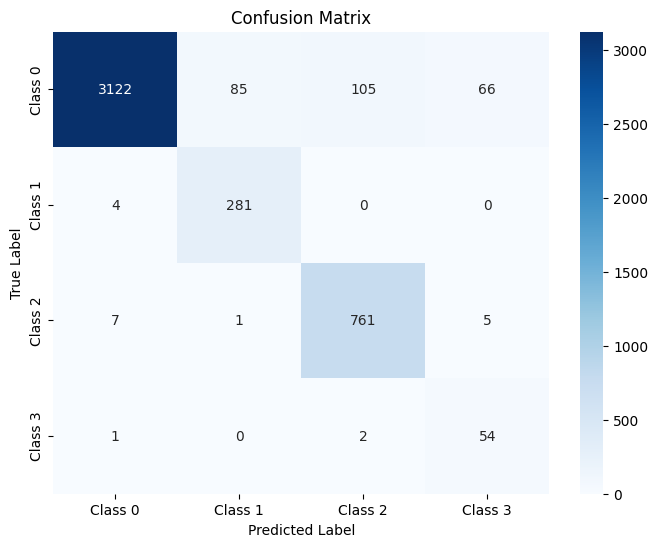

The function took 0.2856 seconds to execute.


,train_acc,val_acc,test_acc
1,"{'accuracy': 98.16398915084498, 'precision': [...","{'accuracy': 98.13630041724618, 'precision': [...","{'accuracy': 98.01958166444147, 'precision': [..."
32,"{'accuracy': 97.0651644759719, 'precision': [0...","{'accuracy': 96.94019471488178, 'precision': [...","{'accuracy': 97.1072541165999, 'precision': [0..."
64,"{'accuracy': 96.53661589818485, 'precision': [...","{'accuracy': 96.24478442280946, 'precision': [...","{'accuracy': 96.66221628838451, 'precision': [..."
128,"{'accuracy': 95.59774671395786, 'precision': [...","{'accuracy': 95.326842837274, 'precision': [0....","{'accuracy': 95.4161103693814, 'precision': [0..."
512,"{'accuracy': 93.79650879755198, 'precision': [...","{'accuracy': 93.3240611961057, 'precision': [0...","{'accuracy': 93.8584779706275, 'precision': [0..."


In [15]:
class_weights = class_weights.to(DEVICE)
input_dim  = X_train_tensor.shape[1]
n_classes  = len(torch.unique(y_train_tensor))
ref_arch = [input_dim, 32, 32, 32, 32, n_classes]


# ---------------- batch-size sweep ---------------------------------
# Purpose:
#   Evaluate how different mini-batch sizes affect model performance.
batch_grid = [1,32,64,128,512]
bs_scores  = {}

for bs in batch_grid:
    tr_loader = DataLoader(train_dataset,batch_size=bs,shuffle=True)
    vl_loader = DataLoader(val_dataset,  batch_size=bs,shuffle=False)

    net = PlainFFNN(ref_arch)
    opt = optim.AdamW(net.parameters(), lr=5e-4)
    training_loop(net, tr_loader, vl_loader,
                  train_dataset, val_dataset, DEVICE,
                  opt, nn.CrossEntropyLoss(weight=class_weights),
                  max_epochs=50, patience=15,
                  verbose_every=0, cfg_name=f"BS={bs}")

    bs_scores[bs] = {
        'train_acc': testing_model(net, tr_loader, DEVICE),
        'val_acc'  : testing_model(net, vl_loader, DEVICE),
        'test_acc' : testing_model(net, test_loader,DEVICE)
    }

pd.DataFrame(bs_scores).T



### best - activation function

[ACT=linear] done in 58.6s  best-val=0.2706


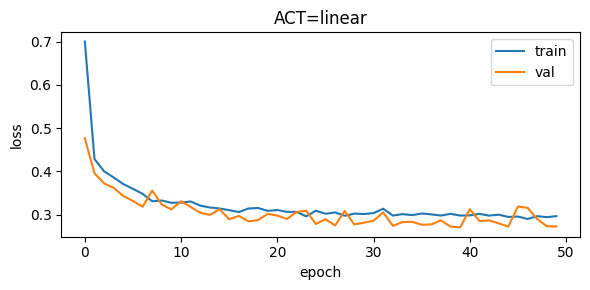


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.97      0.89      0.93      3378
     Class 1       0.57      0.94      0.71       285
     Class 2       0.83      0.85      0.84       774
     Class 3       0.33      0.93      0.49        57

    accuracy                           0.89      4494
   macro avg       0.68      0.90      0.74      4494
weighted avg       0.92      0.89      0.89      4494



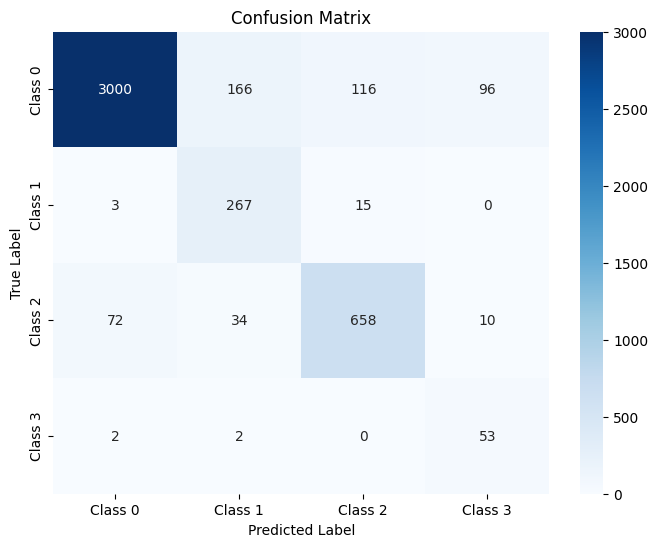

The function took 0.2971 seconds to execute.
[ACT=sigmoid] done in 63.8s  best-val=0.2477


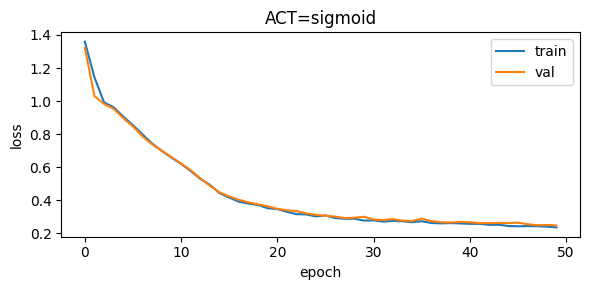


Classification Report:
              precision    recall  f1-score   support

     Class 0       0.97      0.95      0.96      3378
     Class 1       0.90      0.84      0.87       285
     Class 2       0.88      0.90      0.89       774
     Class 3       0.51      0.93      0.66        57

    accuracy                           0.94      4494
   macro avg       0.81      0.91      0.85      4494
weighted avg       0.94      0.94      0.94      4494



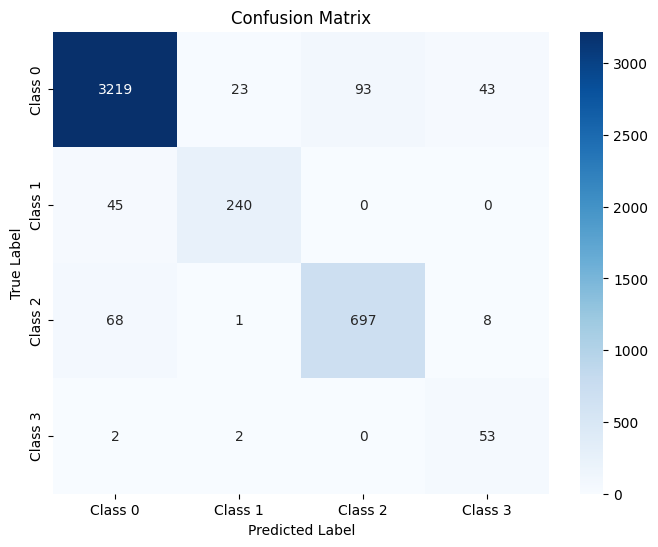

The function took 0.3417 seconds to execute.
[ACT=relu] done in 65.2s  best-val=0.0472


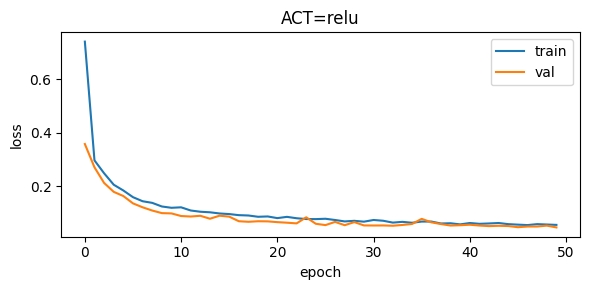


Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.97      0.98      3378
     Class 1       0.85      0.99      0.92       285
     Class 2       0.92      0.99      0.95       774
     Class 3       0.82      0.95      0.88        57

    accuracy                           0.97      4494
   macro avg       0.90      0.97      0.93      4494
weighted avg       0.97      0.97      0.97      4494



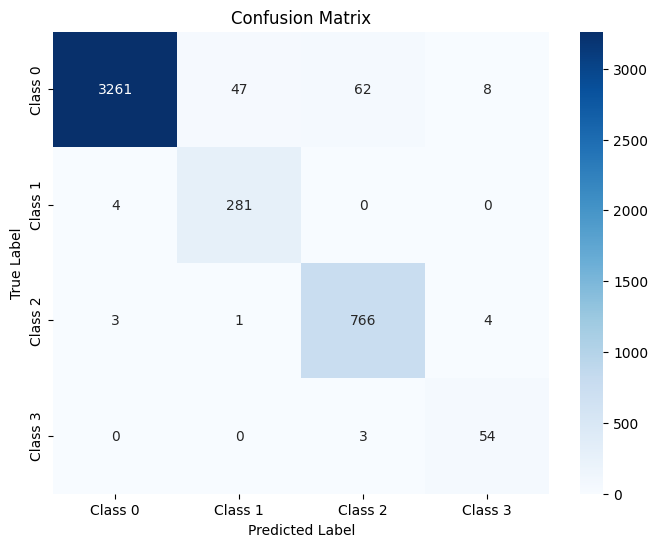

The function took 0.4417 seconds to execute.


,0
linear,"{'accuracy': 88.51802403204272, 'precision': [..."
sigmoid,"{'accuracy': 93.65821094793057, 'precision': [..."
relu,"{'accuracy': 97.06275033377837, 'precision': [..."


In [16]:
# ---------------- activation sweep ---------------------------------
BEST_BS = 32

train_loader = DataLoader(train_dataset, batch_size=BEST_BS, shuffle=True)
val_loader   = DataLoader(val_dataset,   batch_size=BEST_BS, shuffle=False)
test_loader  = DataLoader(test_dataset,  batch_size=BEST_BS, shuffle=False)

acts = {
    'linear' : nn.Identity(),   # nessuna attivazione
    'sigmoid': nn.Sigmoid(),
    'relu'   : nn.ReLU()
}

act_scores = {}

class ActNet(nn.Module):
    """
    Generic FFNN: the Linear layers are stored in self.layers,
    and the activation function can be selected on the fly via the `act` parameter.
    """
    def __init__(self, sizes, act):
        super().__init__()
        self.act = act

        self.layers = nn.ModuleList(
            [nn.Linear(sizes[i], sizes[i + 1]) for i in range(len(sizes) - 1)]
        )

    def forward(self, x):
        for layer in self.layers[:-1]:
            x = self.act(layer(x))
        return self.layers[-1](x)


criterion = nn.CrossEntropyLoss(weight=class_weights.to(DEVICE))

for name, act in acts.items():
    net = ActNet(ref_arch, act).to(DEVICE)
    opt = optim.AdamW(net.parameters(), lr=5e-4)

    training_loop(net, train_loader, val_loader,
                  train_dataset, val_dataset, DEVICE,
                  opt, criterion,
                  max_epochs=50, patience=15,
                  verbose_every=0, cfg_name=f"ACT={name}")

    act_scores[name] = testing_model(net, test_loader, DEVICE)


(pd.Series({k: v for k, v in act_scores.items()}))

### best - optimizer

[OPT=sgd,m=None] done in 56.3s  best-val=0.0724


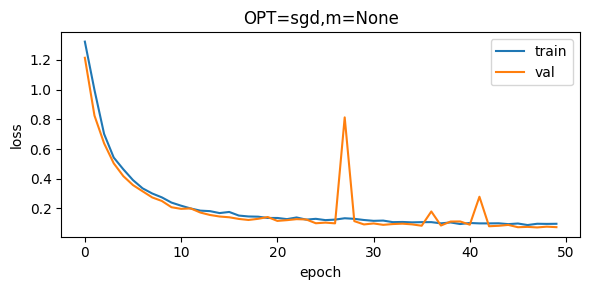


Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.96      0.98      3378
     Class 1       0.82      0.99      0.89       285
     Class 2       0.92      0.99      0.95       774
     Class 3       0.77      0.95      0.85        57

    accuracy                           0.96      4494
   macro avg       0.88      0.97      0.92      4494
weighted avg       0.97      0.96      0.97      4494



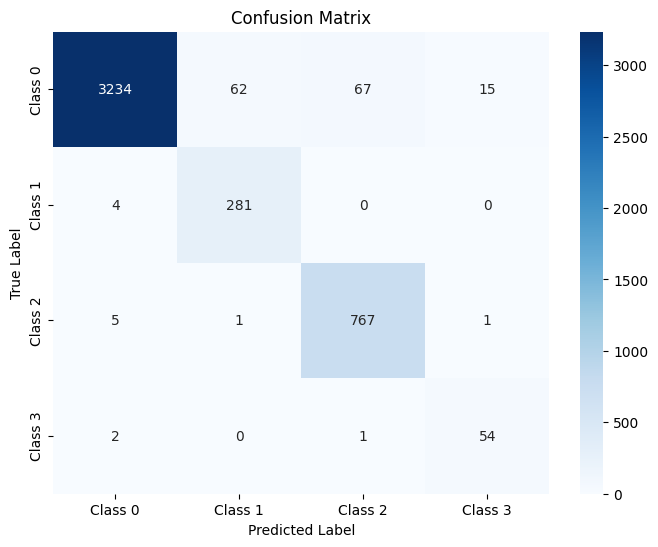

The function took 0.3061 seconds to execute.
[OPT=mom,m=0.1] done in 57.7s  best-val=0.0755


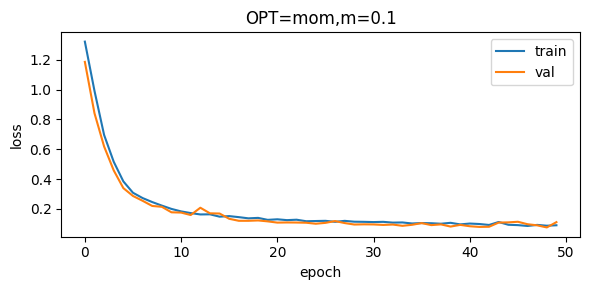


Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.96      0.98      3378
     Class 1       0.84      0.99      0.91       285
     Class 2       0.92      0.99      0.95       774
     Class 3       0.82      0.93      0.87        57

    accuracy                           0.97      4494
   macro avg       0.89      0.97      0.93      4494
weighted avg       0.97      0.97      0.97      4494



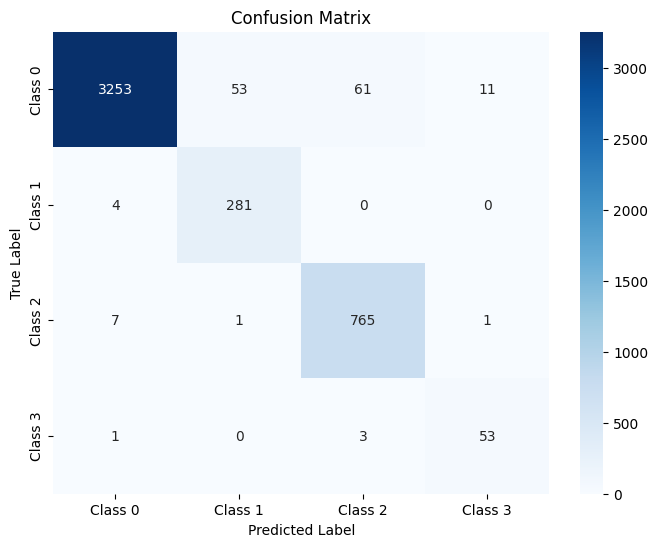

The function took 0.3073 seconds to execute.
[OPT=mom,m=0.5] done in 58.4s  best-val=0.0638


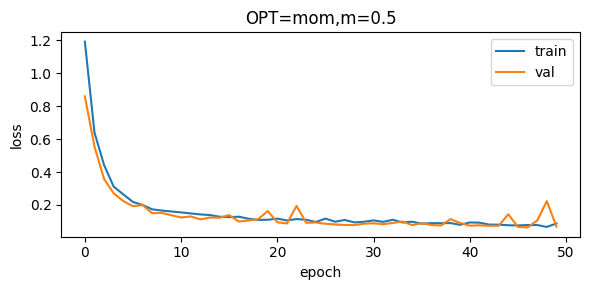


Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.96      0.98      3378
     Class 1       0.79      0.99      0.88       285
     Class 2       0.93      0.99      0.96       774
     Class 3       0.79      0.98      0.88        57

    accuracy                           0.97      4494
   macro avg       0.88      0.98      0.92      4494
weighted avg       0.97      0.97      0.97      4494



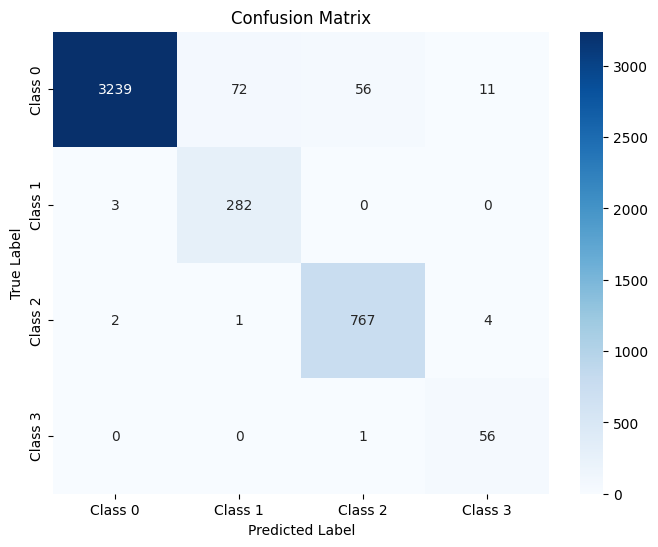

The function took 0.4607 seconds to execute.
[OPT=mom,m=0.9] done in 58.0s  best-val=0.0660


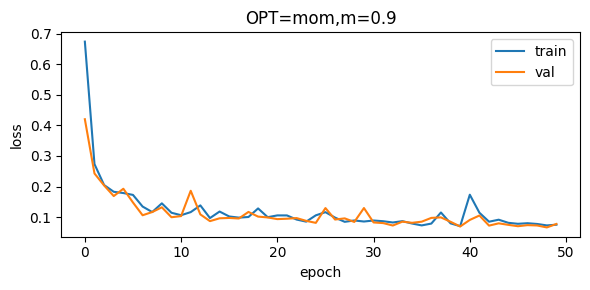


Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.96      0.98      3378
     Class 1       0.83      0.99      0.90       285
     Class 2       0.93      0.99      0.96       774
     Class 3       0.78      0.98      0.87        57

    accuracy                           0.97      4494
   macro avg       0.88      0.98      0.93      4494
weighted avg       0.97      0.97      0.97      4494



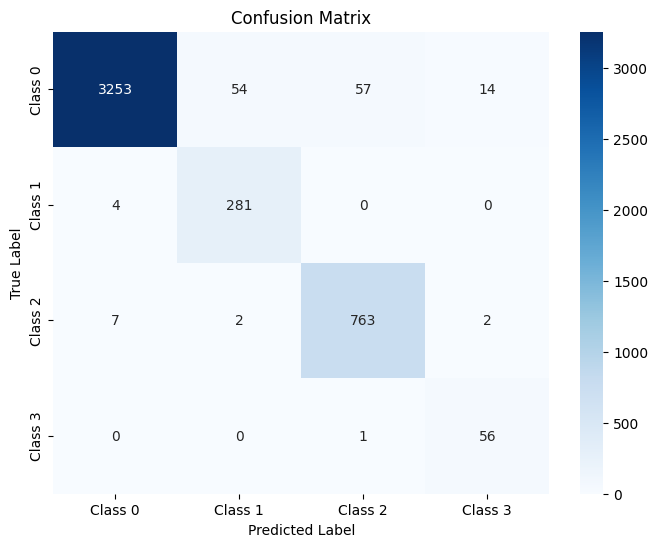

The function took 0.3464 seconds to execute.
[OPT=adamw,m=None] done in 63.5s  best-val=0.0489


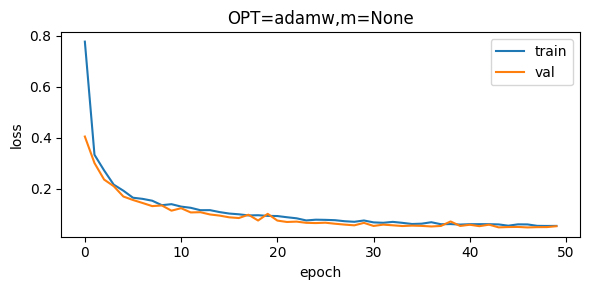


Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.97      0.98      3378
     Class 1       0.87      0.98      0.92       285
     Class 2       0.94      0.99      0.96       774
     Class 3       0.89      0.96      0.92        57

    accuracy                           0.98      4494
   macro avg       0.92      0.98      0.95      4494
weighted avg       0.98      0.98      0.98      4494



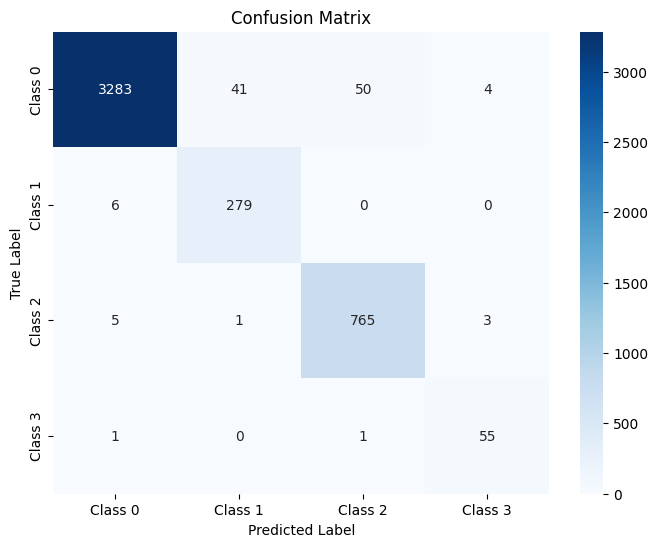

The function took 0.3281 seconds to execute.


sgd    NaN    {'accuracy': 96.48420115709835, 'precision': [...
mom    0.1    {'accuracy': 96.84023141967067, 'precision': [...
       0.5    {'accuracy': 96.66221628838451, 'precision': [...
       0.9    {'accuracy': 96.86248331108143, 'precision': [...
adamw  NaN    {'accuracy': 97.50778816199377, 'precision': [...
dtype: object

In [17]:
# ---------------- optimiser sweep ----------------------------------
BEST_BS = 32


train_loader = DataLoader(train_dataset, batch_size=BEST_BS, shuffle=True)
val_loader   = DataLoader(val_dataset,   batch_size=BEST_BS, shuffle=False)
test_loader  = DataLoader(test_dataset,  batch_size=BEST_BS, shuffle=False)


def mk_opt(tag, net, lr, mom=None):
    if tag == 'sgd'  : return optim.SGD(net.parameters(), lr=lr)
    if tag == 'mom'  : return optim.SGD(net.parameters(), lr=lr, momentum=mom)
    if tag == 'adamw': return optim.AdamW(net.parameters(), lr=lr)


opt_cfgs = [
    ('sgd',   1e-2,  None),
    ('mom',   1e-2,  0.1),
    ('mom',   1e-2,  0.5),
    ('mom',   1e-2,  0.9),
    ('adamw', 5e-4,  None)
]


act_scores = {}
for tag, lr, m in opt_cfgs:
    net = ActNet(ref_arch, nn.ReLU()).to(DEVICE)
    opt = mk_opt(tag, net, lr, m)

    training_loop(net, train_loader, val_loader,
                  train_dataset, val_dataset, DEVICE,
                  opt, nn.CrossEntropyLoss(weight=class_weights.to(DEVICE)),
                  max_epochs=50, patience=15,
                  verbose_every=0, cfg_name=f"OPT={tag},m={m}")

    act_scores[(tag, m)] = testing_model(net, test_loader, DEVICE)


pd.Series(act_scores)


# Task 5: Overfitting and regularization

[plain  wd=0e+00] ep 010  tr=0.1142  val=0.1164
[plain  wd=0e+00] ep 020  tr=0.0769  val=0.0782
[plain  wd=0e+00] ep 030  tr=0.0601  val=0.0754
[plain  wd=0e+00] ep 040  tr=0.0535  val=0.0536
[plain  wd=0e+00] ep 050  tr=0.0475  val=0.0504
[plain  wd=0e+00] done in 22.3s  best-val=0.0500


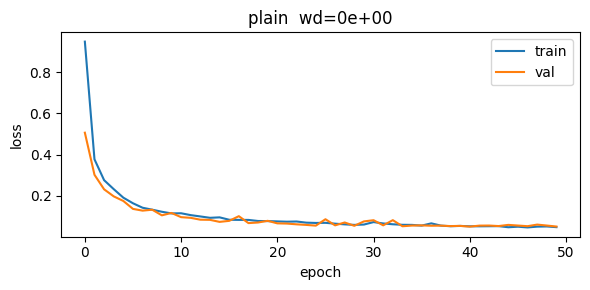


Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.96      0.98     10808
     Class 1       0.83      1.00      0.90       914
     Class 2       0.92      0.99      0.95      2475
     Class 3       0.83      0.99      0.90       182

    accuracy                           0.97     14379
   macro avg       0.89      0.98      0.94     14379
weighted avg       0.97      0.97      0.97     14379



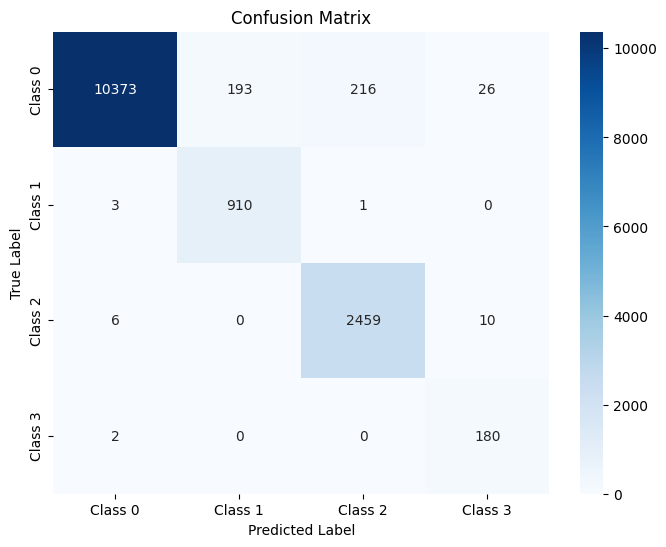

The function took 0.4041 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.96      0.98      2702
     Class 1       0.83      1.00      0.91       228
     Class 2       0.91      0.99      0.95       619
     Class 3       0.84      1.00      0.91        46

    accuracy                           0.97      3595
   macro avg       0.90      0.99      0.94      3595
weighted avg       0.97      0.97      0.97      3595



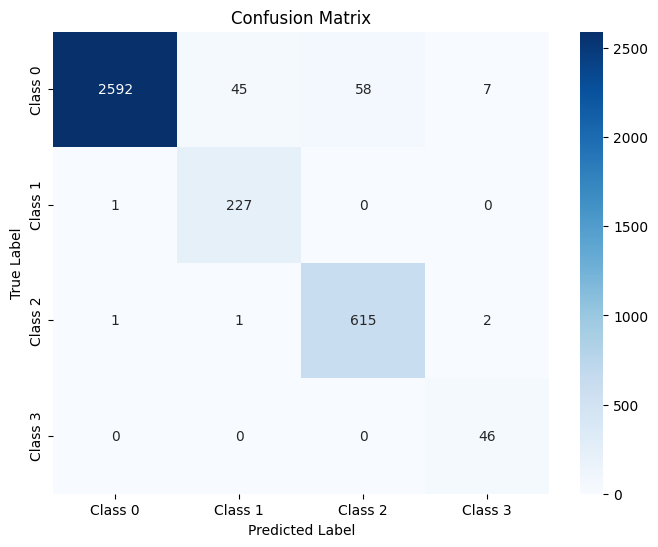

The function took 0.2274 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.96      0.98      3378
     Class 1       0.83      0.99      0.90       285
     Class 2       0.93      0.99      0.96       774
     Class 3       0.87      0.95      0.91        57

    accuracy                           0.97      4494
   macro avg       0.91      0.97      0.94      4494
weighted avg       0.97      0.97      0.97      4494



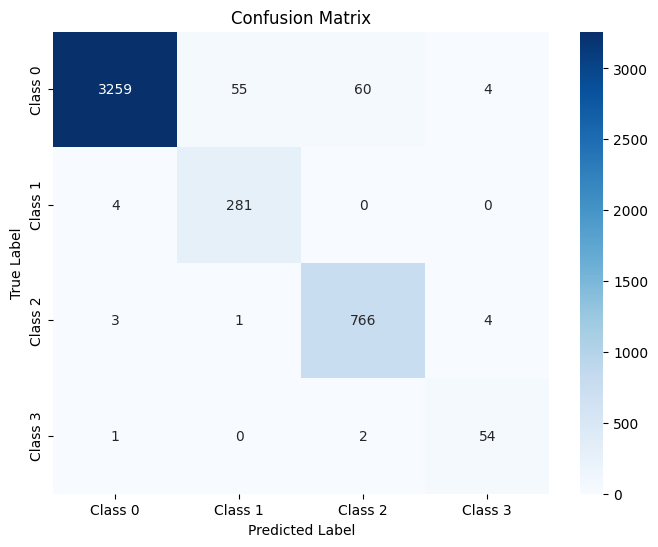

The function took 0.3962 seconds to execute.
[plain  wd=1e-04] ep 010  tr=0.1257  val=0.1270
[plain  wd=1e-04] ep 020  tr=0.0732  val=0.0616
[plain  wd=1e-04] ep 030  tr=0.0580  val=0.0587
[plain  wd=1e-04] ep 040  tr=0.0469  val=0.0582
[plain  wd=1e-04] ep 050  tr=0.0487  val=0.0600
[plain  wd=1e-04] done in 22.9s  best-val=0.0493


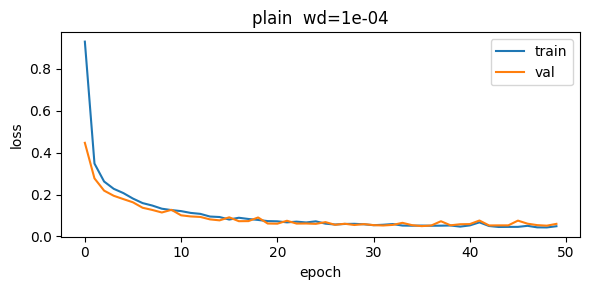


Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.96      0.98     10808
     Class 1       0.83      1.00      0.91       914
     Class 2       0.93      0.99      0.96      2475
     Class 3       0.83      0.99      0.90       182

    accuracy                           0.97     14379
   macro avg       0.90      0.99      0.94     14379
weighted avg       0.97      0.97      0.97     14379



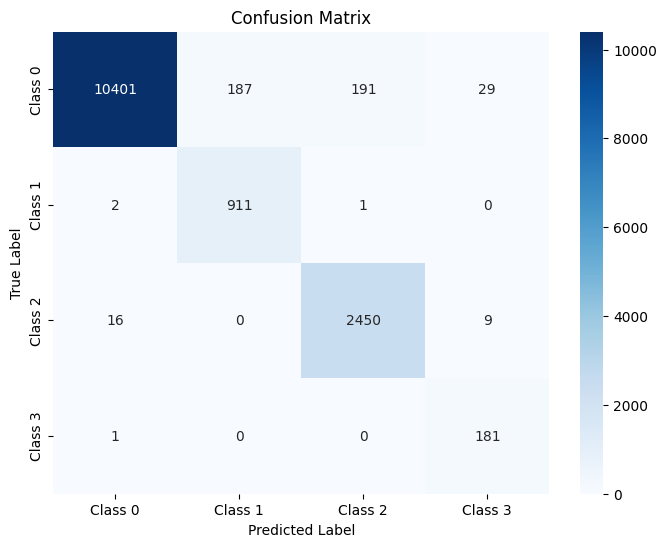

The function took 0.4086 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.96      0.98      2702
     Class 1       0.83      1.00      0.90       228
     Class 2       0.92      0.99      0.95       619
     Class 3       0.77      1.00      0.87        46

    accuracy                           0.97      3595
   macro avg       0.88      0.99      0.93      3595
weighted avg       0.97      0.97      0.97      3595



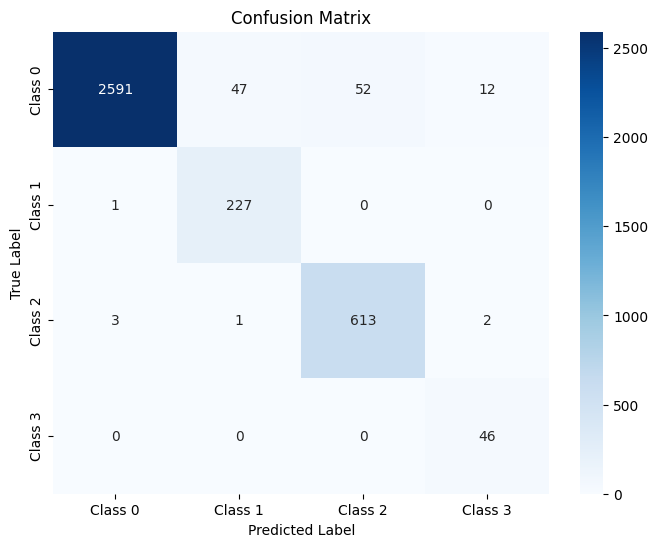

The function took 0.2172 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.97      0.98      3378
     Class 1       0.83      0.99      0.90       285
     Class 2       0.94      0.99      0.96       774
     Class 3       0.84      0.95      0.89        57

    accuracy                           0.97      4494
   macro avg       0.90      0.97      0.93      4494
weighted avg       0.97      0.97      0.97      4494



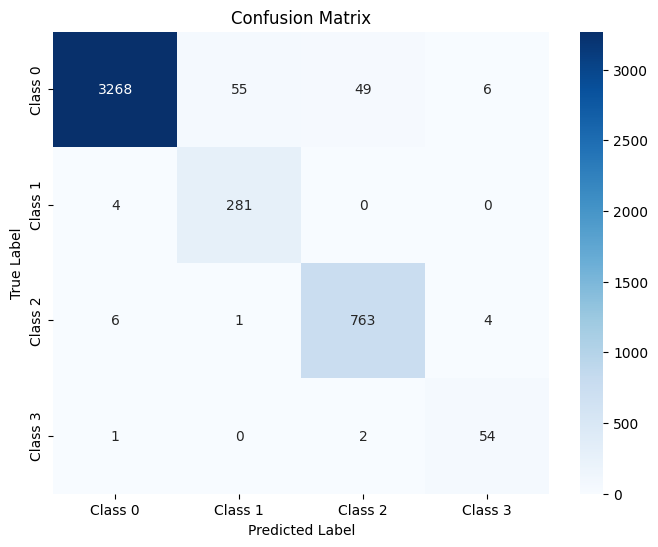

The function took 0.3940 seconds to execute.
[plain  wd=1e-03] ep 010  tr=0.1047  val=0.0874
[plain  wd=1e-03] ep 020  tr=0.0712  val=0.0611
[plain  wd=1e-03] ep 030  tr=0.0613  val=0.0565
[plain  wd=1e-03] ep 040  tr=0.0660  val=0.0823
[plain  wd=1e-03] ep 050  tr=0.0451  val=0.0525
[plain  wd=1e-03] done in 22.8s  best-val=0.0456


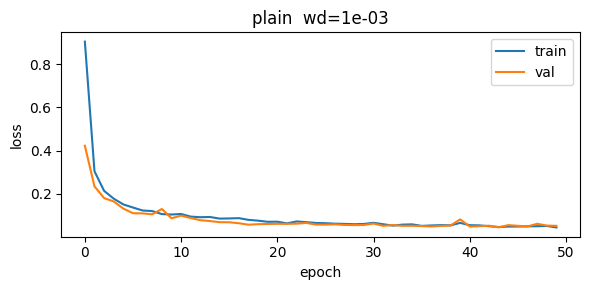


Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.96      0.98     10808
     Class 1       0.82      1.00      0.90       914
     Class 2       0.92      0.99      0.96      2475
     Class 3       0.87      0.99      0.93       182

    accuracy                           0.97     14379
   macro avg       0.90      0.99      0.94     14379
weighted avg       0.97      0.97      0.97     14379



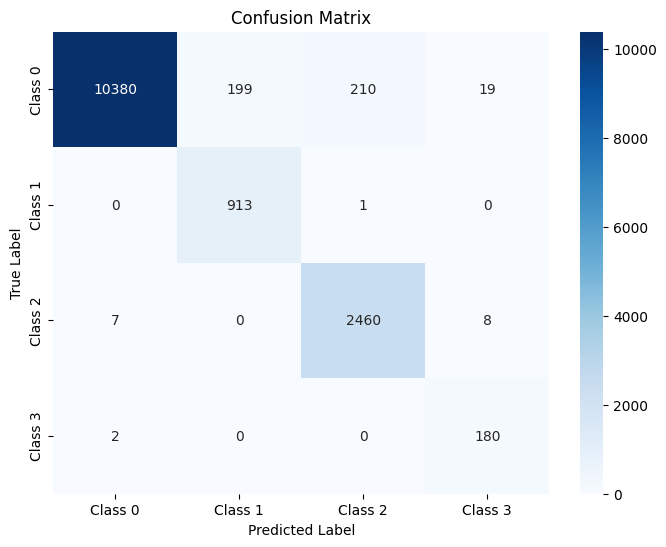

The function took 0.5540 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.96      0.98      2702
     Class 1       0.82      1.00      0.90       228
     Class 2       0.91      1.00      0.95       619
     Class 3       0.85      1.00      0.92        46

    accuracy                           0.97      3595
   macro avg       0.90      0.99      0.94      3595
weighted avg       0.97      0.97      0.97      3595



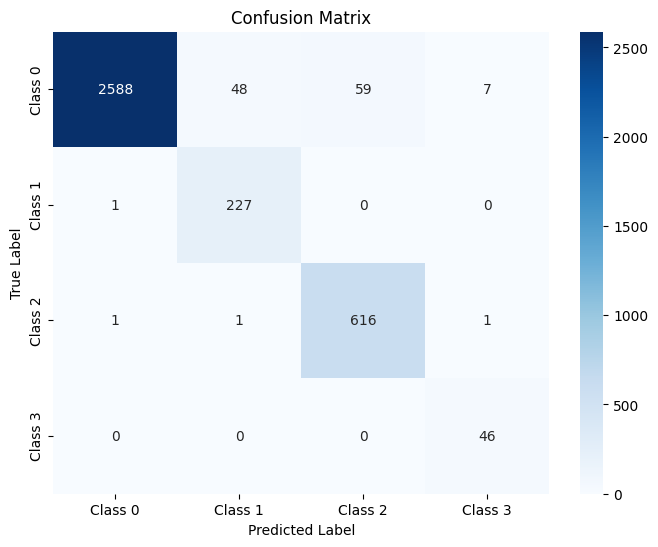

The function took 0.2212 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.96      0.98      3378
     Class 1       0.82      1.00      0.90       285
     Class 2       0.93      0.99      0.96       774
     Class 3       0.89      0.95      0.92        57

    accuracy                           0.97      4494
   macro avg       0.91      0.97      0.94      4494
weighted avg       0.97      0.97      0.97      4494



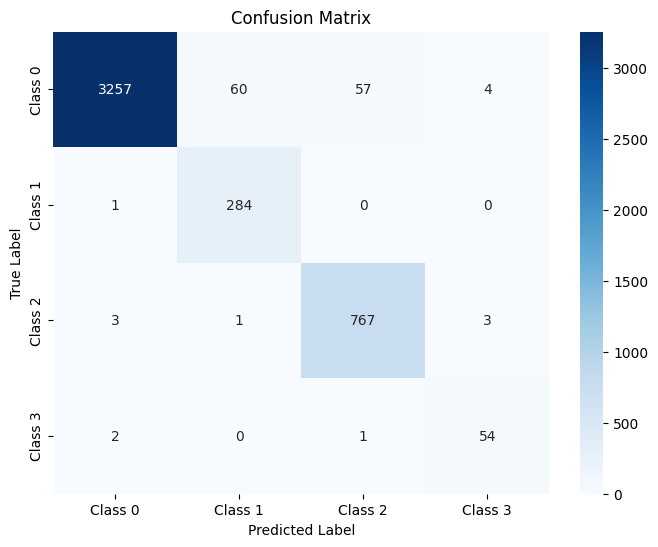

The function took 0.2563 seconds to execute.
[plain  wd=1e-02] ep 010  tr=0.1266  val=0.1008
[plain  wd=1e-02] ep 020  tr=0.0755  val=0.0750
[plain  wd=1e-02] ep 030  tr=0.0577  val=0.0627
[plain  wd=1e-02] ep 040  tr=0.0494  val=0.0619
[plain  wd=1e-02] early-stop @ epoch 046
[plain  wd=1e-02] done in 21.6s  best-val=0.0530


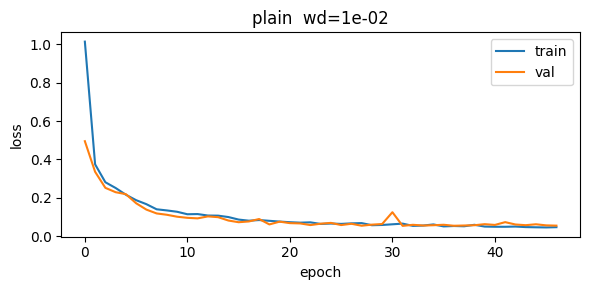


Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.95      0.98     10808
     Class 1       0.80      1.00      0.89       914
     Class 2       0.91      0.99      0.95      2475
     Class 3       0.83      0.99      0.90       182

    accuracy                           0.96     14379
   macro avg       0.89      0.98      0.93     14379
weighted avg       0.97      0.96      0.97     14379



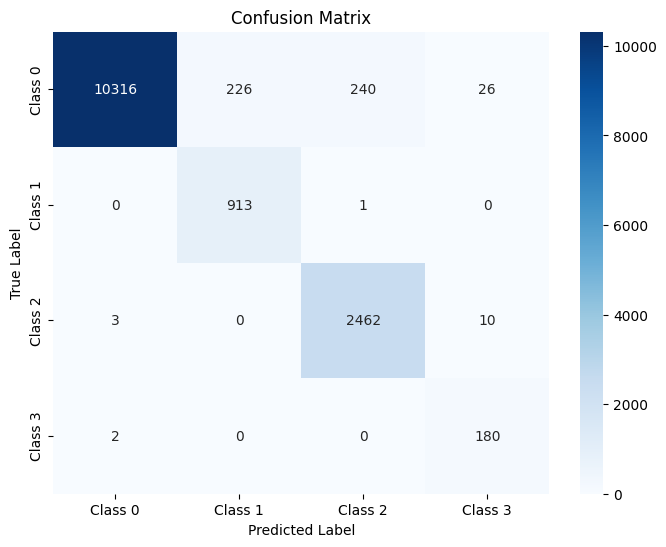

The function took 0.4206 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.95      0.98      2702
     Class 1       0.80      1.00      0.89       228
     Class 2       0.91      1.00      0.95       619
     Class 3       0.84      1.00      0.91        46

    accuracy                           0.96      3595
   macro avg       0.89      0.99      0.93      3595
weighted avg       0.97      0.96      0.96      3595



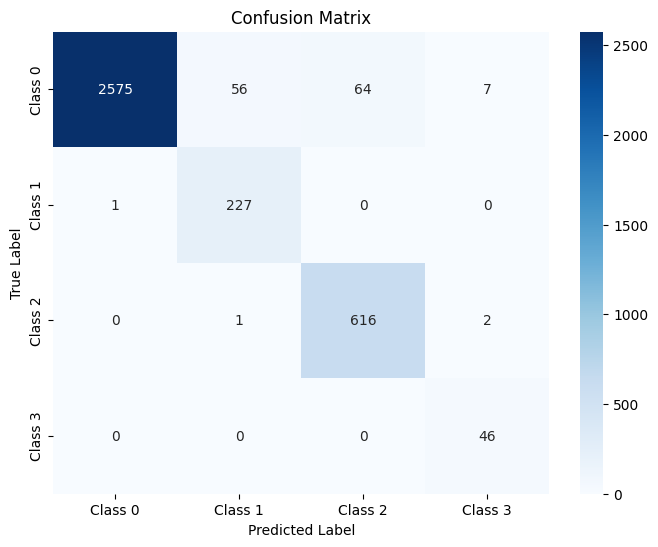

The function took 0.2423 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.96      0.98      3378
     Class 1       0.81      1.00      0.90       285
     Class 2       0.92      0.99      0.95       774
     Class 3       0.86      0.95      0.90        57

    accuracy                           0.97      4494
   macro avg       0.90      0.97      0.93      4494
weighted avg       0.97      0.97      0.97      4494



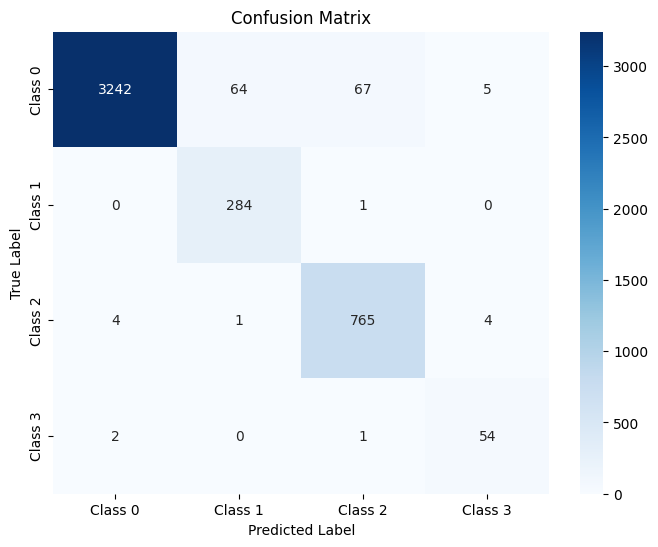

The function took 0.7138 seconds to execute.
[drop  wd=0e+00] ep 010  tr=0.2051  val=0.1359
[drop  wd=0e+00] ep 020  tr=0.1465  val=0.1022
[drop  wd=0e+00] ep 030  tr=0.1274  val=0.0842
[drop  wd=0e+00] ep 040  tr=0.1062  val=0.0728
[drop  wd=0e+00] ep 050  tr=0.0837  val=0.0671
[drop  wd=0e+00] done in 25.2s  best-val=0.0613


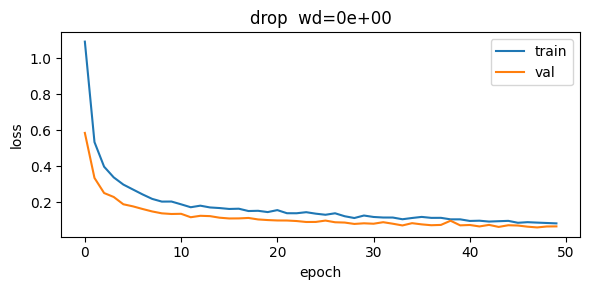


Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.95      0.97     10808
     Class 1       0.79      1.00      0.88       914
     Class 2       0.91      0.99      0.95      2475
     Class 3       0.81      0.99      0.89       182

    accuracy                           0.96     14379
   macro avg       0.88      0.98      0.92     14379
weighted avg       0.97      0.96      0.96     14379



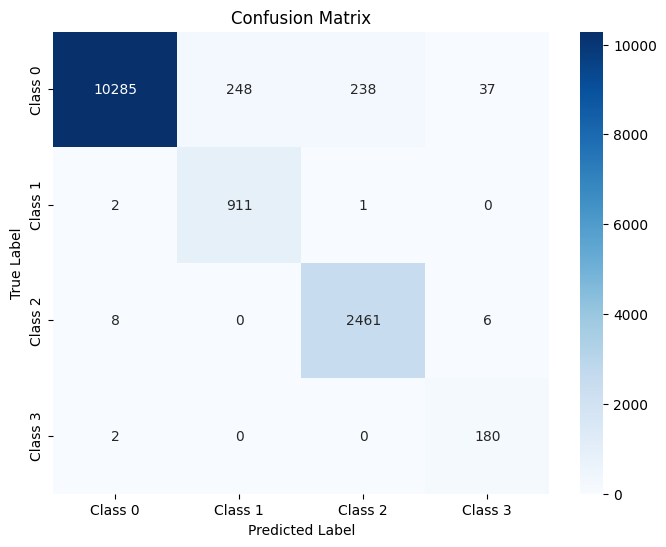

The function took 0.5666 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.95      0.97      2702
     Class 1       0.79      1.00      0.88       228
     Class 2       0.91      0.99      0.95       619
     Class 3       0.78      1.00      0.88        46

    accuracy                           0.96      3595
   macro avg       0.87      0.98      0.92      3595
weighted avg       0.97      0.96      0.96      3595



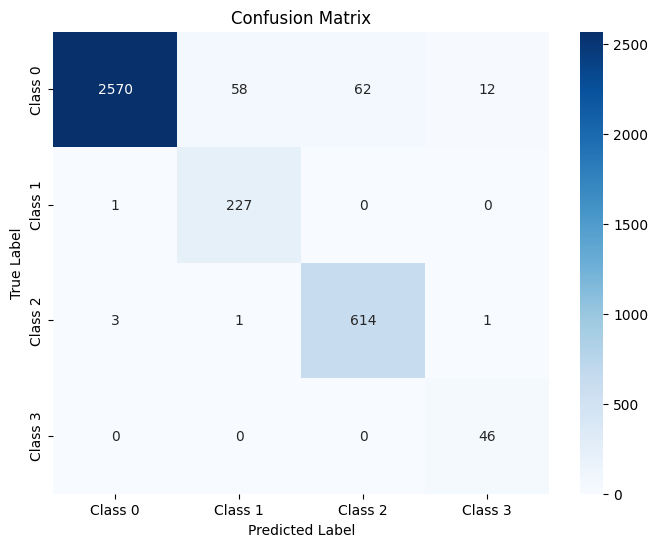

The function took 0.2382 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.96      0.98      3378
     Class 1       0.80      0.99      0.88       285
     Class 2       0.92      0.99      0.95       774
     Class 3       0.77      0.96      0.86        57

    accuracy                           0.96      4494
   macro avg       0.87      0.97      0.92      4494
weighted avg       0.97      0.96      0.96      4494



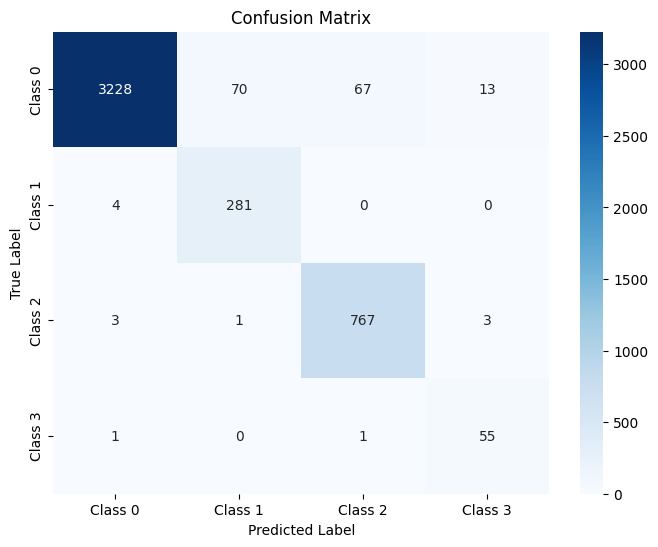

The function took 0.2525 seconds to execute.
[drop  wd=1e-04] ep 010  tr=0.2117  val=0.1534
[drop  wd=1e-04] ep 020  tr=0.1520  val=0.1128
[drop  wd=1e-04] ep 030  tr=0.1209  val=0.0874
[drop  wd=1e-04] ep 040  tr=0.0960  val=0.0712
[drop  wd=1e-04] ep 050  tr=0.0813  val=0.0600
[drop  wd=1e-04] done in 25.4s  best-val=0.0600


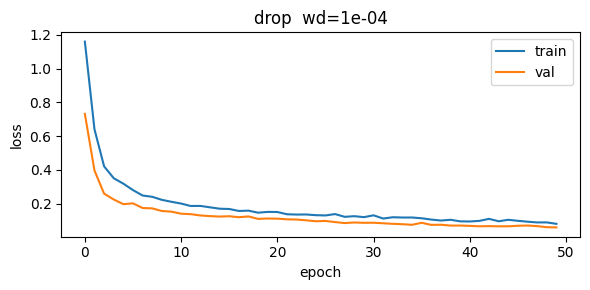


Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.95      0.97     10808
     Class 1       0.80      1.00      0.89       914
     Class 2       0.90      0.99      0.94      2475
     Class 3       0.85      0.99      0.92       182

    accuracy                           0.96     14379
   macro avg       0.89      0.98      0.93     14379
weighted avg       0.97      0.96      0.96     14379



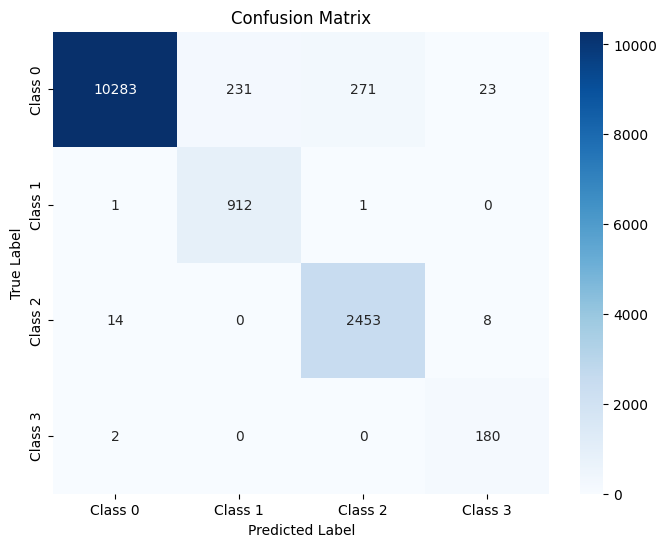

The function took 0.4172 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.95      0.97      2702
     Class 1       0.80      1.00      0.89       228
     Class 2       0.90      0.99      0.94       619
     Class 3       0.81      1.00      0.89        46

    accuracy                           0.96      3595
   macro avg       0.88      0.98      0.92      3595
weighted avg       0.97      0.96      0.96      3595



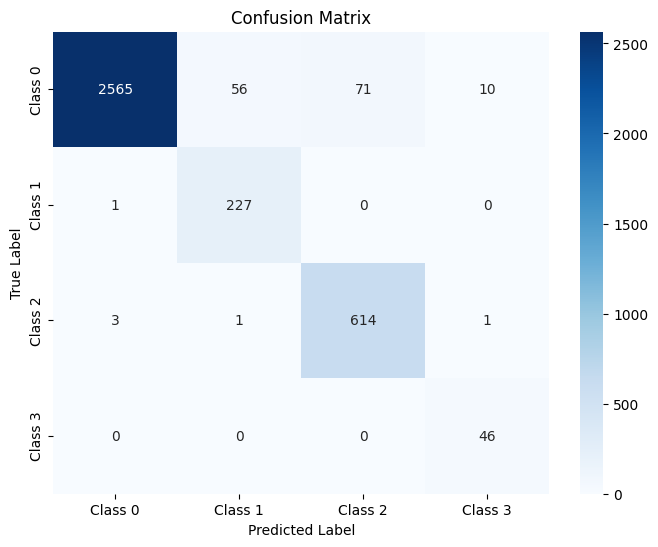

The function took 0.3827 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.96      0.98      3378
     Class 1       0.81      0.99      0.89       285
     Class 2       0.91      0.99      0.95       774
     Class 3       0.84      0.98      0.90        57

    accuracy                           0.96      4494
   macro avg       0.89      0.98      0.93      4494
weighted avg       0.97      0.96      0.96      4494



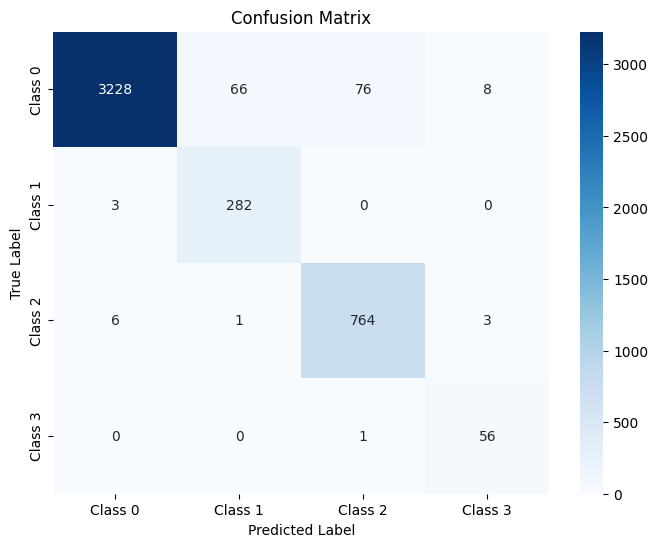

The function took 0.2738 seconds to execute.
[drop  wd=1e-03] ep 010  tr=0.1919  val=0.1306
[drop  wd=1e-03] ep 020  tr=0.1219  val=0.0842
[drop  wd=1e-03] ep 030  tr=0.1049  val=0.0672
[drop  wd=1e-03] ep 040  tr=0.0935  val=0.0580
[drop  wd=1e-03] ep 050  tr=0.0856  val=0.0525
[drop  wd=1e-03] done in 25.2s  best-val=0.0525


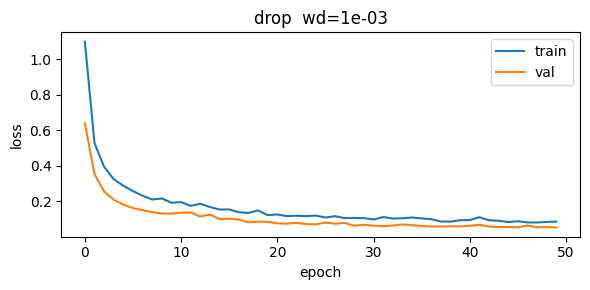


Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.95      0.98     10808
     Class 1       0.82      1.00      0.90       914
     Class 2       0.90      1.00      0.94      2475
     Class 3       0.84      0.99      0.91       182

    accuracy                           0.96     14379
   macro avg       0.89      0.98      0.93     14379
weighted avg       0.97      0.96      0.96     14379



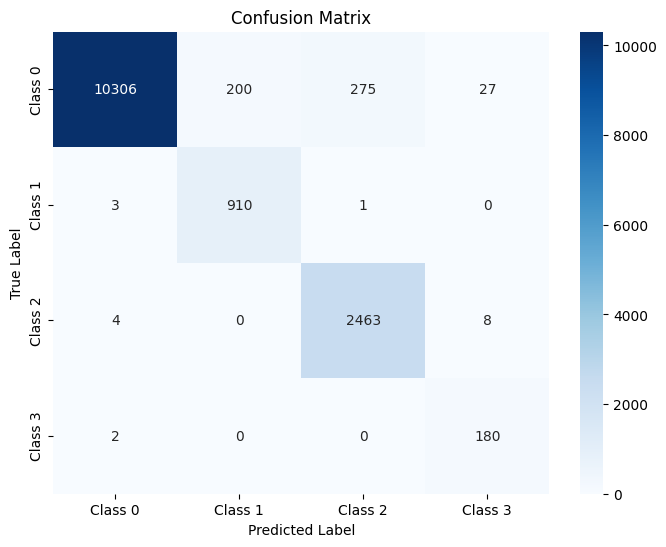

The function took 0.5701 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.95      0.98      2702
     Class 1       0.83      1.00      0.90       228
     Class 2       0.90      1.00      0.94       619
     Class 3       0.82      1.00      0.90        46

    accuracy                           0.96      3595
   macro avg       0.89      0.99      0.93      3595
weighted avg       0.97      0.96      0.97      3595



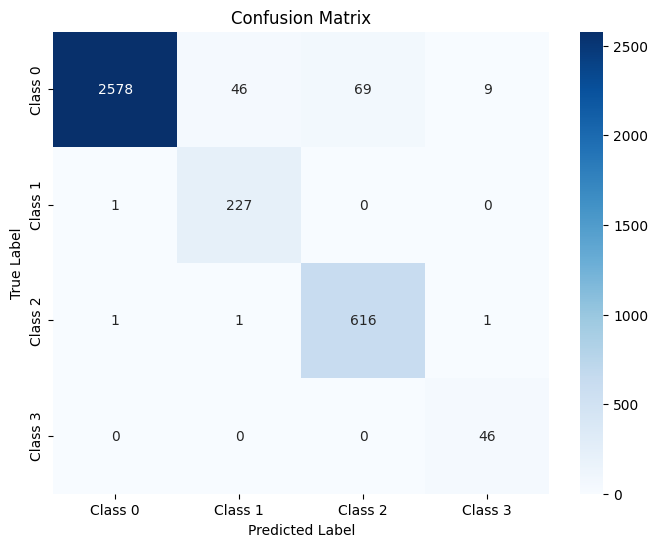

The function took 0.2468 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.96      0.98      3378
     Class 1       0.83      0.99      0.90       285
     Class 2       0.91      0.99      0.95       774
     Class 3       0.89      0.95      0.92        57

    accuracy                           0.97      4494
   macro avg       0.91      0.97      0.94      4494
weighted avg       0.97      0.97      0.97      4494



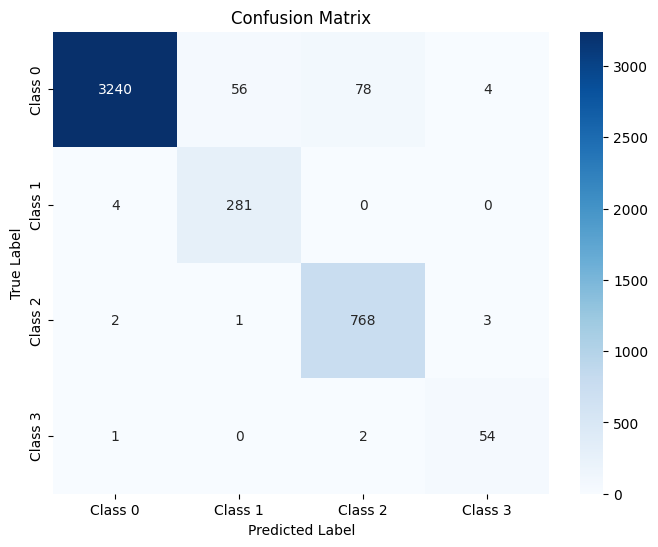

The function took 0.2676 seconds to execute.
[drop  wd=1e-02] ep 010  tr=0.1874  val=0.1372
[drop  wd=1e-02] ep 020  tr=0.1417  val=0.0939
[drop  wd=1e-02] ep 030  tr=0.1192  val=0.0757
[drop  wd=1e-02] ep 040  tr=0.0938  val=0.0624
[drop  wd=1e-02] ep 050  tr=0.0837  val=0.0546
[drop  wd=1e-02] done in 25.6s  best-val=0.0540


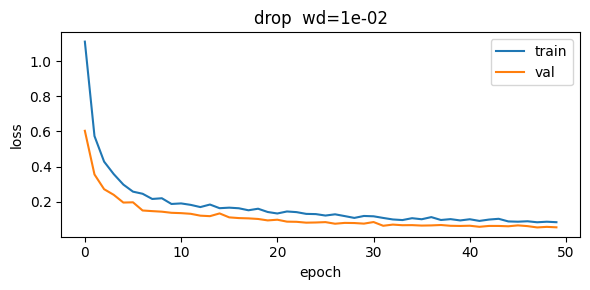


Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.96      0.98     10808
     Class 1       0.82      1.00      0.90       914
     Class 2       0.92      0.99      0.95      2475
     Class 3       0.77      0.99      0.87       182

    accuracy                           0.97     14379
   macro avg       0.88      0.98      0.92     14379
weighted avg       0.97      0.97      0.97     14379



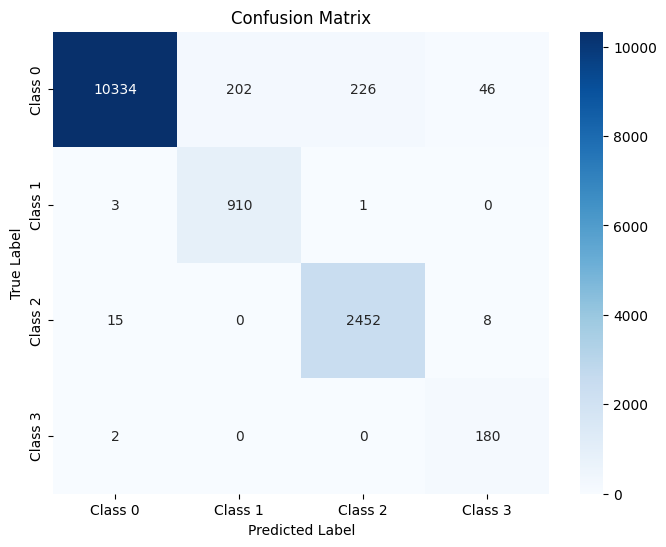

The function took 0.8881 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.96      0.98      2702
     Class 1       0.83      1.00      0.90       228
     Class 2       0.91      0.99      0.95       619
     Class 3       0.78      1.00      0.88        46

    accuracy                           0.97      3595
   macro avg       0.88      0.99      0.93      3595
weighted avg       0.97      0.97      0.97      3595



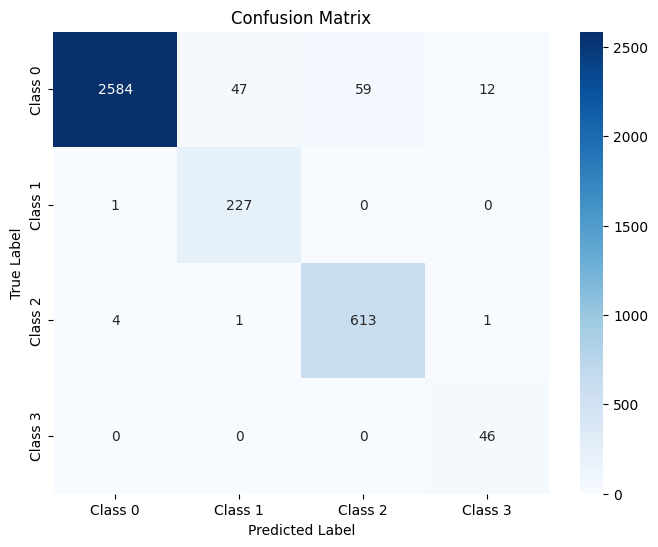

The function took 0.3230 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.96      0.98      3378
     Class 1       0.83      0.99      0.90       285
     Class 2       0.92      0.99      0.95       774
     Class 3       0.75      0.95      0.84        57

    accuracy                           0.97      4494
   macro avg       0.87      0.97      0.92      4494
weighted avg       0.97      0.97      0.97      4494



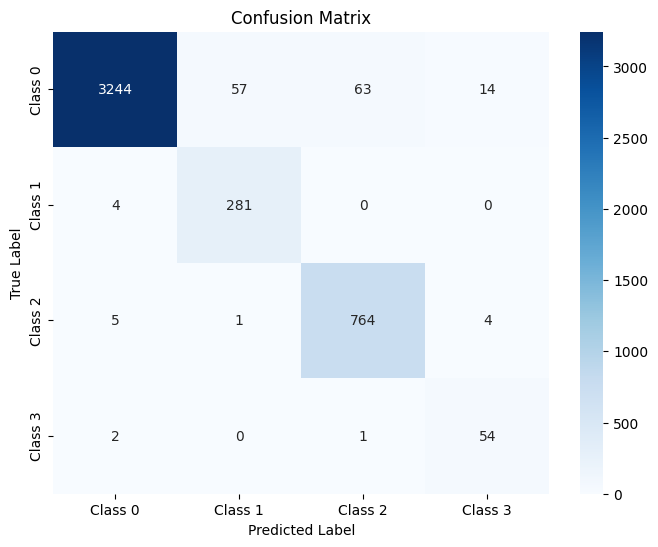

The function took 0.2405 seconds to execute.
[bn  wd=0e+00] ep 010  tr=0.0970  val=0.0694
[bn  wd=0e+00] ep 020  tr=0.0596  val=0.0578
[bn  wd=0e+00] ep 030  tr=0.0670  val=0.0527
[bn  wd=0e+00] ep 040  tr=0.0443  val=0.0420
[bn  wd=0e+00] ep 050  tr=0.0428  val=0.0460
[bn  wd=0e+00] done in 29.3s  best-val=0.0420


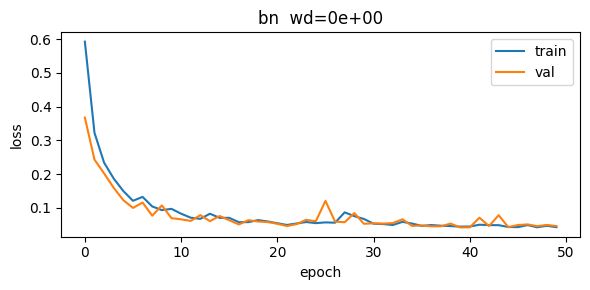


Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.97      0.98     10808
     Class 1       0.85      1.00      0.92       914
     Class 2       0.94      0.99      0.96      2475
     Class 3       0.79      1.00      0.88       182

    accuracy                           0.97     14379
   macro avg       0.89      0.99      0.94     14379
weighted avg       0.98      0.97      0.97     14379



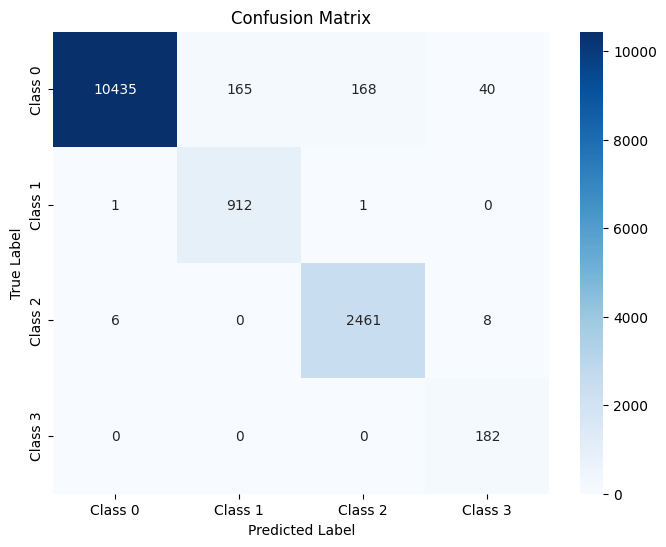

The function took 0.6049 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.97      0.98      2702
     Class 1       0.85      1.00      0.92       228
     Class 2       0.93      1.00      0.96       619
     Class 3       0.82      1.00      0.90        46

    accuracy                           0.97      3595
   macro avg       0.90      0.99      0.94      3595
weighted avg       0.98      0.97      0.97      3595



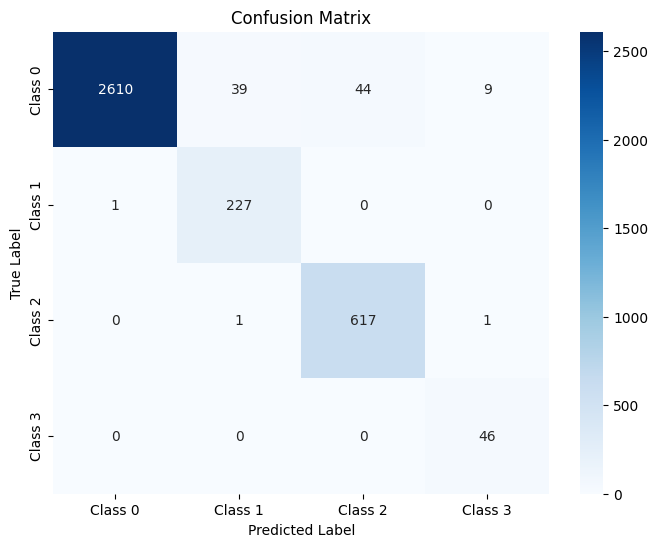

The function took 0.2666 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.97      0.98      3378
     Class 1       0.86      0.99      0.92       285
     Class 2       0.94      0.99      0.97       774
     Class 3       0.79      0.96      0.87        57

    accuracy                           0.97      4494
   macro avg       0.90      0.98      0.93      4494
weighted avg       0.98      0.97      0.98      4494



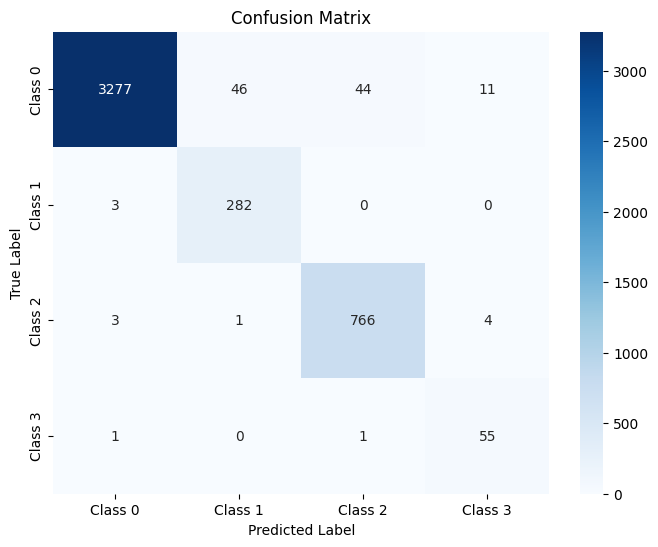

The function took 0.2638 seconds to execute.
[bn  wd=1e-04] ep 010  tr=0.0821  val=0.0671
[bn  wd=1e-04] ep 020  tr=0.0765  val=0.1027
[bn  wd=1e-04] ep 030  tr=0.0487  val=0.0516
[bn  wd=1e-04] ep 040  tr=0.0441  val=0.0446
[bn  wd=1e-04] ep 050  tr=0.0454  val=0.0486
[bn  wd=1e-04] done in 30.4s  best-val=0.0401


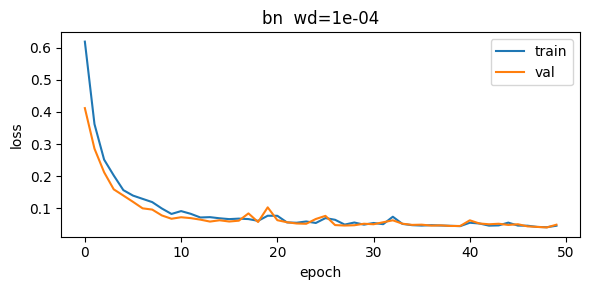


Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.97      0.98     10808
     Class 1       0.83      1.00      0.91       914
     Class 2       0.94      0.99      0.96      2475
     Class 3       0.86      1.00      0.92       182

    accuracy                           0.97     14379
   macro avg       0.91      0.99      0.94     14379
weighted avg       0.98      0.97      0.97     14379



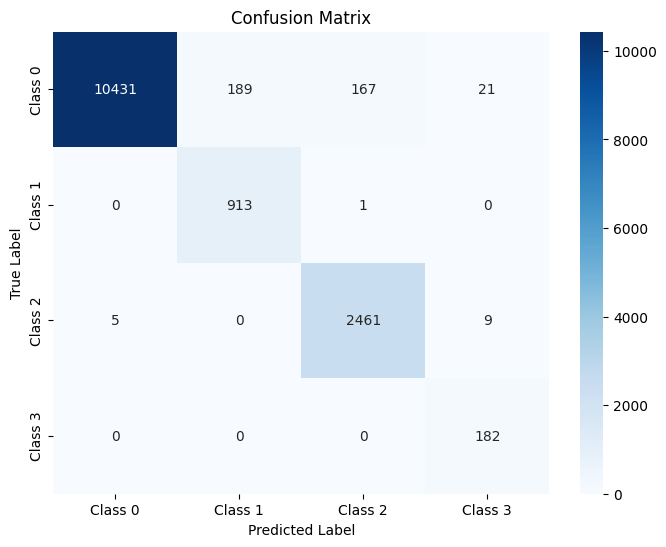

The function took 0.4699 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.96      0.98      2702
     Class 1       0.83      1.00      0.91       228
     Class 2       0.93      1.00      0.96       619
     Class 3       0.84      1.00      0.91        46

    accuracy                           0.97      3595
   macro avg       0.90      0.99      0.94      3595
weighted avg       0.97      0.97      0.97      3595



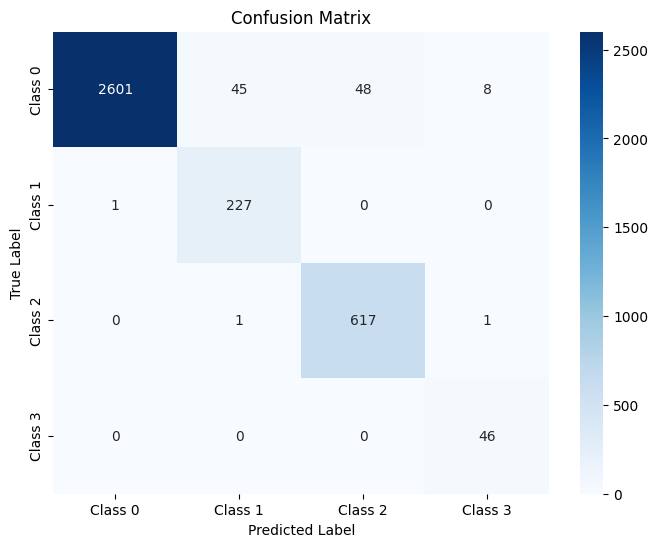

The function took 0.6632 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.97      0.98      3378
     Class 1       0.84      0.99      0.91       285
     Class 2       0.94      0.99      0.96       774
     Class 3       0.86      0.95      0.90        57

    accuracy                           0.97      4494
   macro avg       0.91      0.97      0.94      4494
weighted avg       0.98      0.97      0.97      4494



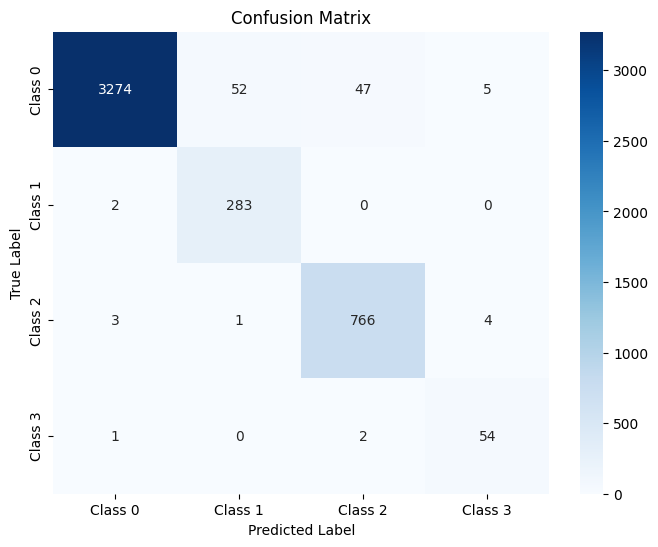

The function took 0.2614 seconds to execute.
[bn  wd=1e-03] ep 010  tr=0.0953  val=0.0781
[bn  wd=1e-03] ep 020  tr=0.0589  val=0.0605
[bn  wd=1e-03] ep 030  tr=0.0512  val=0.1468
[bn  wd=1e-03] ep 040  tr=0.0444  val=0.0449
[bn  wd=1e-03] ep 050  tr=0.0430  val=0.0784
[bn  wd=1e-03] done in 29.7s  best-val=0.0437


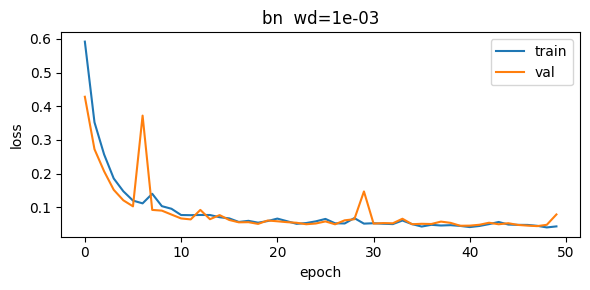


Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.97      0.98     10808
     Class 1       0.85      1.00      0.92       914
     Class 2       0.93      1.00      0.96      2475
     Class 3       0.88      1.00      0.93       182

    accuracy                           0.97     14379
   macro avg       0.91      0.99      0.95     14379
weighted avg       0.98      0.97      0.97     14379



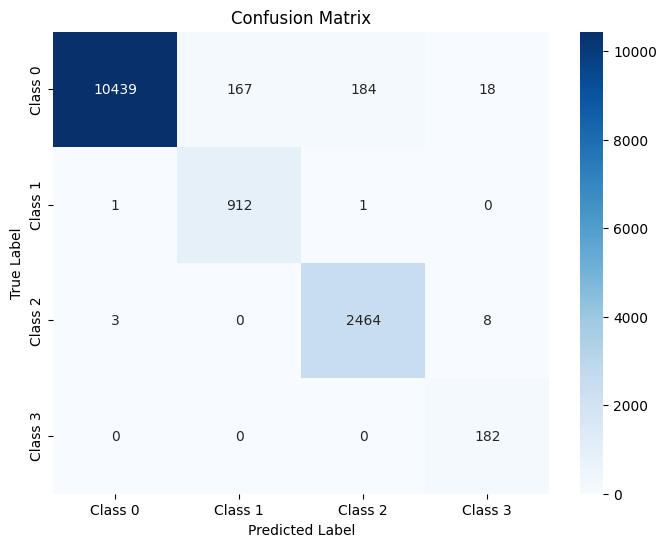

The function took 0.6046 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.96      0.98      2702
     Class 1       0.85      1.00      0.92       228
     Class 2       0.92      1.00      0.96       619
     Class 3       0.85      1.00      0.92        46

    accuracy                           0.97      3595
   macro avg       0.91      0.99      0.94      3595
weighted avg       0.97      0.97      0.97      3595



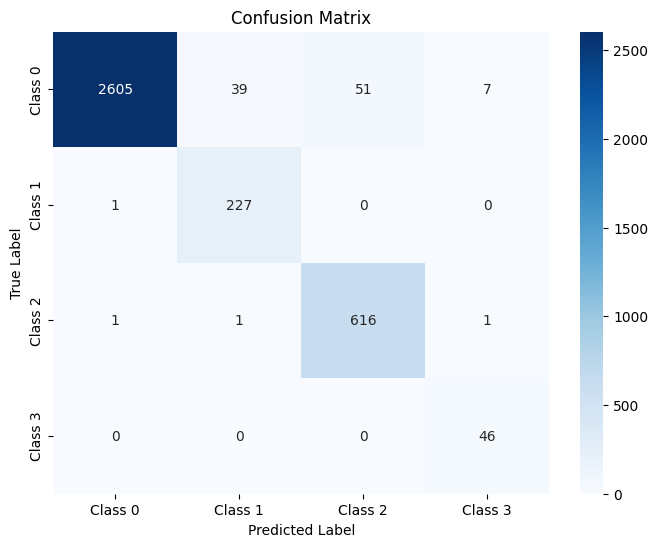

The function took 0.2508 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.97      0.98      3378
     Class 1       0.85      0.99      0.91       285
     Class 2       0.94      0.99      0.97       774
     Class 3       0.85      0.96      0.90        57

    accuracy                           0.97      4494
   macro avg       0.91      0.98      0.94      4494
weighted avg       0.98      0.97      0.97      4494



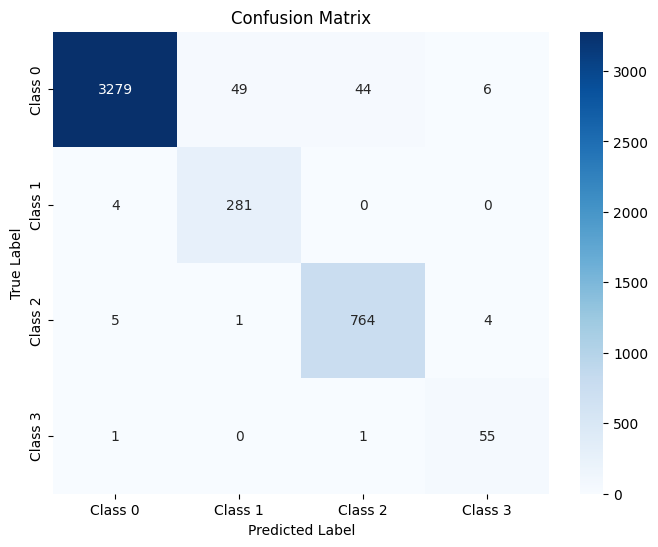

The function took 0.2623 seconds to execute.
[bn  wd=1e-02] ep 010  tr=0.0948  val=0.0764
[bn  wd=1e-02] ep 020  tr=0.0592  val=0.0555
[bn  wd=1e-02] ep 030  tr=0.0502  val=0.0520
[bn  wd=1e-02] ep 040  tr=0.0461  val=0.0455
[bn  wd=1e-02] ep 050  tr=0.0472  val=0.0424
[bn  wd=1e-02] done in 30.8s  best-val=0.0417


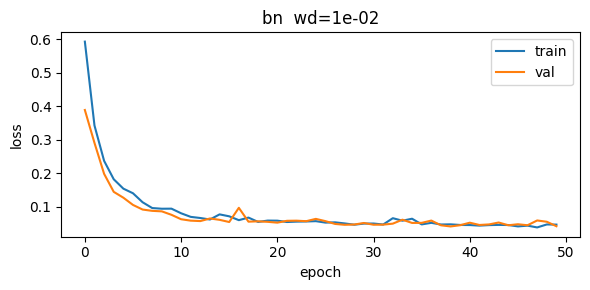


Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.97      0.98     10808
     Class 1       0.83      1.00      0.91       914
     Class 2       0.93      0.99      0.96      2475
     Class 3       0.86      1.00      0.93       182

    accuracy                           0.97     14379
   macro avg       0.91      0.99      0.94     14379
weighted avg       0.98      0.97      0.97     14379



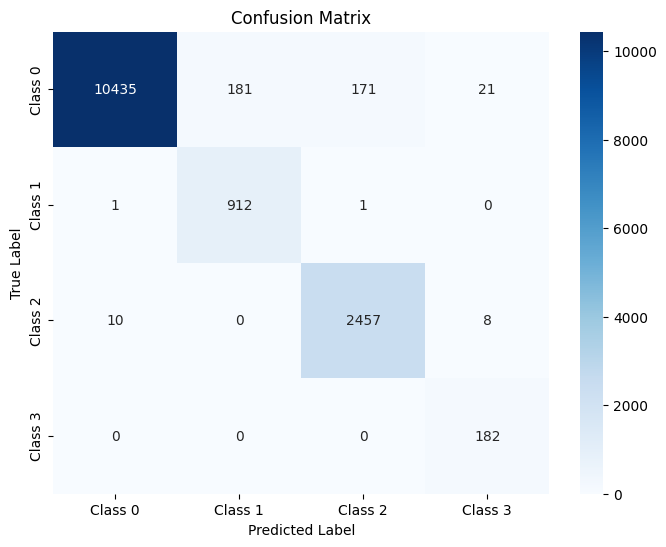

The function took 0.6261 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.96      0.98      2702
     Class 1       0.83      1.00      0.90       228
     Class 2       0.92      1.00      0.96       619
     Class 3       0.84      1.00      0.91        46

    accuracy                           0.97      3595
   macro avg       0.90      0.99      0.94      3595
weighted avg       0.97      0.97      0.97      3595



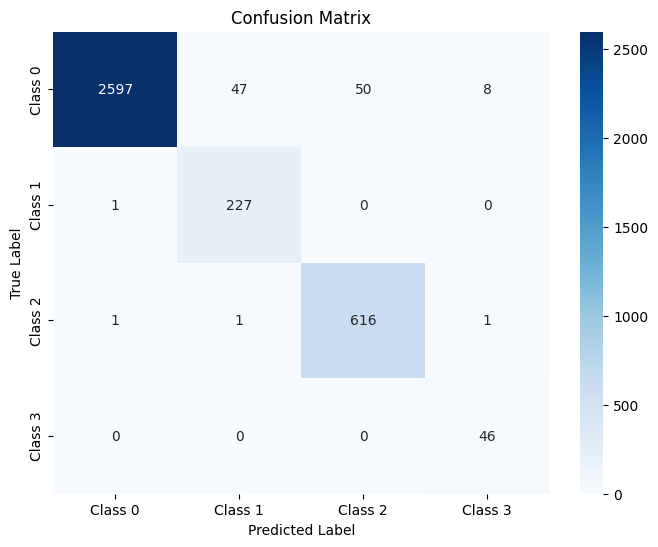

The function took 0.2450 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.97      0.98      3378
     Class 1       0.83      0.99      0.91       285
     Class 2       0.94      0.98      0.96       774
     Class 3       0.86      0.96      0.91        57

    accuracy                           0.97      4494
   macro avg       0.91      0.98      0.94      4494
weighted avg       0.97      0.97      0.97      4494



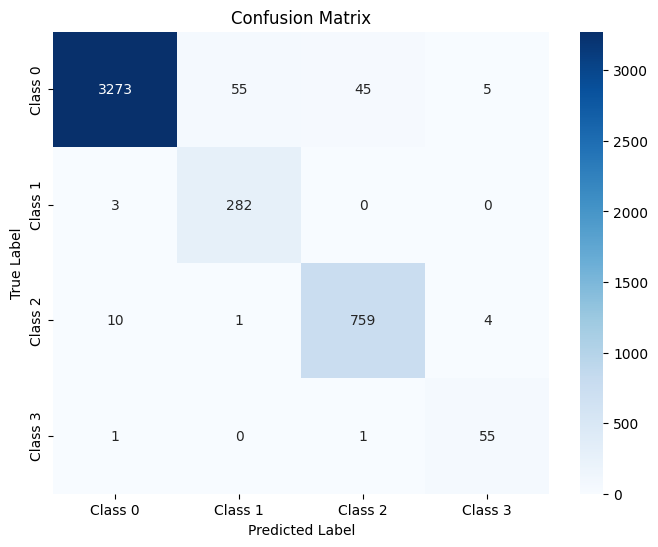

The function took 0.2637 seconds to execute.
[bn+drop  wd=0e+00] ep 010  tr=0.1988  val=0.1225
[bn+drop  wd=0e+00] ep 020  tr=0.1412  val=0.0717
[bn+drop  wd=0e+00] ep 030  tr=0.1113  val=0.0664
[bn+drop  wd=0e+00] ep 040  tr=0.0973  val=0.0612
[bn+drop  wd=0e+00] early-stop @ epoch 049
[bn+drop  wd=0e+00] done in 32.7s  best-val=0.0574


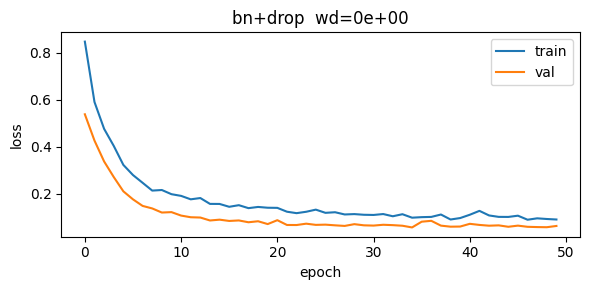


Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.95      0.97     10808
     Class 1       0.77      1.00      0.87       914
     Class 2       0.90      0.99      0.94      2475
     Class 3       0.78      0.99      0.88       182

    accuracy                           0.96     14379
   macro avg       0.86      0.98      0.91     14379
weighted avg       0.96      0.96      0.96     14379



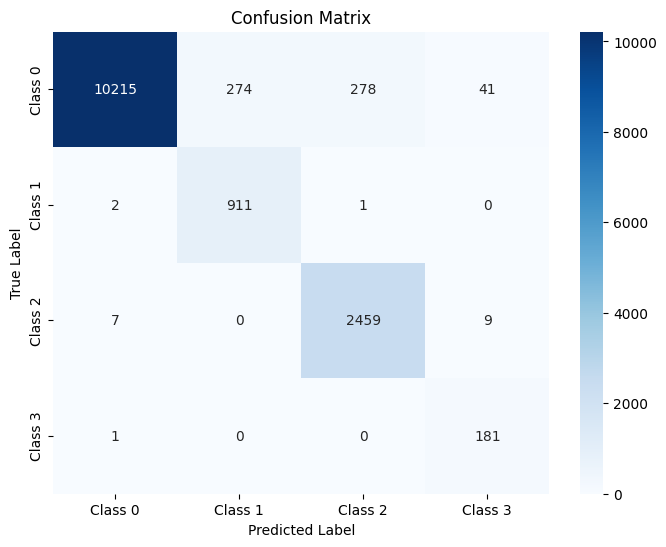

The function took 0.6317 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.95      0.97      2702
     Class 1       0.78      1.00      0.88       228
     Class 2       0.90      0.99      0.94       619
     Class 3       0.77      1.00      0.87        46

    accuracy                           0.96      3595
   macro avg       0.86      0.98      0.91      3595
weighted avg       0.96      0.96      0.96      3595



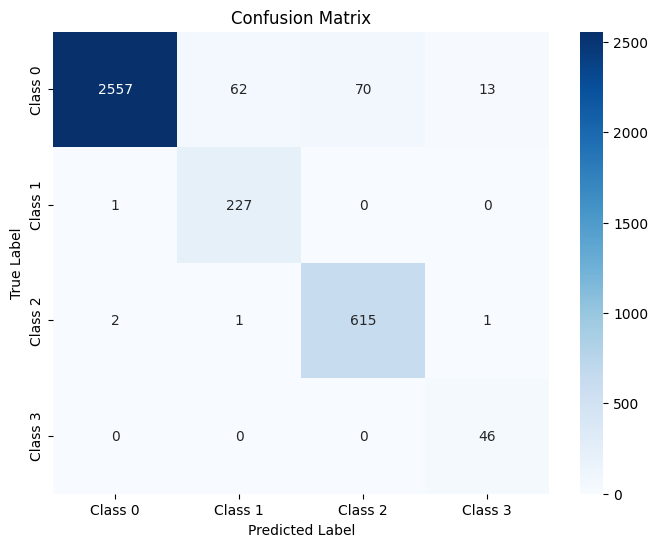

The function took 0.2647 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.95      0.97      3378
     Class 1       0.79      0.99      0.88       285
     Class 2       0.91      0.99      0.95       774
     Class 3       0.77      0.98      0.86        57

    accuracy                           0.96      4494
   macro avg       0.87      0.98      0.91      4494
weighted avg       0.97      0.96      0.96      4494



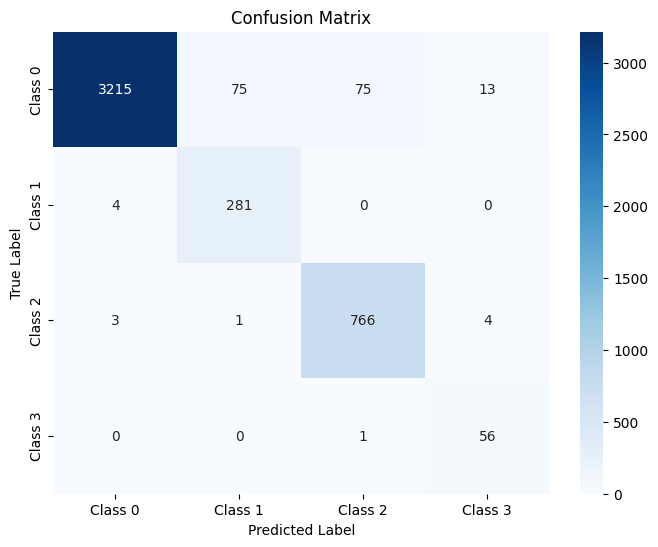

The function took 0.2759 seconds to execute.
[bn+drop  wd=1e-04] ep 010  tr=0.1884  val=0.1128
[bn+drop  wd=1e-04] ep 020  tr=0.1415  val=0.0891
[bn+drop  wd=1e-04] ep 030  tr=0.1122  val=0.0728
[bn+drop  wd=1e-04] ep 040  tr=0.1002  val=0.0618
[bn+drop  wd=1e-04] ep 050  tr=0.1021  val=0.0636
[bn+drop  wd=1e-04] done in 32.1s  best-val=0.0595


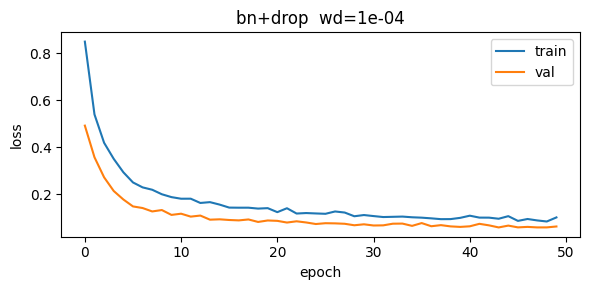


Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.95      0.97     10808
     Class 1       0.77      1.00      0.87       914
     Class 2       0.92      0.99      0.95      2475
     Class 3       0.72      0.99      0.84       182

    accuracy                           0.96     14379
   macro avg       0.85      0.98      0.91     14379
weighted avg       0.97      0.96      0.96     14379



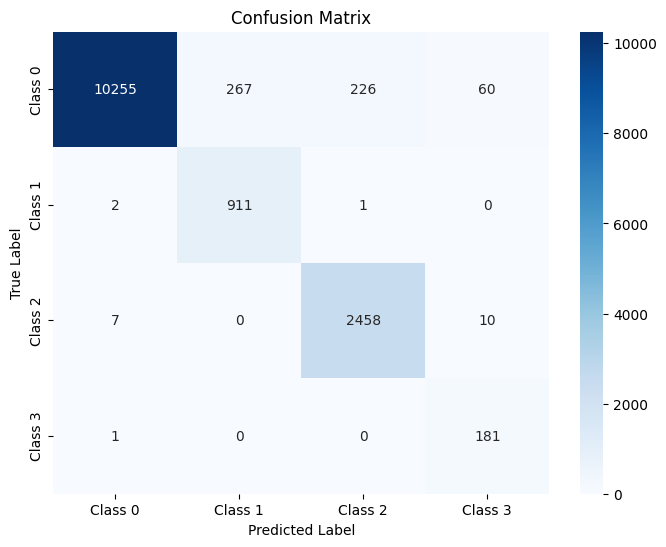

The function took 0.8756 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.95      0.97      2702
     Class 1       0.78      1.00      0.87       228
     Class 2       0.92      0.99      0.95       619
     Class 3       0.69      1.00      0.81        46

    accuracy                           0.96      3595
   macro avg       0.85      0.98      0.90      3595
weighted avg       0.97      0.96      0.96      3595



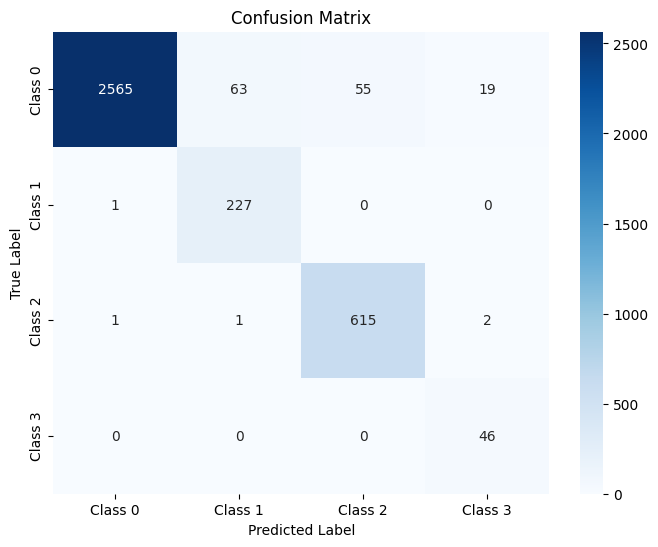

The function took 0.3690 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.95      0.97      3378
     Class 1       0.79      0.99      0.88       285
     Class 2       0.92      0.99      0.95       774
     Class 3       0.71      0.96      0.81        57

    accuracy                           0.96      4494
   macro avg       0.85      0.97      0.91      4494
weighted avg       0.97      0.96      0.96      4494



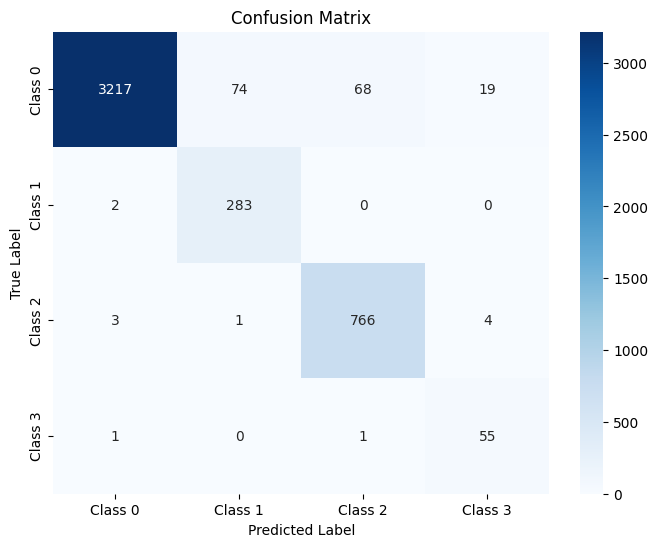

The function took 0.4095 seconds to execute.
[bn+drop  wd=1e-03] ep 010  tr=0.2063  val=0.1253
[bn+drop  wd=1e-03] ep 020  tr=0.1292  val=0.0862
[bn+drop  wd=1e-03] ep 030  tr=0.1229  val=0.0738
[bn+drop  wd=1e-03] ep 040  tr=0.0995  val=0.0663
[bn+drop  wd=1e-03] ep 050  tr=0.0885  val=0.0595
[bn+drop  wd=1e-03] done in 32.2s  best-val=0.0577


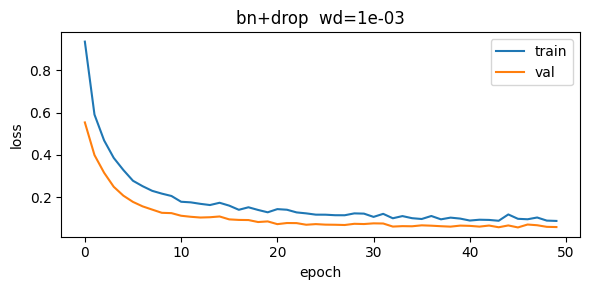


Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.95      0.97     10808
     Class 1       0.77      1.00      0.87       914
     Class 2       0.92      0.99      0.96      2475
     Class 3       0.78      0.99      0.88       182

    accuracy                           0.96     14379
   macro avg       0.87      0.98      0.92     14379
weighted avg       0.97      0.96      0.96     14379



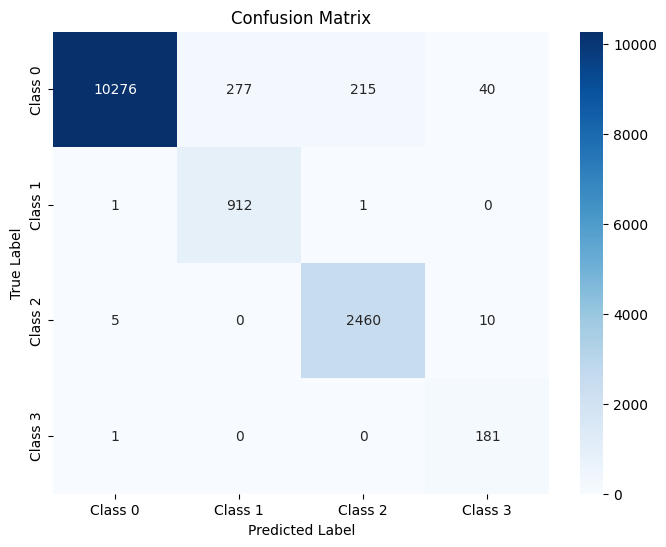

The function took 0.4537 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.95      0.97      2702
     Class 1       0.77      1.00      0.87       228
     Class 2       0.92      1.00      0.95       619
     Class 3       0.77      1.00      0.87        46

    accuracy                           0.96      3595
   macro avg       0.86      0.99      0.92      3595
weighted avg       0.97      0.96      0.96      3595



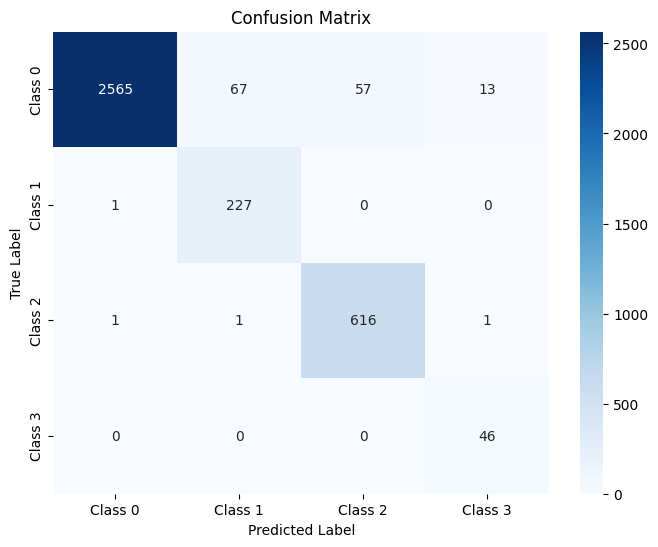

The function took 0.2993 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.95      0.98      3378
     Class 1       0.78      0.99      0.87       285
     Class 2       0.92      0.99      0.95       774
     Class 3       0.74      0.98      0.84        57

    accuracy                           0.96      4494
   macro avg       0.86      0.98      0.91      4494
weighted avg       0.97      0.96      0.96      4494



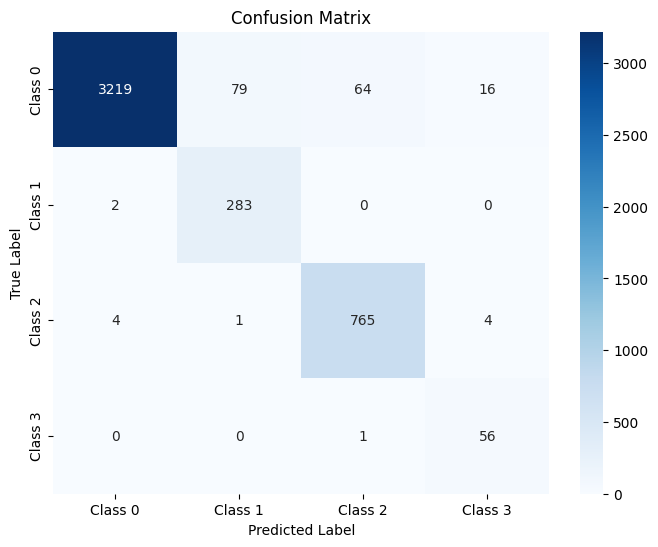

The function took 0.4137 seconds to execute.
[bn+drop  wd=1e-02] ep 010  tr=0.1954  val=0.1212
[bn+drop  wd=1e-02] ep 020  tr=0.1462  val=0.0855
[bn+drop  wd=1e-02] ep 030  tr=0.1091  val=0.0811
[bn+drop  wd=1e-02] ep 040  tr=0.0943  val=0.0660
[bn+drop  wd=1e-02] ep 050  tr=0.0920  val=0.0616
[bn+drop  wd=1e-02] done in 32.2s  best-val=0.0600


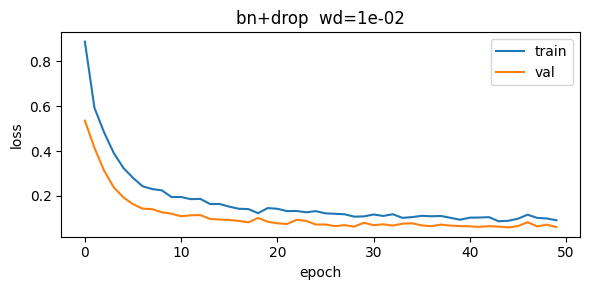


Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.95      0.97     10808
     Class 1       0.79      1.00      0.88       914
     Class 2       0.91      1.00      0.95      2475
     Class 3       0.78      0.99      0.87       182

    accuracy                           0.96     14379
   macro avg       0.87      0.98      0.92     14379
weighted avg       0.97      0.96      0.96     14379



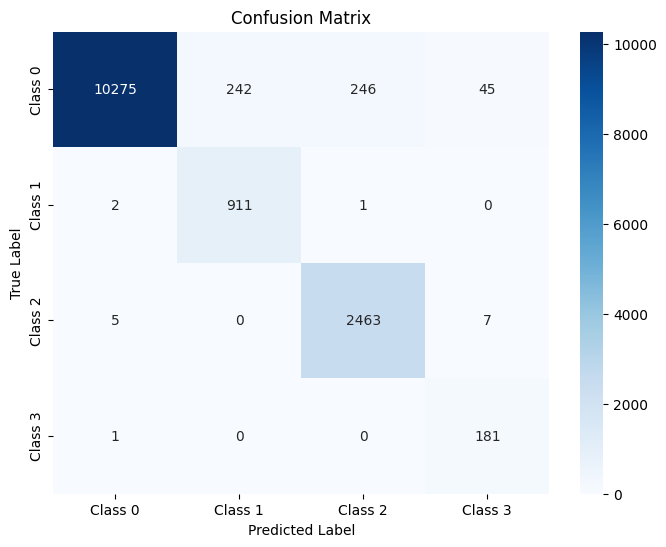

The function took 0.6248 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.95      0.97      2702
     Class 1       0.79      1.00      0.88       228
     Class 2       0.91      1.00      0.95       619
     Class 3       0.72      1.00      0.84        46

    accuracy                           0.96      3595
   macro avg       0.85      0.98      0.91      3595
weighted avg       0.97      0.96      0.96      3595



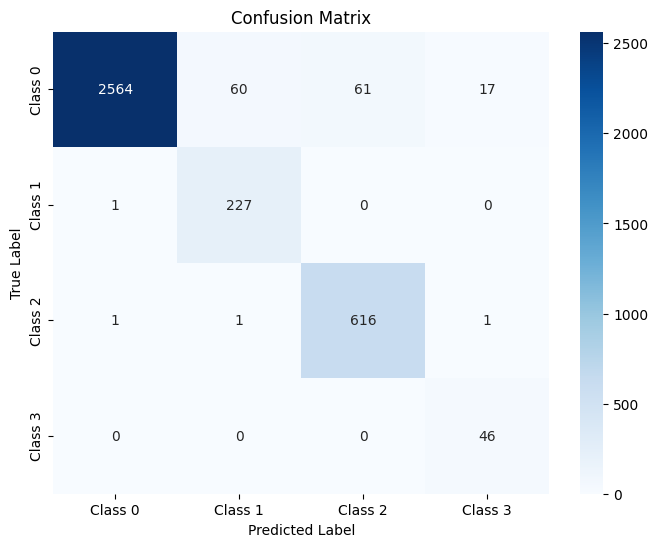

The function took 0.5373 seconds to execute.

Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.95      0.98      3378
     Class 1       0.81      0.99      0.89       285
     Class 2       0.91      0.99      0.95       774
     Class 3       0.71      0.98      0.82        57

    accuracy                           0.96      4494
   macro avg       0.86      0.98      0.91      4494
weighted avg       0.97      0.96      0.96      4494



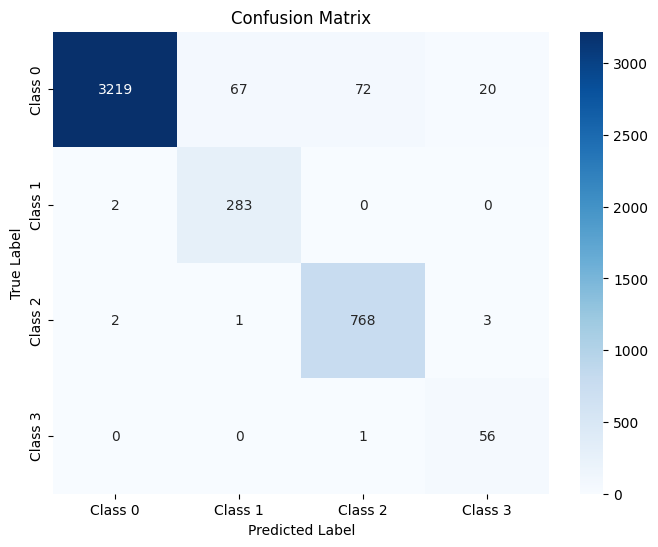

The function took 0.4319 seconds to execute.


,train_acc,val_acc,test_acc
plain wd=0e+00,"{'accuracy': 96.82175394672787, 'precision': [...","{'accuracy': 96.80111265646731, 'precision': [...","{'accuracy': 97.01824655095683, 'precision': [..."
plain wd=1e-04,"{'accuracy': 96.96780026427429, 'precision': [...","{'accuracy': 96.71766342141864, 'precision': [...","{'accuracy': 97.15175789942145, 'precision': [..."
plain wd=1e-03,"{'accuracy': 96.89825439877599, 'precision': [...","{'accuracy': 96.71766342141864, 'precision': [...","{'accuracy': 97.06275033377837, 'precision': [..."
plain wd=1e-02,"{'accuracy': 96.46707003268655, 'precision': [...","{'accuracy': 96.35605006954103, 'precision': [...","{'accuracy': 96.68446817979527, 'precision': [..."
drop wd=0e+00,"{'accuracy': 96.23061408999234, 'precision': [...","{'accuracy': 96.16133518776078, 'precision': [...","{'accuracy': 96.3729417000445, 'precision': [0..."
drop wd=1e-04,"{'accuracy': 96.16802281104388, 'precision': [...","{'accuracy': 96.02225312934631, 'precision': [...","{'accuracy': 96.35068980863373, 'precision': [..."
drop wd=1e-03,"{'accuracy': 96.3836149940886, 'precision': [0...","{'accuracy': 96.4394993045897, 'precision': [0...","{'accuracy': 96.63996439697374, 'precision': [..."
drop wd=1e-02,"{'accuracy': 96.5018429654357, 'precision': [0...","{'accuracy': 96.52294853963839, 'precision': [...","{'accuracy': 96.63996439697374, 'precision': [..."
bn wd=0e+00,"{'accuracy': 97.29466583211628, 'precision': [...","{'accuracy': 97.35744089012516, 'precision': [...","{'accuracy': 97.46328437917224, 'precision': [..."
bn wd=1e-04,"{'accuracy': 97.2738020724668, 'precision': [0...","{'accuracy': 97.10709318497915, 'precision': [...","{'accuracy': 97.39652870493993, 'precision': [..."


In [18]:
# ---------------- Task-5 · deep 6-layer grid ------------------------
# Purpose:
#   Sweep a 6-layer MLP across architecture variants and weight-decay values.
#   Variants: plain, dropout (“drop”), batch-normalisation (“bn”),
#             and batch-normalisation + dropout (“bn+drop”).
#   Weight-decay grid: 0, 1e-4, 1e-3, 1e-2.
# Procedure:
#   1. Build DataLoaders with batch size 128.
#   2. Define `DeepNet`, which can insert BatchNorm and/or Dropout after each
#      hidden Linear layer.
#   3. Helper `deep_variant` returns the requested model plus an AdamW optimiser.
#   4. For every (variant × weight-decay) pair:
#        • Train ≤50 epochs with early-stopping (patience 15) via `training_loop`.
#        • Save loss curves and accuracies (train / val / test).
#   5. Collect results into a DataFrame for quick comparison.

import itertools
import torch.nn as nn
from torch.utils.data import DataLoader


BS_DEEP = 128
train_loader128 = DataLoader(train_dataset, batch_size=BS_DEEP, shuffle=True)
val_loader128   = DataLoader(val_dataset,   batch_size=BS_DEEP, shuffle=False)
test_loader128  = DataLoader(test_dataset,  batch_size=BS_DEEP, shuffle=False)


deep_arch = [input_dim, 256, 128, 64, 32, 16, n_classes]

class DeepNet(nn.Module):
    """Deep MLP: 6 hidden layers, optional BatchNorm and/or Dropout."""
    def __init__(self, sizes, use_bn=False, use_do=False, p_drop=0.2):
        super().__init__()
        layers = []
        for i in range(len(sizes)-2):
            layers.append(nn.Linear(sizes[i], sizes[i+1]))
            if use_bn:
                layers.append(nn.BatchNorm1d(sizes[i+1]))
            layers.append(nn.ReLU())
            if use_do:
                layers.append(nn.Dropout(p_drop))
        layers.append(nn.Linear(sizes[-2], sizes[-1]))
        self.net = nn.Sequential(*layers)

    def forward(self, x):
        return self.net(x)

def deep_variant(kind:str, weight_decay:float=0.0):
    """Factory: build DeepNet variant + AdamW optimiser with given weight-decay."""
    if   kind == 'plain':
        model = DeepNet(deep_arch, use_bn=False, use_do=False)
    elif kind == 'drop':
        model = DeepNet(deep_arch, use_bn=False, use_do=True)
    elif kind == 'bn':
        model = DeepNet(deep_arch, use_bn=True,  use_do=False)
    elif kind == 'bn+drop':
        model = DeepNet(deep_arch, use_bn=True,  use_do=True)
    else:
        raise ValueError(f"kind '{kind}' ")

    model = model.to(DEVICE)
    optimizer = optim.AdamW(model.parameters(), lr=5e-4, weight_decay=weight_decay)
    return model, optimizer

# 4) sweep --------------------------------------------------------------------
kind_grid = ['plain', 'drop', 'bn', 'bn+drop']
wd_grid   = [0.0, 1e-4, 1e-3, 1e-2]

criterion = nn.CrossEntropyLoss(weight=class_weights.to(DEVICE))

deep_scores, deep_curves = {}, {}
for kd, wd in itertools.product(kind_grid, wd_grid):
    tag = f"{kd}  wd={wd:.0e}"
    model, optimizer = deep_variant(kd, weight_decay=wd)

    hist, model = training_loop(model,
                                train_loader128, val_loader128,
                                train_dataset,  val_dataset,
                                DEVICE, optimizer, criterion,
                                max_epochs=50, patience=15,
                                verbose_every=10, cfg_name=tag)

    deep_curves[tag] = hist
    deep_scores[tag] = {
        'train_acc': testing_model(model, train_loader128, DEVICE),
        'val_acc'  : testing_model(model, val_loader128,   DEVICE),
        'test_acc' : testing_model(model, test_loader128,     DEVICE)
    }


pd.DataFrame(deep_scores).T

